# Pendulum with Vibrating Base

## Notebook Setup 
The following cell will install Drake, checkout the underactuated repository, and set up the path (only if necessary).
- On Google's Colaboratory, this **will take approximately two minutes** on the first time it runs (to provision the machine), but should only need to reinstall once every 12 hours.  Colab will ask you to "Reset all runtimes"; say no to save yourself the reinstall.
- On Binder, the machines should already be provisioned by the time you can run this; it should return (almost) instantly.

More details are available [here](http://underactuated.mit.edu/drake.html).

In [20]:
try:
    import pydrake
    import underactuated
except ImportError:
    !curl -s https://raw.githubusercontent.com/RussTedrake/underactuated/master/scripts/setup/jupyter_setup.py > jupyter_setup.py
    from jupyter_setup import setup_underactuated
    setup_underactuated()

# Setup matplotlib.  
from IPython import get_ipython
if get_ipython() is not None: get_ipython().run_line_magic("matplotlib", "inline")

In [21]:
# python libraries
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import HTML

# pydrake imports
from pydrake.all import (AddMultibodyPlantSceneGraph, DiagramBuilder, Parser,
                         PlanarSceneGraphVisualizer, Simulator, VectorSystem,
                         Multiplexer, MatrixGain, LogOutput, ConstantVectorSource, 
                         Saturation, WrapToSystem, wrap_to, LinearQuadraticRegulator, SceneGraph, 
                        MultibodyPlant, SignalLogger, Linearize)

from pydrake.systems.drawing import plot_system_graphviz
from pydrake.examples.acrobot import AcrobotSpongController
from pydrake.systems.analysis import Simulator
from pydrake.systems.framework import InputPortIndex, InputPortSelection, OutputPortSelection
from pydrake.multibody.inverse_kinematics import InverseKinematics

# underactuated imports
from underactuated import FindResource, ManipulatorDynamics



In [22]:
import os
from underactuated.jupyter import AdvanceToAndVisualize, SetupMatplotlibBackend
plt_is_interactive = SetupMatplotlibBackend()



In [28]:
from pydrake.systems.framework import BasicVector


def BalancingLQR_KS(plant):
    context = plant.CreateDefaultContext()
    plant.get_actuation_input_port().FixValue(context, [0, 0])
    context.get_mutable_continuous_state_vector().SetFromVector([np.pi, 0, 0, 0, 0, 0]) # be sure this is an equilibrium point
    
    Q = np.diag((10., 10., 10., 1., 1., 1.))
    R = np.diag((1., 1.))
    B = np.array(([[0, 0], [0, 0], [0, 0], [0, 0], [1, 0], [0, 1]]))
    linearized_pendulum = Linearize(double_pendulum, context, input_port_index=InputPortSelection(3), output_port_index=OutputPortSelection(7))
    
    (K, S) = LinearQuadraticRegulator(linearized_pendulum.A(), B, Q, R)
    return K, S

def BalancingLQR(plant):
  
    context = plant.CreateDefaultContext()
    plant.get_actuation_input_port().FixValue(context, [0, 0])
    context.get_mutable_continuous_state_vector().SetFromVector([np.pi, 0, 0, 0, 0, 0]) # be sure this is an equilibrium point
    
    Q = np.diag((10., 10., 10., 1., 1., 1.))
    R = np.diag((1., 1.))
    B = np.array(([[0, 0], [0, 0], [0, 0], [0, 0], [1, 0], [0, 1]]))    
    return LinearQuadraticRegulator(double_pendulum, context, Q, R, input_port_index=3)

In [29]:
import copy
#get mass matrix
#get ke, kp, kd 
#determine potential + kinetic energy
#E desired = potential energy of first joint + potential energy of second joint
Vs = []
Es = []
PEs = []
KEs = []
qabars = []
Vs = []
class XinController(VectorSystem):
    
    def __init__(self, double_pendulum):
        
        # 4 inputs: double pendulum state
        # 1 output: elbow torque
        VectorSystem.__init__(self, 6,  2)
        
        
        self.double_pendulum = double_pendulum
        self.double_pendulum_context = double_pendulum.CreateDefaultContext()
        self.double_pendulum_context.SetContinuousState([np.pi, 0, 0, 0, 0, 0])
        # Potential energy corresponding to upright equilibrium state
        self.E_desired = double_pendulum.EvalPotentialEnergy(self.double_pendulum_context)
        #print(self.E_desired)
        # Determine betas from the gravitational terms
        self.double_pendulum_context.SetContinuousState([np.pi/2, 0, 0, 0, 0, 0])
        self.G = -self.double_pendulum.CalcGravityGeneralizedForces(self.double_pendulum_context)
        self.double_pendulum_context.SetContinuousState([0, 0, 0, 0, 0, 0])
        self.beta_3 = self.G[2]
        self.beta_2 = self.G[1] - self.G[2]
        self.beta_1 = self.G[0] - self.G[1]

        # Choose controller gains such that the 
        kp = max(2*self.beta_1*(self.beta_2 + self.beta_3), 2*self.beta_2*self.beta_3*(self.E_desired)/(self.beta_2 + self.beta_3))
        self.k_v = 10000 #4550 was 20000 befor
        #self.k_p = 240000 #121700
        self.k_p = 1.01*kp 
        self.k_d = 50500 #11500 
        print('Done w/ Initialization')
    
    def CalcQbar(self, q2, q3):
        beta2_bar = np.sqrt(
            self.beta_2**2 + self.beta_3**2 \
            + 2*self.beta_2*self.beta_3*np.cos(q3))
        sin_theta_q3 = self.beta_3*np.sin(q3)/beta2_bar
        theta_q3 = np.arcsin(sin_theta_q3)
        cos_theta_q3 = (self.beta_2 + self.beta_3*np.cos(q3))/beta2_bar
        theta_q3_2 = np.arccos(cos_theta_q3)
        #print('theta_q3', theta_q3)
        if theta_q3 < 0:
          #print('cos values')
          thetas2 = [round(theta_q3_2,5), round(-theta_q3_2,5) , round(2*np.pi - theta_q3_2,5)]
          #print(thetas2)
          #print(np.cos(thetas2))
          #print('sin values')
          thetas1 = [round(theta_q3,5), round(np.pi - theta_q3,5), round(-np.pi - theta_q3,5)]
          #print(thetas1)
          #print(np.sin(list(thetas1)))
          theta_q3 = set(thetas1) & set(thetas2)
          theta_q3 = list(theta_q3)[0]
        q2_bar = q2 + theta_q3
        return [q2_bar, beta2_bar]
 

    def DoCalcVectorOutput(self, context, state, unused, delta):
        
        # Rewrite state vector in terms of qs
        q1 = state[0]
        q2 = state[1]
        q3 = state[2]
        q1dot = state[3]
        q2dot = state[4]
        q3dot = state[5]
        qdot = np.array([[q1dot], [q2dot], [q3dot]])
        qadot = np.array([[q2dot], [q3dot]])

        self.double_pendulum_context.SetContinuousState(state)

        # Calculate mass matrix based on acrobot's current state
        M = self.double_pendulum.CalcMassMatrixViaInverseDynamics(self.double_pendulum_context)
        # print(M)
        M11 = M[0, 0]
        # print(M11)
        M1a = np.array([M[0, 1:]])
        # print(M1a)
        Ma1 = M1a.T
        # print(Ma1)
        Maa = np.array([M[1:, 1:]])
        # print(Maa)
        
        # Calculate potential and kinetic energy based on acrobot's current state
        PE = double_pendulum.EvalPotentialEnergy(self.double_pendulum_context)
        KE = double_pendulum.EvalKineticEnergy(self.double_pendulum_context)
        E = PE + KE
        E_tilde = E - self.E_desired

        H = self.double_pendulum.CalcBiasTerm(self.double_pendulum_context)
        H1 = H[0]
        # print('Ha')
        Ha = np.array([H[-2:]]).T
        # print(Ha)
        G = -self.double_pendulum.CalcGravityGeneralizedForces(self.double_pendulum_context)
        G1 = G[0]
        Ga = np.array([G[-2:]]).T
        # print(Ga)
        
        ## Calculate correct q2bar
        res = self.CalcQbar(q2, q3)
        q2_bar = res[0]
        beta2_bar = res[1]

      
        #print('q2bar', q2_bar)
        qa_bar = np.array([[q2_bar], [state[2]]])
        qabars.append(q2_bar)
        

        
        M11_inv = 1/M11
        psi = self.beta_3*(self.beta_3 + self.beta_2*np.cos(state[2]))/(beta2_bar)**2
        #print(psi)
        Maa_hat = Maa - Ma1.dot(M11_inv).dot(M1a)
        w, v = np.linalg.eig(Maa_hat)
        #print(w)
        lambda_max = max(w)
        #print(lambda_max)
        phi = np.sqrt(self.beta_1**2 + self.beta_2**2 + self.beta_3**2\
                      + 2*self.beta_1*self.beta_2*np.cos(q2)\
                      + 2*self.beta_1*self.beta_3*np.cos(q2 + q3)\
                      + 2*self.beta_2*self.beta_3*np.cos(q3))
        kd_condition = (self.E_desired + phi)*lambda_max*Maa_hat
        kd_condition = np.amax(kd_condition)
        #print(kd_condition)
        if self.k_d < kd_condition:
            # print('kd', kd_condition)
            self.k_d = kd_condition
        #print(Maa_hat)
        Ha_hat = np.array([Ha - Ma1.dot(M11_inv).dot(H1)])
        #print(Ha_hat)
        Ga_hat = np.array([Ga - Ma1.dot(M11_inv).dot(G1)])
        #print(Ga_hat)
        Lambda = self.k_d*(np.identity(2)) + (E_tilde)*Maa_hat
        S = np.array([[1, psi], [0, 1]])
        if np.abs(np.linalg.det(Lambda)) < 0.01:
          print('Singularity?')
          print(np.linalg.det(Lambda))
        
        

        lambda_inv = np.linalg.inv(Lambda)
        tau = lambda_inv.dot(self.k_d*(Ha_hat + Ga_hat) - Maa_hat.dot(self.k_v*qadot + self.k_p*S.T.dot(qa_bar)))
        V = (0.5*(E_tilde)**2 + 0.5*self.k_d*qadot.T.dot(qadot) + 0.5*self.k_p*qa_bar.T.dot(qa_bar))[0]
        #print(V)
        Vs.append(V)
        # print(tau)
        Es.append(E)
        PEs.append(PE)
        KEs.append(KE)


        # assign value of the preload at each time step
        delta[:] = [tau[0,0], tau[0,1]] # modify here
        
    def get_context(self):
        return self.double_pendulum_context
        
        
    


In [30]:
class SwingUpAndBalanceController(VectorSystem):
    def __init__(self, double_pendulum):
        VectorSystem.__init__(self, 6, 2)
        self.double_pendulum = double_pendulum
        self.K, self.S = BalancingLQR_KS(double_pendulum)
        self.XinController = XinController(double_pendulum)
        self.BalancingLQR = BalancingLQR(double_pendulum)
        self.XinControllerContext = self.XinController.CreateDefaultContext()
        self.BalancingLQRContext = self.BalancingLQR.CreateDefaultContext()
    
    def DoCalcVectorOutput(self, context, state, unused, output):
        #print(state)
        xbar = state.copy()
        xbar[0] = wrap_to(xbar[0], 0, 2. * np.pi) - np.pi
        xSx = xbar.dot(self.S).dot(xbar)
        PE = self.double_pendulum.EvalPotentialEnergy(self.XinController.get_context())
        if state[0] < 3.15 and state[0] > 3.13:
            print("IN RANGE", state[0], PE)
        else:
            print(state[0], PE)
        if PE > 679.7446366200251:
            print("Switched to LQR!!")
            #print(state[0], PE)
        #print(xSx, xSx_complex, state[0])
        #if state[0] < 3.2 and state[0] > 3.05:
        #    print(xSx, xSx_complex, state[0])       
        #if xSx < 1:
#             print(xSx, state[0])
            self.BalancingLQRContext.FixInputPort(0, state)
            output[:] = self.BalancingLQR.get_output_port(0).Eval(self.BalancingLQRContext)
        else: 
            self.XinControllerContext.FixInputPort(0, state)
            output[:] = self.XinController.get_output_port(0).Eval(self.XinControllerContext)

Done w/ Initialization


<IPython.core.display.Javascript object>


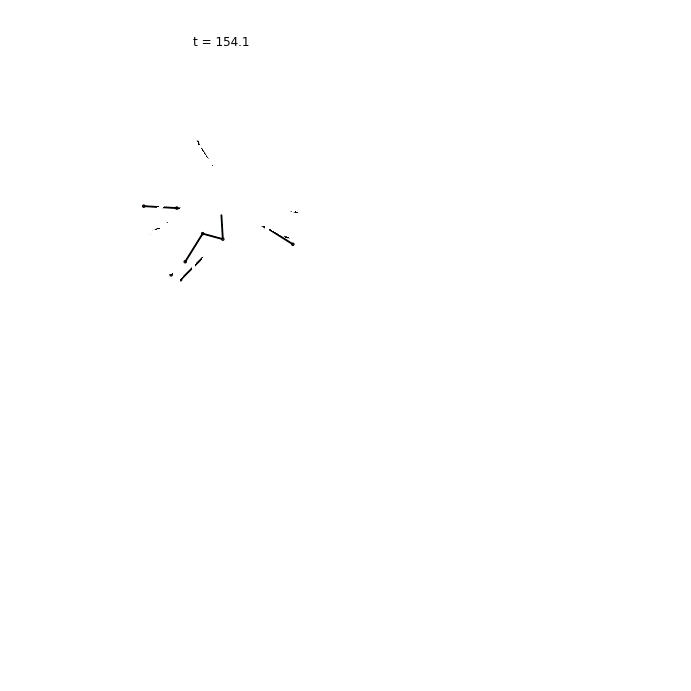

0.5235987755982988 -682.6484700000001
0.5235987755982988 -591.1909168745793
0.5235987755982988 -591.1909168745793
0.5235987472872811 -591.1909168745793
0.5235987614427685 -591.1909279858706
0.5235987614427685 -591.190922430226
0.5235986906650637 -591.190922430226
0.5235979121087134 -591.1909502084598
0.5235982659953825 -591.1912557688374
0.5235982659953825 -591.1911168779268
0.5235961426407613 -591.1911168779268
0.5235763244344216 -591.1919502232272
0.523585171548342 -591.1997279461673
0.523585171548342 -591.1962557928232
0.5235303155685456 -591.1962557928232
0.5230330493057503 -591.2177821159235
0.5232542258918519 -591.4127968055029
0.5232542258918519 -591.3260667031508
0.5228625708793023 -591.3260667031508
0.521580550550801 -591.4795613473291
0.5220258238150152 -591.9810291989663
0.5220258238150152 -591.8069766560538
0.5205866354420009 -591.8069766560538
0.5165162194563957 -592.3687754841162
0.5178335415055516 -593.9479433576923
0.5178335415055516 -593.4381863409396
0.517578684464741

5.8502859282731325 -586.3010152856733
5.8502859282731325 -585.6597999702008
5.8475166133731395 -585.6597999702008
5.847707167912308 -585.3583087665527
5.846232277590947 -586.3497887502095
5.846232277590947 -585.7032039121357
5.844949145860395 -585.7032039121357
5.846648507671567 -586.0441335975681
5.8451599033348804 -587.6697202804792
5.8451599033348804 -587.0258795405459
5.84537062648644 -587.0258795405459
5.848571777126679 -587.9989051352702
5.8470766911572625 -590.2283489053134
5.8470766911572625 -589.5952605670698
5.848781434448547 -589.5952605670698
5.853469252993823 -591.1742106693221
5.851975197740509 -593.9619983801364
5.851975197740509 -593.3474086565839
5.855166282811096 -593.3474086565839
5.86131694904312 -595.4906707907714
5.859831840797902 -598.7767864022993
5.859831840797902 -598.1880275552535
5.864493281027185 -598.1880275552535
5.872073646201968 -600.8392188963114
5.87060588444678 -604.5501769096941
5.87060588444678 -603.994018289842
5.876712847817156 -603.994018289842


0.12310063517423026 -678.09058149046
0.12310063517423026 -678.0414043704421
0.10593177991434657 -678.0414043704421
0.08788835802466016 -679.5004587407407
0.08836960981128134 -680.6258357392264
0.08836960981128134 -680.6027013467633
0.07082998188863798 -680.6027013467633
0.05268296305541713 -681.3163003852401
0.05303182262294683 -681.6547379368278
0.05303182262294683 -681.6482005470233
0.03525660985788645 -681.6482005470233
0.017146986109886443 -681.586331195213
0.017359954149137408 -681.1343911063882
0.017359954149137408 -681.13434814529
6.282671642949167 -681.13434814529
6.264738698701689 -680.2899063578656
6.264814100100666 -679.0678610049008
6.264814100100666 -679.063870859789
6.2469793792225214 -679.063870859789
6.229358843840107 -677.4530962775127
6.229296855078252 -675.5044115963881
6.229296855078252 -675.4860329835574
6.211636640033113 -675.4860329835574
6.194458948421823 -673.1480638431725
6.194261580988316 -670.5380011414047
6.194261580988316 -670.4951367026629
6.1769080471653

0.4207786020346672 -572.8819579396757
0.4207786020346672 -572.188480809775
0.42469212173285453 -572.188480809775
0.4257587480985394 -570.1099945360927
0.4271747112672519 -569.4695430166723
0.4271747112672519 -568.7479749362426
0.42965473763197304 -568.7479749362426
0.42925000756772974 -567.3805286363478
0.43068715863175955 -567.4961927273591
0.43068715863175955 -566.7553181079943
0.4317181463909799 -566.7553181079943
0.429839977148306 -566.1294306936054
0.43129152709962687 -567.0088769201584
0.43129152709962687 -566.2579479221979
0.4308645835946454 -566.2579479221979
0.42751727796916444 -566.3862496793357
0.428976619823551 -568.0187728143162
0.428976619823551 -567.2673061972273
0.4270894445573474 -567.2673061972273
0.4222839251239354 -568.1443423617247
0.42374448819981536 -570.5011145642975
0.42374448819981536 -569.7586808472929
0.42040146125768096 -569.7586808472929
0.4141556559190648 -571.3609711938608
0.41561075521649216 -574.3955553143246
0.41561075521649216 -573.6715621986482
0.41

6.187331937454875 -676.765133142929
6.207663318167459 -678.6602134883249
6.207194263827481 -680.2393077763525
6.207194263827481 -680.2098253219158
6.227032454237039 -680.2098253219158
6.247428400336291 -681.3755075114177
6.247101112943557 -682.1732405306207
6.247101112943557 -682.1645474021554
6.267145185047124 -682.1645474021554
0.004269041314078563 -682.5624309676484
0.004087340963922652 -682.568065422415
0.004087340963922652 -682.5695097816497
0.024190058293250605 -682.5695097816497
0.04426220063415307 -682.1846923488176
0.04422817776844544 -681.411896571906
0.04422817776844544 -681.4124650423685
0.06424168859341851 -681.4124650423685
0.08392950174466655 -680.2541270724244
0.084043487029836 -678.7404881223156
0.084043487029836 -678.729202135268
0.10382110950351116 -678.729202135268
0.12298199764803212 -676.8302385657747
0.12324251583074966 -674.6358318495572
0.12324251583074966 -674.6021420161734
0.14264045490725813 -674.6021420161734
0.16113806638936273 -672.0178646247754
0.1615419

5.809634306083204 -572.3501321136728
5.809634306083204 -571.6306248841512
5.806243450916973 -571.6306248841512
5.805962285873367 -570.5453184446616
5.8044137752325025 -570.930307150936
5.8044137752325025 -570.1956577445274
5.802585911445123 -570.1956577445274
5.803897797952849 -569.844954071042
5.802331774628805 -570.9778334700942
5.802331774628805 -570.2371234494406
5.802078187527109 -570.2371234494406
5.804979387180994 -570.627407821843
5.803403303260058 -572.4918656367499
5.803403303260058 -571.7542658758748
5.804727681640245 -571.7542658758748
5.809206556514003 -572.8740131333952
5.807628025534917 -575.4360323823788
5.807628025534917 -574.7106244885313
5.810526302953876 -574.7106244885313
5.816563026827019 -576.530546601579
5.814989801447532 -579.7389327304547
5.814989801447532 -579.0345353223656
5.819449841570855 -579.0345353223656
5.827015712172176 -581.5079762404876
5.825455929883442 -585.2951414099538
5.825455929883442 -584.620136729448
5.831457091920696 -584.620136729448
5.840

0.04286557818960894 -682.2278137221756
0.04286557818960894 -682.2213858377252
0.02328598535945912 -682.2213858377252
0.0034153054106872346 -682.3639611469534
0.0036108648199625754 -682.0764166460295
0.0036108648199625754 -682.0782330365543
6.267146203157 -682.0782330365543
6.247505738179418 -681.3636284481934
6.247550999125203 -680.2301047931301
6.247550999125203 -680.2284870476366
6.227980724171413 -680.2284870476366
6.208718984633124 -678.6723568817565
6.208614074337805 -676.7388117843291
6.208614074337805 -676.722140020694
6.189271808656571 -676.722140020694
6.170531655445549 -674.3656563040106
6.170278681832367 -671.7021758482474
6.170278681832367 -671.6592942520384
6.151309101019198 -671.6592942520384
6.133226183583858 -668.5676114860232
6.132829095784857 -665.2658351137835
6.132829095784857 -665.1864350562978
6.114371534867262 -665.1864350562978
6.097072924502731 -661.4462514285982
6.096537351673635 -657.6160314290942
6.096537351673635 -657.4909899038596
6.078724285505375 -657.49

0.4672105535105669 -565.0477627344258
0.4672105535105669 -564.3000592697427
0.47185546333091755 -564.3000592697427
0.4734357586056519 -562.1496276147845
0.4749597910672106 -561.5460179225568
0.4749597910672106 -560.7698703436649
0.478061251288925 -560.7698703436649
0.47805599366140855 -559.3846449348139
0.47960347596756686 -559.5911423558102
0.47960347596756686 -558.7959109112828
0.4811440340266096 -558.7959109112828
0.4795500839948586 -558.2065083293285
0.48111380318495633 -559.2296110363575
0.48111380318495633 -558.4250495238327
0.48108308735620114 -558.4250495238327
0.47790413631312323 -558.6431328921594
0.47947705816480984 -560.470028584323
0.47947705816480984 -559.6660851520178
0.47787173363861685 -559.6660851520178
0.47311858652419375 -560.6842115037241
0.4746936938307076 -563.2830402398265
0.4746936938307076 -562.4896576413689
0.4715175834094383 -562.4896576413689
0.4652086071969778 -564.2813580077698
0.46677873331401126 -567.6017094387503
0.46677873331401126 -566.8286243283235


6.15674371465558 -675.7713750664502
6.15674371465558 -675.7002477200067
6.176770995779815 -675.7002477200067
6.197764578445348 -677.893835105324
6.197232000687123 -679.7351138436622
6.197232000687123 -679.6992403932645
6.2176676312379735 -679.6992403932645
6.238768927635751 -681.0697773469076
6.238385098738403 -682.0266294745287
6.238385098738403 -682.015091139169
6.259076632090229 -682.015091139169
6.280125337054661 -682.5164410398945
6.279894859764457 -682.5736315537849
6.279894859764457 -682.5746200360287
0.017501623820708086 -682.5746200360287
0.03833854038842595 -682.1871945218152
0.03826399438741514 -681.3572477475611
0.03826399438741514 -681.3584789064687
0.0590003249051538 -681.3584789064687
0.0794693931896545 -680.0900570985442
0.07955134662001265 -678.4128564866623
0.07955134662001265 -678.4020143781052
0.10007677864375554 -678.4020143781052
0.12002708429427772 -676.2874552794398
0.12026406855855495 -673.8287340260308
0.12026406855855495 -673.7939177980581
0.14042653427145008

5.802897395668679 -561.1365005291141
5.802897395668679 -560.3650582481669
5.797335567492724 -560.3650582481669
5.794926179464812 -558.0059358549302
5.79335941266283 -557.2430836423638
5.79335941266283 -556.4408818652523
5.789386681476705 -556.4408818652523
5.788615374181565 -554.8682645213587
5.787021655782104 -554.942071835645
5.787021655782104 -554.1187204376614
5.784658830745417 -554.1187204376614
5.7855318130788085 -553.3674520503355
5.783918543631 -554.2880259473013
5.783918543631 -553.4535250023961
5.7831792606735535 -553.4535250023961
5.785695933542716 -553.538975514134
5.784070213408119 -555.2965838670576
5.784070213408119 -554.4611258496672
5.784960963913237 -554.4611258496672
5.789113511796748 -555.379014803257
5.78748244839745 -557.9443143534997
5.78748244839745 -557.1180864053657
5.790002487236453 -557.1180864053657
5.795775381427633 -558.844526294362
5.794146267697509 -562.1690027068121
5.794146267697509 -561.3619938994591
5.798287300312228 -561.3619938994591
5.80565679656

0.1861841451972804 -667.386777985044
0.1861841451972804 -667.247151498527
0.16675812277977395 -667.247151498527
0.14593152975303647 -670.6082654737727
0.14667931696387232 -673.7209989986582
0.14667931696387232 -673.6316908178837
0.12662523125232036 -673.6316908178837
0.10546184426183922 -676.2117640327631
0.1060664829549876 -678.4391049741384
0.1060664829549876 -678.3904170243138
0.08553348973718695 -678.3904170243138
0.06419592471181185 -680.1059980288265
0.06465007419384926 -681.3937633519704
0.06465007419384926 -681.3745601519288
0.0437931237806469 -681.3745601519288
0.022445976540123896 -682.1677499765326
0.02274411393346125 -682.4902102852353
0.02274411393346125 -682.4882728099968
0.0017219199180655877 -682.4882728099968
6.2637145959862055 -682.3291014448969
6.263853307265474 -681.69019382184
6.263853307265474 -681.6926360618637
6.24282618883695 -681.6926360618637
6.2219494555913375 -680.5803432461348
6.221927478355472 -679.0136714502273
6.221927478355472 -679.0074001249806
6.2010

0.4542313999565878 -569.198139684195
0.4542313999565878 -568.4990487969278
0.463614807426699 -568.4990487969278
0.4699781894083674 -564.1345629435976
0.47147247752139965 -561.2276932847012
0.47147247752139965 -560.4734731680744
0.4793235922180581 -560.4734731680744
0.48406850033039267 -556.7672566125598
0.4856086769932436 -554.6334506821518
0.4856086769932436 -553.832187174238
0.4918885833749337 -553.832187174238
0.4949925777783248 -550.8705429463191
0.496570203262139 -549.573046283323
0.496570203262139 -548.7337999024696
0.5012479258262383 -548.7337999024696
0.5026953502676026 -546.5841499397263
0.5043026011309917 -546.1657629489245
0.5043026011309917 -545.2983521263517
0.5073545866473039 -545.2983521263517
0.507136306895712 -544.0083900748178
0.508765861481911 -544.4911072193473
0.508765861481911 -543.6058948444581
0.5101756087380164 -543.6058948444581
0.5082889722005068 -543.2030472623208
0.5099338552604613 -544.5879659146913
0.5099338552604613 -543.6956494258104
0.5096917229938832 

6.066488430064024 -661.295600587328
6.066488430064024 -661.1087851752243
6.086216835084036 -661.1087851752243
6.107566090329673 -665.1487026768019
6.106708494719709 -669.0131537747145
6.106708494719709 -668.8853054522328
6.127175440566012 -668.8853054522328
6.148972827690154 -672.1714056354347
6.148257449894584 -675.1533948652834
6.148257449894584 -675.0754201555778
6.169313454290802 -675.0754201555778
6.1913930242219655 -677.5032588457973
6.190828702469308 -679.5267974416597
6.190828702469308 -679.4878560674449
6.212316980524356 -679.4878560674449
6.234509216795401 -680.9779422194636
6.234103009202822 -681.9958302151676
6.234103009202822 -681.983662272963
6.255861459081025 -681.983662272963
6.277995762889529 -682.4847022599392
6.277752642424079 -682.4806307356187
6.277752642424079 -682.4819662274726
0.01643070800366511 -682.4819662274726
0.03833780975910961 -681.973023337652
0.038260553907374144 -680.9624143875212
0.038260553907374144 -680.9634461331
0.06006274289368898 -680.963446133

5.852001868928507 -579.1947181882124
5.852001868928507 -578.5694719748274
5.839665443688833 -578.5694719748274
5.830241613134008 -573.0545693841757
5.82880654709935 -568.8279501851023
5.82880654709935 -568.1335841028219
5.817956910643271 -568.1335841028219
5.810138446684579 -563.121800055266
5.8086408679610475 -559.553696765958
5.8086408679610475 -558.796563891985
5.799332494643385 -558.796563891985
5.793154834730848 -554.408151304235
5.791604504249047 -551.5984708537334
5.791604504249047 -550.7863022210566
5.783882720540103 -550.7863022210566
5.779373699562875 -547.124006419803
5.7777795988564495 -545.1526486914656
5.7777795988564495 -544.2943197439954
5.771681337981197 -544.2943197439954
5.7688617468384455 -541.4418696414859
5.767232169593881 -540.3678103030982
5.767232169593881 -539.4731086406836
5.762786619060438 -539.4731086406836
5.761670778148763 -537.4941606791732
5.760013311460171 -537.35492746627
5.760013311460171 -536.4343288332086
5.757242444255449 -536.4343288332086
5.7578

0.5315092658784046 -532.6215510971952
0.5315092658784046 -531.6609723155271
0.5313970706275649 -531.6609723155271
0.5278706847903017 -532.2145351493461
0.5295764096327602 -534.6792943851829
0.5295764096327602 -533.7229946346305
0.5277563443628435 -533.7229946346305
0.522521262324782 -535.2232320542764
0.5242297030832148 -538.5939199854222
0.5242297030832148 -537.6532808159966
0.5207048520375079 -537.6532808159966
0.5137782824512198 -540.0635226317837
0.5154825435805663 -544.2762667643166
0.5154825435805663 -543.3623622796044
0.5102633143900782 -543.3623622796044
0.5016708982647389 -546.6246335802593
0.5033635919124081 -551.595309163864
0.5033635919124081 -550.718698379472
0.4964683599016731 -550.718698379472
0.48624516090720915 -554.7542836137313
0.48791821967050253 -560.3795367409728
0.48791821967050253 -559.550054353248
0.4793741227738485 -559.550054353248
0.4675656743628852 -564.260387180706
0.46921020677230274 -570.4190330572335
0.46921020677230274 -569.6455772587045
0.459054038086

5.848467362940492 -586.7384119063432
5.848467362940492 -586.0594332217831
5.861314032990655 -586.0594332217831
5.877177769539456 -592.0875506538446
5.848467362940492 -599.1229443350438
5.859969968122854 -586.0594332217831
5.8738913521917535 -591.465169974703
5.8726658203183195 -597.6854786763508
5.8726658203183195 -597.1986294727643
5.8741482451835925 -597.1986294727643
5.875662277565669 -597.8568486923008
5.87564644391029 -598.5249463017724
5.87564644391029 -598.518819625653
5.888468008459563 -598.518819625653
5.903591317603722 -604.0857769238802
5.902421201694954 -610.3061505493886
5.902421201694954 -609.882267450557
5.904050363279537 -609.882267450557
5.905709278428536 -610.5454844478718
5.905694366711029 -611.2163418898343
5.905694366711029 -611.2110863967538
5.919763716728394 -611.2110863967538
5.935996782025133 -616.7887288002878
5.934892470599873 -622.8540741632678
5.934892470599873 -622.4946398253614
5.936658809119533 -622.4946398253614
5.938452754002066 -623.1448359436336
5.93

0.25250166637865595 -651.9834045860409
0.2503883254023614 -652.5260344714904
0.25039878069316873 -653.0684410570802
0.25039878069316873 -653.0661680846215
0.232382579970969 -653.0661680846215
0.21286281658574555 -657.4969884605541
0.2136485727302054 -661.8490403555422
0.2136485727302054 -661.7046053319405
0.2114640121850045 -661.7046053319405
0.2092618215952232 -662.1705178837316
0.20927069402774576 -662.6343519944357
0.20927069402774576 -662.6327858589524
0.19047973289493117 -662.6327858589524
0.17042005059370202 -666.3785344650714
0.17109097963270947 -669.9175091592772
0.17109097963270947 -669.8222696997098
0.1688301338706858 -669.8222696997098
0.166555057836881 -670.1972611477667
0.1665622339766917 -670.5686017363838
0.1665622339766917 -670.5676334020931
0.1471323105260856 -670.5676334020931
0.12668478487882237 -673.5108196762617
0.12723232801315576 -676.1419718174553
0.12723232801315576 -676.0872719964759
0.12491192148571117 -676.0872719964759
0.12258086974505956 -676.3596660294339

6.277267411956641 -682.4016254154992
0.017230706232267207 -682.4016254154992
0.04042123951916815 -681.7690624503584
0.04034104486008817 -680.5630112068154
0.04034104486008817 -680.563966729401
0.06342182507515742 -680.563966729401
0.08619017481598173 -678.7882230301705
0.08628786452938711 -676.485557268373
0.08628786452938711 -676.4701040234812
0.10912496565117713 -676.4701040234812
0.1313014124435722 -673.5999077817853
0.13157475269876998 -670.2890578961102
0.13157475269876998 -670.2421015186305
0.15399662166757783 -670.2421015186305
0.1754206224857761 -666.3597792392741
0.17586486851584948 -662.15947741789
0.17586486851584948 -662.0670507678813
0.1977065721536984 -662.0670507678813
0.2182285620225635 -657.2851186348814
0.21883668547715546 -652.3396532108977
0.21883668547715546 -652.1894068253841
0.2399419266147853 -652.1894068253841
0.2594246593387365 -646.6460142392991
0.26018766394823195 -641.1196313620426
0.26018766394823195 -640.9012266936711
0.28041042892401213 -640.901226693671

5.959880464973829 -620.064539449708
5.959880464973829 -619.7174686475186
5.941098421675967 -619.7174686475186
5.9246298936937905 -612.8171502811599
5.923511244252789 -606.4817443611198
5.923511244252789 -606.0490691153423
5.905941725323719 -606.0490691153423
5.890904295019739 -598.9993634696368
5.889672073730157 -592.7394671791994
5.889672073730157 -592.219448298679
5.873417906111007 -592.219448298679
5.859888643651274 -585.206784605654
5.858555805711186 -579.2050297466644
5.858555805711186 -578.598361830967
5.843707087829172 -578.598361830967
5.831751052689241 -571.8030843930685
5.830330332471921 -566.2302774290508
5.830330332471921 -565.539913234794
5.816964981225377 -565.539913234794
5.806636470402572 -559.1317579607021
5.805139927511434 -554.1430814094849
5.805139927511434 -553.3740165404955
5.793324446777614 -553.3740165404955
5.784667997957565 -547.5083836050351
5.783106937593513 -543.2404505040467
5.783106937593513 -542.3994746711735
5.772897334192163 -542.3994746711735
5.765948

0.20374185334910583 -660.159678486179
0.22460652883403198 -655.0639964874963
0.22523923236064897 -649.810168530852
0.22523923236064897 -649.6481259437346
0.2467114140642162 -649.6481259437346
0.26650643555724124 -643.7674141951297
0.2672962367536898 -637.9194114679474
0.2672962367536898 -637.6854764273485
0.2878578614507042 -637.6854764273485
0.3064586567778875 -631.1875094314323
0.3073943641101404 -624.9330822240145
0.3073943641101404 -624.6190702815355
0.3269098203247274 -624.6190702815355
0.3442059196092156 -617.686002604396
0.3452751926119488 -611.2201956422224
0.3452751926119488 -610.8204951736215
0.3636217460992018 -610.8204951736215
0.37951663086425463 -603.6424716218826
0.38070644393230374 -597.1612608991892
0.38070644393230374 -596.6728690749553
0.39777455564829484 -596.6728690749553
0.4121851131765692 -589.4418536160997
0.41348220150642634 -583.1363000355637
0.41348220150642634 -582.558756411961
0.42917543674273473 -582.558756411961
0.44203110455097594 -575.4628536184646
0.44

6.1698143881662135 -672.4741474521661
6.1698143881662135 -672.4410376069653
6.146495176756931 -672.4410376069653
6.124049963888124 -668.7222158120296
6.123670609991534 -664.5973038882098
6.123670609991534 -664.5221422087081
6.100874129782816 -664.5221422087081
6.079291566036626 -659.7788660409158
6.078739370646608 -654.7806717016763
6.078739370646608 -654.6494459155967
6.056631040779596 -654.6494459155967
6.036057739654695 -649.0192095697204
6.035341468369051 -643.3159397494486
6.035341468369051 -643.1166281350781
6.014076389518831 -643.1166281350781
5.994645156551696 -636.7612661428336
5.99377550659465 -630.5388485524757
5.99377550659465 -630.2617707814719
5.973496992727516 -630.2617707814719
5.955326383814237 -623.3612009413845
5.954315415119211 -616.8164976530198
5.954315415119211 -616.4545407828348
5.935153962729359 -616.4545407828348
5.918348160056543 -609.2001984303898
5.917208866629388 -602.53429505078
5.917208866629388 -602.0830081879225
5.899281615141515 -602.0830081879225
5.8

6.226740778689225 -681.8340144236836
6.226740778689225 -681.8191029546275
6.2507255983791215 -681.8191029546275
6.275139210605225 -682.4030230096581
6.2748628348791335 -682.3486420306658
6.2748628348791335 -682.350349750413
0.01578353676926992 -682.350349750413
0.039945394305977565 -681.6580639351913
0.039855306352978924 -680.3322641230778
0.039855306352978924 -680.3335216954094
0.0638960522599747 -680.3335216954094
0.08762075374605643 -678.3789989640218
0.08771739616478871 -675.8413932199761
0.08771739616478871 -675.8250763056894
0.11150839472173871 -675.8250763056894
0.13461823794986963 -672.6618746179156
0.13489914134147957 -669.0097547369945
0.13489914134147957 -668.959348213265
0.1582606616754175 -668.959348213265
0.1805880657033586 -664.6783445016908
0.18104799000126398 -660.0426579283907
0.18104799000126398 -659.9428813542299
0.2038075994426509 -659.9428813542299
0.22519705796954684 -654.6684191591825
0.22582825450823046 -649.2084145033253
0.22582825450823046 -649.0457674446437


0.08694039059970565 -680.1694701029708
0.06533432603315935 -680.1694701029708
0.04319266944844311 -681.4502154328857
0.0435053370139432 -682.2225785752344
0.0435053370139432 -682.2159553983639
0.04100331165022659 -682.2159553983639
0.03849780156072315 -682.2700169162188
0.03849961257190085 -682.317202417717
0.03849961257190085 -682.3171708699149
0.016679052360806534 -682.3171708699149
6.277810399107933 -682.4342071464623
6.277972561642721 -682.0218726952298
6.277972561642721 -682.0240922735914
6.275463340842886 -682.0240922735914
6.272954641299611 -681.943334963061
6.272954449276639 -681.855711307432
6.272954449276639 -681.8556786028128
6.2510886337123015 -681.8556786028128
6.229293669462169 -680.7984956783532
6.229303576947911 -679.2288244326894
6.229303576947911 -679.2257424528075
6.226806573820049 -679.2257424528075
6.224314068329382 -679.0122910915461
6.224311887101991 -678.792480784573
6.224311887101991 -678.7922604930994
6.202569868437915 -678.7922604930994
6.181200262064333 -676

5.981185780955469 -638.802181816619
5.981185780955469 -638.797935445539
5.999576375165316 -638.797935445539
6.019714321338861 -644.4228237975265
6.018808144928793 -650.0705593243239
6.018808144928793 -649.862835577879
6.02139218606419 -649.862835577879
6.024004184928004 -650.5627124107533
6.023990120935311 -651.2613450526992
6.023990120935311 -651.2582466466229
6.043307685869141 -651.2582466466229
6.064142736257477 -656.1950211187902
6.063348339608771 -660.9939195160532
6.063348339608771 -660.8472984465593
6.066040964376744 -660.8472984465593
6.0687570607530015 -661.4384745610439
6.068745232770641 -662.0257138027187
6.068745232770641 -662.0236294132549
6.088853453481937 -662.0236294132549
6.11022882046504 -666.118999171204
6.1095568252928 -669.9374616798698
6.1095568252928 -669.8436982401483
6.112338406470471 -669.8436982401483
6.115138648304906 -670.3078242666792
6.11512922011791 -670.7657681434694
6.11512922011791 -670.7645276414949
6.135880958258593 -670.7645276414949
6.157631940891

0.41113073740507317 -597.3112642604783
0.41113073740507317 -597.304345822587
0.39554680453428614 -597.304345822587
0.3776423071254892 -604.1485031655214
0.37882626851854695 -611.5347554486661
0.37882626851854695 -611.1202933570752
0.37674189972274513 -611.1202933570752
0.3746237462957895 -611.968083665684
0.3746406904368403 -612.8225687166752
0.3746406904368403 -612.8168286045016
0.3577983619419886 -612.8168286045016
0.3388054530856176 -619.4452844157504
0.33990817849077176 -626.4180167768689
0.33990817849077176 -626.0792905152432
0.3376781197410033 -626.0792905152432
0.3354172704994431 -626.8816873591243
0.33543272477793284 -627.6877482166456
0.33543272477793284 -627.68316008952
0.3174346845173582 -627.68316008952
0.2974812130053222 -633.9063976571251
0.29849006726239213 -640.2819558411045
0.29849006726239213 -640.0163906126644
0.29612868516747304 -640.0163906126644
0.2937398898915188 -640.750272046207
0.2937536624309271 -641.4849305415681
0.2937536624309271 -641.4814341004403
0.27471

5.7347711211938 -522.969094903717
5.7347711211938 -522.9530432368367
5.743298756689192 -522.9530432368367
5.75455946090844 -528.4309940287385
5.753185399042334 -535.294023765152
5.753185399042334 -534.5537378184924
5.754620672637467 -534.5537378184924
5.756112525597178 -535.4336532339212
5.756084206368645 -536.3409571009628
5.756084206368645 -536.3261285011125
5.766160642646032 -536.3261285011125
5.77891066664041 -542.4082909465536
5.777563733239099 -549.7216446204728
5.777563733239099 -549.0421622191436
5.779219059571717 -549.0421622191436
5.780929368785018 -549.9934270463805
5.780901838966213 -550.968643090384
5.780901838966213 -550.9551690437818
5.79248776810227 -550.9551690437818
5.806669084099333 -557.4942008789375
5.805358318398695 -565.0943868080296
5.805358318398695 -564.4815920178387
5.80722656067863 -564.4815920178387
5.80914775515118 -565.480968126885
5.809121231235455 -566.5005577769621
5.809121231235455 -566.4885431035373
5.822166013802615 -566.4885431035373
5.837707198386

0.6034785299227498 -482.5387480555037
0.6010070776802326 -482.5387480555037
0.5956108067206665 -484.8123865396925
0.5970734909736024 -488.96274013519417
0.5970734909736024 -488.01619334201973
0.5965622867924211 -488.01619334201973
0.5960017604256445 -488.4308250972389
0.5960264250687461 -488.8764545965503
0.5960264250687461 -488.86077471353065
0.5919040043760466 -488.86077471353065
0.5848638461227975 -492.15613291853333
0.5863245003319647 -497.2518803722132
0.5863245003319647 -496.3359232027124
0.5855994543233051 -496.3359232027124
0.5848253663218722 -496.8761358644125
0.5848498946134101 -497.4458099475162
0.5848498946134101 -497.4307578480894
0.5790834892236726 -497.4307578480894
0.5704172670504758 -501.67569410038857
0.5718707381681297 -507.620144135767
0.5718707381681297 -506.74465890291157
0.5709335158073573 -506.74465890291157
0.5699477432510289 -507.3988031385755
0.5699720300577882 -508.0804746855564
0.5699720300577882 -508.0662058894091
0.5625752743152999 -508.0662058894091
0.55

5.671683547708051 -471.3190613210862
5.671683547708051 -471.2917353723062
5.669513986790568 -471.2917353723062
5.67007598436687 -470.4545948041791
5.668713017142 -471.4813490654508
5.668713017142 -470.5501989253931
5.668575910052665 -470.5501989253931
5.668519424571513 -470.5665163241148
5.66847912320317 -470.6376613354983
5.66847912320317 -470.6102401754813
5.667914345501725 -470.6102401754813
5.670096878565673 -470.86512565855816
5.668725026499253 -472.98222527393875
5.668725026499253 -472.05089987298845
5.6688640088510285 -472.05089987298845
5.669083895001074 -472.2536680368738
5.669043447318323 -472.5107665043829
5.669043447318323 -472.4835535971943
5.67009057603121 -472.4835535971943
5.673893527458082 -473.82313065038375
5.672516348407111 -476.99831317490236
5.672516348407111 -476.0772057121503
5.672932003014647 -476.0772057121503
5.673428617864918 -476.4622504128921
5.673388136007722 -476.9004065266519
5.673388136007722 -476.87369938772986
5.676049907826064 -476.87369938772986
5.

0.5928763659586438 -482.28723166268014
0.5928763659586438 -482.2675569033441
0.5997897294126533 -482.2675569033441
0.6039118031220322 -478.2341620928959
0.605300998066577 -476.0454065189082
0.605300998066577 -475.11451046094726
0.6061058434082492 -475.11451046094726
0.6068503554168054 -474.65749824729437
0.6068805057124351 -474.24095004677565
0.6068805057124351 -474.2205320502628
0.6121825155975952 -474.2205320502628
0.6146536723411238 -471.2199286223407
0.6160635202447281 -470.13865604554707
0.6160635202447281 -469.175927872955
0.6166302519881629 -469.175927872955
0.6171359225327999 -468.87683929597824
0.6171664396141932 -468.6194660171059
0.6171664396141932 -468.5985307368293
0.6208362548487241 -468.5985307368293
0.6216419613320122 -466.6896016493216
0.6230698780447835 -466.7487069153227
0.6230698780447835 -465.76476986717773
0.6233960117955585 -465.76476986717773
0.6236605582375384 -465.62957603071476
0.6236913427653934 -465.53678818511986
0.6236913427653934 -465.5155673190799
0.625

5.719265973409145 -500.8264713441138
5.719265973409145 -499.77638130749847
5.707693538638862 -499.77638130749847
5.699692416259202 -492.98338116276614
5.697921320744695 -488.3817439171274
5.697921320744695 -487.2528598903781
5.688155220972872 -487.2528598903781
5.682040196730463 -481.4610706325417
5.697921320744695 -478.02279128174996
5.689419374203405 -487.2528598903781
5.683684466426922 -482.21454571324557
5.682308756592125 -478.9555630540376
5.682308756592125 -478.04962266066235
5.681251966854323 -478.04962266066235
5.680257300518922 -477.4279577461019
5.680226260147605 -476.84709253756483
5.680226260147605 -476.82634253665566
5.673328033314455 -476.82634253665566
5.669245400292276 -472.76226689657557
5.667843868021514 -470.5770559277852
5.667843868021514 -469.62933104471693
5.667028806332152 -469.62933104471693
5.666276745909792 -469.16229685110596
5.666245261883411 -468.7379187697402
5.666245261883411 -468.7164037810941
5.6609756600237695 -468.7164037810941
5.658560141475808 -465.

0.1821942704557379 -659.1406995042337
0.204368613581341 -659.1406995042337
0.225487164401147 -653.8830901791662
0.22597473978036497 -648.3758230666498
0.22597473978036497 -648.2517593917289
0.22918444963928772 -648.2517593917289
0.23236558296195237 -647.3733552593851
0.23237974588434035 -646.4916278080425
0.23237974588434035 -646.4879444552839
0.25386899849150946 -646.4879444552839
0.27403181046350056 -640.2576589815899
0.27465764186293234 -633.9510537476831
0.27465764186293234 -633.7631465275047
0.2777460345308934 -633.7631465275047
0.2808002729634968 -632.7604979749333
0.28081723533604713 -631.7586684346534
0.28081723533604713 -631.753436723588
0.3014719313963958 -631.753436723588
0.32055079226408084 -624.7323031746162
0.32130461008638994 -617.8303249589375
0.32130461008638994 -617.5697498515358
0.32425111668363527 -617.5697498515358
0.3271584031552772 -616.4721680960477
0.32717790989918016 -615.3799505622226
0.32717790989918016 -615.3730078718199
0.3468614445873509 -615.373007871819

0.3812090403133196 -610.8066820405018
0.3812090403133196 -610.7986740623813
0.3625723591684164 -610.7986740623813
0.3418162603413634 -618.1841663771597
0.3429055226688364 -625.8278328751246
0.3429055226688364 -625.4985824414262
0.33998362232428686 -625.4985824414262
0.33701895389925013 -626.5495323802418
0.33704044504899533 -627.6036040573075
0.33704044504899533 -627.5973507601682
0.31724673990252866 -627.5973507601682
0.29554781800067426 -634.3979788943824
0.29653386387464287 -641.2494666393208
0.29653386387464287 -640.9982042431786
0.29345670657848544 -640.9982042431786
0.290342021661051 -641.9386899868762
0.29036090472622983 -642.8779101801081
0.29036090472622983 -642.8732931534179
0.2695407775424038 -642.8732931534179
0.2470557478241963 -648.8836749020365
0.24792526592759812 -654.7541518974842
0.24792526592759812 -654.5744519897777
0.24471415049992146 -654.5744519897777
0.24147128565263173 -655.3758474969948
0.24148729055775947 -656.1720431869006
0.24148729055775947 -656.1688880547

5.628803208943036 -449.3272032438381
5.628803208943036 -449.3040168042164
5.630084077118358 -449.3040168042164
5.634364718972527 -450.8907074049811
5.632865661960362 -454.55473064944476
5.632865661960362 -453.51204666709043
5.633279229355059 -453.51204666709043
5.633759153902254 -453.9005981188444
5.6337259745711075 -454.33438382715235
5.6337259745711075 -454.31163656984
5.636730513789685 -454.31163656984
5.642736156421945 -457.06920893595026
5.641235244810379 -461.84611602660954
5.641235244810379 -460.8266214318238
5.641904930654816 -460.8266214318238
5.642640836343852 -461.3829249258912
5.642607721048773 -461.98283094165413
5.642607721048773 -461.9607581408595
5.647334253296398 -461.9607581408595
5.65505447384165 -465.83261707000116
5.653555844507091 -471.6395384068344
5.653555844507091 -470.6539835155136
5.654480695022229 -470.6539835155136
5.655471401874362 -471.36688346778124
5.655438463088156 -472.12119006264754
5.655438463088156 -472.10001618392903
5.661879806107528 -472.1000161

0.5431229680104086 -518.1944812182114
0.5543313303443487 -510.302916415223
0.5556279455289918 -503.833330281548
0.5556279455289918 -503.060976696339
0.5574863466389155 -503.060976696339
0.5592849726460144 -501.97476484854525
0.5593148194057147 -500.922510975539
0.5593148194057147 -500.9042503490341
0.5716119105430221 -500.9042503490341
0.5811943524020426 -493.6389051538498
0.5825397614563932 -487.97538155026257
0.5825397614563932 -487.1306605685546
0.5841638428641325 -487.1306605685546
0.5857264353740768 -486.15630421482604
0.5857571466428358 -485.2196041583097
0.5857571466428358 -485.1998556461228
0.596472655726162 -485.1998556461228
0.6043980518540374 -478.7201348890299
0.6057834051429115 -473.99988425610076
0.6057834051429115 -473.0907964913604
0.6071671958667616 -473.0907964913604
0.6084881105843525 -472.24936915763425
0.6085195218403793 -471.4487689610546
0.6085195218403793 -471.4277316617309
0.6176143782530255 -471.4277316617309
0.6238581153198984 -465.8698560786362
0.62527583210

0.0177420026219603 -682.2493427455485
6.276432701711582 -682.4359146295998
6.2766064617449135 -681.9659536490194
6.2766064617449135 -681.9686072531288
6.272993798257051 -681.9686072531288
6.269381990596969 -681.843297456714
6.269381721215505 -681.703659705611
6.269381721215505 -681.7036064275236
6.245089561361602 -681.7036064275236
6.220879117844516 -680.389540969398
6.220886346125251 -678.4385595831245
6.220886346125251 -678.4353373242695
6.217291130383363 -678.4353373242695
6.213704070025721 -678.0901150942652
6.2137001482275425 -677.731587226205
6.2137001482275425 -677.7311668340337
6.1895498505335 -677.7311668340337
6.165810685512838 -674.9506376986767
6.165652198012081 -671.5991680975898
6.165652198012081 -671.5730504986439
6.162102312272491 -671.5730504986439
6.158567698822076 -671.018377815898
6.1585602132527235 -670.452419231113
6.1585602132527235 -670.451264417059
6.134738656083934 -670.451264417059
6.111648661732823 -666.285625638596
6.111328173152926 -661.6585559159842
6.111

5.826673023540164 -576.9438639994341
5.826673023540164 -576.9324925200198
5.844319693119782 -576.9324925200198
5.864434349334606 -585.4402843303376
5.863175664811837 -594.5577628656049
5.863175664811837 -594.0785926933532
5.865977347683801 -594.0785926933532
5.868830137365962 -595.3306134675531
5.868804491894253 -596.5931888771559
5.868804491894253 -596.5837719985252
5.887817878080972 -596.5837719985252
5.909117738030152 -604.7938480271283
5.907945596621262 -613.3784957216112
5.907945596621262 -612.987942500969
5.910936064790897 -612.987942500969
5.913973069250847 -614.1689461069702
5.913949695552632 -615.3553803604707
5.913949695552632 -615.3478786189847
5.934217233711646 -615.3478786189847
5.956560807034651 -623.0250804149775
5.955489702369643 -630.8481028103624
5.955489702369643 -630.5432814417256
5.9586500800149835 -630.5432814417256
5.9618517945123 -631.6189662121076
5.961831007210305 -632.6951904134091
5.961831007210305 -632.6895059019004
5.983223637655534 -632.6895059019004
6.00

0.6859311390112628 -427.29832759464455
0.6874708876074747 -429.30507468414316
0.6874708876074747 -428.180675921089
0.6874246517938608 -428.180675921089
0.6873099888024858 -428.31166155151163
0.6873441976926671 -428.49224139065916
0.6873441976926671 -428.4674267937968
0.6868030969575039 -428.4674267937968
0.6831657486268304 -429.5141391629828
0.6847125033136531 -432.7928073943899
0.6847125033136531 -431.67484122152825
0.6844016321056969 -431.67484122152825
0.6840221926263047 -431.995329547399
0.6840564753753438 -432.3646362380096
0.6840564753753438 -432.34014753597205
0.6817351526423296 -432.34014753597205
0.6763121046983526 -434.6550508375447
0.6778626395274758 -439.15633243783475
0.6778626395274758 -438.05638860305226
0.6772868986915693 -438.05638860305226
0.6766426135597555 -438.5603685641811
0.6766768882018114 -439.11178946118036
0.6766768882018114 -439.0878741321957
0.6725743290223503 -439.0878741321957
0.6653721906672706 -442.62533685210184
0.6669228901013508 -448.27618286831364
0

5.868660480596344 -579.2071366203522
5.868660480596344 -579.1966140616955
5.849082718281208 -579.1966140616955
5.8317195297950715 -570.0171708398705
5.83063927017066 -561.5349118628399
5.83063927017066 -561.0301450520199
5.827898784830273 -561.0301450520199
5.825210684452597 -559.6691083819987
5.825184571150486 -558.3267421029484
5.825184571150486 -558.3141427577377
5.806930638880467 -558.3141427577377
5.79106745282249 -549.0341890643934
5.789895255819935 -540.695275384377
5.789895255819935 -540.0974231105022
5.787363853005608 -540.0974231105022
5.784888226523351 -538.7486166569698
5.784860405431484 -537.4237928754087
5.784860405431484 -537.4091486683934
5.768023920641973 -537.4091486683934
5.753728299204517 -528.2648211824173
5.752477439118927 -520.2963721004145
5.752477439118927 -519.6077026947502
5.750167158974928 -519.6077026947502
5.747915505492255 -518.3048008967169
5.747886248036193 -517.0309183885432
5.747886248036193 -517.0143130157174
5.732546375789686 -517.0143130157174
5.71

6.129821739941643 -673.5847382781371
6.129821739941643 -673.5121064623379
6.133491878278563 -673.5121064623379
6.137181907908374 -674.0199810887202
6.137171803797345 -674.5150486368848
6.137171803797345 -674.5139872750119
6.161920270599792 -674.5139872750119
6.187525354129838 -677.4469567334697
6.187048410114371 -679.7534284778819
6.187048410114371 -679.723413346961
6.190781023982588 -679.723413346961
6.194526055872179 -680.0020786309187
6.194519683154624 -680.2659995875367
6.194519683154624 -680.2656510308727
6.219663140806583 -680.2656510308727
6.245323803138843 -681.6362753528589
6.2450151766237205 -682.3136246053566
6.2450151766237205 -682.309260321548
6.248781010521373 -682.309260321548
6.252551610934955 -682.3487272958646
6.252549061678411 -682.3725965025371
6.252549061678411 -682.3725670406648
6.277890185445296 -682.3725670406648
0.020216535866420964 -682.126059696617
0.020080770640665276 -681.1696899340562
0.020080770640665276 -681.1728002698051
0.023850149435418584 -681.172800

0.6618466305525668 -452.8689724427803
0.6618466305525668 -452.82909480130866
0.6537783507016659 -452.82909480130866
0.6428756991446425 -458.9458988190495
0.6442971297516267 -466.8037536705498
0.6442971297516267 -465.89535298454416
0.6423315748757019 -465.89535298454416
0.6402454124933722 -467.3253219729131
0.6403057682250043 -468.8265567528047
0.6403057682250043 -468.78907584644753
0.6305369148062642 -468.78907584644753
0.6179708691921653 -475.7946776832913
0.6193757896270508 -484.39212718782835
0.6193757896270508 -483.543025810475
0.6170621018610764 -483.543025810475
0.6146299681292196 -485.13446096847656
0.6146892640892757 -486.7902350385341
0.6146892640892757 -486.7554968248427
0.6032469844711541 -486.7554968248427
0.5890607338205315 -494.49885315328225
0.590441514400709 -503.66310504628467
0.590441514400709 -502.8812030610585
0.5877871081408402 -502.8812030610585
0.5850172082801046 -504.5991551702608
0.5850750525524797 -506.3736420738003
0.5850750525524797 -506.34195290170555
0.571

5.621663566895851 -445.9121060807536
5.61443909948772 -439.314367809552
5.612954470583913 -434.75779456928797
5.612954470583913 -433.71525808699477
5.611607957912444 -433.71525808699477
5.610333918433828 -432.84578551726014
5.610297706311853 -432.02710035077837
5.610297706311853 -432.00118931802376
5.601826543170157 -432.00118931802376
5.59639087249957 -426.5158478095826
5.5948795070984705 -423.1944938886769
5.5948795070984705 -422.1003626945724
5.593805415625258 -422.1003626945724
5.5928047772639315 -421.4155120365381
5.592768071640472 -420.78397643336154
5.592768071640472 -420.7570195599301
5.58606134843491 -420.7570195599301
5.582430794913998 -416.4852948739839
5.580899504980511 -414.4725214264911
5.580899504980511 -413.33776618388276
5.5801015051764 -413.33776618388276
5.579377942777299 -412.85008889165795
5.5793407427513175 -412.4175737543396
5.5793407427513175 -412.38984746296535
5.574422201526277 -412.38984746296535
5.572619761319146 -409.4072687853301
5.571066514031745 -408.750

0.16198171061748687 -663.8792843877121
0.16198171061748687 -663.8773507750224
0.18725153593739388 -663.8773507750224
0.21158163943958358 -658.4876236058326
0.21200471562854944 -652.6470273032191
0.21200471562854944 -652.5489652146664
0.21582977979127085 -652.5489652146664
0.21962576920928148 -651.5742572873455
0.21964014169948298 -650.5912683234841
0.21964014169948298 -650.5878678162887
0.2442749494391864 -650.5878678162887
0.26765319365866647 -643.8493501601986
0.26823774090507874 -636.8452423677431
0.26823774090507874 -636.6807229065103
0.2719408133763833 -636.6807229065103
0.2756076946564717 -635.5207933445719
0.27562563822597386 -634.3574941170734
0.27562563822597386 -634.3523009084827
0.2994488464728289 -634.3523009084827
0.3217212642240909 -626.4687529509479
0.32245651084025395 -618.5373081132714
0.32245651084025395 -618.2939035020586
0.32601214717355187 -618.2939035020586
0.32952508673755143 -616.9839162630562
0.329546297462427 -615.6761306312972
0.329546297462427 -615.668889338

0.33718658222373366 -628.3277918555368
0.33718658222373366 -628.321203223813
0.31410794639659684 -628.321203223813
0.28912020395342936 -636.0203748809138
0.2901143046652832 -643.6099009242462
0.2901143046652832 -643.3702377146317
0.2864064144288168 -643.3702377146317
0.2826587097928965 -644.4516291758615
0.2826787745890026 -645.527504264373
0.2826787745890026 -645.5228810166564
0.25857877690337255 -645.5228810166564
0.23285419885054953 -652.0894470687375
0.23370996877303146 -658.3332658006439
0.23370996877303146 -658.1721165839449
0.229866999658075 -658.1721165839449
0.22599156338950713 -659.0528345276896
0.22600796754832933 -659.923378156913
0.22600796754832933 -659.9204525658963
0.201058513752993 -659.9204525658963
0.17479482952995679 -665.1404705331403
0.17549878072887656 -669.8587079823493
0.17549878072887656 -669.7636055363607
0.1715491794048613 -669.7636055363607
0.16757498645673846 -670.4148286580318
0.16758746325883753 -671.0521451983982
0.16758746325883753 -671.0505784620018
0

5.580076763236241 -427.51534673509747
5.580076763236241 -427.4890086566047
5.588105476018264 -427.4890086566047
5.599347425401194 -433.8355495349533
5.597737184324959 -442.27493242791945
5.597737184324959 -441.19227560153604
5.599226532267892 -441.19227560153604
5.6007921181663685 -442.3223777723974
5.600753979358303 -443.5003884950457
5.600753979358303 -443.47545482169676
5.6106293982152735 -443.47545482169676
5.623686511712674 -450.8823831240512
5.62208985802242 -460.22483237698515
5.62208985802242 -459.2049105052929
5.623861876214937 -459.2049105052929
5.625709045019157 -460.48123097041343
5.625671440559562 -461.8013497782924
5.625671440559562 -461.7780510640465
5.637370816853541 -461.7780510640465
5.652204107026243 -470.0936065457987
5.650628677042878 -480.1611028108771
5.650628677042878 -479.2135572371791
5.6526784790444085 -479.2135572371791
5.654801887115829 -480.6094084426293
5.6547650436898715 -482.0443494601127
5.6547650436898715 -482.02289642056843
5.668255288322798 -482.022

0.6677037845186831 -436.14999876651507
0.6677037845186831 -436.1247164902934
0.6793427493492556 -436.1247164902934
0.6879320842506467 -428.4661937465019
0.689448190611084 -422.8951771035409
0.689448190611084 -421.8221881210901
0.6910106229487221 -421.8221881210901
0.6924989460088591 -420.78991710233726
0.6925359739340817 -419.8098366128852
0.6925359739340817 -419.7830585938422
0.7023978235551045 -419.7830585938422
0.7091552358704338 -413.24075187401206
0.7107005460332542 -408.9280102663125
0.7107005460332542 -407.79582023375383
0.7119842799652638 -407.79582023375383
0.7131928373518434 -406.95089387204814
0.7132304045517821 -406.1611368139686
0.7132304045517821 -406.13313096700085
0.7212869747066513 -406.13313096700085
0.7261958962834312 -400.8258289998262
0.7277623273187146 -397.8614907693406
0.7277623273187146 -396.6811545605715
0.728763425154787 -396.6811545605715
0.729688261657418 -396.03868162944775
0.7297263701123634 -395.45365712033265
0.7297263701123634 -395.42470320174937
0.735

6.046459264633757 -644.799239178807
6.042502916311915 -644.799239178807
6.038579109894784 -643.6753624789852
6.0385630062515725 -642.5440406895133
6.0385630062515725 -642.5398382444084
6.013090631278287 -642.5398382444084
5.989020336152844 -634.819104340173
5.988363542023767 -626.8787484163795
5.988363542023767 -626.6778785076158
5.984542283877756 -626.6778785076158
5.980760756174894 -625.3653890258105
5.980741043848099 -624.0510071827243
5.980741043848099 -624.0447895878665
5.956165172648574 -624.0447895878665
5.933288205423698 -615.1645210216836
5.932479006653482 -606.3085429271855
5.932479006653482 -606.0197036787695
5.928818424841426 -606.0197036787695
5.925204084223951 -604.5582533507055
5.925181100681362 -603.1010902432815
5.925181100681362 -603.092612365436
5.901664952413871 -603.092612365436
5.880115902475736 -593.3147204886656
5.879168287024373 -583.8266409211941
5.879168287024373 -583.4410180091386
5.875691343979539 -583.4410180091386
5.872266430073117 -581.8733171500473
5.87

5.881503348053035 -604.371726270916
5.881503348053035 -604.3625075035859
5.904475785243594 -604.3625075035859
5.929686804884916 -613.6064076770956
5.92853066813339 -622.9669993336347
5.92853066813339 -622.6221905595914
5.932248218480983 -622.6221905595914
5.936013827248504 -623.9622112398638
5.935989648715654 -625.3015816139682
5.935989648715654 -625.2946564607678
5.9601788322770375 -625.2946564607678
5.986339245458008 -633.5554928603003
5.9853121991226645 -641.6775260809854
5.9853121991226645 -641.4261852721987
5.9891962190699894 -641.4261852721987
5.993121259888163 -642.5831988550135
5.993100584344933 -643.7337953023249
5.993100584344933 -643.7289595059
6.018343149718743 -643.7289595059
6.045258807946585 -650.7448441254131
6.044376665237784 -657.3935388298291
6.044376665237784 -657.2256322883134
6.048399611579968 -657.2256322883134
6.052455874520183 -658.1625411051324
6.052439037313211 -659.0880476267535
6.052439037313211 -659.0850131515838
6.078554772681514 -659.0850131515838
6.1060

0.7543932401358332 -388.98401941218935
0.7543932401358332 -388.9546736233858
0.7480385913351292 -388.9546736233858
0.7383405484049143 -394.39870372640644
0.7400139417943497 -402.22271972055603
0.7400139417943497 -401.0097254801026
0.7387729894040185 -401.0097254801026
0.7374523863712391 -402.02721011790163
0.7374922229644302 -403.09980563057064
0.7374922229644302 -403.07163091152916
0.7292116535358995 -403.07163091152916
0.7176045488118781 -409.79387636194656
0.7192711869945093 -418.7650394953739
0.7192711869945093 -417.6049853032459
0.7177340573903727 -417.6049853032459
0.7161179379832104 -418.805545710502
0.7161574515417406 -420.0576925131139
0.7161574515417406 -420.0309453251118
0.7059641998632034 -420.0309453251118
0.6924739070531161 -427.9067335155854
0.6941279181886869 -437.8715548518603
0.6941279181886869 -436.7753940228369
0.6922977411558198 -436.7753940228369
0.6903896036047759 -438.1363200178
0.6904286117037113 -439.5446372315715
0.6904286117037113 -439.51956146436487
0.67834

5.617426441611453 -440.326854907142
5.617426441611453 -440.3022240336169
5.603176360865665 -440.3022240336169
5.592020199390214 -430.834611952674
5.590484603262095 -423.3685389207594
5.590484603262095 -422.31841374211683
5.588522336046901 -422.31841374211683
5.5866355983144445 -420.9933166720311
5.586597868501595 -419.7189328661728
5.586597868501595 -419.69244862366025
5.574155615479669 -419.69244862366025
5.564879211369244 -411.22820041937416
5.563305267281761 -404.9469855967104
5.563305267281761 -403.8229926827893
5.561627640068312 -403.8229926827893
5.560026938389584 -402.67244734965004
5.55998850312466 -401.5765448622294
5.55998850312466 -401.54846499485404
5.549390989325259 -401.54846499485404
5.542015807744043 -394.24530825266277
5.540411699349582 -389.27743849161754
5.540411699349582 -388.0902281158915
5.539023332034768 -388.0902281158915
5.537712980655474 -387.13509344339127
5.5376739942549476 -386.2378130346009
5.5376739942549476 -386.2084109238937
5.528950115630029 -386.20841

0.042616601405963864 -680.0421822254424
0.042616601405963864 -680.041989578224
0.07098250132095468 -680.041989578224
0.09909116621223552 -677.5774146294393
0.09916429935455336 -674.2934296975034
0.09916429935455336 -674.2812358265116
0.10351894015813058 -674.2812358265116
0.10785952032024754 -673.696769992606
0.10786634964560171 -673.0941246024327
0.10786634964560171 -673.0932213722322
0.13597324210024278 -673.0932213722322
0.1634420594722753 -668.7107994756311
0.1637073323666316 -663.6196159506494
0.1637073323666316 -663.5696689121439
0.1679928937353108 -663.5696689121439
0.1722555723383143 -662.7036300936957
0.1722668217868398 -661.8228386299068
0.1722668217868398 -661.8207212351457
0.19989866081975535 -661.8207212351457
0.226525964445697 -655.6570996916362
0.2269771422519754 -648.9509861822091
0.2269771422519754 -648.8431221581708
0.23116153725682423 -648.8431221581708
0.2353147026200682 -647.7233903216824
0.23533013769737118 -646.5935646816106
0.23533013769737118 -646.589785178778


0.5995313606527402 -505.82860936521575
0.5995313606527402 -505.80949295648765
0.5812201818028476 -505.80949295648765
0.5598715809171836 -517.0045098798648
0.5614102135615051 -529.3843188962508
0.5614102135615051 -528.6249349089626
0.5583479234718806 -528.6249349089626
0.5552160403479122 -530.3892143523077
0.5552509240089264 -532.1779912969233
0.5552509240089264 -532.1613716552431
0.5352280128085584 -532.1613716552431
0.5123181306125952 -543.4040981262383
0.5137863322869347 -555.54375542548
0.5137863322869347 -554.8914022160393
0.5104720438231237 -554.8914022160393
0.5070924613413533 -556.6282412414363
0.5071252140178905 -558.3825786255161
0.5071252140178905 -558.3685366822826
0.48548712126086435 -558.3685366822826
0.46114641375083587 -569.3603635893683
0.4625275072531182 -580.9524340270589
0.4625275072531182 -580.4093535632404
0.4589788344294337 -580.4093535632404
0.45537001045738057 -582.0712718904412
0.4554002107798274 -583.7435872816304
0.4554002107798274 -583.7321370683239
0.432263

5.473340608852559 -340.0401594746816
5.473340608852559 -340.02771701686333
5.470190521581065 -340.02771701686333
5.4708830683324265 -338.3885510739732
5.473340608852559 -339.84458512457064
5.4706174093642055 -340.02771701686333
5.470765934324576 -338.6108759026498
5.469332069483196 -339.5069199190807
5.469332069483196 -338.35089399841127
5.46899737336776 -338.35089399841127
5.468858345440203 -338.28309053493774
5.46876053940924 -338.3726687358542
5.46876053940924 -338.2939623422118
5.4678516028622575 -338.2939623422118
5.469827418652209 -338.33552879997075
5.468386573748315 -340.6938268345058
5.468386573748315 -339.5352096020556
5.46852609304701 -339.5352096020556
5.4688619749003395 -339.84741697412323
5.46876381333198 -340.3162735319872
5.46876381333198 -340.23788771783484
5.469676234668209 -340.23788771783484
5.473482894908067 -341.7356025981534
5.472036830804808 -345.5303843611714
5.472036830804808 -344.3793136245971
5.4726519449595665 -344.3793136245971
5.47346386166327 -345.066893

0.42299276357395643 -575.9064253659205
0.42299276357395643 -575.8962209983854
0.4476725408070039 -575.8962209983854
0.47004593449780296 -564.2028585035255
0.47116348373860134 -553.0362529274435
0.47116348373860134 -552.5262461506628
0.47460521067938494 -552.5262461506628
0.4779929489133795 -550.7754768747081
0.4780198427303822 -549.0400968752275
0.4780198427303822 -549.0273955468333
0.5013088887205784 -549.0273955468333
0.5220585729674484 -536.8418244527736
0.5232975952845125 -525.4992528924731
0.5232975952845125 -524.8733693686986
0.5265194308877147 -524.8733693686986
0.5296829076087414 -523.0867413238973
0.5297120018254475 -521.3222771387904
0.5297120018254475 -521.307066161755
0.5514865394032163 -521.307066161755
0.5705226857783081 -508.9523396536851
0.5718660066324869 -497.75046640056405
0.5718660066324869 -497.00943517335975
0.5748522429246066 -497.00943517335975
0.5777764483858978 -495.23296937171904
0.5778073929029443 -493.48519447093787
0.5778073929029443 -493.46753318458593
0.

0.23344071890017787 -658.5891306469352
0.23344071890017787 -658.586321549692
0.20493044387252848 -658.586321549692
0.17503234243565047 -664.6219559221495
0.17578076454256336 -669.9727221946087
0.17578076454256336 -669.8737901611587
0.17151102634918827 -669.8737901611587
0.16721861131041493 -670.5672435506103
0.16723012892690362 -671.2439958203596
0.16723012892690362 -671.2425854829457
0.1380330222181115 -671.2425854829457
0.1078311358618011 -675.3255283613555
0.10839098561199942 -678.5658984288399
0.10839098561199942 -678.5244059673378
0.1040492407849241 -678.5244059673378
0.09969339371878701 -678.9139482928881
0.09970063073631924 -679.2841532437299
0.09970063073631924 -679.2836844973535
0.07004171433720704 -679.2836844973535
0.039778725918726957 -681.2633060599314
0.04014007929856053 -682.3062374587797
0.04014007929856053 -682.2998657541152
0.03576037079939547 -682.2998657541152
0.03137536937892376 -682.3711316859404
0.03137820473532641 -682.4218644075315
0.03137820473532641 -682.4218

5.482323743845794 -360.68719438214316
5.482323743845794 -360.6588294550711
5.491142802751009 -360.6588294550711
5.503523271543221 -368.08389965106375
5.501739798745511 -378.0454337805504
5.501739798745511 -376.74240203119234
5.5032932076966015 -376.74240203119234
5.504922727969027 -378.00495286416447
5.504884658585041 -379.31996346060635
5.504884658585041 -379.29290705233876
5.5157390478893165 -379.29290705233876
5.5301300959759025 -388.0325106687608
5.528356949910315 -399.14508102855336
5.528356949910315 -397.90746009830343
5.530206492679344 -397.90746009830343
5.5321313308768945 -399.3452541571738
5.532093661707638 -400.83162341157686
5.532093661707638 -400.80611475177335
5.544964960154438 -400.80611475177335
5.561332786223572 -410.7034123622806
5.559577104858683 -422.7786180966364
5.559577104858683 -421.61783696139014
5.561718829462487 -421.61783696139014
5.563934629563493 -423.2041455641602
5.563897560682451 -424.834480271491
5.563897560682451 -424.81074939600467
5.578757416413185 

0.7454780713740902 -389.7675691256713
0.7454780713740902 -389.7415329575431
0.7595438075182604 -389.7415329575431
0.7702245838586639 -379.7896890904981
0.7719077014249511 -372.21975826908
0.7719077014249511 -370.9908726932092
0.7737198654206853 -370.9908726932092
0.7754581507278702 -369.69508775968563
0.7754950659617914 -368.4529422804553
0.7754950659617914 -368.4253240934531
0.7876026822987346 -368.4253240934531
0.7962669090312837 -359.7228580772009
0.7979813761301682 -353.57150674595675
0.7979813761301682 -352.2727993963009
0.7995026186631242 -352.2727993963009
0.800948984736969 -351.1769690628537
0.8009864044607103 -350.1379986330726
0.8009864044607103 -350.1090590517924
0.8111064549926843 -350.1090590517924
0.8177382492774891 -342.79840768961833
0.8194768017001904 -338.1762867403353
0.8194768017001904 -336.81951197012427
0.8207036956294722 -336.81951197012427
0.8218549471055772 -335.9409531876267
0.8218927540712401 -335.1217890789501
0.8218927540712401 -335.0917931057594
0.83000264

6.073453299041326 -653.6388964076352
6.073453299041326 -653.6361833617981
6.043696007531157 -653.6361833617981
6.015169570817914 -645.9275304442787
6.0146088370827915 -637.6707739333424
6.0146088370827915 -637.5202317265498
6.010348040648818 -637.5202317265498
6.006120608840847 -636.2185125288703
6.00610408927393 -634.908228326455
6.00610408927393 -634.9036688766362
5.977158910697426 -634.9036688766362
5.949811043943077 -625.4688266787878
5.949062831908527 -615.7494679750952
5.949062831908527 -615.5069679764572
5.944947012812462 -615.5069679764572
5.94087186230875 -613.9844149336725
5.940851675712613 -612.459472847813
5.940851675712613 -612.4527229037577
5.912920064476021 -612.4527229037577
5.886921339823001 -601.5871619171965
5.886000480228705 -590.73814073667
5.886000480228705 -590.3894893539954
5.882056784412328 -590.3894893539954
5.878160327471254 -588.6934249304552
5.87813683945867 -587.001792398646
5.87813683945867 -586.9926043496289
5.851401428818692 -586.9926043496289
5.8269000

5.78545995860701 -566.7272818297156
5.78545995860701 -566.7152617833306
5.810411375741538 -566.7152617833306
5.83808225622632 -578.7347046859393
5.83668560238706 -591.1429035854453
5.83668560238706 -590.6330717764704
5.840534952128686 -590.6330717764704
5.844437773053108 -592.3204953547936
5.8444109072396495 -594.012318752126
5.8444109072396495 -594.002859319312
5.870846283009302 -594.002859319312
5.899732502028012 -605.0846022185831
5.898464400824263 -616.2252914338499
5.898464400824263 -615.8336416309174
5.902510374775487 -615.8336416309174
5.906603312107376 -617.3448058662618
5.906579682722232 -618.853508763511
5.906579682722232 -618.846485953703
5.934333756161223 -618.846485953703
5.964231101454451 -628.6431062147158
5.963111326205926 -638.1894872538401
5.963111326205926 -637.9083158493427
5.967326912795818 -637.9083158493427
5.971582166609334 -639.1947990437112
5.971562169277145 -640.4725651352371
5.971562169277145 -640.4677561711446
6.000448035056961 -640.4677561711446
6.03113331

0.8843373611007447 -289.3741650970729
0.8843373611007447 -289.341473484972
0.8840730945804408 -289.341473484972
0.8801437874653036 -290.5031071644798
0.8819746235976279 -294.6984316656051
0.8819746235976279 -293.1794947945834
0.8816668683172908 -293.1794947945834
0.8812801422739049 -293.57135975185264
0.8813196238049313 -294.0279181225254
0.8813196238049313 -293.99552657282914
0.8789512418516626 -293.99552657282914
0.8729081979219461 -296.886453428409
0.8747443450034152 -302.7705720859853
0.8747443450034152 -301.26803240282777
0.8741274999189188 -301.26803240282777
0.8734315479286525 -301.90917750668706
0.873471099514216 -302.6137634470367
0.873471099514216 -302.5819171351049
0.868994136896737 -302.5819171351049
0.8608367407345869 -307.16386696899735
0.8626764591793444 -314.6705644783505
0.8626764591793444 -313.1963138240537
0.8617501957107127 -313.1963138240537
0.8607447997317571 -314.0783588926705
0.8607843669421863 -315.02199378727653
0.8607843669421863 -314.99093657892047
0.8541969

5.597481657237028 -423.64038866151134
5.597481657237028 -423.6174176491694
5.578250861109891 -423.6174176491694
5.56228001402461 -410.5025448479709
5.560665893113949 -399.3977496776573
5.560665893113949 -398.30289908772045
5.558088680247524 -398.30289908772045
5.555583456419316 -396.5005504495293
5.555547503597802 -394.7449185370672
5.555547503597802 -394.7197388345629
5.538215632128944 -394.7197388345629
5.524244125235136 -382.4784509156749
5.522576357593035 -372.4982839773391
5.522576357593035 -371.30511040683945
5.520284181859507 -371.30511040683945
5.5180657318730795 -369.65737423134567
5.518028901327569 -368.0613398691511
5.518028901327569 -368.03419621959824
5.502646942974141 -368.03419621959824
5.490703518654976 -356.89552084233026
5.488993836379197 -348.234828727948
5.488993836379197 -346.9545850057166
5.486992675630657 -346.9545850057166
5.4850665762680535 -345.4907498509208
5.485029070116404 -344.08284522697994
5.485029070116404 -344.0540002865026
5.4716364459385645 -344.0540

0.03301544248795138 -680.9579412367455
0.03301544248795138 -680.957845259783
0.06521895816970741 -680.957845259783
0.09724334398047678 -678.5805384315715
0.09726877045179814 -675.1389477524101
0.09726877045179814 -675.1323182878557
0.10196316124373762 -675.1323182878557
0.10664547661860366 -674.5368536519152
0.10665131578372244 -673.9198823269271
0.10665131578372244 -673.9191544137587
0.1386260435391917 -673.9191544137587
0.16998369661032436 -669.0963579385932
0.17022984095444835 -663.3300207568094
0.17022984095444835 -663.2838089131253
0.17485900590161776 -663.2838089131253
0.17946695296384985 -662.3460321892098
0.17947737177948736 -661.3902577575286
0.17947737177948736 -661.3883244977981
0.21097613776310584 -661.3883244977981
0.24143492562209912 -654.2771063992943
0.24189548617334897 -646.4158517935127
0.24189548617334897 -646.3044624836474
0.2464245509338715 -646.3044624836474
0.2509237297047414 -645.0560008389755
0.2509384944189035 -643.7944987236903
0.2509384944189035 -643.7908498

0.7618070196280009 -398.0421364193572
0.7618070196280009 -398.01675261381774
0.744768566660672 -398.01675261381774
0.7241247319047744 -410.6428786023786
0.7259393268746392 -425.3392125155943
0.7259393268746392 -424.19133771793656
0.7231796508470094 -424.19133771793656
0.7203441672121799 -426.15623527644743
0.7203821184513878 -428.162173784412
0.7203821184513878 -428.1389559421492
0.7013018060121855 -428.1389559421492
0.6787084295584987 -441.51465597837006
0.6804810793885225 -456.6769243272719
0.6804810793885225 -455.63534237301246
0.6774297454130758 -455.63534237301246
0.6743051556813497 -457.67763778701556
0.6743418458011412 -459.7545359079454
0.6743418458011412 -459.7337016719145
0.6532811442162533 -459.7337016719145
0.6288302426360595 -473.5641848956958
0.6305463215386062 -488.8669448792834
0.6305463215386062 -487.94128495950235
0.6272147215527542 -487.94128495950235
0.6238131550047341 -490.0137616822911
0.6238482171829772 -492.1138036136375
0.6238482171829772 -492.095535307698
0.60

5.354394963812469 -264.32515769626025
5.354394963812469 -264.2913195907638
5.350476025973708 -264.2913195907638
5.350341065662511 -261.6158049493609
5.348451340919745 -262.0945065212762
5.348451340919745 -260.51852725307134
5.348154618568774 -260.51852725307134
5.347939502865824 -260.35765344997304
5.347898705491172 -260.2649160141063
5.347898705491172 -260.23083982880735
5.346153278110564 -260.23083982880735
5.348205727589525 -259.36549974262624
5.346308646385778 -261.6720485708191
5.346308646385778 -260.086750072569
5.346331528860222 -260.086750072569
5.346436266300858 -260.19241547251767
5.346395343603194 -260.36622471603596
5.346395343603194 -260.33214781288865
5.346830605305173 -260.33214781288865
5.351074970278464 -261.28506759661354
5.349171911727023 -265.40232140744865
5.349171911727023 -263.8188226922348
5.349515261503767 -263.8188226922348
5.349940657682133 -264.1898807101608
5.349899637981923 -264.6285516945092
5.349899637981923 -264.5947089347044
5.352521275984931 -264.5947

0.43407611463576184 -580.5123084226939
0.43407611463576184 -580.5024315725223
0.4632262523502366 -580.5024315725223
0.4900029313698225 -567.243757691331
0.49114566746839206 -554.3150533494769
0.49114566746839206 -553.8144104992117
0.4952360931517438 -553.8144104992117
0.49927003938900166 -551.7924751678249
0.49929815426041496 -549.7823447030096
0.49929815426041496 -549.7696393217408
0.5270028863703048 -549.7696393217408
0.5520456350398363 -535.6162391830833
0.5533385281026744 -522.1653074003084
0.5533385281026744 -521.5325470422597
0.5571971779795549 -521.5325470422597
0.5609939061008092 -519.4236537419969
0.5610247605910523 -517.33458990427
0.5610247605910523 -517.3190110109354
0.587130302729803 -517.3190110109354
0.6103258405306576 -502.66793050770787
0.6117485530895018 -489.08797589956896
0.6117485530895018 -488.32285712205106
0.6153558233201275 -488.32285712205106
0.6188965809445514 -486.1841040700597
0.6189297485424985 -484.0729705570623
0.6189297485424985 -484.05456996830395
0.64

0.4442524621384133 -593.2643537719662
0.4442524621384133 -593.2352437536421
0.41799917871587144 -593.2352437536421
0.3897588210476891 -603.9881626071528
0.39078644651397365 -614.7063716259413
0.39078644651397365 -614.3893375657431
0.3830672950782339 -614.3893375657431
0.375205068691125 -617.2131780511627
0.37527745183261096 -620.0222470302763
0.37527745183261096 -620.0010822476754
0.3478351087844653 -620.0010822476754
0.3186804476483717 -629.3607285946474
0.31957481730015 -638.4152289913341
0.31957481730015 -638.1935371642173
0.31155888032236195 -638.1935371642173
0.303423941878926 -640.558247338845
0.30348437523593125 -642.8877901644119
0.30348437523593125 -642.8737626089273
0.27503931069995574 -642.8737626089273
0.2451871285473989 -650.5212773441333
0.2459325228888579 -657.6273820405628
0.2459325228888579 -657.4890644357952
0.23767679021303625 -657.4890644357952
0.22932831757865543 -659.3126301757588
0.2293756927017349 -661.083951425476
0.2293756927017349 -661.0758974572423
0.2001324

5.328422495706025 -259.320828245159
5.328422495706025 -259.2725381936281
5.333534845766757 -259.2725381936281
5.342323377783809 -264.2983917780082
5.340485980187552 -272.27242832107004
5.340485980187552 -270.7874750217861
5.341736641142532 -270.7874750217861
5.343106382697402 -271.9522690032613
5.343046842839907 -273.2107783996093
5.343046842839907 -273.163554331394
5.350328966316657 -273.163554331394
5.3612896890811506 -279.882624142704
5.359450259748751 -289.46157132567885
5.359450259748751 -288.01293512066064
5.361091287341636 -288.01293512066064
5.362851293129352 -289.4710803759011
5.362791798032416 -291.019558380889
5.362791798032416 -290.9737362456791
5.372243247083741 -290.9737362456791
5.38536889401356 -299.3013141031667
5.383530425044444 -310.3717786322126
5.383530425044444 -308.970513813308
5.385561009675219 -308.970513813308
5.387710163266104 -310.70278892508173
5.387650863399446 -312.52106207982524
5.387650863399446 -312.4769910748883
5.399266261247675 -312.4769910748883
5.

0.7383441261013415 -395.2179184819393
0.7383441261013415 -395.1553466308581
0.7575335239810906 -395.1553466308581
0.773837251322399 -381.86805820283007
0.7752679091306393 -370.3967236842526
0.7752679091306393 -369.4075002369618
0.7797898786269822 -369.4075002369618
0.7841196563544912 -366.2054837197787
0.7842155834641333 -363.1304743361688
0.7842155834641333 -363.06212658932054
0.8053960332239327 -363.06212658932054
0.8221516264238613 -347.8879815894461
0.82434719444711 -335.76119135222257
0.82434719444711 -334.15939870874854
0.8248804898569199 -334.15939870874854
0.8254102048313979 -333.77092368612006
0.8254119947493643 -333.3850168178353
0.8254119947493643 -333.38367128844675
0.8442920800961088 -333.38367128844675
0.8586520768062913 -319.54954000733557
0.8608994294682397 -309.0366707564836
0.8608994294682397 -307.32575007101605
0.8613667962604393 -307.32575007101605
0.8618305256642697 -306.9803402481966
0.86183234413584 -306.6376928968485
0.86183234413584 -306.6362700508372
0.8783695

0.18498820588485507 -671.8777899758844
0.18498820588485507 -671.8729724811091
0.15509903496488098 -671.8729724811091
0.12439586570196645 -675.7598568050328
0.12484912218209646 -678.7569736652457
0.12484912218209646 -678.7250493790904
0.11593129843368494 -678.7250493790904
0.10696700644428525 -679.4144813815903
0.10699145385574504 -680.0221726221523
0.10699145385574504 -680.0208121070784
0.07669247991889966 -680.0208121070784
0.0459434664707081 -681.445428616918
0.046215987960977124 -681.8987912963398
0.046215987960977124 -681.8969818502374
0.037231443023587565 -681.8969818502374
0.02823262224608536 -681.8424205283189
0.028240987595008916 -681.7024419778329
0.028240987595008916 -681.7024511107384
6.280955796542105 -681.7024511107384
6.250405890093707 -680.5927723886141
6.250493269497093 -678.5029668470186
6.250493269497093 -678.5066770923977
6.2415128125538075 -678.5066770923977
6.232550291128368 -677.7055585581372
6.232542536389934 -676.8217664711415
6.232542536389934 -676.820962502041

5.381717183766822 -285.1798252604023
5.381717183766822 -283.88664150332846
5.384593254245083 -283.88664150332846
5.387665829762344 -286.41819798702727
5.387567534735439 -289.0941034602042
5.387567534735439 -289.0200773517072
5.402778097729664 -289.0200773517072
5.423121061339996 -302.26681991497355
5.420548114919836 -319.17880151761966
5.420548114919836 -317.2742347959718
5.4383137422613315 -317.2742347959718
5.461163599205758 -332.1180361674469
5.458610765555849 -350.3475951634207
5.458610765555849 -348.5509799476691
5.478901143536596 -348.5509799476691
5.504201590234921 -364.7454010693063
5.501680741085769 -383.9939193249818
5.501680741085769 -382.3222508688715
5.524450865018031 -382.3222508688715
5.552124053168049 -399.56634752021046
5.501680741085769 -419.4804423201756
5.5214543963399905 -382.3222508688715
5.544925573102567 -397.316103243632
5.543062458241988 -414.33993667223746
5.543062458241988 -413.18105796342445
5.546335664485462 -413.18105796342445
5.549691615489631 -415.55682

0.9092571205517731 -272.29509711054277
0.9092571205517731 -272.2888679637141
0.9247936728243454 -272.2888679637141
0.9358410155656461 -260.017722969583
0.9380773720644201 -251.25294507572633
0.9380773720644201 -249.48060214621506
0.9388660450625376 -249.48060214621506
0.9396387249274999 -248.8536641591279
0.9396467201311025 -248.2395215429013
0.9396467201311025 -248.23303884412286
0.9527920798978614 -248.23303884412286
0.9614005371463406 -237.75747423542714
0.9636629027441115 -230.94835939651284
0.9636629027441115 -229.10739523215307
0.9643083377113779 -229.10739523215307
0.9649376534360191 -228.59312778480398
0.9649457120519267 -228.0921329326344
0.9649457120519267 -228.0854483748041
0.9756781102692256 -228.0854483748041
0.9818384546667377 -219.52244133934067
0.9649457120519267 -214.74935150760453
0.9745835747553733 -228.0854483748041
0.980534385586684 -220.39695725049097
0.9823746329334717 -215.7632573433614
0.9823746329334717 -214.23387185512266
0.9837744114165657 -214.2338718551226

5.957462869263562 -631.0336989364155
5.957417950526491 -628.525905992441
5.957417950526491 -628.5130093156333
5.9263596531940035 -628.5130093156333
5.896812590353599 -617.9386453215529
5.896102397792361 -606.989513277342
5.896102397792361 -606.7506351530146
5.888491030177091 -606.7506351530146
5.8809922827662735 -603.805235529321
5.880936648902402 -600.8472364303336
5.880936648902402 -600.8277869005587
5.850929036492409 -600.8277869005587
5.822762123220825 -588.4999634179056
5.821882743739675 -576.1156073726604
5.821882743739675 -575.7685334206221
5.814575637632926 -575.7685334206221
5.807400290334518 -572.4510868348616
5.807335011546473 -569.1421955427849
5.807335011546473 -569.1154807916258
5.778573605194192 -569.1154807916258
5.7519477092084825 -555.4306403835551
5.750916079208479 -542.0307776127954
5.750916079208479 -541.5665747463654
5.7439579576619 -541.5665747463654
5.73714841520259 -537.9809835426402
5.737074647010638 -534.4260169458149
5.737074647010638 -534.3916681707142
5.70

5.7000154238705 -519.6892658741984
5.7000154238705 -519.6414928731775
5.726296794375139 -519.6414928731775
5.755090788503325 -533.6700227070006
5.753806263874229 -548.2348135737243
5.753806263874229 -547.6803055926248
5.761540413070966 -547.6803055926248
5.769459390375669 -551.5105582887356
5.769366273634136 -555.3687609926546
5.769366273634136 -555.3302412160003
5.79718542828869 -555.3302412160003
5.827286490009137 -568.502398116462
5.826112447399572 -581.8744925043528
5.826112447399572 -581.4373284960766
5.8342446694604755 -581.4373284960766
5.8425411559377824 -584.9467122609718
5.842458213777985 -588.4577850012263
5.842458213777985 -588.4283651592517
5.871655368760392 -588.4283651592517
5.9028664469934995 -600.3336802985248
5.901821633447054 -612.1130927500867
5.901821633447054 -611.7891837895171
5.910301799640946 -611.7891837895171
5.918922798343012 -614.8648391087504
5.918851471181771 -617.9174132725944
5.918851471181771 -617.8965405218842
5.949243358544584 -617.8965405218842
5.98

1.061207796711306 -197.77724569632122
1.061207796711306 -197.77575159830567
1.0645269635892887 -197.77575159830567
1.0626497807252815 -195.3028444877965
1.0652458803223044 -197.08096063540563
1.0652458803223044 -194.95754655533034
1.0652649264450829 -194.95754655533034
1.0652803097606514 -194.9483968634461
1.0652821411320845 -194.94224505687336
1.0652821411320845 -194.94074608871753
1.0659312309655498 -194.94074608871753
1.0613725839958705 -194.65223320408944
1.0639746387019642 -198.6242557063191
1.0639746387019642 -196.4946716867475
1.0639227306975927 -196.4946716867475
1.063867152987955 -196.54349924785214
1.0638689878134853 -196.59531862644076
1.0638689878134853 -196.5938223587393
1.0618425785781516 -196.5938223587393
1.0545986688337952 -198.49078605006395
1.0572058888569795 -204.63289349384337
1.0572058888569795 -202.50810351927743
1.0570829062803055 -202.50810351927743
1.056956248548895 -202.6145222241401
1.0569580861071035 -202.7239090187882
1.0569580861071035 -202.7224230903749


5.774099543426412 -563.598047397825
5.774099543426412 -563.5806104818296
5.742475267723989 -563.5806104818296
5.713395569068542 -548.875270953646
5.712167160493994 -534.5964006509886
5.712167160493994 -534.0316953445538
5.706607390891396 -534.0316953445538
5.70114189551315 -531.2354292939103
5.701095002435863 -528.4613059220228
5.701095002435863 -528.4391577044585
5.671066382886102 -528.4391577044585
5.6438785955485855 -512.824978214791
5.6424960109399604 -498.03543833853337
5.6424960109399604 -497.33103487464723
5.637254675946148 -497.33103487464723
5.632116374868679 -494.4280693294828
5.632065065078194 -491.5605171065328
5.632065065078194 -491.53368832306194
5.603794706881414 -491.53368832306194
5.578618539037948 -475.45309761397897
5.577103316139216 -460.58301232439186
5.577103316139216 -459.7418441965003
5.572206361132812 -459.7418441965003
5.567419786285299 -456.81077573940524
5.567364767789562 -453.9277234684673
5.567364767789562 -453.8964085522026
5.540990172942797 -453.89640855

0.14637538675979228 -669.4465126265281
0.14637538675979228 -669.4432395909796
0.18022533841524974 -669.4432395909796
0.21336923981070094 -663.7096014307025
0.21367050258144873 -657.0931436296665
0.21367050258144873 -657.0327966449079
0.2229385627979424 -657.0327966449079
0.23212872505820836 -655.0067852617017
0.23216660820113083 -652.9215536412112
0.23216660820113083 -652.9135125936011
0.2654401023938826 -652.9135125936011
0.29761792754341865 -644.7460658480054
0.29811678087241417 -635.908955593886
0.29811678087241417 -635.7768945266978
0.30717215691474997 -635.7768945266978
0.3161210614821825 -633.128824247737
0.31617330355794926 -630.4405721830783
0.31617330355794926 -630.4260083021522
0.34862875710129587 -630.4260083021522
0.37962274090157466 -620.1118274428893
0.3803081201187702 -609.3998713441057
0.3803081201187702 -609.1752820237873
0.38908745899851654 -609.1752820237873
0.3977339508561334 -605.9979437681435
0.3977994679263944 -602.8033167287763
0.3977994679263944 -602.7808653947

0.9264757850384974 -329.3074694089037
0.9264757850384974 -329.30718419816014
0.904895485248697 -329.30718419816014
0.8779857226319756 -345.4989652085592
0.9264757850384974 -364.93313556961186
0.907668352799041 -329.30718419816014
0.8848130417473538 -343.4315023728732
0.8868476084249041 -360.03199487326634
0.8868476084249041 -358.6915646923668
0.88347801001828 -358.6915646923668
0.8800041977293028 -361.13966751515056
0.8800563634834419 -363.64877028670605
0.8800563634834419 -363.6151962844209
0.858920642698759 -363.6151962844209
0.8338221400514001 -378.7662297127446
0.8358185490749759 -396.1211334021402
0.8358185490749759 -394.8796541437848
0.8320800094942914 -394.8796541437848
0.8282402105977624 -397.4581980051792
0.8282909200843576 -400.09000209448305
0.8282909200843576 -400.05921909373814
0.8048855276418702 -400.05921909373814
0.7776349339709498 -415.93646537996017
0.7795777021133002 -433.70178322314797
0.7795777021133002 -432.5734674181827
0.7754825221252035 -432.5734674181827
0.771

5.281482118110386 -230.27975215400232
5.281482118110386 -230.27252128628965
5.26637440216545 -230.27252128628965
5.256041993450349 -219.1146680813839
5.253659738032747 -211.7317381356096
5.253659738032747 -209.8293677588755
5.252874599107797 -209.8293677588755
5.252107786447073 -209.2549878870728
5.25209862427137 -208.69533385422284
5.25209862427137 -208.68790381310038
5.239534634080249 -208.68790381310038
5.231776480835642 -199.48767573371214
5.229377355795002 -194.17780629446295
5.229377355795002 -192.22567674183765
5.2287501234159475 -192.22567674183765
5.228141301171876 -191.77670564086992
5.228132096771749 -191.3428146744146
5.228132096771749 -191.33523681301926
5.218125482091871 -191.33523681301926
5.21294626540424 -184.17685069431946
5.210535357127955 -180.99217799975523
5.210535357127955 -179.0028104943273
5.210066651691239 -179.0028104943273
5.209616418989048 -178.6830522900398
5.209607183180241 -178.37861528021045
5.209607183180241 -178.37093541530598
5.202167820783244 -178.3

0.2852723924119457 -628.5050459787481
0.2852723924119457 -628.4959905495416
0.3196542511622558 -628.4959905495416
0.3525215299218288 -617.0580019626967
0.3532257642072201 -605.0858410181679
0.3532257642072201 -604.8527487301399
0.36039983171215884 -604.8527487301399
0.3674904135721613 -602.1176497866081
0.36753167207252857 -599.3673278212977
0.36753167207252857 -599.3530631025478
0.40087889222133416 -599.3530631025478
0.43233754927923734 -585.8542910723781
0.4332339430042792 -572.1796181771074
0.4332339430042792 -571.8265102616625
0.44014843592179476 -571.8265102616625
0.44696379814387854 -568.7175255944205
0.4470129333811152 -565.610666406936
0.4470129333811152 -565.5905177839959
0.4791101909700758 -565.5905177839959
0.5089839514152055 -550.4715669712097
0.5100534644435891 -535.5667280016359
0.5100534644435891 -535.0816100623362
0.5166666527075395 -535.0816100623362
0.5231669627382202 -531.697817285961
0.5232230286719652 -528.3344451599828
0.5232230286719652 -528.3080422131532
0.55387

0.6474726442276595 -485.3878110776898
0.7055006192411303 -503.61197453337854
0.6809990740525413 -468.22784700168086
0.6537886912490817 -483.63920237349396
0.6551643492677942 -499.9187541017507
0.6551643492677942 -499.237581181623
0.6470316063447561 -499.237581181623
0.6386435437016574 -504.0388563018554
0.6387719691881049 -508.90850876950935
0.6387719691881049 -508.84725064090003
0.6125471105137729 -508.84725064090003
0.5837951754626534 -523.7449803861965
0.5850848499689782 -539.173210613488
0.5850848499689782 -538.6066465100528
0.5764403144489215 -538.6066465100528
0.5675614276071068 -543.1528973454767
0.5676795247763526 -547.7335414760671
0.5676795247763526 -547.6837555971686
0.5398636483297917 -547.6837555971686
0.5097415372356348 -561.6266403185444
0.5109257865133294 -575.7549525759559
0.5109257865133294 -575.3051008398569
0.5018173117085395 -575.3051008398569
0.4924993565834276 -579.4554785250307
0.4926051725108303 -583.6062827413534
0.4926051725108303 -583.567930770542
0.46335640

5.168619241994984 -112.0483034293445
5.168619241994984 -111.97470981019165
5.17022638254463 -111.97470981019165
5.175476146350964 -114.60500506242289
5.173655899411099 -120.3993663962869
5.173655899411099 -118.81502470997795
5.174395762282904 -118.81502470997795
5.175305414298086 -119.72319559829174
5.175220531656814 -120.7774665511349
5.175220531656814 -120.7044668514039
5.179044351137959 -120.7044668514039
5.186519213289073 -125.25636913683873
5.1846948472754235 -132.94367063252253
5.1846948472754235 -131.37277487145303
5.185913765945994 -131.37277487145303
5.1873028813227515 -132.6919656253224
5.187217794723694 -134.1554272213364
5.187217794723694 -134.08331799210265
5.193263553240998 -134.08331799210265
5.202969080740804 -140.53579405495438
5.2011402924500665 -150.07827990212309
5.2011402924500665 -148.5280578507726
5.202839382855292 -148.5280578507726
5.204709042825842 -150.2512178711673
5.204623767583283 -152.11599147268973
5.204623767583283 -152.04509868275463
5.212896544020685 

0.7607852528913517 -368.8018396606619
0.7607852528913517 -368.7175370264947
0.7895137027455171 -368.7175370264947
0.8142649283520421 -347.96491684789225
0.81622784966648 -329.5821026492025
0.81622784966648 -328.2349953692176
0.8183873728236809 -328.2349953692176
0.820519935881717 -326.6267183337652
0.8205334046907109 -325.03559668819696
0.8205334046907109 -325.02604117348716
0.847068728177893 -325.02604117348716
0.8694718704228629 -305.0777573739135
0.8715182129320787 -287.87704328251607
0.8715182129320787 -286.39519133759114
0.8734948070073645 -286.39519133759114
0.8754436493946323 -284.87586119500133
0.8754575167461721 -283.37595066770143
0.8754575167461721 -283.36557845754777
0.899726103899415 -283.36557845754777
0.919743993587989 -264.5856786514079
0.9218545685002109 -248.87229900457066
0.9218545685002109 -247.27319263145435
0.9236436369531117 -247.27319263145435
0.9254043627440925 -245.8678989415628
0.9254185278281886 -244.4839004377177
0.9254185278281886 -244.4728313833876
0.9491

0.3641221827064631 -618.3949735680908
0.3641221827064631 -618.3742399014543
0.3311712695011385 -618.3742399014543
0.29652561814460443 -629.7254238166561
0.29741872384568546 -640.414707582247
0.29741872384568546 -640.2059010417524
0.28782706723132856 -640.2059010417524
0.27812107621852517 -642.9811941306668
0.2781793616295667 -645.6902370571125
0.2781793616295667 -645.6776815494261
0.24425538475840852 -645.6776815494261
0.20900102509948987 -654.4250716425942
0.20971605804823268 -662.2299085837583
0.20971605804823268 -662.1144358860695
0.1999011999511945 -662.1144358860695
0.1900033550745741 -664.0804444548439
0.19004604623724639 -665.960606500809
0.19004604623724639 -665.9544987371821
0.155392718116775 -665.9544987371821
0.11980241905117259 -671.7591783623667
0.1203238553554766 -676.4147307551192
0.1203238553554766 -676.3687162133981
0.11035879716179949 -676.3687162133981
0.10034394023097244 -677.4485560733109
0.10037009075427245 -678.4296305918382
0.10037009075427245 -678.4278025558983

5.142827371006441 -99.79530837709822
5.143928126690138 -100.69798277845632
5.1438917237869495 -101.6617416006348
5.1438917237869495 -101.63120259779511
5.152136646393483 -101.63120259779511
5.164751499621116 -108.86117830097471
5.16256738074381 -119.74998682723812
5.16256738074381 -117.91417319373865
5.1639139630773645 -117.91417319373865
5.16533344734326 -119.08227720147714
5.165296997512948 -120.31056113963825
5.165296997512948 -120.28043783841774
5.1760105542813255 -120.28043783841774
5.191099093636565 -129.56008838117793
5.188911803422703 -142.43591968221008
5.188911803422703 -140.62691861212792
5.190577256086212 -140.62691861212792
5.192315618149201 -142.05418048579355
5.192279162436469 -143.54030097888668
5.192279162436469 -143.51074884116616
5.205462823472985 -143.51074884116616
5.223021147715007 -154.785629681533
5.22083290011534 -169.56519448139017
5.22083290011534 -167.7938016181125
5.222816972007809 -167.7938016181125
5.224873820960804 -169.47019045629315
5.224837428113347 -

0.9536157244284356 -289.4958762153514
0.9536157244284356 -289.4026773908945
0.9742538314725231 -289.4026773908945
0.9915917884265906 -273.58855722034656
0.9932327894573352 -260.0013243772536
0.9932327894573352 -258.8246926560836
0.9986276670703766 -258.8246926560836
1.0037517118719448 -254.60655620824338
1.0038869638108852 -250.57760657430725
1.0038869638108852 -250.47857775532975
1.0272923622658576 -250.47857775532975
1.04531466824968 -232.00551198707194
1.0479936324758914 -217.40469405672093
1.0479936324758914 -215.41302822944817
1.0483044951693552 -215.41302822944817
1.0486141281443342 -215.1630861796188
1.0486147429727792 -214.91405459257965
1.0486147429727792 -214.91358729171782
1.0692696591939916 -214.91358729171782
1.084473272465219 -198.25102061011972
1.0871906499561428 -185.68542096255914
1.0871906499561428 -183.60823593597104
1.0874597798317325 -183.60823593597104
1.087727669933082 -183.38791975766003
1.0877282898008467 -183.16855746794073
1.0877282898008467 -183.168073630921

0.0521393128515541 -679.7570023632529
0.0521393128515541 -679.7559407906658
0.015106860575437205 -679.7559407906658
6.260907550262524 -681.7069556278899
6.261140152827881 -682.4086992848652
6.261140152827881 -682.409194961722
6.250127581938733 -682.409194961722
6.23911394017212 -682.3761766744747
6.239115959652472 -682.2328170544142
6.239115959652472 -682.2328437652325
6.2019980337210106 -682.2328437652325
6.16496910749336 -680.9376852668802
6.164981416358978 -678.4029450689841
6.164981416358978 -678.4018655936495
6.154008982472789 -678.4018655936495
6.143074278671606 -677.411980983396
6.143056882032208 -676.317465081634
6.143056882032208 -676.3155939284959
6.10613957304593 -676.3155939284959
6.069750951904689 -671.8249509472574
6.0695423966341435 -666.2045160217523
6.0695423966341435 -666.1682800011909
6.058694168311898 -666.1682800011909
6.047921656314146 -664.262479664622
6.047885217753413 -662.2662540102302
6.047885217753413 -662.2596375334781
6.011450382187463 -662.2596375334781
5

5.633931322525919 -502.7602186866295
5.633931322525919 -502.71891073881113
5.666625755557087 -502.71891073881113
5.7022728091485675 -519.571540563378
5.700758992806221 -537.0137157074498
5.700758992806221 -536.3447267627778
5.70887226434067 -536.3447267627778
5.717139253391203 -540.2151159798635
5.717061830661272 -544.1056213212914
5.717061830661272 -544.0725665220846
5.751494624150784 -544.0725665220846
5.788584588224013 -559.7770319115272
5.787212248661959 -575.6412670394018
5.787212248661959 -575.1190472737176
5.7957016055530985 -575.1190472737176
5.804325863131206 -578.6289981100829
5.804257766534927 -582.1350122786316
5.804257766534927 -582.1101373493287
5.840231778694063 -582.1101373493287
5.878521605073804 -596.1484478220189
5.877313939188845 -609.929331724045
5.877313939188845 -609.5495464954038
5.886127136020375 -609.5495464954038
5.8950539282067815 -612.5788706978808
5.894996408132677 -615.5816324523851
5.894996408132677 -615.5644375590311
5.932286774210224 -615.5644375590311

1.1282126470095764 -213.5613362352385
1.1076354627896923 -213.5613362352385
1.080939071549686 -229.06096719992024
1.0840071459190284 -248.78456012580776
1.0840071459190284 -246.59990025308116
1.0603844956169077 -246.59990025308116
1.0307039763229862 -263.95918642673496
1.0840071459190284 -285.2892408651394
1.0631323527424115 -246.59990025308116
1.037527060100936 -261.94918133510134
1.0399016898885973 -280.41041095768196
1.0399016898885973 -278.77172180222885
1.0368444739899962 -278.77172180222885
1.0337064012152053 -280.9714467079159
1.0337468587392846 -283.2227941411094
1.0337468587392846 -283.1952944657841
1.0102151523660514 -283.1952944657841
0.9820273647625636 -299.975021315036
0.9843692964794913 -319.61916953295497
0.9843692964794913 -318.06817501990076
0.9809681530820814 -318.06817501990076
0.9774879396538229 -320.42910587317203
0.9775275156554236 -322.8368416104813
0.9775275156554236 -322.8110463060287
0.9513900000282512 -322.8110463060287
0.9207036718326949 -340.7445041927841
0

5.200302705514805 -227.4790015695761
5.200302705514805 -227.36187801678597
5.177720944270151 -227.36187801678597
5.160578453933823 -211.1165494481871
5.1578691218921495 -198.78167014044033
5.1578691218921495 -196.7803192869427
5.156978379597818 -196.7803192869427
5.156098702748635 -196.13511376151848
5.156093170689795 -195.49801605288283
5.156093170689795 -195.49387651776465
5.136368918043381 -195.49387651776465
5.12214050382801 -181.16280518561098
5.119399368905853 -170.90970420079321
5.119399368905853 -168.84369715658755
5.118637911666347 -168.84369715658755
5.1178875950801554 -168.28977356092076
5.117882025167887 -167.74423818185838
5.117882025167887 -167.73999226301865
5.100283450610096 -167.73999226301865
5.0887250659074 -154.91163486971112
5.085709819782141 -146.67130982003482
5.085709819782141 -144.3620630571973
5.071138062531581 -144.3620630571973
5.062631284463464 -133.78451717190006
5.059601783525142 -127.889916668387
5.059601783525142 -125.54141351802119
5.04806663804431 -12

0.8070186925140489 -391.6852350363937
0.8070186925140489 -391.5872108388862
0.8339132926149272 -391.5872108388862
0.857920445224357 -374.3902631663916
0.859346198223135 -358.7092372994873
0.859346198223135 -357.7998922425554
0.8678777225410881 -357.7998922425554
0.8760726423008736 -352.17087719188453
0.8762403679370777 -346.7306545785661
0.8762403679370777 -346.62111087598055
0.9011608684174699 -346.62111087598055
0.9230619316431853 -329.9099621063224
0.9245577185054559 -314.9896164658374
0.9245577185054559 -313.98357716922715
0.9324066692052734 -313.98357716922715
0.9399067987868497 -308.59441426636783
0.9400807723664659 -303.42237751091164
0.9400807723664659 -303.3028619035993
0.9629495679002473 -303.3028619035993
0.9826977862815559 -287.4093219753851
0.9842476528129169 -273.53822102379286
0.9842476528129169 -272.44947611894275
0.9913928951838691 -272.44947611894275
0.9981802080542576 -267.3982987961731
0.9983588543797063 -262.5876802445472
0.9983588543797063 -262.4597966565608
1.023

0.45189230784977746 -608.9366304776377
0.45189230784977746 -608.9022200347854
0.41779827067475084 -608.9022200347854
0.3819011826599442 -620.6182845273945
0.38284607241758545 -631.8274681704486
0.38284607241758545 -631.5782474458572
0.37104929263373543 -631.5782474458572
0.35907725461167594 -635.0426865299136
0.359166659255241 -638.4303916918341
0.359166659255241 -638.4084614182342
0.3239854273830961 -638.4084614182342
0.28736171882389366 -647.6565261667392
0.28813026341347353 -656.0959704191288
0.28813026341347353 -655.9490598894622
0.27602914334775575 -655.9490598894622
0.26379645194697965 -658.4923802502408
0.26386414292209925 -660.9284666323915
0.26386414292209925 -660.9168145811817
0.2278470220304632 -660.9168145811817
0.19077710741805037 -667.3218309563819
0.19135384373035688 -672.6844559977008
0.19135384373035688 -672.6176873821684
0.17903769960400406 -672.6176873821684
0.16663633724001906 -674.1345647608798
0.16668094133979852 -675.5225876111347
0.16668094133979852 -675.5182862

5.029172771388932 -60.749102687360576
5.033544084680982 -60.749102687360576
5.042808975080317 -65.56057081308366
5.040364962311236 -74.40066206149714
5.040364962311236 -72.38453020397345
5.040990200887289 -72.38453020397345
5.041656687695237 -73.00998715318003
5.041636065932398 -73.66905820662588
5.041636065932398 -73.65227047360068
5.048683594979446 -73.65227047360068
5.060644096969638 -80.66352590036809
5.058190639606078 -91.67398584729344
5.058190639606078 -89.67131568213858
5.059062053120643 -89.67131568213858
5.059974884341914 -90.49671815522971
5.059954177825482 -91.35539875816447
5.059954177825482 -91.3387648498273
5.069688829676175 -91.3387648498273
5.084356593929201 -100.52768682904971
5.081892882180774 -113.66786955869523
5.081892882180774 -111.68566332313381
5.0830114409866685 -111.68566332313381
5.084171569001653 -112.70761406458696
5.084150786182867 -113.76232754935107
5.084150786182867 -113.74591003337919
5.096583042559987 -113.74591003337919
5.113966067729838 -125.070424

0.9426354446813576 -263.33656822158844
0.9426354446813576 -263.25487514144845
0.9718065840949516 -263.25487514144845
0.9960314434630935 -241.50704438155617
0.9984866599693345 -223.20944012220178
0.9984866599693345 -221.39371833096226
0.9996126356734517 -221.39371833096226
1.000729621260118 -220.54117726156247
1.0007341152987304 -219.6951523318092
1.0007341152987304 -219.69174421083778
1.0272995834104603 -219.69174421083778
1.04881713400627 -199.48682215156632
1.051328881322264 -183.02144140269277
1.051328881322264 -181.10084440104885
1.0523430622292052 -181.10084440104885
1.0533481290017488 -180.3227255896552
1.0533526854068327 -179.5515664118937
1.0533526854068327 -179.54799804609607
1.0772685150965204 -179.54799804609607
1.0960680408199002 -161.14740420480706
1.0986184961485654 -146.70805110795862
1.0986184961485654 -144.70408538772844
1.0995196530358737 -144.70408538772844
1.1004116185065944 -144.00898496746697
1.1004162138257416 -143.3211742201178
1.1004162138257416 -143.3174825642

0.2580250370187254 -661.4552293361405
0.2580250370187254 -661.4434080246436
0.22215780219623954 -661.4434080246436
0.1852459323105453 -667.9743738436196
0.18581758127102743 -673.3625471231659
0.18581758127102743 -673.2993539537874
0.17326585440230735 -673.2993539537874
0.1606251317354839 -674.8381540138009
0.1606717275578458 -676.2300161548267
0.1606717275578458 -676.2258171319169
0.12423706737480437 -676.2258171319169
0.08716315232059538 -679.3603700960532
0.08753409358684007 -681.2037211452264
0.08753409358684007 -681.1917622974388
0.07485726047683942 -681.1917622974388
0.062141069920026715 -681.5153283130078
0.062162894582481774 -681.6806902922041
0.062162894582481774 -681.6803882562563
0.02543827982707067 -681.6803882562563
6.271677397003319 -681.2622305700888
6.2718401746333825 -679.5067939506537
6.2718401746333825 -679.5134439781326
6.259135584498952 -679.5134439781326
6.24644180370009 -678.6006584638527
6.246438536711383 -677.5310196573935
6.246438536711383 -677.5305716546843
6.

5.0812021543399055 -84.2357877810024
5.0812021543399055 -84.20946665482555
5.0977708593459665 -84.20946665482555
5.120021868022089 -100.0055969601769
5.117185551535767 -120.35267183885372
5.117185551535767 -118.06810938544625
5.1366026808030325 -118.06810938544625
5.161729366229511 -136.11096262022807
5.158877221347397 -158.55765761779617
5.158877221347397 -156.32571257750655
5.181152756373323 -156.32571257750655
5.209149190504519 -176.46385703488463
5.2062877942077215 -200.79698827517913
5.2062877942077215 -198.6361695457776
5.23142164173032 -198.6361695457776
5.262263167428047 -220.64709424563407
5.259403231809415 -246.57130295217445
5.259403231809415 -244.50333156811695
5.28738061855972 -244.50333156811695
5.321018168453303 -268.081604283724
5.318175129066279 -295.2095179044908
5.318175129066279 -293.2588701456499
5.348961546794367 -293.2588701456499
5.385315892587238 -318.00724087649235
5.318175129066279 -345.85411635338136
5.3439591747891555 -293.2588701456499
5.3736487275551585 -

1.2049519947607885 -21.94262096055825
1.2049519947607885 -19.704575805313198
1.2244624673328453 -19.704575805313198
1.2385241533802387 -4.8082553426420205
1.2412402410565975 5.481776952797148
1.2412402410565975 7.7511291812207475
1.2580143848381007 7.7511291812207475
1.2692953050503037 20.2707781378367
1.2720368111646065 28.157630448339624
1.2720368111646065 30.446948402121414
1.2860571606645113 30.446948402121414
1.2945585427143051 40.594084630411636
1.2973158070890054 46.10277993893675
1.2973158070890054 48.40392247933627
1.3085737664498704 48.40392247933627
1.3143038069924635 56.1972091367531
1.3170681129581325 59.357561285520305
1.3170681129581325 61.66511978215867
1.3255623766885616 61.66511978215867
1.3285343788270838 67.12712157389277
1.3312979979852626 67.9651932261931
1.3312979979852626 70.2759341566064
1.3370339348041607 70.2759341566064
1.3372583275578187 73.42518352944889
1.3400159838652679 71.9566137485683
1.3400159838652679 74.26906691466644
1.3429979859853631 74.26906691

5.6535953681352265 -452.0847780334659
5.6535953681352265 -452.0713248579803
5.61423903716366 -452.0713248579803
5.578056771713554 -426.95622716946673
5.576516010380631 -402.8252747293817
5.576516010380631 -401.9076451071312
5.571825132634236 -401.9076451071312
5.567187500923148 -398.73679880328905
5.567160955178999 -395.5866261470534
5.567160955178999 -395.5703496760959
5.5296748948104115 -395.5703496760959
5.4956580223793905 -369.7059266897729
5.493961015053516 -345.39946708670413
5.493961015053516 -344.3061680286336
5.489519598684191 -344.3061680286336
5.485135207655412 -341.1064417316373
5.4851067565021046 -337.9358172442902
5.4851067565021046 -337.91695321148313
5.449640634911852 -337.91695321148313
5.4178817201314065 -311.9835227003034
5.416057691487418 -288.12060973611443
5.416057691487418 -286.869284407672
5.411880937442637 -286.869284407672
5.407764172890128 -283.71788586662865
5.407734225481529 -280.6029279449817
5.407734225481529 -280.5817972975767
5.374406957076255 -280.5817

6.193723152766939 -680.5642956455765
6.193723152766939 -680.5632236873134
6.235181868929098 -680.5632236873134
6.277099675239458 -682.2127307558441
6.276806162896585 -682.0883131879652
6.276806162896585 -682.0921130572349
0.004859830202697053 -682.0921130572349
0.01610420746557875 -681.7547033796769
0.016100237643873555 -681.2878797103731
0.016100237643873555 -681.2878917858982
0.057695245682896634 -681.2878917858982
0.09926002181538471 -678.4367997051511
0.09921108502860577 -673.8356932034869
0.09921108502860577 -673.8368271825487
0.11042081530418495 -673.8368271825487
0.12160036345697768 -672.2956635461851
0.12161420787952712 -670.6324373350453
0.12161420787952712 -670.630382227077
0.16303527367861032 -670.630382227077
0.2039407354321806 -663.3774704658481
0.20413616028441614 -654.537643807502
0.20413616028441614 -654.4935256740366
0.21523405837259993 -654.4935256740366
0.2262672383040564 -651.8104127013737
0.2262984056603319 -649.0223211063544
0.2262984056603319 -649.0152254831819
0

0.5929795933731271 -517.851451605871
0.5929795933731271 -517.7911003732086
0.5572445530475469 -517.7911003732086
0.5192219090325688 -536.8826925842149
0.5204020205273884 -555.8701363745861
0.5204020205273884 -555.3954076130124
0.5080577948421374 -555.3954076130124
0.4954818739956396 -561.350412976672
0.4955992342512293 -567.2663215690732
0.4955992342512293 -567.2216719868302
0.45843698719047465 -567.2216719868302
0.4192946089477564 -583.9528567344316
0.4203268276008172 -600.1261331203965
0.4203268276008172 -599.7894952556157
0.40755862133211795 -599.7894952556157
0.39459714796776957 -604.8086407416407
0.39469550184292296 -609.7399629495196
0.39469550184292296 -609.7101029345051
0.3563267410920459 -609.7101029345051
0.3163307983921837 -623.4368661594972
0.3171918017875085 -636.196316600615
0.3171918017875085 -635.9854081328469
0.30408090707689345 -635.9854081328469
0.29081983539160766 -639.8689247856562
0.290896821294052 -643.6227513860613
0.290896821294052 -643.6056799040151
0.25157086

4.969488723586498 13.849207393362946
4.969488723586498 16.147921301483677
4.99118023991877 16.147921301483677
5.0186781422565385 -2.1870016175867804
5.015780977075329 -25.178363205786944
5.015780977075329 -22.881490898436184
5.040385066006927 -22.881490898436184
5.0708307436987266 -43.6463716196305
5.067913270049497 -68.99595910491644
5.067913270049497 -66.71725791895891
5.095443127127057 -66.71725791895891
5.128830798176987 -89.80690692986704
5.125901077987332 -117.33751441044598
5.125901077987332 -115.09833318533428
5.156358223416963 -115.09833318533428
5.19266151228545 -140.32353446626098
5.189731905592856 -169.75764071378393
5.189731905592856 -167.58429994082206
5.2231014830666656 -167.58429994082206
5.262267731677605 -194.6547497716773
5.259355389872909 -225.59957743633598
5.259355389872909 -223.52284375276926
5.295600993505127 -223.52284375276926
5.337545351569615 -252.03319910171075
5.259355389872909 -283.9709722364451
5.291372462825404 -223.52284375276926
5.327836181409196 -248

1.3434999249937882 3.5466303498120553
1.360573538759168 22.313900902729088
1.3635099153971388 36.41047795439623
1.3635099153971388 38.69533870674823
1.3835221324080267 38.69533870674823
1.3977054899328067 54.99218499565251
1.4006269809152516 66.62281431591298
1.4006269809152516 68.90586787643802
1.4177345833162154 68.90586787643802
1.4290533541439243 82.7406784451095
1.4319553438104209 91.9410486416449
1.4319553438104209 94.21457336678118
1.446178921198674 94.21457336678118
1.4546551118905167 105.6239118379765
1.457536058763873 112.44449848641018
1.457536058763873 114.70484684375307
1.4688957042173063 114.70484684375307
1.4745461880771853 123.7393497038481
1.477407047899987 128.23356939443767
1.477407047899987 130.48044876299477
1.4859203028915384 130.48044876299477
1.4887558010579867 137.19314267400821
1.4915994917357205 139.4080143041371
1.4915994917357205 141.64375210573564
1.4972797836350873 141.64375210573564
1.4973042362533704 146.08088781594998
1.5001351541304095 146.05018918004

5.2871594032676414 -283.34740419014656
5.2871594032676414 -283.2177645189564
5.257646435142547 -283.2177645189564
5.231259420292037 -261.46589248344196
5.2297097867775175 -241.58612801271744
5.2297097867775175 -240.52033972083137
5.219812607397236 -240.52033972083137
5.210317258136751 -233.0435553993851
5.210116808481185 -225.8206361521738
5.210116808481185 -225.6802511781761
5.182755190646284 -225.6802511781761
5.158615369006217 -204.76605343516175
5.157013396470894 -185.9772950371468
5.157013396470894 -184.83461690905648
5.14789322583723 -184.83461690905648
5.139183724222747 -177.73904345201584
5.1389786792641265 -170.92490728408967
5.1389786792641265 -170.77628819079237
5.1074252964622415 -170.77628819079237
5.081038033196387 -146.0174140837567
5.078464995246689 -124.91808129933415
5.078464995246689 -123.02950298856913
5.076154142767657 -123.02950298856913
5.073876519569444 -121.19102673273592
5.073859907840085 -119.3767687005666
5.073859907840085 -119.36437414449199
5.0451121005823

0.6267956233305451 -532.7175203242755
0.6268976469389708 -527.0910377228953
0.6268976469389708 -527.0446234825429
0.6669958424003167 -527.0446234825429
0.7045464240382564 -506.7353921737899
0.7057755733606388 -486.66494565221376
0.7057755733606388 -486.04807158554155
0.7169842683222638 -486.04807158554155
0.7279583396508513 -479.892124532917
0.7280746863755012 -473.78024925748673
0.7280746863755012 -473.72013820081526
0.7664225896225711 -473.72013820081526
0.8018967034615951 -451.8103326948384
0.803296068489617 -430.65545775355116
0.803296068489617 -429.8765948544809
0.8139545181751391 -429.8765948544809
0.8243546429371696 -423.39544965221467
0.8244830127791407 -417.00035133126653
0.8244830127791407 -416.9271192029893
0.8608881388513877 -416.9271192029893
0.894148430347327 -394.1126647331512
0.8956904093452963 -372.5371033647315
0.8956904093452963 -371.6065772832428
0.905750887994034 -371.6065772832428
0.9155338933670395 -364.99243665472613
0.9156720038826173 -358.50259942988066
0.9156

0.3768062606166757 -620.1891425028928
0.3768062606166757 -620.161423764706
0.3344449651913502 -620.161423764706
0.29047039562861526 -632.9051843082987
0.2913319588175157 -644.6103184622268
0.2913319588175157 -644.4160487597139
0.27702620221281493 -644.4160487597139
0.26257961763050447 -647.9110945077887
0.262652147802592 -651.2713154702342
0.262652147802592 -651.2565979897626
0.21936489749324384 -651.2565979897626
0.17491604613972273 -660.3274626532408
0.17555594047089434 -668.0350138005638
0.17555594047089434 -667.9460975716179
0.16101972311872567 -667.9460975716179
0.14639502701710416 -670.1266948954391
0.1464415028073039 -672.1432977649891
0.1464415028073039 -672.1379305521215
0.10253953671022624 -672.1379305521215
0.0579571163972272 -677.1318859256241
0.058359219346063404 -680.5548348078262
0.058359219346063404 -680.5345225479621
0.04370007456489929 -680.5345225479621
0.029007098214313097 -681.3034225357089
0.02902631485496815 -681.8933278915208
0.02902631485496815 -681.89281341359

5.410956518122019 -393.49712056135184
5.410956518122019 -393.39811036481734
5.446480009890393 -393.39811036481734
5.485196279690843 -415.08246816113206
5.483571801463129 -437.8679406563451
5.483571801463129 -436.9832438520903
5.495571893914059 -436.9832438520903
5.50788780550016 -443.914583344083
5.507728795006267 -450.93545884433684
5.507728795006267 -450.8513262628156
5.545288176584571 -450.8513262628156
5.585798375617988 -471.76728769037777
5.584288213386616 -493.31244490943953
5.584288213386616 -492.5763485701227
5.596904829473289 -492.5763485701227
5.609807701030072 -499.1159187333568
5.609663243284308 -505.6938545553453
5.609663243284308 -505.62589552376926
5.6490807619283 -505.62589552376926
5.691153763558144 -525.1036427900742
5.68978453371676 -544.7132636345095
5.68978453371676 -544.1349321094613
5.702951489286981 -544.1349321094613
5.716369550018247 -550.059939919558
5.716242443740726 -555.9710054000589
5.716242443740726 -555.9196637037751
5.757305006453542 -555.9196637037751

1.5033479213205057 48.04605871636202
1.5033479213205057 50.47773927884843
1.4867517741044463 50.47773927884843
1.4636618505359402 37.47219553453599
1.4668998870838312 19.550477899631918
1.4668998870838312 21.995506015901764
1.44704333699241 21.995506015901764
1.420639632236203 6.491439883071081
1.4239054163238047 -13.932874737537935
1.4239054163238047 -11.480997284278672
1.4007636745373286 -11.480997284278672
1.371030225996134 -29.463296800572444
1.374320633886914 -52.33208916382275
1.374320633886914 -49.884572368752686
1.3478753106526593 -49.884572368752686
1.3148107015725408 -70.27958291798144
1.318118736820611 -95.47295228764902
1.318118736820611 -93.0463638037524
1.2883622119556335 -93.0463638037524
1.251985110712463 -115.72613313464959
1.2552992970741288 -143.04410518105442
1.2552992970741288 -140.6607808147187
1.2222396365273995 -140.6607808147187
1.1825947111004234 -165.41700580736187
1.2552992970741288 -194.5617878395469
1.2262122609356587 -140.6607808147187
1.1920275114653933 

5.034063077279502 -124.91213992944907
5.034063077279502 -124.78490126784689
5.002458209713412 -124.78490126784689
4.9765748914465275 -101.51648813285465
4.973720682660516 -82.36242148012974
4.973720682660516 -80.2658499150133
4.971962849336377 -80.2658499150133
4.970226543639658 -78.96394752963022
4.970215780411828 -77.67780737392906
4.970215780411828 -77.66981698149095
4.941656750663613 -77.66981698149095
4.91885123716191 -56.488124495693235
4.915975839235715 -39.55869762662554
4.915975839235715 -37.421332873103
4.9144048521756005 -37.421332873103
4.912855405685214 -36.254527794725846
4.912844635073905 -35.103851589895726
4.912844635073905 -35.095765391492954
4.885779815109169 -35.095765391492954
4.865196210939246 -14.991404537225161
4.861952671582302 0.24099753583725203
4.861952671582302 2.670120601806655
4.83812391304972 2.670120601806655
4.820754815043237 20.313197953548446
4.8175191293241655 33.056502664607564
4.8175191293241655 35.49086804863353
4.79691160045668 35.49086804863353

0.754108035872669 -441.09772849308496
0.754108035872669 -441.01681571457885
0.792419880211108 -441.01681571457885
0.8278838018895457 -418.7200666186054
0.8292751094673949 -397.36457735023
0.8292751094673949 -396.5510714250097
0.841322601446017 -396.5510714250097
0.8530455376781404 -389.16441300121835
0.8532068251687325 -381.90572650581225
0.8532068251687325 -381.80904747168677
0.8895459651583799 -381.80904747168677
0.922795668461229 -358.92903321866345
0.9243143411722662 -337.43924244565096
0.9243143411722662 -336.4846672966672
0.9356804424890929 -336.4846672966672
0.9467003411622809 -329.0426841526089
0.9468726742198746 -321.77340984104984
0.9468726742198746 -321.6628039452394
0.9810961169252467 -321.6628039452394
1.0120400944304357 -298.81029741640975
1.0136599697018542 -277.73746766642904
1.0136599697018542 -276.6609737284597
1.0243061187819347 -276.6609737284597
1.034589622517478 -269.34528200214913
1.034770379704135 -262.2400325485479
1.034770379704135 -262.11777103897623
1.066768

0.34991041191927386 -633.41023906196
0.35066535366189905 -644.2011984901164
0.35066535366189905 -644.0296729241998
0.33215144232141663 -644.0296729241998
0.3133868038871137 -648.5177064395128
0.31351660458237024 -652.7783169896845
0.31351660458237024 -652.7524082459429
0.2733341706695692 -652.7524082459429
0.23211037067966125 -660.920108845248
0.2326766424215465 -667.9034857271905
0.2326766424215465 -667.8242444396938
0.2138345382555715 -667.8242444396938
0.19482808774117427 -670.559416038532
0.194914952535638 -673.016915588635
0.194914952535638 -673.0072439292284
0.15411869890232763 -673.0072439292284
0.11268960538782566 -677.266268172157
0.11305371334262551 -680.1579227757022
0.11305371334262551 -680.139565615666
0.09402307641629759 -680.139565615666
0.07491831027602396 -680.9895323796131
0.07496019938244869 -681.5356426046877
0.07496019938244869 -681.5346873179436
0.033855053136198215 -681.5346873179436
6.275725321562351 -681.6667622185898
6.275878789859587 -680.3671933267585
6.2758

5.156339466242653 -235.13129712039168
5.156339466242653 -235.10896341990644
5.192168315830141 -235.10896341990644
5.233112002374994 -261.92517001685997
5.156339466242653 -291.6021746767067
5.186886278388384 -235.10896341990644
5.2211509918243575 -257.9984512518977
5.219279874213969 -282.98715232076677
5.219279874213969 -281.7687910540746
5.229210146762251 -281.7687910540746
5.23948233257522 -288.9790779898552
5.239310911702887 -296.3700038366531
5.239310911702887 -296.2604969622189
5.272252769158105 -296.2604969622189
5.308801041005439 -319.7245262604988
5.306979587751864 -344.93173154183575
5.306979587751864 -343.8162256553836
5.317624284231748 -343.8162256553836
5.328596869900686 -351.0927059767341
5.32843227168497 -358.51262519733586
5.32843227168497 -358.41402965072064
5.363680351904408 -358.41402965072064
5.402373464262194 -381.89867451968587
5.400625919820804 -406.6970771826291
5.400625919820804 -405.70838726830533
5.411949840717516 -405.70838726830533
5.423582561008535 -412.8612

1.6204778054934164 201.08117280148576
1.6204778054934164 203.24450370924845
1.6315535212740075 203.24450370924845
1.636963901710247 210.07835775907967
1.6398050832278053 212.62961804771146
1.6398050832278053 214.76501164494525
1.6480592493181092 214.76501164494525
1.650689998058517 219.44339626685155
1.6398050832278053 219.89343492190804
1.6471526697348282 214.76501164494525
1.650044275292917 218.93004471432363
1.6522763544362742 219.74373957707607
1.6522763544362742 221.41938885055893
1.6529086577464327 221.41938885055893
1.6534734038946803 221.72650615435003
1.6535071864609256 221.98292636915534
1.6535071864609256 222.00826321451376
1.6583581166796404 222.00826321451376
1.6587729134668103 224.29087818666
1.6609929174396478 223.24685671602546
1.6609929174396478 224.91275311271062
1.6613179945664878 224.91275311271062
1.6615756158985788 224.98949559361884
1.661609343503071 225.01576923298632
1.661609343503071 225.04099943553015
1.663970645911287 225.04099943553015
1.6619007841147637 22

5.901348794452609 -581.9500540466208
5.901348794452609 -581.9157488141345
5.858210107055577 -581.9157488141345
5.816544666649521 -563.8926216328125
5.815856074675075 -545.1742966358248
5.815856074675075 -544.8700288863032
5.8003087481571205 -544.8700288863032
5.784998186298875 -537.5706312912138
5.784882009089929 -530.2147288389498
5.784882009089929 -530.1610705502112
5.742882775085076 -530.1610705502112
5.702735838445799 -509.1810174753672
5.70185188581683 -488.01424864367095
5.70185188581683 -487.56086756742076
5.686789422360489 -487.56086756742076
5.67201002429505 -479.3612227239896
5.67187038972827 -471.1755236412413
5.67187038972827 -471.10115524139565
5.631253061113878 -471.10115524139565
5.59281752782432 -447.95321783398964
5.59176248646501 -425.14311488626953
5.59176248646501 -424.53578415116004
5.577264577556733 -424.53578415116004
5.563089009876249 -415.7301725928961
5.562929416024597 -407.00841883934106
5.562929416024597 -406.91358997792275
5.5239013492063185 -406.9135899779

4.709326181488014 116.76606304658712
4.709326181488014 116.79071434456232
4.7321946658097715 116.79071434456232
4.761183535097177 95.72065196617241
4.758150536818339 69.91064613883029
4.758150536818339 72.18162208413507
4.784120526825479 72.18162208413507
4.816374401441104 48.45676241348294
4.813257365038714 19.945393472369524
4.813257365038714 22.260874646036918
4.842406690017353 22.260874646036918
4.8779858885982845 -4.056826295368037
4.874791651442756 -35.131786662966775
4.874791651442756 -32.791407416371484
4.907186438233244 -32.791407416371484
4.946127514922338 -61.54275207259508
4.942868692568329 -94.9227885772447
4.942868692568329 -92.58484937893031
4.978556964303804 -92.58484937893031
5.0208649175996065 -123.48994700971528
4.942868692568329 -158.77258851773965
4.97411078420019 -92.58484937893031
5.010425892249823 -119.64970686563504
5.007893323457413 -150.08572060889637
5.007893323457413 -148.31889883971968
5.012701177786511 -148.31889883971968
5.017612049614206 -152.3804704268

1.3832803749412261 107.771928917342
1.3832803749412261 107.77599425473913
1.4222504156784004 107.77599425473913
1.4562553214259404 134.3876239191346
1.4587480880396635 156.9241385145134
1.4587480880396635 158.78748330627752
1.4604283538487972 158.78748330627752
1.462098237192603 159.90293120793763
1.4621034297784272 161.00980332347547
1.4621034297784272 161.01373654497218
1.4984929416289217 161.01373654497218
1.5299864318148757 184.96391432870362
1.5324506218320488 204.96012179264847
1.5324506218320488 206.75742256186606
1.5340140912460933 206.75742256186606
1.5355673952107853 207.75283954752257
1.5355724797610293 208.74002960159146
1.5355724797610293 208.74378589608284
1.5694270690286092 208.74378589608284
1.5984893867256316 230.09071521423004
1.6009062304986088 247.66661349794575
1.6009062304986088 249.3798791437593
1.6023557010876834 249.3798791437593
1.6037952786412193 250.2604802607497
1.6038002273243996 251.13330613255343
1.6038002273243996 251.13685711307198
1.6351812660859841 2

1.9145585088123744 248.83310448710557
1.9145585088123744 248.8858812081675
1.8950917058683443 248.8858812081675
1.8708488310824867 229.69624891047408
1.8731974815931174 207.13774172192996
1.8731974815931174 208.68107250053384
1.8691040039208378 208.68107250053384
1.864835587616643 204.7250325525799
1.864922801386091 200.64699314573016
1.864922801386091 200.7035980645427
1.8383568284135101 200.7035980645427
1.8046672884601154 174.96215208993135
1.8081647854222578 144.22048726312445
1.8081647854222578 146.54396084142178
1.7779404203848852 146.54396084142178
1.7402090183967398 117.83597597618531
1.743902008164908 83.95003608506994
1.743902008164908 86.40657370417769
1.7098338427180728 86.40657370417769
1.6679031052219064 54.80600148180284
1.6717803252589605 17.950230498000344
1.6717803252589605 20.515781882335943
1.6337010966667571 20.515781882335943
1.5874487502837722 -13.76862639509693
1.6717803252589605 -53.24704165356464
1.640798142517859 20.515781882335943
1.6044054835060986 -7.38508

4.774523780943451 172.00532788499657
4.7327644476417206 198.3921017068725
4.731146913333475 222.15175153421796
4.731146913333475 223.2906095059768
4.715018291494568 223.2906095059768
4.699327128662797 232.45808972617937
4.699107774471818 241.26973505145514
4.699107774471818 241.42172856590224
4.64040157527298 241.42172856590224
4.587598431662669 274.0244838061857
4.584607596815491 301.9639959803864
4.584607596815491 303.9117213425147
4.528793835681558 303.9117213425147
4.478632104854227 333.02644849558806
4.475753476582565 357.84530410767445
4.475753476582565 359.59082735995173
4.422687408249052 359.59082735995173
4.374949091196056 385.35963823827166
4.372222898231799 407.2673440844237
4.372222898231799 408.7942119259718
4.321728443810153 408.7942119259718
4.276184948405339 431.4393590421223
4.372222898231799 450.6863397197915
4.32705940061791 408.7942119259718
4.285856649974045 429.0882243176781
4.2838272034090945 446.6471124514784
4.2838272034090945 447.69870900525785
4.2787214400929

2.367695441190991 536.4576998321824
2.367695441190991 536.4783332489842
2.326702949246765 536.4783332489842
2.2826031734371908 522.4205132926494
2.2841125740718238 506.2865711325411
2.2841125740718238 507.03004340805296
2.2767692411856846 507.03004340805296
2.2693255900439766 504.3165768571254
2.2693755162219595 501.5356972103318
2.2693755162219595 501.56071153507065
2.2264688291411794 501.56071153507065
2.180136685599707 485.2296472037526
2.1818042280964223 466.4980829968333
2.1818042280964223 467.3940427841105
2.1741033850242077 467.3940427841105
2.1662926312960593 464.25741016121617
2.1663473513581977 461.0433142010117
2.1663473513581977 461.0731490818433
2.121338169843704 461.0731490818433
2.0725800704890904 442.24964511582647
2.0744091830446 420.6829616610317
2.0744091830446 421.7452939709879
2.0663181399912327 421.7452939709879
2.058107592778498 418.1481205770633
2.05816711253041 414.46307697455256
2.05816711253041 414.49808937105064
2.010865779651751 414.49808937105064
1.9594931

4.663831413387735 -147.8241609948488
4.663831413387735 -147.81074474391966
4.633574318642707 -147.81074474391966
4.605484126748249 -126.63683075637593
4.604401997748803 -106.5164098022121
4.604401997748803 -105.89860059437683
4.575230002269443 -105.89860059437683
4.5482299890880675 -85.00471303619827
4.547143842706188 -65.23516881561935
4.547143842706188 -64.60698884925883
4.542982849088482 -64.60698884925883
4.538869449750578 -61.57540591724285
4.538845648400478 -58.569237622165936
4.538845648400478 -58.55537539776415
4.504078371220787 -58.55537539776415
4.47267033691895 -33.09467367968451
4.470987309231127 -9.481006863023232
4.470987309231127 -8.49842433716379
4.4469798452049485 -8.49842433716379
4.4247267182525185 9.39621969928455
4.423847209730306 26.287622133518216
4.423847209730306 26.803685727821374
4.391957986263128 26.803685727821374
4.3633731858370535 50.821676876201934
4.361712827845453 72.8969213672927
4.361712827845453 73.86909599663706
4.3397683350613665 73.86909599663706

3.4976639604987714 649.0348391339618
3.4976639604987714 648.9125255275164
3.4929636780018427 648.9125255275164
3.48709478946086 648.1200663203642
3.487651196700309 647.5247965481885
3.487651196700309 647.3917663398788
3.482325305976639 647.3917663398788
3.475666466560904 646.5957090634408
3.4763060122328433 646.016685971018
3.4763060122328433 645.8755027491372
3.47027372220216 645.8755027491372
3.4627495363725505 645.0903385699235
3.4634693955262374 644.5352981221472
3.4634693955262374 644.3886158282892
3.4566524198287087 644.3886158282892
3.4481892154445326 643.6232524236191
3.44898695142998 643.0940139604759
3.44898695142998 642.9446190087212
3.4413091121557144 642.9446190087212
3.4318345077867605 642.202102133447
3.432708089180709 641.6942233028216
3.432708089180709 641.5450612318693
3.42409490849413 641.5450612318693
3.4135374759695996 640.8222396820059
3.4144852458828883 640.3245940309698
3.4144852458828883 640.1788045028327
3.404863569011244 640.1788045028327
3.3931523830216808 6

5.427274455070858 -555.0550378780842
5.389036978506377 -541.135251199505
5.388658527701493 -526.776373926466
5.388658527701493 -526.6495326243094
5.335750603698026 -526.6495326243094
5.284491806865676 -505.7143471471537
5.283704792903652 -484.195117516681
5.283704792903652 -483.8990748897995
5.2457385454047625 -483.8990748897995
5.208767166555159 -467.27434579847466
5.208283239216293 -450.4821412643248
5.208283239216293 -450.28462098909324
5.156964498721896 -450.28462098909324
5.1076627411806825 -426.1336337868016
5.10668656230345 -401.92245563950615
5.10668656230345 -401.49093166101187
5.070008440147962 -401.49093166101187
5.034503977214101 -382.9640710031796
5.0339284489813085 -364.5487705764542
5.0339284489813085 -364.279864078798
4.984492883399049 -364.279864078798
4.937384972819302 -338.0280712492757
4.93624749368445 -312.22783326895944
4.93624749368445 -311.6670822384967
4.901050414292218 -311.6670822384967
4.867173267751232 -292.04432273377915
4.8665222044832355 -272.79244955306

2.338664695034687 406.4734863071616
2.338664695034687 406.49043571384846
2.3051137517799134 406.49043571384846
2.265916902562733 384.08295874569
2.2686765937981903 358.1535847252924
2.2686765937981903 359.5880356894567
2.2646218758401844 359.5880356894567
2.2604926767158062 356.8233266437468
2.260529832583181 354.01219545105124
2.260529832583181 354.0315286826677
2.22372439629126 354.0315286826677
2.1808525249497883 328.5828431116092
2.1838258032087623 299.24957320977177
2.1838258032087623 300.87613066466344
2.1793864619593073 300.87613066466344
2.1748677262875624 297.7563396193211
2.1749073452749137 294.58590207135575
2.1749073452749137 294.6075819430324
2.1346204854544553 294.6075819430324
2.0878729314735196 265.9726292490798
2.091048635125908 233.13987272138996
2.091048635125908 234.95169387356242
2.086201242816216 234.95169387356242
2.0812700245672637 231.46798013710054
2.0813118690462566 227.93025601023646
2.0813118690462566 227.95410736877466
2.037335079440428 227.95410736877466


4.569174014635493 177.43634357720504
4.568781095442333 190.0082316342079
4.568781095442333 190.28155875878142
4.506806739538046 190.28155875878142
4.451058824065093 226.30504986980742
4.447910236036375 257.51937973256526
4.447910236036375 259.6285045257898
4.444501822781184 259.6285045257898
4.441113499815906 261.53767226763324
4.441103446456566 263.4312763309326
4.441103446456566 263.4379351203434
4.378963999241222 263.4379351203434
4.323525083107118 297.7671440652056
4.320120776261586 327.0140799067035
4.320120776261586 329.1620700050891
4.261250938577501 329.1620700050891
4.20874935509298 359.7266220177197
4.205502726617663 385.6086432723986
4.205502726617663 387.52361460151394
4.1497242645130825 387.52361460151394
4.099936439837212 414.4465532585957
4.096873058806597 437.14522415182114
4.096873058806597 438.81824056501046
4.043989256697181 438.81824056501046
3.996689274562055 462.30667391171835
4.096873058806597 482.05160255304236
4.049812988225039 438.81824056501046
4.007174637394

1.949488544976198 379.1295746842917
1.949488544976198 379.1493673840504
1.9043635198800608 379.1493673840504
1.855030084189611 354.9100757310923
1.857091953510011 327.24297103858066
1.857091953510011 328.6043849699476
1.8512393835544962 328.6043849699476
1.8453185203564324 325.29882615645937
1.845352592917898 321.93782513837454
1.845352592917898 321.9603267010135
1.7977826581888436 321.9603267010135
1.7457243368368438 294.61099064401145
1.7479320032337071 263.52595769595735
1.7479320032337071 265.0617858660781
1.7417606707025968 265.0617858660781
1.7355173394732404 261.3585836570112
1.7355532785914107 257.59580373983044
1.7355532785914107 257.6208233211116
1.6791852805235514 257.6208233211116
1.616850631337556 223.26335787045224
1.6197937401082534 183.88942184953632
1.6197937401082534 186.03464458486147
1.5603827565365975 186.03464458486147
1.4947797949150043 148.15172187166445
1.4978501105143351 105.11564776155844
1.4978501105143351 107.41993420283625
1.4353060142573355 107.4199342028

4.482674493711265 151.82850347581478
4.482674493711265 151.99885435418088
4.436743817515509 151.99885435418088
4.398000140290076 187.4510197261876
4.394353575037538 217.683322107969
4.394353575037538 220.04704284291643
4.351936715528545 220.04704284291643
4.316378992009465 252.08763014189907
4.312888151960021 279.1461297246663
4.312888151960021 281.3428850686324
4.273809516308425 281.3428850686324
4.241218263962043 309.9730064719357
4.237907770523183 333.95077303612436
4.237907770523183 335.95854255418584
4.201973706027143 335.95854255418584
4.17212650390119 361.2909202856574
4.169012965180666 382.3562017201421
4.169012965180666 384.16504460036515
4.136018654287032 384.16504460036515
4.108694374733918 406.38821599986863
4.169012965180666 424.7559695544711
4.139938504183387 384.16504460036515
4.115266860638204 403.7842810611536
4.1130165741223905 420.3953229335176
4.1130165741223905 421.6506705168448
4.109383778073429 421.6506705168448
4.105825749566733 424.02293619695223
4.105788247223

3.108592538012097 660.0655085822809
3.108592538012097 660.1098047853457
3.089897355941691 660.1098047853457
3.06914178488994 658.8391703096912
3.070147957693969 657.2666353980774
3.070147957693969 657.3407394144258
3.0503858920487836 657.3407394144258
3.0284152160258344 655.6796941441892
3.0294941717284267 653.6295042333675
3.0294941717284267 653.7382516502091
3.008588994697895 653.7382516502091
2.9853182830809963 651.614938206561
2.9864741334214564 649.0016580773388
2.9864741334214564 649.1505638237473
2.964344905105367 649.1505638237473
2.9396830645450613 646.4823927047961
2.940920659932871 643.2079990644504
2.940920659932871 643.4033715617625
2.9174810206061217 643.4033715617625
2.891330155790463 640.0956928315045
2.892655030400423 636.0479940340449
2.892655030400423 636.2970594277529
2.867812501420172 636.2970594277529
2.8400672032401175 632.2417104071623
2.84148560120099 627.2926670375134
2.84148560120099 627.6036884430416
2.815140909756888 627.6036884430416
2.785687709429876 622.

5.682575199707891 -614.7751065853934
5.682575199707891 -614.7168837227064
5.630662181920073 -614.7168837227064
5.580070786353701 -600.4685677234013
5.579453489209428 -585.017748041279
5.579453489209428 -584.8477016926906
5.544033128692369 -584.8477016926906
5.509367651981371 -573.1644910251706
5.509003778041432 -561.0184426351559
5.509003778041432 -560.9038251838742
5.458390523227067 -560.9038251838742
5.40952058731186 -542.0011114076925
5.408687666947152 -522.3726398922224
5.408687666947152 -522.0714539524008
5.3743075787614885 -522.0714539524008
5.340870047279388 -507.5386523724373
5.340410543415047 -492.78949248095273
5.340410543415047 -492.60719110507125
5.2914323405898 -492.60719110507125
5.244566536096443 -470.0464990917835
5.340410543415047 -447.29652481214794
5.296599019609964 -492.60719110507125
5.254477729839209 -472.48007414514353
5.253656195890159 -452.1905148537487
5.253656195890159 -451.83417307575104
5.215382524119413 -451.83417307575104
5.178560696837373 -432.7315472929

3.3573090248412782 672.1944129526341
3.3573090248412782 672.2690341813527
3.352995198287246 672.2690341813527
3.3495942245321046 673.1462072762915
3.349104199699383 673.8251248289587
3.349104199699383 673.8804909508247
3.3451972341572755 673.8804909508247
3.342006413571035 674.5307951693262
3.3416163720659213 675.0234027588074
3.3416163720659213 675.0621397423793
3.338020284073785 675.0621397423793
3.334952970757463 675.5163833431149
3.334658100655787 675.848069275324
3.334658100655787 675.8724284699084
3.331281359412017 675.8724284699084
3.328254480602588 676.157379609691
3.3280503894111746 676.3501945656908
3.3280503894111746 676.3621295543232
3.3248054542451086 676.3621295543232
3.3217390018202764 676.5010140933827
3.321621790840723 676.5740182767805
3.321621790840723 676.5752450144282
3.3184246897168492 676.5752450144282
3.315241405781478 676.5881292812287
3.3152075714241747 676.5576331974479
3.3152075714241747 676.5496923270925
3.311977473421038 676.5496923270925
3.308602413342036

0.6951178706476497 -508.2169545882199
0.6951178706476497 -508.0720372948479
0.6386865548324252 -508.0720372948479
0.5801689729558532 -531.3938884476056
0.5812553430662106 -554.0752069457769
0.5812553430662106 -553.626959193296
0.5512509110055248 -553.626959193296
0.5207497063422721 -564.598375552549
0.5210048590905814 -575.3078527123464
0.5210048590905814 -575.2097048023624
0.4631404608268781 -575.2097048023624
0.4036081475154134 -594.1929643413805
0.404492171397834 -611.9325636136759
0.404492171397834 -611.6514967035996
0.3738533396749091 -611.6514967035996
0.3428428391838878 -620.0255936695548
0.34303631974140103 -627.9853877388775
0.34303631974140103 -627.9298582861402
0.2840802781254368 -627.9298582861402
0.2239331774213511 -641.5552520842778
0.22458439639754602 -653.4370759406829
0.22458439639754602 -653.2987950959825
0.193503918813569 -653.2987950959825
0.16219070904099908 -658.6088197885643
0.16231538828831304 -663.389443747313
0.16231538828831304 -663.3669295177187
0.1026491196

3.35052930521028 636.4813129235538
3.350509732534263 636.9820986003778
3.350509732534263 636.985528390444
3.336448564017253 636.985528390444
3.324862325488155 640.9216018154855
3.3235899817722228 644.2855339437008
3.3235899817722228 644.4877011562726
3.3219820168713596 644.4877011562726
3.3204094578332146 644.922079124743
3.320391689575949 645.3484672440263
3.320391689575949 645.3512075222984
3.3076574381914625 645.3512075222984
3.297168149470764 648.6970708119263
3.29601222031517 651.5714207339277
3.29601222031517 651.7321112579483
3.294555871118007 651.7321112579483
3.293131469533769 652.1012871609696
3.2931154330123817 652.4638943409283
3.2931154330123817 652.4660541455571
3.2815813773697613 652.4660541455571
3.2720715595120353 655.3059197659201
3.271027339835598 657.7588715425179
3.271027339835598 657.8847225366405
3.269707341701796 657.8847225366405
3.268415968977955 658.1978619715713
3.26840159598553 658.5056221999426
3.26840159598553 658.5072967092002
3.2579460522698227 658.5072

Switched to LQR!!
3.4753138699406563 679.7446366200252
Switched to LQR!!
3.4753680377521263 679.7446366200252
Switched to LQR!!
3.4753680377521263 679.7446366200252
Switched to LQR!!
3.479481566597485 679.7446366200252
Switched to LQR!!
3.4834843605800145 679.7446366200252
Switched to LQR!!
3.483539457425124 679.7446366200252
Switched to LQR!!
3.483539457425124 679.7446366200252
Switched to LQR!!
3.487597233590698 679.7446366200252
Switched to LQR!!
3.4915427767840654 679.7446366200252
Switched to LQR!!
3.4915986643976638 679.7446366200252
Switched to LQR!!
3.4915986643976638 679.7446366200252
Switched to LQR!!
3.4956000012583743 679.7446366200252
Switched to LQR!!
3.499487853250919 679.7446366200252
Switched to LQR!!
3.4995444052607567 679.7446366200252
Switched to LQR!!
3.4995444052607567 679.7446366200252
Switched to LQR!!
3.503488734486595 679.7446366200252
Switched to LQR!!
3.5073185544913486 679.7446366200252
Switched to LQR!!
3.50737565441532 679.7446366200252
Switched to LQR!!


3.7604890363828716 679.7446366200252
Switched to LQR!!
3.762737697838965 679.7446366200252
Switched to LQR!!
3.762720095459848 679.7446366200252
Switched to LQR!!
3.762720095459848 679.7446366200252
Switched to LQR!!
3.764951989856492 679.7446366200252
Switched to LQR!!
3.767232205704275 679.7446366200252
Switched to LQR!!
3.767209731452944 679.7446366200252
Switched to LQR!!
3.767209731452944 679.7446366200252
Switched to LQR!!
3.7694683418474426 679.7446366200252
Switched to LQR!!
3.771785560874143 679.7446366200252
Switched to LQR!!
3.7717580102325243 679.7446366200252
Switched to LQR!!
3.7717580102325243 679.7446366200252
Switched to LQR!!
3.7740485800826136 679.7446366200252
Switched to LQR!!
3.776408443447899 679.7446366200252
Switched to LQR!!
3.7763756156342083 679.7446366200252
Switched to LQR!!
3.7763756156342083 679.7446366200252
Switched to LQR!!
3.778703584149035 679.7446366200252
Switched to LQR!!
3.7811119156437343 679.7446366200252
Switched to LQR!!
3.781073615692307 67

4.16832266200727 679.7446366200252
Switched to LQR!!
4.16832266200727 679.7446366200252
Switched to LQR!!
4.172569670730795 679.7446366200252
Switched to LQR!!
4.176944255331463 679.7446366200252
Switched to LQR!!
4.176880903770694 679.7446366200252
Switched to LQR!!
4.176880903770694 679.7446366200252
Switched to LQR!!
4.181192364900646 679.7446366200252
Switched to LQR!!
4.185634093188504 679.7446366200252
Switched to LQR!!
4.185569429777388 679.7446366200252
Switched to LQR!!
4.185569429777388 679.7446366200252
Switched to LQR!!
4.189946740224755 679.7446366200252
Switched to LQR!!
4.194457217140368 679.7446366200252
Switched to LQR!!
4.185569429777388 679.7446366200252
Switched to LQR!!
4.189500920155979 679.7446366200252
Switched to LQR!!
4.193539832877107 679.7446366200252
Switched to LQR!!
4.193486488618916 679.7446366200252
Switched to LQR!!
4.193486488618916 679.7446366200252
Switched to LQR!!
4.19747224775638 679.7446366200252
Switched to LQR!!
4.201567685218215 679.744636620

4.523230587368893 679.7446366200252
Switched to LQR!!
4.523148557275135 679.7446366200252
Switched to LQR!!
4.523148557275135 679.7446366200252
Switched to LQR!!
4.527742135259906 679.7446366200252
Switched to LQR!!
4.532510070382912 679.7446366200252
Switched to LQR!!
4.523148557275135 679.7446366200252
Switched to LQR!!
4.5272331499421625 679.7446366200252
Switched to LQR!!
4.531455601586181 679.7446366200252
Switched to LQR!!
4.53138762223594 679.7446366200252
Switched to LQR!!
4.53138762223594 679.7446366200252
Switched to LQR!!
4.535542580496475 679.7446366200252
Switched to LQR!!
4.539841197693001 679.7446366200252
Switched to LQR!!
4.539770375048164 679.7446366200252
Switched to LQR!!
4.539770375048164 679.7446366200252
Switched to LQR!!
4.543998684624121 679.7446366200252
Switched to LQR!!
4.548376799750088 679.7446366200252
Switched to LQR!!
4.548302964248315 679.7446366200252
Switched to LQR!!
4.548302964248315 679.7446366200252
Switched to LQR!!
4.552607789878699 679.7446366

Switched to LQR!!
4.8754209150491405 679.7446366200252
Switched to LQR!!
4.879237351296901 679.7446366200252
Switched to LQR!!
4.883162430339141 679.7446366200252
Switched to LQR!!
4.883108379925972 679.7446366200252
Switched to LQR!!
4.883108379925972 679.7446366200252
Switched to LQR!!
4.886979541108644 679.7446366200252
Switched to LQR!!
4.890960948989012 679.7446366200252
Switched to LQR!!
4.890906086002438 679.7446366200252
Switched to LQR!!
4.890906086002438 679.7446366200252
Switched to LQR!!
4.894832757755928 679.7446366200252
Switched to LQR!!
4.898871213065803 679.7446366200252
Switched to LQR!!
4.898815569209667 679.7446366200252
Switched to LQR!!
4.898815569209667 679.7446366200252
Switched to LQR!!
4.902798500896267 679.7446366200252
Switched to LQR!!
4.906894674806921 679.7446366200252
Switched to LQR!!
4.906838287215216 679.7446366200252
Switched to LQR!!
4.906838287215216 679.7446366200252
Switched to LQR!!
4.910878186136031 679.7446366200252
Switched to LQR!!
4.9150326

5.3051681808998055 679.7446366200252
Switched to LQR!!
5.3051681808998055 679.7446366200252
Switched to LQR!!
5.307994892703782 679.7446366200252
Switched to LQR!!
5.310804881618395 679.7446366200252
Switched to LQR!!
5.3108130191823335 679.7446366200252
Switched to LQR!!
5.3108130191823335 679.7446366200252
Switched to LQR!!
5.3136310361943515 679.7446366200252
Switched to LQR!!
5.316431000053903 679.7446366200252
Switched to LQR!!
5.316439806048834 679.7446366200252
Switched to LQR!!
5.316439806048834 679.7446366200252
Switched to LQR!!
5.319248468190054 679.7446366200252
Switched to LQR!!
5.322037767582486 679.7446366200252
Switched to LQR!!
5.322047232134878 679.7446366200252
Switched to LQR!!
5.322047232134878 679.7446366200252
Switched to LQR!!
5.32484589034371 679.7446366200252
Switched to LQR!!
5.327623899602507 679.7446366200252
Switched to LQR!!
5.327634011466991 679.7446366200252
Switched to LQR!!
5.327634011466991 679.7446366200252
Switched to LQR!!
5.330422029051078 679.74

5.493445457928701 679.7446366200252
Switched to LQR!!
5.493501562223869 679.7446366200252
Switched to LQR!!
5.493501562223869 679.7446366200252
Switched to LQR!!
5.496709939445516 679.7446366200252
Switched to LQR!!
5.4998086542227895 679.7446366200252
Switched to LQR!!
5.499863827578899 679.7446366200252
Switched to LQR!!
5.499863827578899 679.7446366200252
Switched to LQR!!
5.504813173147554 679.7446366200252
Switched to LQR!!
5.509497609335014 679.7446366200252
Switched to LQR!!
5.509631500580937 679.7446366200252
Switched to LQR!!
5.509631500580937 679.7446366200252
Switched to LQR!!
5.514450539732955 679.7446366200252
Switched to LQR!!
5.519013395384263 679.7446366200252
Switched to LQR!!
5.509631500580937 679.7446366200252
Switched to LQR!!
5.512809280508051 679.7446366200252
Switched to LQR!!
5.51587566231008 679.7446366200252
Switched to LQR!!
5.515931804906543 679.7446366200252
Switched to LQR!!
5.515931804906543 679.7446366200252
Switched to LQR!!
5.519054548132814 679.744636

5.602353963182388 679.7446366200252
Switched to LQR!!
5.602353963182388 679.7446366200252
Switched to LQR!!
5.60329725374411 679.7446366200252
Switched to LQR!!
5.604217910988318 679.7446366200252
Switched to LQR!!
5.6042293223995685 679.7446366200252
Switched to LQR!!
5.6042293223995685 679.7446366200252
Switched to LQR!!
5.605161437242323 679.7446366200252
Switched to LQR!!
5.606071480626063 679.7446366200252
Switched to LQR!!
5.6060826091620655 679.7446366200252
Switched to LQR!!
5.6060826091620655 679.7446366200252
Switched to LQR!!
5.607003826314539 679.7446366200252
Switched to LQR!!
5.607903522272871 679.7446366200252
Switched to LQR!!
5.6079143737402575 679.7446366200252
Switched to LQR!!
5.6079143737402575 679.7446366200252
Switched to LQR!!
5.608824965449479 679.7446366200252
Switched to LQR!!
5.609714574698501 679.7446366200252
Switched to LQR!!
5.60972515487461 679.7446366200252
Switched to LQR!!
5.60972515487461 679.7446366200252
Switched to LQR!!
5.610625387640297 679.744

5.71606583998048 679.7446366200252
Switched to LQR!!
5.717261812482171 679.7446366200252
Switched to LQR!!
5.718445112106352 679.7446366200252
Switched to LQR!!
5.718451551394196 679.7446366200252
Switched to LQR!!
5.718451551394196 679.7446366200252
Switched to LQR!!
5.719641339143642 679.7446366200252
Switched to LQR!!
5.720819055009315 679.7446366200252
Switched to LQR!!
5.720825187956962 679.7446366200252
Switched to LQR!!
5.720825187956962 679.7446366200252
Switched to LQR!!
5.7220090828555 679.7446366200252
Switched to LQR!!
5.723181472835421 679.7446366200252
Switched to LQR!!
5.723187316818638 679.7446366200252
Switched to LQR!!
5.723187316818638 679.7446366200252
Switched to LQR!!
5.724365594284251 679.7446366200252
Switched to LQR!!
5.7255329018698475 679.7446366200252
Switched to LQR!!
5.725538473190994 679.7446366200252
Switched to LQR!!
5.725538473190994 679.7446366200252
Switched to LQR!!
5.726711393176458 679.7446366200252
Switched to LQR!!
5.727873848365817 679.74463662

6.179012586675007 679.7446366200252
Switched to LQR!!
6.182536218435189 679.7446366200252
Switched to LQR!!
6.1825328512847975 679.7446366200252
Switched to LQR!!
6.1825328512847975 679.7446366200252
Switched to LQR!!
6.186053106284831 679.7446366200252
Switched to LQR!!
6.189579997535525 679.7446366200252
Switched to LQR!!
6.18957666728177 679.7446366200252
Switched to LQR!!
6.18957666728177 679.7446366200252
Switched to LQR!!
6.193100217101431 679.7446366200252
Switched to LQR!!
6.196630307073626 679.7446366200252
Switched to LQR!!
6.196627022300078 679.7446366200252
Switched to LQR!!
6.196627022300078 679.7446366200252
Switched to LQR!!
6.200153814810818 679.7446366200252
Switched to LQR!!
6.203687035184423 679.7446366200252
Switched to LQR!!
6.20368380413565 679.7446366200252
Switched to LQR!!
6.20368380413565 679.7446366200252
Switched to LQR!!
6.207213779334026 679.7446366200252
Switched to LQR!!
6.210750054829077 679.7446366200252
Switched to LQR!!
6.20368380413565 679.744636620

1.86486072095704e-06 679.7446366200252
Switched to LQR!!
3.8003087681204306e-06 679.7446366200252
Switched to LQR!!
3.8003225171223676e-06 679.7446366200252
Switched to LQR!!
3.8003225171223676e-06 679.7446366200252
Switched to LQR!!
5.735787915739365e-06 679.7446366200252
Switched to LQR!!
7.67129780143705e-06 679.7446366200252
Switched to LQR!!
7.67127556144942e-06 679.7446366200252
Switched to LQR!!
7.67127556144942e-06 679.7446366200252
Switched to LQR!!
1.734871376868341e-05 679.7446366200252
Switched to LQR!!
2.7027264025036857e-05 679.7446366200252
Switched to LQR!!
2.7026708004029842e-05 679.7446366200252
Switched to LQR!!
2.7026708004029842e-05 679.7446366200252
Switched to LQR!!
7.541667919497286e-05 679.7446366200252
Switched to LQR!!
0.00012383445240971014 679.7446366200252
Switched to LQR!!
0.00012382055198401076 679.7446366200252
Switched to LQR!!
0.00012382055198401076 679.7446366200252
Switched to LQR!!
0.0003658399174142346 679.7446366200252
Switched to LQR!!
0.0006085

0.261420864395042 679.7446366200252
Switched to LQR!!
0.261420864395042 679.7446366200252
Switched to LQR!!
0.26364458456458806 679.7446366200252
Switched to LQR!!
0.26592250041669274 679.7446366200252
Switched to LQR!!
0.2658956456431767 679.7446366200252
Switched to LQR!!
0.2658956456431767 679.7446366200252
Switched to LQR!!
0.26814683017590824 679.7446366200252
Switched to LQR!!
0.2704536845816463 679.7446366200252
Switched to LQR!!
0.27042610081270624 679.7446366200252
Switched to LQR!!
0.27042610081270624 679.7446366200252
Switched to LQR!!
0.2727054990600166 679.7446366200252
Switched to LQR!!
0.27504209068388974 679.7446366200252
Switched to LQR!!
0.27042610081270624 679.7446366200252
Switched to LQR!!
0.27244937416732284 679.7446366200252
Switched to LQR!!
0.27451770993471314 679.7446366200252
Switched to LQR!!
0.2744953601390847 679.7446366200252
Switched to LQR!!
0.2744953601390847 679.7446366200252
Switched to LQR!!
0.2765414381426652 679.7446366200252
Switched to LQR!!
0.2

Switched to LQR!!
0.6917425899135168 679.7446366200252
Switched to LQR!!
0.6937460760286598 679.7446366200252
Switched to LQR!!
0.6957754812793624 679.7446366200252
Switched to LQR!!
0.6917425899135168 679.7446366200252
Switched to LQR!!
0.6935390725801795 679.7446366200252
Switched to LQR!!
0.6953563950638824 679.7446366200252
Switched to LQR!!
0.6953459529976485 679.7446366200252
Switched to LQR!!
0.6953459529976485 679.7446366200252
Switched to LQR!!
0.6971528219225576 679.7446366200252
Switched to LQR!!
0.6989803933184575 679.7446366200252
Switched to LQR!!
0.6989700171681079 679.7446366200252
Switched to LQR!!
0.6989700171681079 679.7446366200252
Switched to LQR!!
0.7007871995291524 679.7446366200252
Switched to LQR!!
0.7026249303614307 679.7446366200252
Switched to LQR!!
0.7026146283981447 679.7446366200252
Switched to LQR!!
0.7026146283981447 679.7446366200252
Switched to LQR!!
0.7044420429641178 679.7446366200252
Switched to LQR!!
0.7062898350256148 679.7446366200252
Switched t

1.058362774868705 679.7446366200252
Switched to LQR!!
1.058362774868705 679.7446366200252
Switched to LQR!!
1.0610190664479262 679.7446366200252
Switched to LQR!!
1.063655871209889 679.7446366200252
Switched to LQR!!
1.0636655520346565 679.7446366200252
Switched to LQR!!
1.0636655520346565 679.7446366200252
Switched to LQR!!
1.0663120064275589 679.7446366200252
Switched to LQR!!
1.0689385994449978 679.7446366200252
Switched to LQR!!
1.0689484680467132 679.7446366200252
Switched to LQR!!
1.0689484680467132 679.7446366200252
Switched to LQR!!
1.0715848986986671 679.7446366200252
Switched to LQR!!
1.074201096171258 679.7446366200252
Switched to LQR!!
1.074211151030994 679.7446366200252
Switched to LQR!!
1.074211151030994 679.7446366200252
Switched to LQR!!
1.0768373725538751 679.7446366200252
Switched to LQR!!
1.0794429910136785 679.7446366200252
Switched to LQR!!
1.079453231038002 679.7446366200252
Switched to LQR!!
1.079453231038002 679.7446366200252
Switched to LQR!!
1.0820690588056934

1.410106578393986 679.7446366200252
Switched to LQR!!
1.410431517477079 679.7446366200252
Switched to LQR!!
1.4104695118465855 679.7446366200252
Switched to LQR!!
1.4104695118465855 679.7446366200252
Switched to LQR!!
1.4108323526928999 679.7446366200252
Switched to LQR!!
1.4111177287003471 679.7446366200252
Switched to LQR!!
1.4104695118465855 679.7446366200252
Switched to LQR!!
1.4107942381626444 679.7446366200252
Switched to LQR!!
1.4110569194127578 679.7446366200252
Switched to LQR!!
1.4110878078084284 679.7446366200252
Switched to LQR!!
1.4110878078084284 679.7446366200252
Switched to LQR!!
1.4113813098765107 679.7446366200252
Switched to LQR!!
1.4116119577289865 679.7446366200252
Switched to LQR!!
1.4116432484133554 679.7446366200252
Switched to LQR!!
1.4116432484133554 679.7446366200252
Switched to LQR!!
1.4119051182094253 679.7446366200252
Switched to LQR!!
1.412103310811439 679.7446366200252
Switched to LQR!!
1.4121350106687984 679.7446366200252
Switched to LQR!!
1.41213501066

1.3513579875177797 679.7446366200252
Switched to LQR!!
1.3507543489351335 679.7446366200252
Switched to LQR!!
1.3507590470511985 679.7446366200252
Switched to LQR!!
1.3507590470511985 679.7446366200252
Switched to LQR!!
1.3501601231643505 679.7446366200252
Switched to LQR!!
1.3495520661715616 679.7446366200252
Switched to LQR!!
1.3495566664978185 679.7446366200252
Switched to LQR!!
1.3495566664978185 679.7446366200252
Switched to LQR!!
1.3489532269933235 679.7446366200252
Switched to LQR!!
1.3483408592839794 679.7446366200252
Switched to LQR!!
1.348345358316358 679.7446366200252
Switched to LQR!!
1.348345358316358 679.7446366200252
Switched to LQR!!
1.3477375073778646 679.7446366200252
Switched to LQR!!
1.3471209400552127 679.7446366200252
Switched to LQR!!
1.3471253343204523 679.7446366200252
Switched to LQR!!
1.3471253343204523 679.7446366200252
Switched to LQR!!
1.3465131795704863 679.7446366200252
Switched to LQR!!
1.345892527089788 679.7446366200252
Switched to LQR!!
1.34589681315

1.2492755477771453 679.7446366200252
Switched to LQR!!
1.248582672627549 679.7446366200252
Switched to LQR!!
1.2479007684970682 679.7446366200252
Switched to LQR!!
1.2478952910737462 679.7446366200252
Switched to LQR!!
1.2478952910737462 679.7446366200252
Switched to LQR!!
1.2472079133320122 679.7446366200252
Switched to LQR!!
1.2465315527708682 679.7446366200252
Switched to LQR!!
1.246526050851017 679.7446366200252
Switched to LQR!!
1.246526050851017 679.7446366200252
Switched to LQR!!
1.2458441914886862 679.7446366200252
Switched to LQR!!
1.2451733870990438 679.7446366200252
Switched to LQR!!
1.2451678649345297 679.7446366200252
Switched to LQR!!
1.2451678649345297 679.7446366200252
Switched to LQR!!
1.2444915408388866 679.7446366200252
Switched to LQR!!
1.243826301539137 679.7446366200252
Switched to LQR!!
1.2438207631803095 679.7446366200252
Switched to LQR!!
1.2438207631803095 679.7446366200252
Switched to LQR!!
1.243149987352652 679.7446366200252
Switched to LQR!!
1.2424903185675

Switched to LQR!!
1.1539374964807863 679.7446366200252
Switched to LQR!!
1.1534665894390912 679.7446366200252
Switched to LQR!!
1.1530148312883242 679.7446366200252
Switched to LQR!!
1.1530052036511975 679.7446366200252
Switched to LQR!!
1.1530052036511975 679.7446366200252
Switched to LQR!!
1.152543791687556 679.7446366200252
Switched to LQR!!
1.1521012122530934 679.7446366200252
Switched to LQR!!
1.1520917439057001 679.7446366200252
Switched to LQR!!
1.1520917439057001 679.7446366200252
Switched to LQR!!
1.1516396704908658 679.7446366200252
Switched to LQR!!
1.151206119823705 679.7446366200252
Switched to LQR!!
1.1511968074494092 679.7446366200252
Switched to LQR!!
1.1511968074494092 679.7446366200252
Switched to LQR!!
1.1507539193047975 679.7446366200252
Switched to LQR!!
1.1503292505490563 679.7446366200252
Switched to LQR!!
1.15032009091032 679.7446366200252
Switched to LQR!!
1.15032009091032 679.7446366200252
Switched to LQR!!
1.1498862379297208 679.7446366200252
Switched to LQR!

1.1204230482743895 679.7446366200252
Switched to LQR!!
1.1203894380139943 679.7446366200252
Switched to LQR!!
1.120372091088825 679.7446366200252
Switched to LQR!!
1.1203638836534324 679.7446366200252
Switched to LQR!!
1.1203638836534324 679.7446366200252
Switched to LQR!!
1.1203382919357594 679.7446366200252
Switched to LQR!!
1.1203285122918984 679.7446366200252
Switched to LQR!!
1.1203205317191163 679.7446366200252
Switched to LQR!!
1.1203205317191163 679.7446366200252
Switched to LQR!!
1.1203027347440297 679.7446366200252
Switched to LQR!!
1.1203003058513517 679.7446366200252
Switched to LQR!!
1.12029254845406 679.7446366200252
Switched to LQR!!
1.12029254845406 679.7446366200252
Switched to LQR!!
1.1202823259788985 679.7446366200252
Switched to LQR!!
1.1202870345565614 679.7446366200252
Switched to LQR!!
1.1202794968036613 679.7446366200252
Switched to LQR!!
1.1202794968036613 679.7446366200252
Switched to LQR!!
1.12027663199202 679.7446366200252
Switched to LQR!!
1.120288267868637

1.135431063333911 679.7446366200252
Switched to LQR!!
1.1354830789840094 679.7446366200252
Switched to LQR!!
1.1354830789840094 679.7446366200252
Switched to LQR!!
1.1354013375449696 679.7446366200252
Switched to LQR!!
1.1352066553368303 679.7446366200252
Switched to LQR!!
1.1352620228738388 679.7446366200252
Switched to LQR!!
1.1352620228738388 679.7446366200252
Switched to LQR!!
1.135122160005757 679.7446366200252
Switched to LQR!!
1.1348627685003763 679.7446366200252
Switched to LQR!!
1.1349214472054996 679.7446366200252
Switched to LQR!!
1.1349214472054996 679.7446366200252
Switched to LQR!!
1.1347201952754844 679.7446366200252
Switched to LQR!!
1.1343929356479876 679.7446366200252
Switched to LQR!!
1.1344548747918353 679.7446366200252
Switched to LQR!!
1.1344548747918353 679.7446366200252
Switched to LQR!!
1.1341890261699064 679.7446366200252
Switched to LQR!!
1.1337908223315836 679.7446366200252
Switched to LQR!!
1.1338559601543565 679.7446366200252
Switched to LQR!!
1.1338559601

1.0495266226604727 679.7446366200252
Switched to LQR!!
1.0495266226604727 679.7446366200252
Switched to LQR!!
1.0481293422750184 679.7446366200252
Switched to LQR!!
1.0467013464977555 679.7446366200252
Switched to LQR!!
1.0467169887354117 679.7446366200252
Switched to LQR!!
1.0467169887354117 679.7446366200252
Switched to LQR!!
1.0453047802357105 679.7446366200252
Switched to LQR!!
1.0438635873501667 679.7446366200252
Switched to LQR!!
1.043878376796421 679.7446366200252
Switched to LQR!!
1.043878376796421 679.7446366200252
Switched to LQR!!
1.0424521248015708 679.7446366200252
Switched to LQR!!
1.0409986960430686 679.7446366200252
Switched to LQR!!
1.0410125945419537 679.7446366200252
Switched to LQR!!
1.0410125945419537 679.7446366200252
Switched to LQR!!
1.0395732222087233 679.7446366200252
Switched to LQR!!
1.038108558271702 679.7446366200252
Switched to LQR!!
1.0381215272099098 679.7446366200252
Switched to LQR!!
1.0381215272099098 679.7446366200252
Switched to LQR!!
1.03666999669

0.9473211281452478 679.7446366200252
Switched to LQR!!
0.9473211281452478 679.7446366200252
Switched to LQR!!
0.9464767204536386 679.7446366200252
Switched to LQR!!
0.9456918548186621 679.7446366200252
Switched to LQR!!
0.9456625668669645 679.7446366200252
Switched to LQR!!
0.9456625668669645 679.7446366200252
Switched to LQR!!
0.9448486577567934 679.7446366200252
Switched to LQR!!
0.9440972120303499 679.7446366200252
Switched to LQR!!
0.9440664745694676 679.7446366200252
Switched to LQR!!
0.9440664745694676 679.7446366200252
Switched to LQR!!
0.9432845415004465 679.7446366200252
Switched to LQR!!
0.9425680605430387 679.7446366200252
Switched to LQR!!
0.9440664745694676 679.7446366200252
Switched to LQR!!
0.943367086917462 679.7446366200252
Switched to LQR!!
0.9427200617713538 679.7446366200252
Switched to LQR!!
0.9426942421702194 679.7446366200252
Switched to LQR!!
0.9426942421702194 679.7446366200252
Switched to LQR!!
0.9420215802093281 679.7446366200252
Switched to LQR!!
0.941403465

1.0120898983127375 679.7446366200252
Switched to LQR!!
1.0120898983127375 679.7446366200252
Switched to LQR!!
1.0134207807444255 679.7446366200252
Switched to LQR!!
1.0147991920098391 679.7446366200252
Switched to LQR!!
1.0147754207277089 679.7446366200252
Switched to LQR!!
1.0147754207277089 679.7446366200252
Switched to LQR!!
1.016130056210642 679.7446366200252
Switched to LQR!!
1.0175321712374625 679.7446366200252
Switched to LQR!!
1.0175084207592135 679.7446366200252
Switched to LQR!!
1.0175084207592135 679.7446366200252
Switched to LQR!!
1.0188867788645624 679.7446366200252
Switched to LQR!!
1.0203125440050087 679.7446366200252
Switched to LQR!!
1.0202888258572784 679.7446366200252
Switched to LQR!!
1.0202888258572784 679.7446366200252
Switched to LQR!!
1.0216908644236966 679.7446366200252
Switched to LQR!!
1.0231402138092989 679.7446366200252
Switched to LQR!!
1.023116539766896 679.7446366200252
Switched to LQR!!
1.023116539766896 679.7446366200252
Switched to LQR!!
1.02454220466

1.300470281248657 679.7446366200252
Switched to LQR!!
1.3004715999894714 679.7446366200252
Switched to LQR!!
1.3004715999894714 679.7446366200252
Switched to LQR!!
1.3023127720334386 679.7446366200252
Switched to LQR!!
1.304150753646681 679.7446366200252
Switched to LQR!!
1.3041522805408476 679.7446366200252
Switched to LQR!!
1.3041522805408476 679.7446366200252
Switched to LQR!!
1.3059917552795213 679.7446366200252
Switched to LQR!!
1.3078276323739644 679.7446366200252
Switched to LQR!!
1.3078293640251388 679.7446366200252
Switched to LQR!!
1.3078293640251388 679.7446366200252
Switched to LQR!!
1.3096669395813265 679.7446366200252
Switched to LQR!!
1.3115005172148386 679.7446366200252
Switched to LQR!!
1.311502450172128 679.7446366200252
Switched to LQR!!
1.311502450172128 679.7446366200252
Switched to LQR!!
1.3133379281606423 679.7446366200252
Switched to LQR!!
1.3151690149794746 679.7446366200252
Switched to LQR!!
1.315171145742248 679.7446366200252
Switched to LQR!!
1.3151711457422

1.6521027488014752 679.7446366200252
Switched to LQR!!
1.6521027488014752 679.7446366200252
Switched to LQR!!
1.6544416030716391 679.7446366200252
Switched to LQR!!
1.6567177882030748 679.7446366200252
Switched to LQR!!
1.6521027488014752 679.7446366200252
Switched to LQR!!
1.6542044556465854 679.7446366200252
Switched to LQR!!
1.656255557695701 679.7446366200252
Switched to LQR!!
1.6562809474776472 679.7446366200252
Switched to LQR!!
1.6562809474776472 679.7446366200252
Switched to LQR!!
1.6583574829211045 679.7446366200252
Switched to LQR!!
1.6603839384640011 679.7446366200252
Switched to LQR!!
1.6604090666813391 679.7446366200252
Switched to LQR!!
1.6604090666813391 679.7446366200252
Switched to LQR!!
1.6624606944571951 679.7446366200252
Switched to LQR!!
1.6644627722458623 679.7446366200252
Switched to LQR!!
1.6644876362627556 679.7446366200252
Switched to LQR!!
1.6644876362627556 679.7446366200252
Switched to LQR!!
1.6665146224261562 679.7446366200252
Switched to LQR!!
1.668492592

1.8653279985285423 679.7446366200252
Switched to LQR!!
1.865340980391224 679.7446366200252
Switched to LQR!!
1.865340980391224 679.7446366200252
Switched to LQR!!
1.8663762840459555 679.7446366200252
Switched to LQR!!
1.8673862129126846 679.7446366200252
Switched to LQR!!
1.8673989730860754 679.7446366200252
Switched to LQR!!
1.8673989730860754 679.7446366200252
Switched to LQR!!
1.868421697867504 679.7446366200252
Switched to LQR!!
1.8694194806444315 679.7446366200252
Switched to LQR!!
1.8694320231151167 679.7446366200252
Switched to LQR!!
1.8694320231151167 679.7446366200252
Switched to LQR!!
1.870442383460606 679.7446366200252
Switched to LQR!!
1.871428226789405 679.7446366200252
Switched to LQR!!
1.8714405554773776 679.7446366200252
Switched to LQR!!
1.8714405554773776 679.7446366200252
Switched to LQR!!
1.8724387619595007 679.7446366200252
Switched to LQR!!
1.873412868749078 679.7446366200252
Switched to LQR!!
1.8734249875081375 679.7446366200252
Switched to LQR!!
1.87342498750813

1.97576039256748 679.7446366200252
Switched to LQR!!
1.9757712642543694 679.7446366200252
Switched to LQR!!
1.9757712642543694 679.7446366200252
Switched to LQR!!
1.976601739523133 679.7446366200252
Switched to LQR!!
1.977411239649804 679.7446366200252
Switched to LQR!!
1.9774218214999877 679.7446366200252
Switched to LQR!!
1.9774218214999877 679.7446366200252
Switched to LQR!!
1.9782419493576313 679.7446366200252
Switched to LQR!!
1.97904166008869 679.7446366200252
Switched to LQR!!
1.9790519602791292 679.7446366200252
Switched to LQR!!
1.9790519602791292 679.7446366200252
Switched to LQR!!
1.9798620157954971 679.7446366200252
Switched to LQR!!
1.9806521965318353 679.7446366200252
Switched to LQR!!
1.980662222980726 679.7446366200252
Switched to LQR!!
1.980662222980726 679.7446366200252
Switched to LQR!!
1.9814624735153785 679.7446366200252
Switched to LQR!!
1.9822433764415806 679.7446366200252
Switched to LQR!!
1.9822531368172633 679.7446366200252
Switched to LQR!!
1.9822531368172633

2.1008514219455563 679.7446366200252
Switched to LQR!!
2.1008514219455563 679.7446366200252
Switched to LQR!!
2.1023348873885794 679.7446366200252
Switched to LQR!!
2.103814615617594 679.7446366200252
Switched to LQR!!
2.1038167132329306 679.7446366200252
Switched to LQR!!
2.1038167132329306 679.7446366200252
Switched to LQR!!
2.1052986480061975 679.7446366200252
Switched to LQR!!
2.10677818545944 679.7446366200252
Switched to LQR!!
2.1067796009763953 679.7446366200252
Switched to LQR!!
2.1067796009763953 679.7446366200252
Switched to LQR!!
2.1082606572539078 679.7446366200252
Switched to LQR!!
2.1097405859187646 679.7446366200252
Switched to LQR!!
2.109741355360157 679.7446366200252
Switched to LQR!!
2.109741355360157 679.7446366200252
Switched to LQR!!
2.1112221515830925 679.7446366200252
Switched to LQR!!
2.112703025088301 679.7446366200252
Switched to LQR!!
2.112703181720015 679.7446366200252
Switched to LQR!!
2.112703181720015 679.7446366200252
Switched to LQR!!
2.1141843051819293

2.417259670496321 679.7446366200252
Switched to LQR!!
2.4172321245982147 679.7446366200252
Switched to LQR!!
2.4172321245982147 679.7446366200252
Switched to LQR!!
2.4196752533558907 679.7446366200252
Switched to LQR!!
2.4221751899992867 679.7446366200252
Switched to LQR!!
2.422147004219525 679.7446366200252
Switched to LQR!!
2.422147004219525 679.7446366200252
Switched to LQR!!
2.424618869092143 679.7446366200252
Switched to LQR!!
2.4271488779061627 679.7446366200252
Switched to LQR!!
2.427120031330624 679.7446366200252
Switched to LQR!!
2.427120031330624 679.7446366200252
Switched to LQR!!
2.4296213113832152 679.7446366200252
Switched to LQR!!
2.432182115934225 679.7446366200252
Switched to LQR!!
2.432152586660635 679.7446366200252
Switched to LQR!!
2.432152586660635 679.7446366200252
Switched to LQR!!
2.4346839837408183 679.7446366200252
Switched to LQR!!
2.4372763325286257 679.7446366200252
Switched to LQR!!
2.432152586660635 679.7446366200252
Switched to LQR!!
2.434400589371876 67

2.6806739307211984 679.7446366200252
Switched to LQR!!
2.6806739307211984 679.7446366200252
Switched to LQR!!
2.682746473942771 679.7446366200252
Switched to LQR!!
2.6848605636564002 679.7446366200252
Switched to LQR!!
2.6848399434770656 679.7446366200252
Switched to LQR!!
2.6848399434770656 679.7446366200252
Switched to LQR!!
2.6869334916221064 679.7446366200252
Switched to LQR!!
2.6890695188854252 679.7446366200252
Switched to LQR!!
2.689048438349076 679.7446366200252
Switched to LQR!!
2.689048438349076 679.7446366200252
Switched to LQR!!
2.69116346676325 679.7446366200252
Switched to LQR!!
2.6933219433823155 679.7446366200252
Switched to LQR!!
2.6933003845925043 679.7446366200252
Switched to LQR!!
2.6933003845925043 679.7446366200252
Switched to LQR!!
2.695437387359 679.7446366200252
Switched to LQR!!
2.6976188459301156 679.7446366200252
Switched to LQR!!
2.6933003845925043 679.7446366200252
Switched to LQR!!
2.6952105467555256 679.7446366200252
Switched to LQR!!
2.6971562277592724 

2.9081218453775577 679.7446366200252
Switched to LQR!!
2.909661543265713 679.7446366200252
Switched to LQR!!
2.9066098068892003 679.7446366200252
Switched to LQR!!
2.9079557155510187 679.7446366200252
Switched to LQR!!
2.909323539554002 679.7446366200252
Switched to LQR!!
2.909312654778894 679.7446366200252
Switched to LQR!!
2.909312654778894 679.7446366200252
Switched to LQR!!
2.910669631145005 679.7446366200252
Switched to LQR!!
2.912048965295334 679.7446366200252
Switched to LQR!!
2.9120378616199076 679.7446366200252
Switched to LQR!!
2.9120378616199076 679.7446366200252
Switched to LQR!!
2.9134061304230556 679.7446366200252
Switched to LQR!!
2.9147972135955627 679.7446366200252
Switched to LQR!!
2.9147858840466014 679.7446366200252
Switched to LQR!!
2.9147858840466014 679.7446366200252
Switched to LQR!!
2.916165677238901 679.7446366200252
Switched to LQR!!
2.9175687561261157 679.7446366200252
Switched to LQR!!
2.917557193436302 679.7446366200252
Switched to LQR!!
2.917557193436302 

3.078651425370481 679.7446366200252
Switched to LQR!!
3.079744265650902 679.7446366200252
Switched to LQR!!
3.0808543992745925 679.7446366200252
Switched to LQR!!
3.080845799765463 679.7446366200252
Switched to LQR!!
3.080845799765463 679.7446366200252
Switched to LQR!!
3.0819473577991516 679.7446366200252
Switched to LQR!!
3.083066494410332 679.7446366200252
Switched to LQR!!
3.0830577531880152 679.7446366200252
Switched to LQR!!
3.0830577531880152 679.7446366200252
Switched to LQR!!
3.0841681729540227 679.7446366200252
Switched to LQR!!
3.0852964619853935 679.7446366200252
Switched to LQR!!
3.085287576328419 679.7446366200252
Switched to LQR!!
3.085287576328419 679.7446366200252
Switched to LQR!!
3.0864070045404475 679.7446366200252
Switched to LQR!!
3.0875445981890124 679.7446366200252
Switched to LQR!!
3.0875355653593886 679.7446366200252
Switched to LQR!!
3.0875355653593886 679.7446366200252
Switched to LQR!!
3.088664151478028 679.7446366200252
Switched to LQR!!
3.089811204706777 

3.2366050609827752 679.7446366200252
Switched to LQR!!
3.2375253018475405 679.7446366200252
Switched to LQR!!
3.238452558826104 679.7446366200252
Switched to LQR!!
3.238449034120407 679.7446366200252
Switched to LQR!!
3.238449034120407 679.7446366200252
Switched to LQR!!
3.2393727578860023 679.7446366200252
Switched to LQR!!
3.2403033962308996 679.7446366200252
Switched to LQR!!
3.240299921381549 679.7446366200252
Switched to LQR!!
3.240299921381549 679.7446366200252
Switched to LQR!!
3.24122707591291 679.7446366200252
Switched to LQR!!
3.2421610380134354 679.7446366200252
Switched to LQR!!
3.2421576157542944 679.7446366200252
Switched to LQR!!
3.2421576157542944 679.7446366200252
Switched to LQR!!
3.2430881461730294 679.7446366200252
Switched to LQR!!
3.2440253716550274 679.7446366200252
Switched to LQR!!
3.244022004731967 679.7446366200252
Switched to LQR!!
3.244022004731967 679.7446366200252
Switched to LQR!!
3.2449558534092233 679.7446366200252
Switched to LQR!!
3.2458962791398562 

3.3812948370217626 679.7446366200252
Switched to LQR!!
3.381297441535345 679.7446366200252
Switched to LQR!!
3.381297441535345 679.7446366200252
Switched to LQR!!
3.3822466755552583 679.7446366200252
Switched to LQR!!
3.3831906088576247 679.7446366200252
Switched to LQR!!
3.3831932483101426 679.7446366200252
Switched to LQR!!
3.3831932483101426 679.7446366200252
Switched to LQR!!
3.38413981575178 679.7446366200252
Switched to LQR!!
3.3850810183013564 679.7446366200252
Switched to LQR!!
3.3850836905415775 679.7446366200252
Switched to LQR!!
3.3850836905415775 679.7446366200252
Switched to LQR!!
3.38602756036412 679.7446366200252
Switched to LQR!!
3.3869660052888477 679.7446366200252
Switched to LQR!!
3.3869687082153064 679.7446366200252
Switched to LQR!!
3.3869687082153064 679.7446366200252
Switched to LQR!!
3.3879098514366177 679.7446366200252
Switched to LQR!!
3.3888455138199944 679.7446366200252
Switched to LQR!!
3.3888482453824054 679.7446366200252
Switched to LQR!!
3.38884824538240

3.5624291233574255 679.7446366200252
Switched to LQR!!
3.5624291233574255 679.7446366200252
Switched to LQR!!
3.5638475346999954 679.7446366200252
Switched to LQR!!
3.5652503722231828 679.7446366200252
Switched to LQR!!
3.5652581983851093 679.7446366200252
Switched to LQR!!
3.5652581983851093 679.7446366200252
Switched to LQR!!
3.5666688814056755 679.7446366200252
Switched to LQR!!
3.568064224248964 679.7446366200252
Switched to LQR!!
3.568071932877608 679.7446366200252
Switched to LQR!!
3.568071932877608 679.7446366200252
Switched to LQR!!
3.5694750033347304 679.7446366200252
Switched to LQR!!
3.5708629630130204 679.7446366200252
Switched to LQR!!
3.5708705562369047 679.7446366200252
Switched to LQR!!
3.5708705562369047 679.7446366200252
Switched to LQR!!
3.5722661277773966 679.7446366200252
Switched to LQR!!
3.5736468137350386 679.7446366200252
Switched to LQR!!
3.573654293662919 679.7446366200252
Switched to LQR!!
3.573654293662919 679.7446366200252
Switched to LQR!!
3.5750424778436

3.897212648081684 679.7446366200252
Switched to LQR!!
3.8994811518998915 679.7446366200252
Switched to LQR!!
3.901729892703152 679.7446366200252
Switched to LQR!!
3.9017398390108795 679.7446366200252
Switched to LQR!!
3.9017398390108795 679.7446366200252
Switched to LQR!!
3.9039985579833 679.7446366200252
Switched to LQR!!
3.9062378989485538 679.7446366200252
Switched to LQR!!
3.9062476511207436 679.7446366200252
Switched to LQR!!
3.9062476511207436 679.7446366200252
Switched to LQR!!
3.908496775323762 679.7446366200252
Switched to LQR!!
3.9107268968815205 679.7446366200252
Switched to LQR!!
3.9107364598049656 679.7446366200252
Switched to LQR!!
3.9107364598049656 679.7446366200252
Switched to LQR!!
3.913448168124532 679.7446366200252
Switched to LQR!!
3.9161325573627224 679.7446366200252
Switched to LQR!!
3.9161463234957523 679.7446366200252
Switched to LQR!!
3.9161463234957523 679.7446366200252
Switched to LQR!!
3.91884453113137 679.7446366200252
Switched to LQR!!
3.9215160519999444 

4.398510552209501 679.7446366200252
Switched to LQR!!
4.4012415623231504 679.7446366200252
Switched to LQR!!
4.395810871993085 679.7446366200252
Switched to LQR!!
4.398220635394978 679.7446366200252
Switched to LQR!!
4.400655361012525 679.7446366200252
Switched to LQR!!
4.400643083942519 679.7446366200252
Switched to LQR!!
4.400643083942519 679.7446366200252
Switched to LQR!!
4.4030656358820295 679.7446366200252
Switched to LQR!!
4.405514385649916 679.7446366200252
Switched to LQR!!
4.405501496626236 679.7446366200252
Switched to LQR!!
4.405501496626236 679.7446366200252
Switched to LQR!!
4.407937463701508 679.7446366200252
Switched to LQR!!
4.410400899372121 679.7446366200252
Switched to LQR!!
4.410387380796038 679.7446366200252
Switched to LQR!!
4.410387380796038 679.7446366200252
Switched to LQR!!
4.412837407144423 679.7446366200252
Switched to LQR!!
4.415316207826464 679.7446366200252
Switched to LQR!!
4.4153020421584515 679.7446366200252
Switched to LQR!!
4.4153020421584515 679.74

Switched to LQR!!
4.714870805302041 679.7446366200252
Switched to LQR!!
4.714887757846476 679.7446366200252
Switched to LQR!!
4.714887757771493 679.7446366200252
Switched to LQR!!
4.714887757771493 679.7446366200252
Switched to LQR!!
4.714972520118685 679.7446366200252
Switched to LQR!!
4.715057286209124 679.7446366200252
Switched to LQR!!
4.71505728433381 679.7446366200252
Switched to LQR!!
4.71505728433381 679.7446366200252
Switched to LQR!!
4.715481105400215 679.7446366200252
Switched to LQR!!
4.7159050194944285 679.7446366200252
Switched to LQR!!
4.715904972519411 679.7446366200252
Switched to LQR!!
4.715904972519411 679.7446366200252
Switched to LQR!!
4.718024306968516 679.7446366200252
Switched to LQR!!
4.720145898110914 679.7446366200252
Switched to LQR!!
4.720144712292928 679.7446366200252
Switched to LQR!!
4.720144712292928 679.7446366200252
Switched to LQR!!
4.722265089638583 679.7446366200252
Switched to LQR!!
4.72438738310484 679.7446366200252
Switched to LQR!!
4.7243863688

Switched to LQR!!
5.22710148487279 679.7446366200252
Switched to LQR!!
5.227089124215638 679.7446366200252
Switched to LQR!!
5.227089124215638 679.7446366200252
Switched to LQR!!
5.230324778786176 679.7446366200252
Switched to LQR!!
5.233586153327295 679.7446366200252
Switched to LQR!!
5.233573420340363 679.7446366200252
Switched to LQR!!
5.233573420340363 679.7446366200252
Switched to LQR!!
5.236822126081329 679.7446366200252
Switched to LQR!!
5.240097319502034 679.7446366200252
Switched to LQR!!
5.240084205651591 679.7446366200252
Switched to LQR!!
5.240084205651591 679.7446366200252
Switched to LQR!!
5.243346350953573 679.7446366200252
Switched to LQR!!
5.246635769946707 679.7446366200252
Switched to LQR!!
5.246622266241474 679.7446366200252
Switched to LQR!!
5.246622266241474 679.7446366200252
Switched to LQR!!
5.24989824888798 679.7446366200252
Switched to LQR!!
5.253202310514247 679.7446366200252
Switched to LQR!!
5.253188407483314 679.7446366200252
Switched to LQR!!
5.2531884074

5.5945787755891345 679.7446366200252
Switched to LQR!!
5.596305313520304 679.7446366200252
Switched to LQR!!
5.598049009904408 679.7446366200252
Switched to LQR!!
5.598040477376635 679.7446366200252
Switched to LQR!!
5.598040477376635 679.7446366200252
Switched to LQR!!
5.59977566491866 679.7446366200252
Switched to LQR!!
5.601528293593027 679.7446366200252
Switched to LQR!!
5.601519620872665 679.7446366200252
Switched to LQR!!
5.601519620872665 679.7446366200252
Switched to LQR!!
5.6032636010975665 679.7446366200252
Switched to LQR!!
5.6050253121020575 679.7446366200252
Switched to LQR!!
5.605016495743939 679.7446366200252
Switched to LQR!!
5.605016495743939 679.7446366200252
Switched to LQR!!
5.606769415266278 679.7446366200252
Switched to LQR!!
5.608540362419362 679.7446366200252
Switched to LQR!!
5.608531398861913 679.7446366200252
Switched to LQR!!
5.608531398861913 679.7446366200252
Switched to LQR!!
5.610293407959304 679.7446366200252
Switched to LQR!!
5.612073748988621 679.7446

5.820059580089648 679.7446366200252
Switched to LQR!!
5.82123595246745 679.7446366200252
Switched to LQR!!
5.822423922330902 679.7446366200252
Switched to LQR!!
5.822418149134748 679.7446366200252
Switched to LQR!!
5.822418149134748 679.7446366200252
Switched to LQR!!
5.823600358734311 679.7446366200252
Switched to LQR!!
5.824794320225422 679.7446366200252
Switched to LQR!!
5.824788470317316 679.7446366200252
Switched to LQR!!
5.824788470317316 679.7446366200252
Switched to LQR!!
5.825976595082107 679.7446366200252
Switched to LQR!!
5.82717662911779 679.7446366200252
Switched to LQR!!
5.8271707010223714 679.7446366200252
Switched to LQR!!
5.8271707010223714 679.7446366200252
Switched to LQR!!
5.828364820399738 679.7446366200252
Switched to LQR!!
5.829571009469646 679.7446366200252
Switched to LQR!!
5.829565001677377 679.7446366200252
Switched to LQR!!
5.829565001677377 679.7446366200252
Switched to LQR!!
5.830765196653353 679.7446366200252
Switched to LQR!!
5.831977624856233 679.744636

6.008292035947086 679.7446366200252
Switched to LQR!!
6.00960354956063 679.7446366200252
Switched to LQR!!
6.010931132524902 679.7446366200252
Switched to LQR!!
6.010923122436658 679.7446366200252
Switched to LQR!!
6.010923122436658 679.7446366200252
Switched to LQR!!
6.012242707632122 679.7446366200252
Switched to LQR!!
6.013578509414142 679.7446366200252
Switched to LQR!!
6.013570425302788 679.7446366200252
Switched to LQR!!
6.013570425302788 679.7446366200252
Switched to LQR!!
6.014898155078992 679.7446366200252
Switched to LQR!!
6.016242246141378 679.7446366200252
Switched to LQR!!
6.016234089214361 679.7446366200252
Switched to LQR!!
6.016234089214361 679.7446366200252
Switched to LQR!!
6.017570035210106 679.7446366200252
Switched to LQR!!
6.018922484283706 679.7446366200252
Switched to LQR!!
6.018914255930259 679.7446366200252
Switched to LQR!!
6.018914255930259 679.7446366200252
Switched to LQR!!
6.020570273690389 679.7446366200252
Switched to LQR!!
6.022251548085649 679.7446366

6.159220252011096 679.7446366200252
Switched to LQR!!
6.1600987747079685 679.7446366200252
Switched to LQR!!
6.160979475853047 679.7446366200252
Switched to LQR!!
6.160978370400322 679.7446366200252
Switched to LQR!!
6.160978370400322 679.7446366200252
Switched to LQR!!
6.1618579579267205 679.7446366200252
Switched to LQR!!
6.162739626086225 679.7446366200252
Switched to LQR!!
6.16273856930669 679.7446366200252
Switched to LQR!!
6.16273856930669 679.7446366200252
Switched to LQR!!
6.1636191724056815 679.7446366200252
Switched to LQR!!
6.164501756935657 679.7446366200252
Switched to LQR!!
6.164500749533424 679.7446366200252
Switched to LQR!!
6.164500749533424 679.7446366200252
Switched to LQR!!
6.165382318270581 679.7446366200252
Switched to LQR!!
6.166265767914087 679.7446366200252
Switched to LQR!!
6.166264810561476 679.7446366200252
Switched to LQR!!
6.166264810561476 679.7446366200252
Switched to LQR!!
6.1671472943578145 679.7446366200252
Switched to LQR!!
6.168031557280649 679.7446

Switched to LQR!!
6.283143060655867 679.7446366200252
Switched to LQR!!
6.283143062354739 679.7446366200252
Switched to LQR!!
6.283143062354739 679.7446366200252
Switched to LQR!!
7.915900038923951e-05 679.7446366200252
Switched to LQR!!
0.0002004778536637275 679.7446366200252
Switched to LQR!!
6.283143062354739 679.7446366200252
Switched to LQR!!
6.283183610749187 679.7446366200252
Switched to LQR!!
3.884248514296473e-05 679.7446366200252
Switched to LQR!!
6.283143062354739 679.7446366200252
Switched to LQR!!
6.283162592646786 679.7446366200252
Switched to LQR!!
6.28318212073982 679.7446366200252
Switched to LQR!!
6.283182121839253 679.7446366200252
Switched to LQR!!
6.283182121839253 679.7446366200252
Switched to LQR!!
9.44606218169497e-05 679.7446366200252
Switched to LQR!!
0.00019205159753710177 679.7446366200252
Switched to LQR!!
6.283182121839253 679.7446366200252
Switched to LQR!!
3.188761811756535e-05 679.7446366200252
Switched to LQR!!
6.695348255547628e-05 679.7446366200252
S

0.14616059152859506 679.7446366200252
Switched to LQR!!
0.14616059152859506 679.7446366200252
Switched to LQR!!
0.14738146813510866 679.7446366200252
Switched to LQR!!
0.1485903440484364 679.7446366200252
Switched to LQR!!
0.14859636576334267 679.7446366200252
Switched to LQR!!
0.14859636576334267 679.7446366200252
Switched to LQR!!
0.14981127397351912 679.7446366200252
Switched to LQR!!
0.15101430914608116 679.7446366200252
Switched to LQR!!
0.15102026688368397 679.7446366200252
Switched to LQR!!
0.15102026688368397 679.7446366200252
Switched to LQR!!
0.15222927030052702 679.7446366200252
Switched to LQR!!
0.15342652742631202 679.7446366200252
Switched to LQR!!
0.1534324216314893 679.7446366200252
Switched to LQR!!
0.1534324216314893 679.7446366200252
Switched to LQR!!
0.15463558338922923 679.7446366200252
Switched to LQR!!
0.1558271246373799 679.7446366200252
Switched to LQR!!
0.15583295578400325 679.7446366200252
Switched to LQR!!
0.15583295578400325 679.7446366200252
Switched to LQ

0.2685482280445832 679.7446366200252
Switched to LQR!!
0.2697128888022782 679.7446366200252
Switched to LQR!!
0.27086788766755276 679.7446366200252
Switched to LQR!!
0.27087273706073844 679.7446366200252
Switched to LQR!!
0.27087273706073844 679.7446366200252
Switched to LQR!!
0.2720325944373627 679.7446366200252
Switched to LQR!!
0.27318289987682576 679.7446366200252
Switched to LQR!!
0.2731876939872109 679.7446366200252
Switched to LQR!!
0.2731876939872109 679.7446366200252
Switched to LQR!!
0.27434280250487575 679.7446366200252
Switched to LQR!!
0.2754884672241289 679.7446366200252
Switched to LQR!!
0.27549320696555313 679.7446366200252
Switched to LQR!!
0.27549320696555313 679.7446366200252
Switched to LQR!!
0.2766436202464426 679.7446366200252
Switched to LQR!!
0.2777846960844208 679.7446366200252
Switched to LQR!!
0.2777893823540296 679.7446366200252
Switched to LQR!!
0.2777893823540296 679.7446366200252
Switched to LQR!!
0.2789351531369313 679.7446366200252
Switched to LQR!!
0.2

0.4637097910261758 679.7446366200252
Switched to LQR!!
0.4637097910261758 679.7446366200252
Switched to LQR!!
0.4652064869204402 679.7446366200252
Switched to LQR!!
0.4666909415355356 679.7446366200252
Switched to LQR!!
0.46669708578454916 679.7446366200252
Switched to LQR!!
0.46669708578454916 679.7446366200252
Switched to LQR!!
0.4681876963022553 679.7446366200252
Switched to LQR!!
0.46966620609574505 679.7446366200252
Switched to LQR!!
0.4696722795716397 679.7446366200252
Switched to LQR!!
0.4696722795716397 679.7446366200252
Switched to LQR!!
0.47115687425080566 679.7446366200252
Switched to LQR!!
0.47262950581550456 679.7446366200252
Switched to LQR!!
0.4726355100034638 679.7446366200252
Switched to LQR!!
0.4726355100034638 679.7446366200252
Switched to LQR!!
0.47411415692824477 679.7446366200252
Switched to LQR!!
0.4755809754776479 679.7446366200252
Switched to LQR!!
0.47558691182517876 679.7446366200252
Switched to LQR!!
0.47558691182517876 679.7446366200252
Switched to LQR!!
0.

0.715655866294739 679.7446366200252
Switched to LQR!!
0.715655866294739 679.7446366200252
Switched to LQR!!
0.7179458521930897 679.7446366200252
Switched to LQR!!
0.7202085984958444 679.7446366200252
Switched to LQR!!
0.7202222446263029 679.7446366200252
Switched to LQR!!
0.7202222446263029 679.7446366200252
Switched to LQR!!
0.7224986497359147 679.7446366200252
Switched to LQR!!
0.7247479695796599 679.7446366200252
Switched to LQR!!
0.7247615368441913 679.7446366200252
Switched to LQR!!
0.7247615368441913 679.7446366200252
Switched to LQR!!
0.7270244357875981 679.7446366200252
Switched to LQR!!
0.7292603936582971 679.7446366200252
Switched to LQR!!
0.7292738871577136 679.7446366200252
Switched to LQR!!
0.7292738871577136 679.7446366200252
Switched to LQR!!
0.731523349537401 679.7446366200252
Switched to LQR!!
0.7337460050921365 679.7446366200252
Switched to LQR!!
0.7337594298298953 679.7446366200252
Switched to LQR!!
0.7337594298298953 679.7446366200252
Switched to LQR!!
0.73599552032

1.0343296693247446 679.7446366200252
Switched to LQR!!
1.0343478399733819 679.7446366200252
Switched to LQR!!
1.0343478399733819 679.7446366200252
Switched to LQR!!
1.0349293505636155 679.7446366200252
Switched to LQR!!
1.035474623859546 679.7446366200252
Switched to LQR!!
1.0354927589078144 679.7446366200252
Switched to LQR!!
1.0354927589078144 679.7446366200252
Switched to LQR!!
1.036056176313462 679.7446366200252
Switched to LQR!!
1.0365834627870854 679.7446366200252
Switched to LQR!!
1.036601549200455 679.7446366200252
Switched to LQR!!
1.036601549200455 679.7446366200252
Switched to LQR!!
1.0371469334639762 679.7446366200252
Switched to LQR!!
1.0376563207996838 679.7446366200252
Switched to LQR!!
1.0376743449534729 679.7446366200252
Switched to LQR!!
1.0376743449534729 679.7446366200252
Switched to LQR!!
1.0382017702321917 679.7446366200252
Switched to LQR!!
1.0386933614036167 679.7446366200252
Switched to LQR!!
1.038711309084583 679.7446366200252
Switched to LQR!!
1.0387113090845

1.0621582235480034 679.7446366200252
Switched to LQR!!
1.0621582235480034 679.7446366200252
Switched to LQR!!
1.0622964332770657 679.7446366200252
Switched to LQR!!
1.0624446781310048 679.7446366200252
Switched to LQR!!
1.0624396943182823 679.7446366200252
Switched to LQR!!
1.0624396943182823 679.7446366200252
Switched to LQR!!
1.0625829719236712 679.7446366200252
Switched to LQR!!
1.0627364845446188 679.7446366200252
Switched to LQR!!
1.0627313994155756 679.7446366200252
Switched to LQR!!
1.0627313994155756 679.7446366200252
Switched to LQR!!
1.0628798427883588 679.7446366200252
Switched to LQR!!
1.0630387128433547 679.7446366200252
Switched to LQR!!
1.0630335305035814 679.7446366200252
Switched to LQR!!
1.0630335305035814 679.7446366200252
Switched to LQR!!
1.0631872334136823 679.7446366200252
Switched to LQR!!
1.0633515464142782 679.7446366200252
Switched to LQR!!
1.0633462709887063 679.7446366200252
Switched to LQR!!
1.0633462709887063 679.7446366200252
Switched to LQR!!
1.06350532

1.1392147172919351 679.7446366200252
Switched to LQR!!
1.140169649585399 679.7446366200252
Switched to LQR!!
1.140161758478751 679.7446366200252
Switched to LQR!!
1.140161758478751 679.7446366200252
Switched to LQR!!
1.1411087775936188 679.7446366200252
Switched to LQR!!
1.1420712209623964 679.7446366200252
Switched to LQR!!
1.1420634645129368 679.7446366200252
Switched to LQR!!
1.1420634645129368 679.7446366200252
Switched to LQR!!
1.143018129727821 679.7446366200252
Switched to LQR!!
1.143987955832248 679.7446366200252
Switched to LQR!!
1.1439803318244302 679.7446366200252
Switched to LQR!!
1.1439803318244302 679.7446366200252
Switched to LQR!!
1.1449425125914239 679.7446366200252
Switched to LQR!!
1.1459195954345205 679.7446366200252
Switched to LQR!!
1.145912101605898 679.7446366200252
Switched to LQR!!
1.145912101605898 679.7446366200252
Switched to LQR!!
1.1468816696716715 679.7446366200252
Switched to LQR!!
1.147865885625091 679.7446366200252
Switched to LQR!!
1.1478585196738393

Switched to LQR!!
1.44911567554254 679.7446366200252
Switched to LQR!!
1.44911567554254 679.7446366200252
Switched to LQR!!
1.4522115412971246 679.7446366200252
Switched to LQR!!
1.455338829510687 679.7446366200252
Switched to LQR!!
1.455323179375629 679.7446366200252
Switched to LQR!!
1.455323179375629 679.7446366200252
Switched to LQR!!
1.4584348491609447 679.7446366200252
Switched to LQR!!
1.4615783163659124 679.7446366200252
Switched to LQR!!
1.461562482520911 679.7446366200252
Switched to LQR!!
1.461562482520911 679.7446366200252
Switched to LQR!!
1.4646901494833529 679.7446366200252
Switched to LQR!!
1.4678500115400155 679.7446366200252
Switched to LQR!!
1.467833982678588 679.7446366200252
Switched to LQR!!
1.467833982678588 679.7446366200252
Switched to LQR!!
1.4709778513999048 679.7446366200252
Switched to LQR!!
1.4741543359259843 679.7446366200252
Switched to LQR!!
1.474138100589137 679.7446366200252
Switched to LQR!!
1.474138100589137 679.7446366200252
Switched to LQR!!
1.477

Switched to LQR!!
1.832517769065383 679.7446366200252
Switched to LQR!!
1.8343694256200749 679.7446366200252
Switched to LQR!!
1.8362398340155295 679.7446366200252
Switched to LQR!!
1.836230510760931 679.7446366200252
Switched to LQR!!
1.836230510760931 679.7446366200252
Switched to LQR!!
1.8380916226678572 679.7446366200252
Switched to LQR!!
1.8399718055754484 679.7446366200252
Switched to LQR!!
1.8399623241798437 679.7446366200252
Switched to LQR!!
1.8399623241798437 679.7446366200252
Switched to LQR!!
1.8418330531938452 679.7446366200252
Switched to LQR!!
1.8437231811212733 679.7446366200252
Switched to LQR!!
1.8399623241798437 679.7446366200252
Switched to LQR!!
1.841638283380746 679.7446366200252
Switched to LQR!!
1.8433298123634074 679.7446366200252
Switched to LQR!!
1.84332206743478 679.7446366200252
Switched to LQR!!
1.84332206743478 679.7446366200252
Switched to LQR!!
1.8450058717702973 679.7446366200252
Switched to LQR!!
1.8467054878536793 679.7446366200252
Switched to LQR!!


2.0523622817329183 679.7446366200252
Switched to LQR!!
2.0534721836778616 679.7446366200252
Switched to LQR!!
2.053467230098782 679.7446366200252
Switched to LQR!!
2.053467230098782 679.7446366200252
Switched to LQR!!
2.0545721894345874 679.7446366200252
Switched to LQR!!
2.055687230170701 679.7446366200252
Switched to LQR!!
2.0556822115509625 679.7446366200252
Switched to LQR!!
2.0556822115509625 679.7446366200252
Switched to LQR!!
2.0567922448529536 679.7446366200252
Switched to LQR!!
2.057912493052875 679.7446366200252
Switched to LQR!!
2.057907408118364 679.7446366200252
Switched to LQR!!
2.057907408118364 679.7446366200252
Switched to LQR!!
2.0590225827902415 679.7446366200252
Switched to LQR!!
2.06014810848761 679.7446366200252
Switched to LQR!!
2.0601429559337276 679.7446366200252
Switched to LQR!!
2.0601429559337276 679.7446366200252
Switched to LQR!!
2.061263340709832 679.7446366200252
Switched to LQR!!
2.062394215331839 679.7446366200252
Switched to LQR!!
2.062388993822772 67

2.2252074554019714 679.7446366200252
Switched to LQR!!
2.226408859198589 679.7446366200252
Switched to LQR!!
2.2264019930549885 679.7446366200252
Switched to LQR!!
2.2264019930549885 679.7446366200252
Switched to LQR!!
2.2278793889233697 679.7446366200252
Switched to LQR!!
2.2293780479376544 679.7446366200252
Switched to LQR!!
2.229367455435195 679.7446366200252
Switched to LQR!!
2.229367455435195 679.7446366200252
Switched to LQR!!
2.2308555415477436 679.7446366200252
Switched to LQR!!
2.232365124421964 679.7446366200252
Switched to LQR!!
2.232354413993683 679.7446366200252
Switched to LQR!!
2.232354413993683 679.7446366200252
Switched to LQR!!
2.234227781744977 679.7446366200252
Switched to LQR!!
2.2361350832924316 679.7446366200252
Switched to LQR!!
2.2361181876997733 679.7446366200252
Switched to LQR!!
2.2361181876997733 679.7446366200252
Switched to LQR!!
2.2384911332111024 679.7446366200252
Switched to LQR!!
2.240918213404715 679.7446366200252
Switched to LQR!!
2.2361181876997733

2.3588010902945236 679.7446366200252
Switched to LQR!!
2.359545513917709 679.7446366200252
Switched to LQR!!
2.36029106954744 679.7446366200252
Switched to LQR!!
2.360290488826511 679.7446366200252
Switched to LQR!!
2.360290488826511 679.7446366200252
Switched to LQR!!
2.361035456342858 679.7446366200252
Switched to LQR!!
2.3617814672551383 679.7446366200252
Switched to LQR!!
2.361780930671827 679.7446366200252
Switched to LQR!!
2.361780930671827 679.7446366200252
Switched to LQR!!
2.3625263975266755 679.7446366200252
Switched to LQR!!
2.363272818179997 679.7446366200252
Switched to LQR!!
2.3632723262383877 679.7446366200252
Switched to LQR!!
2.3632723262383877 679.7446366200252
Switched to LQR!!
2.3640182473997307 679.7446366200252
Switched to LQR!!
2.3647650318399407 679.7446366200252
Switched to LQR!!
2.3647645850121393 679.7446366200252
Switched to LQR!!
2.3647645850121393 679.7446366200252
Switched to LQR!!
2.365510915003526 679.7446366200252
Switched to LQR!!
2.3662580168988896 6

2.4846151111062937 679.7446366200252
Switched to LQR!!
2.485409637438245 679.7446366200252
Switched to LQR!!
2.4861980408183157 679.7446366200252
Switched to LQR!!
2.486201102218793 679.7446366200252
Switched to LQR!!
2.486201102218793 679.7446366200252
Switched to LQR!!
2.4869925670150437 679.7446366200252
Switched to LQR!!
2.4877779089616396 679.7446366200252
Switched to LQR!!
2.4877809706493537 679.7446366200252
Switched to LQR!!
2.4877809706493537 679.7446366200252
Switched to LQR!!
2.4885693744654773 679.7446366200252
Switched to LQR!!
2.489351657538336 679.7446366200252
Switched to LQR!!
2.4893547184975553 679.7446366200252
Switched to LQR!!
2.4893547184975553 679.7446366200252
Switched to LQR!!
2.490140062870804 679.7446366200252
Switched to LQR!!
2.4909192905299697 679.7446366200252
Switched to LQR!!
2.4909223497858903 679.7446366200252
Switched to LQR!!
2.4909223497858903 679.7446366200252
Switched to LQR!!
2.4917046371948715 679.7446366200252
Switched to LQR!!
2.4924808137618

2.606042355763403 679.7446366200252
Switched to LQR!!
2.606042359805258 679.7446366200252
Switched to LQR!!
2.606042359805258 679.7446366200252
Switched to LQR!!
2.606176763017153 679.7446366200252
Switched to LQR!!
2.6063109642275784 679.7446366200252
Switched to LQR!!
2.606311065285386 679.7446366200252
Switched to LQR!!
2.606311065285386 679.7446366200252
Switched to LQR!!
2.606982576768992 679.7446366200252
Switched to LQR!!
2.6076490467690228 679.7446366200252
Switched to LQR!!
2.6076515746272086 679.7446366200252
Switched to LQR!!
2.6076515746272086 679.7446366200252
Switched to LQR!!
2.6085567371301117 679.7446366200252
Switched to LQR!!
2.6094527483866017 679.7446366200252
Switched to LQR!!
2.6094573414531226 679.7446366200252
Switched to LQR!!
2.6094573414531226 679.7446366200252
Switched to LQR!!
2.6103579543982605 679.7446366200252
Switched to LQR!!
2.6112495201182284 679.7446366200252
Switched to LQR!!
2.611254060932552 679.7446366200252
Switched to LQR!!
2.611254060932552 

2.727347213849722 679.7446366200252
Switched to LQR!!
2.7283041950389837 679.7446366200252
Switched to LQR!!
2.7292522209250123 679.7446366200252
Switched to LQR!!
2.7292567158732624 679.7446366200252
Switched to LQR!!
2.7292567158732624 679.7446366200252
Switched to LQR!!
2.730209245249039 679.7446366200252
Switched to LQR!!
2.731152922350031 679.7446366200252
Switched to LQR!!
2.7311573654605716 679.7446366200252
Switched to LQR!!
2.7311573654605716 679.7446366200252
Switched to LQR!!
2.7321054940544798 679.7446366200252
Switched to LQR!!
2.7330448714791764 679.7446366200252
Switched to LQR!!
2.733049263721 679.7446366200252
Switched to LQR!!
2.733049263721 679.7446366200252
Switched to LQR!!
2.733993041614479 679.7446366200252
Switched to LQR!!
2.7349281675663093 679.7446366200252
Switched to LQR!!
2.734932509885784 679.7446366200252
Switched to LQR!!
2.734932509885784 679.7446366200252
Switched to LQR!!
2.7358719862322296 679.7446366200252
Switched to LQR!!
2.7368029080302243 679.7

2.869788136438551 679.7446366200252
Switched to LQR!!
2.8709927222457026 679.7446366200252
Switched to LQR!!
2.872184576961086 679.7446366200252
Switched to LQR!!
2.8721909653552444 679.7446366200252
Switched to LQR!!
2.8721909653552444 679.7446366200252
Switched to LQR!!
2.873389219719421 679.7446366200252
Switched to LQR!!
2.874574878871904 679.7446366200252
Switched to LQR!!
2.8745811987959797 679.7446366200252
Switched to LQR!!
2.8745811987959797 679.7446366200252
Switched to LQR!!
2.875773188866642 679.7446366200252
Switched to LQR!!
2.876952716457545 679.7446366200252
Switched to LQR!!
2.8769589694997286 679.7446366200252
Switched to LQR!!
2.8769589694997286 679.7446366200252
Switched to LQR!!
2.878144760873287 679.7446366200252
Switched to LQR!!
2.8793182194344595 679.7446366200252
Switched to LQR!!
2.879324407140654 679.7446366200252
Switched to LQR!!
2.879324407140654 679.7446366200252
Switched to LQR!!
2.8807404446355314 679.7446366200252
Switched to LQR!!
2.882138894143381 6

3.089166019442658 679.7446366200252
Switched to LQR!!
3.09056496712007 679.7446366200252
Switched to LQR!!
3.090582311527374 679.7446366200252
Switched to LQR!!
3.090582311527374 679.7446366200252
Switched to LQR!!
3.0919985939408363 679.7446366200252
Switched to LQR!!
3.0933800408385856 679.7446366200252
Switched to LQR!!
3.09339743879141 679.7446366200252
Switched to LQR!!
3.09339743879141 679.7446366200252
Switched to LQR!!
3.094796272884384 679.7446366200252
Switched to LQR!!
3.096160147045591 679.7446366200252
Switched to LQR!!
3.096177605045696 679.7446366200252
Switched to LQR!!
3.096177605045696 679.7446366200252
Switched to LQR!!
3.0975589253639484 679.7446366200252
Switched to LQR!!
3.0989051483512426 679.7446366200252
Switched to LQR!!
3.098922672892016 679.7446366200252
Switched to LQR!!
3.098922672892016 679.7446366200252
Switched to LQR!!
3.1002864074918506 679.7446366200252
Switched to LQR!!
3.101614894385662 679.7446366200252
Switched to LQR!!
3.101632491955737 679.7446

Switched to LQR!!
3.169089957186632 679.7446366200252
Switched to LQR!!
3.1690925949476068 679.7446366200252
Switched to LQR!!
3.1690925949476068 679.7446366200252
Switched to LQR!!
3.168783722565763 679.7446366200252
Switched to LQR!!
3.168470298699603 679.7446366200252
Switched to LQR!!
3.1684726671492136 679.7446366200252
Switched to LQR!!
3.1684726671492136 679.7446366200252
Switched to LQR!!
3.168161658545003 679.7446366200252
Switched to LQR!!
3.1678466593123993 679.7446366200252
Switched to LQR!!
3.1678487500983756 679.7446366200252
Switched to LQR!!
3.1678487500983756 679.7446366200252
Switched to LQR!!
3.167535889840604 679.7446366200252
Switched to LQR!!
3.167219616349559 679.7446366200252
Switched to LQR!!
3.1672214211763325 679.7446366200252
Switched to LQR!!
3.1672214211763325 679.7446366200252
Switched to LQR!!
3.1669070020629704 679.7446366200252
Switched to LQR!!
3.166589763481845 679.7446366200252
Switched to LQR!!
3.1665912741311004 679.7446366200252
Switched to LQR!!

IN RANGE 3.1475436709016478 679.7446366200252
Switched to LQR!!
IN RANGE 3.1475501199939444 679.7446366200252
Switched to LQR!!
IN RANGE 3.1475567445970434 679.7446366200252
Switched to LQR!!
IN RANGE 3.1475436709016478 679.7446366200252
Switched to LQR!!
IN RANGE 3.1475457871061145 679.7446366200252
Switched to LQR!!
IN RANGE 3.1475479222088403 679.7446366200252
Switched to LQR!!
IN RANGE 3.1475436709016478 679.7446366200252
Switched to LQR!!
IN RANGE 3.147544677851144 679.7446366200252
Switched to LQR!!
IN RANGE 3.1475456890794398 679.7446366200252
Switched to LQR!!
IN RANGE 3.1475436709016478 679.7446366200252
Switched to LQR!!
IN RANGE 3.1475442846685233 679.7446366200252
Switched to LQR!!
IN RANGE 3.147544900025089 679.7446366200252
Switched to LQR!!
IN RANGE 3.1475448992302617 679.7446366200252
Switched to LQR!!
IN RANGE 3.1475448992302617 679.7446366200252
Switched to LQR!!
IN RANGE 3.1475479720390034 679.7446366200252
Switched to LQR!!
IN RANGE 3.147551084592884 679.74463662002

3.2142024901857873 679.7446366200252
Switched to LQR!!
3.214192133976436 679.7446366200252
Switched to LQR!!
3.214192133976436 679.7446366200252
Switched to LQR!!
3.21515835079704 679.7446366200252
Switched to LQR!!
3.2161448108236357 679.7446366200252
Switched to LQR!!
3.2161346310094494 679.7446366200252
Switched to LQR!!
3.2161346310094494 679.7446366200252
Switched to LQR!!
3.217110882715442 679.7446366200252
Switched to LQR!!
3.21810703160412 679.7446366200252
Switched to LQR!!
3.2180970256720123 679.7446366200252
Switched to LQR!!
3.2180970256720123 679.7446366200252
Switched to LQR!!
3.2190831405530282 679.7446366200252
Switched to LQR!!
3.220088811822496 679.7446366200252
Switched to LQR!!
3.2200789771809966 679.7446366200252
Switched to LQR!!
3.2200789771809966 679.7446366200252
Switched to LQR!!
3.221074786175244 679.7446366200252
Switched to LQR!!
3.222089816126111 679.7446366200252
Switched to LQR!!
3.222080150114266 679.7446366200252
Switched to LQR!!
3.222080150114266 679

3.4810040346199997 679.7446366200252
Switched to LQR!!
3.4810040346199997 679.7446366200252
Switched to LQR!!
3.4836952569273087 679.7446366200252
Switched to LQR!!
3.4864118365355097 679.7446366200252
Switched to LQR!!
3.4863991822389195 679.7446366200252
Switched to LQR!!
3.4863991822389195 679.7446366200252
Switched to LQR!!
3.489103120553729 679.7446366200252
Switched to LQR!!
3.4918325682082703 679.7446366200252
Switched to LQR!!
3.4918198405136636 679.7446366200252
Switched to LQR!!
3.4918198405136636 679.7446366200252
Switched to LQR!!
3.494536574778529 679.7446366200252
Switched to LQR!!
3.497278986102998 679.7446366200252
Switched to LQR!!
3.4972661771584335 679.7446366200252
Switched to LQR!!
3.4972661771584335 679.7446366200252
Switched to LQR!!
3.499995795140851 679.7446366200252
Switched to LQR!!
3.5027512735258597 679.7446366200252
Switched to LQR!!
3.50273837551277 679.7446366200252
Switched to LQR!!
3.50273837551277 679.7446366200252
Switched to LQR!!
3.5054809727828307

Switched to LQR!!
3.8499549877952113 679.7446366200252
Switched to LQR!!
3.8517212914914865 679.7446366200252
Switched to LQR!!
3.853502923666184 679.7446366200252
Switched to LQR!!
3.853495295174721 679.7446366200252
Switched to LQR!!
3.853495295174721 679.7446366200252
Switched to LQR!!
3.855269316970091 679.7446366200252
Switched to LQR!!
3.8570588834911277 679.7446366200252
Switched to LQR!!
3.8570511476870806 679.7446366200252
Switched to LQR!!
3.8570511476870806 679.7446366200252
Switched to LQR!!
3.8588329969291912 679.7446366200252
Switched to LQR!!
3.860630612064874 679.7446366200252
Switched to LQR!!
3.860622766512602 679.7446366200252
Switched to LQR!!
3.860622766512602 679.7446366200252
Switched to LQR!!
3.8624125550467703 679.7446366200252
Switched to LQR!!
3.864218335713389 679.7446366200252
Switched to LQR!!
3.86421037790306 679.7446366200252
Switched to LQR!!
3.86421037790306 679.7446366200252
Switched to LQR!!
3.866008220148885 679.7446366200252
Switched to LQR!!
3.867

Switched to LQR!!
4.07866104591249 679.7446366200252
Switched to LQR!!
4.079807406879699 679.7446366200252
Switched to LQR!!
4.0809629477411065 679.7446366200252
Switched to LQR!!
4.080958375387574 679.7446366200252
Switched to LQR!!
4.080958375387574 679.7446366200252
Switched to LQR!!
4.0821093527917895 679.7446366200252
Switched to LQR!!
4.083269616357207 679.7446366200252
Switched to LQR!!
4.083264991178108 679.7446366200252
Switched to LQR!!
4.083264991178108 679.7446366200252
Switched to LQR!!
4.084420638617118 679.7446366200252
Switched to LQR!!
4.0855856803482915 679.7446366200252
Switched to LQR!!
4.085581001418472 679.7446366200252
Switched to LQR!!
4.085581001418472 679.7446366200252
Switched to LQR!!
4.086741373432339 679.7446366200252
Switched to LQR!!
4.087911249774663 679.7446366200252
Switched to LQR!!
4.087906516148443 679.7446366200252
Switched to LQR!!
4.087906516148443 679.7446366200252
Switched to LQR!!
4.08907166824045 679.7446366200252
Switched to LQR!!
4.0902464

4.2505638849032295 679.7446366200252
Switched to LQR!!
4.251617070516815 679.7446366200252
Switched to LQR!!
4.251612430542355 679.7446366200252
Switched to LQR!!
4.251612430542355 679.7446366200252
Switched to LQR!!
4.252660983896238 679.7446366200252
Switched to LQR!!
4.253718939905941 679.7446366200252
Switched to LQR!!
4.253714253983407 679.7446366200252
Switched to LQR!!
4.253714253983407 679.7446366200252
Switched to LQR!!
4.254767531844003 679.7446366200252
Switched to LQR!!
4.255830305190379 679.7446366200252
Switched to LQR!!
4.255825572965385 679.7446366200252
Switched to LQR!!
4.255825572965385 679.7446366200252
Switched to LQR!!
4.256883621916387 679.7446366200252
Switched to LQR!!
4.257951259852845 679.7446366200252
Switched to LQR!!
4.257946480985254 679.7446366200252
Switched to LQR!!
4.257946480985254 679.7446366200252
Switched to LQR!!
4.2590093479372015 679.7446366200252
Switched to LQR!!
4.260081898011428 679.7446366200252
Switched to LQR!!
4.260077072176859 679.7446

4.407168152721596 679.7446366200252
Switched to LQR!!
4.407908227798718 679.7446366200252
Switched to LQR!!
4.407906733849849 679.7446366200252
Switched to LQR!!
4.407906733849849 679.7446366200252
Switched to LQR!!
4.40864531209192 679.7446366200252
Switched to LQR!!
4.409386832333404 679.7446366200252
Switched to LQR!!
4.4093853554237725 679.7446366200252
Switched to LQR!!
4.4093853554237725 679.7446366200252
Switched to LQR!!
4.4101253957583175 679.7446366200252
Switched to LQR!!
4.410868342240374 679.7446366200252
Switched to LQR!!
4.410866883033311 679.7446366200252
Switched to LQR!!
4.410866883033311 679.7446366200252
Switched to LQR!!
4.411608367198763 679.7446366200252
Switched to LQR!!
4.412352720315184 679.7446366200252
Switched to LQR!!
4.41235127948088 679.7446366200252
Switched to LQR!!
4.41235127948088 679.7446366200252
Switched to LQR!!
4.4130941885401995 679.7446366200252
Switched to LQR!!
4.413839927996882 679.7446366200252
Switched to LQR!!
4.4138385062119205 679.7446

4.526854625365154 679.7446366200252
Switched to LQR!!
4.526855777873198 679.7446366200252
Switched to LQR!!
4.526855777873198 679.7446366200252
Switched to LQR!!
4.52757167717856 679.7446366200252
Switched to LQR!!
4.528285192800418 679.7446366200252
Switched to LQR!!
4.528286374943573 679.7446366200252
Switched to LQR!!
4.528286374943573 679.7446366200252
Switched to LQR!!
4.529001067898363 679.7446366200252
Switched to LQR!!
4.529713319312894 679.7446366200252
Switched to LQR!!
4.5297145305638224 679.7446366200252
Switched to LQR!!
4.5297145305638224 679.7446366200252
Switched to LQR!!
4.53042798850937 679.7446366200252
Switched to LQR!!
4.531138948140033 679.7446366200252
Switched to LQR!!
4.531140187960915 679.7446366200252
Switched to LQR!!
4.531140187960915 679.7446366200252
Switched to LQR!!
4.531852382784418 679.7446366200252
Switched to LQR!!
4.53256202361948 679.7446366200252
Switched to LQR!!
4.532563291462758 679.7446366200252
Switched to LQR!!
4.532563291462758 679.7446366

4.645472306184455 679.7446366200252
Switched to LQR!!
4.646617810688024 679.7446366200252
Switched to LQR!!
4.647747638902654 679.7446366200252
Switched to LQR!!
4.647755496699915 679.7446366200252
Switched to LQR!!
4.647755496699915 679.7446366200252
Switched to LQR!!
4.648893192539411 679.7446366200252
Switched to LQR!!
4.6500153304565615 679.7446366200252
Switched to LQR!!
4.650023129502802 679.7446366200252
Switched to LQR!!
4.650023129502802 679.7446366200252
Switched to LQR!!
4.651153076499934 679.7446366200252
Switched to LQR!!
4.652267586443646 679.7446366200252
Switched to LQR!!
4.652275325436992 679.7446366200252
Switched to LQR!!
4.652275325436992 679.7446366200252
Switched to LQR!!
4.6533975845893 679.7446366200252
Switched to LQR!!
4.6545045297611445 679.7446366200252
Switched to LQR!!
4.654512207551914 679.7446366200252
Switched to LQR!!
4.654512207551914 679.7446366200252
Switched to LQR!!
4.65562684088815 679.7446366200252
Switched to LQR!!
4.656726285240673 679.7446366

4.785365284311769 679.7446366200252
Switched to LQR!!
4.785365284311769 679.7446366200252
Switched to LQR!!
4.786051568225474 679.7446366200252
Switched to LQR!!
4.786730813403821 679.7446366200252
Switched to LQR!!
4.786734342145294 679.7446366200252
Switched to LQR!!
4.786734342145294 679.7446366200252
Switched to LQR!!
4.787417120708991 679.7446366200252
Switched to LQR!!
4.78809291648205 679.7446366200252
Switched to LQR!!
4.788096417125278 679.7446366200252
Switched to LQR!!
4.788096417125278 679.7446366200252
Switched to LQR!!
4.7887757181232224 679.7446366200252
Switched to LQR!!
4.789448091524701 679.7446366200252
Switched to LQR!!
4.789451564446811 679.7446366200252
Switched to LQR!!
4.789451564446811 679.7446366200252
Switched to LQR!!
4.790127415290748 679.7446366200252
Switched to LQR!!
4.7907963929928385 679.7446366200252
Switched to LQR!!
4.79079983856543 679.7446366200252
Switched to LQR!!
4.79079983856543 679.7446366200252
Switched to LQR!!
4.791472266300058 679.7446366

4.895007470631128 679.7446366200252
Switched to LQR!!
4.895013365333522 679.7446366200252
Switched to LQR!!
4.895013365333522 679.7446366200252
Switched to LQR!!
4.8957613275510745 679.7446366200252
Switched to LQR!!
4.89649762151193 679.7446366200252
Switched to LQR!!
4.896503470591078 679.7446366200252
Switched to LQR!!
4.896503470591078 679.7446366200252
Switched to LQR!!
4.897245621023767 679.7446366200252
Switched to LQR!!
4.897976192310505 679.7446366200252
Switched to LQR!!
4.8979819965717795 679.7446366200252
Switched to LQR!!
4.8979819965717795 679.7446366200252
Switched to LQR!!
4.898718379383169 679.7446366200252
Switched to LQR!!
4.8994432705982085 679.7446366200252
Switched to LQR!!
4.899449030828261 679.7446366200252
Switched to LQR!!
4.899449030828261 679.7446366200252
Switched to LQR!!
4.9001796894104075 679.7446366200252
Switched to LQR!!
4.900898942420778 679.7446366200252
Switched to LQR!!
4.900904659388043 679.7446366200252
Switched to LQR!!
4.900904659388043 679.74

4.982623548705632 679.7446366200252
Switched to LQR!!
4.982623548705632 679.7446366200252
Switched to LQR!!
4.983289200368887 679.7446366200252
Switched to LQR!!
4.983931815165249 679.7446366200252
Switched to LQR!!
4.98394335989892 679.7446366200252
Switched to LQR!!
4.98394335989892 679.7446366200252
Switched to LQR!!
4.984597532428754 679.7446366200252
Switched to LQR!!
4.985228824831523 679.7446366200252
Switched to LQR!!
4.985240290736897 679.7446366200252
Switched to LQR!!
4.985240290736897 679.7446366200252
Switched to LQR!!
4.985883061820335 679.7446366200252
Switched to LQR!!
4.986503106800402 679.7446366200252
Switched to LQR!!
4.986514495250905 679.7446366200252
Switched to LQR!!
4.986514495250905 679.7446366200252
Switched to LQR!!
4.987145941239781 679.7446366200252
Switched to LQR!!
4.987754812523811 679.7446366200252
Switched to LQR!!
4.987766124846857 679.7446366200252
Switched to LQR!!
4.987766124846857 679.7446366200252
Switched to LQR!!
4.988386320802515 679.74463662

4.918628574854747 679.7446366200252
Switched to LQR!!
4.918628574854747 679.7446366200252
Switched to LQR!!
4.9169901881103115 679.7446366200252
Switched to LQR!!
4.915315579344352 679.7446366200252
Switched to LQR!!
4.915333764702119 679.7446366200252
Switched to LQR!!
4.915333764702119 679.7446366200252
Switched to LQR!!
4.91367737745712 679.7446366200252
Switched to LQR!!
4.911985207472739 679.7446366200252
Switched to LQR!!
4.9120031704226115 679.7446366200252
Switched to LQR!!
4.9120031704226115 679.7446366200252
Switched to LQR!!
4.910328998162072 679.7446366200252
Switched to LQR!!
4.908619465799667 679.7446366200252
Switched to LQR!!
4.908637214643843 679.7446366200252
Switched to LQR!!
4.908637214643843 679.7446366200252
Switched to LQR!!
4.906945464500666 679.7446366200252
Switched to LQR!!
4.905218760130893 679.7446366200252
Switched to LQR!!
4.905236303231984 679.7446366200252
Switched to LQR!!
4.905236303231984 679.7446366200252
Switched to LQR!!
4.903527173930552 679.7446

4.556592694035217 679.7446366200252
Switched to LQR!!
4.556602696185131 679.7446366200252
Switched to LQR!!
4.556602696185131 679.7446366200252
Switched to LQR!!
4.554324568650074 679.7446366200252
Switched to LQR!!
4.552026946657904 679.7446366200252
Switched to LQR!!
4.5520367629348435 679.7446366200252
Switched to LQR!!
4.5520367629348435 679.7446366200252
Switched to LQR!!
4.5497489927600725 679.7446366200252
Switched to LQR!!
4.547442153374643 679.7446366200252
Switched to LQR!!
4.5520367629348435 679.7446366200252
Switched to LQR!!
4.550005182649045 679.7446366200252
Switched to LQR!!
4.547958564853971 679.7446366200252
Switched to LQR!!
4.547966136714777 679.7446366200252
Switched to LQR!!
4.547966136714777 679.7446366200252
Switched to LQR!!
4.5459271180070395 679.7446366200252
Switched to LQR!!
4.543873387628064 679.7446366200252
Switched to LQR!!
4.543880801125482 679.7446366200252
Switched to LQR!!
4.543880801125482 679.7446366200252
Switched to LQR!!
4.541834513788082 679.7

Switched to LQR!!
4.38609245199023 679.7446366200252
Switched to LQR!!
4.38609245199023 679.7446366200252
Switched to LQR!!
4.3843426141394595 679.7446366200252
Switched to LQR!!
4.382616082153401 679.7446366200252
Switched to LQR!!
4.38609245199023 679.7446366200252
Switched to LQR!!
4.385745357045497 679.7446366200252
Switched to LQR!!
4.385399179094112 679.7446366200252
Switched to LQR!!
4.38609245199023 679.7446366200252
Switched to LQR!!
4.385974243641069 679.7446366200252
Switched to LQR!!
4.3858561416488655 679.7446366200252
Switched to LQR!!
4.38609245199023 679.7446366200252
Switched to LQR!!
4.386034786271409 679.7446366200252
Switched to LQR!!
4.385977145863336 679.7446366200252
Switched to LQR!!
4.385977133216322 679.7446366200252
Switched to LQR!!
4.385977133216322 679.7446366200252
Switched to LQR!!
4.38568886796179 679.7446366200252
Switched to LQR!!
4.385401236730125 679.7446366200252
Switched to LQR!!
4.385977133216322 679.7446366200252
Switched to LQR!!
4.385872697858

4.297974016243128 679.7446366200252
Switched to LQR!!
4.297527892109059 679.7446366200252
Switched to LQR!!
4.297522540249069 679.7446366200252
Switched to LQR!!
4.297522540249069 679.7446366200252
Switched to LQR!!
4.296784991446838 679.7446366200252
Switched to LQR!!
4.296076203133886 679.7446366200252
Switched to LQR!!
4.296061861249996 679.7446366200252
Switched to LQR!!
4.296061861249996 679.7446366200252
Switched to LQR!!
4.2953387498329185 679.7446366200252
Switched to LQR!!
4.294644625207123 679.7446366200252
Switched to LQR!!
4.29463016789861 679.7446366200252
Switched to LQR!!
4.29463016789861 679.7446366200252
Switched to LQR!!
4.293921603608865 679.7446366200252
Switched to LQR!!
4.2932422387540505 679.7446366200252
Switched to LQR!!
4.293227672827992 679.7446366200252
Switched to LQR!!
4.293227672827992 679.7446366200252
Switched to LQR!!
4.29253375854632 679.7446366200252
Switched to LQR!!
4.2918692425598515 679.7446366200252
Switched to LQR!!
4.291854574889861 679.744636

4.277248599201467 679.7446366200252
Switched to LQR!!
4.277706393938725 679.7446366200252
Switched to LQR!!
4.278185541911839 679.7446366200252
Switched to LQR!!
4.278174803442877 679.7446366200252
Switched to LQR!!
4.278174803442877 679.7446366200252
Switched to LQR!!
4.278643182530406 679.7446366200252
Switched to LQR!!
4.27913254669814 679.7446366200252
Switched to LQR!!
4.279121993235751 679.7446366200252
Switched to LQR!!
4.279121993235751 679.7446366200252
Switched to LQR!!
4.27960077398372 679.7446366200252
Switched to LQR!!
4.280100177216411 679.7446366200252
Switched to LQR!!
4.280089805988208 679.7446366200252
Switched to LQR!!
4.280089805988208 679.7446366200252
Switched to LQR!!
4.280578808498145 679.7446366200252
Switched to LQR!!
4.2810880765010815 679.7446366200252
Switched to LQR!!
4.281077884711344 679.7446366200252
Switched to LQR!!
4.281077884711344 679.7446366200252
Switched to LQR!!
4.281576931895664 679.7446366200252
Switched to LQR!!
4.282095893219559 679.7446366

4.407069084974811 679.7446366200252
Switched to LQR!!
4.408456046138067 679.7446366200252
Switched to LQR!!
4.4084493430557 679.7446366200252
Switched to LQR!!
4.4084493430557 679.7446366200252
Switched to LQR!!
4.409829589692016 679.7446366200252
Switched to LQR!!
4.411223055669751 679.7446366200252
Switched to LQR!!
4.4112164234979225 679.7446366200252
Switched to LQR!!
4.4112164234979225 679.7446366200252
Switched to LQR!!
4.412888809784487 679.7446366200252
Switched to LQR!!
4.414580227642141 679.7446366200252
Switched to LQR!!
4.41457067450774 679.7446366200252
Switched to LQR!!
4.41457067450774 679.7446366200252
Switched to LQR!!
4.416252521373735 679.7446366200252
Switched to LQR!!
4.41795318140268 679.7446366200252
Switched to LQR!!
4.417943739893115 679.7446366200252
Switched to LQR!!
4.417943739893115 679.7446366200252
Switched to LQR!!
4.419634941738522 679.7446366200252
Switched to LQR!!
4.421344752684611 679.7446366200252
Switched to LQR!!
4.421335415556367 679.74463662002

Switched to LQR!!
4.711084390997595 679.7446366200252
Switched to LQR!!
4.712963274179302 679.7446366200252
Switched to LQR!!
4.712953977373502 679.7446366200252
Switched to LQR!!
4.712953977373502 679.7446366200252
Switched to LQR!!
4.714823589337119 679.7446366200252
Switched to LQR!!
4.716712200664286 679.7446366200252
Switched to LQR!!
4.716702752753125 679.7446366200252
Switched to LQR!!
4.716702752753125 679.7446366200252
Switched to LQR!!
4.7185819424931985 679.7446366200252
Switched to LQR!!
4.720480445461256 679.7446366200252
Switched to LQR!!
4.716702752753125 679.7446366200252
Switched to LQR!!
4.718390636900413 679.7446366200252
Switched to LQR!!
4.7200941021748015 679.7446366200252
Switched to LQR!!
4.720086350192311 679.7446366200252
Switched to LQR!!
4.720086350192311 679.7446366200252
Switched to LQR!!
4.721782083070011 679.7446366200252
Switched to LQR!!
4.723493630741171 679.7446366200252
Switched to LQR!!
4.723485762928739 679.7446366200252
Switched to LQR!!
4.723485

4.921126929903888 679.7446366200252
Switched to LQR!!
4.921126929903888 679.7446366200252
Switched to LQR!!
4.922340396093798 679.7446366200252
Switched to LQR!!
4.923565535805579 679.7446366200252
Switched to LQR!!
4.9235597265500886 679.7446366200252
Switched to LQR!!
4.9235597265500886 679.7446366200252
Switched to LQR!!
4.924779070944652 679.7446366200252
Switched to LQR!!
4.926010255237639 679.7446366200252
Switched to LQR!!
4.926004363397482 679.7446366200252
Switched to LQR!!
4.926004363397482 679.7446366200252
Switched to LQR!!
4.9272296700959295 679.7446366200252
Switched to LQR!!
4.928466986730665 679.7446366200252
Switched to LQR!!
4.926004363397482 679.7446366200252
Switched to LQR!!
4.927107083361314 679.7446366200252
Switched to LQR!!
4.928219530384428 679.7446366200252
Switched to LQR!!
4.928214687790117 679.7446366200252
Switched to LQR!!
4.928214687790117 679.7446366200252
Switched to LQR!!
4.929322302815567 679.7446366200252
Switched to LQR!!
4.930439771445641 679.744

5.073876492414183 679.7446366200252
Switched to LQR!!
5.074775907512603 679.7446366200252
Switched to LQR!!
5.0747718595122 679.7446366200252
Switched to LQR!!
5.0747718595122 679.7446366200252
Switched to LQR!!
5.075667234520505 679.7446366200252
Switched to LQR!!
5.07657083130967 679.7446366200252
Switched to LQR!!
5.076566736318462 679.7446366200252
Switched to LQR!!
5.076566736318462 679.7446366200252
Switched to LQR!!
5.077466246154081 679.7446366200252
Switched to LQR!!
5.078374073773631 679.7446366200252
Switched to LQR!!
5.078369931036459 679.7446366200252
Switched to LQR!!
5.078369931036459 679.7446366200252
Switched to LQR!!
5.079273624086056 679.7446366200252
Switched to LQR!!
5.0801857324675055 679.7446366200252
Switched to LQR!!
5.080181541216273 679.7446366200252
Switched to LQR!!
5.080181541216273 679.7446366200252
Switched to LQR!!
5.081089466645459 679.7446366200252
Switched to LQR!!
5.082005906525421 679.7446366200252
Switched to LQR!!
5.082001665978993 679.7446366200

5.214397627320615 679.7446366200252
Switched to LQR!!
5.214389285553427 679.7446366200252
Switched to LQR!!
5.214389285553427 679.7446366200252
Switched to LQR!!
5.2159509905599 679.7446366200252
Switched to LQR!!
5.217538565161046 679.7446366200252
Switched to LQR!!
5.214389285553427 679.7446366200252
Switched to LQR!!
5.215794196679838 679.7446366200252
Switched to LQR!!
5.217220043594786 679.7446366200252
Switched to LQR!!
5.217209609846115 679.7446366200252
Switched to LQR!!
5.217209609846115 679.7446366200252
Switched to LQR!!
5.218625040056082 679.7446366200252
Switched to LQR!!
5.220061609695609 679.7446366200252
Switched to LQR!!
5.217209609846115 679.7446366200252
Switched to LQR!!
5.2184763402600645 679.7446366200252
Switched to LQR!!
5.219760001757006 679.7446366200252
Switched to LQR!!
5.219751559892103 679.7446366200252
Switched to LQR!!
5.219751559892103 679.7446366200252
Switched to LQR!!
5.221026791324853 679.7446366200252
Switched to LQR!!
5.2223190949380935 679.744636

5.322839876562959 679.7446366200252
Switched to LQR!!
5.322839876562959 679.7446366200252
Switched to LQR!!
5.323493500064085 679.7446366200252
Switched to LQR!!
5.3241492251215625 679.7446366200252
Switched to LQR!!
5.324148167400256 679.7446366200252
Switched to LQR!!
5.324148167400256 679.7446366200252
Switched to LQR!!
5.324802831234919 679.7446366200252
Switched to LQR!!
5.325459554705731 679.7446366200252
Switched to LQR!!
5.325458517803362 679.7446366200252
Switched to LQR!!
5.325458517803362 679.7446366200252
Switched to LQR!!
5.3261142008000455 679.7446366200252
Switched to LQR!!
5.3267719006688665 679.7446366200252
Switched to LQR!!
5.326770885009225 679.7446366200252
Switched to LQR!!
5.326770885009225 679.7446366200252
Switched to LQR!!
5.3274275655773735 679.7446366200252
Switched to LQR!!
5.328086219421461 679.7446366200252
Switched to LQR!!
5.32808522542269 679.7446366200252
Switched to LQR!!
5.32808522542269 679.7446366200252
Switched to LQR!!
5.328742881558771 679.7446

5.431488611066811 679.7446366200252
Switched to LQR!!
5.431488611066811 679.7446366200252
Switched to LQR!!
5.432165356467763 679.7446366200252
Switched to LQR!!
5.43283997115001 679.7446366200252
Switched to LQR!!
5.43284103069848 679.7446366200252
Switched to LQR!!
5.43284103069848 679.7446366200252
Switched to LQR!!
5.433516702056288 679.7446366200252
Switched to LQR!!
5.4341902081244875 679.7446366200252
Switched to LQR!!
5.434191285122651 679.7446366200252
Switched to LQR!!
5.434191285122651 679.7446366200252
Switched to LQR!!
5.434865865398049 679.7446366200252
Switched to LQR!!
5.435538246797176 679.7446366200252
Switched to LQR!!
5.435539340752374 679.7446366200252
Switched to LQR!!
5.435539340752374 679.7446366200252
Switched to LQR!!
5.436212813397379 679.7446366200252
Switched to LQR!!
5.436884054560192 679.7446366200252
Switched to LQR!!
5.436885164981376 679.7446366200252
Switched to LQR!!
5.436885164981376 679.7446366200252
Switched to LQR!!
5.437557513937332 679.74463662

5.535374867957305 679.7446366200252
Switched to LQR!!
5.536925091439766 679.7446366200252
Switched to LQR!!
5.538455431898445 679.7446366200252
Switched to LQR!!
5.538465405770857 679.7446366200252
Switched to LQR!!
5.538465405770857 679.7446366200252
Switched to LQR!!
5.540005736257989 679.7446366200252
Switched to LQR!!
5.5415263787515165 679.7446366200252
Switched to LQR!!
5.541536256036583 679.7446366200252
Switched to LQR!!
5.541536256036583 679.7446366200252
Switched to LQR!!
5.543066792410546 679.7446366200252
Switched to LQR!!
5.544577841153803 679.7446366200252
Switched to LQR!!
5.541536256036583 679.7446366200252
Switched to LQR!!
5.542900925385517 679.7446366200252
Switched to LQR!!
5.544250102052519 679.7446366200252
Switched to LQR!!
5.5442578725309275 679.7446366200252
Switched to LQR!!
5.5442578725309275 679.7446366200252
Switched to LQR!!
5.545614831700956 679.7446366200252
Switched to LQR!!
5.546956443285438 679.7446366200252
Switched to LQR!!
5.546964141645798 679.744

5.766496347823665 679.7446366200252
Switched to LQR!!
5.767526824450599 679.7446366200252
Switched to LQR!!
5.768550657052657 679.7446366200252
Switched to LQR!!
5.768553990967224 679.7446366200252
Switched to LQR!!
5.768553990967224 679.7446366200252
Switched to LQR!!
5.7695811633753955 679.7446366200252
Switched to LQR!!
5.7706017627510136 679.7446366200252
Switched to LQR!!
5.770605060987318 679.7446366200252
Switched to LQR!!
5.770605060987318 679.7446366200252
Switched to LQR!!
5.7716289644009855 679.7446366200252
Switched to LQR!!
5.77264636469036 679.7446366200252
Switched to LQR!!
5.772649627793989 679.7446366200252
Switched to LQR!!
5.772649627793989 679.7446366200252
Switched to LQR!!
5.773670296900676 679.7446366200252
Switched to LQR!!
5.7746845317283935 679.7446366200252
Switched to LQR!!
5.774687760234286 679.7446366200252
Switched to LQR!!
5.774687760234286 679.7446366200252
Switched to LQR!!
5.775705229195232 679.7446366200252
Switched to LQR!!
5.7767163316802375 679.74

5.9731875232642935 679.7446366200252
Switched to LQR!!
5.974858658742765 679.7446366200252
Switched to LQR!!
5.974864152248152 679.7446366200252
Switched to LQR!!
5.974864152248152 679.7446366200252
Switched to LQR!!
5.976540795046496 679.7446366200252
Switched to LQR!!
5.978206673262331 679.7446366200252
Switched to LQR!!
5.978212082965069 679.7446366200252
Switched to LQR!!
5.978212082965069 679.7446366200252
Switched to LQR!!
5.979883384432505 679.7446366200252
Switched to LQR!!
5.981544084631352 679.7446366200252
Switched to LQR!!
5.981549412151583 679.7446366200252
Switched to LQR!!
5.981549412151583 679.7446366200252
Switched to LQR!!
5.9832154531613 679.7446366200252
Switched to LQR!!
5.98487105309594 679.7446366200252
Switched to LQR!!
5.984876300008484 679.7446366200252
Switched to LQR!!
5.984876300008484 679.7446366200252
Switched to LQR!!
5.9865371598952315 679.7446366200252
Switched to LQR!!
5.988187735866568 679.7446366200252
Switched to LQR!!
5.9881929037024655 679.744636

Switched to LQR!!
6.282575345087707 679.7446366200252
Switched to LQR!!
6.2827667653678 679.7446366200252
Switched to LQR!!
6.282958144849875 679.7446366200252
Switched to LQR!!
6.282958165268877 679.7446366200252
Switched to LQR!!
6.282958165268877 679.7446366200252
Switched to LQR!!
0.0007298576446395089 679.7446366200252
Switched to LQR!!
0.0016858402477843981 679.7446366200252
Switched to LQR!!
6.282958165268877 679.7446366200252
Switched to LQR!!
4.8271245034925414e-05 679.7446366200252
Switched to LQR!!
0.0003236001747310979 679.7446366200252
Switched to LQR!!
6.282958165268877 679.7446366200252
Switched to LQR!!
6.28307804454289 679.7446366200252
Switched to LQR!!
1.2600679802687864e-05 679.7446366200252
Switched to LQR!!
6.282958165268877 679.7446366200252
Switched to LQR!!
6.28302697404213 679.7446366200252
Switched to LQR!!
6.28309577755806 679.7446366200252
Switched to LQR!!
6.283095780187647 679.7446366200252
Switched to LQR!!
6.283095780187647 679.7446366200252
Switched to

Switched to LQR!!
0.4017379381855015 679.7446366200252
Switched to LQR!!
0.4054126178978237 679.7446366200252
Switched to LQR!!
0.40540168589323144 679.7446366200252
Switched to LQR!!
0.40540168589323144 679.7446366200252
Switched to LQR!!
0.40906547386274994 679.7446366200252
Switched to LQR!!
0.4127517674533827 679.7446366200252
Switched to LQR!!
0.41274059298950405 679.7446366200252
Switched to LQR!!
0.41274059298950405 679.7446366200252
Switched to LQR!!
0.41641575130730857 679.7446366200252
Switched to LQR!!
0.4201138831732827 679.7446366200252
Switched to LQR!!
0.42010247247655386 679.7446366200252
Switched to LQR!!
0.42010247247655386 679.7446366200252
Switched to LQR!!
0.4237892316734744 679.7446366200252
Switched to LQR!!
0.42749941842496497 679.7446366200252
Switched to LQR!!
0.427487778263945 679.7446366200252
Switched to LQR!!
0.427487778263945 679.7446366200252
Switched to LQR!!
0.4311863616207212 679.7446366200252
Switched to LQR!!
0.43490881144795424 679.7446366200252
Sw

0.949389737577782 679.7446366200252
Switched to LQR!!
0.9522791258908221 679.7446366200252
Switched to LQR!!
0.9551478159801476 679.7446366200252
Switched to LQR!!
0.9551580482407545 679.7446366200252
Switched to LQR!!
0.9551580482407545 679.7446366200252
Switched to LQR!!
0.9580369129905222 679.7446366200252
Switched to LQR!!
0.960894384505071 679.7446366200252
Switched to LQR!!
0.9609049671372709 679.7446366200252
Switched to LQR!!
0.9609049671372709 679.7446366200252
Switched to LQR!!
0.9637729651380305 679.7446366200252
Switched to LQR!!
0.9666188923488512 679.7446366200252
Switched to LQR!!
0.9666298167997383 679.7446366200252
Switched to LQR!!
0.9666298167997383 679.7446366200252
Switched to LQR!!
0.9694866138551355 679.7446366200252
Switched to LQR!!
0.9723206810594753 679.7446366200252
Switched to LQR!!
0.972331938250445 679.7446366200252
Switched to LQR!!
0.972331938250445 679.7446366200252
Switched to LQR!!
0.9751772096608882 679.7446366200252
Switched to LQR!!
0.977999111644

1.1232723954095931 679.7446366200252
Switched to LQR!!
1.1255116030902776 679.7446366200252
Switched to LQR!!
1.1255263678896874 679.7446366200252
Switched to LQR!!
1.1255263678896874 679.7446366200252
Switched to LQR!!
1.1277803496301004 679.7446366200252
Switched to LQR!!
1.1300049498700488 679.7446366200252
Switched to LQR!!
1.1300196615602864 679.7446366200252
Switched to LQR!!
1.1300196615602864 679.7446366200252
Switched to LQR!!
1.132712882315115 679.7446366200252
Switched to LQR!!
1.1353637906077232 679.7446366200252
Switched to LQR!!
1.1353849884606788 679.7446366200252
Switched to LQR!!
1.1353849884606788 679.7446366200252
Switched to LQR!!
1.1380571158059425 679.7446366200252
Switched to LQR!!
1.140687187695054 679.7446366200252
Switched to LQR!!
1.140708262723713 679.7446366200252
Switched to LQR!!
1.140708262723713 679.7446366200252
Switched to LQR!!
1.1433594336025408 679.7446366200252
Switched to LQR!!
1.1459688395424976 679.7446366200252
Switched to LQR!!
1.145989774737

1.4332975499265288 679.7446366200252
Switched to LQR!!
1.4333008691714078 679.7446366200252
Switched to LQR!!
1.4333008691714078 679.7446366200252
Switched to LQR!!
1.4349975388162264 679.7446366200252
Switched to LQR!!
1.436687883197898 679.7446366200252
Switched to LQR!!
1.4366910844546972 679.7446366200252
Switched to LQR!!
1.4366910844546972 679.7446366200252
Switched to LQR!!
1.4383846490568182 679.7446366200252
Switched to LQR!!
1.4400721179674285 679.7446366200252
Switched to LQR!!
1.4400752036487958 679.7446366200252
Switched to LQR!!
1.4400752036487958 679.7446366200252
Switched to LQR!!
1.4417657768192313 679.7446366200252
Switched to LQR!!
1.4434504791883107 679.7446366200252
Switched to LQR!!
1.443453451653017 679.7446366200252
Switched to LQR!!
1.443453451653017 679.7446366200252
Switched to LQR!!
1.445141144688904 679.7446366200252
Switched to LQR!!
1.4468231872395059 679.7446366200252
Switched to LQR!!
1.4468260487925626 679.7446366200252
Switched to LQR!!
1.446826048792

Switched to LQR!!
1.8045462415994535 679.7446366200252
Switched to LQR!!
1.8045462415994535 679.7446366200252
Switched to LQR!!
1.8076458127319732 679.7446366200252
Switched to LQR!!
1.8107675405682073 679.7446366200252
Switched to LQR!!
1.8107565650485 679.7446366200252
Switched to LQR!!
1.8107565650485 679.7446366200252
Switched to LQR!!
1.813867369308852 679.7446366200252
Switched to LQR!!
1.81700095141764 679.7446366200252
Switched to LQR!!
1.8169896673824937 679.7446366200252
Switched to LQR!!
1.8169896673824937 679.7446366200252
Switched to LQR!!
1.8201120184647692 679.7446366200252
Switched to LQR!!
1.823257781148989 679.7446366200252
Switched to LQR!!
1.8232461824166961 679.7446366200252
Switched to LQR!!
1.8232461824166961 679.7446366200252
Switched to LQR!!
1.826380400504707 679.7446366200252
Switched to LQR!!
1.8295386773029563 679.7446366200252
Switched to LQR!!
1.8232461824166961 679.7446366200252
Switched to LQR!!
1.826066718152088 679.7446366200252
Switched to LQR!!
1.82

2.1482285896355435 679.7446366200252
Switched to LQR!!
2.1498111632944763 679.7446366200252
Switched to LQR!!
2.1498047366470914 679.7446366200252
Switched to LQR!!
2.1498047366470914 679.7446366200252
Switched to LQR!!
2.1513808997251047 679.7446366200252
Switched to LQR!!
2.152970171324462 679.7446366200252
Switched to LQR!!
2.1529636494854536 679.7446366200252
Switched to LQR!!
2.1529636494854536 679.7446366200252
Switched to LQR!!
2.154546415675732 679.7446366200252
Switched to LQR!!
2.1561424865264733 679.7446366200252
Switched to LQR!!
2.156135867353541 679.7446366200252
Switched to LQR!!
2.156135867353541 679.7446366200252
Switched to LQR!!
2.1577253358361865 679.7446366200252
Switched to LQR!!
2.1593283095836995 679.7446366200252
Switched to LQR!!
2.159321590867421 679.7446366200252
Switched to LQR!!
2.159321590867421 679.7446366200252
Switched to LQR!!
2.1609178630902974 679.7446366200252
Switched to LQR!!
2.1625278457891035 679.7446366200252
Switched to LQR!!
2.16252102525028

2.3517823145175925 679.7446366200252
Switched to LQR!!
2.3517773961836568 679.7446366200252
Switched to LQR!!
2.3517773961836568 679.7446366200252
Switched to LQR!!
2.352901986258683 679.7446366200252
Switched to LQR!!
2.354036586724831 679.7446366200252
Switched to LQR!!
2.354031603546968 679.7446366200252
Switched to LQR!!
2.354031603546968 679.7446366200252
Switched to LQR!!
2.3551612319856403 679.7446366200252
Switched to LQR!!
2.356301003921569 679.7446366200252
Switched to LQR!!
2.3562959546252067 679.7446366200252
Switched to LQR!!
2.3562959546252067 679.7446366200252
Switched to LQR!!
2.357430688636203 679.7446366200252
Switched to LQR!!
2.358575701883691 679.7446366200252
Switched to LQR!!
2.3585705851629513 679.7446366200252
Switched to LQR!!
2.3585705851629513 679.7446366200252
Switched to LQR!!
2.359710493287622 679.7446366200252
Switched to LQR!!
2.360860819085918 679.7446366200252
Switched to LQR!!
2.3585705851629513 679.7446366200252
Switched to LQR!!
2.359590620965541 6

2.485100720883498 679.7446366200252
Switched to LQR!!
2.485100720883498 679.7446366200252
Switched to LQR!!
2.486078660502997 679.7446366200252
Switched to LQR!!
2.487065841062126 679.7446366200252
Switched to LQR!!
2.4870612373230934 679.7446366200252
Switched to LQR!!
2.4870612373230934 679.7446366200252
Switched to LQR!!
2.4880438225915817 679.7446366200252
Switched to LQR!!
2.489035749676244 679.7446366200252
Switched to LQR!!
2.4890310956566246 679.7446366200252
Switched to LQR!!
2.4890310956566246 679.7446366200252
Switched to LQR!!
2.490018377249097 679.7446366200252
Switched to LQR!!
2.4910151024768297 679.7446366200252
Switched to LQR!!
2.4910103977008546 679.7446366200252
Switched to LQR!!
2.4910103977008546 679.7446366200252
Switched to LQR!!
2.492002426756727 679.7446366200252
Switched to LQR!!
2.493004002181543 679.7446366200252
Switched to LQR!!
2.492999246186848 679.7446366200252
Switched to LQR!!
2.492999246186848 679.7446366200252
Switched to LQR!!
2.4939960742951257 6

2.6118257892237686 679.7446366200252
Switched to LQR!!
2.6118257892237686 679.7446366200252
Switched to LQR!!
2.6125139582695383 679.7446366200252
Switched to LQR!!
2.6132056658339913 679.7446366200252
Switched to LQR!!
2.6132038935868493 679.7446366200252
Switched to LQR!!
2.6132038935868493 679.7446366200252
Switched to LQR!!
2.613893827372813 679.7446366200252
Switched to LQR!!
2.614587281399505 679.7446366200252
Switched to LQR!!
2.614585518089232 679.7446366200252
Switched to LQR!!
2.614585518089232 679.7446366200252
Switched to LQR!!
2.6152772071723085 679.7446366200252
Switched to LQR!!
2.6159723969978472 679.7446366200252
Switched to LQR!!
2.615970643230728 679.7446366200252
Switched to LQR!!
2.615970643230728 679.7446366200252
Switched to LQR!!
2.6166640775518886 679.7446366200252
Switched to LQR!!
2.6173609918738663 679.7446366200252
Switched to LQR!!
2.6173592482678067 679.7446366200252
Switched to LQR!!
2.6173592482678067 679.7446366200252
Switched to LQR!!
2.61805441714067

2.71553005325465 679.7446366200252
Switched to LQR!!
2.715530485399615 679.7446366200252
Switched to LQR!!
2.715530485399615 679.7446366200252
Switched to LQR!!
2.7163796961030364 679.7446366200252
Switched to LQR!!
2.7172278855551504 679.7446366200252
Switched to LQR!!
2.7172283767018577 679.7446366200252
Switched to LQR!!
2.7172283767018577 679.7446366200252
Switched to LQR!!
2.7180770476009144 679.7446366200252
Switched to LQR!!
2.71892458072859 679.7446366200252
Switched to LQR!!
2.718925130334082 679.7446366200252
Switched to LQR!!
2.718925130334082 679.7446366200252
Switched to LQR!!
2.719773203470371 679.7446366200252
Switched to LQR!!
2.7206200235386113 679.7446366200252
Switched to LQR!!
2.7206206310079466 679.7446366200252
Switched to LQR!!
2.7206206310079466 679.7446366200252
Switched to LQR!!
2.7214680490597836 679.7446366200252
Switched to LQR!!
2.722314100069813 679.7446366200252
Switched to LQR!!
2.7223147647577157 679.7446366200252
Switched to LQR!!
2.7223147647577157 6

2.8670641314931125 679.7446366200252
Switched to LQR!!
2.8670720400390763 679.7446366200252
Switched to LQR!!
2.8670720400390763 679.7446366200252
Switched to LQR!!
2.868397488026961 679.7446366200252
Switched to LQR!!
2.8697073347676287 679.7446366200252
Switched to LQR!!
2.8697151627332786 679.7446366200252
Switched to LQR!!
2.8697151627332786 679.7446366200252
Switched to LQR!!
2.8710328510285947 679.7446366200252
Switched to LQR!!
2.8723351021266623 679.7446366200252
Switched to LQR!!
2.8723428483749416 679.7446366200252
Switched to LQR!!
2.8723428483749416 679.7446366200252
Switched to LQR!!
2.873652859453589 679.7446366200252
Switched to LQR!!
2.874947599124713 679.7446366200252
Switched to LQR!!
2.8749552627229598 679.7446366200252
Switched to LQR!!
2.8749552627229598 679.7446366200252
Switched to LQR!!
2.876257679837636 679.7446366200252
Switched to LQR!!
2.8775449927069587 679.7446366200252
Switched to LQR!!
2.8749552627229598 679.7446366200252
Switched to LQR!!
2.876101814971

3.0102311120919403 679.7446366200252
Switched to LQR!!
3.011090086995864 679.7446366200252
Switched to LQR!!
3.011092916889048 679.7446366200252
Switched to LQR!!
3.011092916889048 679.7446366200252
Switched to LQR!!
3.011954726325161 679.7446366200252
Switched to LQR!!
3.01281095060936 679.7446366200252
Switched to LQR!!
3.0128137524246377 679.7446366200252
Switched to LQR!!
3.0128137524246377 679.7446366200252
Switched to LQR!!
3.013672783099672 679.7446366200252
Switched to LQR!!
3.0145262837557354 679.7446366200252
Switched to LQR!!
3.0145290578780113 679.7446366200252
Switched to LQR!!
3.0145290578780113 679.7446366200252
Switched to LQR!!
3.0153853371694304 679.7446366200252
Switched to LQR!!
3.016236140820723 679.7446366200252
Switched to LQR!!
3.016238887628994 679.7446366200252
Switched to LQR!!
3.016238887628994 679.7446366200252
Switched to LQR!!
3.0170924425401253 679.7446366200252
Switched to LQR!!
3.0179405754475326 679.7446366200252
Switched to LQR!!
3.01794329531495 679

3.1830332554936867 679.7446366200252
Switched to LQR!!
3.1830332554936867 679.7446366200252
Switched to LQR!!
3.184413431937557 679.7446366200252
Switched to LQR!!
3.185783933191516 679.7446366200252
Switched to LQR!!
3.1857887929831143 679.7446366200252
Switched to LQR!!
3.1857887929831143 679.7446366200252
Switched to LQR!!
3.1871641649928932 679.7446366200252
Switched to LQR!!
3.1885299940208434 679.7446366200252
Switched to LQR!!
3.188534787274399 679.7446366200252
Switched to LQR!!
3.188534787274399 679.7446366200252
Switched to LQR!!
3.189905420306811 679.7446366200252
Switched to LQR!!
3.191266639987731 679.7446366200252
Switched to LQR!!
3.1912713680035836 679.7446366200252
Switched to LQR!!
3.1912713680035836 679.7446366200252
Switched to LQR!!
3.1926373262435597 679.7446366200252
Switched to LQR!!
3.193993998252555 679.7446366200252
Switched to LQR!!
3.193998662296714 679.7446366200252
Switched to LQR!!
3.193998662296714 679.7446366200252
Switched to LQR!!
3.1953600086907983 

Switched to LQR!!
3.467282878984321 679.7446366200252
Switched to LQR!!
3.4695296650696186 679.7446366200252
Switched to LQR!!
3.469535568635923 679.7446366200252
Switched to LQR!!
3.469535568635923 679.7446366200252
Switched to LQR!!
3.471788277925821 679.7446366200252
Switched to LQR!!
3.474029496209873 679.7446366200252
Switched to LQR!!
3.4740352806338244 679.7446366200252
Switched to LQR!!
3.4740352806338244 679.7446366200252
Switched to LQR!!
3.4762823025823764 679.7446366200252
Switched to LQR!!
3.4785180653820404 679.7446366200252
Switched to LQR!!
3.4785237330921674 679.7446366200252
Switched to LQR!!
3.4785237330921674 679.7446366200252
Switched to LQR!!
3.480765182456956 679.7446366200252
Switched to LQR!!
3.482995599870364 679.7446366200252
Switched to LQR!!
3.4830011532204033 679.7446366200252
Switched to LQR!!
3.4830011532204033 679.7446366200252
Switched to LQR!!
3.485237142465021 679.7446366200252
Switched to LQR!!
3.4874623224383647 679.7446366200252
Switched to LQR!!


Switched to LQR!!
4.058468477114147 679.7446366200252
Switched to LQR!!
4.05845629356525 679.7446366200252
Switched to LQR!!
4.05845629356525 679.7446366200252
Switched to LQR!!
4.06493859619161 679.7446366200252
Switched to LQR!!
4.071447142671204 679.7446366200252
Switched to LQR!!
4.071434248435359 679.7446366200252
Switched to LQR!!
4.071434248435359 679.7446366200252
Switched to LQR!!
4.077930014068727 679.7446366200252
Switched to LQR!!
4.084453379468446 679.7446366200252
Switched to LQR!!
4.084439798830907 679.7446366200252
Switched to LQR!!
4.084439798830907 679.7446366200252
Switched to LQR!!
4.09094969275905 679.7446366200252
Switched to LQR!!
4.097488491355733 679.7446366200252
Switched to LQR!!
4.097474249474729 679.7446366200252
Switched to LQR!!
4.097474249474729 679.7446366200252
Switched to LQR!!
4.103998910949919 679.7446366200252
Switched to LQR!!
4.110553728809606 679.7446366200252
Switched to LQR!!
4.110538851875312 679.7446366200252
Switched to LQR!!
4.110538851875

4.806144786203767 679.7446366200252
Switched to LQR!!
4.80853124137267 679.7446366200252
Switched to LQR!!
4.808542559118244 679.7446366200252
Switched to LQR!!
4.808542559118244 679.7446366200252
Switched to LQR!!
4.810940290694511 679.7446366200252
Switched to LQR!!
4.813314721894223 679.7446366200252
Switched to LQR!!
4.813326290240088 679.7446366200252
Switched to LQR!!
4.813326290240088 679.7446366200252
Switched to LQR!!
4.815712249314338 679.7446366200252
Switched to LQR!!
4.818074420553309 679.7446366200252
Switched to LQR!!
4.818086234477843 679.7446366200252
Switched to LQR!!
4.818086234477843 679.7446366200252
Switched to LQR!!
4.820460180118484 679.7446366200252
Switched to LQR!!
4.822809861820307 679.7446366200252
Switched to LQR!!
4.822821915810501 679.7446366200252
Switched to LQR!!
4.822821915810501 679.7446366200252
Switched to LQR!!
4.82518361300977 679.7446366200252
Switched to LQR!!
4.827520582506732 679.7446366200252
Switched to LQR!!
4.8275328705569045 679.7446366

4.968416338478413 679.7446366200252
Switched to LQR!!
4.9684545355002925 679.7446366200252
Switched to LQR!!
4.9684545355002925 679.7446366200252
Switched to LQR!!
4.971305880881076 679.7446366200252
Switched to LQR!!
4.974082602607435 679.7446366200252
Switched to LQR!!
4.9684545355002925 679.7446366200252
Switched to LQR!!
4.9707810045183045 679.7446366200252
Switched to LQR!!
4.973057794700775 679.7446366200252
Switched to LQR!!
4.973082762490879 679.7446366200252
Switched to LQR!!
4.973082762490879 679.7446366200252
Switched to LQR!!
4.97538458469521 679.7446366200252
Switched to LQR!!
4.977637506312373 679.7446366200252
Switched to LQR!!
4.977662092671444 679.7446366200252
Switched to LQR!!
4.977662092671444 679.7446366200252
Switched to LQR!!
4.979939668571131 679.7446366200252
Switched to LQR!!
4.9821691670881805 679.7446366200252
Switched to LQR!!
4.977662092671444 679.7446366200252
Switched to LQR!!
4.979674637225454 679.7446366200252
Switched to LQR!!
4.981649642484967 679.74

Switched to LQR!!
5.154149015959412 679.7446366200252
Switched to LQR!!
5.154149015959412 679.7446366200252
Switched to LQR!!
5.155583808092537 679.7446366200252
Switched to LQR!!
5.157012470048805 679.7446366200252
Switched to LQR!!
5.157015582587459 679.7446366200252
Switched to LQR!!
5.157015582587459 679.7446366200252
Switched to LQR!!
5.1584473802793305 679.7446366200252
Switched to LQR!!
5.159873328909512 679.7446366200252
Switched to LQR!!
5.159876299410868 679.7446366200252
Switched to LQR!!
5.159876299410868 679.7446366200252
Switched to LQR!!
5.1613052410181695 679.7446366200252
Switched to LQR!!
5.162728605916268 679.7446366200252
Switched to LQR!!
5.162731438803199 679.7446366200252
Switched to LQR!!
5.162731438803199 679.7446366200252
Switched to LQR!!
5.164157658363138 679.7446366200252
Switched to LQR!!
5.165578565050939 679.7446366200252
Switched to LQR!!
5.165581264622457 679.7446366200252
Switched to LQR!!
5.165581264622457 679.7446366200252
Switched to LQR!!
5.167004

5.552752779892515 679.7446366200252
Switched to LQR!!
5.55653205544365 679.7446366200252
Switched to LQR!!
5.5603430350357534 679.7446366200252
Switched to LQR!!
5.560327309750228 679.7446366200252
Switched to LQR!!
5.560327309750228 679.7446366200252
Switched to LQR!!
5.564122628553108 679.7446366200252
Switched to LQR!!
5.567950419672258 679.7446366200252
Switched to LQR!!
5.567934313631177 679.7446366200252
Switched to LQR!!
5.567934313631177 679.7446366200252
Switched to LQR!!
5.571746064959843 679.7446366200252
Switched to LQR!!
5.57559107764974 679.7446366200252
Switched to LQR!!
5.575574580693438 679.7446366200252
Switched to LQR!!
5.575574580693438 679.7446366200252
Switched to LQR!!
5.579403164547401 679.7446366200252
Switched to LQR!!
5.583265820948917 679.7446366200252
Switched to LQR!!
5.583248922241161 679.7446366200252
Switched to LQR!!
5.583248922241161 679.7446366200252
Switched to LQR!!
5.587094750045505 679.7446366200252
Switched to LQR!!
5.590975485154903 679.7446366

5.919500184296179 679.7446366200252
Switched to LQR!!
5.921536883214227 679.7446366200252
Switched to LQR!!
5.923592608769564 679.7446366200252
Switched to LQR!!
5.92358315290825 679.7446366200252
Switched to LQR!!
5.92358315290825 679.7446366200252
Switched to LQR!!
5.92562945184865 679.7446366200252
Switched to LQR!!
5.927695125898154 679.7446366200252
Switched to LQR!!
5.927685497464708 679.7446366200252
Switched to LQR!!
5.927685497464708 679.7446366200252
Switched to LQR!!
5.929741573179907 679.7446366200252
Switched to LQR!!
5.931817382607409 679.7446366200252
Switched to LQR!!
5.927685497464708 679.7446366200252
Switched to LQR!!
5.929516506332526 679.7446366200252
Switched to LQR!!
5.931363165097231 679.7446366200252
Switched to LQR!!
5.931355383107135 679.7446366200252
Switched to LQR!!
5.931355383107135 679.7446366200252
Switched to LQR!!
5.9331942817129075 679.7446366200252
Switched to LQR!!
5.935049090497316 679.7446366200252
Switched to LQR!!
5.935041179494156 679.74463662

6.153847727528952 679.7446366200252
Switched to LQR!!
6.155038525648635 679.7446366200252
Switched to LQR!!
6.15503326690289 679.7446366200252
Switched to LQR!!
6.15503326690289 679.7446366200252
Switched to LQR!!
6.156218818217596 679.7446366200252
Switched to LQR!!
6.157415076584105 679.7446366200252
Switched to LQR!!
6.15740974703656 679.7446366200252
Switched to LQR!!
6.15740974703656 679.7446366200252
Switched to LQR!!
6.158600688007056 679.7446366200252
Switched to LQR!!
6.159802480970548 679.7446366200252
Switched to LQR!!
6.159797079372879 679.7446366200252
Switched to LQR!!
6.159797079372879 679.7446366200252
Switched to LQR!!
6.160993483103873 679.7446366200252
Switched to LQR!!
6.162200886311119 679.7446366200252
Switched to LQR!!
6.1621954113977715 679.7446366200252
Switched to LQR!!
6.1621954113977715 679.7446366200252
Switched to LQR!!
6.163397352273243 679.7446366200252
Switched to LQR!!
6.164610442683017 679.7446366200252
Switched to LQR!!
6.164604893171834 679.74463662

Switched to LQR!!
0.0004905433651138935 679.7446366200252
Switched to LQR!!
0.0009987723571605045 679.7446366200252
Switched to LQR!!
6.283169745106253 679.7446366200252
Switched to LQR!!
7.881026649769751e-05 679.7446366200252
Switched to LQR!!
0.00017325644275345553 679.7446366200252
Switched to LQR!!
6.283169745106253 679.7446366200252
Switched to LQR!!
1.5151906087140787e-05 679.7446366200252
Switched to LQR!!
4.587370634467902e-05 679.7446366200252
Switched to LQR!!
6.283169745106253 679.7446366200252
Switched to LQR!!
6.283184270788187 679.7446366200252
Switched to LQR!!
1.3491039791091453e-05 679.7446366200252
Switched to LQR!!
6.283169745106253 679.7446366200252
Switched to LQR!!
6.283178560077705 679.7446366200252
Switched to LQR!!
2.0685137762654904e-06 679.7446366200252
Switched to LQR!!
6.283169745106253 679.7446366200252
Switched to LQR!!
6.283176063682866 679.7446366200252
Switched to LQR!!
6.283182382590475 679.7446366200252
Switched to LQR!!
6.283182382424979 679.744636

0.12028339168837476 679.7446366200252
Switched to LQR!!
0.12110535326491245 679.7446366200252
Switched to LQR!!
0.12192855044874307 679.7446366200252
Switched to LQR!!
0.12192791386733859 679.7446366200252
Switched to LQR!!
0.12192791386733859 679.7446366200252
Switched to LQR!!
0.12275046503016895 679.7446366200252
Switched to LQR!!
0.12357413868596012 679.7446366200252
Switched to LQR!!
0.12357355842058126 679.7446366200252
Switched to LQR!!
0.12357355842058126 679.7446366200252
Switched to LQR!!
0.12439664225411207 679.7446366200252
Switched to LQR!!
0.12522073404856826 679.7446366200252
Switched to LQR!!
0.12522021082421375 679.7446366200252
Switched to LQR!!
0.12522021082421375 679.7446366200252
Switched to LQR!!
0.12604376972836207 679.7446366200252
Switched to LQR!!
0.1268682207417946 679.7446366200252
Switched to LQR!!
0.1268677552350539 679.7446366200252
Switched to LQR!!
0.1268677552350539 679.7446366200252
Switched to LQR!!
0.1276917309752541 679.7446366200252
Switched to LQ

0.2421535424850525 679.7446366200252
Switched to LQR!!
0.2421535424850525 679.7446366200252
Switched to LQR!!
0.24289781843567937 679.7446366200252
Switched to LQR!!
0.24363699436744213 679.7446366200252
Switched to LQR!!
0.24363954346421224 679.7446366200252
Switched to LQR!!
0.24363954346421224 679.7446366200252
Switched to LQR!!
0.24438126808123073 679.7446366200252
Switched to LQR!!
0.24511788765645903 679.7446366200252
Switched to LQR!!
0.2451204395365032 679.7446366200252
Switched to LQR!!
0.2451204395365032 679.7446366200252
Switched to LQR!!
0.24585961071408846 679.7446366200252
Switched to LQR!!
0.24659367344027316 679.7446366200252
Switched to LQR!!
0.2465962272877178 679.7446366200252
Switched to LQR!!
0.2465962272877178 679.7446366200252
Switched to LQR!!
0.247493162995859 679.7446366200252
Switched to LQR!!
0.24838252189283594 679.7446366200252
Switched to LQR!!
0.248386310095416 679.7446366200252
Switched to LQR!!
0.248386310095416 679.7446366200252
Switched to LQR!!
0.24

0.41558781805292 679.7446366200252
Switched to LQR!!
0.4155920900499872 679.7446366200252
Switched to LQR!!
0.4155920900499872 679.7446366200252
Switched to LQR!!
0.4165114321163159 679.7446366200252
Switched to LQR!!
0.41742236756656936 679.7446366200252
Switched to LQR!!
0.41742658784588116 679.7446366200252
Switched to LQR!!
0.41742658784588116 679.7446366200252
Switched to LQR!!
0.4183417519610302 679.7446366200252
Switched to LQR!!
0.4192486106045301 679.7446366200252
Switched to LQR!!
0.41925278002859656 679.7446366200252
Switched to LQR!!
0.41925278002859656 679.7446366200252
Switched to LQR!!
0.42016381634233824 679.7446366200252
Switched to LQR!!
0.42106664664407845 679.7446366200252
Switched to LQR!!
0.42107076606030347 679.7446366200252
Switched to LQR!!
0.42107076606030347 679.7446366200252
Switched to LQR!!
0.4219777238875011 679.7446366200252
Switched to LQR!!
0.4228765735074411 679.7446366200252
Switched to LQR!!
0.4228806437482433 679.7446366200252
Switched to LQR!!
0.4

0.5219650686101751 679.7446366200252
Switched to LQR!!
0.5219650686101751 679.7446366200252
Switched to LQR!!
0.5232315897147473 679.7446366200252
Switched to LQR!!
0.5244850213650416 679.7446366200252
Switched to LQR!!
0.5244915994296129 679.7446366200252
Switched to LQR!!
0.5244915994296129 679.7446366200252
Switched to LQR!!
0.5257516255646628 679.7446366200252
Switched to LQR!!
0.5269987604950117 679.7446366200252
Switched to LQR!!
0.5270052386561872 679.7446366200252
Switched to LQR!!
0.5270052386561872 679.7446366200252
Switched to LQR!!
0.5282588677863629 679.7446366200252
Switched to LQR!!
0.5294997993442649 679.7446366200252
Switched to LQR!!
0.5295061799339535 679.7446366200252
Switched to LQR!!
0.5295061799339535 679.7446366200252
Switched to LQR!!
0.5307535077500418 679.7446366200252
Switched to LQR!!
0.5319883271471397 679.7446366200252
Switched to LQR!!
0.5319946124274217 679.7446366200252
Switched to LQR!!
0.5319946124274217 679.7446366200252
Switched to LQR!!
0.53323573

0.7357305447335953 679.7446366200252
Switched to LQR!!
0.7376286678203243 679.7446366200252
Switched to LQR!!
0.7395065705591648 679.7446366200252
Switched to LQR!!
0.7395167323620093 679.7446366200252
Switched to LQR!!
0.7395167323620093 679.7446366200252
Switched to LQR!!
0.7414048222360705 679.7446366200252
Switched to LQR!!
0.7432729979950494 679.7446366200252
Switched to LQR!!
0.7432830050762647 679.7446366200252
Switched to LQR!!
0.7432830050762647 679.7446366200252
Switched to LQR!!
0.7451612124628966 679.7446366200252
Switched to LQR!!
0.7470198024573271 679.7446366200252
Switched to LQR!!
0.7470296596262962 679.7446366200252
Switched to LQR!!
0.7470296596262962 679.7446366200252
Switched to LQR!!
0.7488981305766167 679.7446366200252
Switched to LQR!!
0.7507472716685193 679.7446366200252
Switched to LQR!!
0.7507569835716836 679.7446366200252
Switched to LQR!!
0.7507569835716836 679.7446366200252
Switched to LQR!!
0.7526158596193468 679.7446366200252
Switched to LQR!!
0.75445568

1.0999863690051548 679.7446366200252
Switched to LQR!!
1.1000213661674572 679.7446366200252
Switched to LQR!!
1.1000213661674572 679.7446366200252
Switched to LQR!!
1.102144209645651 679.7446366200252
Switched to LQR!!
1.1041953746666273 679.7446366200252
Switched to LQR!!
1.1042309983257539 679.7446366200252
Switched to LQR!!
1.1042309983257539 679.7446366200252
Switched to LQR!!
1.106317675981007 679.7446366200252
Switched to LQR!!
1.108331361186032 679.7446366200252
Switched to LQR!!
1.1083676343150657 679.7446366200252
Switched to LQR!!
1.1083676343150657 679.7446366200252
Switched to LQR!!
1.1104174778169487 679.7446366200252
Switched to LQR!!
1.1123929696418564 679.7446366200252
Switched to LQR!!
1.1124299149686117 679.7446366200252
Switched to LQR!!
1.1124299149686117 679.7446366200252
Switched to LQR!!
1.1144422335388313 679.7446366200252
Switched to LQR!!
1.116378796676777 679.7446366200252
Switched to LQR!!
1.1164164366066949 679.7446366200252
Switched to LQR!!
1.116416436606

1.1970866653012102 679.7446366200252
Switched to LQR!!
1.1970918929975305 679.7446366200252
Switched to LQR!!
1.1970918929975305 679.7446366200252
Switched to LQR!!
1.1970857668136219 679.7446366200252
Switched to LQR!!
1.1970701693784491 679.7446366200252
Switched to LQR!!
1.197075032393819 679.7446366200252
Switched to LQR!!
1.197075032393819 679.7446366200252
Switched to LQR!!
1.197064362357736 679.7446366200252
Switched to LQR!!
1.1970449935734102 679.7446366200252
Switched to LQR!!
1.1970494757341932 679.7446366200252
Switched to LQR!!
1.1970494757341932 679.7446366200252
Switched to LQR!!
1.1970346561769247 679.7446366200252
Switched to LQR!!
1.1970119426764185 679.7446366200252
Switched to LQR!!
1.1970160278102462 679.7446366200252
Switched to LQR!!
1.1970160278102462 679.7446366200252
Switched to LQR!!
1.1969974691769742 679.7446366200252
Switched to LQR!!
1.196971853538674 679.7446366200252
Switched to LQR!!
1.1969755255355459 679.7446366200252
Switched to LQR!!
1.196975525535

1.200020836229129 679.7446366200252
Switched to LQR!!
1.2000288405089137 679.7446366200252
Switched to LQR!!
1.2000288212063488 679.7446366200252
Switched to LQR!!
1.2000288212063488 679.7446366200252
Switched to LQR!!
1.2000687461020831 679.7446366200252
Switched to LQR!!
1.200109636897757 679.7446366200252
Switched to LQR!!
1.2000288212063488 679.7446366200252
Switched to LQR!!
1.200036422455316 679.7446366200252
Switched to LQR!!
1.200044058716088 679.7446366200252
Switched to LQR!!
1.2000440412135056 679.7446366200252
Switched to LQR!!
1.2000440412135056 679.7446366200252
Switched to LQR!!
1.2000821350127353 679.7446366200252
Switched to LQR!!
1.2001211046043743 679.7446366200252
Switched to LQR!!
1.2000440412135056 679.7446366200252
Switched to LQR!!
1.2000514144821892 679.7446366200252
Switched to LQR!!
1.2000588205613596 679.7446366200252
Switched to LQR!!
1.2000440412135056 679.7446366200252
Switched to LQR!!
1.200046512949637 679.7446366200252
Switched to LQR!!
1.2000489883729

1.2523848343530766 679.7446366200252
Switched to LQR!!
1.2533022898166948 679.7446366200252
Switched to LQR!!
1.254242170511482 679.7446366200252
Switched to LQR!!
1.2542308768689914 679.7446366200252
Switched to LQR!!
1.2542308768689914 679.7446366200252
Switched to LQR!!
1.2551594244836792 679.7446366200252
Switched to LQR!!
1.256109916778307 679.7446366200252
Switched to LQR!!
1.2560988647772326 679.7446366200252
Switched to LQR!!
1.2560988647772326 679.7446366200252
Switched to LQR!!
1.2570382663067967 679.7446366200252
Switched to LQR!!
1.2579991401914015 679.7446366200252
Switched to LQR!!
1.2579883257839946 679.7446366200252
Switched to LQR!!
1.2579883257839946 679.7446366200252
Switched to LQR!!
1.2589383472013402 679.7446366200252
Switched to LQR!!
1.2599093772480892 679.7446366200252
Switched to LQR!!
1.259898796189443 679.7446366200252
Switched to LQR!!
1.259898796189443 679.7446366200252
Switched to LQR!!
1.2608592078472611 679.7446366200252
Switched to LQR!!
1.261840173318

1.4722090370547463 679.7446366200252
Switched to LQR!!
1.472195069270633 679.7446366200252
Switched to LQR!!
1.472195069270633 679.7446366200252
Switched to LQR!!
1.4751821523095927 679.7446366200252
Switched to LQR!!
1.4781968236048861 679.7446366200252
Switched to LQR!!
1.4781829890945524 679.7446366200252
Switched to LQR!!
1.4781829890945524 679.7446366200252
Switched to LQR!!
1.4811838073766168 679.7446366200252
Switched to LQR!!
1.4842119826383033 679.7446366200252
Switched to LQR!!
1.484198268041503 679.7446366200252
Switched to LQR!!
1.484198268041503 679.7446366200252
Switched to LQR!!
1.4872127122631262 679.7446366200252
Switched to LQR!!
1.4902543073423686 679.7446366200252
Switched to LQR!!
1.4902406998963862 679.7446366200252
Switched to LQR!!
1.4902406998963862 679.7446366200252
Switched to LQR!!
1.4932686730593225 679.7446366200252
Switched to LQR!!
1.4963236150387722 679.7446366200252
Switched to LQR!!
1.4963101025322985 679.7446366200252
Switched to LQR!!
1.496310102532

2.047376320898465 679.7446366200252
Switched to LQR!!
2.04736629426716 679.7446366200252
Switched to LQR!!
2.04736629426716 679.7446366200252
Switched to LQR!!
2.049595004153595 679.7446366200252
Switched to LQR!!
2.0518442585079093 679.7446366200252
Switched to LQR!!
2.0518340490102567 679.7446366200252
Switched to LQR!!
2.0518340490102567 679.7446366200252
Switched to LQR!!
2.0540731258594285 679.7446366200252
Switched to LQR!!
2.0563331280279726 679.7446366200252
Switched to LQR!!
2.0563227300477465 679.7446366200252
Switched to LQR!!
2.0563227300477465 679.7446366200252
Switched to LQR!!
2.058572367226361 679.7446366200252
Switched to LQR!!
2.060843322418261 679.7446366200252
Switched to LQR!!
2.0608327301130913 679.7446366200252
Switched to LQR!!
2.0608327301130913 679.7446366200252
Switched to LQR!!
2.063093127028683 679.7446366200252
Switched to LQR!!
2.0653752469762416 679.7446366200252
Switched to LQR!!
2.0653644542664686 679.7446366200252
Switched to LQR!!
2.0653644542664686 

2.2809857505533415 679.7446366200252
Switched to LQR!!
2.282414640474876 679.7446366200252
Switched to LQR!!
2.2824078975558955 679.7446366200252
Switched to LQR!!
2.2824078975558955 679.7446366200252
Switched to LQR!!
2.2838300612406144 679.7446366200252
Switched to LQR!!
2.285265975251093 679.7446366200252
Switched to LQR!!
2.285259133500041 679.7446366200252
Switched to LQR!!
2.285259133500041 679.7446366200252
Switched to LQR!!
2.286688222717448 679.7446366200252
Switched to LQR!!
2.288131264287074 679.7446366200252
Switched to LQR!!
2.2881243220644905 679.7446366200252
Switched to LQR!!
2.2881243220644905 679.7446366200252
Switched to LQR!!
2.289560438644333 679.7446366200252
Switched to LQR!!
2.2910107128663064 679.7446366200252
Switched to LQR!!
2.2910036685373214 679.7446366200252
Switched to LQR!!
2.2910036685373214 679.7446366200252
Switched to LQR!!
2.2924469159361642 679.7446366200252
Switched to LQR!!
2.2939045295092555 679.7446366200252
Switched to LQR!!
2.293897381447969

2.465667368165704 679.7446366200252
Switched to LQR!!
2.466640624003528 679.7446366200252
Switched to LQR!!
2.467618136250181 679.7446366200252
Switched to LQR!!
2.4676159913072517 679.7446366200252
Switched to LQR!!
2.4676159913072517 679.7446366200252
Switched to LQR!!
2.468591350089614 679.7446366200252
Switched to LQR!!
2.469570863457303 679.7446366200252
Switched to LQR!!
2.469568768641494 679.7446366200252
Switched to LQR!!
2.469568768641494 679.7446366200252
Switched to LQR!!
2.4705461782777753 679.7446366200252
Switched to LQR!!
2.471527635954171 679.7446366200252
Switched to LQR!!
2.4715255936204485 679.7446366200252
Switched to LQR!!
2.4715255936204485 679.7446366200252
Switched to LQR!!
2.47250499965066 679.7446366200252
Switched to LQR!!
2.473488342421504 679.7446366200252
Switched to LQR!!
2.4734863549426436 679.7446366200252
Switched to LQR!!
2.4734863549426436 679.7446366200252
Switched to LQR!!
2.4744677005234585 679.7446366200252
Switched to LQR!!
2.47545286676797 679.

2.625291338534513 679.7446366200252
Switched to LQR!!
2.625291338534513 679.7446366200252
Switched to LQR!!
2.6261245677194864 679.7446366200252
Switched to LQR!!
2.6269510771152156 679.7446366200252
Switched to LQR!!
2.626954435177282 679.7446366200252
Switched to LQR!!
2.626954435177282 679.7446366200252
Switched to LQR!!
2.6277843017961864 679.7446366200252
Switched to LQR!!
2.6286074384086717 679.7446366200252
Switched to LQR!!
2.6286108020444985 679.7446366200252
Switched to LQR!!
2.6286108020444985 679.7446366200252
Switched to LQR!!
2.6294373016827954 679.7446366200252
Switched to LQR!!
2.630257063857396 679.7446366200252
Switched to LQR!!
2.630260431670738 679.7446366200252
Switched to LQR!!
2.630260431670738 679.7446366200252
Switched to LQR!!
2.6310835612694277 679.7446366200252
Switched to LQR!!
2.631899948609501 679.7446366200252
Switched to LQR!!
2.631903319252963 679.7446366200252
Switched to LQR!!
2.631903319252963 679.7446366200252
Switched to LQR!!
2.632896955034351 67

2.790381648531369 679.7446366200252
Switched to LQR!!
2.7914219080413467 679.7446366200252
Switched to LQR!!
2.7914279493434826 679.7446366200252
Switched to LQR!!
2.7914279493434826 679.7446366200252
Switched to LQR!!
2.7924742645854472 679.7446366200252
Switched to LQR!!
2.793508729982779 679.7446366200252
Switched to LQR!!
2.793514683606645 679.7446366200252
Switched to LQR!!
2.793514683606645 679.7446366200252
Switched to LQR!!
2.7945551167795095 679.7446366200252
Switched to LQR!!
2.7955838709656895 679.7446366200252
Switched to LQR!!
2.7955897386053365 679.7446366200252
Switched to LQR!!
2.7955897386053365 679.7446366200252
Switched to LQR!!
2.7966243743099852 679.7446366200252
Switched to LQR!!
2.7976474985842756 679.7446366200252
Switched to LQR!!
2.797653281901347 679.7446366200252
Switched to LQR!!
2.797653281901347 679.7446366200252
Switched to LQR!!
2.7986822031040077 679.7446366200252
Switched to LQR!!
2.799699777195592 679.7446366200252
Switched to LQR!!
2.799705477819394

2.9920970381417007 679.7446366200252
Switched to LQR!!
2.9921043666399108 679.7446366200252
Switched to LQR!!
2.9921043666399108 679.7446366200252
Switched to LQR!!
2.993514732526778 679.7446366200252
Switched to LQR!!
2.9949107539853674 679.7446366200252
Switched to LQR!!
2.994917964530993 679.7446366200252
Switched to LQR!!
2.994917964530993 679.7446366200252
Switched to LQR!!
2.996321215396531 679.7446366200252
Switched to LQR!!
2.997710349608635 679.7446366200252
Switched to LQR!!
2.9977174452740964 679.7446366200252
Switched to LQR!!
2.9977174452740964 679.7446366200252
Switched to LQR!!
2.9994117269635368 679.7446366200252
Switched to LQR!!
3.00108554905451 679.7446366200252
Switched to LQR!!
3.001095843804837 679.7446366200252
Switched to LQR!!
3.001095843804837 679.7446366200252
Switched to LQR!!
3.0027799925055856 679.7446366200252
Switched to LQR!!
3.004444066831267 679.7446366200252
Switched to LQR!!
3.0044541669599756 679.7446366200252
Switched to LQR!!
3.0044541669599756 6

3.235102817514665 679.7446366200252
Switched to LQR!!
3.235122090404065 679.7446366200252
Switched to LQR!!
3.235122090404065 679.7446366200252
Switched to LQR!!
3.2376179877364173 679.7446366200252
Switched to LQR!!
3.240075542399678 679.7446366200252
Switched to LQR!!
3.2400947349143365 679.7446366200252
Switched to LQR!!
3.2400947349143365 679.7446366200252
Switched to LQR!!
3.2425714910670536 679.7446366200252
Switched to LQR!!
3.245010019511783 679.7446366200252
Switched to LQR!!
3.2450291489034004 679.7446366200252
Switched to LQR!!
3.2450291489034004 679.7446366200252
Switched to LQR!!
3.2474868129222916 679.7446366200252
Switched to LQR!!
3.2499063305579377 679.7446366200252
Switched to LQR!!
3.249925413746256 679.7446366200252
Switched to LQR!!
3.249925413746256 679.7446366200252
Switched to LQR!!
3.252364018008448 679.7446366200252
Switched to LQR!!
3.2547645241647345 679.7446366200252
Switched to LQR!!
3.2547835777660303 679.7446366200252
Switched to LQR!!
3.2547835777660303

3.4700218029091463 679.7446366200252
Switched to LQR!!
3.469851083841297 679.7446366200252
Switched to LQR!!
3.469881793577672 679.7446366200252
Switched to LQR!!
3.469881793577672 679.7446366200252
Switched to LQR!!
3.4697417493546343 679.7446366200252
Switched to LQR!!
3.469539722246221 679.7446366200252
Switched to LQR!!
3.4695706481204915 679.7446366200252
Switched to LQR!!
3.4695706481204915 679.7446366200252
Switched to LQR!!
3.469399515153574 679.7446366200252
Switched to LQR!!
3.4691660166371143 679.7446366200252
Switched to LQR!!
3.4695706481204915 679.7446366200252
Switched to LQR!!
3.4694179067054556 679.7446366200252
Switched to LQR!!
3.4692154842121106 679.7446366200252
Switched to LQR!!
3.4692402827472453 679.7446366200252
Switched to LQR!!
3.4692402827472453 679.7446366200252
Switched to LQR!!
3.4690626385355383 679.7446366200252
Switched to LQR!!
3.4688350687390592 679.7446366200252
Switched to LQR!!
3.4688599941213294 679.7446366200252
Switched to LQR!!
3.4688599941213

Switched to LQR!!
3.3981966269845625 679.7446366200252
Switched to LQR!!
3.397678520845938 679.7446366200252
Switched to LQR!!
3.3976748810997908 679.7446366200252
Switched to LQR!!
3.3976748810997908 679.7446366200252
Switched to LQR!!
3.3971531810809523 679.7446366200252
Switched to LQR!!
3.3966394979427807 679.7446366200252
Switched to LQR!!
3.3966355812619113 679.7446366200252
Switched to LQR!!
3.3966355812619113 679.7446366200252
Switched to LQR!!
3.3961180269494413 679.7446366200252
Switched to LQR!!
3.3956090378305923 679.7446366200252
Switched to LQR!!
3.39560484621148 679.7446366200252
Switched to LQR!!
3.39560484621148 679.7446366200252
Switched to LQR!!
3.3950917105641487 679.7446366200252
Switched to LQR!!
3.3945876835192443 679.7446366200252
Switched to LQR!!
3.394583219300433 679.7446366200252
Switched to LQR!!
3.394583219300433 679.7446366200252
Switched to LQR!!
3.394074772655282 679.7446366200252
Switched to LQR!!
3.3935759724396117 679.7446366200252
Switched to LQR!!


3.364497701594237 679.7446366200252
Switched to LQR!!
3.364497701594237 679.7446366200252
Switched to LQR!!
3.364721001948089 679.7446366200252
Switched to LQR!!
3.3650505257230243 679.7446366200252
Switched to LQR!!
3.364497701594237 679.7446366200252
Switched to LQR!!
3.3646639796982836 679.7446366200252
Switched to LQR!!
3.364889157299835 679.7446366200252
Switched to LQR!!
3.364859556064266 679.7446366200252
Switched to LQR!!
3.364859556064266 679.7446366200252
Switched to LQR!!
3.3650550568517197 679.7446366200252
Switched to LQR!!
3.3653085352518897 679.7446366200252
Switched to LQR!!
3.365279381756693 679.7446366200252
Switched to LQR!!
3.365279381756693 679.7446366200252
Switched to LQR!!
3.3655036249747905 679.7446366200252
Switched to LQR!!
3.3657848483745294 679.7446366200252
Switched to LQR!!
3.365279381756693 679.7446366200252
Switched to LQR!!
3.3654716219799 679.7446366200252
Switched to LQR!!
3.365705739025376 679.7446366200252
Switched to LQR!!
3.3656846899882 679.7446

3.4523615884916907 679.7446366200252
Switched to LQR!!
3.4536469969541965 679.7446366200252
Switched to LQR!!
3.453638774677408 679.7446366200252
Switched to LQR!!
3.453638774677408 679.7446366200252
Switched to LQR!!
3.454915925268404 679.7446366200252
Switched to LQR!!
3.4562089339646107 679.7446366200252
Switched to LQR!!
3.456200934058341 679.7446366200252
Switched to LQR!!
3.456200934058341 679.7446366200252
Switched to LQR!!
3.4574859090496144 679.7446366200252
Switched to LQR!!
3.458786327082823 679.7446366200252
Switched to LQR!!
3.458778538294183 679.7446366200252
Switched to LQR!!
3.458778538294183 679.7446366200252
Switched to LQR!!
3.4600711354442684 679.7446366200252
Switched to LQR!!
3.4613787815523533 679.7446366200252
Switched to LQR!!
3.4613711932069435 679.7446366200252
Switched to LQR!!
3.4613711932069435 679.7446366200252
Switched to LQR!!
3.46267122049216 679.7446366200252
Switched to LQR!!
3.463985922552583 679.7446366200252
Switched to LQR!!
3.4639785245247516 67

3.7929964045229525 679.7446366200252
Switched to LQR!!
3.792945412113383 679.7446366200252
Switched to LQR!!
3.792945412113383 679.7446366200252
Switched to LQR!!
3.7987171216592 679.7446366200252
Switched to LQR!!
3.804593823936507 679.7446366200252
Switched to LQR!!
3.792945412113383 679.7446366200252
Switched to LQR!!
3.7980611744490265 679.7446366200252
Switched to LQR!!
3.8032594210326973 679.7446366200252
Switched to LQR!!
3.803218452139463 679.7446366200252
Switched to LQR!!
3.803218452139463 679.7446366200252
Switched to LQR!!
3.808375872120683 679.7446366200252
Switched to LQR!!
3.8136174536989884 679.7446366200252
Switched to LQR!!
3.8135756614907965 679.7446366200252
Switched to LQR!!
3.8135756614907965 679.7446366200252
Switched to LQR!!
3.818775600974794 679.7446366200252
Switched to LQR!!
3.8240614726595332 679.7446366200252
Switched to LQR!!
3.8240188110359714 679.7446366200252
Switched to LQR!!
3.8240188110359714 679.7446366200252
Switched to LQR!!
3.829262179325813 679

4.2778285852881925 679.7446366200252
Switched to LQR!!
4.281095190173122 679.7446366200252
Switched to LQR!!
4.28441237792557 679.7446366200252
Switched to LQR!!
4.2843872534610306 679.7446366200252
Switched to LQR!!
4.2843872534610306 679.7446366200252
Switched to LQR!!
4.287679402029248 679.7446366200252
Switched to LQR!!
4.291023144350838 679.7446366200252
Switched to LQR!!
4.290997516145804 679.7446366200252
Switched to LQR!!
4.290997516145804 679.7446366200252
Switched to LQR!!
4.2943157163443075 679.7446366200252
Switched to LQR!!
4.297686530638643 679.7446366200252
Switched to LQR!!
4.297660393376599 679.7446366200252
Switched to LQR!!
4.297660393376599 679.7446366200252
Switched to LQR!!
4.30100515697246 679.7446366200252
Switched to LQR!!
4.304403560699431 679.7446366200252
Switched to LQR!!
4.304376910810573 679.7446366200252
Switched to LQR!!
4.304376910810573 679.7446366200252
Switched to LQR!!
4.30774875130076 679.7446366200252
Switched to LQR!!
4.311175259029463 679.74463

4.53547617088868 679.7446366200252
Switched to LQR!!
4.535177389699978 679.7446366200252
Switched to LQR!!
4.535218686256741 679.7446366200252
Switched to LQR!!
4.535259977360639 679.7446366200252
Switched to LQR!!
4.535177389699978 679.7446366200252
Switched to LQR!!
4.535194894538073 679.7446366200252
Switched to LQR!!
4.535212398396421 679.7446366200252
Switched to LQR!!
4.535212398886083 679.7446366200252
Switched to LQR!!
4.535212398886083 679.7446366200252
Switched to LQR!!
4.535299920625608 679.7446366200252
Switched to LQR!!
4.535387417839846 679.7446366200252
Switched to LQR!!
4.535212398886083 679.7446366200252
Switched to LQR!!
4.535241296690616 679.7446366200252
Switched to LQR!!
4.535270191821455 679.7446366200252
Switched to LQR!!
4.535212398886083 679.7446366200252
Switched to LQR!!
4.535226195822796 679.7446366200252
Switched to LQR!!
4.535239992150048 679.7446366200252
Switched to LQR!!
4.535239992454676 679.7446366200252
Switched to LQR!!
4.535239992454676 679.7446366

Switched to LQR!!
4.694815019907388 679.7446366200252
Switched to LQR!!
4.696194339731779 679.7446366200252
Switched to LQR!!
4.697510737863654 679.7446366200252
Switched to LQR!!
4.697542368944045 679.7446366200252
Switched to LQR!!
4.697542368944045 679.7446366200252
Switched to LQR!!
4.698890482170171 679.7446366200252
Switched to LQR!!
4.700176691562934 679.7446366200252
Switched to LQR!!
4.697542368944045 679.7446366200252
Switched to LQR!!
4.698726383429186 679.7446366200252
Switched to LQR!!
4.6998626473140614 679.7446366200252
Switched to LQR!!
4.6998866382818 679.7446366200252
Switched to LQR!!
4.6998866382818 679.7446366200252
Switched to LQR!!
4.701046950243013 679.7446366200252
Switched to LQR!!
4.702160202778517 679.7446366200252
Switched to LQR!!
4.702183848103285 679.7446366200252
Switched to LQR!!
4.702183848103285 679.7446366200252
Switched to LQR!!
4.703320802988863 679.7446366200252
Switched to LQR!!
4.704411388704031 679.7446366200252
Switched to LQR!!
4.70443468849

Switched to LQR!!
4.774669107111869 679.7446366200252
Switched to LQR!!
4.774686382579603 679.7446366200252
Switched to LQR!!
4.774686382579603 679.7446366200252
Switched to LQR!!
4.774504081918858 679.7446366200252
Switched to LQR!!
4.774287139746864 679.7446366200252
Switched to LQR!!
4.7743044480716055 679.7446366200252
Switched to LQR!!
4.7743044480716055 679.7446366200252
Switched to LQR!!
4.774104807452721 679.7446366200252
Switched to LQR!!
4.773870446928944 679.7446366200252
Switched to LQR!!
4.773887792870335 679.7446366200252
Switched to LQR!!
4.773887792870335 679.7446366200252
Switched to LQR!!
4.773670770724994 679.7446366200252
Switched to LQR!!
4.773418940798823 679.7446366200252
Switched to LQR!!
4.773436329101791 679.7446366200252
Switched to LQR!!
4.773436329101791 679.7446366200252
Switched to LQR!!
4.773201879125676 679.7446366200252
Switched to LQR!!
4.772932524029837 679.7446366200252
Switched to LQR!!
4.7729499594284 679.7446366200252
Switched to LQR!!
4.77294995

4.670339730534076 679.7446366200252
Switched to LQR!!
4.668758646351121 679.7446366200252
Switched to LQR!!
4.6671185791606415 679.7446366200252
Switched to LQR!!
4.667147981633605 679.7446366200252
Switched to LQR!!
4.667147981633605 679.7446366200252
Switched to LQR!!
4.66553727180105 679.7446366200252
Switched to LQR!!
4.6638670452464055 679.7446366200252
Switched to LQR!!
4.6638967176137935 679.7446366200252
Switched to LQR!!
4.6638967176137935 679.7446366200252
Switched to LQR!!
4.661842201706886 679.7446366200252
Switched to LQR!!
4.659693541604138 679.7446366200252
Switched to LQR!!
4.659740452546233 679.7446366200252
Switched to LQR!!
4.659740452546233 679.7446366200252
Switched to LQR!!
4.657638621742297 679.7446366200252
Switched to LQR!!
4.655441685208489 679.7446366200252
Switched to LQR!!
4.65548908714738 679.7446366200252
Switched to LQR!!
4.65548908714738 679.7446366200252
Switched to LQR!!
4.653339476291579 679.7446366200252
Switched to LQR!!
4.651093862326368 679.74463

4.409501375363394 679.7446366200252
Switched to LQR!!
4.406976010509464 679.7446366200252
Switched to LQR!!
4.406983433888694 679.7446366200252
Switched to LQR!!
4.406983433888694 679.7446366200252
Switched to LQR!!
4.40446554030313 679.7446366200252
Switched to LQR!!
4.401933573221914 679.7446366200252
Switched to LQR!!
4.40194070316085 679.7446366200252
Switched to LQR!!
4.40194070316085 679.7446366200252
Switched to LQR!!
4.399415911689559 679.7446366200252
Switched to LQR!!
4.3968775977509384 679.7446366200252
Switched to LQR!!
4.396884447731983 679.7446366200252
Switched to LQR!!
4.396884447731983 679.7446366200252
Switched to LQR!!
4.394353027261062 679.7446366200252
Switched to LQR!!
4.391808608912706 679.7446366200252
Switched to LQR!!
4.391815192234533 679.7446366200252
Switched to LQR!!
4.391815192234533 679.7446366200252
Switched to LQR!!
4.389277398552284 679.7446366200252
Switched to LQR!!
4.386727105645338 679.7446366200252
Switched to LQR!!
4.386733435371127 679.74463662

Switched to LQR!!
3.8368102414698733 679.7446366200252
Switched to LQR!!
3.8334760338712908 679.7446366200252
Switched to LQR!!
3.833461073922882 679.7446366200252
Switched to LQR!!
3.833461073922882 679.7446366200252
Switched to LQR!!
3.8301120242021813 679.7446366200252
Switched to LQR!!
3.826794780687429 679.7446366200252
Switched to LQR!!
3.8267791156542934 679.7446366200252
Switched to LQR!!
3.8267791156542934 679.7446366200252
Switched to LQR!!
3.8234463261860547 679.7446366200252
Switched to LQR!!
3.8201467739734607 679.7446366200252
Switched to LQR!!
3.8267791156542934 679.7446366200252
Switched to LQR!!
3.823787122185438 679.7446366200252
Switched to LQR!!
3.8208219161237764 679.7446366200252
Switched to LQR!!
3.8208086963939802 679.7446366200252
Switched to LQR!!
3.8208086963939802 679.7446366200252
Switched to LQR!!
3.8178303575625634 679.7446366200252
Switched to LQR!!
3.8148798513316358 679.7446366200252
Switched to LQR!!
3.814866110467946 679.7446366200252
Switched to LQR

3.5310134221026708 679.7446366200252
Switched to LQR!!
3.53023897797439 679.7446366200252
Switched to LQR!!
3.530195291524345 679.7446366200252
Switched to LQR!!
3.530195291524345 679.7446366200252
Switched to LQR!!
3.5293772108448884 679.7446366200252
Switched to LQR!!
3.5286473027702616 679.7446366200252
Switched to LQR!!
3.528603316953742 679.7446366200252
Switched to LQR!!
3.528603316953742 679.7446366200252
Switched to LQR!!
3.5278294733022495 679.7446366200252
Switched to LQR!!
3.527144405882524 679.7446366200252
Switched to LQR!!
3.5271001189775824 679.7446366200252
Switched to LQR!!
3.5271001189775824 679.7446366200252
Switched to LQR!!
3.526370815316543 679.7446366200252
Switched to LQR!!
3.5257308962775777 679.7446366200252
Switched to LQR!!
3.5256863060706713 679.7446366200252
Switched to LQR!!
3.5256863060706713 679.7446366200252
Switched to LQR!!
3.525001847997842 679.7446366200252
Switched to LQR!!
3.524407388719645 679.7446366200252
Switched to LQR!!
3.524362492492351 67

3.541993838570084 679.7446366200252
Switched to LQR!!
3.542819056036441 679.7446366200252
Switched to LQR!!
3.5427934746431387 679.7446366200252
Switched to LQR!!
3.5427934746431387 679.7446366200252
Switched to LQR!!
3.5435931530400424 679.7446366200252
Switched to LQR!!
3.544444663965759 679.7446366200252
Switched to LQR!!
3.5427934746431387 679.7446366200252
Switched to LQR!!
3.543509869174473 679.7446366200252
Switched to LQR!!
3.544267862064366 679.7446366200252
Switched to LQR!!
3.544247124223844 679.7446366200252
Switched to LQR!!
3.544247124223844 679.7446366200252
Switched to LQR!!
3.5449844104840835 679.7446366200252
Switched to LQR!!
3.5457636668336665 679.7446366200252
Switched to LQR!!
3.5457427446598135 679.7446366200252
Switched to LQR!!
3.5457427446598135 679.7446366200252
Switched to LQR!!
3.5465011108293982 679.7446366200252
Switched to LQR!!
3.547301828117762 679.7446366200252
Switched to LQR!!
3.547280716999339 679.7446366200252
Switched to LQR!!
3.547280716999339 6

3.6641469710880283 679.7446366200252
Switched to LQR!!
3.6655400113666197 679.7446366200252
Switched to LQR!!
3.6655240522943338 679.7446366200252
Switched to LQR!!
3.6655240522943338 679.7446366200252
Switched to LQR!!
3.666901137617195 679.7446366200252
Switched to LQR!!
3.668310209565959 679.7446366200252
Switched to LQR!!
3.6655240522943338 679.7446366200252
Switched to LQR!!
3.666729136787408 679.7446366200252
Switched to LQR!!
3.6679587165221257 679.7446366200252
Switched to LQR!!
3.667946472719194 679.7446366200252
Switched to LQR!!
3.667946472719194 679.7446366200252
Switched to LQR!!
3.669163810216551 679.7446366200252
Switched to LQR!!
3.6704056621882053 679.7446366200252
Switched to LQR!!
3.6703934064302377 679.7446366200252
Switched to LQR!!
3.6703934064302377 679.7446366200252
Switched to LQR!!
3.6716230030023898 679.7446366200252
Switched to LQR!!
3.672877118923658 679.7446366200252
Switched to LQR!!
3.672864858213785 679.7446366200252
Switched to LQR!!
3.672864858213785 

3.8224204336847407 679.7446366200252
Switched to LQR!!
3.8224223973095093 679.7446366200252
Switched to LQR!!
3.8224223973095093 679.7446366200252
Switched to LQR!!
3.8234794323465966 679.7446366200252
Switched to LQR!!
3.824532181257865 679.7446366200252
Switched to LQR!!
3.8245342803944187 679.7446366200252
Switched to LQR!!
3.8245342803944187 679.7446366200252
Switched to LQR!!
3.8255891067148458 679.7446366200252
Switched to LQR!!
3.8266393855195933 679.7446366200252
Switched to LQR!!
3.8266416165855386 679.7446366200252
Switched to LQR!!
3.8266416165855386 679.7446366200252
Switched to LQR!!
3.8276941053528137 679.7446366200252
Switched to LQR!!
3.828741792683978 679.7446366200252
Switched to LQR!!
3.8287441519792864 679.7446366200252
Switched to LQR!!
3.8287441519792864 679.7446366200252
Switched to LQR!!
3.8297941781426843 679.7446366200252
Switched to LQR!!
3.8308391566187225 679.7446366200252
Switched to LQR!!
3.8308416403390453 679.7446366200252
Switched to LQR!!
3.8308416403

4.011174639858867 679.7446366200252
Switched to LQR!!
4.011185538110093 679.7446366200252
Switched to LQR!!
4.011185538110093 679.7446366200252
Switched to LQR!!
4.012449297605251 679.7446366200252
Switched to LQR!!
4.013691726838635 679.7446366200252
Switched to LQR!!
4.013702449583894 679.7446366200252
Switched to LQR!!
4.013702449583894 679.7446366200252
Switched to LQR!!
4.014955629888648 679.7446366200252
Switched to LQR!!
4.016187822663344 679.7446366200252
Switched to LQR!!
4.016198373001334 679.7446366200252
Switched to LQR!!
4.016198373001334 679.7446366200252
Switched to LQR!!
4.017441143928643 679.7446366200252
Switched to LQR!!
4.018663263845516 679.7446366200252
Switched to LQR!!
4.0186736448827975 679.7446366200252
Switched to LQR!!
4.0186736448827975 679.7446366200252
Switched to LQR!!
4.019906173140557 679.7446366200252
Switched to LQR!!
4.021118380701932 679.7446366200252
Switched to LQR!!
4.021128595544317 679.7446366200252
Switched to LQR!!
4.021128595544317 679.7446

4.183105447763566 679.7446366200252
Switched to LQR!!
4.183105447763566 679.7446366200252
Switched to LQR!!
4.184360005648214 679.7446366200252
Switched to LQR!!
4.185594251925933 679.7446366200252
Switched to LQR!!
4.185604462549387 679.7446366200252
Switched to LQR!!
4.185604462549387 679.7446366200252
Switched to LQR!!
4.1868489463789516 679.7446366200252
Switched to LQR!!
4.188073444076213 679.7446366200252
Switched to LQR!!
4.188083490446431 679.7446366200252
Switched to LQR!!
4.188083490446431 679.7446366200252
Switched to LQR!!
4.18958469119648 679.7446366200252
Switched to LQR!!
4.191056808744383 679.7446366200252
Switched to LQR!!
4.191071443476069 679.7446366200252
Switched to LQR!!
4.191071443476069 679.7446366200252
Switched to LQR!!
4.192558241343571 679.7446366200252
Switched to LQR!!
4.194016507788662 679.7446366200252
Switched to LQR!!
4.194030863543304 679.7446366200252
Switched to LQR!!
4.194030863543304 679.7446366200252
Switched to LQR!!
4.19550352982869 679.7446366

4.393853795556829 679.7446366200252
Switched to LQR!!
4.394937385464997 679.7446366200252
Switched to LQR!!
4.394957871239521 679.7446366200252
Switched to LQR!!
4.394957871239521 679.7446366200252
Switched to LQR!!
4.396061952570927 679.7446366200252
Switched to LQR!!
4.397125154028986 679.7446366200252
Switched to LQR!!
4.397145607910735 679.7446366200252
Switched to LQR!!
4.397145607910735 679.7446366200252
Switched to LQR!!
4.398229270471482 679.7446366200252
Switched to LQR!!
4.399272141317146 679.7446366200252
Switched to LQR!!
4.3992925547824555 679.7446366200252
Switched to LQR!!
4.3992925547824555 679.7446366200252
Switched to LQR!!
4.400355848288521 679.7446366200252
Switched to LQR!!
4.401378461621507 679.7446366200252
Switched to LQR!!
4.401398823835425 679.7446366200252
Switched to LQR!!
4.401398823835425 679.7446366200252
Switched to LQR!!
4.402441810996585 679.7446366200252
Switched to LQR!!
4.403444258208081 679.7446366200252
Switched to LQR!!
4.403464555779147 679.7446

4.5163191032036885 679.7446366200252
Switched to LQR!!
4.517296798395426 679.7446366200252
Switched to LQR!!
4.515380186659355 679.7446366200252
Switched to LQR!!
4.516223726496399 679.7446366200252
Switched to LQR!!
4.517098566732054 679.7446366200252
Switched to LQR!!
4.517082934502044 679.7446366200252
Switched to LQR!!
4.517082934502044 679.7446366200252
Switched to LQR!!
4.517942150748393 679.7446366200252
Switched to LQR!!
4.518832767440131 679.7446366200252
Switched to LQR!!
4.518817080347327 679.7446366200252
Switched to LQR!!
4.518817080347327 679.7446366200252
Switched to LQR!!
4.519692015759926 679.7446366200252
Switched to LQR!!
4.520598422468412 679.7446366200252
Switched to LQR!!
4.520582694983311 679.7446366200252
Switched to LQR!!
4.520582694983311 679.7446366200252
Switched to LQR!!
4.521473377533077 679.7446366200252
Switched to LQR!!
4.522395572294947 679.7446366200252
Switched to LQR!!
4.52237981927092 679.7446366200252
Switched to LQR!!
4.52237981927092 679.7446366

4.648332549266968 679.7446366200252
Switched to LQR!!
4.649635231156797 679.7446366200252
Switched to LQR!!
4.650940856851621 679.7446366200252
Switched to LQR!!
4.650939330791164 679.7446366200252
Switched to LQR!!
4.650939330791164 679.7446366200252
Switched to LQR!!
4.652243404020313 679.7446366200252
Switched to LQR!!
4.65355010061252 679.7446366200252
Switched to LQR!!
4.65354873660621 679.7446366200252
Switched to LQR!!
4.65354873660621 679.7446366200252
Switched to LQR!!
4.654854043689754 679.7446366200252
Switched to LQR!!
4.656161664636281 679.7446366200252
Switched to LQR!!
4.656160457209257 679.7446366200252
Switched to LQR!!
4.656160457209257 679.7446366200252
Switched to LQR!!
4.657466846126489 679.7446366200252
Switched to LQR!!
4.658775250316927 679.7446366200252
Switched to LQR!!
4.658774194005465 679.7446366200252
Switched to LQR!!
4.658774194005465 679.7446366200252
Switched to LQR!!
4.660081518177245 679.7446366200252
Switched to LQR!!
4.66139056988408 679.7446366200

5.095467370978017 679.7446366200252
Switched to LQR!!
5.099253059655613 679.7446366200252
Switched to LQR!!
5.1030338239158635 679.7446366200252
Switched to LQR!!
5.103036381718493 679.7446366200252
Switched to LQR!!
5.103036381718493 679.7446366200252
Switched to LQR!!
5.106819749413026 679.7446366200252
Switched to LQR!!
5.110598755988333 679.7446366200252
Switched to LQR!!
5.110601030535035 679.7446366200252
Switched to LQR!!
5.110601030535035 679.7446366200252
Switched to LQR!!
5.114382356508344 679.7446366200252
Switched to LQR!!
5.11815987519943 679.7446366200252
Switched to LQR!!
5.118161871312191 679.7446366200252
Switched to LQR!!
5.118161871312191 679.7446366200252
Switched to LQR!!
5.121941430230539 679.7446366200252
Switched to LQR!!
5.125717726783051 679.7446366200252
Switched to LQR!!
5.125719449014106 679.7446366200252
Switched to LQR!!
5.125719449014106 679.7446366200252
Switched to LQR!!
5.129497511219286 679.7446366200252
Switched to LQR!!
5.133272847598473 679.744636

5.603326870502716 679.7446366200252
Switched to LQR!!
5.605326718598759 679.7446366200252
Switched to LQR!!
5.605318825379829 679.7446366200252
Switched to LQR!!
5.605318825379829 679.7446366200252
Switched to LQR!!
5.607310821564454 679.7446366200252
Switched to LQR!!
5.609319260231127 679.7446366200252
Switched to LQR!!
5.609311123005567 679.7446366200252
Switched to LQR!!
5.609311123005567 679.7446366200252
Switched to LQR!!
5.6113114671098 679.7446366200252
Switched to LQR!!
5.6133287631416415 679.7446366200252
Switched to LQR!!
5.61332037392247 679.7446366200252
Switched to LQR!!
5.61332037392247 679.7446366200252
Switched to LQR!!
5.615329324791265 679.7446366200252
Switched to LQR!!
5.617355753596582 679.7446366200252
Switched to LQR!!
5.617347104175979 679.7446366200252
Switched to LQR!!
5.617347104175979 679.7446366200252
Switched to LQR!!
5.619364929047569 679.7446366200252
Switched to LQR!!
5.62140077487499 679.7446366200252
Switched to LQR!!
5.617347104175979 679.7446366200

Switched to LQR!!
5.895872131122397 679.7446366200252
Switched to LQR!!
5.895863211660311 679.7446366200252
Switched to LQR!!
5.895863211660311 679.7446366200252
Switched to LQR!!
5.8974998902529965 679.7446366200252
Switched to LQR!!
5.899154396293712 679.7446366200252
Switched to LQR!!
5.899145479594539 679.7446366200252
Switched to LQR!!
5.899145479594539 679.7446366200252
Switched to LQR!!
5.900791067194055 679.7446366200252
Switched to LQR!!
5.902454461429066 679.7446366200252
Switched to LQR!!
5.902445553180845 679.7446366200252
Switched to LQR!!
5.902445553180845 679.7446366200252
Switched to LQR!!
5.904100036435732 679.7446366200252
Switched to LQR!!
5.905772293676639 679.7446366200252
Switched to LQR!!
5.90576339974259 679.7446366200252
Switched to LQR!!
5.90576339974259 679.7446366200252
Switched to LQR!!
5.907426759300613 679.7446366200252
Switched to LQR!!
5.909107848032322 679.7446366200252
Switched to LQR!!
5.909098974442026 679.7446366200252
Switched to LQR!!
5.909098974

Switched to LQR!!
6.207773250157128 679.7446366200252
Switched to LQR!!
6.207775357771277 679.7446366200252
Switched to LQR!!
6.207775357771277 679.7446366200252
Switched to LQR!!
6.209846592487327 679.7446366200252
Switched to LQR!!
6.211913356746296 679.7446366200252
Switched to LQR!!
6.211915560516193 679.7446366200252
Switched to LQR!!
6.211915560516193 679.7446366200252
Switched to LQR!!
6.21398451293021 679.7446366200252
Switched to LQR!!
6.216048807136362 679.7446366200252
Switched to LQR!!
6.216051105309802 679.7446366200252
Switched to LQR!!
6.216051105309802 679.7446366200252
Switched to LQR!!
6.218117682327398 679.7446366200252
Switched to LQR!!
6.220179416456789 679.7446366200252
Switched to LQR!!
6.220181807445039 679.7446366200252
Switched to LQR!!
6.220181807445039 679.7446366200252
Switched to LQR!!
6.2222459174271165 679.7446366200252
Switched to LQR!!
6.224305002592455 679.7446366200252
Switched to LQR!!
6.224307484967207 679.7446366200252
Switched to LQR!!
6.22430748

0.22542864549081187 679.7446366200252
Switched to LQR!!
0.22796690023766786 679.7446366200252
Switched to LQR!!
0.227993687809386 679.7446366200252
Switched to LQR!!
0.227993687809386 679.7446366200252
Switched to LQR!!
0.23055858392190487 679.7446366200252
Switched to LQR!!
0.23306756779109428 679.7446366200252
Switched to LQR!!
0.23309522655700654 679.7446366200252
Switched to LQR!!
0.23309522655700654 679.7446366200252
Switched to LQR!!
0.23563171979176545 679.7446366200252
Switched to LQR!!
0.23811050735607253 679.7446366200252
Switched to LQR!!
0.23813905635464572 679.7446366200252
Switched to LQR!!
0.23813905635464572 679.7446366200252
Switched to LQR!!
0.24064624025863424 679.7446366200252
Switched to LQR!!
0.2430938859772791 679.7446366200252
Switched to LQR!!
0.2431233446214378 679.7446366200252
Switched to LQR!!
0.2431233446214378 679.7446366200252
Switched to LQR!!
0.24560029299907704 679.7446366200252
Switched to LQR!!
0.24801583078681055 679.7446366200252
Switched to LQR!!

Switched to LQR!!
0.3665180848482912 679.7446366200252
Switched to LQR!!
0.3665302637831829 679.7446366200252
Switched to LQR!!
0.3665302637831829 679.7446366200252
Switched to LQR!!
0.3665009419334684 679.7446366200252
Switched to LQR!!
0.36644690817583836 679.7446366200252
Switched to LQR!!
0.36645921944009174 679.7446366200252
Switched to LQR!!
0.36645921944009174 679.7446366200252
Switched to LQR!!
0.36641747441445993 679.7446366200252
Switched to LQR!!
0.36635074798559053 679.7446366200252
Switched to LQR!!
0.36636319339143597 679.7446366200252
Switched to LQR!!
0.36636319339143597 679.7446366200252
Switched to LQR!!
0.3663088895299733 679.7446366200252
Switched to LQR!!
0.36622933111795497 679.7446366200252
Switched to LQR!!
0.3662419124887055 679.7446366200252
Switched to LQR!!
0.3662419124887055 679.7446366200252
Switched to LQR!!
0.36617491230161114 679.7446366200252
Switched to LQR!!
0.366082380750095 679.7446366200252
Switched to LQR!!
0.36609509991738065 679.7446366200252
S

0.3156830802887267 679.7446366200252
Switched to LQR!!
0.3156830802887267 679.7446366200252
Switched to LQR!!
0.315263266087765 679.7446366200252
Switched to LQR!!
0.31483635358022966 679.7446366200252
Switched to LQR!!
0.314839909602707 679.7446366200252
Switched to LQR!!
0.314839909602707 679.7446366200252
Switched to LQR!!
0.31441655665034673 679.7446366200252
Switched to LQR!!
0.31398614744963105 679.7446366200252
Switched to LQR!!
0.313989682895393 679.7446366200252
Switched to LQR!!
0.313989682895393 679.7446366200252
Switched to LQR!!
0.3135628129016439 679.7446366200252
Switched to LQR!!
0.3131289314503167 679.7446366200252
Switched to LQR!!
0.313989682895393 679.7446366200252
Switched to LQR!!
0.3136055199157184 679.7446366200252
Switched to LQR!!
0.3132156782471345 679.7446366200252
Switched to LQR!!
0.3132185232580529 679.7446366200252
Switched to LQR!!
0.3132185232580529 679.7446366200252
Switched to LQR!!
0.31283152950091164 679.7446366200252
Switched to LQR!!
0.3124388916

0.2555559308475619 679.7446366200252
Switched to LQR!!
0.2555559308475619 679.7446366200252
Switched to LQR!!
0.2549683960183806 679.7446366200252
Switched to LQR!!
0.2543810092887231 679.7446366200252
Switched to LQR!!
0.2543809677540665 679.7446366200252
Switched to LQR!!
0.2543809677540665 679.7446366200252
Switched to LQR!!
0.25379355568921724 679.7446366200252
Switched to LQR!!
0.2532064862378043 679.7446366200252
Switched to LQR!!
0.25320634709493106 679.7446366200252
Switched to LQR!!
0.25320634709493106 679.7446366200252
Switched to LQR!!
0.25261915451738837 679.7446366200252
Switched to LQR!!
0.2520324968989769 679.7446366200252
Switched to LQR!!
0.2520322611999646 679.7446366200252
Switched to LQR!!
0.2520322611999646 679.7446366200252
Switched to LQR!!
0.2514453837008297 679.7446366200252
Switched to LQR!!
0.25085923114850495 679.7446366200252
Switched to LQR!!
0.2508589000416155 679.7446366200252
Switched to LQR!!
0.2508589000416155 679.7446366200252
Switched to LQR!!
0.250

0.171270856237836 679.7446366200252
Switched to LQR!!
0.1704478352004486 679.7446366200252
Switched to LQR!!
0.16964659546783523 679.7446366200252
Switched to LQR!!
0.1696356733221034 679.7446366200252
Switched to LQR!!
0.1696356733221034 679.7446366200252
Switched to LQR!!
0.16882349566233934 679.7446366200252
Switched to LQR!!
0.1680329087838235 679.7446366200252
Switched to LQR!!
0.16802208052452094 679.7446366200252
Switched to LQR!!
0.16802208052452094 679.7446366200252
Switched to LQR!!
0.16722064895027344 679.7446366200252
Switched to LQR!!
0.16644060969179897 679.7446366200252
Switched to LQR!!
0.16642987946616472 679.7446366200252
Switched to LQR!!
0.16642987946616472 679.7446366200252
Switched to LQR!!
0.1656390929756757 679.7446366200252
Switched to LQR!!
0.16486949342494484 679.7446366200252
Switched to LQR!!
0.16485886485078893 679.7446366200252
Switched to LQR!!
0.16485886485078893 679.7446366200252
Switched to LQR!!
0.16407861922797018 679.7446366200252
Switched to LQR!!

0.10502399044990973 679.7446366200252
Switched to LQR!!
0.10501974012984228 679.7446366200252
Switched to LQR!!
0.10501974012984228 679.7446366200252
Switched to LQR!!
0.10469306246300292 679.7446366200252
Switched to LQR!!
0.10437476020504555 679.7446366200252
Switched to LQR!!
0.10437055700019116 679.7446366200252
Switched to LQR!!
0.10437055700019116 679.7446366200252
Switched to LQR!!
0.10404804386664424 679.7446366200252
Switched to LQR!!
0.10373381367551282 679.7446366200252
Switched to LQR!!
0.10372965692210201 679.7446366200252
Switched to LQR!!
0.10372965692210201 679.7446366200252
Switched to LQR!!
0.10341126241441323 679.7446366200252
Switched to LQR!!
0.10310105968241423 679.7446366200252
Switched to LQR!!
0.10309694872710651 679.7446366200252
Switched to LQR!!
0.10309694872710651 679.7446366200252
Switched to LQR!!
0.10278262758253476 679.7446366200252
Switched to LQR!!
0.10247640832599636 679.7446366200252
Switched to LQR!!
0.10247234252581627 679.7446366200252
Switched t

0.06834574522154391 679.7446366200252
Switched to LQR!!
0.06834574522154391 679.7446366200252
Switched to LQR!!
0.06844117983607667 679.7446366200252
Switched to LQR!!
0.06854773222338295 679.7446366200252
Switched to LQR!!
0.06854210358457458 679.7446366200252
Switched to LQR!!
0.06854210358457458 679.7446366200252
Switched to LQR!!
0.06864299287047437 679.7446366200252
Switched to LQR!!
0.06875458429293602 679.7446366200252
Switched to LQR!!
0.06874916469214831 679.7446366200252
Switched to LQR!!
0.06874916469214831 679.7446366200252
Switched to LQR!!
0.0688553026490073 679.7446366200252
Switched to LQR!!
0.06897173434045278 679.7446366200252
Switched to LQR!!
0.06896652012418869 679.7446366200252
Switched to LQR!!
0.06896652012418869 679.7446366200252
Switched to LQR!!
0.06907770431464222 679.7446366200252
Switched to LQR!!
0.06919878085716924 679.7446366200252
Switched to LQR!!
0.06919376848083836 679.7446366200252
Switched to LQR!!
0.06919376848083836 679.7446366200252
Switched to

0.09287376445305284 679.7446366200252
Switched to LQR!!
0.09297271201784874 679.7446366200252
Switched to LQR!!
0.09304421939830299 679.7446366200252
Switched to LQR!!
0.09305784854950083 679.7446366200252
Switched to LQR!!
0.09305784854950083 679.7446366200252
Switched to LQR!!
0.09314294095746511 679.7446366200252
Switched to LQR!!
0.09320005816079657 679.7446366200252
Switched to LQR!!
0.09321396007956118 679.7446366200252
Switched to LQR!!
0.09321396007956118 679.7446366200252
Switched to LQR!!
0.09328493771935165 679.7446366200252
Switched to LQR!!
0.09332743680761801 679.7446366200252
Switched to LQR!!
0.09334159573562673 679.7446366200252
Switched to LQR!!
0.09334159573562673 679.7446366200252
Switched to LQR!!
0.09339821495120582 679.7446366200252
Switched to LQR!!
0.09342588441877986 679.7446366200252
Switched to LQR!!
0.09344028436173701 679.7446366200252
Switched to LQR!!
0.09344028436173701 679.7446366200252
Switched to LQR!!
0.09344242479378195 679.7446366200252
Switched t

0.055026699085857445 679.7446366200252
Switched to LQR!!
0.05502173382607012 679.7446366200252
Switched to LQR!!
0.05502173382607012 679.7446366200252
Switched to LQR!!
0.05458737560653759 679.7446366200252
Switched to LQR!!
0.05416483265289607 679.7446366200252
Switched to LQR!!
0.054159165022300115 679.7446366200252
Switched to LQR!!
0.054159165022300115 679.7446366200252
Switched to LQR!!
0.053731076199358796 679.7446366200252
Switched to LQR!!
0.053316255819835234 679.7446366200252
Switched to LQR!!
0.05330986773439683 679.7446366200252
Switched to LQR!!
0.05330986773439683 679.7446366200252
Switched to LQR!!
0.052888784138243494 679.7446366200252
Switched to LQR!!
0.052482459246594004 679.7446366200252
Switched to LQR!!
0.05247533228298096 679.7446366200252
Switched to LQR!!
0.05247533228298096 679.7446366200252
Switched to LQR!!
0.05206200846508935 679.7446366200252
Switched to LQR!!
0.05166497142013249 679.7446366200252
Switched to LQR!!
0.05165708679895609 679.7446366200252
Swi

0.09884521456037909 679.7446366200252
Switched to LQR!!
0.10006535727865362 679.7446366200252
Switched to LQR!!
0.10135498603893645 679.7446366200252
Switched to LQR!!
0.10132043969079874 679.7446366200252
Switched to LQR!!
0.10132043969079874 679.7446366200252
Switched to LQR!!
0.10257562095249462 679.7446366200252
Switched to LQR!!
0.10390147158267027 679.7446366200252
Switched to LQR!!
0.10386633478292318 679.7446366200252
Switched to LQR!!
0.10386633478292318 679.7446366200252
Switched to LQR!!
0.1051571480280824 679.7446366200252
Switched to LQR!!
0.10651982091535395 679.7446366200252
Switched to LQR!!
0.10648409002795667 679.7446366200252
Switched to LQR!!
0.10648409002795667 679.7446366200252
Switched to LQR!!
0.10781113192193814 679.7446366200252
Switched to LQR!!
0.10921122966906971 679.7446366200252
Switched to LQR!!
0.10648409002795667 679.7446366200252
Switched to LQR!!
0.10765450924913722 679.7446366200252
Switched to LQR!!
0.10888175729059846 679.7446366200252
Switched to

0.3156714918476524 679.7446366200252
Switched to LQR!!
0.3156714918476524 679.7446366200252
Switched to LQR!!
0.3173836940414425 679.7446366200252
Switched to LQR!!
0.31911837682402044 679.7446366200252
Switched to LQR!!
0.3191070963489757 679.7446366200252
Switched to LQR!!
0.3191070963489757 679.7446366200252
Switched to LQR!!
0.32083047815322985 679.7446366200252
Switched to LQR!!
0.3225760962209048 679.7446366200252
Switched to LQR!!
0.32256493632006844 679.7446366200252
Switched to LQR!!
0.32256493632006844 679.7446366200252
Switched to LQR!!
0.32429937319193236 679.7446366200252
Switched to LQR!!
0.3260557924889742 679.7446366200252
Switched to LQR!!
0.32604475792690657 679.7446366200252
Switched to LQR!!
0.32604475792690657 679.7446366200252
Switched to LQR!!
0.32779012057987345 679.7446366200252
Switched to LQR!!
0.3295572023601707 679.7446366200252
Switched to LQR!!
0.32954629787694323 679.7446366200252
Switched to LQR!!
0.32954629787694323 679.7446366200252
Switched to LQR!!


0.5660937895812292 679.7446366200252
Switched to LQR!!
0.5660937895812292 679.7446366200252
Switched to LQR!!
0.5680338960196529 679.7446366200252
Switched to LQR!!
0.5699705938938919 679.7446366200252
Switched to LQR!!
0.5699722424784266 679.7446366200252
Switched to LQR!!
0.5699722424784266 679.7446366200252
Switched to LQR!!
0.5719105613423991 679.7446366200252
Switched to LQR!!
0.5738451392686965 679.7446366200252
Switched to LQR!!
0.5738469548388512 679.7446366200252
Switched to LQR!!
0.5738469548388512 679.7446366200252
Switched to LQR!!
0.5757833211436783 679.7446366200252
Switched to LQR!!
0.5777156189602142 679.7446366200252
Switched to LQR!!
0.57771759911906 679.7446366200252
Switched to LQR!!
0.57771759911906 679.7446366200252
Switched to LQR!!
0.5796518503129136 679.7446366200252
Switched to LQR!!
0.5815817103753034 679.7446366200252
Switched to LQR!!
0.5815838526824813 679.7446366200252
Switched to LQR!!
0.5815838526824813 679.7446366200252
Switched to LQR!!
0.583515828686

0.7814760009978414 679.7446366200252
Switched to LQR!!
0.7814864863636561 679.7446366200252
Switched to LQR!!
0.7814864863636561 679.7446366200252
Switched to LQR!!
0.7834651610441998 679.7446366200252
Switched to LQR!!
0.7854227283656066 679.7446366200252
Switched to LQR!!
0.7854332658117045 679.7446366200252
Switched to LQR!!
0.7854332658117045 679.7446366200252
Switched to LQR!!
0.7874013627789971 679.7446366200252
Switched to LQR!!
0.7893482573794035 679.7446366200252
Switched to LQR!!
0.7893588434533161 679.7446366200252
Switched to LQR!!
0.7893588434533161 679.7446366200252
Switched to LQR!!
0.7913163168804012 679.7446366200252
Switched to LQR!!
0.7932524996125512 679.7446366200252
Switched to LQR!!
0.7932631309464675 679.7446366200252
Switched to LQR!!
0.7932631309464675 679.7446366200252
Switched to LQR!!
0.7952099383043993 679.7446366200252
Switched to LQR!!
0.7971353731520008 679.7446366200252
Switched to LQR!!
0.7971460464619327 679.7446366200252
Switched to LQR!!
0.79714604

1.0349102785635882 679.7446366200252
Switched to LQR!!
1.0349102785635882 679.7446366200252
Switched to LQR!!
1.0369085564429046 679.7446366200252
Switched to LQR!!
1.0388529003887648 679.7446366200252
Switched to LQR!!
1.0388799566234397 679.7446366200252
Switched to LQR!!
1.0388799566234397 679.7446366200252
Switched to LQR!!
1.0408514011480108 679.7446366200252
Switched to LQR!!
1.0427694462867123 679.7446366200252
Switched to LQR!!
1.0427962353297655 679.7446366200252
Switched to LQR!!
1.0427962353297655 679.7446366200252
Switched to LQR!!
1.0447411138817007 679.7446366200252
Switched to LQR!!
1.0466331279721128 679.7446366200252
Switched to LQR!!
1.0466596495790306 679.7446366200252
Switched to LQR!!
1.0466596495790306 679.7446366200252
Switched to LQR!!
1.0485782296456634 679.7446366200252
Switched to LQR!!
1.0504444802225006 679.7446366200252
Switched to LQR!!
1.0504707343166952 679.7446366200252
Switched to LQR!!
1.0504707343166952 679.7446366200252
Switched to LQR!!
1.05236328

1.1908069607712548 679.7446366200252
Switched to LQR!!
1.1908069607712548 679.7446366200252
Switched to LQR!!
1.1916692520356609 679.7446366200252
Switched to LQR!!
1.192503858878732 679.7446366200252
Switched to LQR!!
1.192517759706499 679.7446366200252
Switched to LQR!!
1.192517759706499 679.7446366200252
Switched to LQR!!
1.1933662963150482 679.7446366200252
Switched to LQR!!
1.1941874980757063 679.7446366200252
Switched to LQR!!
1.1942012234643862 679.7446366200252
Switched to LQR!!
1.1942012234643862 679.7446366200252
Switched to LQR!!
1.1950361792286799 679.7446366200252
Switched to LQR!!
1.1958441458221714 679.7446366200252
Switched to LQR!!
1.195857697724163 679.7446366200252
Switched to LQR!!
1.195857697724163 679.7446366200252
Switched to LQR!!
1.1966792445139731 679.7446366200252
Switched to LQR!!
1.1974741439392282 679.7446366200252
Switched to LQR!!
1.1974875242942957 679.7446366200252
Switched to LQR!!
1.1974875242942957 679.7446366200252
Switched to LQR!!
1.1982958320504

1.2707938308468805 679.7446366200252
Switched to LQR!!
1.270887433012975 679.7446366200252
Switched to LQR!!
1.2708974569736409 679.7446366200252
Switched to LQR!!
1.2708974569736409 679.7446366200252
Switched to LQR!!
1.2710011220068314 679.7446366200252
Switched to LQR!!
1.2710853710404617 679.7446366200252
Switched to LQR!!
1.2710951568975801 679.7446366200252
Switched to LQR!!
1.2710951568975801 679.7446366200252
Switched to LQR!!
1.2711892298029497 679.7446366200252
Switched to LQR!!
1.271264348433247 679.7446366200252
Switched to LQR!!
1.2712739016419832 679.7446366200252
Switched to LQR!!
1.2712739016419832 679.7446366200252
Switched to LQR!!
1.2713586106231887 679.7446366200252
Switched to LQR!!
1.2714248164577384 679.7446366200252
Switched to LQR!!
1.2714341423549467 679.7446366200252
Switched to LQR!!
1.2714341423549467 679.7446366200252
Switched to LQR!!
1.2715097103754012 679.7446366200252
Switched to LQR!!
1.2715672160119382 679.7446366200252
Switched to LQR!!
1.2715763198

Switched to LQR!!
1.257599480011887 679.7446366200252
Switched to LQR!!
1.2574001005561364 679.7446366200252
Switched to LQR!!
1.2571970109182349 679.7446366200252
Switched to LQR!!
1.2571988060668335 679.7446366200252
Switched to LQR!!
1.2571988060668335 679.7446366200252
Switched to LQR!!
1.2569974845345033 679.7446366200252
Switched to LQR!!
1.2567921108741533 679.7446366200252
Switched to LQR!!
1.2567940832008802 679.7446366200252
Switched to LQR!!
1.2567940832008802 679.7446366200252
Switched to LQR!!
1.2565906576507473 679.7446366200252
Switched to LQR!!
1.2563828736124574 679.7446366200252
Switched to LQR!!
1.2563850047610714 679.7446366200252
Switched to LQR!!
1.2563850047610714 679.7446366200252
Switched to LQR!!
1.256134744766415 679.7446366200252
Switched to LQR!!
1.2558776261568259 679.7446366200252
Switched to LQR!!
1.2558809781278963 679.7446366200252
Switched to LQR!!
1.2558809781278963 679.7446366200252
Switched to LQR!!
1.2556271775789636 679.7446366200252
Switched to 

1.048858102773778 679.7446366200252
Switched to LQR!!
1.0481152493903014 679.7446366200252
Switched to LQR!!
1.049668765637655 679.7446366200252
Switched to LQR!!
1.0489452233820202 679.7446366200252
Switched to LQR!!
1.0482756990216178 679.7446366200252
Switched to LQR!!
1.0482491711796982 679.7446366200252
Switched to LQR!!
1.0482491711796982 679.7446366200252
Switched to LQR!!
1.047553367325591 679.7446366200252
Switched to LQR!!
1.0469145205040018 679.7446366200252
Switched to LQR!!
1.0468865445294782 679.7446366200252
Switched to LQR!!
1.0468865445294782 679.7446366200252
Switched to LQR!!
1.0462199810875514 679.7446366200252
Switched to LQR!!
1.0456134445112735 679.7446366200252
Switched to LQR!!
1.0455839559921731 679.7446366200252
Switched to LQR!!
1.0455839559921731 679.7446366200252
Switched to LQR!!
1.0449482017324616 679.7446366200252
Switched to LQR!!
1.044375680543114 679.7446366200252
Switched to LQR!!
1.0443446122601436 679.7446366200252
Switched to LQR!!
1.044344612260

1.070696189694365 679.7446366200252
Switched to LQR!!
1.070696189694365 679.7446366200252
Switched to LQR!!
1.072137183904001 679.7446366200252
Switched to LQR!!
1.0737293645822028 679.7446366200252
Switched to LQR!!
1.0736544934409036 679.7446366200252
Switched to LQR!!
1.0736544934409036 679.7446366200252
Switched to LQR!!
1.0751721668267908 679.7446366200252
Switched to LQR!!
1.0768453851472248 679.7446366200252
Switched to LQR!!
1.0736544934409036 679.7446366200252
Switched to LQR!!
1.0749913169825938 679.7446366200252
Switched to LQR!!
1.076448823887798 679.7446366200252
Switched to LQR!!
1.0763889857657336 679.7446366200252
Switched to LQR!!
1.0763889857657336 679.7446366200252
Switched to LQR!!
1.0777869078776394 679.7446366200252
Switched to LQR!!
1.0793085496959254 679.7446366200252
Switched to LQR!!
1.0792472024301762 679.7446366200252
Switched to LQR!!
1.0792472024301762 679.7446366200252
Switched to LQR!!
1.0807077546919466 679.7446366200252
Switched to LQR!!
1.082295116529

Switched to LQR!!
1.3080697410454505 679.7446366200252
Switched to LQR!!
1.3108121562885913 679.7446366200252
Switched to LQR!!
1.3136125422789782 679.7446366200252
Switched to LQR!!
1.313583398062221 679.7446366200252
Switched to LQR!!
1.313583398062221 679.7446366200252
Switched to LQR!!
1.316354555657167 679.7446366200252
Switched to LQR!!
1.319182698350886 679.7446366200252
Switched to LQR!!
1.3191540332777816 679.7446366200252
Switched to LQR!!
1.3191540332777816 679.7446366200252
Switched to LQR!!
1.3219534198173264 679.7446366200252
Switched to LQR!!
1.3248087231659547 679.7446366200252
Switched to LQR!!
1.3247805782438054 679.7446366200252
Switched to LQR!!
1.3247805782438054 679.7446366200252
Switched to LQR!!
1.3276076385419344 679.7446366200252
Switched to LQR!!
1.3304894629126434 679.7446366200252
Switched to LQR!!
1.33046188007906 679.7446366200252
Switched to LQR!!
1.33046188007906 679.7446366200252
Switched to LQR!!
1.3333160163105617 679.7446366200252
Switched to LQR!!


1.628572297562851 679.7446366200252
Switched to LQR!!
1.628572297562851 679.7446366200252
Switched to LQR!!
1.6310503189198648 679.7446366200252
Switched to LQR!!
1.6334753215462214 679.7446366200252
Switched to LQR!!
1.628572297562851 679.7446366200252
Switched to LQR!!
1.6308000578846489 679.7446366200252
Switched to LQR!!
1.6329849676797021 679.7446366200252
Switched to LQR!!
1.6330062476327125 679.7446366200252
Switched to LQR!!
1.6330062476327125 679.7446366200252
Switched to LQR!!
1.6352123679934358 679.7446366200252
Switched to LQR!!
1.6373747866393682 679.7446366200252
Switched to LQR!!
1.6373964998373207 679.7446366200252
Switched to LQR!!
1.6373964998373207 679.7446366200252
Switched to LQR!!
1.639580566115109 679.7446366200252
Switched to LQR!!
1.6417201254147091 679.7446366200252
Switched to LQR!!
1.6417422489310596 679.7446366200252
Switched to LQR!!
1.6417422489310596 679.7446366200252
Switched to LQR!!
1.6439038700129558 679.7446366200252
Switched to LQR!!
1.646020224945

1.8396631209219105 679.7446366200252
Switched to LQR!!
1.8396631209219105 679.7446366200252
Switched to LQR!!
1.840469631409933 679.7446366200252
Switched to LQR!!
1.841193705228589 679.7446366200252
Switched to LQR!!
1.8412353280186249 679.7446366200252
Switched to LQR!!
1.8412353280186249 679.7446366200252
Switched to LQR!!
1.8420012222197464 679.7446366200252
Switched to LQR!!
1.8426870778051647 679.7446366200252
Switched to LQR!!
1.842727491347258 679.7446366200252
Switched to LQR!!
1.842727491347258 679.7446366200252
Switched to LQR!!
1.8434539529579386 679.7446366200252
Switched to LQR!!
1.8441027126276115 679.7446366200252
Switched to LQR!!
1.844141947553977 679.7446366200252
Switched to LQR!!
1.844141947553977 679.7446366200252
Switched to LQR!!
1.8448301295094307 679.7446366200252
Switched to LQR!!
1.845442884568726 679.7446366200252
Switched to LQR!!
1.8454809716734708 679.7446366200252
Switched to LQR!!
1.8454809716734708 679.7446366200252
Switched to LQR!!
1.846131996075293

Switched to LQR!!
1.8543198059976778 679.7446366200252
Switched to LQR!!
1.853918040229365 679.7446366200252
Switched to LQR!!
1.853465064005979 679.7446366200252
Switched to LQR!!
1.8534908555784355 679.7446366200252
Switched to LQR!!
1.8534908555784355 679.7446366200252
Switched to LQR!!
1.853063757800573 679.7446366200252
Switched to LQR!!
1.8525865256452256 679.7446366200252
Switched to LQR!!
1.8526117622443081 679.7446366200252
Switched to LQR!!
1.8526117622443081 679.7446366200252
Switched to LQR!!
1.8522345429108373 679.7446366200252
Switched to LQR!!
1.8518230729897969 679.7446366200252
Switched to LQR!!
1.8518402874128235 679.7446366200252
Switched to LQR!!
1.8518402874128235 679.7446366200252
Switched to LQR!!
1.851368010843217 679.7446366200252
Switched to LQR!!
1.8508473162563597 679.7446366200252
Switched to LQR!!
1.8508716649607067 679.7446366200252
Switched to LQR!!
1.8508716649607067 679.7446366200252
Switched to LQR!!
1.8502758183952128 679.7446366200252
Switched to LQ

1.7580266077625932 679.7446366200252
Switched to LQR!!
1.7580266077625932 679.7446366200252
Switched to LQR!!
1.7559277416150465 679.7446366200252
Switched to LQR!!
1.753700051748126 679.7446366200252
Switched to LQR!!
1.753763708475475 679.7446366200252
Switched to LQR!!
1.753763708475475 679.7446366200252
Switched to LQR!!
1.751599289626892 679.7446366200252
Switched to LQR!!
1.7493014577766477 679.7446366200252
Switched to LQR!!
1.749367383523806 679.7446366200252
Switched to LQR!!
1.749367383523806 679.7446366200252
Switched to LQR!!
1.7471350789004578 679.7446366200252
Switched to LQR!!
1.744764619063746 679.7446366200252
Switched to LQR!!
1.7448328911701108 679.7446366200252
Switched to LQR!!
1.7448328911701108 679.7446366200252
Switched to LQR!!
1.742530292591045 679.7446366200252
Switched to LQR!!
1.7400846493643147 679.7446366200252
Switched to LQR!!
1.7401553426045844 679.7446366200252
Switched to LQR!!
1.7401553426045844 679.7446366200252
Switched to LQR!!
1.7377799700800995

1.513931163914986 679.7446366200252
Switched to LQR!!
1.5125203039373218 679.7446366200252
Switched to LQR!!
1.5111135238165438 679.7446366200252
Switched to LQR!!
1.511111700751293 679.7446366200252
Switched to LQR!!
1.511111700751293 679.7446366200252
Switched to LQR!!
1.5097032076788395 679.7446366200252
Switched to LQR!!
1.5083001094600608 679.7446366200252
Switched to LQR!!
1.5082976359365876 679.7446366200252
Switched to LQR!!
1.5082976359365876 679.7446366200252
Switched to LQR!!
1.5068921777939597 679.7446366200252
Switched to LQR!!
1.5054934714284958 679.7446366200252
Switched to LQR!!
1.505490326297135 679.7446366200252
Switched to LQR!!
1.505490326297135 679.7446366200252
Switched to LQR!!
1.504088591783665 679.7446366200252
Switched to LQR!!
1.502695006703025 679.7446366200252
Switched to LQR!!
1.5026911693712197 679.7446366200252
Switched to LQR!!
1.5026911693712197 679.7446366200252
Switched to LQR!!
1.5012938672031684 679.7446366200252
Switched to LQR!!
1.499906151418017

1.4503883301403313 679.7446366200252
Switched to LQR!!
1.4503617250369807 679.7446366200252
Switched to LQR!!
1.4503617250369807 679.7446366200252
Switched to LQR!!
1.4514756919473797 679.7446366200252
Switched to LQR!!
1.452642361281022 679.7446366200252
Switched to LQR!!
1.4526159431024688 679.7446366200252
Switched to LQR!!
1.4526159431024688 679.7446366200252
Switched to LQR!!
1.4537561592720785 679.7446366200252
Switched to LQR!!
1.4549486651356958 679.7446366200252
Switched to LQR!!
1.4549224483543224 679.7446366200252
Switched to LQR!!
1.4549224483543224 679.7446366200252
Switched to LQR!!
1.4560886999400822 679.7446366200252
Switched to LQR!!
1.457306798447334 679.7446366200252
Switched to LQR!!
1.4572807979565923 679.7446366200252
Switched to LQR!!
1.4572807979565923 679.7446366200252
Switched to LQR!!
1.4584728559057325 679.7446366200252
Switched to LQR!!
1.4597162872221894 679.7446366200252
Switched to LQR!!
1.4596905182989808 679.7446366200252
Switched to LQR!!
1.4596905182

1.6644177692171311 679.7446366200252
Switched to LQR!!
1.6644177692171311 679.7446366200252
Switched to LQR!!
1.66648666181921 679.7446366200252
Switched to LQR!!
1.6685551803180552 679.7446366200252
Switched to LQR!!
1.6685552797258776 679.7446366200252
Switched to LQR!!
1.6685552797258776 679.7446366200252
Switched to LQR!!
1.670623855004532 679.7446366200252
Switched to LQR!!
1.6726915397878006 679.7446366200252
Switched to LQR!!
1.6726919020664965 679.7446366200252
Switched to LQR!!
1.6726919020664965 679.7446366200252
Switched to LQR!!
1.6747599087973697 679.7446366200252
Switched to LQR!!
1.676826536384663 679.7446366200252
Switched to LQR!!
1.6768271475184857 679.7446366200252
Switched to LQR!!
1.6768271475184857 679.7446366200252
Switched to LQR!!
1.6788943481330065 679.7446366200252
Switched to LQR!!
1.6809597078319705 679.7446366200252
Switched to LQR!!
1.6809605542362611 679.7446366200252
Switched to LQR!!
1.6809605542362611 679.7446366200252
Switched to LQR!!
1.683026724383

2.325807702596446 679.7446366200252
Switched to LQR!!
2.332839858163025 679.7446366200252
Switched to LQR!!
2.3328123447489233 679.7446366200252
Switched to LQR!!
2.3328123447489233 679.7446366200252
Switched to LQR!!
2.3398176160828488 679.7446366200252
Switched to LQR!!
2.3468879543916294 679.7446366200252
Switched to LQR!!
2.3468567263571725 679.7446366200252
Switched to LQR!!
2.3468567263571725 679.7446366200252
Switched to LQR!!
2.353896497792416 679.7446366200252
Switched to LQR!!
2.3610092686011104 679.7446366200252
Switched to LQR!!
2.360974141844787 679.7446366200252
Switched to LQR!!
2.360974141844787 679.7446366200252
Switched to LQR!!
2.368052482088922 679.7446366200252
Switched to LQR!!
2.3752121703873676 679.7446366200252
Switched to LQR!!
2.360974141844787 679.7446366200252
Switched to LQR!!
2.3671996012542937 679.7446366200252
Switched to LQR!!
2.3734879862271487 679.7446366200252
Switched to LQR!!
2.3734575062042644 679.7446366200252
Switched to LQR!!
2.373457506204264

2.963494695822078 679.7446366200252
Switched to LQR!!
2.963426604128422 679.7446366200252
Switched to LQR!!
2.963426604128422 679.7446366200252
Switched to LQR!!
2.9687816723853224 679.7446366200252
Switched to LQR!!
2.9742747174994157 679.7446366200252
Switched to LQR!!
2.9742059265394314 679.7446366200252
Switched to LQR!!
2.9742059265394314 679.7446366200252
Switched to LQR!!
2.979630274245867 679.7446366200252
Switched to LQR!!
2.9851937271820024 679.7446366200252
Switched to LQR!!
2.9851243352802985 679.7446366200252
Switched to LQR!!
2.9851243352802985 679.7446366200252
Switched to LQR!!
2.9906184710723345 679.7446366200252
Switched to LQR!!
2.9962526145073696 679.7446366200252
Switched to LQR!!
2.996182730829384 679.7446366200252
Switched to LQR!!
2.996182730829384 679.7446366200252
Switched to LQR!!
3.0017470446571437 679.7446366200252
Switched to LQR!!
3.0074520195987677 679.7446366200252
Switched to LQR!!
2.996182730829384 679.7446366200252
Switched to LQR!!
3.001064915775147

3.396017501630004 679.7446366200252
Switched to LQR!!
3.396017501630004 679.7446366200252
Switched to LQR!!
3.3992020974335393 679.7446366200252
Switched to LQR!!
3.402374146058447 679.7446366200252
Switched to LQR!!
3.4023802244013623 679.7446366200252
Switched to LQR!!
3.4023802244013623 679.7446366200252
Switched to LQR!!
3.4055582561732134 679.7446366200252
Switched to LQR!!
3.4087225815394966 679.7446366200252
Switched to LQR!!
3.4087292422553794 679.7446366200252
Switched to LQR!!
3.4087292422553794 679.7446366200252
Switched to LQR!!
3.411900134586835 679.7446366200252
Switched to LQR!!
3.415056178513286 679.7446366200252
Switched to LQR!!
3.4150634134012705 679.7446366200252
Switched to LQR!!
3.4150634134012705 679.7446366200252
Switched to LQR!!
3.4182266001111437 679.7446366200252
Switched to LQR!!
3.4213738160967093 679.7446366200252
Switched to LQR!!
3.421381615726469 679.7446366200252
Switched to LQR!!
3.421381615726469 679.7446366200252
Switched to LQR!!
3.424536541082153

3.544725042534699 679.7446366200252
Switched to LQR!!
3.544789736641629 679.7446366200252
Switched to LQR!!
3.544789752668759 679.7446366200252
Switched to LQR!!
3.544789752668759 679.7446366200252
Switched to LQR!!
3.5451133033428217 679.7446366200252
Switched to LQR!!
3.545436052961911 679.7446366200252
Switched to LQR!!
3.5454364536785157 679.7446366200252
Switched to LQR!!
3.5454364536785157 679.7446366200252
Switched to LQR!!
3.547052205829333 679.7446366200252
Switched to LQR!!
3.5486479599993146 679.7446366200252
Switched to LQR!!
3.548657983063558 679.7446366200252
Switched to LQR!!
3.548657983063558 679.7446366200252
Switched to LQR!!
3.5530287078007454 679.7446366200252
Switched to LQR!!
3.5572523522386774 679.7446366200252
Switched to LQR!!
3.548657983063558 679.7446366200252
Switched to LQR!!
3.552573262076601 679.7446366200252
Switched to LQR!!
3.556370516356896 679.7446366200252
Switched to LQR!!
3.556429896651114 679.7446366200252
Switched to LQR!!
3.556429896651114 679.

3.7616726472919666 679.7446366200252
Switched to LQR!!
3.7616726472919666 679.7446366200252
Switched to LQR!!
3.76333759533685 679.7446366200252
Switched to LQR!!
3.7649890879075336 679.7446366200252
Switched to LQR!!
3.7649958748302517 679.7446366200252
Switched to LQR!!
3.7649958748302517 679.7446366200252
Switched to LQR!!
3.766654182987061 679.7446366200252
Switched to LQR!!
3.7682993854319733 679.7446366200252
Switched to LQR!!
3.768305995804157 679.7446366200252
Switched to LQR!!
3.768305995804157 679.7446366200252
Switched to LQR!!
3.7699578364795574 679.7446366200252
Switched to LQR!!
3.771596911344531 679.7446366200252
Switched to LQR!!
3.7716033501355 679.7446366200252
Switched to LQR!!
3.7716033501355 679.7446366200252
Switched to LQR!!
3.7735805710235297 679.7446366200252
Switched to LQR!!
3.775539838057181 679.7446366200252
Switched to LQR!!
3.775548909185309 679.7446366200252
Switched to LQR!!
3.775548909185309 679.7446366200252
Switched to LQR!!
3.777517292692007 679.744

3.903908314639521 679.7446366200252
Switched to LQR!!
3.9060687118585165 679.7446366200252
Switched to LQR!!
3.906076437656676 679.7446366200252
Switched to LQR!!
3.906076437656676 679.7446366200252
Switched to LQR!!
3.908244609514652 679.7446366200252
Switched to LQR!!
3.9103981298004467 679.7446366200252
Switched to LQR!!
3.910405552536327 679.7446366200252
Switched to LQR!!
3.910405552536327 679.7446366200252
Switched to LQR!!
3.91256654221535 679.7446366200252
Switched to LQR!!
3.914713450452398 679.7446366200252
Switched to LQR!!
3.914720583790645 679.7446366200252
Switched to LQR!!
3.914720583790645 679.7446366200252
Switched to LQR!!
3.916874669958986 679.7446366200252
Switched to LQR!!
3.9190152194627483 679.7446366200252
Switched to LQR!!
3.9190220763170256 679.7446366200252
Switched to LQR!!
3.9190220763170256 679.7446366200252
Switched to LQR!!
3.9211695253158503 679.7446366200252
Switched to LQR!!
3.9233039584578613 679.7446366200252
Switched to LQR!!
3.923310551035966 679.

4.206725469204489 679.7446366200252
Switched to LQR!!
4.206725469204489 679.7446366200252
Switched to LQR!!
4.210537338539204 679.7446366200252
Switched to LQR!!
4.214347894431942 679.7446366200252
Switched to LQR!!
4.214348601148997 679.7446366200252
Switched to LQR!!
4.214348601148997 679.7446366200252
Switched to LQR!!
4.21815988484904 679.7446366200252
Switched to LQR!!
4.221970134926432 679.7446366200252
Switched to LQR!!
4.22197069724432 679.7446366200252
Switched to LQR!!
4.22197069724432 679.7446366200252
Switched to LQR!!
4.225781528395581 679.7446366200252
Switched to LQR!!
4.229591578464998 679.7446366200252
Switched to LQR!!
4.229592010046607 679.7446366200252
Switched to LQR!!
4.229592010046607 679.7446366200252
Switched to LQR!!
4.2334025081213085 679.7446366200252
Switched to LQR!!
4.237212450465913 679.7446366200252
Switched to LQR!!
4.237212764916878 679.7446366200252
Switched to LQR!!
4.237212764916878 679.7446366200252
Switched to LQR!!
4.241023035799655 679.74463662

4.702594995954249 679.7446366200252
Switched to LQR!!
4.704533732904823 679.7446366200252
Switched to LQR!!
4.704523617650797 679.7446366200252
Switched to LQR!!
4.704523617650797 679.7446366200252
Switched to LQR!!
4.7064523355659045 679.7446366200252
Switched to LQR!!
4.708402818025151 679.7446366200252
Switched to LQR!!
4.708392131451672 679.7446366200252
Switched to LQR!!
4.708392131451672 679.7446366200252
Switched to LQR!!
4.710332026085103 679.7446366200252
Switched to LQR!!
4.712294868067858 679.7446366200252
Switched to LQR!!
4.712283595037945 679.7446366200252
Switched to LQR!!
4.712283595037945 679.7446366200252
Switched to LQR!!
4.714235265230312 679.7446366200252
Switched to LQR!!
4.716211095252013 679.7446366200252
Switched to LQR!!
4.7161992208479635 679.7446366200252
Switched to LQR!!
4.7161992208479635 679.7446366200252
Switched to LQR!!
4.718163280156718 679.7446366200252
Switched to LQR!!
4.72015274096145 679.7446366200252
Switched to LQR!!
4.720140250503923 679.7446

5.006036620654471 679.7446366200252
Switched to LQR!!
5.009130990001256 679.7446366200252
Switched to LQR!!
5.012304025482194 679.7446366200252
Switched to LQR!!
5.0122648523992295 679.7446366200252
Switched to LQR!!
5.0122648523992295 679.7446366200252
Switched to LQR!!
5.015398795589998 679.7446366200252
Switched to LQR!!
5.018612363037015 679.7446366200252
Switched to LQR!!
5.0122648523992295 679.7446366200252
Switched to LQR!!
5.0150489417898045 679.7446366200252
Switched to LQR!!
5.017895870214349 679.7446366200252
Switched to LQR!!
5.0178645593812155 679.7446366200252
Switched to LQR!!
5.0178645593812155 679.7446366200252
Switched to LQR!!
5.02068023173584 679.7446366200252
Switched to LQR!!
5.023559393296493 679.7446366200252
Switched to LQR!!
5.023527753615265 679.7446366200252
Switched to LQR!!
5.023527753615265 679.7446366200252
Switched to LQR!!
5.0263753282930494 679.7446366200252
Switched to LQR!!
5.029287018914523 679.7446366200252
Switched to LQR!!
5.029255061563832 679.

5.356412369472745 679.7446366200252
Switched to LQR!!
5.356416140157812 679.7446366200252
Switched to LQR!!
5.356416140157812 679.7446366200252
Switched to LQR!!
5.358248845185338 679.7446366200252
Switched to LQR!!
5.360073227247036 679.7446366200252
Switched to LQR!!
5.360077290908138 679.7446366200252
Switched to LQR!!
5.360077290908138 679.7446366200252
Switched to LQR!!
5.361905688115515 679.7446366200252
Switched to LQR!!
5.363725177150627 679.7446366200252
Switched to LQR!!
5.363729533555748 679.7446366200252
Switched to LQR!!
5.363729533555748 679.7446366200252
Switched to LQR!!
5.365553330573001 679.7446366200252
Switched to LQR!!
5.3673676352103215 679.7446366200252
Switched to LQR!!
5.363729533555748 679.7446366200252
Switched to LQR!!
5.365351999884694 679.7446366200252
Switched to LQR!!
5.366966953903733 679.7446366200252
Switched to LQR!!
5.366970641448786 679.7446366200252
Switched to LQR!!
5.366970641448786 679.7446366200252
Switched to LQR!!
5.368589248982615 679.74463

5.5363564287887135 679.7446366200252
Switched to LQR!!
5.5363649785570495 679.7446366200252
Switched to LQR!!
5.5363649785570495 679.7446366200252
Switched to LQR!!
5.537210916347367 679.7446366200252
Switched to LQR!!
5.538039654461846 679.7446366200252
Switched to LQR!!
5.538048242118696 679.7446366200252
Switched to LQR!!
5.538048242118696 679.7446366200252
Switched to LQR!!
5.538885562107742 679.7446366200252
Switched to LQR!!
5.539705611135334 679.7446366200252
Switched to LQR!!
5.5397142350061515 679.7446366200252
Switched to LQR!!
5.5397142350061515 679.7446366200252
Switched to LQR!!
5.540542902411353 679.7446366200252
Switched to LQR!!
5.541354231023673 679.7446366200252
Switched to LQR!!
5.541362889394793 679.7446366200252
Switched to LQR!!
5.541362889394793 679.7446366200252
Switched to LQR!!
5.542182871180877 679.7446366200252
Switched to LQR!!
5.542985449878037 679.7446366200252
Switched to LQR!!
5.54299414099556 679.7446366200252
Switched to LQR!!
5.54299414099556 679.744

5.599270743361107 679.7446366200252
Switched to LQR!!
5.599270743361107 679.7446366200252
Switched to LQR!!
5.599643954801999 679.7446366200252
Switched to LQR!!
5.60000527747511 679.7446366200252
Switched to LQR!!
5.600011246124742 679.7446366200252
Switched to LQR!!
5.600011246124742 679.7446366200252
Switched to LQR!!
5.600378549831748 679.7446366200252
Switched to LQR!!
5.600734112021571 679.7446366200252
Switched to LQR!!
5.600740007697782 679.7446366200252
Switched to LQR!!
5.600740007697782 679.7446366200252
Switched to LQR!!
5.601101478270263 679.7446366200252
Switched to LQR!!
5.601451358460566 679.7446366200252
Switched to LQR!!
5.601457179209131 679.7446366200252
Switched to LQR!!
5.601457179209131 679.7446366200252
Switched to LQR!!
5.601812893170343 679.7446366200252
Switched to LQR!!
5.602157171694482 679.7446366200252
Switched to LQR!!
5.602162915597258 679.7446366200252
Switched to LQR!!
5.602162915597258 679.7446366200252
Switched to LQR!!
5.60251295135559 679.74463662

5.631999079142212 679.7446366200252
Switched to LQR!!
5.632257966956208 679.7446366200252
Switched to LQR!!
5.632257863065749 679.7446366200252
Switched to LQR!!
5.632257863065749 679.7446366200252
Switched to LQR!!
5.632516673957568 679.7446366200252
Switched to LQR!!
5.632776127029679 679.7446366200252
Switched to LQR!!
5.632775858547019 679.7446366200252
Switched to LQR!!
5.632775858547019 679.7446366200252
Switched to LQR!!
5.633035069016046 679.7446366200252
Switched to LQR!!
5.6332952334393775 679.7446366200252
Switched to LQR!!
5.633294806908955 679.7446366200252
Switched to LQR!!
5.633294806908955 679.7446366200252
Switched to LQR!!
5.633554569603018 679.7446366200252
Switched to LQR!!
5.633815585090809 679.7446366200252
Switched to LQR!!
5.633815007002585 679.7446366200252
Switched to LQR!!
5.633815007002585 679.7446366200252
Switched to LQR!!
5.6340754681373655 679.7446366200252
Switched to LQR!!
5.634337468115565 679.7446366200252
Switched to LQR!!
5.6343367448912804 679.744

5.6994338607280675 679.7446366200252
Switched to LQR!!
5.699424537939886 679.7446366200252
Switched to LQR!!
5.699424537939886 679.7446366200252
Switched to LQR!!
5.700427428771181 679.7446366200252
Switched to LQR!!
5.701448615273617 679.7446366200252
Switched to LQR!!
5.701439425040939 679.7446366200252
Switched to LQR!!
5.701439425040939 679.7446366200252
Switched to LQR!!
5.702451400796066 679.7446366200252
Switched to LQR!!
5.703481422535919 679.7446366200252
Switched to LQR!!
5.701439425040939 679.7446366200252
Switched to LQR!!
5.702348175167804 679.7446366200252
Switched to LQR!!
5.7032714775175855 679.7446366200252
Switched to LQR!!
5.70326417213043 679.7446366200252
Switched to LQR!!
5.70326417213043 679.7446366200252
Switched to LQR!!
5.704180154909227 679.7446366200252
Switched to LQR!!
5.705110517395275 679.7446366200252
Switched to LQR!!
5.705103299604592 679.7446366200252
Switched to LQR!!
5.705103299604592 679.7446366200252
Switched to LQR!!
5.706026430793707 679.744636

5.94560057687395 679.7446366200252
Switched to LQR!!
5.94560057687395 679.7446366200252
Switched to LQR!!
5.946885407588783 679.7446366200252
Switched to LQR!!
5.948193925813567 679.7446366200252
Switched to LQR!!
5.948182121137116 679.7446366200252
Switched to LQR!!
5.948182121137116 679.7446366200252
Switched to LQR!!
5.949478853852707 679.7446366200252
Switched to LQR!!
5.950799504747071 679.7446366200252
Switched to LQR!!
5.950787582367144 679.7446366200252
Switched to LQR!!
5.950787582367144 679.7446366200252
Switched to LQR!!
5.9520963288193345 679.7446366200252
Switched to LQR!!
5.953429209512195 679.7446366200252
Switched to LQR!!
5.953417176518338 679.7446366200252
Switched to LQR!!
5.953417176518338 679.7446366200252
Switched to LQR!!
5.95473804081787 679.7446366200252
Switched to LQR!!
5.956083239522721 679.7446366200252
Switched to LQR!!
5.953417176518338 679.7446366200252
Switched to LQR!!
5.95459537379522 679.7446366200252
Switched to LQR!!
5.955792932632817 679.744636620

6.102284464796299 679.7446366200252
Switched to LQR!!
6.103678095084238 679.7446366200252
Switched to LQR!!
6.1050761848790405 679.7446366200252
Switched to LQR!!
6.10507390746485 679.7446366200252
Switched to LQR!!
6.10507390746485 679.7446366200252
Switched to LQR!!
6.1064696963177765 679.7446366200252
Switched to LQR!!
6.107869660842982 679.7446366200252
Switched to LQR!!
6.107867526280229 679.7446366200252
Switched to LQR!!
6.107867526280229 679.7446366200252
Switched to LQR!!
6.109265333189433 679.7446366200252
Switched to LQR!!
6.110667037614643 679.7446366200252
Switched to LQR!!
6.110665043107247 679.7446366200252
Switched to LQR!!
6.110665043107247 679.7446366200252
Switched to LQR!!
6.112064730466621 679.7446366200252
Switched to LQR!!
6.113468043113029 679.7446366200252
Switched to LQR!!
6.1134661857356125 679.7446366200252
Switched to LQR!!
6.1134661857356125 679.7446366200252
Switched to LQR!!
6.114867618958976 679.7446366200252
Switched to LQR!!
6.1162724113881 679.744636

6.228193202015467 679.7446366200252
Switched to LQR!!
6.228193202015467 679.7446366200252
Switched to LQR!!
6.229891689888641 679.7446366200252
Switched to LQR!!
6.231587017046753 679.7446366200252
Switched to LQR!!
6.231588587125808 679.7446366200252
Switched to LQR!!
6.231588587125808 679.7446366200252
Switched to LQR!!
6.2332854794711 679.7446366200252
Switched to LQR!!
6.234979151529206 679.7446366200252
Switched to LQR!!
6.234980752497388 679.7446366200252
Switched to LQR!!
6.234980752497388 679.7446366200252
Switched to LQR!!
6.236676021169595 679.7446366200252
Switched to LQR!!
6.23836801649492 679.7446366200252
Switched to LQR!!
6.238369645045089 679.7446366200252
Switched to LQR!!
6.238369645045089 679.7446366200252
Switched to LQR!!
6.2404253813210016 679.7446366200252
Switched to LQR!!
6.242476225821266 679.7446366200252
Switched to LQR!!
6.242478659046198 679.7446366200252
Switched to LQR!!
6.242478659046198 679.7446366200252
Switched to LQR!!
6.244531930889264 679.74463662

0.277428887490891 679.7446366200252
Switched to LQR!!
0.2774214154967849 679.7446366200252
Switched to LQR!!
0.2774214154967849 679.7446366200252
Switched to LQR!!
0.281718814039694 679.7446366200252
Switched to LQR!!
0.2860334142800216 679.7446366200252
Switched to LQR!!
0.28602510427767847 679.7446366200252
Switched to LQR!!
0.28602510427767847 679.7446366200252
Switched to LQR!!
0.29033154228657576 679.7446366200252
Switched to LQR!!
0.2946569481529 679.7446366200252
Switched to LQR!!
0.28602510427767847 679.7446366200252
Switched to LQR!!
0.28989450845296894 679.7446366200252
Switched to LQR!!
0.2937792259733154 679.7446366200252
Switched to LQR!!
0.2937717886785123 679.7446366200252
Switched to LQR!!
0.2937717886785123 679.7446366200252
Switched to LQR!!
0.2976491802747656 679.7446366200252
Switched to LQR!!
0.301543216338902 679.7446366200252
Switched to LQR!!
0.3015351216936937 679.7446366200252
Switched to LQR!!
0.3015351216936937 679.7446366200252
Switched to LQR!!
0.305421178

0.5180510627847781 679.7446366200252
Switched to LQR!!
0.5202888757614632 679.7446366200252
Switched to LQR!!
0.5225498627563177 679.7446366200252
Switched to LQR!!
0.5225383939023445 679.7446366200252
Switched to LQR!!
0.5225383939023445 679.7446366200252
Switched to LQR!!
0.5247879723041109 679.7446366200252
Switched to LQR!!
0.5270614425387103 679.7446366200252
Switched to LQR!!
0.5225383939023445 679.7446366200252
Switched to LQR!!
0.524551568240236 679.7446366200252
Switched to LQR!!
0.5265838767632571 679.7446366200252
Switched to LQR!!
0.5265743972961046 679.7446366200252
Switched to LQR!!
0.5265743972961046 679.7446366200252
Switched to LQR!!
0.5285972709577189 679.7446366200252
Switched to LQR!!
0.5306398105010448 679.7446366200252
Switched to LQR!!
0.5306300679687261 679.7446366200252
Switched to LQR!!
0.5306300679687261 679.7446366200252
Switched to LQR!!
0.5326629110100614 679.7446366200252
Switched to LQR!!
0.5347159685688876 679.7446366200252
Switched to LQR!!
0.534705954

0.7326139725188847 679.7446366200252
Switched to LQR!!
0.7326139725188847 679.7446366200252
Switched to LQR!!
0.7342647130432711 679.7446366200252
Switched to LQR!!
0.7359392051962708 679.7446366200252
Switched to LQR!!
0.7359274009346546 679.7446366200252
Switched to LQR!!
0.7359274009346546 679.7446366200252
Switched to LQR!!
0.737590125042833 679.7446366200252
Switched to LQR!!
0.7392770330265366 679.7446366200252
Switched to LQR!!
0.7392650138024397 679.7446366200252
Switched to LQR!!
0.7392650138024397 679.7446366200252
Switched to LQR!!
0.7409399393637504 679.7446366200252
Switched to LQR!!
0.7426394880269163 679.7446366200252
Switched to LQR!!
0.7426272503458486 679.7446366200252
Switched to LQR!!
0.7426272503458486 679.7446366200252
Switched to LQR!!
0.7443145987117941 679.7446366200252
Switched to LQR!!
0.7460270163528069 679.7446366200252
Switched to LQR!!
0.7460145567341563 679.7446366200252
Switched to LQR!!
0.7460145567341563 679.7446366200252
Switched to LQR!!
0.747714552

Switched to LQR!!
0.9475724011317093 679.7446366200252
Switched to LQR!!
0.9475593524100256 679.7446366200252
Switched to LQR!!
0.9475593524100256 679.7446366200252
Switched to LQR!!
0.9495096586286165 679.7446366200252
Switched to LQR!!
0.9514860560182301 679.7446366200252
Switched to LQR!!
0.9514730075303106 679.7446366200252
Switched to LQR!!
0.9514730075303106 679.7446366200252
Switched to LQR!!
0.9534363545957438 679.7446366200252
Switched to LQR!!
0.9554257711711065 679.7446366200252
Switched to LQR!!
0.9554127307868345 679.7446366200252
Switched to LQR!!
0.9554127307868345 679.7446366200252
Switched to LQR!!
0.9573891037594615 679.7446366200252
Switched to LQR!!
0.9593915080452629 679.7446366200252
Switched to LQR!!
0.9593784839336088 679.7446366200252
Switched to LQR!!
0.9593784839336088 679.7446366200252
Switched to LQR!!
0.9613678594579209 679.7446366200252
Switched to LQR!!
0.963383210971954 679.7446366200252
Switched to LQR!!
0.9593784839336088 679.7446366200252
Switched to

1.1785580728315272 679.7446366200252
Switched to LQR!!
1.178558256494469 679.7446366200252
Switched to LQR!!
1.178558256494469 679.7446366200252
Switched to LQR!!
1.1806864508668946 679.7446366200252
Switched to LQR!!
1.182813464630418 679.7446366200252
Switched to LQR!!
1.182813953645839 679.7446366200252
Switched to LQR!!
1.182813953645839 679.7446366200252
Switched to LQR!!
1.184941406084035 679.7446366200252
Switched to LQR!!
1.1870670720632468 679.7446366200252
Switched to LQR!!
1.187067864709741 679.7446366200252
Switched to LQR!!
1.187067864709741 679.7446366200252
Switched to LQR!!
1.1891942733708962 679.7446366200252
Switched to LQR!!
1.1913182941768596 679.7446366200252
Switched to LQR!!
1.1913193883520181 679.7446366200252
Switched to LQR!!
1.1913193883520181 679.7446366200252
Switched to LQR!!
1.193444453806193 679.7446366200252
Switched to LQR!!
1.1955665352037306 679.7446366200252
Switched to LQR!!
1.1955679284317657 679.7446366200252
Switched to LQR!!
1.1955679284317657 

1.2994054255004972 679.7446366200252
Switched to LQR!!
1.2994089625813015 679.7446366200252
Switched to LQR!!
1.2994089625813015 679.7446366200252
Switched to LQR!!
1.3007631485721216 679.7446366200252
Switched to LQR!!
1.3021101447375987 679.7446366200252
Switched to LQR!!
1.3021137255901385 679.7446366200252
Switched to LQR!!
1.3021137255901385 679.7446366200252
Switched to LQR!!
1.3037406278850305 679.7446366200252
Switched to LQR!!
1.3053569761789365 679.7446366200252
Switched to LQR!!
1.3053622295365157 679.7446366200252
Switched to LQR!!
1.3053622295365157 679.7446366200252
Switched to LQR!!
1.3069838195867653 679.7446366200252
Switched to LQR!!
1.3085947157327391 679.7446366200252
Switched to LQR!!
1.3086000401166693 679.7446366200252
Switched to LQR!!
1.3086000401166693 679.7446366200252
Switched to LQR!!
1.3102162495787262 679.7446366200252
Switched to LQR!!
1.3118216316575602 679.7446366200252
Switched to LQR!!
1.311827023847318 679.7446366200252
Switched to LQR!!
1.311827023

1.5628424785524366 679.7446366200252
Switched to LQR!!
1.5646516966659734 679.7446366200252
Switched to LQR!!
1.5646629635249285 679.7446366200252
Switched to LQR!!
1.5646629635249285 679.7446366200252
Switched to LQR!!
1.5664834758860948 679.7446366200252
Switched to LQR!!
1.5682818970759174 679.7446366200252
Switched to LQR!!
1.5682929977184479 679.7446366200252
Switched to LQR!!
1.5682929977184479 679.7446366200252
Switched to LQR!!
1.570102546677278 679.7446366200252
Switched to LQR!!
1.571890332662032 679.7446366200252
Switched to LQR!!
1.5719012686556928 679.7446366200252
Switched to LQR!!
1.5719012686556928 679.7446366200252
Switched to LQR!!
1.5737000174873081 679.7446366200252
Switched to LQR!!
1.5754773282267642 679.7446366200252
Switched to LQR!!
1.5754881012085677 679.7446366200252
Switched to LQR!!
1.5754881012085677 679.7446366200252
Switched to LQR!!
1.5772762114998313 679.7446366200252
Switched to LQR!!
1.5790432051454468 679.7446366200252
Switched to LQR!!
1.5790538168

1.7765733561836745 679.7446366200252
Switched to LQR!!
1.7785440670634403 679.7446366200252
Switched to LQR!!
1.780498033462825 679.7446366200252
Switched to LQR!!
1.780506462477816 679.7446366200252
Switched to LQR!!
1.780506462477816 679.7446366200252
Switched to LQR!!
1.7824688857398057 679.7446366200252
Switched to LQR!!
1.7844149016270334 679.7446366200252
Switched to LQR!!
1.7844231607028318 679.7446366200252
Switched to LQR!!
1.7844231607028318 679.7446366200252
Switched to LQR!!
1.7863774628365157 679.7446366200252
Switched to LQR!!
1.7883156864864622 679.7446366200252
Switched to LQR!!
1.788323779769339 679.7446366200252
Switched to LQR!!
1.788323779769339 679.7446366200252
Switched to LQR!!
1.7902701232148273 679.7446366200252
Switched to LQR!!
1.7922007090837617 679.7446366200252
Switched to LQR!!
1.7922086406035955 679.7446366200252
Switched to LQR!!
1.7922086406035955 679.7446366200252
Switched to LQR!!
1.7941471838655083 679.7446366200252
Switched to LQR!!
1.7960702826989

2.055241773527265 679.7446366200252
Switched to LQR!!
2.0580915703267415 679.7446366200252
Switched to LQR!!
2.0580977537652014 679.7446366200252
Switched to LQR!!
2.0580977537652014 679.7446366200252
Switched to LQR!!
2.0609537674630634 679.7446366200252
Switched to LQR!!
2.06379795634461 679.7446366200252
Switched to LQR!!
2.0638039355961393 679.7446366200252
Switched to LQR!!
2.0638039355961393 679.7446366200252
Switched to LQR!!
2.0666541364975295 679.7446366200252
Switched to LQR!!
2.0694929096656445 679.7446366200252
Switched to LQR!!
2.0694986890175997 679.7446366200252
Switched to LQR!!
2.0694986890175997 679.7446366200252
Switched to LQR!!
2.0729218818532855 679.7446366200252
Switched to LQR!!
2.0763290886752896 679.7446366200252
Switched to LQR!!
2.0763371935636323 679.7446366200252
Switched to LQR!!
2.0763371935636323 679.7446366200252
Switched to LQR!!
2.079752559946633 679.7446366200252
Switched to LQR!!
2.083152603987358 679.7446366200252
Switched to LQR!!
2.0831603745089

2.4900500053986243 679.7446366200252
Switched to LQR!!
2.4900417069606613 679.7446366200252
Switched to LQR!!
2.4900417069606613 679.7446366200252
Switched to LQR!!
2.4928678992177926 679.7446366200252
Switched to LQR!!
2.4957115063421167 679.7446366200252
Switched to LQR!!
2.4900417069606613 679.7446366200252
Switched to LQR!!
2.4925686897519994 679.7446366200252
Switched to LQR!!
2.4951095951749234 679.7446366200252
Switched to LQR!!
2.4951027082362622 679.7446366200252
Switched to LQR!!
2.4951027082362622 679.7446366200252
Switched to LQR!!
2.4976367643122677 679.7446366200252
Switched to LQR!!
2.500185192505208 679.7446366200252
Switched to LQR!!
2.5001780824351867 679.7446366200252
Switched to LQR!!
2.5001780824351867 679.7446366200252
Switched to LQR!!
2.5027194389709986 679.7446366200252
Switched to LQR!!
2.505275626881852 679.7446366200252
Switched to LQR!!
2.505268288836956 679.7446366200252
Switched to LQR!!
2.505268288836956 679.7446366200252
Switched to LQR!!
2.507817177958

2.7620295863002573 679.7446366200252
Switched to LQR!!
2.7620295863002573 679.7446366200252
Switched to LQR!!
2.76411139379145 679.7446366200252
Switched to LQR!!
2.766215269136097 679.7446366200252
Switched to LQR!!
2.766204298585319 679.7446366200252
Switched to LQR!!
2.766204298585319 679.7446366200252
Switched to LQR!!
2.768297235489637 679.7446366200252
Switched to LQR!!
2.7704126233524944 679.7446366200252
Switched to LQR!!
2.770401462407711 679.7446366200252
Switched to LQR!!
2.770401462407711 679.7446366200252
Switched to LQR!!
2.772505722026674 679.7446366200252
Switched to LQR!!
2.774632822729203 679.7446366200252
Switched to LQR!!
2.7746214679042875 679.7446366200252
Switched to LQR!!
2.7746214679042875 679.7446366200252
Switched to LQR!!
2.7767372470854124 679.7446366200252
Switched to LQR!!
2.778876264639315 679.7446366200252
Switched to LQR!!
2.7746214679042875 679.7446366200252
Switched to LQR!!
2.776524676083168 679.7446366200252
Switched to LQR!!
2.7784466877157894 679

2.991804501343854 679.7446366200252
Switched to LQR!!
2.9939890582635384 679.7446366200252
Switched to LQR!!
2.9962012593229823 679.7446366200252
Switched to LQR!!
2.996187478247375 679.7446366200252
Switched to LQR!!
2.996187478247375 679.7446366200252
Switched to LQR!!
2.9983859187233306 679.7446366200252
Switched to LQR!!
3.0006122479321626 679.7446366200252
Switched to LQR!!
3.0005983431646923 679.7446366200252
Switched to LQR!!
3.0005983431646923 679.7446366200252
Switched to LQR!!
3.002810787369306 679.7446366200252
Switched to LQR!!
3.0050513562331993 679.7446366200252
Switched to LQR!!
3.005037331934807 679.7446366200252
Switched to LQR!!
3.005037331934807 679.7446366200252
Switched to LQR!!
3.0072638954459245 679.7446366200252
Switched to LQR!!
3.0095188098199572 679.7446366200252
Switched to LQR!!
3.005037331934807 679.7446366200252
Switched to LQR!!
3.007001406620513 679.7446366200252
Switched to LQR!!
3.0089875416412246 679.7446366200252
Switched to LQR!!
3.008976536420479 

3.189338640152483 679.7446366200252
Switched to LQR!!
3.1908622431137985 679.7446366200252
Switched to LQR!!
3.1908596810907146 679.7446366200252
Switched to LQR!!
3.1908596810907146 679.7446366200252
Switched to LQR!!
3.19238070490608 679.7446366200252
Switched to LQR!!
3.1939065795144943 679.7446366200252
Switched to LQR!!
3.1939041194306768 679.7446366200252
Switched to LQR!!
3.1939041194306768 679.7446366200252
Switched to LQR!!
3.1954275165017463 679.7446366200252
Switched to LQR!!
3.1969555551511526 679.7446366200252
Switched to LQR!!
3.1969531990292985 679.7446366200252
Switched to LQR!!
3.1969531990292985 679.7446366200252
Switched to LQR!!
3.198478863787112 679.7446366200252
Switched to LQR!!
3.20000895709158 679.7446366200252
Switched to LQR!!
3.200006706869927 679.7446366200252
Switched to LQR!!
3.200006706869927 679.7446366200252
Switched to LQR!!
3.2015345318820154 679.7446366200252
Switched to LQR!!
3.2030665687735285 679.7446366200252
Switched to LQR!!
3.203064426301106 

3.328001898709062 679.7446366200252
Switched to LQR!!
3.3294621621257616 679.7446366200252
Switched to LQR!!
3.3294645381120302 679.7446366200252
Switched to LQR!!
3.3294645381120302 679.7446366200252
Switched to LQR!!
3.330927163845728 679.7446366200252
Switched to LQR!!
3.332384817663529 679.7446366200252
Switched to LQR!!
3.3323872765177938 679.7446366200252
Switched to LQR!!
3.3323872765177938 679.7446366200252
Switched to LQR!!
3.333847375785239 679.7446366200252
Switched to LQR!!
3.335302341634261 679.7446366200252
Switched to LQR!!
3.335304881769677 679.7446366200252
Switched to LQR!!
3.335304881769677 679.7446366200252
Switched to LQR!!
3.3367623746143744 679.7446366200252
Switched to LQR!!
3.3382145757172914 679.7446366200252
Switched to LQR!!
3.338217195544138 679.7446366200252
Switched to LQR!!
3.338217195544138 679.7446366200252
Switched to LQR!!
3.339672003598741 679.7446366200252
Switched to LQR!!
3.34112136476459 679.7446366200252
Switched to LQR!!
3.341124062693506 679.

3.44369077595912 679.7446366200252
Switched to LQR!!
3.4436954374312134 679.7446366200252
Switched to LQR!!
3.4436954374312134 679.7446366200252
Switched to LQR!!
3.445003985684716 679.7446366200252
Switched to LQR!!
3.4463031161228677 679.7446366200252
Switched to LQR!!
3.4463078132796645 679.7446366200252
Switched to LQR!!
3.4463078132796645 679.7446366200252
Switched to LQR!!
3.4476116350635597 679.7446366200252
Switched to LQR!!
3.448905968939337 679.7446366200252
Switched to LQR!!
3.4489107012944973 679.7446366200252
Switched to LQR!!
3.4489107012944973 679.7446366200252
Switched to LQR!!
3.450209761788349 679.7446366200252
Switched to LQR!!
3.451499265175381 679.7446366200252
Switched to LQR!!
3.4515040322722 679.7446366200252
Switched to LQR!!
3.4515040322722 679.7446366200252
Switched to LQR!!
3.452798297088147 679.7446366200252
Switched to LQR!!
3.45408293643502 679.7446366200252
Switched to LQR!!
3.454087737845813 679.7446366200252
Switched to LQR!!
3.454087737845813 679.7446

3.672023785269791 679.7446366200252
Switched to LQR!!
3.672700719320904 679.7446366200252
Switched to LQR!!
3.6727247470145707 679.7446366200252
Switched to LQR!!
3.6727247470145707 679.7446366200252
Switched to LQR!!
3.673425668995783 679.7446366200252
Switched to LQR!!
3.6740778966457457 679.7446366200252
Switched to LQR!!
3.674102163628501 679.7446366200252
Switched to LQR!!
3.674102163628501 679.7446366200252
Switched to LQR!!
3.6747786183940088 679.7446366200252
Switched to LQR!!
3.675405898447407 679.7446366200252
Switched to LQR!!
3.67543040545991 679.7446366200252
Switched to LQR!!
3.67543040545991 679.7446366200252
Switched to LQR!!
3.676082152599238 679.7446366200252
Switched to LQR!!
3.676684243856746 679.7446366200252
Switched to LQR!!
3.67670899138704 679.7446366200252
Switched to LQR!!
3.67670899138704 679.7446366200252
Switched to LQR!!
3.6773357902380037 679.7446366200252
Switched to LQR!!
3.67791245182933 679.7446366200252
Switched to LQR!!
3.67670899138704 679.7446366

3.6880313461191103 679.7446366200252
Switched to LQR!!
3.687910025509735 679.7446366200252
Switched to LQR!!
3.6877801309267246 679.7446366200252
Switched to LQR!!
3.6877844250055447 679.7446366200252
Switched to LQR!!
3.6877844250055447 679.7446366200252
Switched to LQR!!
3.6876588281491536 679.7446366200252
Switched to LQR!!
3.6875247006690635 679.7446366200252
Switched to LQR!!
3.6875289734651497 679.7446366200252
Switched to LQR!!
3.6875289734651497 679.7446366200252
Switched to LQR!!
3.6873991226267857 679.7446366200252
Switched to LQR!!
3.6872607868815224 679.7446366200252
Switched to LQR!!
3.6872650372179665 679.7446366200252
Switched to LQR!!
3.6872650372179665 679.7446366200252
Switched to LQR!!
3.687130955855844 679.7446366200252
Switched to LQR!!
3.686988437709231 679.7446366200252
Switched to LQR!!
3.686992664389534 679.7446366200252
Switched to LQR!!
3.686992664389534 679.7446366200252
Switched to LQR!!
3.686854377174079 679.7446366200252
Switched to LQR!!
3.68670770373954

Switched to LQR!!
3.660161344800347 679.7446366200252
Switched to LQR!!
3.660963547497513 679.7446366200252
Switched to LQR!!
3.660604663738001 679.7446366200252
Switched to LQR!!
3.6602430968967767 679.7446366200252
Switched to LQR!!
3.6602444838696053 679.7446366200252
Switched to LQR!!
3.6602444838696053 679.7446366200252
Switched to LQR!!
3.6598843267014605 679.7446366200252
Switched to LQR!!
3.659521758724171 679.7446366200252
Switched to LQR!!
3.6595230092950586 679.7446366200252
Switched to LQR!!
3.6595230092950586 679.7446366200252
Switched to LQR!!
3.6591617144441995 679.7446366200252
Switched to LQR!!
3.6587982793644676 679.7446366200252
Switched to LQR!!
3.6587993943289607 679.7446366200252
Switched to LQR!!
3.6587993943289607 679.7446366200252
Switched to LQR!!
3.6584370965995148 679.7446366200252
Switched to LQR!!
3.658072927227776 679.7446366200252
Switched to LQR!!
3.658073907533332 679.7446366200252
Switched to LQR!!
3.658073907533332 679.7446366200252
Switched to LQR!!

3.621656771677412 679.7446366200252
Switched to LQR!!
3.6213959198552987 679.7446366200252
Switched to LQR!!
3.6213931405600266 679.7446366200252
Switched to LQR!!
3.6213931405600266 679.7446366200252
Switched to LQR!!
3.6211295107906856 679.7446366200252
Switched to LQR!!
3.620871461604527 679.7446366200252
Switched to LQR!!
3.620868673736826 679.7446366200252
Switched to LQR!!
3.620868673736826 679.7446366200252
Switched to LQR!!
3.6206078378281137 679.7446366200252
Switched to LQR!!
3.6203525963779284 679.7446366200252
Switched to LQR!!
3.620349801175438 679.7446366200252
Switched to LQR!!
3.620349801175438 679.7446366200252
Switched to LQR!!
3.620091765472474 679.7446366200252
Switched to LQR!!
3.6198393357480074 679.7446366200252
Switched to LQR!!
3.6198365344031864 679.7446366200252
Switched to LQR!!
3.6198365344031864 679.7446366200252
Switched to LQR!!
3.6195254342550376 679.7446366200252
Switched to LQR!!
3.619222676748499 679.7446366200252
Switched to LQR!!
3.619218507707343 

3.594715477554005 679.7446366200252
Switched to LQR!!
3.5946395736462757 679.7446366200252
Switched to LQR!!
3.5946343405572914 679.7446366200252
Switched to LQR!!
3.5946343405572914 679.7446366200252
Switched to LQR!!
3.594553191044005 679.7446366200252
Switched to LQR!!
3.5944823063050073 679.7446366200252
Switched to LQR!!
3.5944771489023446 679.7446366200252
Switched to LQR!!
3.5944771489023446 679.7446366200252
Switched to LQR!!
3.594401094367297 679.7446366200252
Switched to LQR!!
3.594335155219329 679.7446366200252
Switched to LQR!!
3.5943300727608056 679.7446366200252
Switched to LQR!!
3.5943300727608056 679.7446366200252
Switched to LQR!!
3.594259038885112 679.7446366200252
Switched to LQR!!
3.594197972509962 679.7446366200252
Switched to LQR!!
3.594192964246873 679.7446366200252
Switched to LQR!!
3.594192964246873 679.7446366200252
Switched to LQR!!
3.5941268774643707 679.7446366200252
Switched to LQR!!
3.5940706118056154 679.7446366200252
Switched to LQR!!
3.5940656769842576

3.601072014010753 679.7446366200252
Switched to LQR!!
3.601268322940765 679.7446366200252
Switched to LQR!!
3.601265132059266 679.7446366200252
Switched to LQR!!
3.601265132059266 679.7446366200252
Switched to LQR!!
3.601458231854893 679.7446366200252
Switched to LQR!!
3.6016574198382174 679.7446366200252
Switched to LQR!!
3.6016543393635847 679.7446366200252
Switched to LQR!!
3.6016543393635847 679.7446366200252
Switched to LQR!!
3.601850428843401 679.7446366200252
Switched to LQR!!
3.602052389317897 679.7446366200252
Switched to LQR!!
3.602049417884163 679.7446366200252
Switched to LQR!!
3.602049417884163 679.7446366200252
Switched to LQR!!
3.602248389114332 679.7446366200252
Switched to LQR!!
3.602453016785445 679.7446366200252
Switched to LQR!!
3.602450153061573 679.7446366200252
Switched to LQR!!
3.602450153061573 679.7446366200252
Switched to LQR!!
3.602651899410909 679.7446366200252
Switched to LQR!!
3.6028590902190407 679.7446366200252
Switched to LQR!!
3.602856332908109 679.74

3.628182140414702 679.7446366200252
Switched to LQR!!
3.628488552647558 679.7446366200252
Switched to LQR!!
3.6284923961039453 679.7446366200252
Switched to LQR!!
3.6284923961039453 679.7446366200252
Switched to LQR!!
3.6288684884798115 679.7446366200252
Switched to LQR!!
3.629232456136295 679.7446366200252
Switched to LQR!!
3.6292383936786736 679.7446366200252
Switched to LQR!!
3.6292383936786736 679.7446366200252
Switched to LQR!!
3.629608236852384 679.7446366200252
Switched to LQR!!
3.629965208781718 679.7446366200252
Switched to LQR!!
3.629971520428432 679.7446366200252
Switched to LQR!!
3.629971520428432 679.7446366200252
Switched to LQR!!
3.630334742386312 679.7446366200252
Switched to LQR!!
3.630684351535584 679.7446366200252
Switched to LQR!!
3.6306910347722328 679.7446366200252
Switched to LQR!!
3.6306910347722328 679.7446366200252
Switched to LQR!!
3.6310472659306887 679.7446366200252
Switched to LQR!!
3.6313891474786058 679.7446366200252
Switched to LQR!!
3.631396199892758 6

Switched to LQR!!
3.573239017390954 679.7446366200252
Switched to LQR!!
3.573239017390954 679.7446366200252
Switched to LQR!!
3.571964723440785 679.7446366200252
Switched to LQR!!
3.570644066402402 679.7446366200252
Switched to LQR!!
3.57066730529339 679.7446366200252
Switched to LQR!!
3.57066730529339 679.7446366200252
Switched to LQR!!
3.569369916514401 679.7446366200252
Switched to LQR!!
3.568026515142861 679.7446366200252
Switched to LQR!!
3.5680495824208114 679.7446366200252
Switched to LQR!!
3.5680495824208114 679.7446366200252
Switched to LQR!!
3.566729279507043 679.7446366200252
Switched to LQR!!
3.5653633362626436 679.7446366200252
Switched to LQR!!
3.565386221025197 679.7446366200252
Switched to LQR!!
3.565386221025197 679.7446366200252
Switched to LQR!!
3.5640431955244845 679.7446366200252
Switched to LQR!!
3.5626549236015523 679.7446366200252
Switched to LQR!!
3.562677615003827 679.7446366200252
Switched to LQR!!
3.562677615003827 679.7446366200252
Switched to LQR!!
3.56131

3.312907306543423 679.7446366200252
Switched to LQR!!
3.312907306543423 679.7446366200252
Switched to LQR!!
3.3112549602053485 679.7446366200252
Switched to LQR!!
3.309623605887293 679.7446366200252
Switched to LQR!!
3.309613311277429 679.7446366200252
Switched to LQR!!
3.309613311277429 679.7446366200252
Switched to LQR!!
3.307971763999706 679.7446366200252
Switched to LQR!!
3.306352424512265 679.7446366200252
Switched to LQR!!
3.309613311277429 679.7446366200252
Switched to LQR!!
3.308137161478253 679.7446366200252
Switched to LQR!!
3.306678969739176 679.7446366200252
Switched to LQR!!
3.3066701397243774 679.7446366200252
Switched to LQR!!
3.3066701397243774 679.7446366200252
Switched to LQR!!
3.305203193120875 679.7446366200252
Switched to LQR!!
3.3037551036417336 679.7446366200252
Switched to LQR!!
3.3037458265054798 679.7446366200252
Switched to LQR!!
3.3037458265054798 679.7446366200252
Switched to LQR!!
3.302288536266533 679.7446366200252
Switched to LQR!!
3.3008510168295984 679

Switched to LQR!!
3.2157365430027745 679.7446366200252
Switched to LQR!!
3.2153220089061514 679.7446366200252
Switched to LQR!!
3.2153034567193752 679.7446366200252
Switched to LQR!!
3.2153034567193752 679.7446366200252
Switched to LQR!!
3.2148704307307554 679.7446366200252
Switched to LQR!!
3.214475469376811 679.7446366200252
Switched to LQR!!
3.2144565583039686 679.7446366200252
Switched to LQR!!
3.2144565583039686 679.7446366200252
Switched to LQR!!
3.214042747015589 679.7446366200252
Switched to LQR!!
3.2136677315825946 679.7446366200252
Switched to LQR!!
3.21364845658879 679.7446366200252
Switched to LQR!!
3.21364845658879 679.7446366200252
Switched to LQR!!
3.2132542281499585 679.7446366200252
Switched to LQR!!
3.2128995369544975 679.7446366200252
Switched to LQR!!
3.212879892967317 679.7446366200252
Switched to LQR!!
3.212879892967317 679.7446366200252
Switched to LQR!!
3.2125056206274643 679.7446366200252
Switched to LQR!!
3.2121716371507985 679.7446366200252
Switched to LQR!!


Switched to LQR!!
3.276327055922695 679.7446366200252
Switched to LQR!!
3.276327055922695 679.7446366200252
Switched to LQR!!
3.277283498107376 679.7446366200252
Switched to LQR!!
3.2782694400816514 679.7446366200252
Switched to LQR!!
3.278254700594956 679.7446366200252
Switched to LQR!!
3.278254700594956 679.7446366200252
Switched to LQR!!
3.279225908050027 679.7446366200252
Switched to LQR!!
3.280226675909095 679.7446366200252
Switched to LQR!!
3.2802119052245398 679.7446366200252
Switched to LQR!!
3.2802119052245398 679.7446366200252
Switched to LQR!!
3.281197906915331 679.7446366200252
Switched to LQR!!
3.2822135242364863 679.7446366200252
Switched to LQR!!
3.2821987250275915 679.7446366200252
Switched to LQR!!
3.2821987250275915 679.7446366200252
Switched to LQR!!
3.283199547194742 679.7446366200252
Switched to LQR!!
3.284230034708178 679.7446366200252
Switched to LQR!!
3.284215209709956 679.7446366200252
Switched to LQR!!
3.284215209709956 679.7446366200252
Switched to LQR!!
3.28

3.529928519920045 679.7446366200252
Switched to LQR!!
3.5319096396938163 679.7446366200252
Switched to LQR!!
3.5339039731109905 679.7446366200252
Switched to LQR!!
3.533897304687751 679.7446366200252
Switched to LQR!!
3.533897304687751 679.7446366200252
Switched to LQR!!
3.5358849389066855 679.7446366200252
Switched to LQR!!
3.537885417305099 679.7446366200252
Switched to LQR!!
3.537878933660218 679.7446366200252
Switched to LQR!!
3.537878933660218 679.7446366200252
Switched to LQR!!
3.5398728976701075 679.7446366200252
Switched to LQR!!
3.541879336734488 679.7446366200252
Switched to LQR!!
3.5418730377263317 679.7446366200252
Switched to LQR!!
3.5418730377263317 679.7446366200252
Switched to LQR!!
3.5438731470840286 679.7446366200252
Switched to LQR!!
3.5458853628759726 679.7446366200252
Switched to LQR!!
3.545879248279435 679.7446366200252
Switched to LQR!!
3.545879248279435 679.7446366200252
Switched to LQR!!
3.547885318834897 679.7446366200252
Switched to LQR!!
3.5499031278714512 6

3.8805401493139255 679.7446366200252
Switched to LQR!!
3.8829349918412035 679.7446366200252
Switched to LQR!!
3.8829409439210223 679.7446366200252
Switched to LQR!!
3.8829409439210223 679.7446366200252
Switched to LQR!!
3.8853417225883704 679.7446366200252
Switched to LQR!!
3.8877303393038964 679.7446366200252
Switched to LQR!!
3.887736388762929 679.7446366200252
Switched to LQR!!
3.887736388762929 679.7446366200252
Switched to LQR!!
3.8901310394860666 679.7446366200252
Switched to LQR!!
3.8925133413566693 679.7446366200252
Switched to LQR!!
3.8925194852369978 679.7446366200252
Switched to LQR!!
3.8925194852369978 679.7446366200252
Switched to LQR!!
3.8949079160169555 679.7446366200252
Switched to LQR!!
3.897283816833462 679.7446366200252
Switched to LQR!!
3.897290052224439 679.7446366200252
Switched to LQR!!
3.897290052224439 679.7446366200252
Switched to LQR!!
3.8996721739335234 679.7446366200252
Switched to LQR!!
3.9020415902635643 679.7446366200252
Switched to LQR!!
3.9020479143017

4.254444777517907 679.7446366200252
Switched to LQR!!
4.257456966329744 679.7446366200252
Switched to LQR!!
4.260423051125274 679.7446366200252
Switched to LQR!!
4.260446148975122 679.7446366200252
Switched to LQR!!
4.260446148975122 679.7446366200252
Switched to LQR!!
4.263435354767309 679.7446366200252
Switched to LQR!!
4.266378733500927 679.7446366200252
Switched to LQR!!
4.266401693867216 679.7446366200252
Switched to LQR!!
4.266401693867216 679.7446366200252
Switched to LQR!!
4.269368056591005 679.7446366200252
Switched to LQR!!
4.272288875040496 679.7446366200252
Switched to LQR!!
4.272311694947115 679.7446366200252
Switched to LQR!!
4.272311694947115 679.7446366200252
Switched to LQR!!
4.275255357373551 679.7446366200252
Switched to LQR!!
4.2781537637648706 679.7446366200252
Switched to LQR!!
4.27817644042379 679.7446366200252
Switched to LQR!!
4.27817644042379 679.7446366200252
Switched to LQR!!
4.281097547961281 679.7446366200252
Switched to LQR!!
4.283973692799582 679.7446366

4.551927698940504 679.7446366200252
Switched to LQR!!
4.5538171588946526 679.7446366200252
Switched to LQR!!
4.555680066854247 679.7446366200252
Switched to LQR!!
4.555693388660054 679.7446366200252
Switched to LQR!!
4.555693388660054 679.7446366200252
Switched to LQR!!
4.557569641143992 679.7446366200252
Switched to LQR!!
4.559419615333273 679.7446366200252
Switched to LQR!!
4.5594327998783255 679.7446366200252
Switched to LQR!!
4.5594327998783255 679.7446366200252
Switched to LQR!!
4.561295981126259 679.7446366200252
Switched to LQR!!
4.563133155315028 679.7446366200252
Switched to LQR!!
4.563146203830154 679.7446366200252
Switched to LQR!!
4.563146203830154 679.7446366200252
Switched to LQR!!
4.564996448842102 679.7446366200252
Switched to LQR!!
4.566820955558306 679.7446366200252
Switched to LQR!!
4.566833869278434 679.7446366200252
Switched to LQR!!
4.566833869278434 679.7446366200252
Switched to LQR!!
4.568671311816789 679.7446366200252
Switched to LQR!!
4.570483282344634 679.744

4.811624567209419 679.7446366200252
Switched to LQR!!
4.811624567209419 679.7446366200252
Switched to LQR!!
4.813232326627785 679.7446366200252
Switched to LQR!!
4.8148177930481175 679.7446366200252
Switched to LQR!!
4.814828990099334 679.7446366200252
Switched to LQR!!
4.814828990099334 679.7446366200252
Switched to LQR!!
4.816747811086664 679.7446366200252
Switched to LQR!!
4.818634871438276 679.7446366200252
Switched to LQR!!
4.8186508379918855 679.7446366200252
Switched to LQR!!
4.8186508379918855 679.7446366200252
Switched to LQR!!
4.820553907371951 679.7446366200252
Switched to LQR!!
4.822425729223959 679.7446366200252
Switched to LQR!!
4.822441437486462 679.7446366200252
Switched to LQR!!
4.822441437486462 679.7446366200252
Switched to LQR!!
4.824329009222061 679.7446366200252
Switched to LQR!!
4.8261858362106 679.7446366200252
Switched to LQR!!
4.82620129138294 679.7446366200252
Switched to LQR!!
4.82620129138294 679.7446366200252
Switched to LQR!!
4.828073614329622 679.7446366

4.999918080614126 679.7446366200252
Switched to LQR!!
5.001807498813809 679.7446366200252
Switched to LQR!!
5.003668063832368 679.7446366200252
Switched to LQR!!
5.003682576916889 679.7446366200252
Switched to LQR!!
5.003682576916889 679.7446366200252
Switched to LQR!!
5.005557697501724 679.7446366200252
Switched to LQR!!
5.007404478638478 679.7446366200252
Switched to LQR!!
5.007418732686669 679.7446366200252
Switched to LQR!!
5.007418732686669 679.7446366200252
Switched to LQR!!
5.009279809290987 679.7446366200252
Switched to LQR!!
5.011113047314233 679.7446366200252
Switched to LQR!!
5.01112704882188 679.7446366200252
Switched to LQR!!
5.01112704882188 679.7446366200252
Switched to LQR!!
5.012974328740365 679.7446366200252
Switched to LQR!!
5.014794258450148 679.7446366200252
Switched to LQR!!
5.014808013725246 679.7446366200252
Switched to LQR!!
5.014808013725246 679.7446366200252
Switched to LQR!!
5.0166417380955215 679.7446366200252
Switched to LQR!!
5.0184485884938335 679.744636

5.132946421940122 679.7446366200252
Switched to LQR!!
5.132946421940122 679.7446366200252
Switched to LQR!!
5.135159362954162 679.7446366200252
Switched to LQR!!
5.137334524652018 679.7446366200252
Switched to LQR!!
5.137353539600461 679.7446366200252
Switched to LQR!!
5.137353539600461 679.7446366200252
Switched to LQR!!
5.139547777383036 679.7446366200252
Switched to LQR!!
5.141704977292843 679.7446366200252
Switched to LQR!!
5.14172361725967 679.7446366200252
Switched to LQR!!
5.14172361725967 679.7446366200252
Switched to LQR!!
5.143899516194754 679.7446366200252
Switched to LQR!!
5.1460390935023845 679.7446366200252
Switched to LQR!!
5.1460573712393884 679.7446366200252
Switched to LQR!!
5.1460573712393884 679.7446366200252
Switched to LQR!!
5.148215283338561 679.7446366200252
Switched to LQR!!
5.150337565757254 679.7446366200252
Switched to LQR!!
5.1503554935594815 679.7446366200252
Switched to LQR!!
5.1503554935594815 679.7446366200252
Switched to LQR!!
5.1524957589016385 679.74

5.325386359508932 679.7446366200252
Switched to LQR!!
5.325407915380389 679.7446366200252
Switched to LQR!!
5.325407915380389 679.7446366200252
Switched to LQR!!
5.327643154581636 679.7446366200252
Switched to LQR!!
5.329835675697264 679.7446366200252
Switched to LQR!!
5.329857081153679 679.7446366200252
Switched to LQR!!
5.329857081153679 679.7446366200252
Switched to LQR!!
5.3320710288669 679.7446366200252
Switched to LQR!!
5.334242524458745 679.7446366200252
Switched to LQR!!
5.334263792698312 679.7446366200252
Switched to LQR!!
5.334263792698312 679.7446366200252
Switched to LQR!!
5.336456575590711 679.7446366200252
Switched to LQR!!
5.338607147225317 679.7446366200252
Switched to LQR!!
5.338628290958306 679.7446366200252
Switched to LQR!!
5.338628290958306 679.7446366200252
Switched to LQR!!
5.340800023385322 679.7446366200252
Switched to LQR!!
5.3429297612690485 679.7446366200252
Switched to LQR!!
5.342950792727312 679.7446366200252
Switched to LQR!!
5.342950792727312 679.7446366

5.533992899187416 679.7446366200252
Switched to LQR!!
5.534005988851124 679.7446366200252
Switched to LQR!!
5.534005988851124 679.7446366200252
Switched to LQR!!
5.534951449707477 679.7446366200252
Switched to LQR!!
5.535872861775558 679.7446366200252
Switched to LQR!!
5.535885162856485 679.7446366200252
Switched to LQR!!
5.535885162856485 679.7446366200252
Switched to LQR!!
5.536819016763134 679.7446366200252
Switched to LQR!!
5.537730504959999 679.7446366200252
Switched to LQR!!
5.537741977822241 679.7446366200252
Switched to LQR!!
5.537741977822241 679.7446366200252
Switched to LQR!!
5.538665086350204 679.7446366200252
Switched to LQR!!
5.539567592482955 679.7446366200252
Switched to LQR!!
5.537741977822241 679.7446366200252
Switched to LQR!!
5.538564794961964 679.7446366200252
Switched to LQR!!
5.53937124322613 679.7446366200252
Switched to LQR!!
5.539379642335509 679.7446366200252
Switched to LQR!!
5.539379642335509 679.7446366200252
Switched to LQR!!
5.540194598628056 679.7446366

5.61819731475684 679.7446366200252
Switched to LQR!!
5.618165920988952 679.7446366200252
Switched to LQR!!
5.618165920988952 679.7446366200252
Switched to LQR!!
5.619417415361781 679.7446366200252
Switched to LQR!!
5.620734455939903 679.7446366200252
Switched to LQR!!
5.620702027422451 679.7446366200252
Switched to LQR!!
5.620702027422451 679.7446366200252
Switched to LQR!!
5.6219868112030404 679.7446366200252
Switched to LQR!!
5.62333920554798 679.7446366200252
Switched to LQR!!
5.623305743919641 679.7446366200252
Switched to LQR!!
5.623305743919641 679.7446366200252
Switched to LQR!!
5.624624847778036 679.7446366200252
Switched to LQR!!
5.626013620115498 679.7446366200252
Switched to LQR!!
5.625979128188973 679.7446366200252
Switched to LQR!!
5.625979128188973 679.7446366200252
Switched to LQR!!
5.627333578953724 679.7446366200252
Switched to LQR!!
5.628759747172019 679.7446366200252
Switched to LQR!!
5.628724228989337 679.7446366200252
Switched to LQR!!
5.628724228989337 679.7446366

5.869573530476417 679.7446366200252
Switched to LQR!!
5.872319032848465 679.7446366200252
Switched to LQR!!
5.875116829419894 679.7446366200252
Switched to LQR!!
5.875090595564332 679.7446366200252
Switched to LQR!!
5.875090595564332 679.7446366200252
Switched to LQR!!
5.8778621142906875 679.7446366200252
Switched to LQR!!
5.880685402044196 679.7446366200252
Switched to LQR!!
5.880659428617334 679.7446366200252
Switched to LQR!!
5.880659428617334 679.7446366200252
Switched to LQR!!
5.883456697933233 679.7446366200252
Switched to LQR!!
5.886305198589143 679.7446366200252
Switched to LQR!!
5.88627949204909 679.7446366200252
Switched to LQR!!
5.88627949204909 679.7446366200252
Switched to LQR!!
5.889102240234442 679.7446366200252
Switched to LQR!!
5.891975670770731 679.7446366200252
Switched to LQR!!
5.891950236973496 679.7446366200252
Switched to LQR!!
5.891950236973496 679.7446366200252
Switched to LQR!!
5.894798186965807 679.7446366200252
Switched to LQR!!
5.897696260256245 679.7446366

Switched to LQR!!
6.277968193297679 679.7446366200252
Switched to LQR!!
6.278333309002064 679.7446366200252
Switched to LQR!!
6.278698773688287 679.7446366200252
Switched to LQR!!
6.27869859930663 679.7446366200252
Switched to LQR!!
6.27869859930663 679.7446366200252
Switched to LQR!!
6.280525051103612 679.7446366200252
Switched to LQR!!
6.282360243874194 679.7446366200252
Switched to LQR!!
6.282355887194514 679.7446366200252
Switched to LQR!!
6.282355887194514 679.7446366200252
Switched to LQR!!
0.002098556096863468 679.7446366200252
Switched to LQR!!
0.005049102447439421 679.7446366200252
Switched to LQR!!
6.282355887194514 679.7446366200252
Switched to LQR!!
6.282698986921789 679.7446366200252
Switched to LQR!!
6.28304239656394 679.7446366200252
Switched to LQR!!
6.283042241700054 679.7446366200252
Switched to LQR!!
6.283042241700054 679.7446366200252
Switched to LQR!!
0.0015732086464511229 679.7446366200252
Switched to LQR!!
0.003297244707232569 679.7446366200252
Switched to LQR!!


Switched to LQR!!
0.2204530864469592 679.7446366200252
Switched to LQR!!
0.222358050461317 679.7446366200252
Switched to LQR!!
0.22234902858255925 679.7446366200252
Switched to LQR!!
0.22234902858255925 679.7446366200252
Switched to LQR!!
0.22424499643187856 679.7446366200252
Switched to LQR!!
0.22615941596929093 679.7446366200252
Switched to LQR!!
0.2261502420521441 679.7446366200252
Switched to LQR!!
0.2261502420521441 679.7446366200252
Switched to LQR!!
0.22805551404759924 679.7446366200252
Switched to LQR!!
0.229979552270604 679.7446366200252
Switched to LQR!!
0.2299702224191498 679.7446366200252
Switched to LQR!!
0.2299702224191498 679.7446366200252
Switched to LQR!!
0.23188495784743993 679.7446366200252
Switched to LQR!!
0.23381878215096866 679.7446366200252
Switched to LQR!!
0.23380929235148157 679.7446366200252
Switched to LQR!!
0.23380929235148157 679.7446366200252
Switched to LQR!!
0.23573365461453824 679.7446366200252
Switched to LQR!!
0.23767743675450653 679.7446366200252
S

0.41017742333201274 679.7446366200252
Switched to LQR!!
0.41017742333201274 679.7446366200252
Switched to LQR!!
0.4117987814507281 679.7446366200252
Switched to LQR!!
0.4134380868903213 679.7446366200252
Switched to LQR!!
0.4134291529497531 679.7446366200252
Switched to LQR!!
0.4134291529497531 679.7446366200252
Switched to LQR!!
0.4150595445215964 679.7446366200252
Switched to LQR!!
0.416708122850666 679.7446366200252
Switched to LQR!!
0.41669906944413476 679.7446366200252
Switched to LQR!!
0.41669906944413476 679.7446366200252
Switched to LQR!!
0.4183386145616275 679.7446366200252
Switched to LQR!!
0.4199965873299559 679.7446366200252
Switched to LQR!!
0.4199874136875615 679.7446366200252
Switched to LQR!!
0.4199874136875615 679.7446366200252
Switched to LQR!!
0.4216362331090162 679.7446366200252
Switched to LQR!!
0.4233037222760448 679.7446366200252
Switched to LQR!!
0.42329442775109416 679.7446366200252
Switched to LQR!!
0.42329442775109416 679.7446366200252
Switched to LQR!!
0.424

0.599738075957116 679.7446366200252
Switched to LQR!!
0.6007497047899085 679.7446366200252
Switched to LQR!!
0.6017643319016972 679.7446366200252
Switched to LQR!!
0.6017628138445582 679.7446366200252
Switched to LQR!!
0.6017628138445582 679.7446366200252
Switched to LQR!!
0.6027759133404962 679.7446366200252
Switched to LQR!!
0.6037918967198077 679.7446366200252
Switched to LQR!!
0.6037904353723713 679.7446366200252
Switched to LQR!!
0.6037904353723713 679.7446366200252
Switched to LQR!!
0.6048049476031679 679.7446366200252
Switched to LQR!!
0.6058222264086153 679.7446366200252
Switched to LQR!!
0.6058208232364767 679.7446366200252
Switched to LQR!!
0.6058208232364767 679.7446366200252
Switched to LQR!!
0.6068366888311124 679.7446366200252
Switched to LQR!!
0.6078552008349714 679.7446366200252
Switched to LQR!!
0.6078538572766549 679.7446366200252
Switched to LQR!!
0.6078538572766549 679.7446366200252
Switched to LQR!!
0.6088710154512681 679.7446366200252
Switched to LQR!!
0.609890697

0.7357652291770306 679.7446366200252
Switched to LQR!!
0.7367206451874151 679.7446366200252
Switched to LQR!!
0.736723341029136 679.7446366200252
Switched to LQR!!
0.736723341029136 679.7446366200252
Switched to LQR!!
0.7376814484645923 679.7446366200252
Switched to LQR!!
0.7386340928385857 679.7446366200252
Switched to LQR!!
0.7386368158478287 679.7446366200252
Switched to LQR!!
0.7386368158478287 679.7446366200252
Switched to LQR!!
0.7395921790707195 679.7446366200252
Switched to LQR!!
0.740542029015012 679.7446366200252
Switched to LQR!!
0.7405447776416235 679.7446366200252
Switched to LQR!!
0.7405447776416235 679.7446366200252
Switched to LQR!!
0.7414973723044087 679.7446366200252
Switched to LQR!!
0.7424444065072417 679.7446366200252
Switched to LQR!!
0.7424471792248875 679.7446366200252
Switched to LQR!!
0.7424471792248875 679.7446366200252
Switched to LQR!!
0.7433969824851628 679.7446366200252
Switched to LQR!!
0.7443411810884387 679.7446366200252
Switched to LQR!!
0.74434397639

0.8885156005267311 679.7446366200252
Switched to LQR!!
0.8885156005267311 679.7446366200252
Switched to LQR!!
0.8900274003717777 679.7446366200252
Switched to LQR!!
0.891520459904863 679.7446366200252
Switched to LQR!!
0.8915298767073461 679.7446366200252
Switched to LQR!!
0.8915298767073461 679.7446366200252
Switched to LQR!!
0.8930323760629165 679.7446366200252
Switched to LQR!!
0.8945164132007996 679.7446366200252
Switched to LQR!!
0.8945256903736515 679.7446366200252
Switched to LQR!!
0.8945256903736515 679.7446366200252
Switched to LQR!!
0.8960190274139846 679.7446366200252
Switched to LQR!!
0.8974941768183873 679.7446366200252
Switched to LQR!!
0.8975033160978511 679.7446366200252
Switched to LQR!!
0.8975033160978511 679.7446366200252
Switched to LQR!!
0.8989876272115047 679.7446366200252
Switched to LQR!!
0.9004540216441396 679.7446366200252
Switched to LQR!!
0.9004630248269164 679.7446366200252
Switched to LQR!!
0.9004630248269164 679.7446366200252
Switched to LQR!!
0.901938444

Switched to LQR!!
1.0658333395812056 679.7446366200252
Switched to LQR!!
1.0658411761080238 679.7446366200252
Switched to LQR!!
1.0658411761080238 679.7446366200252
Switched to LQR!!
1.0674368204645486 679.7446366200252
Switched to LQR!!
1.069017138628149 679.7446366200252
Switched to LQR!!
1.06902484434858 679.7446366200252
Switched to LQR!!
1.06902484434858 679.7446366200252
Switched to LQR!!
1.0706128892237594 679.7446366200252
Switched to LQR!!
1.0721858613663002 679.7446366200252
Switched to LQR!!
1.072193439359144 679.7446366200252
Switched to LQR!!
1.072193439359144 679.7446366200252
Switched to LQR!!
1.0737740099971327 679.7446366200252
Switched to LQR!!
1.0753397554485913 679.7446366200252
Switched to LQR!!
1.0753472087006613 679.7446366200252
Switched to LQR!!
1.0753472087006613 679.7446366200252
Switched to LQR!!
1.0769204274327393 679.7446366200252
Switched to LQR!!
1.0784790627860836 679.7446366200252
Switched to LQR!!
1.078486394195268 679.7446366200252
Switched to LQR!!


1.251298740210479 679.7446366200252
Switched to LQR!!
1.2535136334557544 679.7446366200252
Switched to LQR!!
1.2557098757682927 679.7446366200252
Switched to LQR!!
1.25571926476907 679.7446366200252
Switched to LQR!!
1.25571926476907 679.7446366200252
Switched to LQR!!
1.2579249273538065 679.7446366200252
Switched to LQR!!
1.2601123165636108 679.7446366200252
Switched to LQR!!
1.2601215151281973 679.7446366200252
Switched to LQR!!
1.2601215151281973 679.7446366200252
Switched to LQR!!
1.2623181333641222 679.7446366200252
Switched to LQR!!
1.2644968459750192 679.7446366200252
Switched to LQR!!
1.264505859067833 679.7446366200252
Switched to LQR!!
1.264505859067833 679.7446366200252
Switched to LQR!!
1.2666936144525593 679.7446366200252
Switched to LQR!!
1.2688638225108775 679.7446366200252
Switched to LQR!!
1.2688726549153178 679.7446366200252
Switched to LQR!!
1.2688726549153178 679.7446366200252
Switched to LQR!!
1.271051724306632 679.7446366200252
Switched to LQR!!
1.2732135955595545

1.934720250234151 679.7446366200252
Switched to LQR!!
1.9413767699120787 679.7446366200252
Switched to LQR!!
1.9480546438520268 679.7446366200252
Switched to LQR!!
1.9480441747716317 679.7446366200252
Switched to LQR!!
1.9480441747716317 679.7446366200252
Switched to LQR!!
1.9547116804076017 679.7446366200252
Switched to LQR!!
1.9614017542344644 679.7446366200252
Switched to LQR!!
1.9613906565793 679.7446366200252
Switched to LQR!!
1.9613906565793 679.7446366200252
Switched to LQR!!
1.9680697225733426 679.7446366200252
Switched to LQR!!
1.9747724391977237 679.7446366200252
Switched to LQR!!
1.9747607774519658 679.7446366200252
Switched to LQR!!
1.9747607774519658 679.7446366200252
Switched to LQR!!
1.9814519105478705 679.7446366200252
Switched to LQR!!
1.9881676374465689 679.7446366200252
Switched to LQR!!
1.988155479850516 679.7446366200252
Switched to LQR!!
1.988155479850516 679.7446366200252
Switched to LQR!!
1.994859115048018 679.7446366200252
Switched to LQR!!
2.001588139375636 67

Switched to LQR!!
2.592847375481516 679.7446366200252
Switched to LQR!!
2.592865997829878 679.7446366200252
Switched to LQR!!
2.592865997829878 679.7446366200252
Switched to LQR!!
2.594940610033616 679.7446366200252
Switched to LQR!!
2.59697797056986 679.7446366200252
Switched to LQR!!
2.596996602084514 679.7446366200252
Switched to LQR!!
2.596996602084514 679.7446366200252
Switched to LQR!!
2.5990525981855184 679.7446366200252
Switched to LQR!!
2.6010713897506608 679.7446366200252
Switched to LQR!!
2.601090005973581 679.7446366200252
Switched to LQR!!
2.601090005973581 679.7446366200252
Switched to LQR!!
2.60312742188645 679.7446366200252
Switched to LQR!!
2.605127729839346 679.7446366200252
Switched to LQR!!
2.60514630608692 679.7446366200252
Switched to LQR!!
2.60514630608692 679.7446366200252
Switched to LQR!!
2.607165202497019 679.7446366200252
Switched to LQR!!
2.609147137124637 679.7446366200252
Switched to LQR!!
2.609165648596604 679.7446366200252
Switched to LQR!!
2.6091656485

Switched to LQR!!
2.7459985328642813 679.7446366200252
Switched to LQR!!
2.7468029851555773 679.7446366200252
Switched to LQR!!
2.7468056160363425 679.7446366200252
Switched to LQR!!
2.7468056160363425 679.7446366200252
Switched to LQR!!
2.7477772285089195 679.7446366200252
Switched to LQR!!
2.7487416125195896 679.7446366200252
Switched to LQR!!
2.748745285539295 679.7446366200252
Switched to LQR!!
2.748745285539295 679.7446366200252
Switched to LQR!!
2.7497133711611004 679.7446366200252
Switched to LQR!!
2.750674576131633 679.7446366200252
Switched to LQR!!
2.7506780735067102 679.7446366200252
Switched to LQR!!
2.7506780735067102 679.7446366200252
Switched to LQR!!
2.75164280359372 679.7446366200252
Switched to LQR!!
2.752600990496438 679.7446366200252
Switched to LQR!!
2.7526043174140193 679.7446366200252
Switched to LQR!!
2.7526043174140193 679.7446366200252
Switched to LQR!!
2.7535658581337077 679.7446366200252
Switched to LQR!!
2.754521182888748 679.7446366200252
Switched to LQR!!

3.1976088743979854 679.7446366200252
Switched to LQR!!
3.203355171691362 679.7446366200252
Switched to LQR!!
3.209182996863305 679.7446366200252
Switched to LQR!!
3.2091425403759484 679.7446366200252
Switched to LQR!!
3.2091425403759484 679.7446366200252
Switched to LQR!!
3.2149300690156286 679.7446366200252
Switched to LQR!!
3.2208010105952107 679.7446366200252
Switched to LQR!!
3.2091425403759484 679.7446366200252
Switched to LQR!!
3.2142570228804033 679.7446366200252
Switched to LQR!!
3.219436645799187 679.7446366200252
Switched to LQR!!
3.2194042984439677 679.7446366200252
Switched to LQR!!
3.2194042984439677 679.7446366200252
Switched to LQR!!
3.224551689367709 679.7446366200252
Switched to LQR!!
3.2297655834767838 679.7446366200252
Switched to LQR!!
3.2297325647441 679.7446366200252
Switched to LQR!!
3.2297325647441 679.7446366200252
Switched to LQR!!
3.2349135606253308 679.7446366200252
Switched to LQR!!
3.2401624835909186 679.7446366200252
Switched to LQR!!
3.240128763435347 67

3.636078980941765 679.7446366200252
Switched to LQR!!
3.636078980941765 679.7446366200252
Switched to LQR!!
3.6389372454506734 679.7446366200252
Switched to LQR!!
3.641829379041231 679.7446366200252
Switched to LQR!!
3.636078980941765 679.7446366200252
Switched to LQR!!
3.638642206975041 679.7446366200252
Switched to LQR!!
3.6412326708316236 679.7446366200252
Switched to LQR!!
3.6412191373145415 679.7446366200252
Switched to LQR!!
3.6412191373145415 679.7446366200252
Switched to LQR!!
3.6437961113127217 679.7446366200252
Switched to LQR!!
3.6464008419323535 679.7446366200252
Switched to LQR!!
3.646387051599206 679.7446366200252
Switched to LQR!!
3.646387051599206 679.7446366200252
Switched to LQR!!
3.6489780368749885 679.7446366200252
Switched to LQR!!
3.6515973133146282 679.7446366200252
Switched to LQR!!
3.6515832583821863 679.7446366200252
Switched to LQR!!
3.6515832583821863 679.7446366200252
Switched to LQR!!
3.6541885262553495 679.7446366200252
Switched to LQR!!
3.65682263612078 

3.930198245655965 679.7446366200252
Switched to LQR!!
3.9315824886969124 679.7446366200252
Switched to LQR!!
3.932974056186413 679.7446366200252
Switched to LQR!!
3.932970366100438 679.7446366200252
Switched to LQR!!
3.932970366100438 679.7446366200252
Switched to LQR!!
3.9343582291026666 679.7446366200252
Switched to LQR!!
3.9357532452156216 679.7446366200252
Switched to LQR!!
3.935749638499646 679.7446366200252
Switched to LQR!!
3.935749638499646 679.7446366200252
Switched to LQR!!
3.937141032323754 679.7446366200252
Switched to LQR!!
3.93853939395327 679.7446366200252
Switched to LQR!!
3.935749638499646 679.7446366200252
Switched to LQR!!
3.936987393699507 679.7446366200252
Switched to LQR!!
3.9382306628819492 679.7446366200252
Switched to LQR!!
3.9382278830169284 679.7446366200252
Switched to LQR!!
3.9382278830169284 679.7446366200252
Switched to LQR!!
3.9394683605757734 679.7446366200252
Switched to LQR!!
3.940714212053483 679.7446366200252
Switched to LQR!!
3.9407115006793965 679

4.054334371214405 679.7446366200252
Switched to LQR!!
4.055743451328553 679.7446366200252
Switched to LQR!!
4.057140256857491 679.7446366200252
Switched to LQR!!
4.054334371214405 679.7446366200252
Switched to LQR!!
4.0555949269236145 679.7446366200252
Switched to LQR!!
4.056845659284571 679.7446366200252
Switched to LQR!!
4.056850503929643 679.7446366200252
Switched to LQR!!
4.056850503929643 679.7446366200252
Switched to LQR!!
4.058106047753439 679.7446366200252
Switched to LQR!!
4.059351369362073 679.7446366200252
Switched to LQR!!
4.059356415448539 679.7446366200252
Switched to LQR!!
4.059356415448539 679.7446366200252
Switched to LQR!!
4.060606750992601 679.7446366200252
Switched to LQR!!
4.061846477741266 679.7446366200252
Switched to LQR!!
4.061851719253356 679.7446366200252
Switched to LQR!!
4.061851719253356 679.7446366200252
Switched to LQR!!
4.063096656455592 679.7446366200252
Switched to LQR!!
4.064330611313129 679.7446366200252
Switched to LQR!!
4.064336041851527 679.74463

4.210389512775607 679.7446366200252
Switched to LQR!!
4.211546504471508 679.7446366200252
Switched to LQR!!
4.2126792503891615 679.7446366200252
Switched to LQR!!
4.21269144692747 679.7446366200252
Switched to LQR!!
4.21269144692747 679.7446366200252
Switched to LQR!!
4.213836425617133 679.7446366200252
Switched to LQR!!
4.214957596785198 679.7446366200252
Switched to LQR!!
4.214969572900611 679.7446366200252
Switched to LQR!!
4.214969572900611 679.7446366200252
Switched to LQR!!
4.216102755777108 679.7446366200252
Switched to LQR!!
4.217212561625279 679.7446366200252
Switched to LQR!!
4.217224321179046 679.7446366200252
Switched to LQR!!
4.217224321179046 679.7446366200252
Switched to LQR!!
4.218345921524059 679.7446366200252
Switched to LQR!!
4.219444567457998 679.7446366200252
Switched to LQR!!
4.219456114373677 679.7446366200252
Switched to LQR!!
4.219456114373677 679.7446366200252
Switched to LQR!!
4.220566341510013 679.7446366200252
Switched to LQR!!
4.221654028898509 679.7446366

4.340926961478662 679.7446366200252
Switched to LQR!!
4.342033980001116 679.7446366200252
Switched to LQR!!
4.343117225443878 679.7446366200252
Switched to LQR!!
4.343129185570317 679.7446366200252
Switched to LQR!!
4.343129185570317 679.7446366200252
Switched to LQR!!
4.344224427140157 679.7446366200252
Switched to LQR!!
4.34529633127109 679.7446366200252
Switched to LQR!!
4.345308070876158 679.7446366200252
Switched to LQR!!
4.345308070876158 679.7446366200252
Switched to LQR!!
4.346391749295401 679.7446366200252
Switched to LQR!!
4.347452509943324 679.7446366200252
Switched to LQR!!
4.347464037113598 679.7446366200252
Switched to LQR!!
4.347464037113598 679.7446366200252
Switched to LQR!!
4.3485363583459975 679.7446366200252
Switched to LQR!!
4.349586166090081 679.7446366200252
Switched to LQR!!
4.349597488613126 679.7446366200252
Switched to LQR!!
4.349597488613126 679.7446366200252
Switched to LQR!!
4.350658651071511 679.7446366200252
Switched to LQR!!
4.351697689501 679.744636620

4.483892286546245 679.7446366200252
Switched to LQR!!
4.484206709223678 679.7446366200252
Switched to LQR!!
4.484247657464209 679.7446366200252
Switched to LQR!!
4.484247657464209 679.7446366200252
Switched to LQR!!
4.4846029114605965 679.7446366200252
Switched to LQR!!
4.4848744029462635 679.7446366200252
Switched to LQR!!
4.484916045244457 679.7446366200252
Switched to LQR!!
4.484916045244457 679.7446366200252
Switched to LQR!!
4.485229058609588 679.7446366200252
Switched to LQR!!
4.485456865024996 679.7446366200252
Switched to LQR!!
4.485499222616897 679.7446366200252
Switched to LQR!!
4.485499222616897 679.7446366200252
Switched to LQR!!
4.4857692627893915 679.7446366200252
Switched to LQR!!
4.485952610370918 679.7446366200252
Switched to LQR!!
4.48599570402577 679.7446366200252
Switched to LQR!!
4.48599570402577 679.7446366200252
Switched to LQR!!
4.486222018099054 679.7446366200252
Switched to LQR!!
4.486360113775589 679.7446366200252
Switched to LQR!!
4.486403963758065 679.74463

4.312616241838292 679.7446366200252
Switched to LQR!!
4.312616241838292 679.7446366200252
Switched to LQR!!
4.309777574508155 679.7446366200252
Switched to LQR!!
4.306850796917089 679.7446366200252
Switched to LQR!!
4.3068950193605655 679.7446366200252
Switched to LQR!!
4.3068950193605655 679.7446366200252
Switched to LQR!!
4.304012549515739 679.7446366200252
Switched to LQR!!
4.301042986058874 679.7446366200252
Switched to LQR!!
4.3068950193605655 679.7446366200252
Switched to LQR!!
4.3043211887234065 679.7446366200252
Switched to LQR!!
4.30167791697062 679.7446366200252
Switched to LQR!!
4.301712760931682 679.7446366200252
Switched to LQR!!
4.301712760931682 679.7446366200252
Switched to LQR!!
4.299104395797767 679.7446366200252
Switched to LQR!!
4.296427337429288 679.7446366200252
Switched to LQR!!
4.296461811047304 679.7446366200252
Switched to LQR!!
4.296461811047304 679.7446366200252
Switched to LQR!!
4.29381929066599 679.7446366200252
Switched to LQR!!
4.291108845876317 679.7446

3.957437814660584 679.7446366200252
Switched to LQR!!
3.9539716156779203 679.7446366200252
Switched to LQR!!
3.9504704169541585 679.7446366200252
Switched to LQR!!
3.9504878490481397 679.7446366200252
Switched to LQR!!
3.9504878490481397 679.7446366200252
Switched to LQR!!
3.947004046663627 679.7446366200252
Switched to LQR!!
3.943484823526779 679.7446366200252
Switched to LQR!!
3.9435024592017474 679.7446366200252
Switched to LQR!!
3.9435024592017474 679.7446366200252
Switched to LQR!!
3.9400008324725313 679.7446366200252
Switched to LQR!!
3.9364633220400544 679.7446366200252
Switched to LQR!!
3.9364811820735413 679.7446366200252
Switched to LQR!!
3.9364811820735413 679.7446366200252
Switched to LQR!!
3.932961488795062 679.7446366200252
Switched to LQR!!
3.9294054057442267 679.7446366200252
Switched to LQR!!
3.929423511491838 679.7446366200252
Switched to LQR!!
3.929423511491838 679.7446366200252
Switched to LQR!!
3.9258854875915152 679.7446366200252
Switched to LQR!!
3.92231052348377

Switched to LQR!!
3.555549338617165 679.7446366200252
Switched to LQR!!
3.555549338617165 679.7446366200252
Switched to LQR!!
3.553410574676442 679.7446366200252
Switched to LQR!!
3.5512453640995623 679.7446366200252
Switched to LQR!!
3.551258511314625 679.7446366200252
Switched to LQR!!
3.551258511314625 679.7446366200252
Switched to LQR!!
3.5491064094068734 679.7446366200252
Switched to LQR!!
3.5469274013941083 679.7446366200252
Switched to LQR!!
3.546940777499865 679.7446366200252
Switched to LQR!!
3.546940777499865 679.7446366200252
Switched to LQR!!
3.5447751066319464 679.7446366200252
Switched to LQR!!
3.54258206524142 679.7446366200252
Switched to LQR!!
3.5425956728016965 679.7446366200252
Switched to LQR!!
3.5425956728016965 679.7446366200252
Switched to LQR!!
3.540416199643006 679.7446366200252
Switched to LQR!!
3.538208887157079 679.7446366200252
Switched to LQR!!
3.538222728469266 679.7446366200252
Switched to LQR!!
3.538222728469266 679.7446366200252
Switched to LQR!!
3.536

Switched to LQR!!
3.291580771216598 679.7446366200252
Switched to LQR!!
3.290186402272835 679.7446366200252
Switched to LQR!!
3.290186137979621 679.7446366200252
Switched to LQR!!
3.290186137979621 679.7446366200252
Switched to LQR!!
3.2887915337478444 679.7446366200252
Switched to LQR!!
3.2873979219774343 679.7446366200252
Switched to LQR!!
3.287397483820904 679.7446366200252
Switched to LQR!!
3.287397483820904 679.7446366200252
Switched to LQR!!
3.2860034629382575 679.7446366200252
Switched to LQR!!
3.284610783032929 679.7446366200252
Switched to LQR!!
3.2846101706374315 679.7446366200252
Switched to LQR!!
3.2846101706374315 679.7446366200252
Switched to LQR!!
3.282912698793802 679.7446366200252
Switched to LQR!!
3.2812177346452507 679.7446366200252
Switched to LQR!!
3.281216585692271 679.7446366200252
Switched to LQR!!
3.281216585692271 679.7446366200252
Switched to LQR!!
3.279520524949882 679.7446366200252
Switched to LQR!!
3.2778276005273987 679.7446366200252
Switched to LQR!!
3.2

Switched to LQR!!
IN RANGE 3.1464498034339976 679.7446366200252
Switched to LQR!!
IN RANGE 3.1450912069300094 679.7446366200252
Switched to LQR!!
IN RANGE 3.1437466145452784 679.7446366200252
Switched to LQR!!
IN RANGE 3.1437396062636345 679.7446366200252
Switched to LQR!!
IN RANGE 3.1437396062636345 679.7446366200252
Switched to LQR!!
IN RANGE 3.1423880023156268 679.7446366200252
Switched to LQR!!
IN RANGE 3.1410503633089513 679.7446366200252
Switched to LQR!!
IN RANGE 3.141043373469028 679.7446366200252
Switched to LQR!!
IN RANGE 3.141043373469028 679.7446366200252
Switched to LQR!!
IN RANGE 3.139698740783273 679.7446366200252
Switched to LQR!!
IN RANGE 3.1383680271146277 679.7446366200252
Switched to LQR!!
IN RANGE 3.1383610591619573 679.7446366200252
Switched to LQR!!
IN RANGE 3.1383610591619573 679.7446366200252
Switched to LQR!!
IN RANGE 3.1367160702525374 679.7446366200252
Switched to LQR!!
IN RANGE 3.135092051085706 679.7446366200252
Switched to LQR!!
IN RANGE 3.135081548541710

2.904681635047821 679.7446366200252
Switched to LQR!!
2.903041409596188 679.7446366200252
Switched to LQR!!
2.903032174558154 679.7446366200252
Switched to LQR!!
2.903032174558154 679.7446366200252
Switched to LQR!!
2.9013826879589364 679.7446366200252
Switched to LQR!!
2.8997512498410214 679.7446366200252
Switched to LQR!!
2.8997421738191673 679.7446366200252
Switched to LQR!!
2.8997421738191673 679.7446366200252
Switched to LQR!!
2.898101634203359 679.7446366200252
Switched to LQR!!
2.89647883529918 679.7446366200252
Switched to LQR!!
2.896469914418876 679.7446366200252
Switched to LQR!!
2.896469914418876 679.7446366200252
Switched to LQR!!
2.8948381697735033 679.7446366200252
Switched to LQR!!
2.8932238655209557 679.7446366200252
Switched to LQR!!
2.8932150960201706 679.7446366200252
Switched to LQR!!
2.8932150960201706 679.7446366200252
Switched to LQR!!
2.891591998003257 679.7446366200252
Switched to LQR!!
2.889986047294538 679.7446366200252
Switched to LQR!!
2.8899774255206485 67

2.7071625867902145 679.7446366200252
Switched to LQR!!
2.707151294743835 679.7446366200252
Switched to LQR!!
2.707151294743835 679.7446366200252
Switched to LQR!!
2.7049158621627756 679.7446366200252
Switched to LQR!!
2.7027024287620827 679.7446366200252
Switched to LQR!!
2.702691357588211 679.7446366200252
Switched to LQR!!
2.702691357588211 679.7446366200252
Switched to LQR!!
2.700466817832275 679.7446366200252
Switched to LQR!!
2.6982638522401774 679.7446366200252
Switched to LQR!!
2.698252995608021 679.7446366200252
Switched to LQR!!
2.698252995608021 679.7446366200252
Switched to LQR!!
2.696039139195209 679.7446366200252
Switched to LQR!!
2.693846443957843 679.7446366200252
Switched to LQR!!
2.693835795776836 679.7446366200252
Switched to LQR!!
2.693835795776836 679.7446366200252
Switched to LQR!!
2.691166032691319 679.7446366200252
Switched to LQR!!
2.6885267478806703 679.7446366200252
Switched to LQR!!
2.688511391947581 679.7446366200252
Switched to LQR!!
2.688511391947581 679.7

Switched to LQR!!
2.0677152252842887 679.7446366200252
Switched to LQR!!
2.0621140056302454 679.7446366200252
Switched to LQR!!
2.056578655305485 679.7446366200252
Switched to LQR!!
2.0565459267215758 679.7446366200252
Switched to LQR!!
2.0565459267215758 679.7446366200252
Switched to LQR!!
2.0509779551888947 679.7446366200252
Switched to LQR!!
2.045477135905328 679.7446366200252
Switched to LQR!!
2.0454437951107765 679.7446366200252
Switched to LQR!!
2.0454437951107765 679.7446366200252
Switched to LQR!!
2.039909756960375 679.7446366200252
Switched to LQR!!
2.034444329518378 679.7446366200252
Switched to LQR!!
2.034410289084913 679.7446366200252
Switched to LQR!!
2.034410289084913 679.7446366200252
Switched to LQR!!
2.0289109578506297 679.7446366200252
Switched to LQR!!
2.0234818733292563 679.7446366200252
Switched to LQR!!
2.0234470448168 679.7446366200252
Switched to LQR!!
2.0234470448168 679.7446366200252
Switched to LQR!!
2.0179832832919438 679.7446366200252
Switched to LQR!!
2.01

1.73219065596006 679.7446366200252
Switched to LQR!!
1.73219065596006 679.7446366200252
Switched to LQR!!
1.7302234885790675 679.7446366200252
Switched to LQR!!
1.728315944394542 679.7446366200252
Switched to LQR!!
1.7282861684093938 679.7446366200252
Switched to LQR!!
1.7282861684093938 679.7446366200252
Switched to LQR!!
1.7263488629068466 679.7446366200252
Switched to LQR!!
1.7244713697772964 679.7446366200252
Switched to LQR!!
1.7244414870079625 679.7446366200252
Switched to LQR!!
1.7244414870079625 679.7446366200252
Switched to LQR!!
1.7225341196088326 679.7446366200252
Switched to LQR!!
1.7206866796220759 679.7446366200252
Switched to LQR!!
1.7206567264492532 679.7446366200252
Switched to LQR!!
1.7206567264492532 679.7446366200252
Switched to LQR!!
1.7187793352921907 679.7446366200252
Switched to LQR!!
1.7169619083964085 679.7446366200252
Switched to LQR!!
1.716931923246612 679.7446366200252
Switched to LQR!!
1.716931923246612 679.7446366200252
Switched to LQR!!
1.715084506388005

1.6062006888056428 679.7446366200252
Switched to LQR!!
1.6054606576083557 679.7446366200252
Switched to LQR!!
1.6047206432058918 679.7446366200252
Switched to LQR!!
1.6047205725528224 679.7446366200252
Switched to LQR!!
1.6047205725528224 679.7446366200252
Switched to LQR!!
1.6039804577625258 679.7446366200252
Switched to LQR!!
1.6032399945637528 679.7446366200252
Switched to LQR!!
1.6032401093648332 679.7446366200252
Switched to LQR!!
1.6032401093648332 679.7446366200252
Switched to LQR!!
1.6024997326319872 679.7446366200252
Switched to LQR!!
1.6017586593187472 679.7446366200252
Switched to LQR!!
1.6017589510782435 679.7446366200252
Switched to LQR!!
1.6017589510782435 679.7446366200252
Switched to LQR!!
1.6010181425954997 679.7446366200252
Switched to LQR!!
1.6002763064873924 679.7446366200252
Switched to LQR!!
1.6002767666511262 679.7446366200252
Switched to LQR!!
1.6002767666511262 679.7446366200252
Switched to LQR!!
1.5995353651853481 679.7446366200252
Switched to LQR!!
1.59879262

1.5427496538917638 679.7446366200252
Switched to LQR!!
1.5427496538917638 679.7446366200252
Switched to LQR!!
1.5423913284574136 679.7446366200252
Switched to LQR!!
1.542041582936456 679.7446366200252
Switched to LQR!!
1.5420372249883854 679.7446366200252
Switched to LQR!!
1.5420372249883854 679.7446366200252
Switched to LQR!!
1.5416830886735742 679.7446366200252
Switched to LQR!!
1.5413371312254764 679.7446366200252
Switched to LQR!!
1.5413329761442287 679.7446366200252
Switched to LQR!!
1.5413329761442287 679.7446366200252
Switched to LQR!!
1.5409828319036023 679.7446366200252
Switched to LQR!!
1.5406404793353614 679.7446366200252
Switched to LQR!!
1.540636520133394 679.7446366200252
Switched to LQR!!
1.540636520133394 679.7446366200252
Switched to LQR!!
1.5402901777564508 679.7446366200252
Switched to LQR!!
1.5399512533450008 679.7446366200252
Switched to LQR!!
1.539947483217657 679.7446366200252
Switched to LQR!!
1.539947483217657 679.7446366200252
Switched to LQR!!
1.5396047591469

1.3094332658373968 679.7446366200252
Switched to LQR!!
1.3064370830646728 679.7446366200252
Switched to LQR!!
1.3064547304610887 679.7446366200252
Switched to LQR!!
1.3064547304610887 679.7446366200252
Switched to LQR!!
1.3034763589670115 679.7446366200252
Switched to LQR!!
1.3004652345933976 679.7446366200252
Switched to LQR!!
1.3064547304610887 679.7446366200252
Switched to LQR!!
1.3038148807056287 679.7446366200252
Switched to LQR!!
1.3011493003346775 679.7446366200252
Switched to LQR!!
1.301162398502446 679.7446366200252
Switched to LQR!!
1.301162398502446 679.7446366200252
Switched to LQR!!
1.2985100385499195 679.7446366200252
Switched to LQR!!
1.2958333846902577 679.7446366200252
Switched to LQR!!
1.2958457808470616 679.7446366200252
Switched to LQR!!
1.2958457808470616 679.7446366200252
Switched to LQR!!
1.293181654001895 679.7446366200252
Switched to LQR!!
1.2904947711069956 679.7446366200252
Switched to LQR!!
1.2905064160383442 679.7446366200252
Switched to LQR!!
1.29050641603

1.1254426452154354 679.7446366200252
Switched to LQR!!
1.1254426452154354 679.7446366200252
Switched to LQR!!
1.1243638574918136 679.7446366200252
Switched to LQR!!
1.123344981872435 679.7446366200252
Switched to LQR!!
1.1233154890223107 679.7446366200252
Switched to LQR!!
1.1233154890223107 679.7446366200252
Switched to LQR!!
1.1222673566494754 679.7446366200252
Switched to LQR!!
1.1212819480323388 679.7446366200252
Switched to LQR!!
1.1212510638191004 679.7446366200252
Switched to LQR!!
1.1212510638191004 679.7446366200252
Switched to LQR!!
1.1202350143672948 679.7446366200252
Switched to LQR!!
1.1192845874643158 679.7446366200252
Switched to LQR!!
1.119252268477731 679.7446366200252
Switched to LQR!!
1.119252268477731 679.7446366200252
Switched to LQR!!
1.1182697733214977 679.7446366200252
Switched to LQR!!
1.1173558875579448 679.7446366200252
Switched to LQR!!
1.1173220899082712 679.7446366200252
Switched to LQR!!
1.1173220899082712 679.7446366200252
Switched to LQR!!
1.11637466464

1.1232468951625165 679.7446366200252
Switched to LQR!!
1.1232468951625165 679.7446366200252
Switched to LQR!!
1.1243074645870954 679.7446366200252
Switched to LQR!!
1.125467499276174 679.7446366200252
Switched to LQR!!
1.1254179882662736 679.7446366200252
Switched to LQR!!
1.1254179882662736 679.7446366200252
Switched to LQR!!
1.126528621955416 679.7446366200252
Switched to LQR!!
1.1277400456274633 679.7446366200252
Switched to LQR!!
1.1276898704921647 679.7446366200252
Switched to LQR!!
1.1276898704921647 679.7446366200252
Switched to LQR!!
1.1288512280898468 679.7446366200252
Switched to LQR!!
1.1301146893817309 679.7446366200252
Switched to LQR!!
1.1276898704921647 679.7446366200252
Switched to LQR!!
1.1287219284929213 679.7446366200252
Switched to LQR!!
1.1298346204064464 679.7446366200252
Switched to LQR!!
1.1297944564085824 679.7446366200252
Switched to LQR!!
1.1297944564085824 679.7446366200252
Switched to LQR!!
1.130867060220499 679.7446366200252
Switched to LQR!!
1.13202121205

1.2883047997892798 679.7446366200252
Switched to LQR!!
1.2907348607581135 679.7446366200252
Switched to LQR!!
1.2907021374753047 679.7446366200252
Switched to LQR!!
1.2907021374753047 679.7446366200252
Switched to LQR!!
1.2930994605037507 679.7446366200252
Switched to LQR!!
1.295562015515865 679.7446366200252
Switched to LQR!!
1.2955293688958085 679.7446366200252
Switched to LQR!!
1.2955293688958085 679.7446366200252
Switched to LQR!!
1.2979592597721568 679.7446366200252
Switched to LQR!!
1.3004541842799722 679.7446366200252
Switched to LQR!!
1.3004216310266894 679.7446366200252
Switched to LQR!!
1.3004216310266894 679.7446366200252
Switched to LQR!!
1.3028839817802922 679.7446366200252
Switched to LQR!!
1.3054111323797941 679.7446366200252
Switched to LQR!!
1.3053786899517694 679.7446366200252
Switched to LQR!!
1.3053786899517694 679.7446366200252
Switched to LQR!!
1.307873374506993 679.7446366200252
Switched to LQR!!
1.310432588130087 679.7446366200252
Switched to LQR!!
1.31040027475

1.492664956833906 679.7446366200252
Switched to LQR!!
1.4956601049416 679.7446366200252
Switched to LQR!!
1.4956481867210334 679.7446366200252
Switched to LQR!!
1.4956481867210334 679.7446366200252
Switched to LQR!!
1.4986312835770963 679.7446366200252
Switched to LQR!!
1.5016361042981403 679.7446366200252
Switched to LQR!!
1.5016249732705491 679.7446366200252
Switched to LQR!!
1.5016249732705491 679.7446366200252
Switched to LQR!!
1.5046185266149148 679.7446366200252
Switched to LQR!!
1.5076321754730988 679.7446366200252
Switched to LQR!!
1.507621852005181 679.7446366200252
Switched to LQR!!
1.507621852005181 679.7446366200252
Switched to LQR!!
1.5106250378355688 679.7446366200252
Switched to LQR!!
1.5136466517419105 679.7446366200252
Switched to LQR!!
1.5136371555995107 679.7446366200252
Switched to LQR!!
1.5136371555995107 679.7446366200252
Switched to LQR!!
1.5166491307116337 679.7446366200252
Switched to LQR!!
1.5196778287636965 679.7446366200252
Switched to LQR!!
1.51966917904173

1.7347874679800706 679.7446366200252
Switched to LQR!!
1.7371734113908002 679.7446366200252
Switched to LQR!!
1.739517310178931 679.7446366200252
Switched to LQR!!
1.7395381710005835 679.7446366200252
Switched to LQR!!
1.7395381710005835 679.7446366200252
Switched to LQR!!
1.7419028521885906 679.7446366200252
Switched to LQR!!
1.7442245347115122 679.7446366200252
Switched to LQR!!
1.7442458781876056 679.7446366200252
Switched to LQR!!
1.7442458781876056 679.7446366200252
Switched to LQR!!
1.7465888285963225 679.7446366200252
Switched to LQR!!
1.7488878602266344 679.7446366200252
Switched to LQR!!
1.7489096694627957 679.7446366200252
Switched to LQR!!
1.7489096694627957 679.7446366200252
Switched to LQR!!
1.7512304376008463 679.7446366200252
Switched to LQR!!
1.7535064011657624 679.7446366200252
Switched to LQR!!
1.7535286590598353 679.7446366200252
Switched to LQR!!
1.7535286590598353 679.7446366200252
Switched to LQR!!
1.755826810676229 679.7446366200252
Switched to LQR!!
1.7580793065

1.9519024253907094 679.7446366200252
Switched to LQR!!
1.9519502957816883 679.7446366200252
Switched to LQR!!
1.9519502957816883 679.7446366200252
Switched to LQR!!
1.952310741371507 679.7446366200252
Switched to LQR!!
1.9525764361348918 679.7446366200252
Switched to LQR!!
1.9526239325113364 679.7446366200252
Switched to LQR!!
1.9526239325113364 679.7446366200252
Switched to LQR!!
1.9529371826167152 679.7446366200252
Switched to LQR!!
1.9531563974329065 679.7446366200252
Switched to LQR!!
1.95320353184959 679.7446366200252
Switched to LQR!!
1.95320353184959 679.7446366200252
Switched to LQR!!
1.9534699378966724 679.7446366200252
Switched to LQR!!
1.9536429986514106 679.7446366200252
Switched to LQR!!
1.9536897837079255 679.7446366200252
Switched to LQR!!
1.9536897837079255 679.7446366200252
Switched to LQR!!
1.953909684100811 679.7446366200252
Switched to LQR!!
1.954036902661439 679.7446366200252
Switched to LQR!!
1.9540833514665914 679.7446366200252
Switched to LQR!!
1.954083351466591

1.8798796201894177 679.7446366200252
Switched to LQR!!
1.8799123415996466 679.7446366200252
Switched to LQR!!
1.8799123415996466 679.7446366200252
Switched to LQR!!
1.8784231337877828 679.7446366200252
Switched to LQR!!
1.8768675150042553 679.7446366200252
Switched to LQR!!
1.8769005956709532 679.7446366200252
Switched to LQR!!
1.8769005956709532 679.7446366200252
Switched to LQR!!
1.8753779932521457 679.7446366200252
Switched to LQR!!
1.873788217829921 679.7446366200252
Switched to LQR!!
1.8738216739500329 679.7446366200252
Switched to LQR!!
1.8738216739500329 679.7446366200252
Switched to LQR!!
1.872265287498237 679.7446366200252
Switched to LQR!!
1.8706409321855537 679.7446366200252
Switched to LQR!!
1.8706747804865291 679.7446366200252
Switched to LQR!!
1.8706747804865291 679.7446366200252
Switched to LQR!!
1.8690842033807484 679.7446366200252
Switched to LQR!!
1.867424826592547 679.7446366200252
Switched to LQR!!
1.867459084361074 679.7446366200252
Switched to LQR!!
1.867459084361

1.7359344475300895 679.7446366200252
Switched to LQR!!
1.734018426107751 679.7446366200252
Switched to LQR!!
1.7340423717223035 679.7446366200252
Switched to LQR!!
1.7340423717223035 679.7446366200252
Switched to LQR!!
1.7321502362313375 679.7446366200252
Switched to LQR!!
1.7302092660058452 679.7446366200252
Switched to LQR!!
1.7302335643065383 679.7446366200252
Switched to LQR!!
1.7302335643065383 679.7446366200252
Switched to LQR!!
1.7283168317244346 679.7446366200252
Switched to LQR!!
1.7263505436353825 679.7446366200252
Switched to LQR!!
1.726375200504118 679.7446366200252
Switched to LQR!!
1.726375200504118 679.7446366200252
Switched to LQR!!
1.7244335077154436 679.7446366200252
Switched to LQR!!
1.7224415278672658 679.7446366200252
Switched to LQR!!
1.7224665488382929 679.7446366200252
Switched to LQR!!
1.7224665488382929 679.7446366200252
Switched to LQR!!
1.720499527558872 679.7446366200252
Switched to LQR!!
1.7184814778020232 679.7446366200252
Switched to LQR!!
1.718506867982

1.517853161806429 679.7446366200252
Switched to LQR!!
1.517853161806429 679.7446366200252
Switched to LQR!!
1.5165023233420882 679.7446366200252
Switched to LQR!!
1.5151480090754355 679.7446366200252
Switched to LQR!!
1.5151498230906046 679.7446366200252
Switched to LQR!!
1.5151498230906046 679.7446366200252
Switched to LQR!!
1.5137973611991775 679.7446366200252
Switched to LQR!!
1.5124418827473076 679.7446366200252
Switched to LQR!!
1.5124434684545942 679.7446366200252
Switched to LQR!!
1.5124434684545942 679.7446366200252
Switched to LQR!!
1.5110896147005755 679.7446366200252
Switched to LQR!!
1.5097332112707569 679.7446366200252
Switched to LQR!!
1.509734564715632 679.7446366200252
Switched to LQR!!
1.509734564715632 679.7446366200252
Switched to LQR!!
1.5080727913137444 679.7446366200252
Switched to LQR!!
1.5064078955899665 679.7446366200252
Switched to LQR!!
1.5064096037315426 679.7446366200252
Switched to LQR!!
1.5064096037315426 679.7446366200252
Switched to LQR!!
1.504746490129

1.3659064435534816 679.7446366200252
Switched to LQR!!
1.3658922805290863 679.7446366200252
Switched to LQR!!
1.3658922805290863 679.7446366200252
Switched to LQR!!
1.364265552465587 679.7446366200252
Switched to LQR!!
1.3626670373652625 679.7446366200252
Switched to LQR!!
1.3626529129197025 679.7446366200252
Switched to LQR!!
1.3626529129197025 679.7446366200252
Switched to LQR!!
1.3610402639359918 679.7446366200252
Switched to LQR!!
1.3594557139156476 679.7446366200252
Switched to LQR!!
1.359441642174215 679.7446366200252
Switched to LQR!!
1.359441642174215 679.7446366200252
Switched to LQR!!
1.3575162659287063 679.7446366200252
Switched to LQR!!
1.3556314469755666 679.7446366200252
Switched to LQR!!
1.3556111222422322 679.7446366200252
Switched to LQR!!
1.3556111222422322 679.7446366200252
Switched to LQR!!
1.3537059548866184 679.7446366200252
Switched to LQR!!
1.3518410582138942 679.7446366200252
Switched to LQR!!
1.3518208694271583 679.7446366200252
Switched to LQR!!
1.35182086942

1.2380237432689192 679.7446366200252
Switched to LQR!!
1.2367416990949047 679.7446366200252
Switched to LQR!!
1.236730634376653 679.7446366200252
Switched to LQR!!
1.236730634376653 679.7446366200252
Switched to LQR!!
1.235437495490484 679.7446366200252
Switched to LQR!!
1.2341660010925934 679.7446366200252
Switched to LQR!!
1.2341551190701627 679.7446366200252
Switched to LQR!!
1.2341551190701627 679.7446366200252
Switched to LQR!!
1.232872713272422 679.7446366200252
Switched to LQR!!
1.231611596575371 679.7446366200252
Switched to LQR!!
1.2316008934888953 679.7446366200252
Switched to LQR!!
1.2316008934888953 679.7446366200252
Switched to LQR!!
1.230329044936093 679.7446366200252
Switched to LQR!!
1.229078137480167 679.7446366200252
Switched to LQR!!
1.2290676096196067 679.7446366200252
Switched to LQR!!
1.2290676096196067 679.7446366200252
Switched to LQR!!
1.2278061461330425 679.7446366200252
Switched to LQR!!
1.226565283013794 679.7446366200252
Switched to LQR!!
1.226554926722805 

1.0244902152073294 679.7446366200252
Switched to LQR!!
1.024472933956252 679.7446366200252
Switched to LQR!!
1.024472933956252 679.7446366200252
Switched to LQR!!
1.0227988461712452 679.7446366200252
Switched to LQR!!
1.021158292268837 679.7446366200252
Switched to LQR!!
1.02114139955746 679.7446366200252
Switched to LQR!!
1.02114139955746 679.7446366200252
Switched to LQR!!
1.0194838911876163 679.7446366200252
Switched to LQR!!
1.017859170320811 679.7446366200252
Switched to LQR!!
1.0178426545104908 679.7446366200252
Switched to LQR!!
1.0178426545104908 679.7446366200252
Switched to LQR!!
1.0162013578774578 679.7446366200252
Switched to LQR!!
1.0145921242445304 679.7446366200252
Switched to LQR!!
1.0145759742286606 679.7446366200252
Switched to LQR!!
1.0145759742286606 679.7446366200252
Switched to LQR!!
1.0129505323430137 679.7446366200252
Switched to LQR!!
1.0113564498426844 679.7446366200252
Switched to LQR!!
1.0113406550179183 679.7446366200252
Switched to LQR!!
1.0113406550179183

0.8571426361135972 679.7446366200252
Switched to LQR!!
0.8571426361135972 679.7446366200252
Switched to LQR!!
0.8551966801091102 679.7446366200252
Switched to LQR!!
0.8532742707770548 679.7446366200252
Switched to LQR!!
0.8532622489404413 679.7446366200252
Switched to LQR!!
0.8532622489404413 679.7446366200252
Switched to LQR!!
0.8513276932953918 679.7446366200252
Switched to LQR!!
0.8494151933510715 679.7446366200252
Switched to LQR!!
0.8494039179038331 679.7446366200252
Switched to LQR!!
0.8494039179038331 679.7446366200252
Switched to LQR!!
0.8474800183880058 679.7446366200252
Switched to LQR!!
0.8455766882401143 679.7446366200252
Switched to LQR!!
0.8455661564755177 679.7446366200252
Switched to LQR!!
0.8455661564755177 679.7446366200252
Switched to LQR!!
0.8436521705986675 679.7446366200252
Switched to LQR!!
0.8417572700752637 679.7446366200252
Switched to LQR!!
0.8417474804437758 679.7446366200252
Switched to LQR!!
0.8417474804437758 679.7446366200252
Switched to LQR!!
0.83984266

0.7041255635021524 679.7446366200252
Switched to LQR!!
0.7021671861540196 679.7446366200252
Switched to LQR!!
0.7001579037239877 679.7446366200252
Switched to LQR!!
0.7001828514584457 679.7446366200252
Switched to LQR!!
0.7001828514584457 679.7446366200252
Switched to LQR!!
0.6981982614487887 679.7446366200252
Switched to LQR!!
0.6961597047926446 679.7446366200252
Switched to LQR!!
0.7001828514584457 679.7446366200252
Switched to LQR!!
0.6984043149531813 679.7446366200252
Switched to LQR!!
0.6965824364030436 679.7446366200252
Switched to LQR!!
0.6966037289959325 679.7446366200252
Switched to LQR!!
0.6966037289959325 679.7446366200252
Switched to LQR!!
0.6948029519659376 679.7446366200252
Switched to LQR!!
0.6929565407679543 679.7446366200252
Switched to LQR!!
0.692978965033946 679.7446366200252
Switched to LQR!!
0.692978965033946 679.7446366200252
Switched to LQR!!
0.691154779860672 679.7446366200252
Switched to LQR!!
0.6892825817102126 679.7446366200252
Switched to LQR!!
0.68930618052

0.5443524183268948 679.7446366200252
Switched to LQR!!
0.5443524183268948 679.7446366200252
Switched to LQR!!
0.5424613164058867 679.7446366200252
Switched to LQR!!
0.5405226102971189 679.7446366200252
Switched to LQR!!
0.5443524183268948 679.7446366200252
Switched to LQR!!
0.5426590837543009 679.7446366200252
Switched to LQR!!
0.5409275810555807 679.7446366200252
Switched to LQR!!
0.5409466399913337 679.7446366200252
Switched to LQR!!
0.5409466399913337 679.7446366200252
Switched to LQR!!
0.5392341855792385 679.7446366200252
Switched to LQR!!
0.5374834262915054 679.7446366200252
Switched to LQR!!
0.5375025600705815 679.7446366200252
Switched to LQR!!
0.5375025600705815 679.7446366200252
Switched to LQR!!
0.5357709272058568 679.7446366200252
Switched to LQR!!
0.5340008921299152 679.7446366200252
Switched to LQR!!
0.5340200814163081 679.7446366200252
Switched to LQR!!
0.5340200814163081 679.7446366200252
Switched to LQR!!
0.5322692317449071 679.7446366200252
Switched to LQR!!
0.53047992

0.2991751852502112 679.7446366200252
Switched to LQR!!
0.2991699656310664 679.7446366200252
Switched to LQR!!
0.2991699656310664 679.7446366200252
Switched to LQR!!
0.29737871354981327 679.7446366200252
Switched to LQR!!
0.29559836389860406 679.7446366200252
Switched to LQR!!
0.2955929675412917 679.7446366200252
Switched to LQR!!
0.2955929675412917 679.7446366200252
Switched to LQR!!
0.2938072472750887 679.7446366200252
Switched to LQR!!
0.29203274750986014 679.7446366200252
Switched to LQR!!
0.29202718771642877 679.7446366200252
Switched to LQR!!
0.29202718771642877 679.7446366200252
Switched to LQR!!
0.29024715176078597 679.7446366200252
Switched to LQR!!
0.2884786282863687 679.7446366200252
Switched to LQR!!
0.28847291817611553 679.7446366200252
Switched to LQR!!
0.28847291817611553 679.7446366200252
Switched to LQR!!
0.28669870609476733 679.7446366200252
Switched to LQR!!
0.28493627285034795 679.7446366200252
Switched to LQR!!
0.28493042532139107 679.7446366200252
Switched to LQR!!

0.2169636105395168 679.7446366200252
Switched to LQR!!
0.2155454599176795 679.7446366200252
Switched to LQR!!
0.21415352384053496 679.7446366200252
Switched to LQR!!
0.21414027896561313 679.7446366200252
Switched to LQR!!
0.21414027896561313 679.7446366200252
Switched to LQR!!
0.21273503122945245 679.7446366200252
Switched to LQR!!
0.21135518356087 679.7446366200252
Switched to LQR!!
0.21134234909910193 679.7446366200252
Switched to LQR!!
0.21134234909910193 679.7446366200252
Switched to LQR!!
0.20994960174873445 679.7446366200252
Switched to LQR!!
0.2085814589888267 679.7446366200252
Switched to LQR!!
0.2085690254818693 679.7446366200252
Switched to LQR!!
0.2085690254818693 679.7446366200252
Switched to LQR!!
0.20718838557647412 679.7446366200252
Switched to LQR!!
0.20583157400859717 679.7446366200252
Switched to LQR!!
0.20581953187391705 679.7446366200252
Switched to LQR!!
0.20581953187391705 679.7446366200252
Switched to LQR!!
0.20445061612603876 679.7446366200252
Switched to LQR!!


0.005817742052057942 679.7446366200252
Switched to LQR!!
0.003126459746406213 679.7446366200252
Switched to LQR!!
0.000445174659319412 679.7446366200252
Switched to LQR!!
0.0004400496387193453 679.7446366200252
Switched to LQR!!
0.0004400496387193453 679.7446366200252
Switched to LQR!!
6.2809388864405475 679.7446366200252
Switched to LQR!!
6.278261674116221 679.7446366200252
Switched to LQR!!
0.0004400496387193453 679.7446366200252
Switched to LQR!!
0.00017140260094357281 679.7446366200252
Switched to LQR!!
6.283088155323289 679.7446366200252
Switched to LQR!!
0.0004400496387193453 679.7446366200252
Switched to LQR!!
0.0003946149674660888 679.7446366200252
Switched to LQR!!
0.0003491829442882549 679.7446366200252
Switched to LQR!!
0.00034918161967284516 679.7446366200252
Switched to LQR!!
0.00034918161967284516 679.7446366200252
Switched to LQR!!
0.00012201487926349501 679.7446366200252
Switched to LQR!!
6.283080221433709 679.7446366200252
Switched to LQR!!
0.00034918161967284516 679.7

6.174106983497445 679.7446366200252
Switched to LQR!!
6.174106983497445 679.7446366200252
Switched to LQR!!
6.171807809230074 679.7446366200252
Switched to LQR!!
6.169490988632281 679.7446366200252
Switched to LQR!!
6.169499900528042 679.7446366200252
Switched to LQR!!
6.169499900528042 679.7446366200252
Switched to LQR!!
6.167192034395769 679.7446366200252
Switched to LQR!!
6.164867041570279 679.7446366200252
Switched to LQR!!
6.164875688092365 679.7446366200252
Switched to LQR!!
6.164875688092365 679.7446366200252
Switched to LQR!!
6.162069958776328 679.7446366200252
Switched to LQR!!
6.15923981518349 679.7446366200252
Switched to LQR!!
6.159252160571703 679.7446366200252
Switched to LQR!!
6.159252160571703 679.7446366200252
Switched to LQR!!
6.156434428085144 679.7446366200252
Switched to LQR!!
6.15359308654215 679.7446366200252
Switched to LQR!!
6.153605018690632 679.7446366200252
Switched to LQR!!
6.153605018690632 679.7446366200252
Switched to LQR!!
6.150775669941171 679.74463662

5.715849293896495 679.7446366200252
Switched to LQR!!
5.711157732212786 679.7446366200252
Switched to LQR!!
5.71118853294552 679.7446366200252
Switched to LQR!!
5.71118853294552 679.7446366200252
Switched to LQR!!
5.706527574769841 679.7446366200252
Switched to LQR!!
5.701801885039908 679.7446366200252
Switched to LQR!!
5.71118853294552 679.7446366200252
Switched to LQR!!
5.706997731032994 679.7446366200252
Switched to LQR!!
5.702754598017299 679.7446366200252
Switched to LQR!!
5.702780466532496 679.7446366200252
Switched to LQR!!
5.702780466532496 679.7446366200252
Switched to LQR!!
5.698563050663018 679.7446366200252
Switched to LQR!!
5.6942914944380805 679.7446366200252
Switched to LQR!!
5.69431825175468 679.7446366200252
Switched to LQR!!
5.69431825175468 679.7446366200252
Switched to LQR!!
5.690073293312286 679.7446366200252
Switched to LQR!!
5.685772288259769 679.7446366200252
Switched to LQR!!
5.685799981823656 679.7446366200252
Switched to LQR!!
5.685799981823656 679.7446366200

5.347224632879532 679.7446366200252
Switched to LQR!!
5.347236425715728 679.7446366200252
Switched to LQR!!
5.347236425715728 679.7446366200252
Switched to LQR!!
5.34541696993162 679.7446366200252
Switched to LQR!!
5.343573275697147 679.7446366200252
Switched to LQR!!
5.343585311667972 679.7446366200252
Switched to LQR!!
5.343585311667972 679.7446366200252
Switched to LQR!!
5.341753611013805 679.7446366200252
Switched to LQR!!
5.339897166941297 679.7446366200252
Switched to LQR!!
5.339909453004103 679.7446366200252
Switched to LQR!!
5.339909453004103 679.7446366200252
Switched to LQR!!
5.338065251377735 679.7446366200252
Switched to LQR!!
5.336195786810618 679.7446366200252
Switched to LQR!!
5.336208330161001 679.7446366200252
Switched to LQR!!
5.336208330161001 679.7446366200252
Switched to LQR!!
5.334351364059371 679.7446366200252
Switched to LQR!!
5.332468600442677 679.7446366200252
Switched to LQR!!
5.332481408522359 679.7446366200252
Switched to LQR!!
5.332481408522359 679.7446366

5.113629251399542 679.7446366200252
Switched to LQR!!
5.111607512527238 679.7446366200252
Switched to LQR!!
5.11162396717405 679.7446366200252
Switched to LQR!!
5.11162396717405 679.7446366200252
Switched to LQR!!
5.109618664458472 679.7446366200252
Switched to LQR!!
5.107580156789547 679.7446366200252
Switched to LQR!!
5.107596726369196 679.7446366200252
Switched to LQR!!
5.107596726369196 679.7446366200252
Switched to LQR!!
5.105574772301164 679.7446366200252
Switched to LQR!!
5.103519422975504 679.7446366200252
Switched to LQR!!
5.103536093027957 679.7446366200252
Switched to LQR!!
5.103536093027957 679.7446366200252
Switched to LQR!!
5.10149740053243 679.7446366200252
Switched to LQR!!
5.099425155278839 679.7446366200252
Switched to LQR!!
5.103536093027957 679.7446366200252
Switched to LQR!!
5.101754132330099 679.7446366200252
Switched to LQR!!
5.099946537358412 679.7446366200252
Switched to LQR!!
5.099959339830807 679.7446366200252
Switched to LQR!!
5.099959339830807 679.744636620

4.879806189362284 679.7446366200252
Switched to LQR!!
4.879806189362284 679.7446366200252
Switched to LQR!!
4.878171536329301 679.7446366200252
Switched to LQR!!
4.876539255315702 679.7446366200252
Switched to LQR!!
4.876538096644038 679.7446366200252
Switched to LQR!!
4.876538096644038 679.7446366200252
Switched to LQR!!
4.87490467029622 679.7446366200252
Switched to LQR!!
4.873273776888631 679.7446366200252
Switched to LQR!!
4.873272535977036 679.7446366200252
Switched to LQR!!
4.873272535977036 679.7446366200252
Switched to LQR!!
4.871640414115708 679.7446366200252
Switched to LQR!!
4.8700109755120735 679.7446366200252
Switched to LQR!!
4.870009657696348 679.7446366200252
Switched to LQR!!
4.870009657696348 679.7446366200252
Switched to LQR!!
4.86837891287291 679.7446366200252
Switched to LQR!!
4.866750991231869 679.7446366200252
Switched to LQR!!
4.866749601745964 679.7446366200252
Switched to LQR!!
4.866749601745964 679.7446366200252
Switched to LQR!!
4.865120301372292 679.7446366

4.658830969061706 679.7446366200252
Switched to LQR!!
4.658828445955461 679.7446366200252
Switched to LQR!!
4.658828445955461 679.7446366200252
Switched to LQR!!
4.656022549745014 679.7446366200252
Switched to LQR!!
4.653221201247271 679.7446366200252
Switched to LQR!!
4.653218865556489 679.7446366200252
Switched to LQR!!
4.653218865556489 679.7446366200252
Switched to LQR!!
4.6504151511434255 679.7446366200252
Switched to LQR!!
4.647615617179474 679.7446366200252
Switched to LQR!!
4.647613466127096 679.7446366200252
Switched to LQR!!
4.647613466127096 679.7446366200252
Switched to LQR!!
4.6448117513879685 679.7446366200252
Switched to LQR!!
4.642013855931633 679.7446366200252
Switched to LQR!!
4.6420118865307405 679.7446366200252
Switched to LQR!!
4.6420118865307405 679.7446366200252
Switched to LQR!!
4.639211992482351 679.7446366200252
Switched to LQR!!
4.636415563007088 679.7446366200252
Switched to LQR!!
4.6364137720841905 679.7446366200252
Switched to LQR!!
4.6364137720841905 679.

4.351834660710913 679.7446366200252
Switched to LQR!!
4.3518366374625606 679.7446366200252
Switched to LQR!!
4.3518366374625606 679.7446366200252
Switched to LQR!!
4.348412032970783 679.7446366200252
Switched to LQR!!
4.344983840635157 679.7446366200252
Switched to LQR!!
4.344985683488908 679.7446366200252
Switched to LQR!!
4.344985683488908 679.7446366200252
Switched to LQR!!
4.341559359718881 679.7446366200252
Switched to LQR!!
4.338129751074803 679.7446366200252
Switched to LQR!!
4.3381314468691405 679.7446366200252
Switched to LQR!!
4.3381314468691405 679.7446366200252
Switched to LQR!!
4.33470356194222 679.7446366200252
Switched to LQR!!
4.331272721686752 679.7446366200252
Switched to LQR!!
4.331274257163398 679.7446366200252
Switched to LQR!!
4.331274257163398 679.7446366200252
Switched to LQR!!
4.327844982532204 679.7446366200252
Switched to LQR!!
4.324413108864288 679.7446366200252
Switched to LQR!!
4.324414470676581 679.7446366200252
Switched to LQR!!
4.324414470676581 679.744

3.928086954249246 679.7446366200252
Switched to LQR!!
3.928064105125585 679.7446366200252
Switched to LQR!!
3.928064105125585 679.7446366200252
Switched to LQR!!
3.925662665818337 679.7446366200252
Switched to LQR!!
3.9233079527316694 679.7446366200252
Switched to LQR!!
3.9232847170844676 679.7446366200252
Switched to LQR!!
3.9232847170844676 679.7446366200252
Switched to LQR!!
3.9209068312212034 679.7446366200252
Switched to LQR!!
3.918576431213743 679.7446366200252
Switched to LQR!!
3.9185528140313437 679.7446366200252
Switched to LQR!!
3.9185528140313437 679.7446366200252
Switched to LQR!!
3.916198858840947 679.7446366200252
Switched to LQR!!
3.913893138735524 679.7446366200252
Switched to LQR!!
3.9138691451698784 679.7446366200252
Switched to LQR!!
3.9138691451698784 679.7446366200252
Switched to LQR!!
3.9115394926029654 679.7446366200252
Switched to LQR!!
3.9092588136469404 679.7446366200252
Switched to LQR!!
3.9092344490023785 679.7446366200252
Switched to LQR!!
3.909234449002378

3.74641676405336 679.7446366200252
Switched to LQR!!
3.746380396137268 679.7446366200252
Switched to LQR!!
3.746380396137268 679.7446366200252
Switched to LQR!!
3.7458285734623646 679.7446366200252
Switched to LQR!!
3.7453497997844836 679.7446366200252
Switched to LQR!!
3.7453133143212973 679.7446366200252
Switched to LQR!!
3.7453133143212973 679.7446366200252
Switched to LQR!!
3.744798074667391 679.7446366200252
Switched to LQR!!
3.744356118012915 679.7446366200252
Switched to LQR!!
3.744319515459515 679.7446366200252
Switched to LQR!!
3.744319515459515 679.7446366200252
Switched to LQR!!
3.743840975720428 679.7446366200252
Switched to LQR!!
3.7434359526232557 679.7446366200252
Switched to LQR!!
3.7433992332295194 679.7446366200252
Switched to LQR!!
3.7433992332295194 679.7446366200252
Switched to LQR!!
3.7429575102241976 679.7446366200252
Switched to LQR!!
3.7425895375646308 679.7446366200252
Switched to LQR!!
3.742552701370739 679.7446366200252
Switched to LQR!!
3.742552701370739 67

3.794602973493356 679.7446366200252
Switched to LQR!!
3.794582937723729 679.7446366200252
Switched to LQR!!
3.794582937723729 679.7446366200252
Switched to LQR!!
3.7955983165282605 679.7446366200252
Switched to LQR!!
3.7966541502871864 679.7446366200252
Switched to LQR!!
3.796633971663946 679.7446366200252
Switched to LQR!!
3.796633971663946 679.7446366200252
Switched to LQR!!
3.797669651734132 679.7446366200252
Switched to LQR!!
3.7987460832894895 679.7446366200252
Switched to LQR!!
3.798725757777404 679.7446366200252
Switched to LQR!!
3.798725757777404 679.7446366200252
Switched to LQR!!
3.7997818894593465 679.7446366200252
Switched to LQR!!
3.8008790775165395 679.7446366200252
Switched to LQR!!
3.798725757777404 679.7446366200252
Switched to LQR!!
3.799671135861798 679.7446366200252
Switched to LQR!!
3.8006494108877384 679.7446366200252
Switched to LQR!!
3.8006329994483843 679.7446366200252
Switched to LQR!!
3.8006329994483843 679.7446366200252
Switched to LQR!!
3.8015948818968632 6

Switched to LQR!!
3.9093616077110496 679.7446366200252
Switched to LQR!!
3.909342871607999 679.7446366200252
Switched to LQR!!
3.909342871607999 679.7446366200252
Switched to LQR!!
3.910920006732735 679.7446366200252
Switched to LQR!!
3.912534994856774 679.7446366200252
Switched to LQR!!
3.9125161148086502 679.7446366200252
Switched to LQR!!
3.9125161148086502 679.7446366200252
Switched to LQR!!
3.914501916094883 679.7446366200252
Switched to LQR!!
3.91654673886325 679.7446366200252
Switched to LQR!!
3.916517314479331 679.7446366200252
Switched to LQR!!
3.916517314479331 679.7446366200252
Switched to LQR!!
3.918532756200153 679.7446366200252
Switched to LQR!!
3.920607734113149 679.7446366200252
Switched to LQR!!
3.916517314479331 679.7446366200252
Switched to LQR!!
3.9183248020894617 679.7446366200252
Switched to LQR!!
3.920180173787958 679.7446366200252
Switched to LQR!!
3.920156291057994 679.7446366200252
Switched to LQR!!
3.920156291057994 679.7446366200252
Switched to LQR!!
3.92198

4.020511715234724 679.7446366200252
Switched to LQR!!
4.020511715234724 679.7446366200252
Switched to LQR!!
4.0215502874918325 679.7446366200252
Switched to LQR!!
4.022595971660431 679.7446366200252
Switched to LQR!!
4.022592389361382 679.7446366200252
Switched to LQR!!
4.022592389361382 679.7446366200252
Switched to LQR!!
4.023634477850355 679.7446366200252
Switched to LQR!!
4.024683518307714 679.7446366200252
Switched to LQR!!
4.024680014933235 679.7446366200252
Switched to LQR!!
4.024680014933235 679.7446366200252
Switched to LQR!!
4.025725538110887 679.7446366200252
Switched to LQR!!
4.026777847025514 679.7446366200252
Switched to LQR!!
4.026774425718516 679.7446366200252
Switched to LQR!!
4.026774425718516 679.7446366200252
Switched to LQR!!
4.027823298896143 679.7446366200252
Switched to LQR!!
4.028878785287906 679.7446366200252
Switched to LQR!!
4.028875449195228 679.7446366200252
Switched to LQR!!
4.028875449195228 679.7446366200252
Switched to LQR!!
4.029927584540621 679.74463

4.254696277019125 679.7446366200252
Switched to LQR!!
4.254696277019125 679.7446366200252
Switched to LQR!!
4.25623905945373 679.7446366200252
Switched to LQR!!
4.257753679337508 679.7446366200252
Switched to LQR!!
4.257767817687413 679.7446366200252
Switched to LQR!!
4.257767817687413 679.7446366200252
Switched to LQR!!
4.259296604219875 679.7446366200252
Switched to LQR!!
4.260797570607918 679.7446366200252
Switched to LQR!!
4.260811538608691 679.7446366200252
Switched to LQR!!
4.260811538608691 679.7446366200252
Switched to LQR!!
4.262326501691679 679.7446366200252
Switched to LQR!!
4.263813991834782 679.7446366200252
Switched to LQR!!
4.263827786891757 679.7446366200252
Switched to LQR!!
4.263827786891757 679.7446366200252
Switched to LQR!!
4.265329101087541 679.7446366200252
Switched to LQR!!
4.266803293206404 679.7446366200252
Switched to LQR!!
4.263827786891757 679.7446366200252
Switched to LQR!!
4.265178119399218 679.7446366200252
Switched to LQR!!
4.266506510664715 679.7446366

4.4509066095595085 679.7446366200252
Switched to LQR!!
4.4509066095595085 679.7446366200252
Switched to LQR!!
4.451982091374058 679.7446366200252
Switched to LQR!!
4.453041852560311 679.7446366200252
Switched to LQR!!
4.453049745303314 679.7446366200252
Switched to LQR!!
4.453049745303314 679.7446366200252
Switched to LQR!!
4.4541174151933145 679.7446366200252
Switched to LQR!!
4.455169557252352 679.7446366200252
Switched to LQR!!
4.4551773528368015 679.7446366200252
Switched to LQR!!
4.4551773528368015 679.7446366200252
Switched to LQR!!
4.456237306068286 679.7446366200252
Switched to LQR!!
4.457281919755837 679.7446366200252
Switched to LQR!!
4.457289620457093 679.7446366200252
Switched to LQR!!
4.457289620457093 679.7446366200252
Switched to LQR!!
4.458341950071005 679.7446366200252
Switched to LQR!!
4.459379124037309 679.7446366200252
Switched to LQR!!
4.459386732070288 679.7446366200252
Switched to LQR!!
4.459386732070288 679.7446366200252
Switched to LQR!!
4.4606479192814055 679.

4.5799352479166995 679.7446366200252
Switched to LQR!!
4.581303833826304 679.7446366200252
Switched to LQR!!
4.582632986424839 679.7446366200252
Switched to LQR!!
4.5826527501653995 679.7446366200252
Switched to LQR!!
4.5826527501653995 679.7446366200252
Switched to LQR!!
4.584001689025494 679.7446366200252
Switched to LQR!!
4.5853114697139965 679.7446366200252
Switched to LQR!!
4.585331092604991 679.7446366200252
Switched to LQR!!
4.585331092604991 679.7446366200252
Switched to LQR!!
4.586660517091875 679.7446366200252
Switched to LQR!!
4.587951039055784 679.7446366200252
Switched to LQR!!
4.5879705309251015 679.7446366200252
Switched to LQR!!
4.5879705309251015 679.7446366200252
Switched to LQR!!
4.589280564091593 679.7446366200252
Switched to LQR!!
4.590551931375495 679.7446366200252
Switched to LQR!!
4.590571301804576 679.7446366200252
Switched to LQR!!
4.590571301804576 679.7446366200252
Switched to LQR!!
4.591862057313716 679.7446366200252
Switched to LQR!!
4.593114365024894 679.

4.674823802669311 679.7446366200252
Switched to LQR!!
4.674823881717875 679.7446366200252
Switched to LQR!!
4.674823881717875 679.7446366200252
Switched to LQR!!
4.674787669417702 679.7446366200252
Switched to LQR!!
4.674747500896787 679.7446366200252
Switched to LQR!!
4.674823881717875 679.7446366200252
Switched to LQR!!
4.674811717556661 679.7446366200252
Switched to LQR!!
4.674799106986771 679.7446366200252
Switched to LQR!!
4.674823881717875 679.7446366200252
Switched to LQR!!
4.674818004049332 679.7446366200252
Switched to LQR!!
4.674812022154212 679.7446366200252
Switched to LQR!!
4.674823881717875 679.7446366200252
Switched to LQR!!
4.67482026250763 679.7446366200252
Switched to LQR!!
4.674816603779298 679.7446366200252
Switched to LQR!!
4.674823881717875 679.7446366200252
Switched to LQR!!
4.674821262224279 679.7446366200252
Switched to LQR!!
4.674818622029129 679.7446366200252
Switched to LQR!!
4.674823881717875 679.7446366200252
Switched to LQR!!
4.6748217700836445 679.744636

4.571204412595967 679.7446366200252
Switched to LQR!!
4.571204412595967 679.7446366200252
Switched to LQR!!
4.570120292948686 679.7446366200252
Switched to LQR!!
4.56901865973272 679.7446366200252
Switched to LQR!!
4.569027527159491 679.7446366200252
Switched to LQR!!
4.569027527159491 679.7446366200252
Switched to LQR!!
4.5679348177387 679.7446366200252
Switched to LQR!!
4.5668252692574764 679.7446366200252
Switched to LQR!!
4.566833805929187 679.7446366200252
Switched to LQR!!
4.566833805929187 679.7446366200252
Switched to LQR!!
4.565732853771252 679.7446366200252
Switched to LQR!!
4.564615776374999 679.7446366200252
Switched to LQR!!
4.564623962818301 679.7446366200252
Switched to LQR!!
4.564623962818301 679.7446366200252
Switched to LQR!!
4.563515134890802 679.7446366200252
Switched to LQR!!
4.56239093595384 679.7446366200252
Switched to LQR!!
4.562398752144434 679.7446366200252
Switched to LQR!!
4.562398752144434 679.7446366200252
Switched to LQR!!
4.5612824358856 679.74463662002

4.45264882528724 679.7446366200252
Switched to LQR!!
4.452648477648411 679.7446366200252
Switched to LQR!!
4.452648477648411 679.7446366200252
Switched to LQR!!
4.452620203311832 679.7446366200252
Switched to LQR!!
4.452609313460723 679.7446366200252
Switched to LQR!!
4.452648477648411 679.7446366200252
Switched to LQR!!
4.452644329556271 679.7446366200252
Switched to LQR!!
4.452640555638283 679.7446366200252
Switched to LQR!!
4.452640368555854 679.7446366200252
Switched to LQR!!
4.452640368555854 679.7446366200252
Switched to LQR!!
4.452620563565173 679.7446366200252
Switched to LQR!!
4.4526101136119465 679.7446366200252
Switched to LQR!!
4.452640368555854 679.7446366200252
Switched to LQR!!
4.452637144108331 679.7446366200252
Switched to LQR!!
4.452634167635221 679.7446366200252
Switched to LQR!!
4.452640368555854 679.7446366200252
Switched to LQR!!
4.452639404516018 679.7446366200252
Switched to LQR!!
4.452638462642124 679.7446366200252
Switched to LQR!!
4.452638451559215 679.744636

4.474133191938015 679.7446366200252
Switched to LQR!!
4.474133191938015 679.7446366200252
Switched to LQR!!
4.474783116462665 679.7446366200252
Switched to LQR!!
4.475466706749304 679.7446366200252
Switched to LQR!!
4.475449778479892 679.7446366200252
Switched to LQR!!
4.475449778479892 679.7446366200252
Switched to LQR!!
4.476116393649987 679.7446366200252
Switched to LQR!!
4.476816105501488 679.7446366200252
Switched to LQR!!
4.47679946169375 679.7446366200252
Switched to LQR!!
4.47679946169375 679.7446366200252
Switched to LQR!!
4.477482482870354 679.7446366200252
Switched to LQR!!
4.478198031385414 679.7446366200252
Switched to LQR!!
4.478181672301909 679.7446366200252
Switched to LQR!!
4.478181672301909 679.7446366200252
Switched to LQR!!
4.478880814909872 679.7446366200252
Switched to LQR!!
4.47961191602443 679.7446366200252
Switched to LQR!!
4.47959584153449 679.7446366200252
Switched to LQR!!
4.47959584153449 679.7446366200252
Switched to LQR!!
4.480310821439469 679.74463662002

4.612127442608032 679.7446366200252
Switched to LQR!!
4.6136838082015155 679.7446366200252
Switched to LQR!!
4.613676667948302 679.7446366200252
Switched to LQR!!
4.613676667948302 679.7446366200252
Switched to LQR!!
4.615225875104325 679.7446366200252
Switched to LQR!!
4.616789065446537 679.7446366200252
Switched to LQR!!
4.616782037849854 679.7446366200252
Switched to LQR!!
4.616782037849854 679.7446366200252
Switched to LQR!!
4.618338183243935 679.7446366200252
Switched to LQR!!
4.619908100057215 679.7446366200252
Switched to LQR!!
4.619901180007399 679.7446366200252
Switched to LQR!!
4.619901180007399 679.7446366200252
Switched to LQR!!
4.6214641602295625 679.7446366200252
Switched to LQR!!
4.623040709952957 679.7446366200252
Switched to LQR!!
4.623033892479853 679.7446366200252
Switched to LQR!!
4.623033892479853 679.7446366200252
Switched to LQR!!
4.624603608976901 679.7446366200252
Switched to LQR!!
4.626186702636443 679.7446366200252
Switched to LQR!!
4.626179982905964 679.7446

4.882925147809146 679.7446366200252
Switched to LQR!!
4.885851604472267 679.7446366200252
Switched to LQR!!
4.888809848266442 679.7446366200252
Switched to LQR!!
4.888794049597879 679.7446366200252
Switched to LQR!!
4.888794049597879 679.7446366200252
Switched to LQR!!
4.891736543240302 679.7446366200252
Switched to LQR!!
4.894711401412284 679.7446366200252
Switched to LQR!!
4.888794049597879 679.7446366200252
Switched to LQR!!
4.8914220110346625 679.7446366200252
Switched to LQR!!
4.894075787713902 679.7446366200252
Switched to LQR!!
4.8940629503375845 679.7446366200252
Switched to LQR!!
4.8940629503375845 679.7446366200252
Switched to LQR!!
4.896703925461353 679.7446366200252
Switched to LQR!!
4.899371142541081 679.7446366200252
Switched to LQR!!
4.899358094272958 679.7446366200252
Switched to LQR!!
4.899358094272958 679.7446366200252
Switched to LQR!!
4.902012300156847 679.7446366200252
Switched to LQR!!
4.90469318964469 679.7446366200252
Switched to LQR!!
4.904679923087085 679.7446

5.107148543946793 679.7446366200252
Switched to LQR!!
5.107148543946793 679.7446366200252
Switched to LQR!!
5.109063045243959 679.7446366200252
Switched to LQR!!
5.110996590096725 679.7446366200252
Switched to LQR!!
5.110987119641228 679.7446366200252
Switched to LQR!!
5.110987119641228 679.7446366200252
Switched to LQR!!
5.112911220077448 679.7446366200252
Switched to LQR!!
5.114854674811615 679.7446366200252
Switched to LQR!!
5.114845050288671 679.7446366200252
Switched to LQR!!
5.114845050288671 679.7446366200252
Switched to LQR!!
5.116778907203891 679.7446366200252
Switched to LQR!!
5.118732437078709 679.7446366200252
Switched to LQR!!
5.1187226545731335 679.7446366200252
Switched to LQR!!
5.1187226545731335 679.7446366200252
Switched to LQR!!
5.120666429334243 679.7446366200252
Switched to LQR!!
5.122630203907013 679.7446366200252
Switched to LQR!!
5.122620259370018 679.7446366200252
Switched to LQR!!
5.122620259370018 679.7446366200252
Switched to LQR!!
5.1245741175093595 679.744

Switched to LQR!!
5.3966121957218975 679.7446366200252
Switched to LQR!!
5.397746416982061 679.7446366200252
Switched to LQR!!
5.3988910661694165 679.7446366200252
Switched to LQR!!
5.398885873423096 679.7446366200252
Switched to LQR!!
5.398885873423096 679.7446366200252
Switched to LQR!!
5.400025340595878 679.7446366200252
Switched to LQR!!
5.401175363867723 679.7446366200252
Switched to LQR!!
5.401170107411769 679.7446366200252
Switched to LQR!!
5.401170107411769 679.7446366200252
Switched to LQR!!
5.402314885150425 679.7446366200252
Switched to LQR!!
5.403470349437192 679.7446366200252
Switched to LQR!!
5.403465028140909 679.7446366200252
Switched to LQR!!
5.403465028140909 679.7446366200252
Switched to LQR!!
5.404615182249195 679.7446366200252
Switched to LQR!!
5.405776155679619 679.7446366200252
Switched to LQR!!
5.405770768388562 679.7446366200252
Switched to LQR!!
5.405770768388562 679.7446366200252
Switched to LQR!!
5.406926365844859 679.7446366200252
Switched to LQR!!
5.408092

5.592284520590488 679.7446366200252
Switched to LQR!!
5.592284520590488 679.7446366200252
Switched to LQR!!
5.593690167779372 679.7446366200252
Switched to LQR!!
5.595113273559928 679.7446366200252
Switched to LQR!!
5.595104568375982 679.7446366200252
Switched to LQR!!
5.595104568375982 679.7446366200252
Switched to LQR!!
5.596518981007636 679.7446366200252
Switched to LQR!!
5.5979509961210345 679.7446366200252
Switched to LQR!!
5.597942218274083 679.7446366200252
Switched to LQR!!
5.597942218274083 679.7446366200252
Switched to LQR!!
5.5993654671999575 679.7446366200252
Switched to LQR!!
5.60080645803853 679.7446366200252
Switched to LQR!!
5.600797609672297 679.7446366200252
Switched to LQR!!
5.600797609672297 679.7446366200252
Switched to LQR!!
5.60222976338426 679.7446366200252
Switched to LQR!!
5.603679793455306 679.7446366200252
Switched to LQR!!
5.603670876970841 679.7446366200252
Switched to LQR!!
5.603670876970841 679.7446366200252
Switched to LQR!!
5.605112001330308 679.744636

5.73972246065107 679.7446366200252
Switched to LQR!!
5.73972246065107 679.7446366200252
Switched to LQR!!
5.740595917005713 679.7446366200252
Switched to LQR!!
5.74147122951187 679.7446366200252
Switched to LQR!!
5.741470285725444 679.7446366200252
Switched to LQR!!
5.741470285725444 679.7446366200252
Switched to LQR!!
5.742344646545515 679.7446366200252
Switched to LQR!!
5.74322076887033 679.7446366200252
Switched to LQR!!
5.743219872204122 679.7446366200252
Switched to LQR!!
5.743219872204122 679.7446366200252
Switched to LQR!!
5.744095089863545 679.7446366200252
Switched to LQR!!
5.744971973180116 679.7446366200252
Switched to LQR!!
5.744971124244561 679.7446366200252
Switched to LQR!!
5.744971124244561 679.7446366200252
Switched to LQR!!
5.74584715053197 679.7446366200252
Switched to LQR!!
5.7467247454889945 679.7446366200252
Switched to LQR!!
5.746723944864476 679.7446366200252
Switched to LQR!!
5.746723944864476 679.7446366200252
Switched to LQR!!
5.747600731014246 679.7446366200

5.8321190827996805 679.7446366200252
Switched to LQR!!
5.832929859361515 679.7446366200252
Switched to LQR!!
5.832931252769977 679.7446366200252
Switched to LQR!!
5.832931252769977 679.7446366200252
Switched to LQR!!
5.833743418095749 679.7446366200252
Switched to LQR!!
5.834552721932183 679.7446366200252
Switched to LQR!!
5.83455414353697 679.7446366200252
Switched to LQR!!
5.83455414353697 679.7446366200252
Switched to LQR!!
5.83536486445918 679.7446366200252
Switched to LQR!!
5.8361726695078415 679.7446366200252
Switched to LQR!!
5.836174118556334 679.7446366200252
Switched to LQR!!
5.836174118556334 679.7446366200252
Switched to LQR!!
5.836983368260254 679.7446366200252
Switched to LQR!!
5.83778964921635 679.7446366200252
Switched to LQR!!
5.837791124953942 679.7446366200252
Switched to LQR!!
5.837791124953942 679.7446366200252
Switched to LQR!!
5.838598877380285 679.7446366200252
Switched to LQR!!
5.839403609696069 679.7446366200252
Switched to LQR!!
5.839405111367058 679.74463662

Switched to LQR!!
5.97108598793483 679.7446366200252
Switched to LQR!!
5.972579580538869 679.7446366200252
Switched to LQR!!
5.972589395963299 679.7446366200252
Switched to LQR!!
5.972589395963299 679.7446366200252
Switched to LQR!!
5.974092821271753 679.7446366200252
Switched to LQR!!
5.97557689388869 679.7446366200252
Switched to LQR!!
5.975586605296858 679.7446366200252
Switched to LQR!!
5.975586605296858 679.7446366200252
Switched to LQR!!
5.977080406725947 679.7446366200252
Switched to LQR!!
5.978555065548962 679.7446366200252
Switched to LQR!!
5.975586605296858 679.7446366200252
Switched to LQR!!
5.976907194862394 679.7446366200252
Switched to LQR!!
5.978212823757913 679.7446366200252
Switched to LQR!!
5.978220328444901 679.7446366200252
Switched to LQR!!
5.978220328444901 679.7446366200252
Switched to LQR!!
5.979533474119666 679.7446366200252
Switched to LQR!!
5.980831804996876 679.7446366200252
Switched to LQR!!
5.980839236833191 679.7446366200252
Switched to LQR!!
5.9808392368

6.1332857872163515 679.7446366200252
Switched to LQR!!
6.1332857872163515 679.7446366200252
Switched to LQR!!
6.134232384489139 679.7446366200252
Switched to LQR!!
6.135171786795936 679.7446366200252
Switched to LQR!!
6.135175395198712 679.7446366200252
Switched to LQR!!
6.135175395198712 679.7446366200252
Switched to LQR!!
6.13611841131489 679.7446366200252
Switched to LQR!!
6.1370542976139735 679.7446366200252
Switched to LQR!!
6.137057873285744 679.7446366200252
Switched to LQR!!
6.137057873285744 679.7446366200252
Switched to LQR!!
6.138192113969639 679.7446366200252
Switched to LQR!!
6.139316055625784 679.7446366200252
Switched to LQR!!
6.139321223803885 679.7446366200252
Switched to LQR!!
6.139321223803885 679.7446366200252
Switched to LQR!!
6.140450342861203 679.7446366200252
Switched to LQR!!
6.141569274118134 679.7446366200252
Switched to LQR!!
6.141574386360974 679.7446366200252
Switched to LQR!!
6.141574386360974 679.7446366200252
Switched to LQR!!
6.142698438925395 679.7446

6.251803097758895 679.7446366200252
Switched to LQR!!
6.253124249813867 679.7446366200252
Switched to LQR!!
6.254432355094975 679.7446366200252
Switched to LQR!!
6.2544389013530495 679.7446366200252
Switched to LQR!!
6.2544389013530495 679.7446366200252
Switched to LQR!!
6.255753564174537 679.7446366200252
Switched to LQR!!
6.257055316344112 679.7446366200252
Switched to LQR!!
6.2570617940506486 679.7446366200252
Switched to LQR!!
6.2570617940506486 679.7446366200252
Switched to LQR!!
6.2583700349677525 679.7446366200252
Switched to LQR!!
6.259665498439529 679.7446366200252
Switched to LQR!!
6.25967190906431 679.7446366200252
Switched to LQR!!
6.25967190906431 679.7446366200252
Switched to LQR!!
6.260973793966469 679.7446366200252
Switched to LQR!!
6.262263031786234 679.7446366200252
Switched to LQR!!
6.262269376762817 679.7446366200252
Switched to LQR!!
6.262269376762817 679.7446366200252
Switched to LQR!!
6.2635649701351195 679.7446366200252
Switched to LQR!!
6.264848044013847 679.74

0.12290518621594686 679.7446366200252
Switched to LQR!!
0.12455114233392581 679.7446366200252
Switched to LQR!!
0.12456241216748458 679.7446366200252
Switched to LQR!!
0.12456241216748458 679.7446366200252
Switched to LQR!!
0.1262196515387816 679.7446366200252
Switched to LQR!!
0.12785456848490914 679.7446366200252
Switched to LQR!!
0.1278657561455346 679.7446366200252
Switched to LQR!!
0.1278657561455346 679.7446366200252
Switched to LQR!!
0.12951187369206646 679.7446366200252
Switched to LQR!!
0.1311358254115614 679.7446366200252
Switched to LQR!!
0.13114693382322812 679.7446366200252
Switched to LQR!!
0.13114693382322812 679.7446366200252
Switched to LQR!!
0.13278200642673413 679.7446366200252
Switched to LQR!!
0.1343950641568764 679.7446366200252
Switched to LQR!!
0.1344060961665505 679.7446366200252
Switched to LQR!!
0.1344060961665505 679.7446366200252
Switched to LQR!!
0.13603019792334803 679.7446366200252
Switched to LQR!!
0.13763243026228777 679.7446366200252
Switched to LQR!!

0.3397071678619032 679.7446366200252
Switched to LQR!!
0.3409902197282359 679.7446366200252
Switched to LQR!!
0.3410226773618423 679.7446366200252
Switched to LQR!!
0.3410226773618423 679.7446366200252
Switched to LQR!!
0.34233815783826294 679.7446366200252
Switched to LQR!!
0.34358826269959997 679.7446366200252
Switched to LQR!!
0.3436208925966859 679.7446366200252
Switched to LQR!!
0.3436208925966859 679.7446366200252
Switched to LQR!!
0.3449035980436769 679.7446366200252
Switched to LQR!!
0.3461205784642804 679.7446366200252
Switched to LQR!!
0.3461533825687424 679.7446366200252
Switched to LQR!!
0.3461533825687424 679.7446366200252
Switched to LQR!!
0.3474031375698728 679.7446366200252
Switched to LQR!!
0.34858681544278014 679.7446366200252
Switched to LQR!!
0.3486197952532403 679.7446366200252
Switched to LQR!!
0.3486197952532403 679.7446366200252
Switched to LQR!!
0.3498364232780794 679.7446366200252
Switched to LQR!!
0.3509866203124594 679.7446366200252
Switched to LQR!!
0.35101

0.38252092685016204 679.7446366200252
Switched to LQR!!
0.3825399500071902 679.7446366200252
Switched to LQR!!
0.3825399500071902 679.7446366200252
Switched to LQR!!
0.3821228396691952 679.7446366200252
Switched to LQR!!
0.38166860097855243 679.7446366200252
Switched to LQR!!
0.3816872833545641 679.7446366200252
Switched to LQR!!
0.3816872833545641 679.7446366200252
Switched to LQR!!
0.3812517869831972 679.7446366200252
Switched to LQR!!
0.3807798792649386 679.7446366200252
Switched to LQR!!
0.3807982075685255 679.7446366200252
Switched to LQR!!
0.3807982075685255 679.7446366200252
Switched to LQR!!
0.3803446903021296 679.7446366200252
Switched to LQR!!
0.3798555052265753 679.7446366200252
Switched to LQR!!
0.3798734661806755 679.7446366200252
Switched to LQR!!
0.3798734661806755 679.7446366200252
Switched to LQR!!
0.37940230640518646 679.7446366200252
Switched to LQR!!
0.37889624881019496 679.7446366200252
Switched to LQR!!
0.3789138291712732 679.7446366200252
Switched to LQR!!
0.3789

0.31013253844643346 679.7446366200252
Switched to LQR!!
0.3101262640881069 679.7446366200252
Switched to LQR!!
0.3101262640881069 679.7446366200252
Switched to LQR!!
0.3096678788895211 679.7446366200252
Switched to LQR!!
0.3092226249545352 679.7446366200252
Switched to LQR!!
0.3092161314796332 679.7446366200252
Switched to LQR!!
0.3092161314796332 679.7446366200252
Switched to LQR!!
0.30876441981726405 679.7446366200252
Switched to LQR!!
0.30832627006921204 679.7446366200252
Switched to LQR!!
0.30831956028912644 679.7446366200252
Switched to LQR!!
0.30831956028912644 679.7446366200252
Switched to LQR!!
0.3078747360119322 679.7446366200252
Switched to LQR!!
0.30744389835405467 679.7446366200252
Switched to LQR!!
0.3074369752015184 679.7446366200252
Switched to LQR!!
0.3074369752015184 679.7446366200252
Switched to LQR!!
0.3069992491256489 679.7446366200252
Switched to LQR!!
0.3065759281890191 679.7446366200252
Switched to LQR!!
0.3065687947168963 679.7446366200252
Switched to LQR!!
0.30

0.2880014548539898 679.7446366200252
Switched to LQR!!
0.2880014548539898 679.7446366200252
Switched to LQR!!
0.2880070044067392 679.7446366200252
Switched to LQR!!
0.28801266526259744 679.7446366200252
Switched to LQR!!
0.2880014548539898 679.7446366200252
Switched to LQR!!
0.28800326719138614 679.7446366200252
Switched to LQR!!
0.288005091399294 679.7446366200252
Switched to LQR!!
0.2880014548539898 679.7446366200252
Switched to LQR!!
0.2880023147017849 679.7446366200252
Switched to LQR!!
0.28800317722156793 679.7446366200252
Switched to LQR!!
0.2880014548539898 679.7446366200252
Switched to LQR!!
0.2880019779640824 679.7446366200252
Switched to LQR!!
0.28800250206313227 679.7446366200252
Switched to LQR!!
0.2880014548539898 679.7446366200252
Switched to LQR!!
0.2880018304535455 679.7446366200252
Switched to LQR!!
0.28800220656295 679.7446366200252
Switched to LQR!!
0.2880014548539898 679.7446366200252
Switched to LQR!!
0.28800175603027545 679.7446366200252
Switched to LQR!!
0.288002

0.4059223536923727 679.7446366200252
Switched to LQR!!
0.40723706454089625 679.7446366200252
Switched to LQR!!
0.40856643066568105 679.7446366200252
Switched to LQR!!
0.40855904793264314 679.7446366200252
Switched to LQR!!
0.40855904793264314 679.7446366200252
Switched to LQR!!
0.4098810044264777 679.7446366200252
Switched to LQR!!
0.41121728992338197 679.7446366200252
Switched to LQR!!
0.41121007203259635 679.7446366200252
Switched to LQR!!
0.41121007203259635 679.7446366200252
Switched to LQR!!
0.4125391135749587 679.7446366200252
Switched to LQR!!
0.4138821679690444 679.7446366200252
Switched to LQR!!
0.41387510982159875 679.7446366200252
Switched to LQR!!
0.41387510982159875 679.7446366200252
Switched to LQR!!
0.41521108082000563 679.7446366200252
Switched to LQR!!
0.4165607584141341 679.7446366200252
Switched to LQR!!
0.4165538550243938 679.7446366200252
Switched to LQR!!
0.4165538550243938 679.7446366200252
Switched to LQR!!
0.41789660477746515 679.7446366200252
Switched to LQR!!

0.8213685587648176 679.7446366200252
Switched to LQR!!
0.8213685587648176 679.7446366200252
Switched to LQR!!
0.8245179503556183 679.7446366200252
Switched to LQR!!
0.8276966665459159 679.7446366200252
Switched to LQR!!
0.8276821012213311 679.7446366200252
Switched to LQR!!
0.8276821012213311 679.7446366200252
Switched to LQR!!
0.8308463015755522 679.7446366200252
Switched to LQR!!
0.8340404159559529 679.7446366200252
Switched to LQR!!
0.8340255595101461 679.7446366200252
Switched to LQR!!
0.8340255595101461 679.7446366200252
Switched to LQR!!
0.8372048687669669 679.7446366200252
Switched to LQR!!
0.8404147033095885 679.7446366200252
Switched to LQR!!
0.8403995449568374 679.7446366200252
Switched to LQR!!
0.8403995449568374 679.7446366200252
Switched to LQR!!
0.8435942743706629 679.7446366200252
Switched to LQR!!
0.8468201629667041 679.7446366200252
Switched to LQR!!
0.8468046915282597 679.7446366200252
Switched to LQR!!
0.8468046915282597 679.7446366200252
Switched to LQR!!
0.85001516

1.106535035502773 679.7446366200252
Switched to LQR!!
1.106535035502773 679.7446366200252
Switched to LQR!!
1.1084131956199295 679.7446366200252
Switched to LQR!!
1.1103091927724504 679.7446366200252
Switched to LQR!!
1.110300324742191 679.7446366200252
Switched to LQR!!
1.110300324742191 679.7446366200252
Switched to LQR!!
1.1121874795114253 679.7446366200252
Switched to LQR!!
1.1140927771877724 679.7446366200252
Switched to LQR!!
1.1140837575615228 679.7446366200252
Switched to LQR!!
1.1140837575615228 679.7446366200252
Switched to LQR!!
1.1159800619435611 679.7446366200252
Switched to LQR!!
1.117894823252047 679.7446366200252
Switched to LQR!!
1.1178856480044264 679.7446366200252
Switched to LQR!!
1.1178856480044264 679.7446366200252
Switched to LQR!!
1.1197912611071121 679.7446366200252
Switched to LQR!!
1.1217156535986599 679.7446366200252
Switched to LQR!!
1.1217063185587486 679.7446366200252
Switched to LQR!!
1.1217063185587486 679.7446366200252
Switched to LQR!!
1.1236214037881

1.2925729259244132 679.7446366200252
Switched to LQR!!
1.2938740977669632 679.7446366200252
Switched to LQR!!
1.2938680864452483 679.7446366200252
Switched to LQR!!
1.2938680864452483 679.7446366200252
Switched to LQR!!
1.295163261523069 679.7446366200252
Switched to LQR!!
1.2964706903386112 679.7446366200252
Switched to LQR!!
1.2964645927916687 679.7446366200252
Switched to LQR!!
1.2964645927916687 679.7446366200252
Switched to LQR!!
1.2977659389295306 679.7446366200252
Switched to LQR!!
1.2990797161978949 679.7446366200252
Switched to LQR!!
1.2990735305836634 679.7446366200252
Switched to LQR!!
1.2990735305836634 679.7446366200252
Switched to LQR!!
1.300381137427668 679.7446366200252
Switched to LQR!!
1.3017013566105373 679.7446366200252
Switched to LQR!!
1.3016950810379577 679.7446366200252
Switched to LQR!!
1.3016950810379577 679.7446366200252
Switched to LQR!!
1.3030090401672945 679.7446366200252
Switched to LQR!!
1.3043357967610933 679.7446366200252
Switched to LQR!!
1.3043294292

1.4684937197973225 679.7446366200252
Switched to LQR!!
1.4697232682593648 679.7446366200252
Switched to LQR!!
1.4697165552275413 679.7446366200252
Switched to LQR!!
1.4697165552275413 679.7446366200252
Switched to LQR!!
1.4709394029413863 679.7446366200252
Switched to LQR!!
1.4721758719310178 679.7446366200252
Switched to LQR!!
1.4721690856024396 679.7446366200252
Switched to LQR!!
1.4721690856024396 679.7446366200252
Switched to LQR!!
1.4733987805214852 679.7446366200252
Switched to LQR!!
1.4746422429197865 679.7446366200252
Switched to LQR!!
1.4746353834125296 679.7446366200252
Switched to LQR!!
1.4746353834125296 679.7446366200252
Switched to LQR!!
1.4758719985179845 679.7446366200252
Switched to LQR!!
1.4771225267871115 679.7446366200252
Switched to LQR!!
1.4771155943230394 679.7446366200252
Switched to LQR!!
1.4771155943230394 679.7446366200252
Switched to LQR!!
1.4783592022794485 679.7446366200252
Switched to LQR!!
1.4796168683332287 679.7446366200252
Switched to LQR!!
1.47960986

1.6231304140282883 679.7446366200252
Switched to LQR!!
1.6231304140282883 679.7446366200252
Switched to LQR!!
1.6239118883346961 679.7446366200252
Switched to LQR!!
1.624695071919286 679.7446366200252
Switched to LQR!!
1.6246942037548882 679.7446366200252
Switched to LQR!!
1.6246942037548882 679.7446366200252
Switched to LQR!!
1.6254765123720114 679.7446366200252
Switched to LQR!!
1.626260448742988 679.7446366200252
Switched to LQR!!
1.6262596211319407 679.7446366200252
Switched to LQR!!
1.6262596211319407 679.7446366200252
Switched to LQR!!
1.6270427229860585 679.7446366200252
Switched to LQR!!
1.6278273698317773 679.7446366200252
Switched to LQR!!
1.6278265834014418 679.7446366200252
Switched to LQR!!
1.6278265834014418 679.7446366200252
Switched to LQR!!
1.6286104368125656 679.7446366200252
Switched to LQR!!
1.6293957512663226 679.7446366200252
Switched to LQR!!
1.629395006618886 679.7446366200252
Switched to LQR!!
1.629395006618886 679.7446366200252
Switched to LQR!!
1.630179569327

1.7481552734660692 679.7446366200252
Switched to LQR!!
1.7481552734660692 679.7446366200252
Switched to LQR!!
1.7489521129059442 679.7446366200252
Switched to LQR!!
1.7497443572652716 679.7446366200252
Switched to LQR!!
1.7497466518782225 679.7446366200252
Switched to LQR!!
1.7497466518782225 679.7446366200252
Switched to LQR!!
1.750541189441664 679.7446366200252
Switched to LQR!!
1.7513311148952215 679.7446366200252
Switched to LQR!!
1.7513334183365221 679.7446366200252
Switched to LQR!!
1.7513334183365221 679.7446366200252
Switched to LQR!!
1.7521256459773686 679.7446366200252
Switched to LQR!!
1.75291324634454 679.7446366200252
Switched to LQR!!
1.7529155576729116 679.7446366200252
Switched to LQR!!
1.7529155576729116 679.7446366200252
Switched to LQR!!
1.75370546826502 679.7446366200252
Switched to LQR!!
1.754490738234155 679.7446366200252
Switched to LQR!!
1.754493056533816 679.7446366200252
Switched to LQR!!
1.754493056533816 679.7446366200252
Switched to LQR!!
1.7552806438454953

1.9047770869779501 679.7446366200252
Switched to LQR!!
1.9047770869779501 679.7446366200252
Switched to LQR!!
1.9058312246624796 679.7446366200252
Switched to LQR!!
1.9068769671184447 679.7446366200252
Switched to LQR!!
1.9068811840516262 679.7446366200252
Switched to LQR!!
1.9068811840516262 679.7446366200252
Switched to LQR!!
1.9079311529857836 679.7446366200252
Switched to LQR!!
1.9089728418772915 679.7446366200252
Switched to LQR!!
1.9089770009465377 679.7446366200252
Switched to LQR!!
1.9089770009465377 679.7446366200252
Switched to LQR!!
1.910022858318663 679.7446366200252
Switched to LQR!!
1.9110605492175248 679.7446366200252
Switched to LQR!!
1.9110646512331313 679.7446366200252
Switched to LQR!!
1.9110646512331313 679.7446366200252
Switched to LQR!!
1.9121064534263528 679.7446366200252
Switched to LQR!!
1.9131402011115826 679.7446366200252
Switched to LQR!!
1.9131442468778357 679.7446366200252
Switched to LQR!!
1.9131442468778357 679.7446366200252
Switched to LQR!!
1.914182049

2.0911528455176653 679.7446366200252
Switched to LQR!!
2.09115611656191 679.7446366200252
Switched to LQR!!
2.09115611656191 679.7446366200252
Switched to LQR!!
2.092594226032924 679.7446366200252
Switched to LQR!!
2.09402602105134 679.7446366200252
Switched to LQR!!
2.0940292064097075 679.7446366200252
Switched to LQR!!
2.0940292064097075 679.7446366200252
Switched to LQR!!
2.095464200701331 679.7446366200252
Switched to LQR!!
2.096893048283494 679.7446366200252
Switched to LQR!!
2.096896149326722 679.7446366200252
Switched to LQR!!
2.096896149326722 679.7446366200252
Switched to LQR!!
2.098328111649943 679.7446366200252
Switched to LQR!!
2.0997540923783586 679.7446366200252
Switched to LQR!!
2.099757110434509 679.7446366200252
Switched to LQR!!
2.099757110434509 679.7446366200252
Switched to LQR!!
2.101186122706651 679.7446366200252
Switched to LQR!!
2.102609315952047 679.7446366200252
Switched to LQR!!
2.1026122523078157 679.7446366200252
Switched to LQR!!
2.1026122523078157 679.744

2.3505122413150383 679.7446366200252
Switched to LQR!!
2.352574864583372 679.7446366200252
Switched to LQR!!
2.3525703301113943 679.7446366200252
Switched to LQR!!
2.3525703301113943 679.7446366200252
Switched to LQR!!
2.354628445386196 679.7446366200252
Switched to LQR!!
2.3566960526578744 679.7446366200252
Switched to LQR!!
2.356691359719532 679.7446366200252
Switched to LQR!!
2.356691359719532 679.7446366200252
Switched to LQR!!
2.358754300657429 679.7446366200252
Switched to LQR!!
2.360827052506961 679.7446366200252
Switched to LQR!!
2.36082220036748 679.7446366200252
Switched to LQR!!
2.36082220036748 679.7446366200252
Switched to LQR!!
2.3628901268140834 679.7446366200252
Switched to LQR!!
2.3649681846516835 679.7446366200252
Switched to LQR!!
2.3649631725403615 679.7446366200252
Switched to LQR!!
2.3649631725403615 679.7446366200252
Switched to LQR!!
2.3670362451408633 679.7446366200252
Switched to LQR!!
2.369119771245049 679.7446366200252
Switched to LQR!!
2.369114598356424 679

2.6897583341915907 679.7446366200252
Switched to LQR!!
2.6897583341915907 679.7446366200252
Switched to LQR!!
2.692607625541374 679.7446366200252
Switched to LQR!!
2.6954923190668674 679.7446366200252
Switched to LQR!!
2.695474664785096 679.7446366200252
Switched to LQR!!
2.695474664785096 679.7446366200252
Switched to LQR!!
2.6983417269275627 679.7446366200252
Switched to LQR!!
2.701244468119748 679.7446366200252
Switched to LQR!!
2.701226673433805 679.7446366200252
Switched to LQR!!
2.701226673433805 679.7446366200252
Switched to LQR!!
2.704111641823984 679.7446366200252
Switched to LQR!!
2.707032554095317 679.7446366200252
Switched to LQR!!
2.7070146249114515 679.7446366200252
Switched to LQR!!
2.7070146249114515 679.7446366200252
Switched to LQR!!
2.7099176288099436 679.7446366200252
Switched to LQR!!
2.7128568286836483 679.7446366200252
Switched to LQR!!
2.712838771253303 679.7446366200252
Switched to LQR!!
2.712838771253303 679.7446366200252
Switched to LQR!!
2.715759933375624 67

2.957217447822875 679.7446366200252
Switched to LQR!!
2.957217447822875 679.7446366200252
Switched to LQR!!
2.959765166840752 679.7446366200252
Switched to LQR!!
2.9623276460448307 679.7446366200252
Switched to LQR!!
2.962320223522884 679.7446366200252
Switched to LQR!!
2.962320223522884 679.7446366200252
Switched to LQR!!
2.964875258703116 679.7446366200252
Switched to LQR!!
2.967444797177344 679.7446366200252
Switched to LQR!!
2.9674375019344335 679.7446366200252
Switched to LQR!!
2.9674375019344335 679.7446366200252
Switched to LQR!!
2.96999972308653 679.7446366200252
Switched to LQR!!
2.9725761836811957 679.7446366200252
Switched to LQR!!
2.9725690192154937 679.7446366200252
Switched to LQR!!
2.9725690192154937 679.7446366200252
Switched to LQR!!
2.975138292697611 679.7446366200252
Switched to LQR!!
2.9777215349260944 679.7446366200252
Switched to LQR!!
2.977714504679959 679.7446366200252
Switched to LQR!!
2.977714504679959 679.7446366200252
Switched to LQR!!
2.980290693458228 679.

3.4139347868283294 679.7446366200252
Switched to LQR!!
3.4139424292957363 679.7446366200252
Switched to LQR!!
3.4139424292957363 679.7446366200252
Switched to LQR!!
3.416698604093388 679.7446366200252
Switched to LQR!!
3.419439153940239 679.7446366200252
Switched to LQR!!
3.4194469247160924 679.7446366200252
Switched to LQR!!
3.4194469247160924 679.7446366200252
Switched to LQR!!
3.422195224939115 679.7446366200252
Switched to LQR!!
3.424927652981327 679.7446366200252
Switched to LQR!!
3.4249355485417197 679.7446366200252
Switched to LQR!!
3.4249355485417197 679.7446366200252
Switched to LQR!!
3.4276758523264217 679.7446366200252
Switched to LQR!!
3.430400043698958 679.7446366200252
Switched to LQR!!
3.4304080605378666 679.7446366200252
Switched to LQR!!
3.4304080605378666 679.7446366200252
Switched to LQR!!
3.4331402495095977 679.7446366200252
Switched to LQR!!
3.435856092794586 679.7446366200252
Switched to LQR!!
3.435864227426193 679.7446366200252
Switched to LQR!!
3.435864227426193

3.8283054191201704 679.7446366200252
Switched to LQR!!
3.828325781171439 679.7446366200252
Switched to LQR!!
3.828325781171439 679.7446366200252
Switched to LQR!!
3.8310803892922682 679.7446366200252
Switched to LQR!!
3.8337945956311277 679.7446366200252
Switched to LQR!!
3.833814837249797 679.7446366200252
Switched to LQR!!
3.833814837249797 679.7446366200252
Switched to LQR!!
3.837107971891762 679.7446366200252
Switched to LQR!!
3.8403428664235575 679.7446366200252
Switched to LQR!!
3.84037205868344 679.7446366200252
Switched to LQR!!
3.84037205868344 679.7446366200252
Switched to LQR!!
3.8436361820381526 679.7446366200252
Switched to LQR!!
3.846842501522459 679.7446366200252
Switched to LQR!!
3.846871476832964 679.7446366200252
Switched to LQR!!
3.846871476832964 679.7446366200252
Switched to LQR!!
3.8501068087381043 679.7446366200252
Switched to LQR!!
3.8532847797853216 679.7446366200252
Switched to LQR!!
3.853313534661463 679.7446366200252
Switched to LQR!!
3.853313534661463 679.7

Switched to LQR!!
4.285135999064523 679.7446366200252
Switched to LQR!!
4.285135999064523 679.7446366200252
Switched to LQR!!
4.287208290424563 679.7446366200252
Switched to LQR!!
4.2892383530285265 679.7446366200252
Switched to LQR!!
4.289259572758483 679.7446366200252
Switched to LQR!!
4.289259572758483 679.7446366200252
Switched to LQR!!
4.291310907004227 679.7446366200252
Switched to LQR!!
4.2933206395108545 679.7446366200252
Switched to LQR!!
4.293341543693828 679.7446366200252
Switched to LQR!!
4.293341543693828 679.7446366200252
Switched to LQR!!
4.295372231290238 679.7446366200252
Switched to LQR!!
4.2973619320298 679.7446366200252
Switched to LQR!!
4.29738252677253 679.7446366200252
Switched to LQR!!
4.29738252677253 679.7446366200252
Switched to LQR!!
4.299392872176167 679.7446366200252
Switched to LQR!!
4.3013628337059 679.7446366200252
Switched to LQR!!
4.301383124997038 679.7446366200252
Switched to LQR!!
4.301383124997038 679.7446366200252
Switched to LQR!!
4.303373426773

4.564534871657024 679.7446366200252
Switched to LQR!!
4.56604092762528 679.7446366200252
Switched to LQR!!
4.567508265693695 679.7446366200252
Switched to LQR!!
4.567527726016221 679.7446366200252
Switched to LQR!!
4.567527726016221 679.7446366200252
Switched to LQR!!
4.569014574098286 679.7446366200252
Switched to LQR!!
4.570463306432901 679.7446366200252
Switched to LQR!!
4.57048246356804 679.7446366200252
Switched to LQR!!
4.57048246356804 679.7446366200252
Switched to LQR!!
4.571950401699237 679.7446366200252
Switched to LQR!!
4.5733808137408305 679.7446366200252
Switched to LQR!!
4.573399674004817 679.7446366200252
Switched to LQR!!
4.573399674004817 679.7446366200252
Switched to LQR!!
4.5748489939756665 679.7446366200252
Switched to LQR!!
4.5762613654274436 679.7446366200252
Switched to LQR!!
4.57627993493023 679.7446366200252
Switched to LQR!!
4.57627993493023 679.7446366200252
Switched to LQR!!
4.577710922586105 679.7446366200252
Switched to LQR!!
4.579105527597588 679.74463662

4.746863510779525 679.7446366200252
Switched to LQR!!
4.7475433454251155 679.7446366200252
Switched to LQR!!
4.74755124739279 679.7446366200252
Switched to LQR!!
4.74755124739279 679.7446366200252
Switched to LQR!!
4.748380188865202 679.7446366200252
Switched to LQR!!
4.7491869899601635 679.7446366200252
Switched to LQR!!
4.749198182152309 679.7446366200252
Switched to LQR!!
4.749198182152309 679.7446366200252
Switched to LQR!!
4.750016234270753 679.7446366200252
Switched to LQR!!
4.750812866627842 679.7446366200252
Switched to LQR!!
4.750823695663722 679.7446366200252
Switched to LQR!!
4.750823695663722 679.7446366200252
Switched to LQR!!
4.75163121449649 679.7446366200252
Switched to LQR!!
4.752418017255409 679.7446366200252
Switched to LQR!!
4.752428491630681 679.7446366200252
Switched to LQR!!
4.752428491630681 679.7446366200252
Switched to LQR!!
4.753225824828828 679.7446366200252
Switched to LQR!!
4.75400312890006 679.7446366200252
Switched to LQR!!
4.754013257016203 679.74463662

4.865488327991355 679.7446366200252
Switched to LQR!!
4.865432088950137 679.7446366200252
Switched to LQR!!
4.865437375956978 679.7446366200252
Switched to LQR!!
4.865442662923977 679.7446366200252
Switched to LQR!!
4.865442662943899 679.7446366200252
Switched to LQR!!
4.865442662943899 679.7446366200252
Switched to LQR!!
4.865469097878509 679.7446366200252
Switched to LQR!!
4.865495531817336 679.7446366200252
Switched to LQR!!
4.865442662943899 679.7446366200252
Switched to LQR!!
4.865447736553406 679.7446366200252
Switched to LQR!!
4.865452810126233 679.7446366200252
Switched to LQR!!
4.865452810144575 679.7446366200252
Switched to LQR!!
4.865452810144575 679.7446366200252
Switched to LQR!!
4.865478178100421 679.7446366200252
Switched to LQR!!
4.865503545139437 679.7446366200252
Switched to LQR!!
4.865452810144575 679.7446366200252
Switched to LQR!!
4.865457736548311 679.7446366200252
Switched to LQR!!
4.865462662917471 679.7446366200252
Switched to LQR!!
4.86546266293476 679.7446366

4.877094463786584 679.7446366200252
Switched to LQR!!
4.877096630725889 679.7446366200252
Switched to LQR!!
4.877096630725889 679.7446366200252
Switched to LQR!!
4.877094493204063 679.7446366200252
Switched to LQR!!
4.877088392936593 679.7446366200252
Switched to LQR!!
4.877090419201923 679.7446366200252
Switched to LQR!!
4.877090419201923 679.7446366200252
Switched to LQR!!
4.8770863665200475 679.7446366200252
Switched to LQR!!
4.877078613732211 679.7446366200252
Switched to LQR!!
4.877080506411566 679.7446366200252
Switched to LQR!!
4.877080506411566 679.7446366200252
Switched to LQR!!
4.877073468623172 679.7446366200252
Switched to LQR!!
4.877061419224034 679.7446366200252
Switched to LQR!!
4.877063995856251 679.7446366200252
Switched to LQR!!
4.877063995856251 679.7446366200252
Switched to LQR!!
4.877054556364739 679.7446366200252
Switched to LQR!!
4.877040517496574 679.7446366200252
Switched to LQR!!
4.877042883712407 679.7446366200252
Switched to LQR!!
4.877042883712407 679.74463

4.917734459942822 679.7446366200252
Switched to LQR!!
4.918993403657644 679.7446366200252
Switched to LQR!!
4.920305464901277 679.7446366200252
Switched to LQR!!
4.920278391232676 679.7446366200252
Switched to LQR!!
4.920278391232676 679.7446366200252
Switched to LQR!!
4.9215630977885985 679.7446366200252
Switched to LQR!!
4.922897689490082 679.7446366200252
Switched to LQR!!
4.922872182892023 679.7446366200252
Switched to LQR!!
4.922872182892023 679.7446366200252
Switched to LQR!!
4.924180960446 679.7446366200252
Switched to LQR!!
4.925536082793265 679.7446366200252
Switched to LQR!!
4.925512291857456 679.7446366200252
Switched to LQR!!
4.925512291857456 679.7446366200252
Switched to LQR!!
4.926843286324031 679.7446366200252
Switched to LQR!!
4.928216743687764 679.7446366200252
Switched to LQR!!
4.925512291857456 679.7446366200252
Switched to LQR!!
4.926672226173492 679.7446366200252
Switched to LQR!!
4.927864410058609 679.7446366200252
Switched to LQR!!
4.927847836016334 679.74463662

4.975281716259634 679.7446366200252
Switched to LQR!!
4.975281716259634 679.7446366200252
Switched to LQR!!
4.97465051006265 679.7446366200252
Switched to LQR!!
4.973904780546027 679.7446366200252
Switched to LQR!!
4.973961284095541 679.7446366200252
Switched to LQR!!
4.973961284095541 679.7446366200252
Switched to LQR!!
4.973271671093352 679.7446366200252
Switched to LQR!!
4.9724629293045055 679.7446366200252
Switched to LQR!!
4.972521710591462 679.7446366200252
Switched to LQR!!
4.972521710591462 679.7446366200252
Switched to LQR!!
4.971771350390638 679.7446366200252
Switched to LQR!!
4.970897104657313 679.7446366200252
Switched to LQR!!
4.97095823866921 679.7446366200252
Switched to LQR!!
4.97095823866921 679.7446366200252
Switched to LQR!!
4.970144714258885 679.7446366200252
Switched to LQR!!
4.969202392363439 679.7446366200252
Switched to LQR!!
4.9692659560339925 679.7446366200252
Switched to LQR!!
4.9692659560339925 679.7446366200252
Switched to LQR!!
4.96838677179501 679.7446366

4.713925777880383 679.7446366200252
Switched to LQR!!
4.713925777880383 679.7446366200252
Switched to LQR!!
4.711476425342464 679.7446366200252
Switched to LQR!!
4.70895616255376 679.7446366200252
Switched to LQR!!
4.708991478870189 679.7446366200252
Switched to LQR!!
4.708991478870189 679.7446366200252
Switched to LQR!!
4.706506463591307 679.7446366200252
Switched to LQR!!
4.703949707624666 679.7446366200252
Switched to LQR!!
4.703985439170027 679.7446366200252
Switched to LQR!!
4.703985439170027 679.7446366200252
Switched to LQR!!
4.701464346025094 679.7446366200252
Switched to LQR!!
4.698870682325278 679.7446366200252
Switched to LQR!!
4.703985439170027 679.7446366200252
Switched to LQR!!
4.703572166519615 679.7446366200252
Switched to LQR!!
4.7031569437732035 679.7446366200252
Switched to LQR!!
4.703157918212167 679.7446366200252
Switched to LQR!!
4.703157918212167 679.7446366200252
Switched to LQR!!
4.701086675155011 679.7446366200252
Switched to LQR!!
4.698966588401702 679.744636

4.385810481877596 679.7446366200252
Switched to LQR!!
4.382943073972966 679.7446366200252
Switched to LQR!!
4.382952465637669 679.7446366200252
Switched to LQR!!
4.382952465637669 679.7446366200252
Switched to LQR!!
4.38009454248522 679.7446366200252
Switched to LQR!!
4.3772193122137395 679.7446366200252
Switched to LQR!!
4.377228154634365 679.7446366200252
Switched to LQR!!
4.377228154634365 679.7446366200252
Switched to LQR!!
4.374361862749778 679.7446366200252
Switched to LQR!!
4.371479408789864 679.7446366200252
Switched to LQR!!
4.371487684448349 679.7446366200252
Switched to LQR!!
4.371487684448349 679.7446366200252
Switched to LQR!!
4.368613604938286 679.7446366200252
Switched to LQR!!
4.365724542624262 679.7446366200252
Switched to LQR!!
4.365732234293503 679.7446366200252
Switched to LQR!!
4.365732234293503 679.7446366200252
Switched to LQR!!
4.36285096520287 679.7446366200252
Switched to LQR!!
4.359955926087661 679.7446366200252
Switched to LQR!!
4.359963016882967 679.7446366

4.011779725488127 679.7446366200252
Switched to LQR!!
4.011750780776796 679.7446366200252
Switched to LQR!!
4.011750780776796 679.7446366200252
Switched to LQR!!
4.0099531333862215 679.7446366200252
Switched to LQR!!
4.0082133139799865 679.7446366200252
Switched to LQR!!
4.008184388773925 679.7446366200252
Switched to LQR!!
4.008184388773925 679.7446366200252
Switched to LQR!!
4.006415636741096 679.7446366200252
Switched to LQR!!
4.004704633236509 679.7446366200252
Switched to LQR!!
4.0046757428243405 679.7446366200252
Switched to LQR!!
4.0046757428243405 679.7446366200252
Switched to LQR!!
4.00293583909481 679.7446366200252
Switched to LQR!!
4.001253575313586 679.7446366200252
Switched to LQR!!
4.001224734439979 679.7446366200252
Switched to LQR!!
4.001224734439979 679.7446366200252
Switched to LQR!!
3.9995136176714343 679.7446366200252
Switched to LQR!!
3.9978600042443997 679.7446366200252
Switched to LQR!!
3.9978312271062713 679.7446366200252
Switched to LQR!!
3.9978312271062713 679

3.8778179863275177 679.7446366200252
Switched to LQR!!
3.87779070099923 679.7446366200252
Switched to LQR!!
3.87779070099923 679.7446366200252
Switched to LQR!!
3.878024352949381 679.7446366200252
Switched to LQR!!
3.878310726857076 679.7446366200252
Switched to LQR!!
3.878284139390667 679.7446366200252
Switched to LQR!!
3.878284139390667 679.7446366200252
Switched to LQR!!
3.878543815557463 679.7446366200252
Switched to LQR!!
3.8788548734025947 679.7446366200252
Switched to LQR!!
3.8788289628901746 679.7446366200252
Switched to LQR!!
3.8788289628901746 679.7446366200252
Switched to LQR!!
3.8791140032747253 679.7446366200252
Switched to LQR!!
3.879449125444887 679.7446366200252
Switched to LQR!!
3.8794238715152827 679.7446366200252
Switched to LQR!!
3.8794238715152827 679.7446366200252
Switched to LQR!!
3.8797336360461374 679.7446366200252
Switched to LQR!!
3.8800922217948632 679.7446366200252
Switched to LQR!!
3.880067604609403 679.7446366200252
Switched to LQR!!
3.880067604609403 679

4.277691359784286 679.7446366200252
Switched to LQR!!
4.271603001607764 679.7446366200252
Switched to LQR!!
4.274277571377177 679.7446366200252
Switched to LQR!!
4.27699807897031 679.7446366200252
Switched to LQR!!
4.276975293938596 679.7446366200252
Switched to LQR!!
4.276975293938596 679.7446366200252
Switched to LQR!!
4.27967311135119 679.7446366200252
Switched to LQR!!
4.282417990008992 679.7446366200252
Switched to LQR!!
4.282394651793862 679.7446366200252
Switched to LQR!!
4.282394651793862 679.7446366200252
Switched to LQR!!
4.2851162915086904 679.7446366200252
Switched to LQR!!
4.287886168108534 679.7446366200252
Switched to LQR!!
4.287862251025556 679.7446366200252
Switched to LQR!!
4.287862251025556 679.7446366200252
Switched to LQR!!
4.290608314458637 679.7446366200252
Switched to LQR!!
4.2934038452501895 679.7446366200252
Switched to LQR!!
4.293379322331041 679.7446366200252
Switched to LQR!!
4.293379322331041 679.7446366200252
Switched to LQR!!
4.296150438999341 679.744636

4.603421233233059 679.7446366200252
Switched to LQR!!
4.603421233233059 679.7446366200252
Switched to LQR!!
4.604847742628762 679.7446366200252
Switched to LQR!!
4.606277195317429 679.7446366200252
Switched to LQR!!
4.606275604629096 679.7446366200252
Switched to LQR!!
4.606275604629096 679.7446366200252
Switched to LQR!!
4.607703406153898 679.7446366200252
Switched to LQR!!
4.609133428200412 679.7446366200252
Switched to LQR!!
4.609132194244438 679.7446366200252
Switched to LQR!!
4.609132194244438 679.7446366200252
Switched to LQR!!
4.610560919573516 679.7446366200252
Switched to LQR!!
4.611991115098432 679.7446366200252
Switched to LQR!!
4.611990251862594 679.7446366200252
Switched to LQR!!
4.611990251862594 679.7446366200252
Switched to LQR!!
4.6134195192182075 679.7446366200252
Switched to LQR!!
4.614849480225856 679.7446366200252
Switched to LQR!!
4.6148490010687455 679.7446366200252
Switched to LQR!!
4.6148490010687455 679.7446366200252
Switched to LQR!!
4.616278415947373 679.744

Switched to LQR!!
4.815192468244959 679.7446366200252
Switched to LQR!!
4.815192468244959 679.7446366200252
Switched to LQR!!
4.8160949249244265 679.7446366200252
Switched to LQR!!
4.816961389234173 679.7446366200252
Switched to LQR!!
4.816979499200267 679.7446366200252
Switched to LQR!!
4.816979499200267 679.7446366200252
Switched to LQR!!
4.817864129223419 679.7446366200252
Switched to LQR!!
4.81871344186812 679.7446366200252
Switched to LQR!!
4.818731211205947 679.7446366200252
Switched to LQR!!
4.818731211205947 679.7446366200252
Switched to LQR!!
4.819598347404643 679.7446366200252
Switched to LQR!!
4.820430822626164 679.7446366200252
Switched to LQR!!
4.820448260697853 679.7446366200252
Switched to LQR!!
4.820448260697853 679.7446366200252
Switched to LQR!!
4.821298226709404 679.7446366200252
Switched to LQR!!
4.822114169960309 679.7446366200252
Switched to LQR!!
4.822131285928567 679.7446366200252
Switched to LQR!!
4.822131285928567 679.7446366200252
Switched to LQR!!
4.82296439

Switched to LQR!!
4.855846846744564 679.7446366200252
Switched to LQR!!
4.8547535429918325 679.7446366200252
Switched to LQR!!
4.85357541878133 679.7446366200252
Switched to LQR!!
4.853617947800225 679.7446366200252
Switched to LQR!!
4.853617947800225 679.7446366200252
Switched to LQR!!
4.852482407302713 679.7446366200252
Switched to LQR!!
4.851262729000562 679.7446366200252
Switched to LQR!!
4.85130490542536 679.7446366200252
Switched to LQR!!
4.85130490542536 679.7446366200252
Switched to LQR!!
4.850127452596556 679.7446366200252
Switched to LQR!!
4.848866476983208 679.7446366200252
Switched to LQR!!
4.848908334646903 679.7446366200252
Switched to LQR!!
4.848908334646903 679.7446366200252
Switched to LQR!!
4.847689260100422 679.7446366200252
Switched to LQR!!
4.846387210197823 679.7446366200252
Switched to LQR!!
4.84642878288773 679.7446366200252
Switched to LQR!!
4.84642878288773 679.7446366200252
Switched to LQR!!
4.845381853715343 679.7446366200252
Switched to LQR!!
4.844278010224

Switched to LQR!!
4.566265303411708 679.7446366200252
Switched to LQR!!
4.564241541951497 679.7446366200252
Switched to LQR!!
4.5621651429145444 679.7446366200252
Switched to LQR!!
4.562191249709875 679.7446366200252
Switched to LQR!!
4.562191249709875 679.7446366200252
Switched to LQR!!
4.560140848903506 679.7446366200252
Switched to LQR!!
4.558036520326393 679.7446366200252
Switched to LQR!!
4.562191249709875 679.7446366200252
Switched to LQR!!
4.5603503613787195 679.7446366200252
Switched to LQR!!
4.558466003028599 679.7446366200252
Switched to LQR!!
4.5584875788833585 679.7446366200252
Switched to LQR!!
4.5584875788833585 679.7446366200252
Switched to LQR!!
4.556624715073932 679.7446366200252
Switched to LQR!!
4.55471741397351 679.7446366200252
Switched to LQR!!
4.554739468032538 679.7446366200252
Switched to LQR!!
4.554739468032538 679.7446366200252
Switched to LQR!!
4.552854136894512 679.7446366200252
Switched to LQR!!
4.55092336811674 679.7446366200252
Switched to LQR!!
4.550945

Switched to LQR!!
4.257199740115377 679.7446366200252
Switched to LQR!!
4.257207410963613 679.7446366200252
Switched to LQR!!
4.257207410963613 679.7446366200252
Switched to LQR!!
4.255692911940832 679.7446366200252
Switched to LQR!!
4.254163390983553 679.7446366200252
Switched to LQR!!
4.254170944193791 679.7446366200252
Switched to LQR!!
4.254170944193791 679.7446366200252
Switched to LQR!!
4.252648998253761 679.7446366200252
Switched to LQR!!
4.2511122895901226 679.7446366200252
Switched to LQR!!
4.25111971621323 679.7446366200252
Switched to LQR!!
4.25111971621323 679.7446366200252
Switched to LQR!!
4.249590457496328 679.7446366200252
Switched to LQR!!
4.248046713435164 679.7446366200252
Switched to LQR!!
4.248054004413864 679.7446366200252
Switched to LQR!!
4.248054004413864 679.7446366200252
Switched to LQR!!
4.2465175761828515 679.7446366200252
Switched to LQR!!
4.2449669582984555 679.7446366200252
Switched to LQR!!
4.24497410449424 679.7446366200252
Switched to LQR!!
4.24497410

4.009821729937481 679.7446366200252
Switched to LQR!!
4.0098127498961516 679.7446366200252
Switched to LQR!!
4.0098127498961516 679.7446366200252
Switched to LQR!!
4.007664952113946 679.7446366200252
Switched to LQR!!
4.0055443916329665 679.7446366200252
Switched to LQR!!
4.005530760401483 679.7446366200252
Switched to LQR!!
4.005530760401483 679.7446366200252
Switched to LQR!!
4.003396561575209 679.7446366200252
Switched to LQR!!
4.0012895164780184 679.7446366200252
Switched to LQR!!
4.001275922330755 679.7446366200252
Switched to LQR!!
4.001275922330755 679.7446366200252
Switched to LQR!!
3.9991552737222156 679.7446366200252
Switched to LQR!!
3.997061667895203 679.7446366200252
Switched to LQR!!
3.9970481249487633 679.7446366200252
Switched to LQR!!
3.9970481249487633 679.7446366200252
Switched to LQR!!
3.9949409647689924 679.7446366200252
Switched to LQR!!
3.9928607115713173 679.7446366200252
Switched to LQR!!
3.992847232656254 679.7446366200252
Switched to LQR!!
3.992847232656254 6

3.6235358843372216 679.7446366200252
Switched to LQR!!
3.6235172345904636 679.7446366200252
Switched to LQR!!
3.6235172345904636 679.7446366200252
Switched to LQR!!
3.6203991661448875 679.7446366200252
Switched to LQR!!
3.617317105763163 679.7446366200252
Switched to LQR!!
3.6172989443378407 679.7446366200252
Switched to LQR!!
3.6172989443378407 679.7446366200252
Switched to LQR!!
3.6141986455321504 679.7446366200252
Switched to LQR!!
3.6111334226315117 679.7446366200252
Switched to LQR!!
3.6111157326662564 679.7446366200252
Switched to LQR!!
3.6111157326662564 679.7446366200252
Switched to LQR!!
3.6080327454125833 679.7446366200252
Switched to LQR!!
3.6049839336297764 679.7446366200252
Switched to LQR!!
3.6049666990219196 679.7446366200252
Switched to LQR!!
3.6049666990219196 679.7446366200252
Switched to LQR!!
3.601900580738599 679.7446366200252
Switched to LQR!!
3.5988677678048955 679.7446366200252
Switched to LQR!!
3.598850973170307 679.7446366200252
Switched to LQR!!
3.59885097317

Switched to LQR!!
3.0825523874141787 679.7446366200252
Switched to LQR!!
3.0764045073875796 679.7446366200252
Switched to LQR!!
3.076387704461223 679.7446366200252
Switched to LQR!!
3.076387704461223 679.7446366200252
Switched to LQR!!
3.068930624197803 679.7446366200252
Switched to LQR!!
3.06152149854735 679.7446366200252
Switched to LQR!!
3.0614973707804856 679.7446366200252
Switched to LQR!!
3.0614973707804856 679.7446366200252
Switched to LQR!!
3.0540640516247093 679.7446366200252
Switched to LQR!!
3.0466778721000134 679.7446366200252
Switched to LQR!!
3.0466542016735243 679.7446366200252
Switched to LQR!!
3.0466542016735243 679.7446366200252
Switched to LQR!!
3.039244310589061 679.7446366200252
Switched to LQR!!
3.0318810420761384 679.7446366200252
Switched to LQR!!
3.031857680149429 679.7446366200252
Switched to LQR!!
3.031857680149429 679.7446366200252
Switched to LQR!!
3.024471033238455 679.7446366200252
Switched to LQR!!
3.017130790513462 679.7446366200252
Switched to LQR!!
3.

2.436626888869422 679.7446366200252
Switched to LQR!!
2.436626888869422 679.7446366200252
Switched to LQR!!
2.433116389655103 679.7446366200252
Switched to LQR!!
2.4297244045280646 679.7446366200252
Switched to LQR!!
2.4296650876447154 679.7446366200252
Switched to LQR!!
2.4296650876447154 679.7446366200252
Switched to LQR!!
2.4262137471272256 679.7446366200252
Switched to LQR!!
2.422880504366289 679.7446366200252
Switched to LQR!!
2.4228213721677343 679.7446366200252
Switched to LQR!!
2.4228213721677343 679.7446366200252
Switched to LQR!!
2.4194289474234623 679.7446366200252
Switched to LQR!!
2.416154065505584 679.7446366200252
Switched to LQR!!
2.4160951877535393 679.7446366200252
Switched to LQR!!
2.4160951877535393 679.7446366200252
Switched to LQR!!
2.4127613672783297 679.7446366200252
Switched to LQR!!
2.409544399051724 679.7446366200252
Switched to LQR!!
2.4094858441090516 679.7446366200252
Switched to LQR!!
2.4094858441090516 679.7446366200252
Switched to LQR!!
2.40621024940722

2.064840386998592 679.7446366200252
Switched to LQR!!
2.063612937708517 679.7446366200252
Switched to LQR!!
2.062390172762657 679.7446366200252
Switched to LQR!!
2.062387823331611 679.7446366200252
Switched to LQR!!
2.062387823331611 679.7446366200252
Switched to LQR!!
2.0591451910553937 679.7446366200252
Switched to LQR!!
2.0559350803936245 679.7446366200252
Switched to LQR!!
2.0559186907851323 679.7446366200252
Switched to LQR!!
2.0559186907851323 679.7446366200252
Switched to LQR!!
2.0519388669497323 679.7446366200252
Switched to LQR!!
2.0480074451146564 679.7446366200252
Switched to LQR!!
2.047983032887351 679.7446366200252
Switched to LQR!!
2.047983032887351 679.7446366200252
Switched to LQR!!
2.0440271199270463 679.7446366200252
Switched to LQR!!
2.040118461325464 679.7446366200252
Switched to LQR!!
2.0400946531941053 679.7446366200252
Switched to LQR!!
2.0400946531941053 679.7446366200252
Switched to LQR!!
2.036162117419353 679.7446366200252
Switched to LQR!!
2.032275844521423 6

1.9249455390794843 679.7446366200252
Switched to LQR!!
1.9248541640340129 679.7446366200252
Switched to LQR!!
1.9247760489636043 679.7446366200252
Switched to LQR!!
1.9247693534978336 679.7446366200252
Switched to LQR!!
1.9247693534978336 679.7446366200252
Switched to LQR!!
1.9246845111928457 679.7446366200252
Switched to LQR!!
1.9246125417173945 679.7446366200252
Switched to LQR!!
1.9246060416971902 679.7446366200252
Switched to LQR!!
1.9246060416971902 679.7446366200252
Switched to LQR!!
1.9245275413416674 679.7446366200252
Switched to LQR!!
1.9244615377450542 679.7446366200252
Switched to LQR!!
1.9244552275800435 679.7446366200252
Switched to LQR!!
1.9244552275800435 679.7446366200252
Switched to LQR!!
1.924382883841801 679.7446366200252
Switched to LQR!!
1.924322671553738 679.7446366200252
Switched to LQR!!
1.9243165458115348 679.7446366200252
Switched to LQR!!
1.9243165458115348 679.7446366200252
Switched to LQR!!
1.9242501786629267 679.7446366200252
Switched to LQR!!
1.9241955881

1.9819350831106344 679.7446366200252
Switched to LQR!!
1.9832193850155946 679.7446366200252
Switched to LQR!!
1.984486964576902 679.7446366200252
Switched to LQR!!
1.9844952447962614 679.7446366200252
Switched to LQR!!
1.9844952447962614 679.7446366200252
Switched to LQR!!
1.9857710712898555 679.7446366200252
Switched to LQR!!
1.9870297171849867 679.7446366200252
Switched to LQR!!
1.987038228010723 679.7446366200252
Switched to LQR!!
1.987038228010723 679.7446366200252
Switched to LQR!!
1.9880006274527775 679.7446366200252
Switched to LQR!!
1.9889528549496627 679.7446366200252
Switched to LQR!!
1.9889579065934209 679.7446366200252
Switched to LQR!!
1.9889579065934209 679.7446366200252
Switched to LQR!!
1.9902182688390175 679.7446366200252
Switched to LQR!!
1.991460653776215 679.7446366200252
Switched to LQR!!
1.9914695625620984 679.7446366200252
Switched to LQR!!
1.9914695625620984 679.7446366200252
Switched to LQR!!
1.992720822557529 679.7446366200252
Switched to LQR!!
1.9939536470667

2.075825455001238 679.7446366200252
Switched to LQR!!
2.075854945103823 679.7446366200252
Switched to LQR!!
2.075854945103823 679.7446366200252
Switched to LQR!!
2.0762722623499035 679.7446366200252
Switched to LQR!!
2.076629182436951 679.7446366200252
Switched to LQR!!
2.0766592047791965 679.7446366200252
Switched to LQR!!
2.0766592047791965 679.7446366200252
Switched to LQR!!
2.0770460709124787 679.7446366200252
Switched to LQR!!
2.0773715369111296 679.7446366200252
Switched to LQR!!
2.0774020693938886 679.7446366200252
Switched to LQR!!
2.0774020693938886 679.7446366200252
Switched to LQR!!
2.0777579960471475 679.7446366200252
Switched to LQR!!
2.078051573352799 679.7446366200252
Switched to LQR!!
2.0780825903434565 679.7446366200252
Switched to LQR!!
2.0780825903434565 679.7446366200252
Switched to LQR!!
2.0784071179125347 679.7446366200252
Switched to LQR!!
2.0786684082744924 679.7446366200252
Switched to LQR!!
2.0786998804096 679.7446366200252
Switched to LQR!!
2.0786998804096 67

2.0955180427289197 679.7446366200252
Switched to LQR!!
2.0955180427289197 679.7446366200252
Switched to LQR!!
2.097317213218901 679.7446366200252
Switched to LQR!!
2.0993514089048246 679.7446366200252
Switched to LQR!!
2.0955180427289197 679.7446366200252
Switched to LQR!!
2.0971200213794 679.7446366200252
Switched to LQR!!
2.0989083302225264 679.7446366200252
Switched to LQR!!
2.0988163301283116 679.7446366200252
Switched to LQR!!
2.0988163301283116 679.7446366200252
Switched to LQR!!
2.1005132320355058 679.7446366200252
Switched to LQR!!
2.1024035361029254 679.7446366200252
Switched to LQR!!
2.1023080400723013 679.7446366200252
Switched to LQR!!
2.1023080400723013 679.7446366200252
Switched to LQR!!
2.104103461729194 679.7446366200252
Switched to LQR!!
2.10609960164813 679.7446366200252
Switched to LQR!!
2.1060004897919438 679.7446366200252
Switched to LQR!!
2.1060004897919438 679.7446366200252
Switched to LQR!!
2.1078981530597862 679.7446366200252
Switched to LQR!!
2.110004108215092

2.3839309774681454 679.7446366200252
Switched to LQR!!
2.3839309774681454 679.7446366200252
Switched to LQR!!
2.386813675989086 679.7446366200252
Switched to LQR!!
2.3897841188593656 679.7446366200252
Switched to LQR!!
2.389740444703705 679.7446366200252
Switched to LQR!!
2.389740444703705 679.7446366200252
Switched to LQR!!
2.392667311428189 679.7446366200252
Switched to LQR!!
2.3956831059623074 679.7446366200252
Switched to LQR!!
2.389740444703705 679.7446366200252
Switched to LQR!!
2.3923527701785625 679.7446366200252
Switched to LQR!!
2.3950359369126315 679.7446366200252
Switched to LQR!!
2.3950006565641164 679.7446366200252
Switched to LQR!!
2.3950006565641164 679.7446366200252
Switched to LQR!!
2.397648612361892 679.7446366200252
Switched to LQR!!
2.400368247511852 679.7446366200252
Switched to LQR!!
2.400332547424309 679.7446366200252
Switched to LQR!!
2.400332547424309 679.7446366200252
Switched to LQR!!
2.403016551459268 679.7446366200252
Switched to LQR!!
2.4057730681362752 6

Switched to LQR!!
2.7345830131965316 679.7446366200252
Switched to LQR!!
2.7345830131965316 679.7446366200252
Switched to LQR!!
2.7374458003467703 679.7446366200252
Switched to LQR!!
2.740320064205469 679.7446366200252
Switched to LQR!!
2.740314117223513 679.7446366200252
Switched to LQR!!
2.740314117223513 679.7446366200252
Switched to LQR!!
2.74318232859382 679.7446366200252
Switched to LQR!!
2.7460607549186618 679.7446366200252
Switched to LQR!!
2.7460554335873866 679.7446366200252
Switched to LQR!!
2.7460554335873866 679.7446366200252
Switched to LQR!!
2.748928430534709 679.7446366200252
Switched to LQR!!
2.751810349795522 679.7446366200252
Switched to LQR!!
2.7518056697381312 679.7446366200252
Switched to LQR!!
2.7518056697381312 679.7446366200252
Switched to LQR!!
2.7546827984508133 679.7446366200252
Switched to LQR!!
2.7575675270664117 679.7446366200252
Switched to LQR!!
2.75756350336515 679.7446366200252
Switched to LQR!!
2.75756350336515 679.7446366200252
Switched to LQR!!
2.7

3.048963850430848 679.7446366200252
Switched to LQR!!
3.0489866109853643 679.7446366200252
Switched to LQR!!
3.0489866109853643 679.7446366200252
Switched to LQR!!
3.0507495892767955 679.7446366200252
Switched to LQR!!
3.052466866747753 679.7446366200252
Switched to LQR!!
3.05248969752758 679.7446366200252
Switched to LQR!!
3.05248969752758 679.7446366200252
Switched to LQR!!
3.0542297974322348 679.7446366200252
Switched to LQR!!
3.055924088607323 679.7446366200252
Switched to LQR!!
3.055946977351895 679.7446366200252
Switched to LQR!!
3.055946977351895 679.7446366200252
Switched to LQR!!
3.0576641508910702 679.7446366200252
Switched to LQR!!
3.059335431604674 679.7446366200252
Switched to LQR!!
3.0593583663164763 679.7446366200252
Switched to LQR!!
3.0593583663164763 679.7446366200252
Switched to LQR!!
3.0610525772806554 679.7446366200252
Switched to LQR!!
3.062700834583851 679.7446366200252
Switched to LQR!!
3.062723803538565 679.7446366200252
Switched to LQR!!
3.062723803538565 679.

3.2095539033901166 679.7446366200252
Switched to LQR!!
3.209635636359227 679.7446366200252
Switched to LQR!!
3.2096697694181047 679.7446366200252
Switched to LQR!!
3.2096937714831024 679.7446366200252
Switched to LQR!!
3.2096937714831024 679.7446366200252
Switched to LQR!!
3.2097520052558703 679.7446366200252
Switched to LQR!!
3.2097638370155535 679.7446366200252
Switched to LQR!!
3.2097872349450185 679.7446366200252
Switched to LQR!!
3.2097872349450185 679.7446366200252
Switched to LQR!!
3.2098225607379245 679.7446366200252
Switched to LQR!!
3.209812651576715 679.7446366200252
Switched to LQR!!
3.209835460881328 679.7446366200252
Switched to LQR!!
3.209835460881328 679.7446366200252
Switched to LQR!!
3.2098484546296437 679.7446366200252
Switched to LQR!!
3.2098173501983815 679.7446366200252
Switched to LQR!!
3.2098395861141586 679.7446366200252
Switched to LQR!!
3.2098395861141586 679.7446366200252
Switched to LQR!!
3.2098308087519705 679.7446366200252
Switched to LQR!!
3.209779040266

IN RANGE 3.1340951475494543 679.7446366200252
Switched to LQR!!
IN RANGE 3.1326964815930243 679.7446366200252
Switched to LQR!!
IN RANGE 3.132710573226548 679.7446366200252
Switched to LQR!!
IN RANGE 3.132710573226548 679.7446366200252
Switched to LQR!!
IN RANGE 3.1310448718361443 679.7446366200252
Switched to LQR!!
3.1293396767340194 679.7446366200252
Switched to LQR!!
3.129359612111981 679.7446366200252
Switched to LQR!!
3.129359612111981 679.7446366200252
Switched to LQR!!
3.1276744415020485 679.7446366200252
Switched to LQR!!
3.125950876075787 679.7446366200252
Switched to LQR!!
3.125970250223931 679.7446366200252
Switched to LQR!!
3.125970250223931 679.7446366200252
Switched to LQR!!
3.124266142459653 679.7446366200252
Switched to LQR!!
3.1225246698860905 679.7446366200252
Switched to LQR!!
3.1225435178993757 679.7446366200252
Switched to LQR!!
3.1225435178993757 679.7446366200252
Switched to LQR!!
3.1208209715592496 679.7446366200252
Switched to LQR!!
3.1190620253175307 679.74463

2.7366245566061265 679.7446366200252
Switched to LQR!!
2.7331393293404207 679.7446366200252
Switched to LQR!!
2.729584515943072 679.7446366200252
Switched to LQR!!
2.729618993577594 679.7446366200252
Switched to LQR!!
2.729618993577594 679.7446366200252
Switched to LQR!!
2.726098495839242 679.7446366200252
Switched to LQR!!
2.7225064878480447 679.7446366200252
Switched to LQR!!
2.722541912907969 679.7446366200252
Switched to LQR!!
2.722541912907969 679.7446366200252
Switched to LQR!!
2.7189851604440642 679.7446366200252
Switched to LQR!!
2.7153548840032844 679.7446366200252
Switched to LQR!!
2.7153913004466186 679.7446366200252
Switched to LQR!!
2.7153913004466186 679.7446366200252
Switched to LQR!!
2.71179726291892 679.7446366200252
Switched to LQR!!
2.7081275928889434 679.7446366200252
Switched to LQR!!
2.7081650472093313 679.7446366200252
Switched to LQR!!
2.7081650472093313 679.7446366200252
Switched to LQR!!
2.704532645497897 679.7446366200252
Switched to LQR!!
2.7008224023652514 

2.4430847387477272 679.7446366200252
Switched to LQR!!
2.4401901649351867 679.7446366200252
Switched to LQR!!
2.437232699253083 679.7446366200252
Switched to LQR!!
2.4430847387477272 679.7446366200252
Switched to LQR!!
2.440508915059871 679.7446366200252
Switched to LQR!!
2.4378832881416455 679.7446366200252
Switched to LQR!!
2.4379080138334333 679.7446366200252
Switched to LQR!!
2.4379080138334333 679.7446366200252
Switched to LQR!!
2.435307023237483 679.7446366200252
Switched to LQR!!
2.432655164799228 679.7446366200252
Switched to LQR!!
2.432680419413383 679.7446366200252
Switched to LQR!!
2.432680419413383 679.7446366200252
Switched to LQR!!
2.4300537245379075 679.7446366200252
Switched to LQR!!
2.4273750771291307 679.7446366200252
Switched to LQR!!
2.4274008708991826 679.7446366200252
Switched to LQR!!
2.4274008708991826 679.7446366200252
Switched to LQR!!
2.424747924634501 679.7446366200252
Switched to LQR!!
2.4220419223234066 679.7446366200252
Switched to LQR!!
2.422068264907887

2.220750404640381 679.7446366200252
Switched to LQR!!
2.220750404640381 679.7446366200252
Switched to LQR!!
2.2192362045745884 679.7446366200252
Switched to LQR!!
2.2177155561293813 679.7446366200252
Switched to LQR!!
2.217718852679226 679.7446366200252
Switched to LQR!!
2.217718852679226 679.7446366200252
Switched to LQR!!
2.2162015376550426 679.7446366200252
Switched to LQR!!
2.214678214263956 679.7446366200252
Switched to LQR!!
2.2146812938870526 679.7446366200252
Switched to LQR!!
2.2146812938870526 679.7446366200252
Switched to LQR!!
2.21316108852288 679.7446366200252
Switched to LQR!!
2.21163533321684 679.7446366200252
Switched to LQR!!
2.2116381866680874 679.7446366200252
Switched to LQR!!
2.2116381866680874 679.7446366200252
Switched to LQR!!
2.2101153247270253 679.7446366200252
Switched to LQR!!
2.20858738942121 679.7446366200252
Switched to LQR!!
2.208590007571426 679.7446366200252
Switched to LQR!!
2.208590007571426 679.7446366200252
Switched to LQR!!
2.2070647318094547 679.

2.0392950493036106 679.7446366200252
Switched to LQR!!
2.0377377722503045 679.7446366200252
Switched to LQR!!
2.036212945408092 679.7446366200252
Switched to LQR!!
2.036196700318757 679.7446366200252
Switched to LQR!!
2.036196700318757 679.7446366200252
Switched to LQR!!
2.0346556175595487 679.7446366200252
Switched to LQR!!
2.0331468569305597 679.7446366200252
Switched to LQR!!
2.033130671132412 679.7446366200252
Switched to LQR!!
2.033130671132412 679.7446366200252
Switched to LQR!!
2.031605711596769 679.7446366200252
Switched to LQR!!
2.0301129183886655 679.7446366200252
Switched to LQR!!
2.0300968061387574 679.7446366200252
Switched to LQR!!
2.0300968061387574 679.7446366200252
Switched to LQR!!
2.028587885485275 679.7446366200252
Switched to LQR!!
2.0271109499800897 679.7446366200252
Switched to LQR!!
2.027094924347676 679.7446366200252
Switched to LQR!!
2.027094924347676 679.7446366200252
Switched to LQR!!
2.025601946113703 679.7446366200252
Switched to LQR!!
2.0241407487243106 6

1.8048582721373518 679.7446366200252
Switched to LQR!!
1.8048582721373518 679.7446366200252
Switched to LQR!!
1.803748310247001 679.7446366200252
Switched to LQR!!
1.802686293920279 679.7446366200252
Switched to LQR!!
1.8026621867198105 679.7446366200252
Switched to LQR!!
1.8026621867198105 679.7446366200252
Switched to LQR!!
1.801575997515783 679.7446366200252
Switched to LQR!!
1.8005369587134343 679.7446366200252
Switched to LQR!!
1.8005132542836149 679.7446366200252
Switched to LQR!!
1.8005132542836149 679.7446366200252
Switched to LQR!!
1.7994504478909108 679.7446366200252
Switched to LQR!!
1.7984340273095774 679.7446366200252
Switched to LQR!!
1.798410710113699 679.7446366200252
Switched to LQR!!
1.798410710113699 679.7446366200252
Switched to LQR!!
1.7973709115712053 679.7446366200252
Switched to LQR!!
1.7963767633470822 679.7446366200252
Switched to LQR!!
1.7963538185989332 679.7446366200252
Switched to LQR!!
1.7963538185989332 679.7446366200252
Switched to LQR!!
1.7951271341367

Switched to LQR!!
1.755572979152092 679.7446366200252
Switched to LQR!!
1.755572979152092 679.7446366200252
Switched to LQR!!
1.7566567857279485 679.7446366200252
Switched to LQR!!
1.757861880872523 679.7446366200252
Switched to LQR!!
1.7578005796729088 679.7446366200252
Switched to LQR!!
1.7578005796729088 679.7446366200252
Switched to LQR!!
1.758944048965715 679.7446366200252
Switched to LQR!!
1.7602048829802563 679.7446366200252
Switched to LQR!!
1.7601455461699214 679.7446366200252
Switched to LQR!!
1.7601455461699214 679.7446366200252
Switched to LQR!!
1.7613467203811368 679.7446366200252
Switched to LQR!!
1.7626613531024231 679.7446366200252
Switched to LQR!!
1.7626039730277825 679.7446366200252
Switched to LQR!!
1.7626039730277825 679.7446366200252
Switched to LQR!!
1.7638609049229648 679.7446366200252
Switched to LQR!!
1.7652274137784059 679.7446366200252
Switched to LQR!!
1.7626039730277825 679.7446366200252
Switched to LQR!!
1.7637297217759078 679.7446366200252
Switched to LQ

2.0053089379512152 679.7446366200252
Switched to LQR!!
2.0053089379512152 679.7446366200252
Switched to LQR!!
2.008210113298274 679.7446366200252
Switched to LQR!!
2.011168402800264 679.7446366200252
Switched to LQR!!
2.0111402524079263 679.7446366200252
Switched to LQR!!
2.0111402524079263 679.7446366200252
Switched to LQR!!
2.0140706050525528 679.7446366200252
Switched to LQR!!
2.0170605776723396 679.7446366200252
Switched to LQR!!
2.0111402524079263 679.7446366200252
Switched to LQR!!
2.013733846716855 679.7446366200252
Switched to LQR!!
2.0163741452438133 679.7446366200252
Switched to LQR!!
2.0163510921734233 679.7446366200252
Switched to LQR!!
2.0163510921734233 679.7446366200252
Switched to LQR!!
2.018968493661849 679.7446366200252
Switched to LQR!!
2.021634435450661 679.7446366200252
Switched to LQR!!
2.021610480043454 679.7446366200252
Switched to LQR!!
2.021610480043454 679.7446366200252
Switched to LQR!!
2.0242526305674873 679.7446366200252
Switched to LQR!!
2.026945253270094

Switched to LQR!!
2.214319964158635 679.7446366200252
Switched to LQR!!
2.2163658854400663 679.7446366200252
Switched to LQR!!
2.2184580044693902 679.7446366200252
Switched to LQR!!
2.2184351083901674 679.7446366200252
Switched to LQR!!
2.2184351083901674 679.7446366200252
Switched to LQR!!
2.2205044355838157 679.7446366200252
Switched to LQR!!
2.22262119608624 679.7446366200252
Switched to LQR!!
2.2225976896555686 679.7446366200252
Switched to LQR!!
2.2225976896555686 679.7446366200252
Switched to LQR!!
2.224691051815265 679.7446366200252
Switched to LQR!!
2.226833128317483 679.7446366200252
Switched to LQR!!
2.226808989181111 679.7446366200252
Switched to LQR!!
2.226808989181111 679.7446366200252
Switched to LQR!!
2.228927038678227 679.7446366200252
Switched to LQR!!
2.2310951313741256 679.7446366200252
Switched to LQR!!
2.231070336028494 679.7446366200252
Switched to LQR!!
2.231070336028494 679.7446366200252
Switched to LQR!!
2.233213749765648 679.7446366200252
Switched to LQR!!
2.2

Switched to LQR!!
2.398064003830915 679.7446366200252
Switched to LQR!!
2.398064003830915 679.7446366200252
Switched to LQR!!
2.3998411933778105 679.7446366200252
Switched to LQR!!
2.4016564962399776 679.7446366200252
Switched to LQR!!
2.401637582612172 679.7446366200252
Switched to LQR!!
2.401637582612172 679.7446366200252
Switched to LQR!!
2.403434044892647 679.7446366200252
Switched to LQR!!
2.4052694896497875 679.7446366200252
Switched to LQR!!
2.405250146331958 679.7446366200252
Switched to LQR!!
2.405250146331958 679.7446366200252
Switched to LQR!!
2.4070663233286957 679.7446366200252
Switched to LQR!!
2.408922381791724 679.7446366200252
Switched to LQR!!
2.4089025940919306 679.7446366200252
Switched to LQR!!
2.4089025940919306 679.7446366200252
Switched to LQR!!
2.4107389430385675 679.7446366200252
Switched to LQR!!
2.4126161036285967 679.7446366200252
Switched to LQR!!
2.412595856187276 679.7446366200252
Switched to LQR!!
2.412595856187276 679.7446366200252
Switched to LQR!!
2.

2.5987343136185204 679.7446366200252
Switched to LQR!!
2.600659056863607 679.7446366200252
Switched to LQR!!
2.6006380303835543 679.7446366200252
Switched to LQR!!
2.6006380303835543 679.7446366200252
Switched to LQR!!
2.6025418161177645 679.7446366200252
Switched to LQR!!
2.604488750094321 679.7446366200252
Switched to LQR!!
2.6044673140976697 679.7446366200252
Switched to LQR!!
2.6044673140976697 679.7446366200252
Switched to LQR!!
2.606392881959495 679.7446366200252
Switched to LQR!!
2.6083624318353675 679.7446366200252
Switched to LQR!!
2.6083405806467233 679.7446366200252
Switched to LQR!!
2.6083405806467233 679.7446366200252
Switched to LQR!!
2.6102883500294882 679.7446366200252
Switched to LQR!!
2.6122809450178073 679.7446366200252
Switched to LQR!!
2.6122586735093845 679.7446366200252
Switched to LQR!!
2.6122586735093845 679.7446366200252
Switched to LQR!!
2.6142290683811327 679.7446366200252
Switched to LQR!!
2.616245140891331 679.7446366200252
Switched to LQR!!
2.616222444586

2.7729746618265247 679.7446366200252
Switched to LQR!!
2.7729694546836994 679.7446366200252
Switched to LQR!!
2.7729694546836994 679.7446366200252
Switched to LQR!!
2.7743478590728436 679.7446366200252
Switched to LQR!!
2.775736287689212 679.7446366200252
Switched to LQR!!
2.77573122516301 679.7446366200252
Switched to LQR!!
2.77573122516301 679.7446366200252
Switched to LQR!!
2.777114565568051 679.7446366200252
Switched to LQR!!
2.7785076236636543 679.7446366200252
Switched to LQR!!
2.778502712266793 679.7446366200252
Switched to LQR!!
2.778502712266793 679.7446366200252
Switched to LQR!!
2.779890832218801 679.7446366200252
Switched to LQR!!
2.7812883505594534 679.7446366200252
Switched to LQR!!
2.7812835967133656 679.7446366200252
Switched to LQR!!
2.7812835967133656 679.7446366200252
Switched to LQR!!
2.7826763334209645 679.7446366200252
Switched to LQR!!
2.7840781366991694 679.7446366200252
Switched to LQR!!
2.784073546709155 679.7446366200252
Switched to LQR!!
2.784073546709155 67

2.8934861750926304 679.7446366200252
Switched to LQR!!
2.8949475777935643 679.7446366200252
Switched to LQR!!
2.8964015400406526 679.7446366200252
Switched to LQR!!
2.896405206672736 679.7446366200252
Switched to LQR!!
2.896405206672736 679.7446366200252
Switched to LQR!!
2.897862809288051 679.7446366200252
Switched to LQR!!
2.899312654407351 679.7446366200252
Switched to LQR!!
2.8993164819571358 679.7446366200252
Switched to LQR!!
2.8993164819571358 679.7446366200252
Switched to LQR!!
2.900770129560757 679.7446366200252
Switched to LQR!!
2.902215717015309 679.7446366200252
Switched to LQR!!
2.9022196982955966 679.7446366200252
Switched to LQR!!
2.9022196982955966 679.7446366200252
Switched to LQR!!
2.903669243165117 679.7446366200252
Switched to LQR!!
2.9051104396497447 679.7446366200252
Switched to LQR!!
2.9051145674510335 679.7446366200252
Switched to LQR!!
2.9051145674510335 679.7446366200252
Switched to LQR!!
2.9065598690695222 679.7446366200252
Switched to LQR!!
2.907996548464102

Switched to LQR!!
3.0393322459807974 679.7446366200252
Switched to LQR!!
3.0393667933527295 679.7446366200252
Switched to LQR!!
3.0393667933527295 679.7446366200252
Switched to LQR!!
3.0423819300276542 679.7446366200252
Switched to LQR!!
3.045329749028435 679.7446366200252
Switched to LQR!!
3.0453636351511473 679.7446366200252
Switched to LQR!!
3.0453636351511473 679.7446366200252
Switched to LQR!!
3.0483454529702656 679.7446366200252
Switched to LQR!!
3.0512613172295118 679.7446366200252
Switched to LQR!!
3.0512945250281125 679.7446366200252
Switched to LQR!!
3.0512945250281125 679.7446366200252
Switched to LQR!!
3.0542437113395375 679.7446366200252
Switched to LQR!!
3.057128327689398 679.7446366200252
Switched to LQR!!
3.0512945250281125 679.7446366200252
Switched to LQR!!
3.0539118096929987 679.7446366200252
Switched to LQR!!
3.0564782400169728 679.7446366200252
Switched to LQR!!
3.0565038300208593 679.7446366200252
Switched to LQR!!
3.0565038300208593 679.7446366200252
Switched to 

3.1940098142041107 679.7446366200252
Switched to LQR!!
3.1958340893374997 679.7446366200252
Switched to LQR!!
3.197636994155133 679.7446366200252
Switched to LQR!!
3.197647742546157 679.7446366200252
Switched to LQR!!
3.197647742546157 679.7446366200252
Switched to LQR!!
3.1994614268591626 679.7446366200252
Switched to LQR!!
3.2012541167272746 679.7446366200252
Switched to LQR!!
3.201264675704209 679.7446366200252
Switched to LQR!!
3.201264675704209 679.7446366200252
Switched to LQR!!
3.20343913929425 679.7446366200252
Switched to LQR!!
3.2055836097571238 679.7446366200252
Switched to LQR!!
3.205598712014783 679.7446366200252
Switched to LQR!!
3.205598712014783 679.7446366200252
Switched to LQR!!
3.2077583365640376 679.7446366200252
Switched to LQR!!
3.209888595111843 679.7446366200252
Switched to LQR!!
3.2099033808435564 679.7446366200252
Switched to LQR!!
3.2099033808435564 679.7446366200252
Switched to LQR!!
3.2120484755064127 679.7446366200252
Switched to LQR!!
3.2141648137500733 6

3.3828000688767386 679.7446366200252
Switched to LQR!!
3.3828142003148036 679.7446366200252
Switched to LQR!!
3.3828142003148036 679.7446366200252
Switched to LQR!!
3.385312392848856 679.7446366200252
Switched to LQR!!
3.3877831525651625 679.7446366200252
Switched to LQR!!
3.387796970443575 679.7446366200252
Switched to LQR!!
3.387796970443575 679.7446366200252
Switched to LQR!!
3.3902815978309038 679.7446366200252
Switched to LQR!!
3.3927393943836517 679.7446366200252
Switched to LQR!!
3.392752908219984 679.7446366200252
Switched to LQR!!
3.392752908219984 679.7446366200252
Switched to LQR!!
3.3952242669157897 679.7446366200252
Switched to LQR!!
3.39766937873738 679.7446366200252
Switched to LQR!!
3.3976825976651495 679.7446366200252
Switched to LQR!!
3.3976825976651495 679.7446366200252
Switched to LQR!!
3.4006583173367755 679.7446366200252
Switched to LQR!!
3.4035964112255424 679.7446366200252
Switched to LQR!!
3.4036153883475104 679.7446366200252
Switched to LQR!!
3.403615388347510

3.792973153490463 679.7446366200252
Switched to LQR!!
3.7978634716945656 679.7446366200252
Switched to LQR!!
3.797881386486216 679.7446366200252
Switched to LQR!!
3.797881386486216 679.7446366200252
Switched to LQR!!
3.8027897161195567 679.7446366200252
Switched to LQR!!
3.807663784089611 679.7446366200252
Switched to LQR!!
3.8076811009879785 679.7446366200252
Switched to LQR!!
3.8076811009879785 679.7446366200252
Switched to LQR!!
3.813552573651864 679.7446366200252
Switched to LQR!!
3.819376254876343 679.7446366200252
Switched to LQR!!
3.8194004494358382 679.7446366200252
Switched to LQR!!
3.8194004494358382 679.7446366200252
Switched to LQR!!
3.8252484690610475 679.7446366200252
Switched to LQR!!
3.831050441743885 679.7446366200252
Switched to LQR!!
3.8310737378923574 679.7446366200252
Switched to LQR!!
3.8310737378923574 679.7446366200252
Switched to LQR!!
3.8368991377005965 679.7446366200252
Switched to LQR!!
3.8426800793123395 679.7446366200252
Switched to LQR!!
3.842702555264961

4.262325874402491 679.7446366200252
Switched to LQR!!
4.266509815364269 679.7446366200252
Switched to LQR!!
4.270614970793784 679.7446366200252
Switched to LQR!!
4.270653994972081 679.7446366200252
Switched to LQR!!
4.270653994972081 679.7446366200252
Switched to LQR!!
4.274797998428552 679.7446366200252
Switched to LQR!!
4.278861045902179 679.7446366200252
Switched to LQR!!
4.278901164716125 679.7446366200252
Switched to LQR!!
4.278901164716125 679.7446366200252
Switched to LQR!!
4.283004160048945 679.7446366200252
Switched to LQR!!
4.287024089523285 679.7446366200252
Switched to LQR!!
4.287065274890036 679.7446366200252
Switched to LQR!!
4.287065274890036 679.7446366200252
Switched to LQR!!
4.291126225053896 679.7446366200252
Switched to LQR!!
4.295102073255129 679.7446366200252
Switched to LQR!!
4.287065274890036 679.7446366200252
Switched to LQR!!
4.29069100954727 679.7446366200252
Switched to LQR!!
4.2942489056958415 679.7446366200252
Switched to LQR!!
4.294282587551683 679.744636

4.540438812721386 679.7446366200252
Switched to LQR!!
4.542104046690777 679.7446366200252
Switched to LQR!!
4.542110962066279 679.7446366200252
Switched to LQR!!
4.542110962066279 679.7446366200252
Switched to LQR!!
4.543783181182466 679.7446366200252
Switched to LQR!!
4.5454427419023125 679.7446366200252
Switched to LQR!!
4.545449215507518 679.7446366200252
Switched to LQR!!
4.545449215507518 679.7446366200252
Switched to LQR!!
4.547115317025481 679.7446366200252
Switched to LQR!!
4.54876960178972 679.7446366200252
Switched to LQR!!
4.548775649118288 679.7446366200252
Switched to LQR!!
4.548775649118288 679.7446366200252
Switched to LQR!!
4.55043604573104 679.7446366200252
Switched to LQR!!
4.552085434526261 679.7446366200252
Switched to LQR!!
4.552091071742859 679.7446366200252
Switched to LQR!!
4.552091071742859 679.7446366200252
Switched to LQR!!
4.553746159526864 679.7446366200252
Switched to LQR!!
4.5553910147081265 679.7446366200252
Switched to LQR!!
4.5553962585262875 679.74463

4.6263665955708815 679.7446366200252
Switched to LQR!!
4.6263724144537965 679.7446366200252
Switched to LQR!!
4.6263724144537965 679.7446366200252
Switched to LQR!!
4.626698930942445 679.7446366200252
Switched to LQR!!
4.627014292285247 679.7446366200252
Switched to LQR!!
4.627019929231017 679.7446366200252
Switched to LQR!!
4.627019929231017 679.7446366200252
Switched to LQR!!
4.627340956317438 679.7446366200252
Switched to LQR!!
4.627651179401912 679.7446366200252
Switched to LQR!!
4.627656639204143 679.7446366200252
Switched to LQR!!
4.627656639204143 679.7446366200252
Switched to LQR!!
4.6279723501246615 679.7446366200252
Switched to LQR!!
4.62827759887835 679.7446366200252
Switched to LQR!!
4.6282828862259855 679.7446366200252
Switched to LQR!!
4.6282828862259855 679.7446366200252
Switched to LQR!!
4.6285934496139705 679.7446366200252
Switched to LQR!!
4.628893883566696 679.7446366200252
Switched to LQR!!
4.628899003045549 679.7446366200252
Switched to LQR!!
4.628899003045549 679.

4.6585822309680625 679.7446366200252
Switched to LQR!!
4.658970394830683 679.7446366200252
Switched to LQR!!
4.6589714321013105 679.7446366200252
Switched to LQR!!
4.6589714321013105 679.7446366200252
Switched to LQR!!
4.659360664477127 679.7446366200252
Switched to LQR!!
4.659748343901297 679.7446366200252
Switched to LQR!!
4.659749182777758 679.7446366200252
Switched to LQR!!
4.659749182777758 679.7446366200252
Switched to LQR!!
4.660137730263398 679.7446366200252
Switched to LQR!!
4.660525087137735 679.7446366200252
Switched to LQR!!
4.660525740719517 679.7446366200252
Switched to LQR!!
4.660525740719517 679.7446366200252
Switched to LQR!!
4.660913778439178 679.7446366200252
Switched to LQR!!
4.6613009639682605 679.7446366200252
Switched to LQR!!
4.661301444489346 679.7446366200252
Switched to LQR!!
4.661301444489346 679.7446366200252
Switched to LQR!!
4.661689136009348 679.7446366200252
Switched to LQR!!
4.662076291431447 679.7446366200252
Switched to LQR!!
4.662076610313134 679.74

Switched to LQR!!
4.911627702267009 679.7446366200252
Switched to LQR!!
4.911589252108389 679.7446366200252
Switched to LQR!!
4.911589252108389 679.7446366200252
Switched to LQR!!
4.914802389778962 679.7446366200252
Switched to LQR!!
4.918090960088852 679.7446366200252
Switched to LQR!!
4.91805303782317 679.7446366200252
Switched to LQR!!
4.91805303782317 679.7446366200252
Switched to LQR!!
4.921303574657462 679.7446366200252
Switched to LQR!!
4.924628243728414 679.7446366200252
Switched to LQR!!
4.924590939472367 679.7446366200252
Switched to LQR!!
4.924590939472367 679.7446366200252
Switched to LQR!!
4.927878176427616 679.7446366200252
Switched to LQR!!
4.931238047591963 679.7446366200252
Switched to LQR!!
4.931201457881785 679.7446366200252
Switched to LQR!!
4.931201457881785 679.7446366200252
Switched to LQR!!
4.93452459364579 679.7446366200252
Switched to LQR!!
4.937918653989713 679.7446366200252
Switched to LQR!!
4.931201457881785 679.7446366200252
Switched to LQR!!
4.93418795246

Switched to LQR!!
5.138193565298714 679.7446366200252
Switched to LQR!!
5.138193565298714 679.7446366200252
Switched to LQR!!
5.139775722099706 679.7446366200252
Switched to LQR!!
5.141309739892132 679.7446366200252
Switched to LQR!!
5.141333353217551 679.7446366200252
Switched to LQR!!
5.141333353217551 679.7446366200252
Switched to LQR!!
5.14289075248365 679.7446366200252
Switched to LQR!!
5.144397247128933 679.7446366200252
Switched to LQR!!
5.144422229809296 679.7446366200252
Switched to LQR!!
5.144422229809296 679.7446366200252
Switched to LQR!!
5.145953468527479 679.7446366200252
Switched to LQR!!
5.147430956102611 679.7446366200252
Switched to LQR!!
5.147457348518347 679.7446366200252
Switched to LQR!!
5.147457348518347 679.7446366200252
Switched to LQR!!
5.148960983117731 679.7446366200252
Switched to LQR!!
5.150407938763169 679.7446366200252
Switched to LQR!!
5.150435781517457 679.7446366200252
Switched to LQR!!
5.150435781517457 679.7446366200252
Switched to LQR!!
5.151910327

5.119131111407207 679.7446366200252
Switched to LQR!!
5.116901895030075 679.7446366200252
Switched to LQR!!
5.114531423849309 679.7446366200252
Switched to LQR!!
5.114601852421116 679.7446366200252
Switched to LQR!!
5.114601852421116 679.7446366200252
Switched to LQR!!
5.11230170813654 679.7446366200252
Switched to LQR!!
5.109859098652126 679.7446366200252
Switched to LQR!!
5.109930123738701 679.7446366200252
Switched to LQR!!
5.109930123738701 679.7446366200252
Switched to LQR!!
5.1075584330070365 679.7446366200252
Switched to LQR!!
5.105043012091734 679.7446366200252
Switched to LQR!!
5.105114659747251 679.7446366200252
Switched to LQR!!
5.105114659747251 679.7446366200252
Switched to LQR!!
5.102670774862332 679.7446366200252
Switched to LQR!!
5.1000818326754445 679.7446366200252
Switched to LQR!!
5.1001541326708795 679.7446366200252
Switched to LQR!!
5.1001541326708795 679.7446366200252
Switched to LQR!!
5.097637372901115 679.7446366200252
Switched to LQR!!
5.094974158685842 679.744

4.829744401911955 679.7446366200252
Switched to LQR!!
4.829744401911955 679.7446366200252
Switched to LQR!!
4.827055597619724 679.7446366200252
Switched to LQR!!
4.824300918556349 679.7446366200252
Switched to LQR!!
4.824333657875952 679.7446366200252
Switched to LQR!!
4.824333657875952 679.7446366200252
Switched to LQR!!
4.82161161789342 679.7446366200252
Switched to LQR!!
4.818822504780294 679.7446366200252
Switched to LQR!!
4.818855838112774 679.7446366200252
Switched to LQR!!
4.818855838112774 679.7446366200252
Switched to LQR!!
4.8160999555028505 679.7446366200252
Switched to LQR!!
4.813275770314819 679.7446366200252
Switched to LQR!!
4.813309713146599 679.7446366200252
Switched to LQR!!
4.813309713146599 679.7446366200252
Switched to LQR!!
4.8105193653444775 679.7446366200252
Switched to LQR!!
4.807659454102272 679.7446366200252
Switched to LQR!!
4.807694022091511 679.7446366200252
Switched to LQR!!
4.807694022091511 679.7446366200252
Switched to LQR!!
4.804868570754641 679.74463

4.625192857010294 679.7446366200252
Switched to LQR!!
4.622414443065118 679.7446366200252
Switched to LQR!!
4.6195835533096545 679.7446366200252
Switched to LQR!!
4.619609709459769 679.7446366200252
Switched to LQR!!
4.619609709459769 679.7446366200252
Switched to LQR!!
4.616804935663139 679.7446366200252
Switched to LQR!!
4.61394720018569 679.7446366200252
Switched to LQR!!
4.613973601223053 679.7446366200252
Switched to LQR!!
4.613973601223053 679.7446366200252
Switched to LQR!!
4.61114222763526 679.7446366200252
Switched to LQR!!
4.60825741871218 679.7446366200252
Switched to LQR!!
4.608284058764912 679.7446366200252
Switched to LQR!!
4.608284058764912 679.7446366200252
Switched to LQR!!
4.6054258519117655 679.7446366200252
Switched to LQR!!
4.602513749727084 679.7446366200252
Switched to LQR!!
4.602540622214496 679.7446366200252
Switched to LQR!!
4.602540622214496 679.7446366200252
Switched to LQR!!
4.599655355826833 679.7446366200252
Switched to LQR!!
4.596715749285662 679.7446366

4.3978240970291695 679.7446366200252
Switched to LQR!!
4.3978240970291695 679.7446366200252
Switched to LQR!!
4.39518174899924 679.7446366200252
Switched to LQR!!
4.392514753200734 679.7446366200252
Switched to LQR!!
4.392527142464889 679.7446366200252
Switched to LQR!!
4.392527142464889 679.7446366200252
Switched to LQR!!
4.389872569543916 679.7446366200252
Switched to LQR!!
4.387193748235936 679.7446366200252
Switched to LQR!!
4.387205941229966 679.7446366200252
Switched to LQR!!
4.387205941229966 679.7446366200252
Switched to LQR!!
4.384539348241367 679.7446366200252
Switched to LQR!!
4.381848926802009 679.7446366200252
Switched to LQR!!
4.381860913272162 679.7446366200252
Switched to LQR!!
4.381860913272162 679.7446366200252
Switched to LQR!!
4.3791825153503785 679.7446366200252
Switched to LQR!!
4.37648072959824 679.7446366200252
Switched to LQR!!
4.37649249922072 679.7446366200252
Switched to LQR!!
4.37649249922072 679.7446366200252
Switched to LQR!!
4.373802521867922 679.7446366

4.098960602776497 679.7446366200252
Switched to LQR!!
4.098960602776497 679.7446366200252
Switched to LQR!!
4.096156109153586 679.7446366200252
Switched to LQR!!
4.093368603633898 679.7446366200252
Switched to LQR!!
4.093360250927755 679.7446366200252
Switched to LQR!!
4.093360250927755 679.7446366200252
Switched to LQR!!
4.090564462334615 679.7446366200252
Switched to LQR!!
4.08778650350567 679.7446366200252
Switched to LQR!!
4.087777727695313 679.7446366200252
Switched to LQR!!
4.087777727695313 679.7446366200252
Switched to LQR!!
4.08499106151763 679.7446366200252
Switched to LQR!!
4.082223052871228 679.7446366200252
Switched to LQR!!
4.08221386078916 679.7446366200252
Switched to LQR!!
4.08221386078916 679.7446366200252
Switched to LQR!!
4.07943672729613 679.7446366200252
Switched to LQR!!
4.076679064535408 679.7446366200252
Switched to LQR!!
4.076669463356259 679.7446366200252
Switched to LQR!!
4.076669463356259 679.7446366200252
Switched to LQR!!
4.073902265373604 679.74463662002

3.8363454803847827 679.7446366200252
Switched to LQR!!
3.834589808451642 679.7446366200252
Switched to LQR!!
3.832863712697164 679.7446366200252
Switched to LQR!!
3.832848916387749 679.7446366200252
Switched to LQR!!
3.832848916387749 679.7446366200252
Switched to LQR!!
3.830757636993186 679.7446366200252
Switched to LQR!!
3.8287089621678976 679.7446366200252
Switched to LQR!!
3.828687643678541 679.7446366200252
Switched to LQR!!
3.828687643678541 679.7446366200252
Switched to LQR!!
3.826617641477558 679.7446366200252
Switched to LQR!!
3.8245901412636485 679.7446366200252
Switched to LQR!!
3.8245688718437765 679.7446366200252
Switched to LQR!!
3.8245688718437765 679.7446366200252
Switched to LQR!!
3.8225200922466676 679.7446366200252
Switched to LQR!!
3.8205136989462747 679.7446366200252
Switched to LQR!!
3.8204924852365028 679.7446366200252
Switched to LQR!!
3.8204924852365028 679.7446366200252
Switched to LQR!!
3.8184648672287613 679.7446366200252
Switched to LQR!!
3.8164795072351327

3.618208681287431 679.7446366200252
Switched to LQR!!
3.618174661902578 679.7446366200252
Switched to LQR!!
3.618174661902578 679.7446366200252
Switched to LQR!!
3.6167285937846794 679.7446366200252
Switched to LQR!!
3.6153486880687797 679.7446366200252
Switched to LQR!!
3.6153153747269395 679.7446366200252
Switched to LQR!!
3.6153153747269395 679.7446366200252
Switched to LQR!!
3.6139020415363614 679.7446366200252
Switched to LQR!!
3.61255348948923 679.7446366200252
Switched to LQR!!
3.6125208706503256 679.7446366200252
Switched to LQR!!
3.6125208706503256 679.7446366200252
Switched to LQR!!
3.611139587566386 679.7446366200252
Switched to LQR!!
3.609821727617811 679.7446366200252
Switched to LQR!!
3.6097897916723873 679.7446366200252
Switched to LQR!!
3.6097897916723873 679.7446366200252
Switched to LQR!!
3.608439885520499 679.7446366200252
Switched to LQR!!
3.6071520678224274 679.7446366200252
Switched to LQR!!
3.607120803115594 679.7446366200252
Switched to LQR!!
3.607120803115594 6

3.5101304554249126 679.7446366200252
Switched to LQR!!
3.5099675708376274 679.7446366200252
Switched to LQR!!
3.5099585195700915 679.7446366200252
Switched to LQR!!
3.5099585195700915 679.7446366200252
Switched to LQR!!
3.5097865398476147 679.7446366200252
Switched to LQR!!
3.509631947416999 679.7446366200252
Switched to LQR!!
3.5096231662014534 679.7446366200252
Switched to LQR!!
3.5096231662014534 679.7446366200252
Switched to LQR!!
3.509459750075143 679.7446366200252
Switched to LQR!!
3.5093132037791586 679.7446366200252
Switched to LQR!!
3.509304684063869 679.7446366200252
Switched to LQR!!
3.509304684063869 679.7446366200252
Switched to LQR!!
3.509149576914029 679.7446366200252
Switched to LQR!!
3.509010838486709 679.7446366200252
Switched to LQR!!
3.509002572003156 679.7446366200252
Switched to LQR!!
3.509002572003156 679.7446366200252
Switched to LQR!!
3.5088555272509354 679.7446366200252
Switched to LQR!!
3.5087243659261533 679.7446366200252
Switched to LQR!!
3.5087163446794305

3.51098260658299 679.7446366200252
Switched to LQR!!
3.5109774680958887 679.7446366200252
Switched to LQR!!
3.5109774680958887 679.7446366200252
Switched to LQR!!
3.5111842186707736 679.7446366200252
Switched to LQR!!
3.51140050592222 679.7446366200252
Switched to LQR!!
3.511395648604225 679.7446366200252
Switched to LQR!!
3.511395648604225 679.7446366200252
Switched to LQR!!
3.511607036528837 679.7446366200252
Switched to LQR!!
3.5118274422713527 679.7446366200252
Switched to LQR!!
3.5118228495941306 679.7446366200252
Switched to LQR!!
3.5118228495941306 679.7446366200252
Switched to LQR!!
3.5120386230999125 679.7446366200252
Switched to LQR!!
3.512262925889088 679.7446366200252
Switched to LQR!!
3.5122585823638093 679.7446366200252
Switched to LQR!!
3.5122585823638093 679.7446366200252
Switched to LQR!!
3.512524579244391 679.7446366200252
Switched to LQR!!
3.512802380550773 679.7446366200252
Switched to LQR!!
3.5127963469063057 679.7446366200252
Switched to LQR!!
3.5127963469063057 6

Switched to LQR!!
3.556119502533497 679.7446366200252
Switched to LQR!!
3.5577028905916555 679.7446366200252
Switched to LQR!!
3.559287012670872 679.7446366200252
Switched to LQR!!
3.559286365149657 679.7446366200252
Switched to LQR!!
3.559286365149657 679.7446366200252
Switched to LQR!!
3.5608697184778872 679.7446366200252
Switched to LQR!!
3.5624522405171604 679.7446366200252
Switched to LQR!!
3.562452420682421 679.7446366200252
Switched to LQR!!
3.562452420682421 679.7446366200252
Switched to LQR!!
3.564439814454072 679.7446366200252
Switched to LQR!!
3.566423814415984 679.7446366200252
Switched to LQR!!
3.566425119096877 679.7446366200252
Switched to LQR!!
3.566425119096877 679.7446366200252
Switched to LQR!!
3.568410255060453 679.7446366200252
Switched to LQR!!
3.5703898211896186 679.7446366200252
Switched to LQR!!
3.5703922873969463 679.7446366200252
Switched to LQR!!
3.5703922873969463 679.7446366200252
Switched to LQR!!
3.5729853982952635 679.7446366200252
Switched to LQR!!
3.5

3.682863424260867 679.7446366200252
Switched to LQR!!
3.682863424260867 679.7446366200252
Switched to LQR!!
3.6843771997724466 679.7446366200252
Switched to LQR!!
3.685936441110528 679.7446366200252
Switched to LQR!!
3.6859144538088833 679.7446366200252
Switched to LQR!!
3.6859144538088833 679.7446366200252
Switched to LQR!!
3.6874520852758943 679.7446366200252
Switched to LQR!!
3.6890397194538784 679.7446366200252
Switched to LQR!!
3.6890155088392462 679.7446366200252
Switched to LQR!!
3.6890155088392462 679.7446366200252
Switched to LQR!!
3.69057933250075 679.7446366200252
Switched to LQR!!
3.6921979680479544 679.7446366200252
Switched to LQR!!
3.6921713990234744 679.7446366200252
Switched to LQR!!
3.6921713990234744 679.7446366200252
Switched to LQR!!
3.6937638887855826 679.7446366200252
Switched to LQR!!
3.695416277732069 679.7446366200252
Switched to LQR!!
3.6953872120113993 679.7446366200252
Switched to LQR!!
3.6953872120113993 679.7446366200252
Switched to LQR!!
3.69587074668117

3.8805544963960577 679.7446366200252
Switched to LQR!!
3.8805544963960577 679.7446366200252
Switched to LQR!!
3.8813389552929904 679.7446366200252
Switched to LQR!!
3.8820019454139794 679.7446366200252
Switched to LQR!!
3.882061402321308 679.7446366200252
Switched to LQR!!
3.882061402321308 679.7446366200252
Switched to LQR!!
3.882783214411389 679.7446366200252
Switched to LQR!!
3.8833759066049294 679.7446366200252
Switched to LQR!!
3.8834391885291875 679.7446366200252
Switched to LQR!!
3.8834391885291875 679.7446366200252
Switched to LQR!!
3.8840945292466595 679.7446366200252
Switched to LQR!!
3.8846131090328155 679.7446366200252
Switched to LQR!!
3.8834391885291875 679.7446366200252
Switched to LQR!!
3.884012774313933 679.7446366200252
Switched to LQR!!
3.8844815930995966 679.7446366200252
Switched to LQR!!
3.884533123601414 679.7446366200252
Switched to LQR!!
3.884533123601414 679.7446366200252
Switched to LQR!!
3.8850530507248338 679.7446366200252
Switched to LQR!!
3.88546311642635

3.658212308944167 679.7446366200252
Switched to LQR!!
3.654766594296094 679.7446366200252
Switched to LQR!!
3.6512729257206336 679.7446366200252
Switched to LQR!!
3.6512972296679407 679.7446366200252
Switched to LQR!!
3.6512972296679407 679.7446366200252
Switched to LQR!!
3.647828023816961 679.7446366200252
Switched to LQR!!
3.644312789852156 679.7446366200252
Switched to LQR!!
3.644336113713103 679.7446366200252
Switched to LQR!!
3.644336113713103 679.7446366200252
Switched to LQR!!
3.6408443538541757 679.7446366200252
Switched to LQR!!
3.6373083890542643 679.7446366200252
Switched to LQR!!
3.6373307843603957 679.7446366200252
Switched to LQR!!
3.6373307843603957 679.7446366200252
Switched to LQR!!
3.633817356698636 679.7446366200252
Switched to LQR!!
3.6302614459929523 679.7446366200252
Switched to LQR!!
3.630282963635352 679.7446366200252
Switched to LQR!!
3.630282963635352 679.7446366200252
Switched to LQR!!
3.626748704129425 679.7446366200252
Switched to LQR!!
3.6231735838025996 6

3.285044239243596 679.7446366200252
Switched to LQR!!
3.285087082655807 679.7446366200252
Switched to LQR!!
3.285087082655807 679.7446366200252
Switched to LQR!!
3.2788748335513977 679.7446366200252
Switched to LQR!!
3.2725711369371564 679.7446366200252
Switched to LQR!!
3.2726160945225975 679.7446366200252
Switched to LQR!!
3.2726160945225975 679.7446366200252
Switched to LQR!!
3.2663569620280253 679.7446366200252
Switched to LQR!!
3.2600016830714225 679.7446366200252
Switched to LQR!!
3.2600489285374565 679.7446366200252
Switched to LQR!!
3.2600489285374565 679.7446366200252
Switched to LQR!!
3.253740470199955 679.7446366200252
Switched to LQR!!
3.2473307908020757 679.7446366200252
Switched to LQR!!
3.2473805080996407 679.7446366200252
Switched to LQR!!
3.2473805080996407 679.7446366200252
Switched to LQR!!
3.2410200877359103 679.7446366200252
Switched to LQR!!
3.23455297196828 679.7446366200252
Switched to LQR!!
3.234605356616405 679.7446366200252
Switched to LQR!!
3.234605356616405

Switched to LQR!!
2.6402977993291703 679.7446366200252
Switched to LQR!!
2.640350562818235 679.7446366200252
Switched to LQR!!
2.640350562818235 679.7446366200252
Switched to LQR!!
2.636116831396307 679.7446366200252
Switched to LQR!!
2.6317750073325334 679.7446366200252
Switched to LQR!!
2.6318287366972557 679.7446366200252
Switched to LQR!!
2.6318287366972557 679.7446366200252
Switched to LQR!!
2.6275404856400364 679.7446366200252
Switched to LQR!!
2.623142255119931 679.7446366200252
Switched to LQR!!
2.6231969346231483 679.7446366200252
Switched to LQR!!
2.6231969346231483 679.7446366200252
Switched to LQR!!
2.6188532309779196 679.7446366200252
Switched to LQR!!
2.614397704444802 679.7446366200252
Switched to LQR!!
2.614453313985505 679.7446366200252
Switched to LQR!!
2.614453313985505 679.7446366200252
Switched to LQR!!
2.6100532489223305 679.7446366200252
Switched to LQR!!
2.6055395707846563 679.7446366200252
Switched to LQR!!
2.6055960854860984 679.7446366200252
Switched to LQR!!

2.2514466838764084 679.7446366200252
Switched to LQR!!
2.2475528686025674 679.7446366200252
Switched to LQR!!
2.2436497422997683 679.7446366200252
Switched to LQR!!
2.2436548341106928 679.7446366200252
Switched to LQR!!
2.2436548341106928 679.7446366200252
Switched to LQR!!
2.2397570178397315 679.7446366200252
Switched to LQR!!
2.2358525197232813 679.7446366200252
Switched to LQR!!
2.2358563079293923 679.7446366200252
Switched to LQR!!
2.2358563079293923 679.7446366200252
Switched to LQR!!
2.23195582142027 679.7446366200252
Switched to LQR!!
2.228051346107585 679.7446366200252
Switched to LQR!!
2.22805379794758 679.7446366200252
Switched to LQR!!
2.22805379794758 679.7446366200252
Switched to LQR!!
2.2241520026228025 679.7446366200252
Switched to LQR!!
2.2202489702549375 679.7446366200252
Switched to LQR!!
2.2202500554597737 679.7446366200252
Switched to LQR!!
2.2202500554597737 679.7446366200252
Switched to LQR!!
2.2163483407200353 679.7446366200252
Switched to LQR!!
2.21244819381658 

1.9834980764618777 679.7446366200252
Switched to LQR!!
1.9815340233661836 679.7446366200252
Switched to LQR!!
1.9815156835206433 679.7446366200252
Switched to LQR!!
1.9815156835206433 679.7446366200252
Switched to LQR!!
1.9795332957043446 679.7446366200252
Switched to LQR!!
1.9775876795240006 679.7446366200252
Switched to LQR!!
1.9775693021923253 679.7446366200252
Switched to LQR!!
1.9775693021923253 679.7446366200252
Switched to LQR!!
1.9756053117980625 679.7446366200252
Switched to LQR!!
1.9736781354481667 679.7446366200252
Switched to LQR!!
1.9736597328841285 679.7446366200252
Switched to LQR!!
1.9736597328841285 679.7446366200252
Switched to LQR!!
1.9717141551185748 679.7446366200252
Switched to LQR!!
1.9698054098922362 679.7446366200252
Switched to LQR!!
1.9697869941312256 679.7446366200252
Switched to LQR!!
1.9697869941312256 679.7446366200252
Switched to LQR!!
1.9678598323634242 679.7446366200252
Switched to LQR!!
1.9659694981981302 679.7446366200252
Switched to LQR!!
1.96595108

Switched to LQR!!
1.8039358087064283 679.7446366200252
Switched to LQR!!
1.8024617144515773 679.7446366200252
Switched to LQR!!
1.802444692559683 679.7446366200252
Switched to LQR!!
1.802444692559683 679.7446366200252
Switched to LQR!!
1.8009535024441872 679.7446366200252
Switched to LQR!!
1.7994951489986704 679.7446366200252
Switched to LQR!!
1.7994785810501104 679.7446366200252
Switched to LQR!!
1.7994785810501104 679.7446366200252
Switched to LQR!!
1.7980035870257485 679.7446366200252
Switched to LQR!!
1.7965605433290308 679.7446366200252
Switched to LQR!!
1.7965444213141604 679.7446366200252
Switched to LQR!!
1.7965444213141604 679.7446366200252
Switched to LQR!!
1.795085184345422 679.7446366200252
Switched to LQR!!
1.7936570279728332 679.7446366200252
Switched to LQR!!
1.7936413436523273 679.7446366200252
Switched to LQR!!
1.7936413436523273 679.7446366200252
Switched to LQR!!
1.7921974331045503 679.7446366200252
Switched to LQR!!
1.790783750403464 679.7446366200252
Switched to LQ

1.7226363218385212 679.7446366200252
Switched to LQR!!
1.7226363218385212 679.7446366200252
Switched to LQR!!
1.7220100221782078 679.7446366200252
Switched to LQR!!
1.721398239143279 679.7446366200252
Switched to LQR!!
1.7213909035226094 679.7446366200252
Switched to LQR!!
1.7213909035226094 679.7446366200252
Switched to LQR!!
1.7207717474062636 679.7446366200252
Switched to LQR!!
1.7201666511738574 679.7446366200252
Switched to LQR!!
1.7201595462954469 679.7446366200252
Switched to LQR!!
1.7201595462954469 679.7446366200252
Switched to LQR!!
1.7195473088737028 679.7446366200252
Switched to LQR!!
1.718948688616506 679.7446366200252
Switched to LQR!!
1.718941807404568 679.7446366200252
Switched to LQR!!
1.718941807404568 679.7446366200252
Switched to LQR!!
1.718336270742796 679.7446366200252
Switched to LQR!!
1.717743922164212 679.7446366200252
Switched to LQR!!
1.7177372577361514 679.7446366200252
Switched to LQR!!
1.7177372577361514 679.7446366200252
Switched to LQR!!
1.71713821062421

1.635571880551086 679.7446366200252
Switched to LQR!!
1.6345281885205465 679.7446366200252
Switched to LQR!!
1.6345252439998048 679.7446366200252
Switched to LQR!!
1.6345252439998048 679.7446366200252
Switched to LQR!!
1.6332426194684235 679.7446366200252
Switched to LQR!!
1.6319680204636513 679.7446366200252
Switched to LQR!!
1.631963888776066 679.7446366200252
Switched to LQR!!
1.631963888776066 679.7446366200252
Switched to LQR!!
1.6306851032379315 679.7446366200252
Switched to LQR!!
1.6294136585133208 679.7446366200252
Switched to LQR!!
1.6294098797671672 679.7446366200252
Switched to LQR!!
1.6294098797671672 679.7446366200252
Switched to LQR!!
1.6281346062750848 679.7446366200252
Switched to LQR!!
1.626866049515813 679.7446366200252
Switched to LQR!!
1.6268625923616395 679.7446366200252
Switched to LQR!!
1.6268625923616395 679.7446366200252
Switched to LQR!!
1.6255905327843 679.7446366200252
Switched to LQR!!
1.6243246205918085 679.7446366200252
Switched to LQR!!
1.624321456735241

1.1735282799276854 679.7446366200252
Switched to LQR!!
1.1668592529406112 679.7446366200252
Switched to LQR!!
1.160096423390841 679.7446366200252
Switched to LQR!!
1.1735282799276854 679.7446366200252
Switched to LQR!!
1.1675819268616996 679.7446366200252
Switched to LQR!!
1.1615609991604872 679.7446366200252
Switched to LQR!!
1.1615978773357625 679.7446366200252
Switched to LQR!!
1.1615978773357625 679.7446366200252
Switched to LQR!!
1.155613626535833 679.7446366200252
Switched to LQR!!
1.1495523603507039 679.7446366200252
Switched to LQR!!
1.1495904595576971 679.7446366200252
Switched to LQR!!
1.1495904595576971 679.7446366200252
Switched to LQR!!
1.1435670922728336 679.7446366200252
Switched to LQR!!
1.137464277859083 679.7446366200252
Switched to LQR!!
1.137503596174307 679.7446366200252
Switched to LQR!!
1.137503596174307 679.7446366200252
Switched to LQR!!
1.1314399021733677 679.7446366200252
Switched to LQR!!
1.125294354975075 679.7446366200252
Switched to LQR!!
1.12533488275997

0.8442080799123004 679.7446366200252
Switched to LQR!!
0.8419957358757145 679.7446366200252
Switched to LQR!!
0.841992672941228 679.7446366200252
Switched to LQR!!
0.841992672941228 679.7446366200252
Switched to LQR!!
0.839777381299385 679.7446366200252
Switched to LQR!!
0.8375700288580868 679.7446366200252
Switched to LQR!!
0.8375662967889785 679.7446366200252
Switched to LQR!!
0.8375662967889785 679.7446366200252
Switched to LQR!!
0.8353553351197132 679.7446366200252
Switched to LQR!!
0.8331537694286087 679.7446366200252
Switched to LQR!!
0.8331493243397486 679.7446366200252
Switched to LQR!!
0.8331493243397486 679.7446366200252
Switched to LQR!!
0.8309434442940314 679.7446366200252
Switched to LQR!!
0.8287485108233696 679.7446366200252
Switched to LQR!!
0.828743306575478 679.7446366200252
Switched to LQR!!
0.828743306575478 679.7446366200252
Switched to LQR!!
0.8265433078747041 679.7446366200252
Switched to LQR!!
0.8243559048261853 679.7446366200252
Switched to LQR!!
0.8243498929666

0.6916406552214078 679.7446366200252
Switched to LQR!!
0.6915983694362787 679.7446366200252
Switched to LQR!!
0.6915983694362787 679.7446366200252
Switched to LQR!!
0.6915095303860685 679.7446366200252
Switched to LQR!!
0.691506471838119 679.7446366200252
Switched to LQR!!
0.6914637241041302 679.7446366200252
Switched to LQR!!
0.6914637241041302 679.7446366200252
Switched to LQR!!
0.6914179855645927 679.7446366200252
Switched to LQR!!
0.691458856494866 679.7446366200252
Switched to LQR!!
0.6914156820889971 679.7446366200252
Switched to LQR!!
0.6914156820889971 679.7446366200252
Switched to LQR!!
0.6914134401558972 679.7446366200252
Switched to LQR!!
0.691498562704019 679.7446366200252
Switched to LQR!!
0.6914156820889971 679.7446366200252
Switched to LQR!!
0.6914136726281163 679.7446366200252
Switched to LQR!!
0.6914818488802794 679.7446366200252
Switched to LQR!!
0.6914468409387649 679.7446366200252
Switched to LQR!!
0.6914468409387649 679.7446366200252
Switched to LQR!!
0.69148004931

0.7759979285563373 679.7446366200252
Switched to LQR!!
0.7759979285563373 679.7446366200252
Switched to LQR!!
0.778223072186482 679.7446366200252
Switched to LQR!!
0.7805350703864548 679.7446366200252
Switched to LQR!!
0.7759979285563373 679.7446366200252
Switched to LQR!!
0.7779245574669333 679.7446366200252
Switched to LQR!!
0.7799163001294845 679.7446366200252
Switched to LQR!!
0.7798834612391182 679.7446366200252
Switched to LQR!!
0.7798834612391182 679.7446366200252
Switched to LQR!!
0.7818422264967398 679.7446366200252
Switched to LQR!!
0.7838644291495138 679.7446366200252
Switched to LQR!!
0.783832434293524 679.7446366200252
Switched to LQR!!
0.783832434293524 679.7446366200252
Switched to LQR!!
0.7858225066252336 679.7446366200252
Switched to LQR!!
0.7878743760992621 679.7446366200252
Switched to LQR!!
0.7878432077026198 679.7446366200252
Switched to LQR!!
0.7878432077026198 679.7446366200252
Switched to LQR!!
0.7898637765881111 679.7446366200252
Switched to LQR!!
0.79194454122

1.2188173579160932 679.7446366200252
Switched to LQR!!
1.2213956519682108 679.7446366200252
Switched to LQR!!
1.22136827004196 679.7446366200252
Switched to LQR!!
1.22136827004196 679.7446366200252
Switched to LQR!!
1.2239193538267277 679.7446366200252
Switched to LQR!!
1.2265279176572288 679.7446366200252
Switched to LQR!!
1.2264995299121357 679.7446366200252
Switched to LQR!!
1.2264995299121357 679.7446366200252
Switched to LQR!!
1.2290798862900012 679.7446366200252
Switched to LQR!!
1.2317198705522647 679.7446366200252
Switched to LQR!!
1.2316904266568984 679.7446366200252
Switched to LQR!!
1.2316904266568984 679.7446366200252
Switched to LQR!!
1.2343011564601156 679.7446366200252
Switched to LQR!!
1.2369737706778945 679.7446366200252
Switched to LQR!!
1.236943217338965 679.7446366200252
Switched to LQR!!
1.236943217338965 679.7446366200252
Switched to LQR!!
1.2395854773421018 679.7446366200252
Switched to LQR!!
1.242291993436591 679.7446366200252
Switched to LQR!!
1.236943217338965

Switched to LQR!!
1.5701963712184206 679.7446366200252
Switched to LQR!!
1.573135489127574 679.7446366200252
Switched to LQR!!
1.5761571643218468 679.7446366200252
Switched to LQR!!
1.5761160814018678 679.7446366200252
Switched to LQR!!
1.5761160814018678 679.7446366200252
Switched to LQR!!
1.5790967702468355 679.7446366200252
Switched to LQR!!
1.5821611784536975 679.7446366200252
Switched to LQR!!
1.5821195071665535 679.7446366200252
Switched to LQR!!
1.5821195071665535 679.7446366200252
Switched to LQR!!
1.585142336759737 679.7446366200252
Switched to LQR!!
1.5882500017959562 679.7446366200252
Switched to LQR!!
1.5882077640325623 679.7446366200252
Switched to LQR!!
1.5882077640325623 679.7446366200252
Switched to LQR!!
1.5912732795141182 679.7446366200252
Switched to LQR!!
1.5944246937563291 679.7446366200252
Switched to LQR!!
1.5943819147211988 679.7446366200252
Switched to LQR!!
1.5943819147211988 679.7446366200252
Switched to LQR!!
1.5974906330698526 679.7446366200252
Switched to 

1.8497135051737852 679.7446366200252
Switched to LQR!!
1.8497135051737852 679.7446366200252
Switched to LQR!!
1.8529445490164738 679.7446366200252
Switched to LQR!!
1.856189244533527 679.7446366200252
Switched to LQR!!
1.8561820787216632 679.7446366200252
Switched to LQR!!
1.8561820787216632 679.7446366200252
Switched to LQR!!
1.8594194388575072 679.7446366200252
Switched to LQR!!
1.862668407854946 679.7446366200252
Switched to LQR!!
1.8626622589977568 679.7446366200252
Switched to LQR!!
1.8626622589977568 679.7446366200252
Switched to LQR!!
1.8659049075723233 679.7446366200252
Switched to LQR!!
1.8691570972452394 679.7446366200252
Switched to LQR!!
1.8691519786693769 679.7446366200252
Switched to LQR!!
1.8691519786693769 679.7446366200252
Switched to LQR!!
1.8723988766327924 679.7446366200252
Switched to LQR!!
1.875653228124911 679.7446366200252
Switched to LQR!!
1.8756491506090212 679.7446366200252
Switched to LQR!!
1.8756491506090212 679.7446366200252
Switched to LQR!!
1.87889925032

2.0683664980007643 679.7446366200252
Switched to LQR!!
2.070205631650202 679.7446366200252
Switched to LQR!!
2.0702141385591135 679.7446366200252
Switched to LQR!!
2.0702141385591135 679.7446366200252
Switched to LQR!!
2.072061766783397 679.7446366200252
Switched to LQR!!
2.0738921796793046 679.7446366200252
Switched to LQR!!
2.0739007635232127 679.7446366200252
Switched to LQR!!
2.0739007635232127 679.7446366200252
Switched to LQR!!
2.0757397488402813 679.7446366200252
Switched to LQR!!
2.077561379674623 679.7446366200252
Switched to LQR!!
2.077570034916922 679.7446366200252
Switched to LQR!!
2.077570034916922 679.7446366200252
Switched to LQR!!
2.079400310467574 679.7446366200252
Switched to LQR!!
2.081213103223438 679.7446366200252
Switched to LQR!!
2.0812218244128133 679.7446366200252
Switched to LQR!!
2.0812218244128133 679.7446366200252
Switched to LQR!!
2.08304332871347 679.7446366200252
Switched to LQR!!
2.0848472325659237 679.7446366200252
Switched to LQR!!
2.084856014341346 6

Switched to LQR!!
2.1796624730892806 679.7446366200252
Switched to LQR!!
2.1796624730892806 679.7446366200252
Switched to LQR!!
2.1830222550483867 679.7446366200252
Switched to LQR!!
2.1862816341454208 679.7446366200252
Switched to LQR!!
2.186332123910751 679.7446366200252
Switched to LQR!!
2.186332123910751 679.7446366200252
Switched to LQR!!
2.1896421365002303 679.7446366200252
Switched to LQR!!
2.1928534861835285 679.7446366200252
Switched to LQR!!
2.1929031172621385 679.7446366200252
Switched to LQR!!
2.1929031172621385 679.7446366200252
Switched to LQR!!
2.19616424689512 679.7446366200252
Switched to LQR!!
2.199328517481728 679.7446366200252
Switched to LQR!!
2.1993772560878164 679.7446366200252
Switched to LQR!!
2.1993772560878164 679.7446366200252
Switched to LQR!!
2.202590418424907 679.7446366200252
Switched to LQR!!
2.2057085787843387 679.7446366200252
Switched to LQR!!
2.205756396604433 679.7446366200252
Switched to LQR!!
2.205756396604433 679.7446366200252
Switched to LQR!!


2.4763940540861786 679.7446366200252
Switched to LQR!!
2.4780277634727264 679.7446366200252
Switched to LQR!!
2.4780360356683397 679.7446366200252
Switched to LQR!!
2.4780360356683397 679.7446366200252
Switched to LQR!!
2.4796780487580046 679.7446366200252
Switched to LQR!!
2.4813040290317687 679.7446366200252
Switched to LQR!!
2.481312108130921 679.7446366200252
Switched to LQR!!
2.481312108130921 679.7446366200252
Switched to LQR!!
2.4832845565071873 679.7446366200252
Switched to LQR!!
2.485234186122926 679.7446366200252
Switched to LQR!!
2.4852457025209995 679.7446366200252
Switched to LQR!!
2.4852457025209995 679.7446366200252
Switched to LQR!!
2.4872069005101243 679.7446366200252
Switched to LQR!!
2.489145912013334 679.7446366200252
Switched to LQR!!
2.4891571085548025 679.7446366200252
Switched to LQR!!
2.4891571085548025 679.7446366200252
Switched to LQR!!
2.491107366779668 679.7446366200252
Switched to LQR!!
2.493036048878884 679.7446366200252
Switched to LQR!!
2.49304693666586

2.6618788930686446 679.7446366200252
Switched to LQR!!
2.6647654767218025 679.7446366200252
Switched to LQR!!
2.6676311505689636 679.7446366200252
Switched to LQR!!
2.6676417315058916 679.7446366200252
Switched to LQR!!
2.6676417315058916 679.7446366200252
Switched to LQR!!
2.6705180473028465 679.7446366200252
Switched to LQR!!
2.673374196414867 679.7446366200252
Switched to LQR!!
2.6733844007192316 679.7446366200252
Switched to LQR!!
2.6733844007192316 679.7446366200252
Switched to LQR!!
2.6762508127244407 679.7446366200252
Switched to LQR!!
2.679097771472921 679.7446366200252
Switched to LQR!!
2.6791076142835166 679.7446366200252
Switched to LQR!!
2.6791076142835166 679.7446366200252
Switched to LQR!!
2.6819644721459595 679.7446366200252
Switched to LQR!!
2.684802562191944 679.7446366200252
Switched to LQR!!
2.684812057776111 679.7446366200252
Switched to LQR!!
2.684812057776111 679.7446366200252
Switched to LQR!!
2.6876596975538356 679.7446366200252
Switched to LQR!!
2.6904892285620

3.3933293236561997 679.7446366200252
Switched to LQR!!
3.3974222578539086 679.7446366200252
Switched to LQR!!
3.3973987356712154 679.7446366200252
Switched to LQR!!
3.3973987356712154 679.7446366200252
Switched to LQR!!
3.401468286649821 679.7446366200252
Switched to LQR!!
3.405587086307885 679.7446366200252
Switched to LQR!!
3.3973987356712154 679.7446366200252
Switched to LQR!!
3.4010463874389685 679.7446366200252
Switched to LQR!!
3.404733605771401 679.7446366200252
Switched to LQR!!
3.404714026022766 679.7446366200252
Switched to LQR!!
3.404714026022766 679.7446366200252
Switched to LQR!!
3.408381768017397 679.7446366200252
Switched to LQR!!
3.4120903108649685 679.7446366200252
Switched to LQR!!
3.4120701205032353 679.7446366200252
Switched to LQR!!
3.4120701205032353 679.7446366200252
Switched to LQR!!
3.415758579761923 679.7446366200252
Switched to LQR!!
3.4194891140242736 679.7446366200252
Switched to LQR!!
3.419468293409436 679.7446366200252
Switched to LQR!!
3.419468293409436 

Switched to LQR!!
3.7866719562908804 679.7446366200252
Switched to LQR!!
3.786649028926494 679.7446366200252
Switched to LQR!!
3.786649028926494 679.7446366200252
Switched to LQR!!
3.7895152724208243 679.7446366200252
Switched to LQR!!
3.792428602248738 679.7446366200252
Switched to LQR!!
3.792405214410359 679.7446366200252
Switched to LQR!!
3.792405214410359 679.7446366200252
Switched to LQR!!
3.795295235497787 679.7446366200252
Switched to LQR!!
3.798233282942985 679.7446366200252
Switched to LQR!!
3.7982094273269533 679.7446366200252
Switched to LQR!!
3.7982094273269533 679.7446366200252
Switched to LQR!!
3.8011236993735906 679.7446366200252
Switched to LQR!!
3.8040869510268265 679.7446366200252
Switched to LQR!!
3.8040626208192028 679.7446366200252
Switched to LQR!!
3.8040626208192028 679.7446366200252
Switched to LQR!!
3.807001623494227 679.7446366200252
Switched to LQR!!
3.8099905709725608 679.7446366200252
Switched to LQR!!
3.8099657599569676 679.7446366200252
Switched to LQR!!


4.182367239510284 679.7446366200252
Switched to LQR!!
4.184373987367594 679.7446366200252
Switched to LQR!!
4.186375102437411 679.7446366200252
Switched to LQR!!
4.18637785235552 679.7446366200252
Switched to LQR!!
4.18637785235552 679.7446366200252
Switched to LQR!!
4.188381684512779 679.7446366200252
Switched to LQR!!
4.190379488731301 679.7446366200252
Switched to LQR!!
4.190382438305832 679.7446366200252
Switched to LQR!!
4.190382438305832 679.7446366200252
Switched to LQR!!
4.192383160310667 679.7446366200252
Switched to LQR!!
4.194377471740149 679.7446366200252
Switched to LQR!!
4.194380614733094 679.7446366200252
Switched to LQR!!
4.194380614733094 679.7446366200252
Switched to LQR!!
4.196378038417559 679.7446366200252
Switched to LQR!!
4.198368681503974 679.7446366200252
Switched to LQR!!
4.198372011618618 679.7446366200252
Switched to LQR!!
4.198372011618618 679.7446366200252
Switched to LQR!!
4.200365955135356 679.7446366200252
Switched to LQR!!
4.202352760691093 679.74463662

4.445195212189 679.7446366200252
Switched to LQR!!
4.445230903377425 679.7446366200252
Switched to LQR!!
4.445230903377425 679.7446366200252
Switched to LQR!!
4.448539509164708 679.7446366200252
Switched to LQR!!
4.4517756726913955 679.7446366200252
Switched to LQR!!
4.4518117575947835 679.7446366200252
Switched to LQR!!
4.4518117575947835 679.7446366200252
Switched to LQR!!
4.455083937503131 679.7446366200252
Switched to LQR!!
4.458282851630503 679.7446366200252
Switched to LQR!!
4.458319343614303 679.7446366200252
Switched to LQR!!
4.458319343614303 679.7446366200252
Switched to LQR!!
4.461554678898149 679.7446366200252
Switched to LQR!!
4.464715896783574 679.7446366200252
Switched to LQR!!
4.46475280975262 679.7446366200252
Switched to LQR!!
4.46475280975262 679.7446366200252
Switched to LQR!!
4.467950867406284 679.7446366200252
Switched to LQR!!
4.471073927131145 679.7446366200252
Switched to LQR!!
4.471111275427606 679.7446366200252
Switched to LQR!!
4.471111275427606 679.74463662

4.665540579599799 679.7446366200252
Switched to LQR!!
4.665431896023162 679.7446366200252
Switched to LQR!!
4.665466370112901 679.7446366200252
Switched to LQR!!
4.665466370112901 679.7446366200252
Switched to LQR!!
4.6653920845203745 679.7446366200252
Switched to LQR!!
4.665247638745305 679.7446366200252
Switched to LQR!!
4.665282565933437 679.7446366200252
Switched to LQR!!
4.665282565933437 679.7446366200252
Switched to LQR!!
4.6651729702689115 679.7446366200252
Switched to LQR!!
4.664992292639083 679.7446366200252
Switched to LQR!!
4.665027678930677 679.7446366200252
Switched to LQR!!
4.665027678930677 679.7446366200252
Switched to LQR!!
4.664882309647361 679.7446366200252
Switched to LQR!!
4.664664926217812 679.7446366200252
Switched to LQR!!
4.664700777046518 679.7446366200252
Switched to LQR!!
4.664700777046518 679.7446366200252
Switched to LQR!!
4.66451916576012 679.7446366200252
Switched to LQR!!
4.664264599241748 679.7446366200252
Switched to LQR!!
4.66430091934291 679.744636

Switched to LQR!!
4.619160757846528 679.7446366200252
Switched to LQR!!
4.61862514534558 679.7446366200252
Switched to LQR!!
4.618630596793542 679.7446366200252
Switched to LQR!!
4.618630596793542 679.7446366200252
Switched to LQR!!
4.618100448646816 679.7446366200252
Switched to LQR!!
4.617559601959881 679.7446366200252
Switched to LQR!!
4.617564977725713 679.7446366200252
Switched to LQR!!
4.617564977725713 679.7446366200252
Switched to LQR!!
4.617029520337746 679.7446366200252
Switched to LQR!!
4.6164835257797545 679.7446366200252
Switched to LQR!!
4.616488822116133 679.7446366200252
Switched to LQR!!
4.616488822116133 679.7446366200252
Switched to LQR!!
4.615948138057526 679.7446366200252
Switched to LQR!!
4.615397085746152 679.7446366200252
Switched to LQR!!
4.615402298883968 679.7446366200252
Switched to LQR!!
4.615402298883968 679.7446366200252
Switched to LQR!!
4.614856474504855 679.7446366200252
Switched to LQR!!
4.614300458358386 679.7446366200252
Switched to LQR!!
4.61430558

4.529655644926285 679.7446366200252
Switched to LQR!!
4.529652336290248 679.7446366200252
Switched to LQR!!
4.529652336290248 679.7446366200252
Switched to LQR!!
4.5290352064234005 679.7446366200252
Switched to LQR!!
4.528424824221105 679.7446366200252
Switched to LQR!!
4.5284214657594015 679.7446366200252
Switched to LQR!!
4.5284214657594015 679.7446366200252
Switched to LQR!!
4.527807732569592 679.7446366200252
Switched to LQR!!
4.52720083726245 679.7446366200252
Switched to LQR!!
4.527197432538224 679.7446366200252
Switched to LQR!!
4.527197432538224 679.7446366200252
Switched to LQR!!
4.526587139412116 679.7446366200252
Switched to LQR!!
4.525983767531433 679.7446366200252
Switched to LQR!!
4.5259803200067354 679.7446366200252
Switched to LQR!!
4.5259803200067354 679.7446366200252
Switched to LQR!!
4.525373506954953 679.7446366200252
Switched to LQR!!
4.524773691863079 679.7446366200252
Switched to LQR!!
4.524770204896909 679.7446366200252
Switched to LQR!!
4.524770204896909 679.74

4.447402897306902 679.7446366200252
Switched to LQR!!
4.446739923542603 679.7446366200252
Switched to LQR!!
4.446729975577979 679.7446366200252
Switched to LQR!!
4.446729975577979 679.7446366200252
Switched to LQR!!
4.446057024446738 679.7446366200252
Switched to LQR!!
4.445403493990017 679.7446366200252
Switched to LQR!!
4.445393724896762 679.7446366200252
Switched to LQR!!
4.445393724896762 679.7446366200252
Switched to LQR!!
4.444730396446058 679.7446366200252
Switched to LQR!!
4.444086139056299 679.7446366200252
Switched to LQR!!
4.444076545794967 679.7446366200252
Switched to LQR!!
4.444076545794967 679.7446366200252
Switched to LQR!!
4.443422666747283 679.7446366200252
Switched to LQR!!
4.4427875152677005 679.7446366200252
Switched to LQR!!
4.442778094780455 679.7446366200252
Switched to LQR!!
4.442778094780455 679.7446366200252
Switched to LQR!!
4.442133494922133 679.7446366200252
Switched to LQR!!
4.441507285270756 679.7446366200252
Switched to LQR!!
4.4414980344913655 679.7446

4.391339724266384 679.7446366200252
Switched to LQR!!
4.390894106869206 679.7446366200252
Switched to LQR!!
4.390886634641856 679.7446366200252
Switched to LQR!!
4.390886634641856 679.7446366200252
Switched to LQR!!
4.390433516832961 679.7446366200252
Switched to LQR!!
4.389994888014938 679.7446366200252
Switched to LQR!!
4.3899875876280445 679.7446366200252
Switched to LQR!!
4.3899875876280445 679.7446366200252
Switched to LQR!!
4.389541630960171 679.7446366200252
Switched to LQR!!
4.389109831298296 679.7446366200252
Switched to LQR!!
4.389102698334416 679.7446366200252
Switched to LQR!!
4.389102698334416 679.7446366200252
Switched to LQR!!
4.388663738945074 679.7446366200252
Switched to LQR!!
4.388238613052888 679.7446366200252
Switched to LQR!!
4.388231643230285 679.7446366200252
Switched to LQR!!
4.388231643230285 679.7446366200252
Switched to LQR!!
4.387799521430047 679.7446366200252
Switched to LQR!!
4.38738091783594 679.7446366200252
Switched to LQR!!
4.387374107003594 679.74463

4.3485843239110675 679.7446366200252
Switched to LQR!!
4.3485843239110675 679.7446366200252
Switched to LQR!!
4.348177180321631 679.7446366200252
Switched to LQR!!
4.347783651373547 679.7446366200252
Switched to LQR!!
4.347776754905067 679.7446366200252
Switched to LQR!!
4.347776754905067 679.7446366200252
Switched to LQR!!
4.347376286313875 679.7446366200252
Switched to LQR!!
4.346988908406912 679.7446366200252
Switched to LQR!!
4.3469822792477375 679.7446366200252
Switched to LQR!!
4.3469822792477375 679.7446366200252
Switched to LQR!!
4.34658823161321 679.7446366200252
Switched to LQR!!
4.346206782287501 679.7446366200252
Switched to LQR!!
4.346200404481307 679.7446366200252
Switched to LQR!!
4.346200404481307 679.7446366200252
Switched to LQR!!
4.345734324394154 679.7446366200252
Switched to LQR!!
4.345285769170899 679.7446366200252
Switched to LQR!!
4.345276879244083 679.7446366200252
Switched to LQR!!
4.345276879244083 679.7446366200252
Switched to LQR!!
4.344819372911286 679.744

4.351003628907393 679.7446366200252
Switched to LQR!!
4.352230049025264 679.7446366200252
Switched to LQR!!
4.353565922644104 679.7446366200252
Switched to LQR!!
4.353511355970728 679.7446366200252
Switched to LQR!!
4.353511355970728 679.7446366200252
Switched to LQR!!
4.35479273818675 679.7446366200252
Switched to LQR!!
4.356184480150126 679.7446366200252
Switched to LQR!!
4.3561294244868325 679.7446366200252
Switched to LQR!!
4.3561294244868325 679.7446366200252
Switched to LQR!!
4.357466167546277 679.7446366200252
Switched to LQR!!
4.358913955864529 679.7446366200252
Switched to LQR!!
4.35885851832183 679.7446366200252
Switched to LQR!!
4.35885851832183 679.7446366200252
Switched to LQR!!
4.360250905685434 679.7446366200252
Switched to LQR!!
4.361754783241474 679.7446366200252
Switched to LQR!!
4.35885851832183 679.7446366200252
Switched to LQR!!
4.3601115852768775 679.7446366200252
Switched to LQR!!
4.361454947516911 679.7446366200252
Switched to LQR!!
4.361409831642461 679.7446366

4.502278617706473 679.7446366200252
Switched to LQR!!
4.502278617706473 679.7446366200252
Switched to LQR!!
4.503349036654518 679.7446366200252
Switched to LQR!!
4.50432571065429 679.7446366200252
Switched to LQR!!
4.502278617706473 679.7446366200252
Switched to LQR!!
4.50323979973923 679.7446366200252
Switched to LQR!!
4.5041253939928465 679.7446366200252
Switched to LQR!!
4.504162532715773 679.7446366200252
Switched to LQR!!
4.504162532715773 679.7446366200252
Switched to LQR!!
4.505084940897896 679.7446366200252
Switched to LQR!!
4.505927843338047 679.7446366200252
Switched to LQR!!
4.505966943527299 679.7446366200252
Switched to LQR!!
4.505966943527299 679.7446366200252
Switched to LQR!!
4.5068486229940286 679.7446366200252
Switched to LQR!!
4.507646897071089 679.7446366200252
Switched to LQR!!
4.50768795145261 679.7446366200252
Switched to LQR!!
4.50768795145261 679.7446366200252
Switched to LQR!!
4.5085269593283295 679.7446366200252
Switched to LQR!!
4.509278691895522 679.7446366

4.462564030982456 679.7446366200252
Switched to LQR!!
4.4610635883918635 679.7446366200252
Switched to LQR!!
4.461076587347272 679.7446366200252
Switched to LQR!!
4.461076587347272 679.7446366200252
Switched to LQR!!
4.459589208113777 679.7446366200252
Switched to LQR!!
4.458076889849499 679.7446366200252
Switched to LQR!!
4.45808949260224 679.7446366200252
Switched to LQR!!
4.45808949260224 679.7446366200252
Switched to LQR!!
4.456589841266272 679.7446366200252
Switched to LQR!!
4.455066040127653 679.7446366200252
Switched to LQR!!
4.455078247593365 679.7446366200252
Switched to LQR!!
4.455078247593365 679.7446366200252
Switched to LQR!!
4.4535667177031 679.7446366200252
Switched to LQR!!
4.452031822641987 679.7446366200252
Switched to LQR!!
4.4520436367854215 679.7446366200252
Switched to LQR!!
4.4520436367854215 679.7446366200252
Switched to LQR!!
4.450520619100294 679.7446366200252
Switched to LQR!!
4.448975014336943 679.7446366200252
Switched to LQR!!
4.448986438114661 679.7446366

3.9936330282133716 679.7446366200252
Switched to LQR!!
3.9885797114028465 679.7446366200252
Switched to LQR!!
3.9834744911187836 679.7446366200252
Switched to LQR!!
3.983500153243583 679.7446366200252
Switched to LQR!!
3.983500153243583 679.7446366200252
Switched to LQR!!
3.9784204474346456 679.7446366200252
Switched to LQR!!
3.973287078067118 679.7446366200252
Switched to LQR!!
3.9733136090906975 679.7446366200252
Switched to LQR!!
3.9733136090906975 679.7446366200252
Switched to LQR!!
3.9682066173695776 679.7446366200252
Switched to LQR!!
3.963044133944062 679.7446366200252
Switched to LQR!!
3.963071567313306 679.7446366200252
Switched to LQR!!
3.963071567313306 679.7446366200252
Switched to LQR!!
3.9579363578445075 679.7446366200252
Switched to LQR!!
3.952743756844711 679.7446366200252
Switched to LQR!!
3.9527721277611567 679.7446366200252
Switched to LQR!!
3.9527721277611567 679.7446366200252
Switched to LQR!!
3.947607731893532 679.7446366200252
Switched to LQR!!
3.9423839690284894

3.4824319340367764 679.7446366200252
Switched to LQR!!
3.480175744443655 679.7446366200252
Switched to LQR!!
3.4778921620598084 679.7446366200252
Switched to LQR!!
3.477905765582237 679.7446366200252
Switched to LQR!!
3.477905765582237 679.7446366200252
Switched to LQR!!
3.475635739393353 679.7446366200252
Switched to LQR!!
3.4733377566419903 679.7446366200252
Switched to LQR!!
3.473351639063846 679.7446366200252
Switched to LQR!!
3.473351639063846 679.7446366200252
Switched to LQR!!
3.471067489872852 679.7446366200252
Switched to LQR!!
3.468754802134162 679.7446366200252
Switched to LQR!!
3.4687689724297828 679.7446366200252
Switched to LQR!!
3.4687689724297828 679.7446366200252
Switched to LQR!!
3.4664704045226626 679.7446366200252
Switched to LQR!!
3.464142697058077 679.7446366200252
Switched to LQR!!
3.4641571645999636 679.7446366200252
Switched to LQR!!
3.4641571645999636 679.7446366200252
Switched to LQR!!
3.461843872538256 679.7446366200252
Switched to LQR!!
3.4595008200282673 6

Switched to LQR!!
3.313535919510545 679.7446366200252
Switched to LQR!!
3.313545728855289 679.7446366200252
Switched to LQR!!
3.313545728855289 679.7446366200252
Switched to LQR!!
3.311885941443055 679.7446366200252
Switched to LQR!!
3.3102060628079992 679.7446366200252
Switched to LQR!!
3.3102160482178236 679.7446366200252
Switched to LQR!!
3.3102160482178236 679.7446366200252
Switched to LQR!!
3.3085461243557033 679.7446366200252
Switched to LQR!!
3.306855744274685 679.7446366200252
Switched to LQR!!
3.306865910536223 679.7446366200252
Switched to LQR!!
3.306865910536223 679.7446366200252
Switched to LQR!!
3.3051856652366713 679.7446366200252
Switched to LQR!!
3.303484588707646 679.7446366200252
Switched to LQR!!
3.306865910536223 679.7446366200252
Switched to LQR!!
3.3053591613001814 679.7446366200252
Switched to LQR!!
3.303835660649654 679.7446366200252
Switched to LQR!!
3.3038439905440313 679.7446366200252
Switched to LQR!!
3.3038439905440313 679.7446366200252
Switched to LQR!!
3.

3.104044495631227 679.7446366200252
Switched to LQR!!
3.102002532157859 679.7446366200252
Switched to LQR!!
3.099923670742118 679.7446366200252
Switched to LQR!!
3.099942044865477 679.7446366200252
Switched to LQR!!
3.099942044865477 679.7446366200252
Switched to LQR!!
3.097881520303984 679.7446366200252
Switched to LQR!!
3.0957836540008694 679.7446366200252
Switched to LQR!!
3.0958022549052866 679.7446366200252
Switched to LQR!!
3.0958022549052866 679.7446366200252
Switched to LQR!!
3.093289704143909 679.7446366200252
Switched to LQR!!
3.0907220260870427 679.7446366200252
Switched to LQR!!
3.0958022549052866 679.7446366200252
Switched to LQR!!
3.0938256560560395 679.7446366200252
Switched to LQR!!
3.09181493995239 679.7446366200252
Switched to LQR!!
3.091831943357024 679.7446366200252
Switched to LQR!!
3.091831943357024 679.7446366200252
Switched to LQR!!
3.089838203453996 679.7446366200252
Switched to LQR!!
3.087810021878047 679.7446366200252
Switched to LQR!!
3.091831943357024 679.7

2.959998402110765 679.7446366200252
Switched to LQR!!
2.959998649812832 679.7446366200252
Switched to LQR!!
2.959998649812832 679.7446366200252
Switched to LQR!!
2.958995439049981 679.7446366200252
Switched to LQR!!
2.9579920237467023 679.7446366200252
Switched to LQR!!
2.957992162571524 679.7446366200252
Switched to LQR!!
2.957992162571524 679.7446366200252
Switched to LQR!!
2.9567637345854125 679.7446366200252
Switched to LQR!!
2.9555353293144 679.7446366200252
Switched to LQR!!
2.955535385451448 679.7446366200252
Switched to LQR!!
2.955535385451448 679.7446366200252
Switched to LQR!!
2.9543070701213434 679.7446366200252
Switched to LQR!!
2.9530791830574232 679.7446366200252
Switched to LQR!!
2.953079036743693 679.7446366200252
Switched to LQR!!
2.953079036743693 679.7446366200252
Switched to LQR!!
2.951851037302044 679.7446366200252
Switched to LQR!!
2.950623873362641 679.7446366200252
Switched to LQR!!
2.9506235236125145 679.7446366200252
Switched to LQR!!
2.9506235236125145 679.74

2.859331914776168 679.7446366200252
Switched to LQR!!
2.8593287889152474 679.7446366200252
Switched to LQR!!
2.8593287889152474 679.7446366200252
Switched to LQR!!
2.8585182878211906 679.7446366200252
Switched to LQR!!
2.85771406787302 679.7446366200252
Switched to LQR!!
2.8577109306161566 679.7446366200252
Switched to LQR!!
2.8577109306161566 679.7446366200252
Switched to LQR!!
2.8569035749867235 679.7446366200252
Switched to LQR!!
2.8561025196179117 679.7446366200252
Switched to LQR!!
2.8560993723543993 679.7446366200252
Switched to LQR!!
2.8560993723543993 679.7446366200252
Switched to LQR!!
2.8552951710763215 679.7446366200252
Switched to LQR!!
2.854497286504805 679.7446366200252
Switched to LQR!!
2.8544941305828186 679.7446366200252
Switched to LQR!!
2.8544941305828186 679.7446366200252
Switched to LQR!!
2.853693091229085 679.7446366200252
Switched to LQR!!
2.852898382441707 679.7446366200252
Switched to LQR!!
2.8528952191681203 679.7446366200252
Switched to LQR!!
2.85289521916812

2.719159556675155 679.7446366200252
Switched to LQR!!
2.7191520056500407 679.7446366200252
Switched to LQR!!
2.7191520056500407 679.7446366200252
Switched to LQR!!
2.718066467291607 679.7446366200252
Switched to LQR!!
2.7169957442336448 679.7446366200252
Switched to LQR!!
2.716988301175471 679.7446366200252
Switched to LQR!!
2.716988301175471 679.7446366200252
Switched to LQR!!
2.715910117601907 679.7446366200252
Switched to LQR!!
2.7148465385001512 679.7446366200252
Switched to LQR!!
2.714839201491435 679.7446366200252
Switched to LQR!!
2.714839201491435 679.7446366200252
Switched to LQR!!
2.71376826823629 679.7446366200252
Switched to LQR!!
2.712711732409276 679.7446366200252
Switched to LQR!!
2.712704499550731 679.7446366200252
Switched to LQR!!
2.712704499550731 679.7446366200252
Switched to LQR!!
2.7116407140298393 679.7446366200252
Switched to LQR!!
2.7105911226369725 679.7446366200252
Switched to LQR!!
2.710583992049457 679.7446366200252
Switched to LQR!!
2.710583992049457 679.7

2.594063385784936 679.7446366200252
Switched to LQR!!
2.5940565176098924 679.7446366200252
Switched to LQR!!
2.5940565176098924 679.7446366200252
Switched to LQR!!
2.592979202196878 679.7446366200252
Switched to LQR!!
2.5919153699347177 679.7446366200252
Switched to LQR!!
2.591908597214419 679.7446366200252
Switched to LQR!!
2.591908597214419 679.7446366200252
Switched to LQR!!
2.59083797687901 679.7446366200252
Switched to LQR!!
2.5897806543914417 679.7446366200252
Switched to LQR!!
2.589773975008994 679.7446366200252
Switched to LQR!!
2.589773975008994 679.7446366200252
Switched to LQR!!
2.5884877035522593 679.7446366200252
Switched to LQR!!
2.5872206006805247 679.7446366200252
Switched to LQR!!
2.587210963785547 679.7446366200252
Switched to LQR!!
2.587210963785547 679.7446366200252
Switched to LQR!!
2.5859341981578083 679.7446366200252
Switched to LQR!!
2.5846762886435304 679.7446366200252
Switched to LQR!!
2.584666809362102 679.7446366200252
Switched to LQR!!
2.584666809362102 679

2.379451585178234 679.7446366200252
Switched to LQR!!
2.377656006867984 679.7446366200252
Switched to LQR!!
2.377637379702155 679.7446366200252
Switched to LQR!!
2.377637379702155 679.7446366200252
Switched to LQR!!
2.375823111976032 679.7446366200252
Switched to LQR!!
2.3740450933452273 679.7446366200252
Switched to LQR!!
2.3740268455387614 679.7446366200252
Switched to LQR!!
2.3740268455387614 679.7446366200252
Switched to LQR!!
2.3722305184720645 679.7446366200252
Switched to LQR!!
2.3704697081435335 679.7446366200252
Switched to LQR!!
2.3704518296922106 679.7446366200252
Switched to LQR!!
2.3704518296922106 679.7446366200252
Switched to LQR!!
2.368673081824288 679.7446366200252
Switched to LQR!!
2.3669291370528955 679.7446366200252
Switched to LQR!!
2.366911618443834 679.7446366200252
Switched to LQR!!
2.366911618443834 679.7446366200252
Switched to LQR!!
2.365150097441742 679.7446366200252
Switched to LQR!!
2.363422683698376 679.7446366200252
Switched to LQR!!
2.363405515882982 67

2.1579353920825013 679.7446366200252
Switched to LQR!!
2.1579353920825013 679.7446366200252
Switched to LQR!!
2.155885754437758 679.7446366200252
Switched to LQR!!
2.1538377285221566 679.7446366200252
Switched to LQR!!
2.153836569243712 679.7446366200252
Switched to LQR!!
2.153836569243712 679.7446366200252
Switched to LQR!!
2.1517872086594023 679.7446366200252
Switched to LQR!!
2.1497373428914384 679.7446366200252
Switched to LQR!!
2.1497372403273847 679.7446366200252
Switched to LQR!!
2.1497372403273847 679.7446366200252
Switched to LQR!!
2.1476870957817598 679.7446366200252
Switched to LQR!!
2.1456343187969806 679.7446366200252
Switched to LQR!!
2.145635278039191 679.7446366200252
Switched to LQR!!
2.145635278039191 679.7446366200252
Switched to LQR!!
2.143583283227855 679.7446366200252
Switched to LQR!!
2.1415265179532796 679.7446366200252
Switched to LQR!!
2.1415285443263294 679.7446366200252
Switched to LQR!!
2.1415285443263294 679.7446366200252
Switched to LQR!!
2.13947362747935

Switched to LQR!!
1.8133884367250654 679.7446366200252
Switched to LQR!!
1.8133927367070377 679.7446366200252
Switched to LQR!!
1.8133927367070377 679.7446366200252
Switched to LQR!!
1.811322427320873 679.7446366200252
Switched to LQR!!
1.809244354738762 679.7446366200252
Switched to LQR!!
1.809248340392371 679.7446366200252
Switched to LQR!!
1.809248340392371 679.7446366200252
Switched to LQR!!
1.8071743037119035 679.7446366200252
Switched to LQR!!
1.8050931193692128 679.7446366200252
Switched to LQR!!
1.8050967954351005 679.7446366200252
Switched to LQR!!
1.8050967954351005 679.7446366200252
Switched to LQR!!
1.8030193364552718 679.7446366200252
Switched to LQR!!
1.800935334040502 679.7446366200252
Switched to LQR!!
1.800938705951956 679.7446366200252
Switched to LQR!!
1.800938705951956 679.7446366200252
Switched to LQR!!
1.7988581236917036 679.7446366200252
Switched to LQR!!
1.7967715896399248 679.7446366200252
Switched to LQR!!
1.796774663483285 679.7446366200252
Switched to LQR!!


1.6323742853125343 679.7446366200252
Switched to LQR!!
1.6323715728923445 679.7446366200252
Switched to LQR!!
1.6323715728923445 679.7446366200252
Switched to LQR!!
1.6308417113761342 679.7446366200252
Switched to LQR!!
1.6293168396364532 679.7446366200252
Switched to LQR!!
1.629314291889498 679.7446366200252
Switched to LQR!!
1.629314291889498 679.7446366200252
Switched to LQR!!
1.6277868468928864 679.7446366200252
Switched to LQR!!
1.626264080374575 679.7446366200252
Switched to LQR!!
1.6262616904769616 679.7446366200252
Switched to LQR!!
1.6262616904769616 679.7446366200252
Switched to LQR!!
1.6244035339380627 679.7446366200252
Switched to LQR!!
1.6225518788179045 679.7446366200252
Switched to LQR!!
1.6225485403728193 679.7446366200252
Switched to LQR!!
1.6225485403728193 679.7446366200252
Switched to LQR!!
1.6206935047742557 679.7446366200252
Switched to LQR!!
1.6188444559102708 679.7446366200252
Switched to LQR!!
1.6188413792528034 679.7446366200252
Switched to LQR!!
1.61884137925

1.0793422422123375 679.7446366200252
Switched to LQR!!
1.0752569999092991 679.7446366200252
Switched to LQR!!
1.0711207985408793 679.7446366200252
Switched to LQR!!
1.0711460283179364 679.7446366200252
Switched to LQR!!
1.0711460283179364 679.7446366200252
Switched to LQR!!
1.0670349287507401 679.7446366200252
Switched to LQR!!
1.0628713488768449 679.7446366200252
Switched to LQR!!
1.0711460283179364 679.7446366200252
Switched to LQR!!
1.0674872692707842 679.7446366200252
Switched to LQR!!
1.0637869432895413 679.7446366200252
Switched to LQR!!
1.0638075434820744 679.7446366200252
Switched to LQR!!
1.0638075434820744 679.7446366200252
Switched to LQR!!
1.0601277239995384 679.7446366200252
Switched to LQR!!
1.0564052228657044 679.7446366200252
Switched to LQR!!
1.056426373522508 679.7446366200252
Switched to LQR!!
1.056426373522508 679.7446366200252
Switched to LQR!!
1.0527249257918718 679.7446366200252
Switched to LQR!!
1.048979639500667 679.7446366200252
Switched to LQR!!
1.04900136133

0.7526033174325013 679.7446366200252
Switched to LQR!!
0.7526157618248243 679.7446366200252
Switched to LQR!!
0.7526157618248243 679.7446366200252
Switched to LQR!!
0.7505277178070231 679.7446366200252
Switched to LQR!!
0.7484140940656843 679.7446366200252
Switched to LQR!!
0.748426795584154 679.7446366200252
Switched to LQR!!
0.748426795584154 679.7446366200252
Switched to LQR!!
0.7463258282843499 679.7446366200252
Switched to LQR!!
0.7441987447213034 679.7446366200252
Switched to LQR!!
0.7442117116385051 679.7446366200252
Switched to LQR!!
0.7442117116385051 679.7446366200252
Switched to LQR!!
0.7420975484389827 679.7446366200252
Switched to LQR!!
0.7399567149196447 679.7446366200252
Switched to LQR!!
0.7399699558680654 679.7446366200252
Switched to LQR!!
0.7399699558680654 679.7446366200252
Switched to LQR!!
0.7378423152014322 679.7446366200252
Switched to LQR!!
0.7356874318698343 679.7446366200252
Switched to LQR!!
0.7357009558610592 679.7446366200252
Switched to LQR!!
0.7357009558

Switched to LQR!!
0.537754886091651 679.7446366200252
Switched to LQR!!
0.5363438676329795 679.7446366200252
Switched to LQR!!
0.5349155421604042 679.7446366200252
Switched to LQR!!
0.5349241503077214 679.7446366200252
Switched to LQR!!
0.5349241503077214 679.7446366200252
Switched to LQR!!
0.53350440994075 679.7446366200252
Switched to LQR!!
0.5320670881551091 679.7446366200252
Switched to LQR!!
0.5320758327136758 679.7446366200252
Switched to LQR!!
0.5320758327136758 679.7446366200252
Switched to LQR!!
0.5306472320430755 679.7446366200252
Switched to LQR!!
0.5292007707806891 679.7446366200252
Switched to LQR!!
0.5292096541389659 679.7446366200252
Switched to LQR!!
0.5292096541389659 679.7446366200252
Switched to LQR!!
0.527772052391954 679.7446366200252
Switched to LQR!!
0.5263163061411777 679.7446366200252
Switched to LQR!!
0.5263253306755635 679.7446366200252
Switched to LQR!!
0.5263253306755635 679.7446366200252
Switched to LQR!!
0.5248785847207345 679.7446366200252
Switched to LQ

Switched to LQR!!
0.32567129546743206 679.7446366200252
Switched to LQR!!
0.3246327758970384 679.7446366200252
Switched to LQR!!
0.32463405612906704 679.7446366200252
Switched to LQR!!
0.32463405612906704 679.7446366200252
Switched to LQR!!
0.3235968344230767 679.7446366200252
Switched to LQR!!
0.32255733355056937 679.7446366200252
Switched to LQR!!
0.3225585087908305 679.7446366200252
Switched to LQR!!
0.3225585087908305 679.7446366200252
Switched to LQR!!
0.3215202011006031 679.7446366200252
Switched to LQR!!
0.3204798292436383 679.7446366200252
Switched to LQR!!
0.32048089757648507 679.7446366200252
Switched to LQR!!
0.32048089757648507 679.7446366200252
Switched to LQR!!
0.31944161228125234 679.7446366200252
Switched to LQR!!
0.31840048129001114 679.7446366200252
Switched to LQR!!
0.31840144093300016 679.7446366200252
Switched to LQR!!
0.31840144093300016 679.7446366200252
Switched to LQR!!
0.3173612880764934 679.7446366200252
Switched to LQR!!
0.3163195111793507 679.7446366200252


0.13380025439267917 679.7446366200252
Switched to LQR!!
0.13378407864218275 679.7446366200252
Switched to LQR!!
0.13378407864218275 679.7446366200252
Switched to LQR!!
0.13198453800383095 679.7446366200252
Switched to LQR!!
0.13021662371435008 679.7446366200252
Switched to LQR!!
0.1302007189698414 679.7446366200252
Switched to LQR!!
0.1302007189698414 679.7446366200252
Switched to LQR!!
0.1284168547582022 679.7446366200252
Switched to LQR!!
0.12666406939771258 679.7446366200252
Switched to LQR!!
0.1302007189698414 679.7446366200252
Switched to LQR!!
0.1286031567944792 679.7446366200252
Switched to LQR!!
0.12703052086702096 679.7446366200252
Switched to LQR!!
0.1270179917162075 679.7446366200252
Switched to LQR!!
0.1270179917162075 679.7446366200252
Switched to LQR!!
0.1254327940425063 679.7446366200252
Switched to LQR!!
0.123872127997355 679.7446366200252
Switched to LQR!!
0.12385979607866428 679.7446366200252
Switched to LQR!!
0.12385979607866428 679.7446366200252
Switched to LQR!!
0.

1.5943779086956308e-05 679.7446366200252
Switched to LQR!!
1.0836976372983432e-05 679.7446366200252
Switched to LQR!!
5.7303764683081396e-06 679.7446366200252
Switched to LQR!!
5.7302750613435e-06 679.7446366200252
Switched to LQR!!
5.7302750613435e-06 679.7446366200252
Switched to LQR!!
6.283165503948084 679.7446366200252
Switched to LQR!!
6.283139975511404 679.7446366200252
Switched to LQR!!
5.7302750613435e-06 679.7446366200252
Switched to LQR!!
6.28318024529374 679.7446366200252
Switched to LQR!!
6.2831694540385525 679.7446366200252
Switched to LQR!!
5.7302750613435e-06 679.7446366200252
Switched to LQR!!
6.283184958890443 679.7446366200252
Switched to LQR!!
6.283178880613567 679.7446366200252
Switched to LQR!!
5.7302750613435e-06 679.7446366200252
Switched to LQR!!
1.584508960679058e-06 679.7446366200252
Switched to LQR!!
6.283182746056101 679.7446366200252
Switched to LQR!!
5.7302750613435e-06 679.7446366200252
Switched to LQR!!
2.517922324172592e-06 679.7446366200252
Switched to

6.092013485021794 679.7446366200252
Switched to LQR!!
6.089781922810569 679.7446366200252
Switched to LQR!!
6.087560625771111 679.7446366200252
Switched to LQR!!
6.087555405626354 679.7446366200252
Switched to LQR!!
6.087555405626354 679.7446366200252
Switched to LQR!!
6.085328845131172 679.7446366200252
Switched to LQR!!
6.0831120273948756 679.7446366200252
Switched to LQR!!
6.083107069516302 679.7446366200252
Switched to LQR!!
6.083107069516302 679.7446366200252
Switched to LQR!!
6.080885251092698 679.7446366200252
Switched to LQR!!
6.078672659178715 679.7446366200252
Switched to LQR!!
6.078667960400229 679.7446366200252
Switched to LQR!!
6.078667960400229 679.7446366200252
Switched to LQR!!
6.0764506273599865 679.7446366200252
Switched to LQR!!
6.07424201024368 679.7446366200252
Switched to LQR!!
6.074237567651402 679.7446366200252
Switched to LQR!!
6.074237567651402 679.7446366200252
Switched to LQR!!
6.072024466015766 679.7446366200252
Switched to LQR!!
6.06981957489468 679.744636

5.712761830560192 679.7446366200252
Switched to LQR!!
5.712761830560192 679.7446366200252
Switched to LQR!!
5.710312055520973 679.7446366200252
Switched to LQR!!
5.707819720628157 679.7446366200252
Switched to LQR!!
5.707840784528575 679.7446366200252
Switched to LQR!!
5.707840784528575 679.7446366200252
Switched to LQR!!
5.705369403866941 679.7446366200252
Switched to LQR!!
5.7028541544505655 679.7446366200252
Switched to LQR!!
5.707840784528575 679.7446366200252
Switched to LQR!!
5.7056350247672185 679.7446366200252
Switched to LQR!!
5.7033943194109495 679.7446366200252
Switched to LQR!!
5.7034116343305925 679.7446366200252
Switched to LQR!!
5.7034116343305925 679.7446366200252
Switched to LQR!!
5.70118816387726 679.7446366200252
Switched to LQR!!
5.69892879228146 679.7446366200252
Switched to LQR!!
5.698946580998378 679.7446366200252
Switched to LQR!!
5.698946580998378 679.7446366200252
Switched to LQR!!
5.696704916090116 679.7446366200252
Switched to LQR!!
5.694426370455122 679.744

5.359040039260971 679.7446366200252
Switched to LQR!!
5.359052588867496 679.7446366200252
Switched to LQR!!
5.359052588867496 679.7446366200252
Switched to LQR!!
5.356884831671028 679.7446366200252
Switched to LQR!!
5.354692196178334 679.7446366200252
Switched to LQR!!
5.3547046651260395 679.7446366200252
Switched to LQR!!
5.3547046651260395 679.7446366200252
Switched to LQR!!
5.352524514091764 679.7446366200252
Switched to LQR!!
5.350319668879256 679.7446366200252
Switched to LQR!!
5.350332048655151 679.7446366200252
Switched to LQR!!
5.350332048655151 679.7446366200252
Switched to LQR!!
5.348139600179635 679.7446366200252
Switched to LQR!!
5.345922659038106 679.7446366200252
Switched to LQR!!
5.345934940988337 679.7446366200252
Switched to LQR!!
5.345934940988337 679.7446366200252
Switched to LQR!!
5.343730300229008 679.7446366200252
Switched to LQR!!
5.341501385961104 679.7446366200252
Switched to LQR!!
5.341513561302271 679.7446366200252
Switched to LQR!!
5.341513561302271 679.7446

Switched to LQR!!
5.0381327168121 679.7446366200252
Switched to LQR!!
5.035961671546845 679.7446366200252
Switched to LQR!!
5.035956469717143 679.7446366200252
Switched to LQR!!
5.035956469717143 679.7446366200252
Switched to LQR!!
5.033780254504955 679.7446366200252
Switched to LQR!!
5.0316149582127 679.7446366200252
Switched to LQR!!
5.031609562070126 679.7446366200252
Switched to LQR!!
5.031609562070126 679.7446366200252
Switched to LQR!!
5.029438900734688 679.7446366200252
Switched to LQR!!
5.027279534412837 679.7446366200252
Switched to LQR!!
5.027273948639031 679.7446366200252
Switched to LQR!!
5.027273948639031 679.7446366200252
Switched to LQR!!
5.025109026849349 679.7446366200252
Switched to LQR!!
5.02295576663624 679.7446366200252
Switched to LQR!!
5.022949995977604 679.7446366200252
Switched to LQR!!
5.022949995977604 679.7446366200252
Switched to LQR!!
5.020790994609715 679.7446366200252
Switched to LQR!!
5.018644011742867 679.7446366200252
Switched to LQR!!
5.0186380610023

4.771513205302466 679.7446366200252
Switched to LQR!!
4.778098081455836 679.7446366200252
Switched to LQR!!
4.777761053970307 679.7446366200252
Switched to LQR!!
4.777424800745492 679.7446366200252
Switched to LQR!!
4.778098081455836 679.7446366200252
Switched to LQR!!
4.778023751429646 679.7446366200252
Switched to LQR!!
4.777949459063876 679.7446366200252
Switched to LQR!!
4.778098081455836 679.7446366200252
Switched to LQR!!
4.778070911576357 679.7446366200252
Switched to LQR!!
4.778043746728779 679.7446366200252
Switched to LQR!!
4.778098081455836 679.7446366200252
Switched to LQR!!
4.778084188028118 679.7446366200252
Switched to LQR!!
4.778070295916157 679.7446366200252
Switched to LQR!!
4.778098081455836 679.7446366200252
Switched to LQR!!
4.7780891958381 679.7446366200252
Switched to LQR!!
4.7780803107585506 679.7446366200252
Switched to LQR!!
4.778080310489456 679.7446366200252
Switched to LQR!!
4.778080310489456 679.7446366200252
Switched to LQR!!
4.778035883746224 679.7446366

4.397290883137313 679.7446366200252
Switched to LQR!!
4.395482596683921 679.7446366200252
Switched to LQR!!
4.393691979199811 679.7446366200252
Switched to LQR!!
4.393683064632331 679.7446366200252
Switched to LQR!!
4.393683064632331 679.7446366200252
Switched to LQR!!
4.391883493469784 679.7446366200252
Switched to LQR!!
4.39010111684429 679.7446366200252
Switched to LQR!!
4.3900924418453 679.7446366200252
Switched to LQR!!
4.3900924418453 679.7446366200252
Switched to LQR!!
4.388301352253128 679.7446366200252
Switched to LQR!!
4.386526996673118 679.7446366200252
Switched to LQR!!
4.38651855421307 679.7446366200252
Switched to LQR!!
4.38651855421307 679.7446366200252
Switched to LQR!!
4.384735719311791 679.7446366200252
Switched to LQR!!
4.382969171356567 679.7446366200252
Switched to LQR!!
4.382960954632398 679.7446366200252
Switched to LQR!!
4.382960954632398 679.7446366200252
Switched to LQR!!
4.38118615416252 679.7446366200252
Switched to LQR!!
4.379427206595906 679.7446366200252


3.903766023613262 679.7446366200252
Switched to LQR!!
3.903766023613262 679.7446366200252
Switched to LQR!!
3.8989287417006997 679.7446366200252
Switched to LQR!!
3.894061228300966 679.7446366200252
Switched to LQR!!
3.8940760336582416 679.7446366200252
Switched to LQR!!
3.8940760336582416 679.7446366200252
Switched to LQR!!
3.8892231691634387 679.7446366200252
Switched to LQR!!
3.8843381999616673 679.7446366200252
Switched to LQR!!
3.884353935969437 679.7446366200252
Switched to LQR!!
3.884353935969437 679.7446366200252
Switched to LQR!!
3.879484543133413 679.7446366200252
Switched to LQR!!
3.874581135066505 679.7446366200252
Switched to LQR!!
3.8745978196640802 679.7446366200252
Switched to LQR!!
3.8745978196640802 679.7446366200252
Switched to LQR!!
3.8697109329995905 679.7446366200252
Switched to LQR!!
3.8647880789447546 679.7446366200252
Switched to LQR!!
3.8648057322100446 679.7446366200252
Switched to LQR!!
3.8648057322100446 679.7446366200252
Switched to LQR!!
3.859900364293791

3.4711648744986228 679.7446366200252
Switched to LQR!!
3.469001371013375 679.7446366200252
Switched to LQR!!
3.466814376088723 679.7446366200252
Switched to LQR!!
3.466826040491353 679.7446366200252
Switched to LQR!!
3.466826040491353 679.7446366200252
Switched to LQR!!
3.4646506685486793 679.7446366200252
Switched to LQR!!
3.462451311735647 679.7446366200252
Switched to LQR!!
3.4624632203625993 679.7446366200252
Switched to LQR!!
3.4624632203625993 679.7446366200252
Switched to LQR!!
3.460275729476881 679.7446366200252
Switched to LQR!!
3.4580637451053864 679.7446366200252
Switched to LQR!!
3.458075905444529 679.7446366200252
Switched to LQR!!
3.458075905444529 679.7446366200252
Switched to LQR!!
3.4558760373795727 679.7446366200252
Switched to LQR!!
3.45365115139026 679.7446366200252
Switched to LQR!!
3.4536635712434656 679.7446366200252
Switched to LQR!!
3.4536635712434656 679.7446366200252
Switched to LQR!!
3.451451059685022 679.7446366200252
Switched to LQR!!
3.449212989268942 679

3.2296238911351467 679.7446366200252
Switched to LQR!!
3.2296238911351467 679.7446366200252
Switched to LQR!!
3.2281435343058273 679.7446366200252
Switched to LQR!!
3.2266455010874404 679.7446366200252
Switched to LQR!!
3.2266542929935564 679.7446366200252
Switched to LQR!!
3.2266542929935564 679.7446366200252
Switched to LQR!!
3.225165028177417 679.7446366200252
Switched to LQR!!
3.223657806991963 679.7446366200252
Switched to LQR!!
3.223666738084741 679.7446366200252
Switched to LQR!!
3.223666738084741 679.7446366200252
Switched to LQR!!
3.2221684240800923 679.7446366200252
Switched to LQR!!
3.2206518688814447 679.7446366200252
Switched to LQR!!
3.220660941585711 679.7446366200252
Switched to LQR!!
3.220660941585711 679.7446366200252
Switched to LQR!!
3.2191534347727964 679.7446366200252
Switched to LQR!!
3.217627397115683 679.7446366200252
Switched to LQR!!
3.2176366138491854 679.7446366200252
Switched to LQR!!
3.2176366138491854 679.7446366200252
Switched to LQR!!
3.216119768203270

3.0473665761017283 679.7446366200252
Switched to LQR!!
3.0473706841043118 679.7446366200252
Switched to LQR!!
3.0473706841043118 679.7446366200252
Switched to LQR!!
3.046180220695548 679.7446366200252
Switched to LQR!!
3.0449817042692326 679.7446366200252
Switched to LQR!!
3.044985752223124 679.7446366200252
Switched to LQR!!
3.044985752223124 679.7446366200252
Switched to LQR!!
3.043791294711943 679.7446366200252
Switched to LQR!!
3.042588915181488 679.7446366200252
Switched to LQR!!
3.0425928990115305 679.7446366200252
Switched to LQR!!
3.0425928990115305 679.7446366200252
Switched to LQR!!
3.0413945149639425 679.7446366200252
Switched to LQR!!
3.040188348177694 679.7446366200252
Switched to LQR!!
3.040192263756772 679.7446366200252
Switched to LQR!!
3.040192263756772 679.7446366200252
Switched to LQR!!
3.0389900249003587 679.7446366200252
Switched to LQR!!
3.0377801509465026 679.7446366200252
Switched to LQR!!
3.0377839941049656 679.7446366200252
Switched to LQR!!
3.0377839941049656

2.851504337860657 679.7446366200252
Switched to LQR!!
2.851504337860657 679.7446366200252
Switched to LQR!!
2.850198840040013 679.7446366200252
Switched to LQR!!
2.8489026394420107 679.7446366200252
Switched to LQR!!
2.8488979904126164 679.7446366200252
Switched to LQR!!
2.8488979904126164 679.7446366200252
Switched to LQR!!
2.8475971404183964 679.7446366200252
Switched to LQR!!
2.846305583356096 679.7446366200252
Switched to LQR!!
2.846300935334062 679.7446366200252
Switched to LQR!!
2.846300935334062 679.7446366200252
Switched to LQR!!
2.8450047293277594 679.7446366200252
Switched to LQR!!
2.84371780525279 679.7446366200252
Switched to LQR!!
2.84371316165562 679.7446366200252
Switched to LQR!!
2.84371316165562 679.7446366200252
Switched to LQR!!
2.842421592537189 679.7446366200252
Switched to LQR!!
2.841139288011676 679.7446366200252
Switched to LQR!!
2.8411346520692797 679.7446366200252
Switched to LQR!!
2.8411346520692797 679.7446366200252
Switched to LQR!!
2.8395871021706722 679.7

2.562326173004345 679.7446366200252
Switched to LQR!!
2.562326173004345 679.7446366200252
Switched to LQR!!
2.56044771431669 679.7446366200252
Switched to LQR!!
2.5585732100529404 679.7446366200252
Switched to LQR!!
2.55857118934509 679.7446366200252
Switched to LQR!!
2.55857118934509 679.7446366200252
Switched to LQR!!
2.5566946428779476 679.7446366200252
Switched to LQR!!
2.554821791504993 679.7446366200252
Switched to LQR!!
2.554819901098005 679.7446366200252
Switched to LQR!!
2.554819901098005 679.7446366200252
Switched to LQR!!
2.5529451381323565 679.7446366200252
Switched to LQR!!
2.551073814693978 679.7446366200252
Switched to LQR!!
2.551072052685848 679.7446366200252
Switched to LQR!!
2.551072052685848 679.7446366200252
Switched to LQR!!
2.5491989463534517 679.7446366200252
Switched to LQR!!
2.5473290276223235 679.7446366200252
Switched to LQR!!
2.5473273921726047 679.7446366200252
Switched to LQR!!
2.5473273921726047 679.7446366200252
Switched to LQR!!
2.5454558173959665 679.7

2.1463869097318433 679.7446366200252
Switched to LQR!!
2.14319864726893 679.7446366200252
Switched to LQR!!
2.1399827386090724 679.7446366200252
Switched to LQR!!
2.13999653132731 679.7446366200252
Switched to LQR!!
2.13999653132731 679.7446366200252
Switched to LQR!!
2.136794401118073 679.7446366200252
Switched to LQR!!
2.133564449024198 679.7446366200252
Switched to LQR!!
2.133578332516352 679.7446366200252
Switched to LQR!!
2.133578332516352 679.7446366200252
Switched to LQR!!
2.1303622511452884 679.7446366200252
Switched to LQR!!
2.1271181900359846 679.7446366200252
Switched to LQR!!
2.1271321555063674 679.7446366200252
Switched to LQR!!
2.1271321555063674 679.7446366200252
Switched to LQR!!
2.1239020486575004 679.7446366200252
Switched to LQR!!
2.120643822782921 679.7446366200252
Switched to LQR!!
2.120657861071914 679.7446366200252
Switched to LQR!!
2.120657861071914 679.7446366200252
Switched to LQR!!
2.1174136638978593 679.7446366200252
Switched to LQR!!
2.1141412277207117 679.

1.8192508939887455 679.7446366200252
Switched to LQR!!
1.815935921247494 679.7446366200252
Switched to LQR!!
1.8159389003610311 679.7446366200252
Switched to LQR!!
1.8159389003610311 679.7446366200252
Switched to LQR!!
1.8126269754345676 679.7446366200252
Switched to LQR!!
1.8093101878485598 679.7446366200252
Switched to LQR!!
1.8093127580024682 679.7446366200252
Switched to LQR!!
1.8093127580024682 679.7446366200252
Switched to LQR!!
1.805998610444643 679.7446366200252
Switched to LQR!!
1.802680437338597 679.7446366200252
Switched to LQR!!
1.8026825912452598 679.7446366200252
Switched to LQR!!
1.8026825912452598 679.7446366200252
Switched to LQR!!
1.7993666430267403 679.7446366200252
Switched to LQR!!
1.7960475198972672 679.7446366200252
Switched to LQR!!
1.7960492506585668 679.7446366200252
Switched to LQR!!
1.7960492506585668 679.7446366200252
Switched to LQR!!
1.7927319303087854 679.7446366200252
Switched to LQR!!
1.7894122983892649 679.7446366200252
Switched to LQR!!
1.78941359951

1.562811810613181 679.7446366200252
Switched to LQR!!
1.5597470690337651 679.7446366200252
Switched to LQR!!
1.5567115658670154 679.7446366200252
Switched to LQR!!
1.5566970619291318 679.7446366200252
Switched to LQR!!
1.5566970619291318 679.7446366200252
Switched to LQR!!
1.553647111173552 679.7446366200252
Switched to LQR!!
1.5506270822292478 679.7446366200252
Switched to LQR!!
1.5506122335001287 679.7446366200252
Switched to LQR!!
1.5506122335001287 679.7446366200252
Switched to LQR!!
1.547577410615662 679.7446366200252
Switched to LQR!!
1.54457317427699 679.7446366200252
Switched to LQR!!
1.54455799003314 679.7446366200252
Switched to LQR!!
1.54455799003314 679.7446366200252
Switched to LQR!!
1.541538622653852 679.7446366200252
Switched to LQR!!
1.538550487572321 679.7446366200252
Switched to LQR!!
1.5385349772556935 679.7446366200252
Switched to LQR!!
1.5385349772556935 679.7446366200252
Switched to LQR!!
1.5355313834525024 679.7446366200252
Switched to LQR!!
1.5325596484351287 67

1.1926696123686051 679.7446366200252
Switched to LQR!!
1.1906736773966413 679.7446366200252
Switched to LQR!!
1.188736804872912 679.7446366200252
Switched to LQR!!
1.1887071755117935 679.7446366200252
Switched to LQR!!
1.1887071755117935 679.7446366200252
Switched to LQR!!
1.186344789566511 679.7446366200252
Switched to LQR!!
1.1840667844936998 679.7446366200252
Switched to LQR!!
1.184024423160575 679.7446366200252
Switched to LQR!!
1.184024423160575 679.7446366200252
Switched to LQR!!
1.1817039711002444 679.7446366200252
Switched to LQR!!
1.1794668730221964 679.7446366200252
Switched to LQR!!
1.1794250244532831 679.7446366200252
Switched to LQR!!
1.1794250244532831 679.7446366200252
Switched to LQR!!
1.1771459918929192 679.7446366200252
Switched to LQR!!
1.174949282889619 679.7446366200252
Switched to LQR!!
1.1749079490771717 679.7446366200252
Switched to LQR!!
1.1749079490771717 679.7446366200252
Switched to LQR!!
1.1726698201962824 679.7446366200252
Switched to LQR!!
1.1705129822267

0.9989924887357278 679.7446366200252
Switched to LQR!!
0.9989924887357278 679.7446366200252
Switched to LQR!!
0.9986841933141033 679.7446366200252
Switched to LQR!!
0.9984287637987057 679.7446366200252
Switched to LQR!!
0.9984021817722661 679.7446366200252
Switched to LQR!!
0.9984021817722661 679.7446366200252
Switched to LQR!!
0.9981200970399593 679.7446366200252
Switched to LQR!!
0.9978899929256588 679.7446366200252
Switched to LQR!!
0.9978638573078378 679.7446366200252
Switched to LQR!!
0.9978638573078378 679.7446366200252
Switched to LQR!!
0.9975558852894606 679.7446366200252
Switched to LQR!!
0.9973217136670813 679.7446366200252
Switched to LQR!!
0.9972845678633258 679.7446366200252
Switched to LQR!!
0.9972845678633258 679.7446366200252
Switched to LQR!!
0.9970131302784946 679.7446366200252
Switched to LQR!!
0.9968140374151551 679.7446366200252
Switched to LQR!!
0.9967776268259501 679.7446366200252
Switched to LQR!!
0.9967776268259501 679.7446366200252
Switched to LQR!!
0.99654200

1.1507458382954106 679.7446366200252
Switched to LQR!!
1.1534212533176076 679.7446366200252
Switched to LQR!!
1.1561525215102257 679.7446366200252
Switched to LQR!!
1.156124270258343 679.7446366200252
Switched to LQR!!
1.156124270258343 679.7446366200252
Switched to LQR!!
1.1584599577531733 679.7446366200252
Switched to LQR!!
1.160835893634676 679.7446366200252
Switched to LQR!!
1.1608155563699283 679.7446366200252
Switched to LQR!!
1.1608155563699283 679.7446366200252
Switched to LQR!!
1.1635413276234639 679.7446366200252
Switched to LQR!!
1.1663192766652832 679.7446366200252
Switched to LQR!!
1.1662928518793398 679.7446366200252
Switched to LQR!!
1.1662928518793398 679.7446366200252
Switched to LQR!!
1.1690442071621447 679.7446366200252
Switched to LQR!!
1.171845713803421 679.7446366200252
Switched to LQR!!
1.171820295170864 679.7446366200252
Switched to LQR!!
1.171820295170864 679.7446366200252
Switched to LQR!!
1.174596210463565 679.7446366200252
Switched to LQR!!
1.177420206711990

1.448893641576448 679.7446366200252
Switched to LQR!!
1.4490822510675239 679.7446366200252
Switched to LQR!!
1.4491125592927148 679.7446366200252
Switched to LQR!!
1.4491125592927148 679.7446366200252
Switched to LQR!!
1.4493314292134398 679.7446366200252
Switched to LQR!!
1.449488906242233 679.7446366200252
Switched to LQR!!
1.4495195093272475 679.7446366200252
Switched to LQR!!
1.4495195093272475 679.7446366200252
Switched to LQR!!
1.449707544200992 679.7446366200252
Switched to LQR!!
1.4498336369286688 679.7446366200252
Switched to LQR!!
1.4498645198277513 679.7446366200252
Switched to LQR!!
1.4498645198277513 679.7446366200252
Switched to LQR!!
1.4500214528551059 679.7446366200252
Switched to LQR!!
1.4501159259613097 679.7446366200252
Switched to LQR!!
1.450147073102121 679.7446366200252
Switched to LQR!!
1.450147073102121 679.7446366200252
Switched to LQR!!
1.4502726534709511 679.7446366200252
Switched to LQR!!
1.4503352886041787 679.7446366200252
Switched to LQR!!
1.4503666839140

1.3865059598432037 679.7446366200252
Switched to LQR!!
1.386555836351648 679.7446366200252
Switched to LQR!!
1.386555836351648 679.7446366200252
Switched to LQR!!
1.3846293642808227 679.7446366200252
Switched to LQR!!
1.382605738556709 679.7446366200252
Switched to LQR!!
1.3826546378044648 679.7446366200252
Switched to LQR!!
1.3826546378044648 679.7446366200252
Switched to LQR!!
1.380680070389583 679.7446366200252
Switched to LQR!!
1.378610270564426 679.7446366200252
Switched to LQR!!
1.3786582042384214 679.7446366200252
Switched to LQR!!
1.3786582042384214 679.7446366200252
Switched to LQR!!
1.3766364944123213 679.7446366200252
Switched to LQR!!
1.3745214416614706 679.7446366200252
Switched to LQR!!
1.3786582042384214 679.7446366200252
Switched to LQR!!
1.3768467841779586 679.7446366200252
Switched to LQR!!
1.3749604295669284 679.7446366200252
Switched to LQR!!
1.374998120946402 679.7446366200252
Switched to LQR!!
1.374998120946402 679.7446366200252
Switched to LQR!!
1.373149568070243

0.9579050967762868 679.7446366200252
Switched to LQR!!
0.9548857793410184 679.7446366200252
Switched to LQR!!
0.9518039934924323 679.7446366200252
Switched to LQR!!
0.9518349667526307 679.7446366200252
Switched to LQR!!
0.9518349667526307 679.7446366200252
Switched to LQR!!
0.9487840213664747 679.7446366200252
Switched to LQR!!
0.9456690235999909 679.7446366200252
Switched to LQR!!
0.9518349667526307 679.7446366200252
Switched to LQR!!
0.9490976376290154 679.7446366200252
Switched to LQR!!
0.9463087476109378 679.7446366200252
Switched to LQR!!
0.9463343331729863 679.7446366200252
Switched to LQR!!
0.9463343331729863 679.7446366200252
Switched to LQR!!
0.9435709297266524 679.7446366200252
Switched to LQR!!
0.9407547838969732 679.7446366200252
Switched to LQR!!
0.9407809541861649 679.7446366200252
Switched to LQR!!
0.9407809541861649 679.7446366200252
Switched to LQR!!
0.9379908766078637 679.7446366200252
Switched to LQR!!
0.9351468387452453 679.7446366200252
Switched to LQR!!
0.94078095

0.6537828024722501 679.7446366200252
Switched to LQR!!
0.6538137000558599 679.7446366200252
Switched to LQR!!
0.6538137000558599 679.7446366200252
Switched to LQR!!
0.6506303033502556 679.7446366200252
Switched to LQR!!
0.6473842778531251 679.7446366200252
Switched to LQR!!
0.6474154912696619 679.7446366200252
Switched to LQR!!
0.6474154912696619 679.7446366200252
Switched to LQR!!
0.6442006300903058 679.7446366200252
Switched to LQR!!
0.6409225445919295 679.7446366200252
Switched to LQR!!
0.6409540606445132 679.7446366200252
Switched to LQR!!
0.6409540606445132 679.7446366200252
Switched to LQR!!
0.6377074446705544 679.7446366200252
Switched to LQR!!
0.6343970391188014 679.7446366200252
Switched to LQR!!
0.6344288431746508 679.7446366200252
Switched to LQR!!
0.6344288431746508 679.7446366200252
Switched to LQR!!
0.6311501979776439 679.7446366200252
Switched to LQR!!
0.6278072312677017 679.7446366200252
Switched to LQR!!
0.627839307189304 679.7446366200252
Switched to LQR!!
0.627839307

Switched to LQR!!
0.22191975026551347 679.7446366200252
Switched to LQR!!
0.21921448790300424 679.7446366200252
Switched to LQR!!
0.21651623705452216 679.7446366200252
Switched to LQR!!
0.21651286311089013 679.7446366200252
Switched to LQR!!
0.21651286311089013 679.7446366200252
Switched to LQR!!
0.2138113036977609 679.7446366200252
Switched to LQR!!
0.21111754379075265 679.7446366200252
Switched to LQR!!
0.21111377505350504 679.7446366200252
Switched to LQR!!
0.21111377505350504 679.7446366200252
Switched to LQR!!
0.2084163113521953 679.7446366200252
Switched to LQR!!
0.2057274300923435 679.7446366200252
Switched to LQR!!
0.20572326896754145 679.7446366200252
Switched to LQR!!
0.20572326896754145 679.7446366200252
Switched to LQR!!
0.2030302910296884 679.7446366200252
Switched to LQR!!
0.20034667268502115 679.7446366200252
Switched to LQR!!
0.20034212194502654 679.7446366200252
Switched to LQR!!
0.20034212194502654 679.7446366200252
Switched to LQR!!
0.19765401675242877 679.7446366200

Switched to LQR!!
6.227368502268395 679.7446366200252
Switched to LQR!!
6.227368502268395 679.7446366200252
Switched to LQR!!
6.225249629003391 679.7446366200252
Switched to LQR!!
6.2231568476879096 679.7446366200252
Switched to LQR!!
6.223143819288093 679.7446366200252
Switched to LQR!!
6.223143819288093 679.7446366200252
Switched to LQR!!
6.2210380177492715 679.7446366200252
Switched to LQR!!
6.218958409516379 679.7446366200252
Switched to LQR!!
6.218945328784737 679.7446366200252
Switched to LQR!!
6.218945328784737 679.7446366200252
Switched to LQR!!
6.216852647184211 679.7446366200252
Switched to LQR!!
6.214786250415778 679.7446366200252
Switched to LQR!!
6.214773122301723 679.7446366200252
Switched to LQR!!
6.214773122301723 679.7446366200252
Switched to LQR!!
6.212693603988007 679.7446366200252
Switched to LQR!!
6.210640452408782 679.7446366200252
Switched to LQR!!
6.2106272817588675 679.7446366200252
Switched to LQR!!
6.2106272817588675 679.7446366200252
Switched to LQR!!
6.2085

5.918518040877352 679.7446366200252
Switched to LQR!!
5.916624196001153 679.7446366200252
Switched to LQR!!
5.914784716895896 679.7446366200252
Switched to LQR!!
5.9147573564603295 679.7446366200252
Switched to LQR!!
5.9147573564603295 679.7446366200252
Switched to LQR!!
5.912890429570195 679.7446366200252
Switched to LQR!!
5.91107681112791 679.7446366200252
Switched to LQR!!
5.911049981665974 679.7446366200252
Switched to LQR!!
5.911049981665974 679.7446366200252
Switched to LQR!!
5.9092094475774415 679.7446366200252
Switched to LQR!!
5.9074211785603055 679.7446366200252
Switched to LQR!!
5.907394873137091 679.7446366200252
Switched to LQR!!
5.907394873137091 679.7446366200252
Switched to LQR!!
5.905580213694396 679.7446366200252
Switched to LQR!!
5.903816790109261 679.7446366200252
Switched to LQR!!
5.9037910016763 679.7446366200252
Switched to LQR!!
5.9037910016763 679.7446366200252
Switched to LQR!!
5.902001705852155 679.7446366200252
Switched to LQR!!
5.900262631017856 679.7446366

5.721875045974534 679.7446366200252
Switched to LQR!!
5.720864228761359 679.7446366200252
Switched to LQR!!
5.720857365657636 679.7446366200252
Switched to LQR!!
5.720857365657636 679.7446366200252
Switched to LQR!!
5.719839655429926 679.7446366200252
Switched to LQR!!
5.71883518333783 679.7446366200252
Switched to LQR!!
5.718828504317123 679.7446366200252
Switched to LQR!!
5.718828504317123 679.7446366200252
Switched to LQR!!
5.717817324136962 679.7446366200252
Switched to LQR!!
5.71681902767006 679.7446366200252
Switched to LQR!!
5.716812527551481 679.7446366200252
Switched to LQR!!
5.716812527551481 679.7446366200252
Switched to LQR!!
5.715807702720291 679.7446366200252
Switched to LQR!!
5.714815417187484 679.7446366200252
Switched to LQR!!
5.714809090923578 679.7446366200252
Switched to LQR!!
5.714809090923578 679.7446366200252
Switched to LQR!!
5.713810451681476 679.7446366200252
Switched to LQR!!
5.712824017071103 679.7446366200252
Switched to LQR!!
5.7128178597449875 679.7446366

5.539920111860694 679.7446366200252
Switched to LQR!!
5.5375176633620455 679.7446366200252
Switched to LQR!!
5.53750938175162 679.7446366200252
Switched to LQR!!
5.53750938175162 679.7446366200252
Switched to LQR!!
5.535098612580039 679.7446366200252
Switched to LQR!!
5.532703744217267 679.7446366200252
Switched to LQR!!
5.532695715062396 679.7446366200252
Switched to LQR!!
5.532695715062396 679.7446366200252
Switched to LQR!!
5.530292781449278 679.7446366200252
Switched to LQR!!
5.527905294849277 679.7446366200252
Switched to LQR!!
5.52789749858091 679.7446366200252
Switched to LQR!!
5.52789749858091 679.7446366200252
Switched to LQR!!
5.525502182292414 679.7446366200252
Switched to LQR!!
5.523121893327534 679.7446366200252
Switched to LQR!!
5.5231143123033375 679.7446366200252
Switched to LQR!!
5.5231143123033375 679.7446366200252
Switched to LQR!!
5.520193911909696 679.7446366200252
Switched to LQR!!
5.517295406539656 679.7446366200252
Switched to LQR!!
5.517284344684587 679.7446366

5.439034849497124 679.7446366200252
Switched to LQR!!
5.438573240110007 679.7446366200252
Switched to LQR!!
5.438569075271626 679.7446366200252
Switched to LQR!!
5.438569075271626 679.7446366200252
Switched to LQR!!
5.43810327342027 679.7446366200252
Switched to LQR!!
5.437645347483277 679.7446366200252
Switched to LQR!!
5.437641354309891 679.7446366200252
Switched to LQR!!
5.437641354309891 679.7446366200252
Switched to LQR!!
5.437179408715791 679.7446366200252
Switched to LQR!!
5.436725014477151 679.7446366200252
Switched to LQR!!
5.436721185867479 679.7446366200252
Switched to LQR!!
5.436721185867479 679.7446366200252
Switched to LQR!!
5.43626293763016 679.7446366200252
Switched to LQR!!
5.435811929612324 679.7446366200252
Switched to LQR!!
5.435808258759997 679.7446366200252
Switched to LQR!!
5.435808258759997 679.7446366200252
Switched to LQR!!
5.435260317666827 679.7446366200252
Switched to LQR!!
5.434722457329755 679.7446366200252
Switched to LQR!!
5.434717331837476 679.74463662

Switched to LQR!!
5.21990132281843 679.7446366200252
Switched to LQR!!
5.21990132281843 679.7446366200252
Switched to LQR!!
5.20940135389188 679.7446366200252
Switched to LQR!!
5.198762099122074 679.7446366200252
Switched to LQR!!
5.198829882855696 679.7446366200252
Switched to LQR!!
5.198829882855696 679.7446366200252
Switched to LQR!!
5.190580446665755 679.7446366200252
Switched to LQR!!
5.1822393033191645 679.7446366200252
Switched to LQR!!
5.182284237843372 679.7446366200252
Switched to LQR!!
5.182284237843372 679.7446366200252
Switched to LQR!!
5.171651256975848 679.7446366200252
Switched to LQR!!
5.160858440822804 679.7446366200252
Switched to LQR!!
5.1609363437278475 679.7446366200252
Switched to LQR!!
5.1609363437278475 679.7446366200252
Switched to LQR!!
5.150220378652202 679.7446366200252
Switched to LQR!!
5.139332200988927 679.7446366200252
Switched to LQR!!
5.139416172788645 679.7446366200252
Switched to LQR!!
5.139416172788645 679.7446366200252
Switched to LQR!!
5.12861084

4.196684055788138 679.7446366200252
Switched to LQR!!
4.194391060183332 679.7446366200252
Switched to LQR!!
4.194416631239948 679.7446366200252
Switched to LQR!!
4.194416631239948 679.7446366200252
Switched to LQR!!
4.192149098930329 679.7446366200252
Switched to LQR!!
4.189828724725972 679.7446366200252
Switched to LQR!!
4.18985493205799 679.7446366200252
Switched to LQR!!
4.18985493205799 679.7446366200252
Switched to LQR!!
4.187560656162468 679.7446366200252
Switched to LQR!!
4.185212245624662 679.7446366200252
Switched to LQR!!
4.185239097418309 679.7446366200252
Switched to LQR!!
4.185239097418309 679.7446366200252
Switched to LQR!!
4.182917428782893 679.7446366200252
Switched to LQR!!
4.180540322482136 679.7446366200252
Switched to LQR!!
4.1805678247621785 679.7446366200252
Switched to LQR!!
4.1805678247621785 679.7446366200252
Switched to LQR!!
4.178218110460676 679.7446366200252
Switched to LQR!!
4.175811650835275 679.7446366200252
Switched to LQR!!
4.175839806989522 679.744636

3.9779114279369647 679.7446366200252
Switched to LQR!!
3.977908136967347 679.7446366200252
Switched to LQR!!
3.977904846029043 679.7446366200252
Switched to LQR!!
3.9779114279369647 679.7446366200252
Switched to LQR!!
3.9779088354821592 679.7446366200252
Switched to LQR!!
3.9779062430467835 679.7446366200252
Switched to LQR!!
3.9779114279369647 679.7446366200252
Switched to LQR!!
3.9779092166977392 679.7446366200252
Switched to LQR!!
3.97790700547265 679.7446366200252
Switched to LQR!!
3.9779114279369647 679.7446366200252
Switched to LQR!!
3.977909439163888 679.7446366200252
Switched to LQR!!
3.9779074504022454 679.7446366200252
Switched to LQR!!
3.977907450396529 679.7446366200252
Switched to LQR!!
3.977907450396529 679.7446366200252
Switched to LQR!!
3.977905461627673 679.7446366200252
Switched to LQR!!
3.9779034728522937 679.7446366200252
Switched to LQR!!
3.977903472855555 679.7446366200252
Switched to LQR!!
3.977903472855555 679.7446366200252
Switched to LQR!!
3.9778935289949686 6

3.6467929980805476 679.7446366200252
Switched to LQR!!
3.6439752778195817 679.7446366200252
Switched to LQR!!
3.6439604623483426 679.7446366200252
Switched to LQR!!
3.6439604623483426 679.7446366200252
Switched to LQR!!
3.6405540294038783 679.7446366200252
Switched to LQR!!
3.637188504059326 679.7446366200252
Switched to LQR!!
3.6371677638933466 679.7446366200252
Switched to LQR!!
3.6371677638933466 679.7446366200252
Switched to LQR!!
3.6337813585036702 679.7446366200252
Switched to LQR!!
3.630434165067971 679.7446366200252
Switched to LQR!!
3.6304142820813485 679.7446366200252
Switched to LQR!!
3.6304142820813485 679.7446366200252
Switched to LQR!!
3.6270470702475333 679.7446366200252
Switched to LQR!!
3.6237174294936736 679.7446366200252
Switched to LQR!!
3.623698375768674 679.7446366200252
Switched to LQR!!
3.623698375768674 679.7446366200252
Switched to LQR!!
3.620349550090534 679.7446366200252
Switched to LQR!!
3.6170367062518842 679.7446366200252
Switched to LQR!!
3.6170184554516

3.1512279726399655 679.7446366200252
Switched to LQR!!
IN RANGE 3.1485929076184362 679.7446366200252
Switched to LQR!!
IN RANGE 3.1459010872410875 679.7446366200252
Switched to LQR!!
IN RANGE 3.1459290633263866 679.7446366200252
Switched to LQR!!
IN RANGE 3.1459290633263866 679.7446366200252
Switched to LQR!!
IN RANGE 3.143265014041031 679.7446366200252
Switched to LQR!!
IN RANGE 3.1405417643487006 679.7446366200252
Switched to LQR!!
IN RANGE 3.1405709440436063 679.7446366200252
Switched to LQR!!
IN RANGE 3.1405709440436063 679.7446366200252
Switched to LQR!!
IN RANGE 3.1378766593596836 679.7446366200252
Switched to LQR!!
IN RANGE 3.135120613784597 679.7446366200252
Switched to LQR!!
IN RANGE 3.1351510537999854 679.7446366200252
Switched to LQR!!
IN RANGE 3.1351510537999854 679.7446366200252
Switched to LQR!!
IN RANGE 3.132425223346017 679.7446366200252
Switched to LQR!!
3.129634949954955 679.7446366200252
Switched to LQR!!
3.129666710018199 679.7446366200252
Switched to LQR!!
3.129666

2.9476005269828534 679.7446366200252
Switched to LQR!!
2.9476412479921485 679.7446366200252
Switched to LQR!!
2.9476412479921485 679.7446366200252
Switched to LQR!!
2.944849677577931 679.7446366200252
Switched to LQR!!
2.94197385992198 679.7446366200252
Switched to LQR!!
2.9420156302078 679.7446366200252
Switched to LQR!!
2.9420156302078 679.7446366200252
Switched to LQR!!
2.939181405231576 679.7446366200252
Switched to LQR!!
2.9362608060780193 679.7446366200252
Switched to LQR!!
2.936303636840332 679.7446366200252
Switched to LQR!!
2.936303636840332 679.7446366200252
Switched to LQR!!
2.9334256895051585 679.7446366200252
Switched to LQR!!
2.9304592245295265 679.7446366200252
Switched to LQR!!
2.9305031248454796 679.7446366200252
Switched to LQR!!
2.9305031248454796 679.7446366200252
Switched to LQR!!
2.927580380332495 679.7446366200252
Switched to LQR!!
2.9245669632643168 679.7446366200252
Switched to LQR!!
2.9246119397837465 679.7446366200252
Switched to LQR!!
2.9246119397837465 679.

2.5534060512661974 679.7446366200252
Switched to LQR!!
2.5534060512661974 679.7446366200252
Switched to LQR!!
2.551950602515795 679.7446366200252
Switched to LQR!!
2.5504966217414857 679.7446366200252
Switched to LQR!!
2.5534060512661974 679.7446366200252
Switched to LQR!!
2.553150407324237 679.7446366200252
Switched to LQR!!
2.552894808671633 679.7446366200252
Switched to LQR!!
2.5528947862207687 679.7446366200252
Switched to LQR!!
2.5528947862207687 679.7446366200252
Switched to LQR!!
2.55161668118717 679.7446366200252
Switched to LQR!!
2.550339737438506 679.7446366200252
Switched to LQR!!
2.5528947862207687 679.7446366200252
Switched to LQR!!
2.5526604023018944 679.7446366200252
Switched to LQR!!
2.5524260574366426 679.7446366200252
Switched to LQR!!
2.552426038059078 679.7446366200252
Switched to LQR!!
2.552426038059078 679.7446366200252
Switched to LQR!!
2.55125421721754 679.7446366200252
Switched to LQR!!
2.5500833950882935 679.7446366200252
Switched to LQR!!
2.552426038059078 67

2.4236634983454017 679.7446366200252
Switched to LQR!!
2.4213905542592773 679.7446366200252
Switched to LQR!!
2.4191579961136878 679.7446366200252
Switched to LQR!!
2.419137784796783 679.7446366200252
Switched to LQR!!
2.419137784796783 679.7446366200252
Switched to LQR!!
2.4168850051632376 679.7446366200252
Switched to LQR!!
2.4146724909273836 679.7446366200252
Switched to LQR!!
2.4146523334395145 679.7446366200252
Switched to LQR!!
2.4146523334395145 679.7446366200252
Switched to LQR!!
2.4124196484364475 679.7446366200252
Switched to LQR!!
2.4102270703902615 679.7446366200252
Switched to LQR!!
2.410206985990733 679.7446366200252
Switched to LQR!!
2.410206985990733 679.7446366200252
Switched to LQR!!
2.4079943073112737 679.7446366200252
Switched to LQR!!
2.4058215411123474 679.7446366200252
Switched to LQR!!
2.4058015481344164 679.7446366200252
Switched to LQR!!
2.4058015481344164 679.7446366200252
Switched to LQR!!
2.4036087699254196 679.7446366200252
Switched to LQR!!
2.401455675574

2.1387401282052174 679.7446366200252
Switched to LQR!!
2.136742645014273 679.7446366200252
Switched to LQR!!
2.1347650043224817 679.7446366200252
Switched to LQR!!
2.1347549812069033 679.7446366200252
Switched to LQR!!
2.1347549812069033 679.7446366200252
Switched to LQR!!
2.1327672681328735 679.7446366200252
Switched to LQR!!
2.1307987967408373 679.7446366200252
Switched to LQR!!
2.130789077783703 679.7446366200252
Switched to LQR!!
2.130789077783703 679.7446366200252
Switched to LQR!!
2.128810839968038 679.7446366200252
Switched to LQR!!
2.1268512650680336 679.7446366200252
Switched to LQR!!
2.1268418390918544 679.7446366200252
Switched to LQR!!
2.1268418390918544 679.7446366200252
Switched to LQR!!
2.1248727924766513 679.7446366200252
Switched to LQR!!
2.1229218511676127 679.7446366200252
Switched to LQR!!
2.122912707447183 679.7446366200252
Switched to LQR!!
2.122912707447183 679.7446366200252
Switched to LQR!!
2.1209525783360146 679.7446366200252
Switched to LQR!!
2.11901001721563

1.9480492612030513 679.7446366200252
Switched to LQR!!
1.9480492612030513 679.7446366200252
Switched to LQR!!
1.9449653601767736 679.7446366200252
Switched to LQR!!
1.9418971982822324 679.7446366200252
Switched to LQR!!
1.941889212542213 679.7446366200252
Switched to LQR!!
1.941889212542213 679.7446366200252
Switched to LQR!!
1.9388130089195208 679.7446366200252
Switched to LQR!!
1.93575186044397 679.7446366200252
Switched to LQR!!
1.9357442213789966 679.7446366200252
Switched to LQR!!
1.9357442213789966 679.7446366200252
Switched to LQR!!
1.931989994121233 679.7446366200252
Switched to LQR!!
1.9282573150386053 679.7446366200252
Switched to LQR!!
1.928246344950546 679.7446366200252
Switched to LQR!!
1.928246344950546 679.7446366200252
Switched to LQR!!
1.9245026019899925 679.7446366200252
Switched to LQR!!
1.9207792571896807 679.7446366200252
Switched to LQR!!
1.9207688712958397 679.7446366200252
Switched to LQR!!
1.9207688712958397 679.7446366200252
Switched to LQR!!
1.917035051148367

1.224858203020661 679.7446366200252
Switched to LQR!!
1.2248723500163194 679.7446366200252
Switched to LQR!!
1.2248723500163194 679.7446366200252
Switched to LQR!!
1.2222820356477495 679.7446366200252
Switched to LQR!!
1.2196622407999431 679.7446366200252
Switched to LQR!!
1.2196768292982743 679.7446366200252
Switched to LQR!!
1.2196768292982743 679.7446366200252
Switched to LQR!!
1.217071545932777 679.7446366200252
Switched to LQR!!
1.214435862378835 679.7446366200252
Switched to LQR!!
1.2144509060631137 679.7446366200252
Switched to LQR!!
1.2144509060631137 679.7446366200252
Switched to LQR!!
1.211830186789486 679.7446366200252
Switched to LQR!!
1.209178119266065 679.7446366200252
Switched to LQR!!
1.209193632188109 679.7446366200252
Switched to LQR!!
1.209193632188109 679.7446366200252
Switched to LQR!!
1.2065569957305744 679.7446366200252
Switched to LQR!!
1.2038880338532767 679.7446366200252
Switched to LQR!!
1.2039040304407678 679.7446366200252
Switched to LQR!!
1.203904030440767

Switched to LQR!!
1.039414761584979 679.7446366200252
Switched to LQR!!
1.0369593120472427 679.7446366200252
Switched to LQR!!
1.0369786826761551 679.7446366200252
Switched to LQR!!
1.0369786826761551 679.7446366200252
Switched to LQR!!
1.0345425369327224 679.7446366200252
Switched to LQR!!
1.0320665911127431 679.7446366200252
Switched to LQR!!
1.0320863578072537 679.7446366200252
Switched to LQR!!
1.0320863578072537 679.7446366200252
Switched to LQR!!
1.0296301109722386 679.7446366200252
Switched to LQR!!
1.0271332581543398 679.7446366200252
Switched to LQR!!
1.027153426163819 679.7446366200252
Switched to LQR!!
1.027153426163819 679.7446366200252
Switched to LQR!!
1.0246766728174261 679.7446366200252
Switched to LQR!!
1.0221584978150613 679.7446366200252
Switched to LQR!!
1.0221790721273134 679.7446366200252
Switched to LQR!!
1.0221790721273134 679.7446366200252
Switched to LQR!!
1.0196814021257161 679.7446366200252
Switched to LQR!!
1.01714148568316 679.7446366200252
Switched to LQR

0.7609463347033003 679.7446366200252
Switched to LQR!!
0.7609538521576695 679.7446366200252
Switched to LQR!!
0.7609538521576695 679.7446366200252
Switched to LQR!!
0.7588096527669634 679.7446366200252
Switched to LQR!!
0.7566510807677798 679.7446366200252
Switched to LQR!!
0.7566583521701578 679.7446366200252
Switched to LQR!!
0.7566583521701578 679.7446366200252
Switched to LQR!!
0.7545070945913803 679.7446366200252
Switched to LQR!!
0.75234197970323 679.7446366200252
Switched to LQR!!
0.7523489962506638 679.7446366200252
Switched to LQR!!
0.7523489962506638 679.7446366200252
Switched to LQR!!
0.750190942299211 679.7446366200252
Switched to LQR!!
0.7480195628583228 679.7446366200252
Switched to LQR!!
0.7480263161450704 679.7446366200252
Switched to LQR!!
0.7480263161450704 679.7446366200252
Switched to LQR!!
0.7458617356762147 679.7446366200252
Switched to LQR!!
0.7436843771644526 679.7446366200252
Switched to LQR!!
0.7436908592200222 679.7446366200252
Switched to LQR!!
0.74369085922

0.3810443751279635 679.7446366200252
Switched to LQR!!
0.37878268039086294 679.7446366200252
Switched to LQR!!
0.37876112428996933 679.7446366200252
Switched to LQR!!
0.37876112428996933 679.7446366200252
Switched to LQR!!
0.37647793916607064 679.7446366200252
Switched to LQR!!
0.37423892034585293 679.7446366200252
Switched to LQR!!
0.3742169707549774 679.7446366200252
Switched to LQR!!
0.3742169707549774 679.7446366200252
Switched to LQR!!
0.3719560690665702 679.7446366200252
Switched to LQR!!
0.3697401368506341 679.7446366200252
Switched to LQR!!
0.36971778775994935 679.7446366200252
Switched to LQR!!
0.36971778775994935 679.7446366200252
Switched to LQR!!
0.3674795742199084 679.7446366200252
Switched to LQR!!
0.3652871459050129 679.7446366200252
Switched to LQR!!
0.3652643910916211 679.7446366200252
Switched to LQR!!
0.3652643910916211 679.7446366200252
Switched to LQR!!
0.3630492768083453 679.7446366200252
Switched to LQR!!
0.3608807764996964 679.7446366200252
Switched to LQR!!
0.3

Switched to LQR!!
0.23390921877470916 679.7446366200252
Switched to LQR!!
0.2332732331559466 679.7446366200252
Switched to LQR!!
0.23270232065517682 679.7446366200252
Switched to LQR!!
0.23266995885060737 679.7446366200252
Switched to LQR!!
0.23266995885060737 679.7446366200252
Switched to LQR!!
0.23206677257592645 679.7446366200252
Switched to LQR!!
0.23152971421562185 679.7446366200252
Switched to LQR!!
0.23149682866894494 679.7446366200252
Switched to LQR!!
0.23149682866894494 679.7446366200252
Switched to LQR!!
0.23092697464941914 679.7446366200252
Switched to LQR!!
0.230424325450441 679.7446366200252
Switched to LQR!!
0.23149682866894494 679.7446366200252
Switched to LQR!!
0.23098754249704356 679.7446366200252
Switched to LQR!!
0.23053193440383168 679.7446366200252
Switched to LQR!!
0.23050522530923345 679.7446366200252
Switched to LQR!!
0.23050522530923345 679.7446366200252
Switched to LQR!!
0.23002297354606682 679.7446366200252
Switched to LQR!!
0.2295951837374055 679.7446366200

Switched to LQR!!
0.2578616208549551 679.7446366200252
Switched to LQR!!
0.2578616208549551 679.7446366200252
Switched to LQR!!
0.2582793149490765 679.7446366200252
Switched to LQR!!
0.258704695836796 679.7446366200252
Switched to LQR!!
0.25870082100856706 679.7446366200252
Switched to LQR!!
0.25870082100856706 679.7446366200252
Switched to LQR!!
0.2591223111248908 679.7446366200252
Switched to LQR!!
0.2595512975565626 679.7446366200252
Switched to LQR!!
0.2595475169910486 679.7446366200252
Switched to LQR!!
0.2595475169910486 679.7446366200252
Switched to LQR!!
0.2599727064295294 679.7446366200252
Switched to LQR!!
0.26040519588004507 679.7446366200252
Switched to LQR!!
0.26040151250898624 679.7446366200252
Switched to LQR!!
0.26040151250898624 679.7446366200252
Switched to LQR!!
0.260830301686525 679.7446366200252
Switched to LQR!!
0.26126618886851105 679.7446366200252
Switched to LQR!!
0.261262605566138 679.7446366200252
Switched to LQR!!
0.261262605566138 679.7446366200252
Switched

0.3344649208582151 679.7446366200252
Switched to LQR!!
0.3349725427617063 679.7446366200252
Switched to LQR!!
0.3349791379146989 679.7446366200252
Switched to LQR!!
0.3349791379146989 679.7446366200252
Switched to LQR!!
0.33549335560008586 679.7446366200252
Switched to LQR!!
0.3359943915653272 679.7446366200252
Switched to LQR!!
0.3360009848152501 679.7446366200252
Switched to LQR!!
0.3360009848152501 679.7446366200252
Switched to LQR!!
0.3365086154652719 679.7446366200252
Switched to LQR!!
0.3370030812696765 679.7446366200252
Switched to LQR!!
0.3370096676333727 679.7446366200252
Switched to LQR!!
0.3370096676333727 679.7446366200252
Switched to LQR!!
0.33751072198941934 679.7446366200252
Switched to LQR!!
0.3379986374864252 679.7446366200252
Switched to LQR!!
0.3380052123042674 679.7446366200252
Switched to LQR!!
0.3380052123042674 679.7446366200252
Switched to LQR!!
0.33849970550940434 679.7446366200252
Switched to LQR!!
0.33898109434099943 679.7446366200252
Switched to LQR!!
0.3389

0.38971580708142994 679.7446366200252
Switched to LQR!!
0.38971580708142994 679.7446366200252
Switched to LQR!!
0.38978047318753006 679.7446366200252
Switched to LQR!!
0.38983423037117504 679.7446366200252
Switched to LQR!!
0.3898397271677929 679.7446366200252
Switched to LQR!!
0.3898397271677929 679.7446366200252
Switched to LQR!!
0.3898990020111004 679.7446366200252
Switched to LQR!!
0.3899476198180043 679.7446366200252
Switched to LQR!!
0.3899529897655203 679.7446366200252
Switched to LQR!!
0.3899529897655203 679.7446366200252
Switched to LQR!!
0.39000699793819393 679.7446366200252
Switched to LQR!!
0.3900505955798721 679.7446366200252
Switched to LQR!!
0.3900558413914297 679.7446366200252
Switched to LQR!!
0.3900558413914297 679.7446366200252
Switched to LQR!!
0.3901047048292767 679.7446366200252
Switched to LQR!!
0.39014339899615536 679.7446366200252
Switched to LQR!!
0.39014852331663796 679.7446366200252
Switched to LQR!!
0.39014852331663796 679.7446366200252
Switched to LQR!!
0.

0.3744074008816636 679.7446366200252
Switched to LQR!!
0.37415210180268055 679.7446366200252
Switched to LQR!!
0.37389853537794515 679.7446366200252
Switched to LQR!!
0.3738977294458543 679.7446366200252
Switched to LQR!!
0.3738977294458543 679.7446366200252
Switched to LQR!!
0.37364338666665553 679.7446366200252
Switched to LQR!!
0.37339113444179794 679.7446366200252
Switched to LQR!!
0.3733901475787018 679.7446366200252
Switched to LQR!!
0.3733901475787018 679.7446366200252
Switched to LQR!!
0.37313693710242646 679.7446366200252
Switched to LQR!!
0.37288616337013103 679.7446366200252
Switched to LQR!!
0.3728850015080827 679.7446366200252
Switched to LQR!!
0.3728850015080827 679.7446366200252
Switched to LQR!!
0.37258020839388273 679.7446366200252
Switched to LQR!!
0.3722794728801926 679.7446366200252
Switched to LQR!!
0.3722775408482164 679.7446366200252
Switched to LQR!!
0.3722775408482164 679.7446366200252
Switched to LQR!!
0.371974920513086 679.7446366200252
Switched to LQR!!
0.37

0.35930278568553575 679.7446366200252
Switched to LQR!!
0.3593111517146568 679.7446366200252
Switched to LQR!!
0.3593195551056123 679.7446366200252
Switched to LQR!!
0.35930278568553575 679.7446366200252
Switched to LQR!!
0.35930668425579704 679.7446366200252
Switched to LQR!!
0.3593105909394083 679.7446366200252
Switched to LQR!!
0.35930278568553575 679.7446366200252
Switched to LQR!!
0.35930512933887115 679.7446366200252
Switched to LQR!!
0.3593074759242896 679.7446366200252
Switched to LQR!!
0.35930278568553575 679.7446366200252
Switched to LQR!!
0.35930445513899656 679.7446366200252
Switched to LQR!!
0.3593061260802344 679.7446366200252
Switched to LQR!!
0.35930278568553575 679.7446366200252
Switched to LQR!!
0.359304117277814 679.7446366200252
Switched to LQR!!
0.3593054498166186 679.7446366200252
Switched to LQR!!
0.35930278568553575 679.7446366200252
Switched to LQR!!
0.3593039309542796 679.7446366200252
Switched to LQR!!
0.359305076923194 679.7446366200252
Switched to LQR!!
0.3

0.42243557924475716 679.7446366200252
Switched to LQR!!
0.42161480209074753 679.7446366200252
Switched to LQR!!
0.42167773196755753 679.7446366200252
Switched to LQR!!
0.42167773196755753 679.7446366200252
Switched to LQR!!
0.4209195805822574 679.7446366200252
Switched to LQR!!
0.42003072576927636 679.7446366200252
Switched to LQR!!
0.4200954704091924 679.7446366200252
Switched to LQR!!
0.4200954704091924 679.7446366200252
Switched to LQR!!
0.4192710548146543 679.7446366200252
Switched to LQR!!
0.41831228355096606 679.7446366200252
Switched to LQR!!
0.4200954704091924 679.7446366200252
Switched to LQR!!
0.4193543811918392 679.7446366200252
Switched to LQR!!
0.41850472328672517 679.7446366200252
Switched to LQR!!
0.4185585651377828 679.7446366200252
Switched to LQR!!
0.4185585651377828 679.7446366200252
Switched to LQR!!
0.4177625267752738 679.7446366200252
Switched to LQR!!
0.416855259788127 679.7446366200252
Switched to LQR!!
0.4169104310318392 679.7446366200252
Switched to LQR!!
0.41

0.23858721152210904 679.7446366200252
Switched to LQR!!
0.2385906131413602 679.7446366200252
Switched to LQR!!
0.2385906131413602 679.7446366200252
Switched to LQR!!
0.23693829890725837 679.7446366200252
Switched to LQR!!
0.23528141840319883 679.7446366200252
Switched to LQR!!
0.23528398579574095 679.7446366200252
Switched to LQR!!
0.23528398579574095 679.7446366200252
Switched to LQR!!
0.23362981564485352 679.7446366200252
Switched to LQR!!
0.2319727936042586 679.7446366200252
Switched to LQR!!
0.23197450923768237 679.7446366200252
Switched to LQR!!
0.23197450923768237 679.7446366200252
Switched to LQR!!
0.23031934837112011 679.7446366200252
Switched to LQR!!
0.22866308158810789 679.7446366200252
Switched to LQR!!
0.23197450923768237 679.7446366200252
Switched to LQR!!
0.23048809505740664 679.7446366200252
Switched to LQR!!
0.22900078896600995 679.7446366200252
Switched to LQR!!
0.22900144824809665 679.7446366200252
Switched to LQR!!
0.22900144824809665 679.7446366200252
Switched to L

Switched to LQR!!
0.09969365646891504 679.7446366200252
Switched to LQR!!
0.09969365646891504 679.7446366200252
Switched to LQR!!
0.0990414272777862 679.7446366200252
Switched to LQR!!
0.0984383384717411 679.7446366200252
Switched to LQR!!
0.09841374546708082 679.7446366200252
Switched to LQR!!
0.09841374546708082 679.7446366200252
Switched to LQR!!
0.09778605119394079 679.7446366200252
Switched to LQR!!
0.09720735060843388 679.7446366200252
Switched to LQR!!
0.097182825375846 679.7446366200252
Switched to LQR!!
0.097182825375846 679.7446366200252
Switched to LQR!!
0.09657958438907599 679.7446366200252
Switched to LQR!!
0.09602515747830687 679.7446366200252
Switched to LQR!!
0.09600071669465748 679.7446366200252
Switched to LQR!!
0.09600071669465748 679.7446366200252
Switched to LQR!!
0.09542183123490133 679.7446366200252
Switched to LQR!!
0.09489154864496285 679.7446366200252
Switched to LQR!!
0.09486720832938467 679.7446366200252
Switched to LQR!!
0.09486720832938467 679.744636620025

0.09822016193201577 679.7446366200252
Switched to LQR!!
0.0982112016616572 679.7446366200252
Switched to LQR!!
0.0982112016616572 679.7446366200252
Switched to LQR!!
0.09865678293150992 679.7446366200252
Switched to LQR!!
0.09911969893953021 679.7446366200252
Switched to LQR!!
0.0991109590927497 679.7446366200252
Switched to LQR!!
0.0991109590927497 679.7446366200252
Switched to LQR!!
0.09956509985682338 679.7446366200252
Switched to LQR!!
0.10003614516374526 679.7446366200252
Switched to LQR!!
0.10002762174956636 679.7446366200252
Switched to LQR!!
0.10002762174956636 679.7446366200252
Switched to LQR!!
0.10049010890180554 679.7446366200252
Switched to LQR!!
0.10096907836535252 679.7446366200252
Switched to LQR!!
0.10002762174956636 679.7446366200252
Switched to LQR!!
0.1000738704647901 679.7446366200252
Switched to LQR!!
0.10012028400312722 679.7446366200252
Switched to LQR!!
0.10012020152185208 679.7446366200252
Switched to LQR!!
0.10012020152185208 679.7446366200252
Switched to LQR

0.17010871826464502 679.7446366200252
Switched to LQR!!
0.17010871826464502 679.7446366200252
Switched to LQR!!
0.171552492620485 679.7446366200252
Switched to LQR!!
0.17300212624037492 679.7446366200252
Switched to LQR!!
0.17299914942295302 679.7446366200252
Switched to LQR!!
0.17299914942295302 679.7446366200252
Switched to LQR!!
0.17444578435317837 679.7446366200252
Switched to LQR!!
0.175898005623349 679.7446366200252
Switched to LQR!!
0.17589516868234156 679.7446366200252
Switched to LQR!!
0.17589516868234156 679.7446366200252
Switched to LQR!!
0.17734453272538353 679.7446366200252
Switched to LQR!!
0.17879922997145137 679.7446366200252
Switched to LQR!!
0.17879652278885416 679.7446366200252
Switched to LQR!!
0.17879652278885416 679.7446366200252
Switched to LQR!!
0.1805600593158978 679.7446366200252
Switched to LQR!!
0.1823311172592632 679.7446366200252
Switched to LQR!!
0.18232728919021923 679.7446366200252
Switched to LQR!!
0.18232728919021923 679.7446366200252
Switched to LQR!

Switched to LQR!!
0.9085670064907738 679.7446366200252
Switched to LQR!!
0.912122525525703 679.7446366200252
Switched to LQR!!
0.9157287333327133 679.7446366200252
Switched to LQR!!
0.9157036297963881 679.7446366200252
Switched to LQR!!
0.9157036297963881 679.7446366200252
Switched to LQR!!
0.9192848577500392 679.7446366200252
Switched to LQR!!
0.9229182432945215 679.7446366200252
Switched to LQR!!
0.9228924161163388 679.7446366200252
Switched to LQR!!
0.9228924161163388 679.7446366200252
Switched to LQR!!
0.9265001037592864 679.7446366200252
Switched to LQR!!
0.930161483933805 679.7446366200252
Switched to LQR!!
0.9301349007358652 679.7446366200252
Switched to LQR!!
0.9301349007358652 679.7446366200252
Switched to LQR!!
0.9337698329416817 679.7446366200252
Switched to LQR!!
0.9374600629647496 679.7446366200252
Switched to LQR!!
0.9374326893131428 679.7446366200252
Switched to LQR!!
0.9374326893131428 679.7446366200252
Switched to LQR!!
0.9410956872548137 679.7446366200252
Switched to 

1.2789290725847238 679.7446366200252
Switched to LQR!!
1.2806859790402285 679.7446366200252
Switched to LQR!!
1.282468869182475 679.7446366200252
Switched to LQR!!
1.2824559645616809 679.7446366200252
Switched to LQR!!
1.2824559645616809 679.7446366200252
Switched to LQR!!
1.2842259946019912 679.7446366200252
Switched to LQR!!
1.2860225374378604 679.7446366200252
Switched to LQR!!
1.286009370386287 679.7446366200252
Switched to LQR!!
1.286009370386287 679.7446366200252
Switched to LQR!!
1.2877927917760577 679.7446366200252
Switched to LQR!!
1.2896032679278093 679.7446366200252
Switched to LQR!!
1.2895898320305523 679.7446366200252
Switched to LQR!!
1.2895898320305523 679.7446366200252
Switched to LQR!!
1.29138691898366 679.7446366200252
Switched to LQR!!
1.2932116155973628 679.7446366200252
Switched to LQR!!
1.2931979043948179 679.7446366200252
Switched to LQR!!
1.2931979043948179 679.7446366200252
Switched to LQR!!
1.295008937600322 679.7446366200252
Switched to LQR!!
1.29684814832523

1.5344075822724452 679.7446366200252
Switched to LQR!!
1.5361571568028474 679.7446366200252
Switched to LQR!!
1.5379025678355909 679.7446366200252
Switched to LQR!!
1.5379044621981421 679.7446366200252
Switched to LQR!!
1.5379044621981421 679.7446366200252
Switched to LQR!!
1.539651674565814 679.7446366200252
Switched to LQR!!
1.5413936045353758 679.7446366200252
Switched to LQR!!
1.54139606130175 679.7446366200252
Switched to LQR!!
1.54139606130175 679.7446366200252
Switched to LQR!!
1.5431403566464024 679.7446366200252
Switched to LQR!!
1.5448782698469543 679.7446366200252
Switched to LQR!!
1.54139606130175 679.7446366200252
Switched to LQR!!
1.5429083231416314 679.7446366200252
Switched to LQR!!
1.5444157878618814 679.7446366200252
Switched to LQR!!
1.5444180686061308 679.7446366200252
Switched to LQR!!
1.5444180686061308 679.7446366200252
Switched to LQR!!
1.5459277557076696 679.7446366200252
Switched to LQR!!
1.5474319433810777 679.7446366200252
Switched to LQR!!
1.547434577773641

1.715597319319203 679.7446366200252
Switched to LQR!!
1.715597319319203 679.7446366200252
Switched to LQR!!
1.7162444957608471 679.7446366200252
Switched to LQR!!
1.7168879900139373 679.7446366200252
Switched to LQR!!
1.7168898349911519 679.7446366200252
Switched to LQR!!
1.7168898349911519 679.7446366200252
Switched to LQR!!
1.718874673893879 679.7446366200252
Switched to LQR!!
1.7208249007574707 679.7446366200252
Switched to LQR!!
1.720842319845831 679.7446366200252
Switched to LQR!!
1.720842319845831 679.7446366200252
Switched to LQR!!
1.7228100213271844 679.7446366200252
Switched to LQR!!
1.7247437844163827 679.7446366200252
Switched to LQR!!
1.7247608658339217 679.7446366200252
Switched to LQR!!
1.7247608658339217 679.7446366200252
Switched to LQR!!
1.7267117654217277 679.7446366200252
Switched to LQR!!
1.7286293948074452 679.7446366200252
Switched to LQR!!
1.7286461410189702 679.7446366200252
Switched to LQR!!
1.7286461410189702 679.7446366200252
Switched to LQR!!
1.7305805711255

1.9104314624743086 679.7446366200252
Switched to LQR!!
1.9104442628626899 679.7446366200252
Switched to LQR!!
1.9104442628626899 679.7446366200252
Switched to LQR!!
1.9124553871723382 679.7446366200252
Switched to LQR!!
1.9144416476033808 679.7446366200252
Switched to LQR!!
1.9144541695775494 679.7446366200252
Switched to LQR!!
1.9144541695775494 679.7446366200252
Switched to LQR!!
1.9164529960526107 679.7446366200252
Switched to LQR!!
1.9184274922436835 679.7446366200252
Switched to LQR!!
1.9184397446033472 679.7446366200252
Switched to LQR!!
1.9184397446033472 679.7446366200252
Switched to LQR!!
1.920426535856702 679.7446366200252
Switched to LQR!!
1.9223895138017841 679.7446366200252
Switched to LQR!!
1.9224015049750687 679.7446366200252
Switched to LQR!!
1.9224015049750687 679.7446366200252
Switched to LQR!!
1.9243765154860402 679.7446366200252
Switched to LQR!!
1.926328213743684 679.7446366200252
Switched to LQR!!
1.9263399518041986 679.7446366200252
Switched to LQR!!
1.9263399518

2.314138511332052 679.7446366200252
Switched to LQR!!
2.314125980897254 679.7446366200252
Switched to LQR!!
2.314125980897254 679.7446366200252
Switched to LQR!!
2.31647105763796 679.7446366200252
Switched to LQR!!
2.3188446044488327 679.7446366200252
Switched to LQR!!
2.318830817434458 679.7446366200252
Switched to LQR!!
2.318830817434458 679.7446366200252
Switched to LQR!!
2.321190807039372 679.7446366200252
Switched to LQR!!
2.3235820078049336 679.7446366200252
Switched to LQR!!
2.318830817434458 679.7446366200252
Switched to LQR!!
2.320927639524621 679.7446366200252
Switched to LQR!!
2.3230491000376983 679.7446366200252
Switched to LQR!!
2.3230371157757617 679.7446366200252
Switched to LQR!!
2.3230371157757617 679.7446366200252
Switched to LQR!!
2.325146763436825 679.7446366200252
Switched to LQR!!
2.3272830949473793 679.7446366200252
Switched to LQR!!
2.3272701082403344 679.7446366200252
Switched to LQR!!
2.3272701082403344 679.7446366200252
Switched to LQR!!
2.329393634912357 679

2.619274333321288 679.7446366200252
Switched to LQR!!
2.6192490710257808 679.7446366200252
Switched to LQR!!
2.6192490710257808 679.7446366200252
Switched to LQR!!
2.6214298731187906 679.7446366200252
Switched to LQR!!
2.6236610048715363 679.7446366200252
Switched to LQR!!
2.623635806290478 679.7446366200252
Switched to LQR!!
2.623635806290478 679.7446366200252
Switched to LQR!!
2.625841721366937 679.7446366200252
Switched to LQR!!
2.6280977470421405 679.7446366200252
Switched to LQR!!
2.6280726461968147 679.7446366200252
Switched to LQR!!
2.6280726461968147 679.7446366200252
Switched to LQR!!
2.6303035470338436 679.7446366200252
Switched to LQR!!
2.6325842682655907 679.7446366200252
Switched to LQR!!
2.632559300362253 679.7446366200252
Switched to LQR!!
2.632559300362253 679.7446366200252
Switched to LQR!!
2.6348150236278105 679.7446366200252
Switched to LQR!!
2.637120203824372 679.7446366200252
Switched to LQR!!
2.6370954051629685 679.7446366200252
Switched to LQR!!
2.637095405162968

2.857651515042649 679.7446366200252
Switched to LQR!!
2.85958366236156 679.7446366200252
Switched to LQR!!
2.85958857596623 679.7446366200252
Switched to LQR!!
2.85958857596623 679.7446366200252
Switched to LQR!!
2.8615256177987067 679.7446366200252
Switched to LQR!!
2.863452520728334 679.7446366200252
Switched to LQR!!
2.8634575536748414 679.7446366200252
Switched to LQR!!
2.8634575536748414 679.7446366200252
Switched to LQR!!
2.8653894720514668 679.7446366200252
Switched to LQR!!
2.867311038685388 679.7446366200252
Switched to LQR!!
2.8673161812509402 679.7446366200252
Switched to LQR!!
2.8673161812509402 679.7446366200252
Switched to LQR!!
2.869242874513649 679.7446366200252
Switched to LQR!!
2.8711590221810983 679.7446366200252
Switched to LQR!!
2.8711642648085913 679.7446366200252
Switched to LQR!!
2.8711642648085913 679.7446366200252
Switched to LQR!!
2.873085640697081 679.7446366200252
Switched to LQR!!
2.874996295734478 679.7446366200252
Switched to LQR!!
2.8750016290552036 679

3.225013467157627 679.7446366200252
Switched to LQR!!
3.225013467157627 679.7446366200252
Switched to LQR!!
3.22801205510582 679.7446366200252
Switched to LQR!!
3.2310060892861685 679.7446366200252
Switched to LQR!!
3.231008465100384 679.7446366200252
Switched to LQR!!
3.231008465100384 679.7446366200252
Switched to LQR!!
3.23400492351397 679.7446366200252
Switched to LQR!!
3.2369974163552566 679.7446366200252
Switched to LQR!!
3.2369994968449873 679.7446366200252
Switched to LQR!!
3.2369994968449873 679.7446366200252
Switched to LQR!!
3.2399941180294043 679.7446366200252
Switched to LQR!!
3.2429853547626077 679.7446366200252
Switched to LQR!!
3.2429871435620914 679.7446366200252
Switched to LQR!!
3.2429871435620914 679.7446366200252
Switched to LQR!!
3.245980216429457 679.7446366200252
Switched to LQR!!
3.2489704794670597 679.7446366200252
Switched to LQR!!
3.2489719799221817 679.7446366200252
Switched to LQR!!
3.2489719799221817 679.7446366200252
Switched to LQR!!
3.2519637902773884 

3.5517042665615595 679.7446366200252
Switched to LQR!!
3.55452539864112 679.7446366200252
Switched to LQR!!
3.5573694415433934 679.7446366200252
Switched to LQR!!
3.557358113442543 679.7446366200252
Switched to LQR!!
3.557358113442543 679.7446366200252
Switched to LQR!!
3.5601908928741484 679.7446366200252
Switched to LQR!!
3.563047355302869 679.7446366200252
Switched to LQR!!
3.563035645564309 679.7446366200252
Switched to LQR!!
3.563035645564309 679.7446366200252
Switched to LQR!!
3.565880465183371 679.7446366200252
Switched to LQR!!
3.5687497672327844 679.7446366200252
Switched to LQR!!
3.5687376624954457 679.7446366200252
Switched to LQR!!
3.5687376624954457 679.7446366200252
Switched to LQR!!
3.5715949291745535 679.7446366200252
Switched to LQR!!
3.574477506625243 679.7446366200252
Switched to LQR!!
3.5687376624954457 679.7446366200252
Switched to LQR!!
3.571255438962311 679.7446366200252
Switched to LQR!!
3.573792868850809 679.7446366200252
Switched to LQR!!
3.5737831388707004 67

3.8073160204306227 679.7446366200252
Switched to LQR!!
3.8073160204306227 679.7446366200252
Switched to LQR!!
3.808549156631843 679.7446366200252
Switched to LQR!!
3.8097939160993963 679.7446366200252
Switched to LQR!!
3.809788139165338 679.7446366200252
Switched to LQR!!
3.809788139165338 679.7446366200252
Switched to LQR!!
3.8110271393232136 679.7446366200252
Switched to LQR!!
3.8122779729390075 679.7446366200252
Switched to LQR!!
3.8122720918093904 679.7446366200252
Switched to LQR!!
3.8122720918093904 679.7446366200252
Switched to LQR!!
3.813517062379864 679.7446366200252
Switched to LQR!!
3.8147740820705245 679.7446366200252
Switched to LQR!!
3.8147680940401614 679.7446366200252
Switched to LQR!!
3.8147680940401614 679.7446366200252
Switched to LQR!!
3.81601914426016 679.7446366200252
Switched to LQR!!
3.8172824649170494 679.7446366200252
Switched to LQR!!
3.8172763671900594 679.7446366200252
Switched to LQR!!
3.8172763671900594 679.7446366200252
Switched to LQR!!
3.81853360917116

3.9535006419902867 679.7446366200252
Switched to LQR!!
3.9535006419902867 679.7446366200252
Switched to LQR!!
3.954514179485569 679.7446366200252
Switched to LQR!!
3.955539527701795 679.7446366200252
Switched to LQR!!
3.9535006419902867 679.7446366200252
Switched to LQR!!
3.954409060969727 679.7446366200252
Switched to LQR!!
3.955326967828819 679.7446366200252
Switched to LQR!!
3.9553222452642185 679.7446366200252
Switched to LQR!!
3.9553222452642185 679.7446366200252
Switched to LQR!!
3.9562354403790216 679.7446366200252
Switched to LQR!!
3.9571582524743842 679.7446366200252
Switched to LQR!!
3.957153465676118 679.7446366200252
Switched to LQR!!
3.957153465676118 679.7446366200252
Switched to LQR!!
3.9580715019538584 679.7446366200252
Switched to LQR!!
3.958999286222088 679.7446366200252
Switched to LQR!!
3.95899443423602 679.7446366200252
Switched to LQR!!
3.95899443423602 679.7446366200252
Switched to LQR!!
3.9599173776592966 679.7446366200252
Switched to LQR!!
3.960850201993596 679

4.046017652932402 679.7446366200252
Switched to LQR!!
4.047200059265371 679.7446366200252
Switched to LQR!!
4.048398263280708 679.7446366200252
Switched to LQR!!
4.048390380110195 679.7446366200252
Switched to LQR!!
4.048390380110195 679.7446366200252
Switched to LQR!!
4.0495807086464435 679.7446366200252
Switched to LQR!!
4.05078692682366 679.7446366200252
Switched to LQR!!
4.050778996152697 679.7446366200252
Switched to LQR!!
4.050778996152697 679.7446366200252
Switched to LQR!!
4.051977290563009 679.7446366200252
Switched to LQR!!
4.053191557205949 679.7446366200252
Switched to LQR!!
4.050778996152697 679.7446366200252
Switched to LQR!!
4.051852124505702 679.7446366200252
Switched to LQR!!
4.052938062645424 679.7446366200252
Switched to LQR!!
4.052931666759626 679.7446366200252
Switched to LQR!!
4.052931666759626 679.7446366200252
Switched to LQR!!
4.054011213390281 679.7446366200252
Switched to LQR!!
4.055103622216336 679.7446366200252
Switched to LQR!!
4.055097198978501 679.744636

4.184255628614396 679.7446366200252
Switched to LQR!!
4.184255628614396 679.7446366200252
Switched to LQR!!
4.1851990296478565 679.7446366200252
Switched to LQR!!
4.1861411748066395 679.7446366200252
Switched to LQR!!
4.186141773776658 679.7446366200252
Switched to LQR!!
4.186141773776658 679.7446366200252
Switched to LQR!!
4.187084503545126 679.7446366200252
Switched to LQR!!
4.188025804678068 679.7446366200252
Switched to LQR!!
4.186141773776658 679.7446366200252
Switched to LQR!!
4.186986713201247 679.7446366200252
Switched to LQR!!
4.187830505005717 679.7446366200252
Switched to LQR!!
4.1878310583540195 679.7446366200252
Switched to LQR!!
4.1878310583540195 679.7446366200252
Switched to LQR!!
4.188675393359038 679.7446366200252
Switched to LQR!!
4.189518458679521 679.7446366200252
Switched to LQR!!
4.189519073438229 679.7446366200252
Switched to LQR!!
4.189519073438229 679.7446366200252
Switched to LQR!!
4.190362743561881 679.7446366200252
Switched to LQR!!
4.1912050242347725 679.7

Switched to LQR!!
4.319408478874152 679.7446366200252
Switched to LQR!!
4.320968446273728 679.7446366200252
Switched to LQR!!
4.3209771955012375 679.7446366200252
Switched to LQR!!
4.3209771955012375 679.7446366200252
Switched to LQR!!
4.322545933851295 679.7446366200252
Switched to LQR!!
4.32409752426477 679.7446366200252
Switched to LQR!!
4.324106142698346 679.7446366200252
Switched to LQR!!
4.324106142698346 679.7446366200252
Switched to LQR!!
4.325666373564365 679.7446366200252
Switched to LQR!!
4.327209722962788 679.7446366200252
Switched to LQR!!
4.327218208653166 679.7446366200252
Switched to LQR!!
4.327218208653166 679.7446366200252
Switched to LQR!!
4.328770065984953 679.7446366200252
Switched to LQR!!
4.330305311040457 679.7446366200252
Switched to LQR!!
4.330313662490468 679.7446366200252
Switched to LQR!!
4.330313662490468 679.7446366200252
Switched to LQR!!
4.33185728139798 679.7446366200252
Switched to LQR!!
4.333384559152378 679.7446366200252
Switched to LQR!!
4.33031366

4.455427168115396 679.7446366200252
Switched to LQR!!
4.456569959467338 679.7446366200252
Switched to LQR!!
4.456572591259459 679.7446366200252
Switched to LQR!!
4.456572591259459 679.7446366200252
Switched to LQR!!
4.4577180229110684 679.7446366200252
Switched to LQR!!
4.458858328033129 679.7446366200252
Switched to LQR!!
4.45886090825746 679.7446366200252
Switched to LQR!!
4.45886090825746 679.7446366200252
Switched to LQR!!
4.460003801987037 679.7446366200252
Switched to LQR!!
4.461141670310118 679.7446366200252
Switched to LQR!!
4.461144199724673 679.7446366200252
Switched to LQR!!
4.461144199724673 679.7446366200252
Switched to LQR!!
4.462284605723644 679.7446366200252
Switched to LQR!!
4.463420085963801 679.7446366200252
Switched to LQR!!
4.46342256531133 679.7446366200252
Switched to LQR!!
4.46342256531133 679.7446366200252
Switched to LQR!!
4.4645605330409825 679.7446366200252
Switched to LQR!!
4.465693673214281 679.7446366200252
Switched to LQR!!
4.465696103222406 679.74463662

4.705701393054236 679.7446366200252
Switched to LQR!!
4.705697623714512 679.7446366200252
Switched to LQR!!
4.705697623714512 679.7446366200252
Switched to LQR!!
4.707963400006364 679.7446366200252
Switched to LQR!!
4.710237299862759 679.7446366200252
Switched to LQR!!
4.710233311399753 679.7446366200252
Switched to LQR!!
4.710233311399753 679.7446366200252
Switched to LQR!!
4.712503259534769 679.7446366200252
Switched to LQR!!
4.714781771793036 679.7446366200252
Switched to LQR!!
4.714777563368289 679.7446366200252
Switched to LQR!!
4.714777563368289 679.7446366200252
Switched to LQR!!
4.717051904115571 679.7446366200252
Switched to LQR!!
4.719335251543841 679.7446366200252
Switched to LQR!!
4.719330822197837 679.7446366200252
Switched to LQR!!
4.719330822197837 679.7446366200252
Switched to LQR!!
4.721609777385854 679.7446366200252
Switched to LQR!!
4.723898184050668 679.7446366200252
Switched to LQR!!
4.723893532704009 679.7446366200252
Switched to LQR!!
4.723893532704009 679.744636

4.935479159586585 679.7446366200252
Switched to LQR!!
4.935479159586585 679.7446366200252
Switched to LQR!!
4.937940156934347 679.7446366200252
Switched to LQR!!
4.94042908168181 679.7446366200252
Switched to LQR!!
4.940415210085274 679.7446366200252
Switched to LQR!!
4.940415210085274 679.7446366200252
Switched to LQR!!
4.9428903096597 679.7446366200252
Switched to LQR!!
4.945393891889145 679.7446366200252
Switched to LQR!!
4.945379743807679 679.7446366200252
Switched to LQR!!
4.945379743807679 679.7446366200252
Switched to LQR!!
4.947869224951318 679.7446366200252
Switched to LQR!!
4.950387750863847 679.7446366200252
Switched to LQR!!
4.950373322866713 679.7446366200252
Switched to LQR!!
4.950373322866713 679.7446366200252
Switched to LQR!!
4.952877468348617 679.7446366200252
Switched to LQR!!
4.955411227558648 679.7446366200252
Switched to LQR!!
4.955396516219581 679.7446366200252
Switched to LQR!!
4.955396516219581 679.7446366200252
Switched to LQR!!
4.9579156122254915 679.74463662

5.336757426877315 679.7446366200252
Switched to LQR!!
5.339321348649018 679.7446366200252
Switched to LQR!!
5.334217621311701 679.7446366200252
Switched to LQR!!
5.336498184048705 679.7446366200252
Switched to LQR!!
5.338798191075871 679.7446366200252
Switched to LQR!!
5.338788458608491 679.7446366200252
Switched to LQR!!
5.338788458608491 679.7446366200252
Switched to LQR!!
5.341078727714463 679.7446366200252
Switched to LQR!!
5.343388376904785 679.7446366200252
Switched to LQR!!
5.343378675436097 679.7446366200252
Switched to LQR!!
5.343378675436097 679.7446366200252
Switched to LQR!!
5.34567861714797 679.7446366200252
Switched to LQR!!
5.347997868083112 679.7446366200252
Switched to LQR!!
5.347988200926252 679.7446366200252
Switched to LQR!!
5.347988200926252 679.7446366200252
Switched to LQR!!
5.3502977781318055 679.7446366200252
Switched to LQR!!
5.352626586958979 679.7446366200252
Switched to LQR!!
5.352616957470512 679.7446366200252
Switched to LQR!!
5.352616957470512 679.744636

5.663846552182141 679.7446366200252
Switched to LQR!!
5.663846552182141 679.7446366200252
Switched to LQR!!
5.666540543152723 679.7446366200252
Switched to LQR!!
5.669236698525342 679.7446366200252
Switched to LQR!!
5.6692355517564215 679.7446366200252
Switched to LQR!!
5.6692355517564215 679.7446366200252
Switched to LQR!!
5.671930528165727 679.7446366200252
Switched to LQR!!
5.674627282019296 679.7446366200252
Switched to LQR!!
5.6746263288261485 679.7446366200252
Switched to LQR!!
5.6746263288261485 679.7446366200252
Switched to LQR!!
5.677322097351148 679.7446366200252
Switched to LQR!!
5.680019257020307 679.7446366200252
Switched to LQR!!
5.680018497108283 679.7446366200252
Switched to LQR!!
5.680018497108283 679.7446366200252
Switched to LQR!!
5.682714864805872 679.7446366200252
Switched to LQR!!
5.685412238208947 679.7446366200252
Switched to LQR!!
5.685411671180909 679.7446366200252
Switched to LQR!!
5.685411671180909 679.7446366200252
Switched to LQR!!
5.688108445588868 679.74

6.063557852772933 679.7446366200252
Switched to LQR!!
6.066046032466097 679.7446366200252
Switched to LQR!!
6.066056209887856 679.7446366200252
Switched to LQR!!
6.066056209887856 679.7446366200252
Switched to LQR!!
6.068554558176245 679.7446366200252
Switched to LQR!!
6.07103240751476 679.7446366200252
Switched to LQR!!
6.07104263954316 679.7446366200252
Switched to LQR!!
6.07104263954316 679.7446366200252
Switched to LQR!!
6.073530712490595 679.7446366200252
Switched to LQR!!
6.07599818383407 679.7446366200252
Switched to LQR!!
6.076008468000164 679.7446366200252
Switched to LQR!!
6.076008468000164 679.7446366200252
Switched to LQR!!
6.078486215490595 679.7446366200252
Switched to LQR!!
6.080943263553543 679.7446366200252
Switched to LQR!!
6.080953597428622 679.7446366200252
Switched to LQR!!
6.080953597428622 679.7446366200252
Switched to LQR!!
6.083420971741136 679.7446366200252
Switched to LQR!!
6.08586755355262 679.7446366200252
Switched to LQR!!
6.085877934748263 679.74463662002

0.0295214153348482 679.7446366200252
Switched to LQR!!
0.0295214153348482 679.7446366200252
Switched to LQR!!
0.0322273332112335 679.7446366200252
Switched to LQR!!
0.03489318625264204 679.7446366200252
Switched to LQR!!
0.03491324124743045 679.7446366200252
Switched to LQR!!
0.03491324124743045 679.7446366200252
Switched to LQR!!
0.03759916089686399 679.7446366200252
Switched to LQR!!
0.04024515333569845 679.7446366200252
Switched to LQR!!
0.04026514038170781 679.7446366200252
Switched to LQR!!
0.04026514038170781 679.7446366200252
Switched to LQR!!
0.0429311318978991 679.7446366200252
Switched to LQR!!
0.045557338918765566 679.7446366200252
Switched to LQR!!
0.04557725543531266 679.7446366200252
Switched to LQR!!
0.04557725543531266 679.7446366200252
Switched to LQR!!
0.048223391404912164 679.7446366200252
Switched to LQR!!
0.05082989047622366 679.7446366200252
Switched to LQR!!
0.050849733988092005 679.7446366200252
Switched to LQR!!
0.050849733988092005 679.7446366200252
Switched t

0.3845842858950581 679.7446366200252
Switched to LQR!!
0.3845842858950581 679.7446366200252
Switched to LQR!!
0.3868148316641493 679.7446366200252
Switched to LQR!!
0.3889799807649439 679.7446366200252
Switched to LQR!!
0.38901283507138995 679.7446366200252
Switched to LQR!!
0.38901283507138995 679.7446366200252
Switched to LQR!!
0.39121091569783495 679.7446366200252
Switched to LQR!!
0.39334453039062645 679.7446366200252
Switched to LQR!!
0.39337691729527524 679.7446366200252
Switched to LQR!!
0.39337691729527524 679.7446366200252
Switched to LQR!!
0.39554299509529756 679.7446366200252
Switched to LQR!!
0.3976455254894953 679.7446366200252
Switched to LQR!!
0.39767745109343533 679.7446366200252
Switched to LQR!!
0.39767745109343533 679.7446366200252
Switched to LQR!!
0.399811982277134 679.7446366200252
Switched to LQR!!
0.4018838723673017 679.7446366200252
Switched to LQR!!
0.40191534277813457 679.7446366200252
Switched to LQR!!
0.40191534277813457 679.7446366200252
Switched to LQR!!


Switched to LQR!!
0.579728551963063 679.7446366200252
Switched to LQR!!
0.5797370834790714 679.7446366200252
Switched to LQR!!
0.5797370834790714 679.7446366200252
Switched to LQR!!
0.5806656665885992 679.7446366200252
Switched to LQR!!
0.5815584833846614 679.7446366200252
Switched to LQR!!
0.581576458198434 679.7446366200252
Switched to LQR!!
0.581576458198434 679.7446366200252
Switched to LQR!!
0.5826713635749989 679.7446366200252
Switched to LQR!!
0.5837153750109039 679.7446366200252
Switched to LQR!!
0.5837409782525427 679.7446366200252
Switched to LQR!!
0.5837409782525427 679.7446366200252
Switched to LQR!!
0.5848106698662132 679.7446366200252
Switched to LQR!!
0.5858303969852994 679.7446366200252
Switched to LQR!!
0.5858555321217738 679.7446366200252
Switched to LQR!!
0.5858555321217738 679.7446366200252
Switched to LQR!!
0.5869004696540729 679.7446366200252
Switched to LQR!!
0.5878963520592695 679.7446366200252
Switched to LQR!!
0.5879210292173536 679.7446366200252
Switched to L

Switched to LQR!!
0.6026215480693367 679.7446366200252
Switched to LQR!!
0.6026215480693367 679.7446366200252
Switched to LQR!!
0.602940705918626 679.7446366200252
Switched to LQR!!
0.6034491550473389 679.7446366200252
Switched to LQR!!
0.6033558573339235 679.7446366200252
Switched to LQR!!
0.6033558573339235 679.7446366200252
Switched to LQR!!
0.6037716861301083 679.7446366200252
Switched to LQR!!
0.6043849178156702 679.7446366200252
Switched to LQR!!
0.6042875748698764 679.7446366200252
Switched to LQR!!
0.6042875748698764 679.7446366200252
Switched to LQR!!
0.6048041462087728 679.7446366200252
Switched to LQR!!
0.6055262950480076 679.7446366200252
Switched to LQR!!
0.6042875748698764 679.7446366200252
Switched to LQR!!
0.6047256241530983 679.7446366200252
Switched to LQR!!
0.6053115028710865 679.7446366200252
Switched to LQR!!
0.6052384227924534 679.7446366200252
Switched to LQR!!
0.6052384227924534 679.7446366200252
Switched to LQR!!
0.6057516404367265 679.7446366200252
Switched to

0.7807170548788918 679.7446366200252
Switched to LQR!!
0.7811483583709409 679.7446366200252
Switched to LQR!!
0.7815822951900957 679.7446366200252
Switched to LQR!!
0.7815809791053878 679.7446366200252
Switched to LQR!!
0.7815809791053878 679.7446366200252
Switched to LQR!!
0.7836236789980902 679.7446366200252
Switched to LQR!!
0.7857251643847007 679.7446366200252
Switched to LQR!!
0.7815809791053878 679.7446366200252
Switched to LQR!!
0.7819964834614801 679.7446366200252
Switched to LQR!!
0.7824144200899159 679.7446366200252
Switched to LQR!!
0.7815809791053878 679.7446366200252
Switched to LQR!!
0.7817238244818867 679.7446366200252
Switched to LQR!!
0.7818669573289734 679.7446366200252
Switched to LQR!!
0.7815809791053878 679.7446366200252
Switched to LQR!!
0.7816510335240832 679.7446366200252
Switched to LQR!!
0.7817211570832141 679.7446366200252
Switched to LQR!!
0.7815809791053878 679.7446366200252
Switched to LQR!!
0.7816245380925979 679.7446366200252
Switched to LQR!!
0.78166812

1.1508273209501105 679.7446366200252
Switched to LQR!!
1.1537760190503779 679.7446366200252
Switched to LQR!!
1.1537709437436865 679.7446366200252
Switched to LQR!!
1.1537709437436865 679.7446366200252
Switched to LQR!!
1.156714458941238 679.7446366200252
Switched to LQR!!
1.1596664095754239 679.7446366200252
Switched to LQR!!
1.1596619748301364 679.7446366200252
Switched to LQR!!
1.1596619748301364 679.7446366200252
Switched to LQR!!
1.162609381458771 679.7446366200252
Switched to LQR!!
1.1655639151015516 679.7446366200252
Switched to LQR!!
1.1655601312967843 679.7446366200252
Switched to LQR!!
1.1655601312967843 679.7446366200252
Switched to LQR!!
1.168510770315204 679.7446366200252
Switched to LQR!!
1.171467208817397 679.7446366200252
Switched to LQR!!
1.1714640857211656 679.7446366200252
Switched to LQR!!
1.1714640857211656 679.7446366200252
Switched to LQR!!
1.1744172888583089 679.7446366200252
Switched to LQR!!
1.1773749461479266 679.7446366200252
Switched to LQR!!
1.177372492885

1.5265336204533648 679.7446366200252
Switched to LQR!!
1.5265336204533648 679.7446366200252
Switched to LQR!!
1.5280288938298403 679.7446366200252
Switched to LQR!!
1.5294793253877454 679.7446366200252
Switched to LQR!!
1.529501756094926 679.7446366200252
Switched to LQR!!
1.529501756094926 679.7446366200252
Switched to LQR!!
1.5309746239163253 679.7446366200252
Switched to LQR!!
1.5324027132791018 679.7446366200252
Switched to LQR!!
1.532425114250966 679.7446366200252
Switched to LQR!!
1.532425114250966 679.7446366200252
Switched to LQR!!
1.533875611087601 679.7446366200252
Switched to LQR!!
1.535281404315615 679.7446366200252
Switched to LQR!!
1.5353037697356342 679.7446366200252
Switched to LQR!!
1.5353037697356342 679.7446366200252
Switched to LQR!!
1.5367319357958742 679.7446366200252
Switched to LQR!!
1.5381154841602207 679.7446366200252
Switched to LQR!!
1.5381378084260984 679.7446366200252
Switched to LQR!!
1.5381378084260984 679.7446366200252
Switched to LQR!!
1.53954368934358

Switched to LQR!!
1.615522257468549 679.7446366200252
Switched to LQR!!
1.6145424584394688 679.7446366200252
Switched to LQR!!
1.614579440982216 679.7446366200252
Switched to LQR!!
1.614579440982216 679.7446366200252
Switched to LQR!!
1.613636631704182 679.7446366200252
Switched to LQR!!
1.612619991225528 679.7446366200252
Switched to LQR!!
1.6126569194433396 679.7446366200252
Switched to LQR!!
1.6126569194433396 679.7446366200252
Switched to LQR!!
1.611677211440668 679.7446366200252
Switched to LQR!!
1.6106237338205442 679.7446366200252
Switched to LQR!!
1.6106606253079558 679.7446366200252
Switched to LQR!!
1.6106606253079558 679.7446366200252
Switched to LQR!!
1.6096440404444987 679.7446366200252
Switched to LQR!!
1.6085537117566187 679.7446366200252
Switched to LQR!!
1.6085905843288781 679.7446366200252
Switched to LQR!!
1.6085905843288781 679.7446366200252
Switched to LQR!!
1.6075371264513523 679.7446366200252
Switched to LQR!!
1.606409914256977 679.7446366200252
Switched to LQR!!

1.4210973816559367 679.7446366200252
Switched to LQR!!
1.4210973816559367 679.7446366200252
Switched to LQR!!
1.4196406269923152 679.7446366200252
Switched to LQR!!
1.4181542179151787 679.7446366200252
Switched to LQR!!
1.418168972309095 679.7446366200252
Switched to LQR!!
1.418168972309095 679.7446366200252
Switched to LQR!!
1.4166972805180524 679.7446366200252
Switched to LQR!!
1.4151954925408479 679.7446366200252
Switched to LQR!!
1.4152104657267195 679.7446366200252
Switched to LQR!!
1.4152104657267195 679.7446366200252
Switched to LQR!!
1.4137236127555317 679.7446366200252
Switched to LQR!!
1.4122062090921066 679.7446366200252
Switched to LQR!!
1.4152104657267195 679.7446366200252
Switched to LQR!!
1.41388627597654 679.7446366200252
Switched to LQR!!
1.4125378544390177 679.7446366200252
Switched to LQR!!
1.412549915909521 679.7446366200252
Switched to LQR!!
1.412549915909521 679.7446366200252
Switched to LQR!!
1.4112135281583766 679.7446366200252
Switched to LQR!!
1.40985257879173

1.2379567848782722 679.7446366200252
Switched to LQR!!
1.2379778224571298 679.7446366200252
Switched to LQR!!
1.2379778224571298 679.7446366200252
Switched to LQR!!
1.2359754227628894 679.7446366200252
Switched to LQR!!
1.233930312756712 679.7446366200252
Switched to LQR!!
1.2379778224571298 679.7446366200252
Switched to LQR!!
1.2362540852550792 679.7446366200252
Switched to LQR!!
1.234498698082331 679.7446366200252
Switched to LQR!!
1.234514474559547 679.7446366200252
Switched to LQR!!
1.234514474559547 679.7446366200252
Switched to LQR!!
1.2327748397368365 679.7446366200252
Switched to LQR!!
1.2310032669202844 679.7446366200252
Switched to LQR!!
1.2310191900134475 679.7446366200252
Switched to LQR!!
1.2310191900134475 679.7446366200252
Switched to LQR!!
1.229263517538433 679.7446366200252
Switched to LQR!!
1.2274756353382177 679.7446366200252
Switched to LQR!!
1.2274916972792838 679.7446366200252
Switched to LQR!!
1.2274916972792838 679.7446366200252
Switched to LQR!!
1.2257198558401

1.087966221877763 679.7446366200252
Switched to LQR!!
1.0865826747158103 679.7446366200252
Switched to LQR!!
1.0865841285615776 679.7446366200252
Switched to LQR!!
1.0865841285615776 679.7446366200252
Switched to LQR!!
1.0852020752211198 679.7446366200252
Switched to LQR!!
1.0838177524628199 679.7446366200252
Switched to LQR!!
1.0838189674338796 679.7446366200252
Switched to LQR!!
1.0838189674338796 679.7446366200252
Switched to LQR!!
1.0824358999112906 679.7446366200252
Switched to LQR!!
1.0810510455955598 679.7446366200252
Switched to LQR!!
1.0810520197307376 679.7446366200252
Switched to LQR!!
1.0810520197307376 679.7446366200252
Switched to LQR!!
1.079668180016978 679.7446366200252
Switched to LQR!!
1.0782830386745994 679.7446366200252
Switched to LQR!!
1.078283770528869 679.7446366200252
Switched to LQR!!
1.078283770528869 679.7446366200252
Switched to LQR!!
1.0768994016216071 679.7446366200252
Switched to LQR!!
1.0755142177350159 679.7446366200252
Switched to LQR!!
1.075514706388

0.9143319369743175 679.7446366200252
Switched to LQR!!
0.9125031223400493 679.7446366200252
Switched to LQR!!
0.9107037977320545 679.7446366200252
Switched to LQR!!
0.9106889991700902 679.7446366200252
Switched to LQR!!
0.9106889991700902 679.7446366200252
Switched to LQR!!
0.9088748492688392 679.7446366200252
Switched to LQR!!
0.907089865889481 679.7446366200252
Switched to LQR!!
0.9070752267933546 679.7446366200252
Switched to LQR!!
0.9070752267933546 679.7446366200252
Switched to LQR!!
0.9052755765063205 679.7446366200252
Switched to LQR!!
0.9035047561255762 679.7446366200252
Switched to LQR!!
0.9034902833995009 679.7446366200252
Switched to LQR!!
0.9034902833995009 679.7446366200252
Switched to LQR!!
0.9017049615683712 679.7446366200252
Switched to LQR!!
0.899948121950862 679.7446366200252
Switched to LQR!!
0.8999338214520218 679.7446366200252
Switched to LQR!!
0.8999338214520218 679.7446366200252
Switched to LQR!!
0.8981626518515817 679.7446366200252
Switched to LQR!!
0.8964196075

0.7674969156265536 679.7446366200252
Switched to LQR!!
0.7674969156265536 679.7446366200252
Switched to LQR!!
0.7663086071285949 679.7446366200252
Switched to LQR!!
0.7651318654398942 679.7446366200252
Switched to LQR!!
0.7651260560984952 679.7446366200252
Switched to LQR!!
0.7651260560984952 679.7446366200252
Switched to LQR!!
0.7639434922726114 679.7446366200252
Switched to LQR!!
0.7627723407867002 679.7446366200252
Switched to LQR!!
0.7627666091414236 679.7446366200252
Switched to LQR!!
0.7627666091414236 679.7446366200252
Switched to LQR!!
0.761343926355476 679.7446366200252
Switched to LQR!!
0.759937698737887 679.7446366200252
Switched to LQR!!
0.7599294269668926 679.7446366200252
Switched to LQR!!
0.7599294269668926 679.7446366200252
Switched to LQR!!
0.7585149058363223 679.7446366200252
Switched to LQR!!
0.7571165771056458 679.7446366200252
Switched to LQR!!
0.7571084376666501 679.7446366200252
Switched to LQR!!
0.7571084376666501 679.7446366200252
Switched to LQR!!
0.7557019482

0.558835572547733 679.7446366200252
Switched to LQR!!
0.5588270398354478 679.7446366200252
Switched to LQR!!
0.5588270398354478 679.7446366200252
Switched to LQR!!
0.5570615466734852 679.7446366200252
Switched to LQR!!
0.5553127159418834 679.7446366200252
Switched to LQR!!
0.5553043352450722 679.7446366200252
Switched to LQR!!
0.5553043352450722 679.7446366200252
Switched to LQR!!
0.5535470994640592 679.7446366200252
Switched to LQR!!
0.5518062319893753 679.7446366200252
Switched to LQR!!
0.5517979995632851 679.7446366200252
Switched to LQR!!
0.5517979995632851 679.7446366200252
Switched to LQR!!
0.5496936156252596 679.7446366200252
Switched to LQR!!
0.5476125089122572 679.7446366200252
Switched to LQR!!
0.5476007883189054 679.7446366200252
Switched to LQR!!
0.5476007883189054 679.7446366200252
Switched to LQR!!
0.5455079207796523 679.7446366200252
Switched to LQR!!
0.5434378439783849 679.7446366200252
Switched to LQR!!
0.5434263689867098 679.7446366200252
Switched to LQR!!
0.543426368

0.36188490034505794 679.7446366200252
Switched to LQR!!
0.35936852166721245 679.7446366200252
Switched to LQR!!
0.3593583816561585 679.7446366200252
Switched to LQR!!
0.3593583816561585 679.7446366200252
Switched to LQR!!
0.35683182328369867 679.7446366200252
Switched to LQR!!
0.35432490366186364 679.7446366200252
Switched to LQR!!
0.3543150057054474 679.7446366200252
Switched to LQR!!
0.3543150057054474 679.7446366200252
Switched to LQR!!
0.35126029422585336 679.7446366200252
Switched to LQR!!
0.3482338246981973 679.7446366200252
Switched to LQR!!
0.3482195671420909 679.7446366200252
Switched to LQR!!
0.3482195671420909 679.7446366200252
Switched to LQR!!
0.34517877320891266 679.7446366200252
Switched to LQR!!
0.3421654119847881 679.7446366200252
Switched to LQR!!
0.3421515635017327 679.7446366200252
Switched to LQR!!
0.3421515635017327 679.7446366200252
Switched to LQR!!
0.3391242891138555 679.7446366200252
Switched to LQR!!
0.3361236644904455 679.7446366200252
Switched to LQR!!
0.33

6.257067467256025 679.7446366200252
Switched to LQR!!
6.254379145119624 679.7446366200252
Switched to LQR!!
6.254399098468669 679.7446366200252
Switched to LQR!!
6.254399098468669 679.7446366200252
Switched to LQR!!
6.251730726647056 679.7446366200252
Switched to LQR!!
6.24902238376738 679.7446366200252
Switched to LQR!!
6.249042364122222 679.7446366200252
Switched to LQR!!
6.249042364122222 679.7446366200252
Switched to LQR!!
6.246354000708305 679.7446366200252
Switched to LQR!!
6.243625646332464 679.7446366200252
Switched to LQR!!
6.243645641053456 679.7446366200252
Switched to LQR!!
6.243645641053456 679.7446366200252
Switched to LQR!!
6.2409372827482805 679.7446366200252
Switched to LQR!!
6.238188940377923 679.7446366200252
Switched to LQR!!
6.238208936255796 679.7446366200252
Switched to LQR!!
6.238208936255796 679.7446366200252
Switched to LQR!!
6.235480593444976 679.7446366200252
Switched to LQR!!
6.232712301402594 679.7446366200252
Switched to LQR!!
6.232732284659071 679.744636

5.788710384984496 679.7446366200252
Switched to LQR!!
5.788710384984496 679.7446366200252
Switched to LQR!!
5.7863386861506525 679.7446366200252
Switched to LQR!!
5.783982953552928 679.7446366200252
Switched to LQR!!
5.783975015165701 679.7446366200252
Switched to LQR!!
5.783975015165701 679.7446366200252
Switched to LQR!!
5.781611365242882 679.7446366200252
Switched to LQR!!
5.77926394213251 679.7446366200252
Switched to LQR!!
5.779255870802272 679.7446366200252
Switched to LQR!!
5.779255870802272 679.7446366200252
Switched to LQR!!
5.776900396118333 679.7446366200252
Switched to LQR!!
5.7745613929794235 679.7446366200252
Switched to LQR!!
5.774553196626485 679.7446366200252
Switched to LQR!!
5.774553196626485 679.7446366200252
Switched to LQR!!
5.7722060155867245 679.7446366200252
Switched to LQR!!
5.76987553498233 679.7446366200252
Switched to LQR!!
5.769867221530578 679.7446366200252
Switched to LQR!!
5.769867221530578 679.7446366200252
Switched to LQR!!
5.767528444624912 679.74463

5.585250587927536 679.7446366200252
Switched to LQR!!
5.585615718861169 679.7446366200252
Switched to LQR!!
5.5855809062210655 679.7446366200252
Switched to LQR!!
5.585546098139035 679.7446366200252
Switched to LQR!!
5.585546095859811 679.7446366200252
Switched to LQR!!
5.585546095859811 679.7446366200252
Switched to LQR!!
5.585372044053068 679.7446366200252
Switched to LQR!!
5.585198106169989 679.7446366200252
Switched to LQR!!
5.585546095859811 679.7446366200252
Switched to LQR!!
5.5855123771862845 679.7446366200252
Switched to LQR!!
5.585478662788367 679.7446366200252
Switched to LQR!!
5.585546095859811 679.7446366200252
Switched to LQR!!
5.585534777064795 679.7446366200252
Switched to LQR!!
5.585523458751569 679.7446366200252
Switched to LQR!!
5.585523458510668 679.7446366200252
Switched to LQR!!
5.585523458510668 679.7446366200252
Switched to LQR!!
5.585466865740016 679.7446366200252
Switched to LQR!!
5.585410285013131 679.7446366200252
Switched to LQR!!
5.585523458510668 679.7446

5.461949069817619 679.7446366200252
Switched to LQR!!
5.461944605473976 679.7446366200252
Switched to LQR!!
5.461944605473976 679.7446366200252
Switched to LQR!!
5.460379117243857 679.7446366200252
Switched to LQR!!
5.458826115951844 679.7446366200252
Switched to LQR!!
5.45881978486862 679.7446366200252
Switched to LQR!!
5.45881978486862 679.7446366200252
Switched to LQR!!
5.457260410267747 679.7446366200252
Switched to LQR!!
5.455713006620277 679.7446366200252
Switched to LQR!!
5.455706936955437 679.7446366200252
Switched to LQR!!
5.455706936955437 679.7446366200252
Switched to LQR!!
5.454153423063097 679.7446366200252
Switched to LQR!!
5.452611384302222 679.7446366200252
Switched to LQR!!
5.452605565847399 679.7446366200252
Switched to LQR!!
5.452605565847399 679.7446366200252
Switched to LQR!!
5.451057669636076 679.7446366200252
Switched to LQR!!
5.449520772147171 679.7446366200252
Switched to LQR!!
5.449515195071972 679.7446366200252
Switched to LQR!!
5.449515195071972 679.74463662

5.250900804167647 679.7446366200252
Switched to LQR!!
5.2471391286132105 679.7446366200252
Switched to LQR!!
5.247140960039357 679.7446366200252
Switched to LQR!!
5.247140960039357 679.7446366200252
Switched to LQR!!
5.243381034307374 679.7446366200252
Switched to LQR!!
5.239616116778443 679.7446366200252
Switched to LQR!!
5.239618450778954 679.7446366200252
Switched to LQR!!
5.239618450778954 679.7446366200252
Switched to LQR!!
5.235855788460008 679.7446366200252
Switched to LQR!!
5.2320871770258135 679.7446366200252
Switched to LQR!!
5.232089995123602 679.7446366200252
Switched to LQR!!
5.232089995123602 679.7446366200252
Switched to LQR!!
5.227526743812056 679.7446366200252
Switched to LQR!!
5.2229533970010324 679.7446366200252
Switched to LQR!!
5.222958174913716 679.7446366200252
Switched to LQR!!
5.222958174913716 679.7446366200252
Switched to LQR!!
5.218389474626134 679.7446366200252
Switched to LQR!!
5.213809082592242 679.7446366200252
Switched to LQR!!
5.213814667273596 679.744

4.746614108586541 679.7446366200252
Switched to LQR!!
4.743098955584378 679.7446366200252
Switched to LQR!!
4.739538062624639 679.7446366200252
Switched to LQR!!
4.739560716811445 679.7446366200252
Switched to LQR!!
4.739560716811445 679.7446366200252
Switched to LQR!!
4.736022367603106 679.7446366200252
Switched to LQR!!
4.732436964762787 679.7446366200252
Switched to LQR!!
4.73246026695087 679.7446366200252
Switched to LQR!!
4.73246026695087 679.7446366200252
Switched to LQR!!
4.728898051291259 679.7446366200252
Switched to LQR!!
4.725287414175052 679.7446366200252
Switched to LQR!!
4.73246026695087 679.7446366200252
Switched to LQR!!
4.7292835555409205 679.7446366200252
Switched to LQR!!
4.726068335954053 679.7446366200252
Switched to LQR!!
4.726087424199374 679.7446366200252
Switched to LQR!!
4.726087424199374 679.7446366200252
Switched to LQR!!
4.72289120813239 679.7446366200252
Switched to LQR!!
4.719655475409705 679.7446366200252
Switched to LQR!!
4.719675061644244 679.744636620

4.545851281912608 679.7446366200252
Switched to LQR!!
4.543579550658906 679.7446366200252
Switched to LQR!!
4.543593558837015 679.7446366200252
Switched to LQR!!
4.543593558837015 679.7446366200252
Switched to LQR!!
4.541335783102982 679.7446366200252
Switched to LQR!!
4.539049157782943 679.7446366200252
Switched to LQR!!
4.53906347586657 679.7446366200252
Switched to LQR!!
4.53906347586657 679.7446366200252
Switched to LQR!!
4.536791114155912 679.7446366200252
Switched to LQR!!
4.534489254450655 679.7446366200252
Switched to LQR!!
4.5345038930443184 679.7446366200252
Switched to LQR!!
4.5345038930443184 679.7446366200252
Switched to LQR!!
4.532216615556514 679.7446366200252
Switched to LQR!!
4.529899169105825 679.7446366200252
Switched to LQR!!
4.529914139313522 679.7446366200252
Switched to LQR!!
4.529914139313522 679.7446366200252
Switched to LQR!!
4.527611604701054 679.7446366200252
Switched to LQR!!
4.525278206518712 679.7446366200252
Switched to LQR!!
4.5252935199734505 679.74463

4.404184117607857 679.7446366200252
Switched to LQR!!
4.404196217227014 679.7446366200252
Switched to LQR!!
4.404196217227014 679.7446366200252
Switched to LQR!!
4.402377512490068 679.7446366200252
Switched to LQR!!
4.400533928424226 679.7446366200252
Switched to LQR!!
4.404196217227014 679.7446366200252
Switched to LQR!!
4.402568900505614 679.7446366200252
Switched to LQR!!
4.400921665201221 679.7446366200252
Switched to LQR!!
4.400931562253378 679.7446366200252
Switched to LQR!!
4.400931562253378 679.7446366200252
Switched to LQR!!
4.399294192304369 679.7446366200252
Switched to LQR!!
4.3976365262567985 679.7446366200252
Switched to LQR!!
4.39764661029073 679.7446366200252
Switched to LQR!!
4.39764661029073 679.7446366200252
Switched to LQR!!
4.395998995669725 679.7446366200252
Switched to LQR!!
4.394330696623458 679.7446366200252
Switched to LQR!!
4.394340972979931 679.7446366200252
Switched to LQR!!
4.394340972979931 679.7446366200252
Switched to LQR!!
4.3926829167387424 679.744636

4.176414937509103 679.7446366200252
Switched to LQR!!
4.174149381182591 679.7446366200252
Switched to LQR!!
4.171836130802689 679.7446366200252
Switched to LQR!!
4.176414937509103 679.7446366200252
Switched to LQR!!
4.174410829648625 679.7446366200252
Switched to LQR!!
4.1723694004945795 679.7446366200252
Switched to LQR!!
4.172388001882107 679.7446366200252
Switched to LQR!!
4.172388001882107 679.7446366200252
Switched to LQR!!
4.170365145019064 679.7446366200252
Switched to LQR!!
4.16830462048385 679.7446366200252
Switched to LQR!!
4.172388001882107 679.7446366200252
Switched to LQR!!
4.170597991879333 679.7446366200252
Switched to LQR!!
4.168778486809275 679.7446366200252
Switched to LQR!!
4.168793198168899 679.7446366200252
Switched to LQR!!
4.168793198168899 679.7446366200252
Switched to LQR!!
4.166988386817126 679.7446366200252
Switched to LQR!!
4.165153870072409 679.7446366200252
Switched to LQR!!
4.16516869167911 679.7446366200252
Switched to LQR!!
4.16516869167911 679.74463662

3.9898710825546733 679.7446366200252
Switched to LQR!!
3.9898710825546733 679.7446366200252
Switched to LQR!!
3.9888505479462477 679.7446366200252
Switched to LQR!!
3.9878351402401044 679.7446366200252
Switched to LQR!!
3.9878326014221415 679.7446366200252
Switched to LQR!!
3.9878326014221415 679.7446366200252
Switched to LQR!!
3.986814667002754 679.7446366200252
Switched to LQR!!
3.985802005405322 679.7446366200252
Switched to LQR!!
3.9857993925930977 679.7446366200252
Switched to LQR!!
3.9857993925930977 679.7446366200252
Switched to LQR!!
3.984784129771537 679.7446366200252
Switched to LQR!!
3.983774279484612 679.7446366200252
Switched to LQR!!
3.9837715957794515 679.7446366200252
Switched to LQR!!
3.9837715957794515 679.7446366200252
Switched to LQR!!
3.9827590728583306 679.7446366200252
Switched to LQR!!
3.9817520959695347 679.7446366200252
Switched to LQR!!
3.9817493444794625 679.7446366200252
Switched to LQR!!
3.9817493444794625 679.7446366200252
Switched to LQR!!
3.980739626655

Switched to LQR!!
3.8954441452835162 679.7446366200252
Switched to LQR!!
3.89542319202657 679.7446366200252
Switched to LQR!!
3.89542319202657 679.7446366200252
Switched to LQR!!
3.8928264188254893 679.7446366200252
Switched to LQR!!
3.8902909761680853 679.7446366200252
Switched to LQR!!
3.8902601281926454 679.7446366200252
Switched to LQR!!
3.8902601281926454 679.7446366200252
Switched to LQR!!
3.8871609587908154 679.7446366200252
Switched to LQR!!
3.8841496140067395 679.7446366200252
Switched to LQR!!
3.8902601281926454 679.7446366200252
Switched to LQR!!
3.887745728657938 679.7446366200252
Switched to LQR!!
3.8852891379575745 679.7446366200252
Switched to LQR!!
3.8852600517759104 679.7446366200252
Switched to LQR!!
3.8852600517759104 679.7446366200252
Switched to LQR!!
3.8827742846565094 679.7446366200252
Switched to LQR!!
3.8803452303656165 679.7446366200252
Switched to LQR!!
3.8852600517759104 679.7446366200252
Switched to LQR!!
3.883043139605407 679.7446366200252
Switched to LQR!

3.7752835294280302 679.7446366200252
Switched to LQR!!
3.77396452167733 679.7446366200252
Switched to LQR!!
3.7726595723747227 679.7446366200252
Switched to LQR!!
3.7726525041962358 679.7446366200252
Switched to LQR!!
3.7726525041962358 679.7446366200252
Switched to LQR!!
3.7713404675476916 679.7446366200252
Switched to LQR!!
3.770042257649621 679.7446366200252
Switched to LQR!!
3.7700353061120424 679.7446366200252
Switched to LQR!!
3.7700353061120424 679.7446366200252
Switched to LQR!!
3.768730125897129 679.7446366200252
Switched to LQR!!
3.7674385454414914 679.7446366200252
Switched to LQR!!
3.7674317081766446 679.7446366200252
Switched to LQR!!
3.7674317081766446 679.7446366200252
Switched to LQR!!
3.766133272057738 679.7446366200252
Switched to LQR!!
3.7648482133238996 679.7446366200252
Switched to LQR!!
3.7648414880081553 679.7446366200252
Switched to LQR!!
3.7648414880081553 679.7446366200252
Switched to LQR!!
3.7635496859335706 679.7446366200252
Switched to LQR!!
3.7622710433964

Switched to LQR!!
3.6551586007980834 679.7446366200252
Switched to LQR!!
3.6551586007980834 679.7446366200252
Switched to LQR!!
3.6535877569887596 679.7446366200252
Switched to LQR!!
3.652030995757709 679.7446366200252
Switched to LQR!!
3.652023907831783 679.7446366200252
Switched to LQR!!
3.652023907831783 679.7446366200252
Switched to LQR!!
3.6504600357356622 679.7446366200252
Switched to LQR!!
3.6489099690097895 679.7446366200252
Switched to LQR!!
3.6489030207813578 679.7446366200252
Switched to LQR!!
3.6489030207813578 679.7446366200252
Switched to LQR!!
3.6473459834215287 679.7446366200252
Switched to LQR!!
3.645802480695039 679.7446366200252
Switched to LQR!!
3.6457956688912923 679.7446366200252
Switched to LQR!!
3.6457956688912923 679.7446366200252
Switched to LQR!!
3.6442453324710513 679.7446366200252
Switched to LQR!!
3.642708266198321 679.7446366200252
Switched to LQR!!
3.6457956688912923 679.7446366200252
Switched to LQR!!
3.6454925768709376 679.7446366200252
Switched to LQR

3.5035652932393315 679.7446366200252
Switched to LQR!!
3.501105099967189 679.7446366200252
Switched to LQR!!
3.4986593581465666 679.7446366200252
Switched to LQR!!
3.4986520161029855 679.7446366200252
Switched to LQR!!
3.4986520161029855 679.7446366200252
Switched to LQR!!
3.496198874747755 679.7446366200252
Switched to LQR!!
3.493759491140395 679.7446366200252
Switched to LQR!!
3.4937524974662217 679.7446366200252
Switched to LQR!!
3.4937524974662217 679.7446366200252
Switched to LQR!!
3.491306063407574 679.7446366200252
Switched to LQR!!
3.4888727021743264 679.7446366200252
Switched to LQR!!
3.4888660523342576 679.7446366200252
Switched to LQR!!
3.4888660523342576 679.7446366200252
Switched to LQR!!
3.4864259851268145 679.7446366200252
Switched to LQR!!
3.483998313744717 679.7446366200252
Switched to LQR!!
3.483992003636594 679.7446366200252
Switched to LQR!!
3.483992003636594 679.7446366200252
Switched to LQR!!
3.4815579665860614 679.7446366200252
Switched to LQR!!
3.479135655446137

3.255857131806705 679.7446366200252
Switched to LQR!!
3.253369190238228 679.7446366200252
Switched to LQR!!
3.250855335708545 679.7446366200252
Switched to LQR!!
3.2508680749005965 679.7446366200252
Switched to LQR!!
3.2508680749005965 679.7446366200252
Switched to LQR!!
3.248366848969985 679.7446366200252
Switched to LQR!!
3.2458383907098494 679.7446366200252
Switched to LQR!!
3.2458517816845927 679.7446366200252
Switched to LQR!!
3.2458517816845927 679.7446366200252
Switched to LQR!!
3.2433365997438166 679.7446366200252
Switched to LQR!!
3.240792817841186 679.7446366200252
Switched to LQR!!
3.2408068843197455 679.7446366200252
Switched to LQR!!
3.2408068843197455 679.7446366200252
Switched to LQR!!
3.2382770499669853 679.7446366200252
Switched to LQR!!
3.235717197249812 679.7446366200252
Switched to LQR!!
3.235731964187318 679.7446366200252
Switched to LQR!!
3.235731964187318 679.7446366200252
Switched to LQR!!
3.233186754984974 679.7446366200252
Switched to LQR!!
3.230610055623007 6

3.0629568351454424 679.7446366200252
Switched to LQR!!
3.0629568386344115 679.7446366200252
Switched to LQR!!
3.0629568386344115 679.7446366200252
Switched to LQR!!
3.0629295576138347 679.7446366200252
Switched to LQR!!
3.0629022698220876 679.7446366200252
Switched to LQR!!
3.0629022732073174 679.7446366200252
Switched to LQR!!
3.0629022732073174 679.7446366200252
Switched to LQR!!
3.0627658511738343 679.7446366200252
Switched to LQR!!
3.0626292598075864 679.7446366200252
Switched to LQR!!
3.062629344429416 679.7446366200252
Switched to LQR!!
3.062629344429416 679.7446366200252
Switched to LQR!!
3.0619468105958685 679.7446366200252
Switched to LQR!!
3.061260036757572 679.7446366200252
Switched to LQR!!
3.061262151181463 679.7446366200252
Switched to LQR!!
3.061262151181463 679.7446366200252
Switched to LQR!!
3.059101505233615 679.7446366200252
Switched to LQR!!
3.0568982991427287 679.7446366200252
Switched to LQR!!
3.056919402631525 679.7446366200252
Switched to LQR!!
3.056919402631525

2.672943296978593 679.7446366200252
Switched to LQR!!
2.6729455634319645 679.7446366200252
Switched to LQR!!
2.6729455634319645 679.7446366200252
Switched to LQR!!
2.6704638558141838 679.7446366200252
Switched to LQR!!
2.667979018061324 679.7446366200252
Switched to LQR!!
2.6679807589430045 679.7446366200252
Switched to LQR!!
2.6679807589430045 679.7446366200252
Switched to LQR!!
2.6654977493728094 679.7446366200252
Switched to LQR!!
2.6630126621311145 679.7446366200252
Switched to LQR!!
2.6630138766995888 679.7446366200252
Switched to LQR!!
2.6630138766995888 679.7446366200252
Switched to LQR!!
2.6605300912125838 679.7446366200252
Switched to LQR!!
2.658045279410496 679.7446366200252
Switched to LQR!!
2.6580459678961166 679.7446366200252
Switched to LQR!!
2.6580459678961166 679.7446366200252
Switched to LQR!!
2.6555619314913006 679.7446366200252
Switched to LQR!!
2.65307791709113 679.7446366200252
Switched to LQR!!
2.6530780806919 679.7446366200252
Switched to LQR!!
2.6530780806919 67

Switched to LQR!!
2.511223528841347 679.7446366200252
Switched to LQR!!
2.511223528841347 679.7446366200252
Switched to LQR!!
2.509400328361256 679.7446366200252
Switched to LQR!!
2.507591831686259 679.7446366200252
Switched to LQR!!
2.511223528841347 679.7446366200252
Switched to LQR!!
2.510985771387963 679.7446366200252
Switched to LQR!!
2.5107482639859082 679.7446366200252
Switched to LQR!!
2.5107481390256705 679.7446366200252
Switched to LQR!!
2.5107481390256705 679.7446366200252
Switched to LQR!!
2.5095599773770836 679.7446366200252
Switched to LQR!!
2.5083780767982393 679.7446366200252
Switched to LQR!!
2.508374954327339 679.7446366200252
Switched to LQR!!
2.508374954327339 679.7446366200252
Switched to LQR!!
2.5065214316545728 679.7446366200252
Switched to LQR!!
2.504683343390896 679.7446366200252
Switched to LQR!!
2.508374954327339 679.7446366200252
Switched to LQR!!
2.5081371291342567 679.7446366200252
Switched to LQR!!
2.507899558044249 679.7446366200252
Switched to LQR!!
2.5

2.424724207976208 679.7446366200252
Switched to LQR!!
2.424724207976208 679.7446366200252
Switched to LQR!!
2.4223128952832855 679.7446366200252
Switched to LQR!!
2.4199427269626383 679.7446366200252
Switched to LQR!!
2.4199221064539476 679.7446366200252
Switched to LQR!!
2.4199221064539476 679.7446366200252
Switched to LQR!!
2.417531293006151 679.7446366200252
Switched to LQR!!
2.415181327724758 679.7446366200252
Switched to LQR!!
2.4151608509377525 679.7446366200252
Switched to LQR!!
2.4151608509377525 679.7446366200252
Switched to LQR!!
2.4121651367052053 679.7446366200252
Switched to LQR!!
2.409234147165021 679.7446366200252
Switched to LQR!!
2.4092016696886684 679.7446366200252
Switched to LQR!!
2.4092016696886684 679.7446366200252
Switched to LQR!!
2.4062381444197545 679.7446366200252
Switched to LQR!!
2.4033386407403157 679.7446366200252
Switched to LQR!!
2.4033065054404013 679.7446366200252
Switched to LQR!!
2.4033065054404013 679.7446366200252
Switched to LQR!!
2.3997816424855

2.215324884187398 679.7446366200252
Switched to LQR!!
2.2153141513729935 679.7446366200252
Switched to LQR!!
2.2153141513729935 679.7446366200252
Switched to LQR!!
2.2135340977075195 679.7446366200252
Switched to LQR!!
2.2117749235699815 679.7446366200252
Switched to LQR!!
2.211764411519816 679.7446366200252
Switched to LQR!!
2.211764411519816 679.7446366200252
Switched to LQR!!
2.20999468991179 679.7446366200252
Switched to LQR!!
2.208245418508122 679.7446366200252
Switched to LQR!!
2.208235122637607 679.7446366200252
Switched to LQR!!
2.208235122637607 679.7446366200252
Switched to LQR!!
2.206475520686025 679.7446366200252
Switched to LQR!!
2.204735948640021 679.7446366200252
Switched to LQR!!
2.204725864417581 679.7446366200252
Switched to LQR!!
2.204725864417581 679.7446366200252
Switched to LQR!!
2.2029761742051246 679.7446366200252
Switched to LQR!!
2.201246102508243 679.7446366200252
Switched to LQR!!
2.201236225459189 679.7446366200252
Switched to LQR!!
2.201236225459189 679.74

2.015559774411951 679.7446366200252
Switched to LQR!!
2.0155500868181466 679.7446366200252
Switched to LQR!!
2.0155500868181466 679.7446366200252
Switched to LQR!!
2.013080318472925 679.7446366200252
Switched to LQR!!
2.0106291237221097 679.7446366200252
Switched to LQR!!
2.0106197390306857 679.7446366200252
Switched to LQR!!
2.0106197390306857 679.7446366200252
Switched to LQR!!
2.0081591118783546 679.7446366200252
Switched to LQR!!
2.0057164791242243 679.7446366200252
Switched to LQR!!
2.0057073872560007 679.7446366200252
Switched to LQR!!
2.0057073872560007 679.7446366200252
Switched to LQR!!
2.003255616480386 679.7446366200252
Switched to LQR!!
2.0008212798930973 679.7446366200252
Switched to LQR!!
2.0008124712129582 679.7446366200252
Switched to LQR!!
2.0008124712129582 679.7446366200252
Switched to LQR!!
1.9983692812809348 679.7446366200252
Switched to LQR!!
1.9959429834797504 679.7446366200252
Switched to LQR!!
1.995934448776131 679.7446366200252
Switched to LQR!!
1.995934448776

1.7775981228437452 679.7446366200252
Switched to LQR!!
1.7775981228437452 679.7446366200252
Switched to LQR!!
1.7735810396472864 679.7446366200252
Switched to LQR!!
1.7695714258509447 679.7446366200252
Switched to LQR!!
1.76956751393171 679.7446366200252
Switched to LQR!!
1.76956751393171 679.7446366200252
Switched to LQR!!
1.765553901177551 679.7446366200252
Switched to LQR!!
1.7615467039968316 679.7446366200252
Switched to LQR!!
1.7615433221754024 679.7446366200252
Switched to LQR!!
1.7615433221754024 679.7446366200252
Switched to LQR!!
1.7575326576182455 679.7446366200252
Switched to LQR!!
1.753527373158711 679.7446366200252
Switched to LQR!!
1.7535245119382488 679.7446366200252
Switched to LQR!!
1.7535245119382488 679.7446366200252
Switched to LQR!!
1.7495162820317045 679.7446366200252
Switched to LQR!!
1.74551241320626 679.7446366200252
Switched to LQR!!
1.7455100640502152 679.7446366200252
Switched to LQR!!
1.7455100640502152 679.7446366200252
Switched to LQR!!
1.7415037630222336

1.2922758746944965 679.7446366200252
Switched to LQR!!
1.2894691581453532 679.7446366200252
Switched to LQR!!
1.2866362361496613 679.7446366200252
Switched to LQR!!
1.2866492281870983 679.7446366200252
Switched to LQR!!
1.2866492281870983 679.7446366200252
Switched to LQR!!
1.2838292419138373 679.7446366200252
Switched to LQR!!
1.2809823788118724 679.7446366200252
Switched to LQR!!
1.280995703147246 679.7446366200252
Switched to LQR!!
1.280995703147246 679.7446366200252
Switched to LQR!!
1.2781621063214672 679.7446366200252
Switched to LQR!!
1.2753009405869644 679.7446366200252
Switched to LQR!!
1.2753146074200323 679.7446366200252
Switched to LQR!!
1.2753146074200323 679.7446366200252
Switched to LQR!!
1.2724670486379885 679.7446366200252
Switched to LQR!!
1.269591207255889 679.7446366200252
Switched to LQR!!
1.269605227235326 679.7446366200252
Switched to LQR!!
1.269605227235326 679.7446366200252
Switched to LQR!!
1.2667433440493223 679.7446366200252
Switched to LQR!!
1.2638524419992

1.1162043180876466 679.7446366200252
Switched to LQR!!
1.1162158739789394 679.7446366200252
Switched to LQR!!
1.1162158739789394 679.7446366200252
Switched to LQR!!
1.1140668662636326 679.7446366200252
Switched to LQR!!
1.1118941193037344 679.7446366200252
Switched to LQR!!
1.1119059090219245 679.7446366200252
Switched to LQR!!
1.1119059090219245 679.7446366200252
Switched to LQR!!
1.1097449111063167 679.7446366200252
Switched to LQR!!
1.1075596894908522 679.7446366200252
Switched to LQR!!
1.1075717192919647 679.7446366200252
Switched to LQR!!
1.1075717192919647 679.7446366200252
Switched to LQR!!
1.1053984857046082 679.7446366200252
Switched to LQR!!
1.1032005309192439 679.7446366200252
Switched to LQR!!
1.1032128072574103 679.7446366200252
Switched to LQR!!
1.1032128072574103 679.7446366200252
Switched to LQR!!
1.1010270859034463 679.7446366200252
Switched to LQR!!
1.0988161324008932 679.7446366200252
Switched to LQR!!
1.1032128072574103 679.7446366200252
Switched to LQR!!
1.10124916

0.7971507599039835 679.7446366200252
Switched to LQR!!
0.7956655336899416 679.7446366200252
Switched to LQR!!
0.7941695110549887 679.7446366200252
Switched to LQR!!
0.7941749313020416 679.7446366200252
Switched to LQR!!
0.7941749313020416 679.7446366200252
Switched to LQR!!
0.7926843402169848 679.7446366200252
Switched to LQR!!
0.7911830877376342 679.7446366200252
Switched to LQR!!
0.7911884421426425 679.7446366200252
Switched to LQR!!
0.7911884421426425 679.7446366200252
Switched to LQR!!
0.789692556212108 679.7446366200252
Switched to LQR!!
0.788186153981913 679.7446366200252
Switched to LQR!!
0.7881914375288765 679.7446366200252
Switched to LQR!!
0.7881914375288765 679.7446366200252
Switched to LQR!!
0.7866903318385479 679.7446366200252
Switched to LQR!!
0.7851788651113178 679.7446366200252
Switched to LQR!!
0.7851840727296668 679.7446366200252
Switched to LQR!!
0.7851840727296668 679.7446366200252
Switched to LQR!!
0.7836778274685781 679.7446366200252
Switched to LQR!!
0.7821613866

Switched to LQR!!
0.6602526771428074 679.7446366200252
Switched to LQR!!
0.6584901423559408 679.7446366200252
Switched to LQR!!
0.6567293450746519 679.7446366200252
Switched to LQR!!
0.6567285369140041 679.7446366200252
Switched to LQR!!
0.6567285369140041 679.7446366200252
Switched to LQR!!
0.6549669613643072 679.7446366200252
Switched to LQR!!
0.6532074832155619 679.7446366200252
Switched to LQR!!
0.6567285369140041 679.7446366200252
Switched to LQR!!
0.6551511418159688 679.7446366200252
Switched to LQR!!
0.6535754284619326 679.7446366200252
Switched to LQR!!
0.6535746296420495 679.7446366200252
Switched to LQR!!
0.6535746296420495 679.7446366200252
Switched to LQR!!
0.6519981382275652 679.7446366200252
Switched to LQR!!
0.6504235784434016 679.7446366200252
Switched to LQR!!
0.6504226533073219 679.7446366200252
Switched to LQR!!
0.6504226533073219 679.7446366200252
Switched to LQR!!
0.6488471884544911 679.7446366200252
Switched to LQR!!
0.647273896820387 679.7446366200252
Switched to

0.5229702725303422 679.7446366200252
Switched to LQR!!
0.5229702725303422 679.7446366200252
Switched to LQR!!
0.5201211868828111 679.7446366200252
Switched to LQR!!
0.517292209790801 679.7446366200252
Switched to LQR!!
0.5172821184479375 679.7446366200252
Switched to LQR!!
0.5172821184479375 679.7446366200252
Switched to LQR!!
0.5144430313178354 679.7446366200252
Switched to LQR!!
0.5116238246463247 679.7446366200252
Switched to LQR!!
0.5116138424717018 679.7446366200252
Switched to LQR!!
0.5116138424717018 679.7446366200252
Switched to LQR!!
0.5079816880865629 679.7446366200252
Switched to LQR!!
0.5043818775485231 679.7446366200252
Switched to LQR!!
0.5043656071667488 679.7446366200252
Switched to LQR!!
0.5043656071667488 679.7446366200252
Switched to LQR!!
0.4995316873227438 679.7446366200252
Switched to LQR!!
0.49475449244234504 679.7446366200252
Switched to LQR!!
0.49472586967906196 679.7446366200252
Switched to LQR!!
0.49472586967906196 679.7446366200252
Switched to LQR!!
0.489919

Switched to LQR!!
0.3102395066885961 679.7446366200252
Switched to LQR!!
0.31023555620938836 679.7446366200252
Switched to LQR!!
0.31023555620938836 679.7446366200252
Switched to LQR!!
0.3078020616926107 679.7446366200252
Switched to LQR!!
0.3053763007621253 679.7446366200252
Switched to LQR!!
0.3053724140162135 679.7446366200252
Switched to LQR!!
0.3053724140162135 679.7446366200252
Switched to LQR!!
0.302942756840622 679.7446366200252
Switched to LQR!!
0.3005207168139368 679.7446366200252
Switched to LQR!!
0.30051688966608836 679.7446366200252
Switched to LQR!!
0.30051688966608836 679.7446366200252
Switched to LQR!!
0.298091013674755 679.7446366200252
Switched to LQR!!
0.29567264663845094 679.7446366200252
Switched to LQR!!
0.29566887496296346 679.7446366200252
Switched to LQR!!
0.29566887496296346 679.7446366200252
Switched to LQR!!
0.2932467281149087 679.7446366200252
Switched to LQR!!
0.2908319902477423 679.7446366200252
Switched to LQR!!
0.29082826993028377 679.7446366200252
Swit

0.06785744549630834 679.7446366200252
Switched to LQR!!
0.06462013451348625 679.7446366200252
Switched to LQR!!
0.061407614433157676 679.7446366200252
Switched to LQR!!
0.06139534844985306 679.7446366200252
Switched to LQR!!
0.06139534844985306 679.7446366200252
Switched to LQR!!
0.05817062792487704 679.7446366200252
Switched to LQR!!
0.054971482375007596 679.7446366200252
Switched to LQR!!
0.05495882841007926 679.7446366200252
Switched to LQR!!
0.05495882841007926 679.7446366200252
Switched to LQR!!
0.05174709641811148 679.7446366200252
Switched to LQR!!
0.048561747522633425 679.7446366200252
Switched to LQR!!
0.048548693443894564 679.7446366200252
Switched to LQR!!
0.048548693443894564 679.7446366200252
Switched to LQR!!
0.04535035992194736 679.7446366200252
Switched to LQR!!
0.04217924101291182 679.7446366200252
Switched to LQR!!
0.04216577501143881 679.7446366200252
Switched to LQR!!
0.04216577501143881 679.7446366200252
Switched to LQR!!
0.03898126142612135 679.7446366200252
Switc

Switched to LQR!!
6.242369283332097 679.7446366200252
Switched to LQR!!
6.2394194459151 679.7446366200252
Switched to LQR!!
6.239404041816918 679.7446366200252
Switched to LQR!!
6.239404041816918 679.7446366200252
Switched to LQR!!
6.236438899231107 679.7446366200252
Switched to LQR!!
6.233506147948097 679.7446366200252
Switched to LQR!!
6.233490152221982 679.7446366200252
Switched to LQR!!
6.233490152221982 679.7446366200252
Switched to LQR!!
6.230541505316884 679.7446366200252
Switched to LQR!!
6.227626452151949 679.7446366200252
Switched to LQR!!
6.227609857531169 679.7446366200252
Switched to LQR!!
6.227609857531169 679.7446366200252
Switched to LQR!!
6.224678310969972 679.7446366200252
Switched to LQR!!
6.221781574255623 679.7446366200252
Switched to LQR!!
6.221764373795617 679.7446366200252
Switched to LQR!!
6.221764373795617 679.7446366200252
Switched to LQR!!
6.218850538911015 679.7446366200252
Switched to LQR!!
6.2159727429865566 679.7446366200252
Switched to LQR!!
6.215954930

5.978340218344991 679.7446366200252
Switched to LQR!!
5.978309089252745 679.7446366200252
Switched to LQR!!
5.978309089252745 679.7446366200252
Switched to LQR!!
5.978121893023543 679.7446366200252
Switched to LQR!!
5.9779977175311885 679.7446366200252
Switched to LQR!!
5.977966303583937 679.7446366200252
Switched to LQR!!
5.977966303583937 679.7446366200252
Switched to LQR!!
5.977810762790174 679.7446366200252
Switched to LQR!!
5.977718824571575 679.7446366200252
Switched to LQR!!
5.977687121282816 679.7446366200252
Switched to LQR!!
5.977687121282816 679.7446366200252
Switched to LQR!!
5.9775635292413245 679.7446366200252
Switched to LQR!!
5.977504131294804 679.7446366200252
Switched to LQR!!
5.977687121282816 679.7446366200252
Switched to LQR!!
5.977576501576264 679.7446366200252
Switched to LQR!!
5.9775173074347965 679.7446366200252
Switched to LQR!!
5.977491666096759 679.7446366200252
Switched to LQR!!
5.977491666096759 679.7446366200252
Switched to LQR!!
5.977406866658969 679.744

5.995084136094507 679.7446366200252
Switched to LQR!!
5.995066662721001 679.7446366200252
Switched to LQR!!
5.995066662721001 679.7446366200252
Switched to LQR!!
5.995604367372501 679.7446366200252
Switched to LQR!!
5.996177421370199 679.7446366200252
Switched to LQR!!
5.99615979774639 679.7446366200252
Switched to LQR!!
5.99615979774639 679.7446366200252
Switched to LQR!!
5.996715254004172 679.7446366200252
Switched to LQR!!
5.997306368394101 679.7446366200252
Switched to LQR!!
5.997288591431362 679.7446366200252
Switched to LQR!!
5.997288591431362 679.7446366200252
Switched to LQR!!
5.9978619552808325 679.7446366200252
Switched to LQR!!
5.998471292445892 679.7446366200252
Switched to LQR!!
5.9984533589730695 679.7446366200252
Switched to LQR!!
5.9984533589730695 679.7446366200252
Switched to LQR!!
5.999044789640033 679.7446366200252
Switched to LQR!!
5.999672515370316 679.7446366200252
Switched to LQR!!
5.999654422133023 679.7446366200252
Switched to LQR!!
5.999654422133023 679.74463

Switched to LQR!!
6.070386131436949 679.7446366200252
Switched to LQR!!
6.0715215306116725 679.7446366200252
Switched to LQR!!
6.072691792124315 679.7446366200252
Switched to LQR!!
6.072674408662229 679.7446366200252
Switched to LQR!!
6.072674408662229 679.7446366200252
Switched to LQR!!
6.074112306000247 679.7446366200252
Switched to LQR!!
6.075604876814323 679.7446366200252
Switched to LQR!!
6.075577631127873 679.7446366200252
Switched to LQR!!
6.075577631127873 679.7446366200252
Switched to LQR!!
6.077043001996566 679.7446366200252
Switched to LQR!!
6.07856359149754 679.7446366200252
Switched to LQR!!
6.0785360710828 679.7446366200252
Switched to LQR!!
6.0785360710828 679.7446366200252
Switched to LQR!!
6.080029184735142 679.7446366200252
Switched to LQR!!
6.081578048326984 679.7446366200252
Switched to LQR!!
6.0785360710828 679.7446366200252
Switched to LQR!!
6.079863339879742 679.7446366200252
Switched to LQR!!
6.081234661772799 679.7446366200252
Switched to LQR!!
6.08121269584695

6.174331859273025 679.7446366200252
Switched to LQR!!
6.174328754945105 679.7446366200252
Switched to LQR!!
6.174328754945105 679.7446366200252
Switched to LQR!!
6.175148128879339 679.7446366200252
Switched to LQR!!
6.175973552389026 679.7446366200252
Switched to LQR!!
6.175970507204017 679.7446366200252
Switched to LQR!!
6.175970507204017 679.7446366200252
Switched to LQR!!
6.176792875186404 679.7446366200252
Switched to LQR!!
6.177621169119353 679.7446366200252
Switched to LQR!!
6.177618185081462 679.7446366200252
Switched to LQR!!
6.177618185081462 679.7446366200252
Switched to LQR!!
6.178443484301756 679.7446366200252
Switched to LQR!!
6.179274581859785 679.7446366200252
Switched to LQR!!
6.179271660966538 679.7446366200252
Switched to LQR!!
6.179271660966538 679.7446366200252
Switched to LQR!!
6.180099826626156 679.7446366200252
Switched to LQR!!
6.180933659046605 679.7446366200252
Switched to LQR!!
6.180930803284941 679.7446366200252
Switched to LQR!!
6.180930803284941 679.744636

0.002257540704274419 679.7446366200252
Switched to LQR!!
0.00307216072747174 679.7446366200252
Switched to LQR!!
0.0038830295164249407 679.7446366200252
Switched to LQR!!
0.003884888907617068 679.7446366200252
Switched to LQR!!
0.003884888907617068 679.7446366200252
Switched to LQR!!
0.004697609083162746 679.7446366200252
Switched to LQR!!
0.005506481670131791 679.7446366200252
Switched to LQR!!
0.005508389806326619 679.7446366200252
Switched to LQR!!
0.005508389806326619 679.7446366200252
Switched to LQR!!
0.006319162808219758 679.7446366200252
Switched to LQR!!
0.007125995270419239 679.7446366200252
Switched to LQR!!
0.007127950448365894 679.7446366200252
Switched to LQR!!
0.007127950448365894 679.7446366200252
Switched to LQR!!
0.007936730649563017 679.7446366200252
Switched to LQR!!
0.008741480751707442 679.7446366200252
Switched to LQR!!
0.008743481273032927 679.7446366200252
Switched to LQR!!
0.008743481273032927 679.7446366200252
Switched to LQR!!
0.009550224738456237 679.744636

0.17830563454909587 679.7446366200252
Switched to LQR!!
0.17933150456211955 679.7446366200252
Switched to LQR!!
0.18034390476582374 679.7446366200252
Switched to LQR!!
0.18035066809376055 679.7446366200252
Switched to LQR!!
0.18035066809376055 679.7446366200252
Switched to LQR!!
0.1813698456434416 679.7446366200252
Switched to LQR!!
0.18237572271882918 679.7446366200252
Switched to LQR!!
0.18238240094590097 679.7446366200252
Switched to LQR!!
0.18238240094590097 679.7446366200252
Switched to LQR!!
0.1833949700528983 679.7446366200252
Switched to LQR!!
0.18439440543446572 679.7446366200252
Switched to LQR!!
0.1844009998552476 679.7446366200252
Switched to LQR!!
0.1844009998552476 679.7446366200252
Switched to LQR!!
0.18540704324941615 679.7446366200252
Switched to LQR!!
0.18640011709054427 679.7446366200252
Switched to LQR!!
0.18640662899532678 679.7446366200252
Switched to LQR!!
0.18640662899532678 679.7446366200252
Switched to LQR!!
0.18740622812138952 679.7446366200252
Switched to LQ

Switched to LQR!!
0.2681389869716071 679.7446366200252
Switched to LQR!!
0.26925468887329984 679.7446366200252
Switched to LQR!!
0.27035437785869654 679.7446366200252
Switched to LQR!!
0.27036242155574364 679.7446366200252
Switched to LQR!!
0.27036242155574364 679.7446366200252
Switched to LQR!!
0.27147017255320627 679.7446366200252
Switched to LQR!!
0.2725621319773417 679.7446366200252
Switched to LQR!!
0.27257006413086593 679.7446366200252
Switched to LQR!!
0.27257006413086593 679.7446366200252
Switched to LQR!!
0.273669973596391 679.7446366200252
Switched to LQR!!
0.2747543076579948 679.7446366200252
Switched to LQR!!
0.27476213087802037 679.7446366200252
Switched to LQR!!
0.27476213087802037 679.7446366200252
Switched to LQR!!
0.2758543056316842 679.7446366200252
Switched to LQR!!
0.2769311161148842 679.7446366200252
Switched to LQR!!
0.27693883294196375 679.7446366200252
Switched to LQR!!
0.27693883294196375 679.7446366200252
Switched to LQR!!
0.27802337731944426 679.7446366200252

Switched to LQR!!
0.3900298111085334 679.7446366200252
Switched to LQR!!
0.39004298487628475 679.7446366200252
Switched to LQR!!
0.39004298487628475 679.7446366200252
Switched to LQR!!
0.3913526518795134 679.7446366200252
Switched to LQR!!
0.3926363524209755 679.7446366200252
Switched to LQR!!
0.39264938189991305 679.7446366200252
Switched to LQR!!
0.39264938189991305 679.7446366200252
Switched to LQR!!
0.3939461344375168 679.7446366200252
Switched to LQR!!
0.39521719368566544 679.7446366200252
Switched to LQR!!
0.395230084693047 679.7446366200252
Switched to LQR!!
0.395230084693047 679.7446366200252
Switched to LQR!!
0.3965140565412746 679.7446366200252
Switched to LQR!!
0.39777259708714396 679.7446366200252
Switched to LQR!!
0.3977853552697983 679.7446366200252
Switched to LQR!!
0.3977853552697983 679.7446366200252
Switched to LQR!!
0.3990566746927158 679.7446366200252
Switched to LQR!!
0.4003028139342284 679.7446366200252
Switched to LQR!!
0.4003154447768189 679.7446366200252
Switch

0.49690793478925244 679.7446366200252
Switched to LQR!!
0.49690793478925244 679.7446366200252
Switched to LQR!!
0.49794348934384125 679.7446366200252
Switched to LQR!!
0.4989305143229146 679.7446366200252
Switched to LQR!!
0.49895472346605985 679.7446366200252
Switched to LQR!!
0.49895472346605985 679.7446366200252
Switched to LQR!!
0.4999659282976161 679.7446366200252
Switched to LQR!!
0.5009282593330955 679.7446366200252
Switched to LQR!!
0.5009526361005712 679.7446366200252
Switched to LQR!!
0.5009526361005712 679.7446366200252
Switched to LQR!!
0.5019393123553737 679.7446366200252
Switched to LQR!!
0.5028767435932924 679.7446366200252
Switched to LQR!!
0.5029013014586443 679.7446366200252
Switched to LQR!!
0.5029013014586443 679.7446366200252
Switched to LQR!!
0.5038632567410541 679.7446366200252
Switched to LQR!!
0.5047755686138053 679.7446366200252
Switched to LQR!!
0.504800321131933 679.7446366200252
Switched to LQR!!
0.504800321131933 679.7446366200252
Switched to LQR!!
0.50573

0.5330679425834504 679.7446366200252
Switched to LQR!!
0.5330679425834504 679.7446366200252
Switched to LQR!!
0.5327767908199803 679.7446366200252
Switched to LQR!!
0.5324131094797551 679.7446366200252
Switched to LQR!!
0.5324491673199034 679.7446366200252
Switched to LQR!!
0.5324491673199034 679.7446366200252
Switched to LQR!!
0.5321214381516945 679.7446366200252
Switched to LQR!!
0.5317199259594201 679.7446366200252
Switched to LQR!!
0.5317566076513653 679.7446366200252
Switched to LQR!!
0.5317566076513653 679.7446366200252
Switched to LQR!!
0.5313916700394312 679.7446366200252
Switched to LQR!!
0.5309516789803475 679.7446366200252
Switched to LQR!!
0.5309889933100163 679.7446366200252
Switched to LQR!!
0.5309889933100163 679.7446366200252
Switched to LQR!!
0.5305862081817043 679.7446366200252
Switched to LQR!!
0.5301070840729949 679.7446366200252
Switched to LQR!!
0.5301450389435409 679.7446366200252
Switched to LQR!!
0.5301450389435409 679.7446366200252
Switched to LQR!!
0.52970376

0.4861575399975635 679.7446366200252
Switched to LQR!!
0.4852069712718805 679.7446366200252
Switched to LQR!!
0.4852251486995254 679.7446366200252
Switched to LQR!!
0.4852251486995254 679.7446366200252
Switched to LQR!!
0.48429277799000303 679.7446366200252
Switched to LQR!!
0.4833243769001374 679.7446366200252
Switched to LQR!!
0.4833424396706665 679.7446366200252
Switched to LQR!!
0.4833424396706665 679.7446366200252
Switched to LQR!!
0.48239212637929363 679.7446366200252
Switched to LQR!!
0.481406082271981 679.7446366200252
Switched to LQR!!
0.481424004529309 679.7446366200252
Switched to LQR!!
0.481424004529309 679.7446366200252
Switched to LQR!!
0.48045591246480335 679.7446366200252
Switched to LQR!!
0.4794524459031688 679.7446366200252
Switched to LQR!!
0.481424004529309 679.7446366200252
Switched to LQR!!
0.4805716144677774 679.7446366200252
Switched to LQR!!
0.4796918002225574 679.7446366200252
Switched to LQR!!
0.4797055576925704 679.7446366200252
Switched to LQR!!
0.479705557

Switched to LQR!!
0.3771982350759231 679.7446366200252
Switched to LQR!!
0.3771982350759231 679.7446366200252
Switched to LQR!!
0.37688076166416984 679.7446366200252
Switched to LQR!!
0.3765941545773437 679.7446366200252
Switched to LQR!!
0.37657881448755504 679.7446366200252
Switched to LQR!!
0.37657881448755504 679.7446366200252
Switched to LQR!!
0.37627691320999723 679.7446366200252
Switched to LQR!!
0.3760064307571067 679.7446366200252
Switched to LQR!!
0.37599081097840603 679.7446366200252
Switched to LQR!!
0.37599081097840603 679.7446366200252
Switched to LQR!!
0.37570475290825023 679.7446366200252
Switched to LQR!!
0.3754506453090105 679.7446366200252
Switched to LQR!!
0.37543475612287125 679.7446366200252
Switched to LQR!!
0.37543475612287125 679.7446366200252
Switched to LQR!!
0.375164801690838 679.7446366200252
Switched to LQR!!
0.37492730766761717 679.7446366200252
Switched to LQR!!
0.3749111597911998 679.7446366200252
Switched to LQR!!
0.3749111597911998 679.7446366200252
S

0.37119992459798823 679.7446366200252
Switched to LQR!!
0.3711909233294275 679.7446366200252
Switched to LQR!!
0.37121208367982206 679.7446366200252
Switched to LQR!!
0.3711970186106299 679.7446366200252
Switched to LQR!!
0.3711970186106299 679.7446366200252
Switched to LQR!!
0.3712031213315363 679.7446366200252
Switched to LQR!!
0.371239475231377 679.7446366200252
Switched to LQR!!
0.3712243622171574 679.7446366200252
Switched to LQR!!
0.3712243622171574 679.7446366200252
Switched to LQR!!
0.37124560897533243 679.7446366200252
Switched to LQR!!
0.37129717756792147 679.7446366200252
Switched to LQR!!
0.3712820260869716 679.7446366200252
Switched to LQR!!
0.3712820260869716 679.7446366200252
Switched to LQR!!
0.37131844751818655 679.7446366200252
Switched to LQR!!
0.37138524270183915 679.7446366200252
Switched to LQR!!
0.3713700621550817 679.7446366200252
Switched to LQR!!
0.3713700621550817 679.7446366200252
Switched to LQR!!
0.3714216795757501 679.7446366200252
Switched to LQR!!
0.371

Switched to LQR!!
0.4001632370511139 679.7446366200252
Switched to LQR!!
0.4001495384351337 679.7446366200252
Switched to LQR!!
0.4001495384351337 679.7446366200252
Switched to LQR!!
0.40083649566904356 679.7446366200252
Switched to LQR!!
0.40155021372007305 679.7446366200252
Switched to LQR!!
0.4015367536447645 679.7446366200252
Switched to LQR!!
0.4015367536447645 679.7446366200252
Switched to LQR!!
0.4022369724259658 679.7446366200252
Switched to LQR!!
0.40296347685341694 679.7446366200252
Switched to LQR!!
0.4029502546772967 679.7446366200252
Switched to LQR!!
0.4029502546772967 679.7446366200252
Switched to LQR!!
0.4036634979007854 679.7446366200252
Switched to LQR!!
0.40440255360925015 679.7446366200252
Switched to LQR!!
0.4043895684144445 679.7446366200252
Switched to LQR!!
0.4043895684144445 679.7446366200252
Switched to LQR!!
0.40511560010900105 679.7446366200252
Switched to LQR!!
0.4058669736475977 679.7446366200252
Switched to LQR!!
0.4058542242556413 679.7446366200252
Switc

0.48920477484784897 679.7446366200252
Switched to LQR!!
0.4891994605135288 679.7446366200252
Switched to LQR!!
0.4891994605135288 679.7446366200252
Switched to LQR!!
0.49030185526272163 679.7446366200252
Switched to LQR!!
0.4914146275277407 679.7446366200252
Switched to LQR!!
0.49140940801726174 679.7446366200252
Switched to LQR!!
0.49140940801726174 679.7446366200252
Switched to LQR!!
0.4925169457503298 679.7446366200252
Switched to LQR!!
0.4936346788210475 679.7446366200252
Switched to LQR!!
0.4936295513225346 679.7446366200252
Switched to LQR!!
0.4936295513225346 679.7446366200252
Switched to LQR!!
0.49474214232580493 679.7446366200252
Switched to LQR!!
0.49586475197298263 679.7446366200252
Switched to LQR!!
0.4958597137267322 679.7446366200252
Switched to LQR!!
0.4958597137267322 679.7446366200252
Switched to LQR!!
0.49697727100268274 679.7446366200252
Switched to LQR!!
0.49810467560900307 679.7446366200252
Switched to LQR!!
0.49809972390746715 679.7446366200252
Switched to LQR!!
0

0.6585040057972176 679.7446366200252
Switched to LQR!!
0.6584943859909131 679.7446366200252
Switched to LQR!!
0.6584943859909131 679.7446366200252
Switched to LQR!!
0.6608597206419944 679.7446366200252
Switched to LQR!!
0.6632444322508508 679.7446366200252
Switched to LQR!!
0.6632347627823361 679.7446366200252
Switched to LQR!!
0.6632347627823361 679.7446366200252
Switched to LQR!!
0.665609815155209 679.7446366200252
Switched to LQR!!
0.6680043639469879 679.7446366200252
Switched to LQR!!
0.6679946372437637 679.7446366200252
Switched to LQR!!
0.6679946372437637 679.7446366200252
Switched to LQR!!
0.670379470801743 679.7446366200252
Switched to LQR!!
0.6727839351439027 679.7446366200252
Switched to LQR!!
0.6727741437271977 679.7446366200252
Switched to LQR!!
0.6727741437271977 679.7446366200252
Switched to LQR!!
0.6751688293472462 679.7446366200252
Switched to LQR!!
0.6775832948719227 679.7446366200252
Switched to LQR!!
0.6775734313422088 679.7446366200252
Switched to LQR!!
0.6775734313

0.8701428090445411 679.7446366200252
Switched to LQR!!
0.8701428090445411 679.7446366200252
Switched to LQR!!
0.8721949548537822 679.7446366200252
Switched to LQR!!
0.8742660184702711 679.7446366200252
Switched to LQR!!
0.8742566138180123 679.7446366200252
Switched to LQR!!
0.8742566138180123 679.7446366200252
Switched to LQR!!
0.8763183003427226 679.7446366200252
Switched to LQR!!
0.8783992334339157 679.7446366200252
Switched to LQR!!
0.8783896659215742 679.7446366200252
Switched to LQR!!
0.8783896659215742 679.7446366200252
Switched to LQR!!
0.8804610598359712 679.7446366200252
Switched to LQR!!
0.882552038306061 679.7446366200252
Switched to LQR!!
0.8825423033705562 679.7446366200252
Switched to LQR!!
0.8825423033705562 679.7446366200252
Switched to LQR!!
0.884623576042463 679.7446366200252
Switched to LQR!!
0.8867247808062437 679.7446366200252
Switched to LQR!!
0.886714873728538 679.7446366200252
Switched to LQR!!
0.886714873728538 679.7446366200252
Switched to LQR!!
0.888806201381

0.9967601493052634 679.7446366200252
Switched to LQR!!
0.9983079749495207 679.7446366200252
Switched to LQR!!
0.9998696136501852 679.7446366200252
Switched to LQR!!
0.9998627418415449 679.7446366200252
Switched to LQR!!
0.9998627418415449 679.7446366200252
Switched to LQR!!
1.0014175263317728 679.7446366200252
Switched to LQR!!
1.002986333953972 679.7446366200252
Switched to LQR!!
1.0029793579153683 679.7446366200252
Switched to LQR!!
1.0029793579153683 679.7446366200252
Switched to LQR!!
1.004541207508698 679.7446366200252
Switched to LQR!!
1.0061172952121584 679.7446366200252
Switched to LQR!!
1.0061102125176067 679.7446366200252
Switched to LQR!!
1.0061102125176067 679.7446366200252
Switched to LQR!!
1.0076792359607492 679.7446366200252
Switched to LQR!!
1.0092627175489017 679.7446366200252
Switched to LQR!!
1.0092555256963696 679.7446366200252
Switched to LQR!!
1.0092555256963696 679.7446366200252
Switched to LQR!!
1.010831834304211 679.7446366200252
Switched to LQR!!
1.01242282630

Switched to LQR!!
1.1184347229111555 679.7446366200252
Switched to LQR!!
1.1184347229111555 679.7446366200252
Switched to LQR!!
1.1196442205602501 679.7446366200252
Switched to LQR!!
1.1208643939817264 679.7446366200252
Switched to LQR!!
1.1208590799724742 679.7446366200252
Switched to LQR!!
1.1208590799724742 679.7446366200252
Switched to LQR!!
1.1220739514727338 679.7446366200252
Switched to LQR!!
1.1232996430952014 679.7446366200252
Switched to LQR!!
1.1232942574025309 679.7446366200252
Switched to LQR!!
1.1232942574025309 679.7446366200252
Switched to LQR!!
1.124514575670334 679.7446366200252
Switched to LQR!!
1.1257458613895235 679.7446366200252
Switched to LQR!!
1.1257404025372963 679.7446366200252
Switched to LQR!!
1.1257404025372963 679.7446366200252
Switched to LQR!!
1.1269662419991544 679.7446366200252
Switched to LQR!!
1.1282031993032167 679.7446366200252
Switched to LQR!!
1.1281976657746142 679.7446366200252
Switched to LQR!!
1.1281976657746142 679.7446366200252
Switched to

1.2017126089725565 679.7446366200252
Switched to LQR!!
1.2017082869124671 679.7446366200252
Switched to LQR!!
1.2017082869124671 679.7446366200252
Switched to LQR!!
1.2027253563697666 679.7446366200252
Switched to LQR!!
1.203751211054433 679.7446366200252
Switched to LQR!!
1.2037468363094206 679.7446366200252
Switched to LQR!!
1.2037468363094206 679.7446366200252
Switched to LQR!!
1.2047683252866666 679.7446366200252
Switched to LQR!!
1.205798707443801 679.7446366200252
Switched to LQR!!
1.2057942790507479 679.7446366200252
Switched to LQR!!
1.2057942790507479 679.7446366200252
Switched to LQR!!
1.2068202420190914 679.7446366200252
Switched to LQR!!
1.207855208107178 679.7446366200252
Switched to LQR!!
1.2078507250802026 679.7446366200252
Switched to LQR!!
1.2078507250802026 679.7446366200252
Switched to LQR!!
1.208881217516213 679.7446366200252
Switched to LQR!!
1.209920825046364 679.7446366200252
Switched to LQR!!
1.20991628637619 679.7446366200252
Switched to LQR!!
1.20991628637619 

1.3703167297336076 679.7446366200252
Switched to LQR!!
1.3703125801181706 679.7446366200252
Switched to LQR!!
1.3703125801181706 679.7446366200252
Switched to LQR!!
1.3712053001270075 679.7446366200252
Switched to LQR!!
1.3721064328274934 679.7446366200252
Switched to LQR!!
1.3721022407538221 679.7446366200252
Switched to LQR!!
1.3721022407538221 679.7446366200252
Switched to LQR!!
1.3729991885812183 679.7446366200252
Switched to LQR!!
1.3739046351298025 679.7446366200252
Switched to LQR!!
1.3739004001787354 679.7446366200252
Switched to LQR!!
1.3739004001787354 679.7446366200252
Switched to LQR!!
1.3748016190458063 679.7446366200252
Switched to LQR!!
1.3757114234869814 679.7446366200252
Switched to LQR!!
1.3757071452447427 679.7446366200252
Switched to LQR!!
1.3757071452447427 679.7446366200252
Switched to LQR!!
1.3766126787811075 679.7446366200252
Switched to LQR!!
1.3775268855548237 679.7446366200252
Switched to LQR!!
1.377522563613855 679.7446366200252
Switched to LQR!!
1.377522563

1.4769504014316635 679.7446366200252
Switched to LQR!!
1.4769473044344448 679.7446366200252
Switched to LQR!!
1.4769473044344448 679.7446366200252
Switched to LQR!!
1.477767220350069 679.7446366200252
Switched to LQR!!
1.4785933401912068 679.7446366200252
Switched to LQR!!
1.4785902392597183 679.7446366200252
Switched to LQR!!
1.4785902392597183 679.7446366200252
Switched to LQR!!
1.4794132586422304 679.7446366200252
Switched to LQR!!
1.480242487695481 679.7446366200252
Switched to LQR!!
1.480239383617775 679.7446366200252
Switched to LQR!!
1.480239383617775 679.7446366200252
Switched to LQR!!
1.4810655089269371 679.7446366200252
Switched to LQR!!
1.481897847989778 679.7446366200252
Switched to LQR!!
1.4818947415860944 679.7446366200252
Switched to LQR!!
1.4818947415860944 679.7446366200252
Switched to LQR!!
1.4827239744341245 679.7446366200252
Switched to LQR!!
1.4835594233907248 679.7446366200252
Switched to LQR!!
1.483556315514024 679.7446366200252
Switched to LQR!!
1.48355631551402

1.5565156212111155 679.7446366200252
Switched to LQR!!
1.5571880783252041 679.7446366200252
Switched to LQR!!
1.557862527569844 679.7446366200252
Switched to LQR!!
1.557861524135891 679.7446366200252
Switched to LQR!!
1.557861524135891 679.7446366200252
Switched to LQR!!
1.5585349662336156 679.7446366200252
Switched to LQR!!
1.5592103560010937 679.7446366200252
Switched to LQR!!
1.5592093746638849 679.7446366200252
Switched to LQR!!
1.5592093746638849 679.7446366200252
Switched to LQR!!
1.5598837793148022 679.7446366200252
Switched to LQR!!
1.560560086376821 679.7446366200252
Switched to LQR!!
1.5605591275376351 679.7446366200252
Switched to LQR!!
1.5605591275376351 679.7446366200252
Switched to LQR!!
1.5612344719159381 679.7446366200252
Switched to LQR!!
1.5619116726632374 679.7446366200252
Switched to LQR!!
1.5619107367163139 679.7446366200252
Switched to LQR!!
1.5619107367163139 679.7446366200252
Switched to LQR!!
1.5625869976082765 679.7446366200252
Switched to LQR!!
1.563265068059

1.6491484494424338 679.7446366200252
Switched to LQR!!
1.6491484494424338 679.7446366200252
Switched to LQR!!
1.6498514599653955 679.7446366200252
Switched to LQR!!
1.6505527743433408 679.7446366200252
Switched to LQR!!
1.6505536148230746 679.7446366200252
Switched to LQR!!
1.6505536148230746 679.7446366200252
Switched to LQR!!
1.651255765916046 679.7446366200252
Switched to LQR!!
1.6519561755911525 679.7446366200252
Switched to LQR!!
1.6519570388647686 679.7446366200252
Switched to LQR!!
1.6519570388647686 679.7446366200252
Switched to LQR!!
1.6526583081277408 679.7446366200252
Switched to LQR!!
1.6533577916469948 679.7446366200252
Switched to LQR!!
1.6533586772422861 679.7446366200252
Switched to LQR!!
1.6533586772422861 679.7446366200252
Switched to LQR!!
1.6540590427506405 679.7446366200252
Switched to LQR!!
1.6547575791437978 679.7446366200252
Switched to LQR!!
1.6547584865846794 679.7446366200252
Switched to LQR!!
1.6547584865846794 679.7446366200252
Switched to LQR!!
1.655457926

1.7114652844418234 679.7446366200252
Switched to LQR!!
1.711466693543155 679.7446366200252
Switched to LQR!!
1.711466693543155 679.7446366200252
Switched to LQR!!
1.7121141467475223 679.7446366200252
Switched to LQR!!
1.712758772770222 679.7446366200252
Switched to LQR!!
1.7127601853180892 679.7446366200252
Switched to LQR!!
1.7127601853180892 679.7446366200252
Switched to LQR!!
1.7135376031072767 679.7446366200252
Switched to LQR!!
1.714310918088156 679.7446366200252
Switched to LQR!!
1.71431296785393 679.7446366200252
Switched to LQR!!
1.71431296785393 679.7446366200252
Switched to LQR!!
1.7150883318153944 679.7446366200252
Switched to LQR!!
1.7158595834763393 679.7446366200252
Switched to LQR!!
1.7158616381890415 679.7446366200252
Switched to LQR!!
1.7158616381890415 679.7446366200252
Switched to LQR!!
1.7166349438766186 679.7446366200252
Switched to LQR!!
1.7174041289654518 679.7446366200252
Switched to LQR!!
1.7174061880223164 679.7446366200252
Switched to LQR!!
1.7174061880223164

1.8188635251094318 679.7446366200252
Switched to LQR!!
1.8188684747866173 679.7446366200252
Switched to LQR!!
1.8188684747866173 679.7446366200252
Switched to LQR!!
1.8199731549333897 679.7446366200252
Switched to LQR!!
1.8210680649821072 679.7446366200252
Switched to LQR!!
1.8210729661608163 679.7446366200252
Switched to LQR!!
1.8210729661608163 679.7446366200252
Switched to LQR!!
1.8221727853833585 679.7446366200252
Switched to LQR!!
1.8232629309311559 679.7446366200252
Switched to LQR!!
1.8232677838191744 679.7446366200252
Switched to LQR!!
1.8232677838191744 679.7446366200252
Switched to LQR!!
1.824362790209939 679.7446366200252
Switched to LQR!!
1.825448218864162 679.7446366200252
Switched to LQR!!
1.825453023695923 679.7446366200252
Switched to LQR!!
1.825453023695923 679.7446366200252
Switched to LQR!!
1.8265432650927576 679.7446366200252
Switched to LQR!!
1.8276240241586272 679.7446366200252
Switched to LQR!!
1.827628781193006 679.7446366200252
Switched to LQR!!
1.8276287811930

1.9060196913454366 679.7446366200252
Switched to LQR!!
1.9060196913454366 679.7446366200252
Switched to LQR!!
1.906954149747003 679.7446366200252
Switched to LQR!!
1.9078822835136098 679.7446366200252
Switched to LQR!!
1.9078854561460368 679.7446366200252
Switched to LQR!!
1.9078854561460368 679.7446366200252
Switched to LQR!!
1.9088167676541676 679.7446366200252
Switched to LQR!!
1.9097418160937742 679.7446366200252
Switched to LQR!!
1.909744957813082 679.7446366200252
Switched to LQR!!
1.909744957813082 679.7446366200252
Switched to LQR!!
1.9106731530168979 679.7446366200252
Switched to LQR!!
1.9115951459436893 679.7446366200252
Switched to LQR!!
1.9115982571388148 679.7446366200252
Switched to LQR!!
1.9115982571388148 679.7446366200252
Switched to LQR!!
1.9125233662421621 679.7446366200252
Switched to LQR!!
1.9134423330938368 679.7446366200252
Switched to LQR!!
1.913445414149333 679.7446366200252
Switched to LQR!!
1.913445414149333 679.7446366200252
Switched to LQR!!
1.9143674669751

2.0027637650805747 679.7446366200252
Switched to LQR!!
2.002766571390744 679.7446366200252
Switched to LQR!!
2.002766571390744 679.7446366200252
Switched to LQR!!
2.0037243544626158 679.7446366200252
Switched to LQR!!
2.0046765974963616 679.7446366200252
Switched to LQR!!
2.004679376498755 679.7446366200252
Switched to LQR!!
2.004679376498755 679.7446366200252
Switched to LQR!!
2.005634402985992 679.7446366200252
Switched to LQR!!
2.0065839430489714 679.7446366200252
Switched to LQR!!
2.006586695120747 679.7446366200252
Switched to LQR!!
2.006586695120747 679.7446366200252
Switched to LQR!!
2.0077319486406573 679.7446366200252
Switched to LQR!!
2.008869343612357 679.7446366200252
Switched to LQR!!
2.0088732880802116 679.7446366200252
Switched to LQR!!
2.0088732880802116 679.7446366200252
Switched to LQR!!
2.0100146350350467 679.7446366200252
Switched to LQR!!
2.011148214028113 679.7446366200252
Switched to LQR!!
2.0111521129534733 679.7446366200252
Switched to LQR!!
2.0111521129534733 

Switched to LQR!!
2.1203498721977247 679.7446366200252
Switched to LQR!!
2.1203498721977247 679.7446366200252
Switched to LQR!!
2.1215394124571567 679.7446366200252
Switched to LQR!!
2.1227223648583387 679.7446366200252
Switched to LQR!!
2.1227256709753632 679.7446366200252
Switched to LQR!!
2.1227256709753632 679.7446366200252
Switched to LQR!!
2.1241565800982407 679.7446366200252
Switched to LQR!!
2.125578009724032 679.7446366200252
Switched to LQR!!
2.1255827705268295 679.7446366200252
Switched to LQR!!
2.1255827705268295 679.7446366200252
Switched to LQR!!
2.127008971363548 679.7446366200252
Switched to LQR!!
2.1284258181657645 679.7446366200252
Switched to LQR!!
2.128430515851436 679.7446366200252
Switched to LQR!!
2.128430515851436 679.7446366200252
Switched to LQR!!
2.129852070557657 679.7446366200252
Switched to LQR!!
2.1312643943991425 679.7446366200252
Switched to LQR!!
2.1312690301237716 679.7446366200252
Switched to LQR!!
2.1312690301237716 679.7446366200252
Switched to LQR

Switched to LQR!!
2.2368977769944234 679.7446366200252
Switched to LQR!!
2.2368977769944234 679.7446366200252
Switched to LQR!!
2.238428017169001 679.7446366200252
Switched to LQR!!
2.239950116020683 679.7446366200252
Switched to LQR!!
2.239954205049905 679.7446366200252
Switched to LQR!!
2.239954205049905 679.7446366200252
Switched to LQR!!
2.241480402025058 679.7446366200252
Switched to LQR!!
2.242998567221152 679.7446366200252
Switched to LQR!!
2.2430026011751885 679.7446366200252
Switched to LQR!!
2.2430026011751885 679.7446366200252
Switched to LQR!!
2.2439115125368527 679.7446366200252
Switched to LQR!!
2.244817598748085 679.7446366200252
Switched to LQR!!
2.2448190151094067 679.7446366200252
Switched to LQR!!
2.2448190151094067 679.7446366200252
Switched to LQR!!
2.2463388669734474 679.7446366200252
Switched to LQR!!
2.247850858289521 679.7446366200252
Switched to LQR!!
2.2478548061588306 679.7446366200252
Switched to LQR!!
2.2478548061588306 679.7446366200252
Switched to LQR!!


2.522637090538314 679.7446366200252
Switched to LQR!!
2.5253990490887954 679.7446366200252
Switched to LQR!!
2.5281523242829635 679.7446366200252
Switched to LQR!!
2.5281567222334864 679.7446366200252
Switched to LQR!!
2.5281567222334864 679.7446366200252
Switched to LQR!!
2.530914423349998 679.7446366200252
Switched to LQR!!
2.533663777370448 679.7446366200252
Switched to LQR!!
2.5336680064788197 679.7446366200252
Switched to LQR!!
2.5336680064788197 679.7446366200252
Switched to LQR!!
2.5364216172327705 679.7446366200252
Switched to LQR!!
2.5391672129464027 679.7446366200252
Switched to LQR!!
2.5391712753450513 679.7446366200252
Switched to LQR!!
2.5391712753450513 679.7446366200252
Switched to LQR!!
2.5419209607505557 679.7446366200252
Switched to LQR!!
2.5446629591457466 679.7446366200252
Switched to LQR!!
2.5446668568766544 679.7446366200252
Switched to LQR!!
2.5446668568766544 679.7446366200252
Switched to LQR!!
2.5474127799783446 679.7446366200252
Switched to LQR!!
2.55015134024

2.94530638425368 679.7446366200252
Switched to LQR!!
2.945298000044035 679.7446366200252
Switched to LQR!!
2.945298000044035 679.7446366200252
Switched to LQR!!
2.948724141889711 679.7446366200252
Switched to LQR!!
2.952167534151963 679.7446366200252
Switched to LQR!!
2.95215896774444 679.7446366200252
Switched to LQR!!
2.95215896774444 679.7446366200252
Switched to LQR!!
2.9555938230337695 679.7446366200252
Switched to LQR!!
2.959046279953732 679.7446366200252
Switched to LQR!!
2.9590375361752663 679.7446366200252
Switched to LQR!!
2.9590375361752663 679.7446366200252
Switched to LQR!!
2.963205265209682 679.7446366200252
Switched to LQR!!
2.9673992732623677 679.7446366200252
Switched to LQR!!
2.967386231208005 679.7446366200252
Switched to LQR!!
2.967386231208005 679.7446366200252
Switched to LQR!!
2.971567245901703 679.7446366200252
Switched to LQR!!
2.975775119798291 679.7446366200252
Switched to LQR!!
2.975761783130821 679.7446366200252
Switched to LQR!!
2.975761783130821 679.74463

3.432885859164154 679.7446366200252
Switched to LQR!!
3.432885859164154 679.7446366200252
Switched to LQR!!
3.435338208680374 679.7446366200252
Switched to LQR!!
3.4377714932704233 679.7446366200252
Switched to LQR!!
3.4377809294184285 679.7446366200252
Switched to LQR!!
3.4377809294184285 679.7446366200252
Switched to LQR!!
3.440223602603769 679.7446366200252
Switched to LQR!!
3.4426466378641223 679.7446366200252
Switched to LQR!!
3.4426563630476874 679.7446366200252
Switched to LQR!!
3.4426563630476874 679.7446366200252
Switched to LQR!!
3.445089077231742 679.7446366200252
Switched to LQR!!
3.447501595986555 679.7446366200252
Switched to LQR!!
3.447511602636002 679.7446366200252
Switched to LQR!!
3.447511602636002 679.7446366200252
Switched to LQR!!
3.4499340831602403 679.7446366200252
Switched to LQR!!
3.452335827298061 679.7446366200252
Switched to LQR!!
3.452346107311401 679.7446366200252
Switched to LQR!!
3.452346107311401 679.7446366200252
Switched to LQR!!
3.4547580880462085 67

Switched to LQR!!
3.6892935486700793 679.7446366200252
Switched to LQR!!
3.6911805659688977 679.7446366200252
Switched to LQR!!
3.6873848968242378 679.7446366200252
Switched to LQR!!
3.6890970303996333 679.7446366200252
Switched to LQR!!
3.69079175514195 679.7446366200252
Switched to LQR!!
3.6908005330747145 679.7446366200252
Switched to LQR!!
3.6908005330747145 679.7446366200252
Switched to LQR!!
3.6925040719413946 679.7446366200252
Switched to LQR!!
3.694190640378382 679.7446366200252
Switched to LQR!!
3.6941991986472793 679.7446366200252
Switched to LQR!!
3.6941991986472793 679.7446366200252
Switched to LQR!!
3.69589436130725 679.7446366200252
Switched to LQR!!
3.697572989070169 679.7446366200252
Switched to LQR!!
3.697581329039636 679.7446366200252
Switched to LQR!!
3.697581329039636 679.7446366200252
Switched to LQR!!
3.6992683324544373 679.7446366200252
Switched to LQR!!
3.7009392332189144 679.7446366200252
Switched to LQR!!
3.7009473564661786 679.7446366200252
Switched to LQR!!


3.96049103992582 679.7446366200252
Switched to LQR!!
3.960488422649531 679.7446366200252
Switched to LQR!!
3.960488422649531 679.7446366200252
Switched to LQR!!
3.962671530244817 679.7446366200252
Switched to LQR!!
3.964860231756086 679.7446366200252
Switched to LQR!!
3.9648574791840314 679.7446366200252
Switched to LQR!!
3.9648574791840314 679.7446366200252
Switched to LQR!!
3.9674971826145207 679.7446366200252
Switched to LQR!!
3.9701454290456333 679.7446366200252
Switched to LQR!!
3.97014123442146 679.7446366200252
Switched to LQR!!
3.97014123442146 679.7446366200252
Switched to LQR!!
3.972785324179034 679.7446366200252
Switched to LQR!!
3.9754384148353186 679.7446366200252
Switched to LQR!!
3.9754339898569153 679.7446366200252
Switched to LQR!!
3.9754339898569153 679.7446366200252
Switched to LQR!!
3.978082692821772 679.7446366200252
Switched to LQR!!
3.9807408464222007 679.7446366200252
Switched to LQR!!
3.980736195284612 679.7446366200252
Switched to LQR!!
3.980736195284612 679.7

4.224365631600058 679.7446366200252
Switched to LQR!!
4.227122231156608 679.7446366200252
Switched to LQR!!
4.227110780818077 679.7446366200252
Switched to LQR!!
4.227110780818077 679.7446366200252
Switched to LQR!!
4.229855965382866 679.7446366200252
Switched to LQR!!
4.2326246125003095 679.7446366200252
Switched to LQR!!
4.2326129525681395 679.7446366200252
Switched to LQR!!
4.2326129525681395 679.7446366200252
Switched to LQR!!
4.235369975876363 679.7446366200252
Switched to LQR!!
4.238150893175888 679.7446366200252
Switched to LQR!!
4.238139019104313 679.7446366200252
Switched to LQR!!
4.238139019104313 679.7446366200252
Switched to LQR!!
4.24090809926542 679.7446366200252
Switched to LQR!!
4.243701514485698 679.7446366200252
Switched to LQR!!
4.243689421529217 679.7446366200252
Switched to LQR!!
4.243689421529217 679.7446366200252
Switched to LQR!!
4.246470781571766 679.7446366200252
Switched to LQR!!
4.249276927791344 679.7446366200252
Switched to LQR!!
4.249264610996866 679.7446

4.519241985881013 679.7446366200252
Switched to LQR!!
4.519241985881013 679.7446366200252
Switched to LQR!!
4.520929829489823 679.7446366200252
Switched to LQR!!
4.522631743335346 679.7446366200252
Switched to LQR!!
4.522624740136468 679.7446366200252
Switched to LQR!!
4.522624740136468 679.7446366200252
Switched to LQR!!
4.524319666952755 679.7446366200252
Switched to LQR!!
4.526028857042961 679.7446366200252
Switched to LQR!!
4.526021758008417 679.7446366200252
Switched to LQR!!
4.526021758008417 679.7446366200252
Switched to LQR!!
4.527723865581535 679.7446366200252
Switched to LQR!!
4.529440433608524 679.7446366200252
Switched to LQR!!
4.5294332366867405 679.7446366200252
Switched to LQR!!
4.5294332366867405 679.7446366200252
Switched to LQR!!
4.531142624667346 679.7446366200252
Switched to LQR!!
4.532866674544923 679.7446366200252
Switched to LQR!!
4.532859377624817 679.7446366200252
Switched to LQR!!
4.532859377624817 679.7446366200252
Switched to LQR!!
4.534576147826126 679.7446

4.661935187200918 679.7446366200252
Switched to LQR!!
4.66326743321313 679.7446366200252
Switched to LQR!!
4.663262093271756 679.7446366200252
Switched to LQR!!
4.663262093271756 679.7446366200252
Switched to LQR!!
4.6645890102577185 679.7446366200252
Switched to LQR!!
4.665926780602992 679.7446366200252
Switched to LQR!!
4.6659213758831335 679.7446366200252
Switched to LQR!!
4.6659213758831335 679.7446366200252
Switched to LQR!!
4.66725375262103 679.7446366200252
Switched to LQR!!
4.668597115403767 679.7446366200252
Switched to LQR!!
4.668591644738031 679.7446366200252
Switched to LQR!!
4.668591644738031 679.7446366200252
Switched to LQR!!
4.669929548169177 679.7446366200252
Switched to LQR!!
4.671278572733519 679.7446366200252
Switched to LQR!!
4.671273034929109 679.7446366200252
Switched to LQR!!
4.671273034929109 679.7446366200252
Switched to LQR!!
4.672616533209241 679.7446366200252
Switched to LQR!!
4.673971290165961 679.7446366200252
Switched to LQR!!
4.6739656840041475 679.7446

4.827299685425182 679.7446366200252
Switched to LQR!!
4.828570256934684 679.7446366200252
Switched to LQR!!
4.829852789469279 679.7446366200252
Switched to LQR!!
4.829846829679935 679.7446366200252
Switched to LQR!!
4.829846829679935 679.7446366200252
Switched to LQR!!
4.831123412884271 679.7446366200252
Switched to LQR!!
4.8324120819642635 679.7446366200252
Switched to LQR!!
4.832406059866746 679.7446366200252
Switched to LQR!!
4.832406059866746 679.7446366200252
Switched to LQR!!
4.833688717366004 679.7446366200252
Switched to LQR!!
4.834983586279017 679.7446366200252
Switched to LQR!!
4.834977501517592 679.7446366200252
Switched to LQR!!
4.834977501517592 679.7446366200252
Switched to LQR!!
4.8362662962374685 679.7446366200252
Switched to LQR!!
4.837567428522979 679.7446366200252
Switched to LQR!!
4.837561280777667 679.7446366200252
Switched to LQR!!
4.837561280777667 679.7446366200252
Switched to LQR!!
4.838856275930889 679.7446366200252
Switched to LQR!!
4.8401637353347935 679.744

4.959096042446295 679.7446366200252
Switched to LQR!!
4.96003855708699 679.7446366200252
Switched to LQR!!
4.960986381538246 679.7446366200252
Switched to LQR!!
4.960983722805216 679.7446366200252
Switched to LQR!!
4.960983722805216 679.7446366200252
Switched to LQR!!
4.9619288865493205 679.7446366200252
Switched to LQR!!
4.962879336549891 679.7446366200252
Switched to LQR!!
4.962876689245522 679.7446366200252
Switched to LQR!!
4.962876689245522 679.7446366200252
Switched to LQR!!
4.963824489791381 679.7446366200252
Switched to LQR!!
4.964777550932404 679.7446366200252
Switched to LQR!!
4.964774916101546 679.7446366200252
Switched to LQR!!
4.964774916101546 679.7446366200252
Switched to LQR!!
4.965725340080782 679.7446366200252
Switched to LQR!!
4.966680996834274 679.7446366200252
Switched to LQR!!
4.966678375548067 679.7446366200252
Switched to LQR!!
4.966678375548067 679.7446366200252
Switched to LQR!!
4.967631408499518 679.7446366200252
Switched to LQR!!
4.968589644192893 679.744636

5.056011185024363 679.7446366200252
Switched to LQR!!
5.056939906479841 679.7446366200252
Switched to LQR!!
5.056939374864355 679.7446366200252
Switched to LQR!!
5.056939374864355 679.7446366200252
Switched to LQR!!
5.057867556228307 679.7446366200252
Switched to LQR!!
5.058796665393562 679.7446366200252
Switched to LQR!!
5.058796184467461 679.7446366200252
Switched to LQR!!
5.058796184467461 679.7446366200252
Switched to LQR!!
5.059942762403547 679.7446366200252
Switched to LQR!!
5.061090598729953 679.7446366200252
Switched to LQR!!
5.061089937264445 679.7446366200252
Switched to LQR!!
5.061089937264445 679.7446366200252
Switched to LQR!!
5.062237095941823 679.7446366200252
Switched to LQR!!
5.063385318956457 679.7446366200252
Switched to LQR!!
5.063384754288792 679.7446366200252
Switched to LQR!!
5.063384754288792 679.7446366200252
Switched to LQR!!
5.064532396345642 679.7446366200252
Switched to LQR!!
5.06568090738318 679.7446366200252
Switched to LQR!!
5.065680440202924 679.7446366

5.154697105764774 679.7446366200252
Switched to LQR!!
5.155559168796542 679.7446366200252
Switched to LQR!!
5.156417721455264 679.7446366200252
Switched to LQR!!
5.156419469506009 679.7446366200252
Switched to LQR!!
5.156419469506009 679.7446366200252
Switched to LQR!!
5.157279766700909 679.7446366200252
Switched to LQR!!
5.158136511199835 679.7446366200252
Switched to LQR!!
5.158138280690213 679.7446366200252
Switched to LQR!!
5.158138280690213 679.7446366200252
Switched to LQR!!
5.158996791303403 679.7446366200252
Switched to LQR!!
5.159851708561986 679.7446366200252
Switched to LQR!!
5.159853498657598 679.7446366200252
Switched to LQR!!
5.159853498657598 679.7446366200252
Switched to LQR!!
5.160710202772955 679.7446366200252
Switched to LQR!!
5.161563274525404 679.7446366200252
Switched to LQR!!
5.161565084398589 679.7446366200252
Switched to LQR!!
5.161565084398589 679.7446366200252
Switched to LQR!!
5.162419962921367 679.7446366200252
Switched to LQR!!
5.163271171707893 679.744636

5.388027373310602 679.7446366200252
Switched to LQR!!
5.388031520418038 679.7446366200252
Switched to LQR!!
5.388031520418038 679.7446366200252
Switched to LQR!!
5.389176585934586 679.7446366200252
Switched to LQR!!
5.390313490812101 679.7446366200252
Switched to LQR!!
5.390317587679182 679.7446366200252
Switched to LQR!!
5.390317587679182 679.7446366200252
Switched to LQR!!
5.391458597610621 679.7446366200252
Switched to LQR!!
5.392591545622068 679.7446366200252
Switched to LQR!!
5.39259559291042 679.7446366200252
Switched to LQR!!
5.39259559291042 679.7446366200252
Switched to LQR!!
5.393732596288838 679.7446366200252
Switched to LQR!!
5.394861635158549 679.7446366200252
Switched to LQR!!
5.394865633524074 679.7446366200252
Switched to LQR!!
5.394865633524074 679.7446366200252
Switched to LQR!!
5.3959986787307095 679.7446366200252
Switched to LQR!!
5.3971238555443755 679.7446366200252
Switched to LQR!!
5.397127805636956 679.7446366200252
Switched to LQR!!
5.397127805636956 679.744636

5.581344578345432 679.7446366200252
Switched to LQR!!
5.5829314973670625 679.7446366200252
Switched to LQR!!
5.584510047922768 679.7446366200252
Switched to LQR!!
5.584514258503847 679.7446366200252
Switched to LQR!!
5.584514258503847 679.7446366200252
Switched to LQR!!
5.586097032660729 679.7446366200252
Switched to LQR!!
5.587671595340953 679.7446366200252
Switched to LQR!!
5.587675726944943 679.7446366200252
Switched to LQR!!
5.587675726944943 679.7446366200252
Switched to LQR!!
5.589254434012119 679.7446366200252
Switched to LQR!!
5.590825083725618 679.7446366200252
Switched to LQR!!
5.590829137797711 679.7446366200252
Switched to LQR!!
5.590829137797711 679.7446366200252
Switched to LQR!!
5.592403854135018 679.7446366200252
Switched to LQR!!
5.593970664446713 679.7446366200252
Switched to LQR!!
5.593974642396043 679.7446366200252
Switched to LQR!!
5.593974642396043 679.7446366200252
Switched to LQR!!
5.59554544298325 679.7446366200252
Switched to LQR!!
5.5971084861472 679.74463662

5.732554718853125 679.7446366200252
Switched to LQR!!
5.732557986176429 679.7446366200252
Switched to LQR!!
5.732557986176429 679.7446366200252
Switched to LQR!!
5.734652945160953 679.7446366200252
Switched to LQR!!
5.73674165703481 679.7446366200252
Switched to LQR!!
5.73674481600096 679.7446366200252
Switched to LQR!!
5.73674481600096 679.7446366200252
Switched to LQR!!
5.738836704333784 679.7446366200252
Switched to LQR!!
5.740922556453925 679.7446366200252
Switched to LQR!!
5.740925609256523 679.7446366200252
Switched to LQR!!
5.740925609256523 679.7446366200252
Switched to LQR!!
5.74301453132021 679.7446366200252
Switched to LQR!!
5.745097623820338 679.7446366200252
Switched to LQR!!
5.745100572600601 679.7446366200252
Switched to LQR!!
5.745100572600601 679.7446366200252
Switched to LQR!!
5.7471866306782395 679.7446366200252
Switched to LQR!!
5.7492670616917305 679.7446366200252
Switched to LQR!!
5.749269908540618 679.7446366200252
Switched to LQR!!
5.749269908540618 679.74463662

6.213085538738975 679.7446366200252
Switched to LQR!!
6.213085538738975 679.7446366200252
Switched to LQR!!
6.216679174805529 679.7446366200252
Switched to LQR!!
6.220273766094713 679.7446366200252
Switched to LQR!!
6.220273234557005 679.7446366200252
Switched to LQR!!
6.220273234557005 679.7446366200252
Switched to LQR!!
6.2238672668720225 679.7446366200252
Switched to LQR!!
6.227461926792933 679.7446366200252
Switched to LQR!!
6.2274615569089535 679.7446366200252
Switched to LQR!!
6.2274615569089535 679.7446366200252
Switched to LQR!!
6.231055818454573 679.7446366200252
Switched to LQR!!
6.234650367217633 679.7446366200252
Switched to LQR!!
6.234650165439928 679.7446366200252
Switched to LQR!!
6.234650165439928 679.7446366200252
Switched to LQR!!
6.23824448291311 679.7446366200252
Switched to LQR!!
6.24183873484847 679.7446366200252
Switched to LQR!!
6.241838707429306 679.7446366200252
Switched to LQR!!
6.241838707429306 679.7446366200252
Switched to LQR!!
6.245432901447523 679.74463

0.23720139030490905 679.7446366200252
Switched to LQR!!
0.24093724209501133 679.7446366200252
Switched to LQR!!
0.24094653624900442 679.7446366200252
Switched to LQR!!
0.24094653624900442 679.7446366200252
Switched to LQR!!
0.24469162996011207 679.7446366200252
Switched to LQR!!
0.24841729251254563 679.7446366200252
Switched to LQR!!
0.24842690345712448 679.7446366200252
Switched to LQR!!
0.24842690345712448 679.7446366200252
Switched to LQR!!
0.2521621253544142 679.7446366200252
Switched to LQR!!
0.2558772924324577 679.7446366200252
Switched to LQR!!
0.2558872165064079 679.7446366200252
Switched to LQR!!
0.2558872165064079 679.7446366200252
Switched to LQR!!
0.2596122567313506 679.7446366200252
Switched to LQR!!
0.2633166264414859 679.7446366200252
Switched to LQR!!
0.26332685973997805 679.7446366200252
Switched to LQR!!
0.26332685973997805 679.7446366200252
Switched to LQR!!
0.2670414125317304 679.7446366200252
Switched to LQR!!
0.2707346875350396 679.7446366200252
Switched to LQR!!


0.621882884483405 679.7446366200252
Switched to LQR!!
0.6244253745787702 679.7446366200252
Switched to LQR!!
0.6244403296866468 679.7446366200252
Switched to LQR!!
0.6244403296866468 679.7446366200252
Switched to LQR!!
0.6269977750979896 679.7446366200252
Switched to LQR!!
0.6295253102671152 679.7446366200252
Switched to LQR!!
0.6295402659617455 679.7446366200252
Switched to LQR!!
0.6295402659617455 679.7446366200252
Switched to LQR!!
0.6320827574551675 679.7446366200252
Switched to LQR!!
0.6345953443564847 679.7446366200252
Switched to LQR!!
0.634610298065744 679.7446366200252
Switched to LQR!!
0.634610298065744 679.7446366200252
Switched to LQR!!
0.6371378397176946 679.7446366200252
Switched to LQR!!
0.6396354874135683 679.7446366200252
Switched to LQR!!
0.6396504366247635 679.7446366200252
Switched to LQR!!
0.6396504366247635 679.7446366200252
Switched to LQR!!
0.6421630349751091 679.7446366200252
Switched to LQR!!
0.6446457548732729 679.7446366200252
Switched to LQR!!
0.64466069713

0.9832886019488756 679.7446366200252
Switched to LQR!!
0.9833322503815758 679.7446366200252
Switched to LQR!!
0.9833322503815758 679.7446366200252
Switched to LQR!!
0.9861885980813883 679.7446366200252
Switched to LQR!!
0.9889593720018102 679.7446366200252
Switched to LQR!!
0.9890023734136637 679.7446366200252
Switched to LQR!!
0.9890023734136637 679.7446366200252
Switched to LQR!!
0.9918162556276053 679.7446366200252
Switched to LQR!!
0.9945458484094454 679.7446366200252
Switched to LQR!!
0.9945882063823932 679.7446366200252
Switched to LQR!!
0.9945882063823932 679.7446366200252
Switched to LQR!!
0.9973602633570913 679.7446366200252
Switched to LQR!!
1.000049307466372 679.7446366200252
Switched to LQR!!
1.0000910258179738 679.7446366200252
Switched to LQR!!
1.0000910258179738 679.7446366200252
Switched to LQR!!
1.0028218938030555 679.7446366200252
Switched to LQR!!
1.005471017288058 679.7446366200252
Switched to LQR!!
1.0055121000523073 679.7446366200252
Switched to LQR!!
1.0055121000

1.2569756616004666 679.7446366200252
Switched to LQR!!
1.2570007363269147 679.7446366200252
Switched to LQR!!
1.2570007363269147 679.7446366200252
Switched to LQR!!
1.2588641192928458 679.7446366200252
Switched to LQR!!
1.2606812802437197 679.7446366200252
Switched to LQR!!
1.2607048754341479 679.7446366200252
Switched to LQR!!
1.2607048754341479 679.7446366200252
Switched to LQR!!
1.2625458707723496 679.7446366200252
Switched to LQR!!
1.2643435284216569 679.7446366200252
Switched to LQR!!
1.264365672294896 679.7446366200252
Switched to LQR!!
1.264365672294896 679.7446366200252
Switched to LQR!!
1.2661857085263684 679.7446366200252
Switched to LQR!!
1.2679652370897934 679.7446366200252
Switched to LQR!!
1.2679859570618879 679.7446366200252
Switched to LQR!!
1.2679859570618879 679.7446366200252
Switched to LQR!!
1.2697864359479691 679.7446366200252
Switched to LQR!!
1.2715491844486566 679.7446366200252
Switched to LQR!!
1.2715685071472036 679.7446366200252
Switched to LQR!!
1.2715685071

1.542169920437586 679.7446366200252
Switched to LQR!!
1.542169920437586 679.7446366200252
Switched to LQR!!
1.5446600808049569 679.7446366200252
Switched to LQR!!
1.5472125463558006 679.7446366200252
Switched to LQR!!
1.5471815008138936 679.7446366200252
Switched to LQR!!
1.5471815008138936 679.7446366200252
Switched to LQR!!
1.5497029728219331 679.7446366200252
Switched to LQR!!
1.552287382231765 679.7446366200252
Switched to LQR!!
1.5522560165937902 679.7446366200252
Switched to LQR!!
1.5522560165937902 679.7446366200252
Switched to LQR!!
1.5548091102905781 679.7446366200252
Switched to LQR!!
1.5574257491204886 679.7446366200252
Switched to LQR!!
1.5573940753846056 679.7446366200252
Switched to LQR!!
1.5573940753846056 679.7446366200252
Switched to LQR!!
1.559979088202259 679.7446366200252
Switched to LQR!!
1.5626282278921888 679.7446366200252
Switched to LQR!!
1.5625962587936817 679.7446366200252
Switched to LQR!!
1.5625962587936817 679.7446366200252
Switched to LQR!!
1.565213474772

1.8802053083175299 679.7446366200252
Switched to LQR!!
1.8831529517518621 679.7446366200252
Switched to LQR!!
1.8831509828231505 679.7446366200252
Switched to LQR!!
1.8831509828231505 679.7446366200252
Switched to LQR!!
1.8860965174292756 679.7446366200252
Switched to LQR!!
1.8890437621447704 679.7446366200252
Switched to LQR!!
1.8890426247585745 679.7446366200252
Switched to LQR!!
1.8890426247585745 679.7446366200252
Switched to LQR!!
1.891988589709352 679.7446366200252
Switched to LQR!!
1.894934561055516 679.7446366200252
Switched to LQR!!
1.8949342706538879 679.7446366200252
Switched to LQR!!
1.8949342706538879 679.7446366200252
Switched to LQR!!
1.8978798068943563 679.7446366200252
Switched to LQR!!
1.9008236173361395 679.7446366200252
Switched to LQR!!
1.9008241884736448 679.7446366200252
Switched to LQR!!
1.9008241884736448 679.7446366200252
Switched to LQR!!
1.9037684231862597 679.7446366200252
Switched to LQR!!
1.9067091733545833 679.7446366200252
Switched to LQR!!
1.9067106196

2.1403815453034927 679.7446366200252
Switched to LQR!!
2.1404100961436683 679.7446366200252
Switched to LQR!!
2.1404100961436683 679.7446366200252
Switched to LQR!!
2.1421481752260796 679.7446366200252
Switched to LQR!!
2.14382860357244 679.7446366200252
Switched to LQR!!
2.143857364005421 679.7446366200252
Switched to LQR!!
2.143857364005421 679.7446366200252
Switched to LQR!!
2.1455665221108893 679.7446366200252
Switched to LQR!!
2.14721765222874 679.7446366200252
Switched to LQR!!
2.147246606482523 679.7446366200252
Switched to LQR!!
2.147246606482523 679.7446366200252
Switched to LQR!!
2.148926662745236 679.7446366200252
Switched to LQR!!
2.1505483447318507 679.7446366200252
Switched to LQR!!
2.1505774772473467 679.7446366200252
Switched to LQR!!
2.1505774772473467 679.7446366200252
Switched to LQR!!
2.152228266164661 679.7446366200252
Switched to LQR!!
2.1538203650005263 679.7446366200252
Switched to LQR!!
2.153849660452181 679.7446366200252
Switched to LQR!!
2.153849660452181 679

2.2343849251179497 679.7446366200252
Switched to LQR!!
2.2337132060166454 679.7446366200252
Switched to LQR!!
2.2329508944992176 679.7446366200252
Switched to LQR!!
2.2329962981974676 679.7446366200252
Switched to LQR!!
2.2329962981974676 679.7446366200252
Switched to LQR!!
2.2322794418611283 679.7446366200252
Switched to LQR!!
2.231472623145488 679.7446366200252
Switched to LQR!!
2.231517705938592 679.7446366200252
Switched to LQR!!
2.231517705938592 679.7446366200252
Switched to LQR!!
2.2307560185123068 679.7446366200252
Switched to LQR!!
2.229904963089166 679.7446366200252
Switched to LQR!!
2.2299497426428516 679.7446366200252
Switched to LQR!!
2.2299497426428516 679.7446366200252
Switched to LQR!!
2.229143512202614 679.7446366200252
Switched to LQR!!
2.2282484715261432 679.7446366200252
Switched to LQR!!
2.228292965989972 679.7446366200252
Switched to LQR!!
2.228292965989972 679.7446366200252
Switched to LQR!!
2.2274424620587974 679.7446366200252
Switched to LQR!!
2.226503668061125

2.0057532966897123 679.7446366200252
Switched to LQR!!
2.0045415548983074 679.7446366200252
Switched to LQR!!
2.003309358570861 679.7446366200252
Switched to LQR!!
2.003319534255904 679.7446366200252
Switched to LQR!!
2.003319534255904 679.7446366200252
Switched to LQR!!
2.002097487342364 679.7446366200252
Switched to LQR!!
2.0008546729955077 679.7446366200252
Switched to LQR!!
2.000865003643918 679.7446366200252
Switched to LQR!!
2.000865003643918 679.7446366200252
Switched to LQR!!
1.9996324929142029 679.7446366200252
Switched to LQR!!
1.9983788928207051 679.7446366200252
Switched to LQR!!
1.9983893828973907 679.7446366200252
Switched to LQR!!
1.9983893828973907 679.7446366200252
Switched to LQR!!
1.997146245062556 679.7446366200252
Switched to LQR!!
1.9958816865849593 679.7446366200252
Switched to LQR!!
1.9958923407104 679.7446366200252
Switched to LQR!!
1.9958923407104 679.7446366200252
Switched to LQR!!
1.9946384077257715 679.7446366200252
Switched to LQR!!
1.993362713142817 679.7

1.8217343328033282 679.7446366200252
Switched to LQR!!
1.8217513349364145 679.7446366200252
Switched to LQR!!
1.8217513349364145 679.7446366200252
Switched to LQR!!
1.819564523026144 679.7446366200252
Switched to LQR!!
1.8173174287296847 679.7446366200252
Switched to LQR!!
1.8173473986485744 679.7446366200252
Switched to LQR!!
1.8173473986485744 679.7446366200252
Switched to LQR!!
1.8142512655578678 679.7446366200252
Switched to LQR!!
1.8110355982327269 679.7446366200252
Switched to LQR!!
1.8173473986485744 679.7446366200252
Switched to LQR!!
1.8154260462368894 679.7446366200252
Switched to LQR!!
1.8134586610538408 679.7446366200252
Switched to LQR!!
1.813481572172491 679.7446366200252
Switched to LQR!!
1.813481572172491 679.7446366200252
Switched to LQR!!
1.8115370457014448 679.7446366200252
Switched to LQR!!
1.8095458624057228 679.7446366200252
Switched to LQR!!
1.813481572172491 679.7446366200252
Switched to LQR!!
1.8118176022497474 679.7446366200252
Switched to LQR!!
1.810119467564

1.671198498594232 679.7446366200252
Switched to LQR!!
1.671198498594232 679.7446366200252
Switched to LQR!!
1.6701161369145465 679.7446366200252
Switched to LQR!!
1.6690359873245422 679.7446366200252
Switched to LQR!!
1.6690349405472924 679.7446366200252
Switched to LQR!!
1.6690349405472924 679.7446366200252
Switched to LQR!!
1.6679537736568486 679.7446366200252
Switched to LQR!!
1.6668751730788305 679.7446366200252
Switched to LQR!!
1.6668739484093855 679.7446366200252
Switched to LQR!!
1.6668739484093855 679.7446366200252
Switched to LQR!!
1.6657941522252804 679.7446366200252
Switched to LQR!!
1.6647172716888274 679.7446366200252
Switched to LQR!!
1.6668739484093855 679.7446366200252
Switched to LQR!!
1.6659217763371812 679.7446366200252
Switched to LQR!!
1.6649718714258679 679.7446366200252
Switched to LQR!!
1.6649707773530888 679.7446366200252
Switched to LQR!!
1.6649707773530888 679.7446366200252
Switched to LQR!!
1.6640197980014895 679.7446366200252
Switched to LQR!!
1.6630713217

Switched to LQR!!
1.5164548037259324 679.7446366200252
Switched to LQR!!
1.5164548037259324 679.7446366200252
Switched to LQR!!
1.5152947639701217 679.7446366200252
Switched to LQR!!
1.5141528033322773 679.7446366200252
Switched to LQR!!
1.514143722527491 679.7446366200252
Switched to LQR!!
1.514143722527491 679.7446366200252
Switched to LQR!!
1.5129926607121345 679.7446366200252
Switched to LQR!!
1.5118594317972986 679.7446366200252
Switched to LQR!!
1.511850474374394 679.7446366200252
Switched to LQR!!
1.511850474374394 679.7446366200252
Switched to LQR!!
1.5107082678043495 679.7446366200252
Switched to LQR!!
1.5095836496155446 679.7446366200252
Switched to LQR!!
1.5095748147680066 679.7446366200252
Switched to LQR!!
1.5095748147680066 679.7446366200252
Switched to LQR!!
1.508441341660081 679.7446366200252
Switched to LQR!!
1.507325214358703 679.7446366200252
Switched to LQR!!
1.5073165011518537 679.7446366200252
Switched to LQR!!
1.5073165011518537 679.7446366200252
Switched to LQR!

Switched to LQR!!
1.3519059215439375 679.7446366200252
Switched to LQR!!
1.3509331706764076 679.7446366200252
Switched to LQR!!
1.349972474918819 679.7446366200252
Switched to LQR!!
1.349966420375142 679.7446366200252
Switched to LQR!!
1.349966420375142 679.7446366200252
Switched to LQR!!
1.3488008838093277 679.7446366200252
Switched to LQR!!
1.3476526357392693 679.7446366200252
Switched to LQR!!
1.3476439452249327 679.7446366200252
Switched to LQR!!
1.3476439452249327 679.7446366200252
Switched to LQR!!
1.3464869838877114 679.7446366200252
Switched to LQR!!
1.345347036143651 679.7446366200252
Switched to LQR!!
1.3453384842516742 679.7446366200252
Switched to LQR!!
1.3453384842516742 679.7446366200252
Switched to LQR!!
1.3441899624351796 679.7446366200252
Switched to LQR!!
1.343058186243982 679.7446366200252
Switched to LQR!!
1.3430497694681067 679.7446366200252
Switched to LQR!!
1.3430497694681067 679.7446366200252
Switched to LQR!!
1.3419095548740465 679.7446366200252
Switched to LQR

1.1362836012133188 679.7446366200252
Switched to LQR!!
1.1347626672063473 679.7446366200252
Switched to LQR!!
1.134747826961065 679.7446366200252
Switched to LQR!!
1.134747826961065 679.7446366200252
Switched to LQR!!
1.1332120054939914 679.7446366200252
Switched to LQR!!
1.1317051026064338 679.7446366200252
Switched to LQR!!
1.1316905497279057 679.7446366200252
Switched to LQR!!
1.1316905497279057 679.7446366200252
Switched to LQR!!
1.1301690478687663 679.7446366200252
Switched to LQR!!
1.128675908076647 679.7446366200252
Switched to LQR!!
1.1286616356589914 679.7446366200252
Switched to LQR!!
1.1286616356589914 679.7446366200252
Switched to LQR!!
1.1271541784288317 679.7446366200252
Switched to LQR!!
1.1256745397654804 679.7446366200252
Switched to LQR!!
1.1256605412062024 679.7446366200252
Switched to LQR!!
1.1256605412062024 679.7446366200252
Switched to LQR!!
1.124166859989165 679.7446366200252
Switched to LQR!!
1.1227004662835496 679.7446366200252
Switched to LQR!!
1.122686735268

0.8491106960142814 679.7446366200252
Switched to LQR!!
0.8473849962089011 679.7446366200252
Switched to LQR!!
0.8456135072004205 679.7446366200252
Switched to LQR!!
0.8491106960142814 679.7446366200252
Switched to LQR!!
0.8475671158784772 679.7446366200252
Switched to LQR!!
0.8459869011854311 679.7446366200252
Switched to LQR!!
0.8460049839712322 679.7446366200252
Switched to LQR!!
0.8460049839712322 679.7446366200252
Switched to LQR!!
0.8444427357878279 679.7446366200252
Switched to LQR!!
0.8428424477920196 679.7446366200252
Switched to LQR!!
0.842861231078821 679.7446366200252
Switched to LQR!!
0.842861231078821 679.7446366200252
Switched to LQR!!
0.841279609171611 679.7446366200252
Switched to LQR!!
0.839658530392267 679.7446366200252
Switched to LQR!!
0.8396780204856 679.7446366200252
Switched to LQR!!
0.8396780204856 679.7446366200252
Switched to LQR!!
0.838076313892401 679.7446366200252
Switched to LQR!!
0.8364337240805124 679.7446366200252
Switched to LQR!!
0.8364539260807939 67

0.5923385478522656 679.7446366200252
Switched to LQR!!
0.5922760136679424 679.7446366200252
Switched to LQR!!
0.5924010770671204 679.7446366200252
Switched to LQR!!
0.5923828927875858 679.7446366200252
Switched to LQR!!
0.5923647080877741 679.7446366200252
Switched to LQR!!
0.5923647082979988 679.7446366200252
Switched to LQR!!
0.5923647082979988 679.7446366200252
Switched to LQR!!
0.5922737858502787 679.7446366200252
Switched to LQR!!
0.5921828529085493 679.7446366200252
Switched to LQR!!
0.5923647082979988 679.7446366200252
Switched to LQR!!
0.5923413766510466 679.7446366200252
Switched to LQR!!
0.5923180443130756 679.7446366200252
Switched to LQR!!
0.5923647082979988 679.7446366200252
Switched to LQR!!
0.5923552786785233 679.7446366200252
Switched to LQR!!
0.5923458489461755 679.7446366200252
Switched to LQR!!
0.5923647082979988 679.7446366200252
Switched to LQR!!
0.5923595528232379 679.7446366200252
Switched to LQR!!
0.5923543973147369 679.7446366200252
Switched to LQR!!
0.59236470

0.26749707398563327 679.7446366200252
Switched to LQR!!
0.26749707398563327 679.7446366200252
Switched to LQR!!
0.2634378302363354 679.7446366200252
Switched to LQR!!
0.25938001220976226 679.7446366200252
Switched to LQR!!
0.2593791220469779 679.7446366200252
Switched to LQR!!
0.2593791220469779 679.7446366200252
Switched to LQR!!
0.2553203271257143 679.7446366200252
Switched to LQR!!
0.2512619063842161 679.7446366200252
Switched to LQR!!
0.25126154659185307 679.7446366200252
Switched to LQR!!
0.25126154659185307 679.7446366200252
Switched to LQR!!
0.24720268141857282 679.7446366200252
Switched to LQR!!
0.24314316512373058 679.7446366200252
Switched to LQR!!
0.2431433220524193 679.7446366200252
Switched to LQR!!
0.2431433220524193 679.7446366200252
Switched to LQR!!
0.23908387989224256 679.7446366200252
Switched to LQR!!
0.23502278448614966 679.7446366200252
Switched to LQR!!
0.23502344605749048 679.7446366200252
Switched to LQR!!
0.23502344605749048 679.7446366200252
Switched to LQR!!

6.074767171820317 679.7446366200252
Switched to LQR!!
6.074786102327494 679.7446366200252
Switched to LQR!!
6.074786102327494 679.7446366200252
Switched to LQR!!
6.07152715122504 679.7446366200252
Switched to LQR!!
6.0682291386064 679.7446366200252
Switched to LQR!!
6.0682485147503975 679.7446366200252
Switched to LQR!!
6.0682485147503975 679.7446366200252
Switched to LQR!!
6.064969799221293 679.7446366200252
Switched to LQR!!
6.061651081104714 679.7446366200252
Switched to LQR!!
6.061670921341199 679.7446366200252
Switched to LQR!!
6.061670921341199 679.7446366200252
Switched to LQR!!
6.058371961093166 679.7446366200252
Switched to LQR!!
6.055032017843331 679.7446366200252
Switched to LQR!!
6.061670921341199 679.7446366200252
Switched to LQR!!
6.058705900741303 679.7446366200252
Switched to LQR!!
6.055707774269494 679.7446366200252
Switched to LQR!!
6.055724205439986 679.7446366200252
Switched to LQR!!
6.055724205439986 679.7446366200252
Switched to LQR!!
6.0527424479939524 679.744636

5.756105920314721 679.7446366200252
Switched to LQR!!
5.756105920314721 679.7446366200252
Switched to LQR!!
5.754330519912079 679.7446366200252
Switched to LQR!!
5.752533313324373 679.7446366200252
Switched to LQR!!
5.75254414575264 679.7446366200252
Switched to LQR!!
5.75254414575264 679.7446366200252
Switched to LQR!!
5.750757735597217 679.7446366200252
Switched to LQR!!
5.748949090523475 679.7446366200252
Switched to LQR!!
5.75254414575264 679.7446366200252
Switched to LQR!!
5.750956049864737 679.7446366200252
Switched to LQR!!
5.749350381757197 679.7446366200252
Switched to LQR!!
5.7493591167658895 679.7446366200252
Switched to LQR!!
5.7493591167658895 679.7446366200252
Switched to LQR!!
5.747762157685528 679.7446366200252
Switched to LQR!!
5.7461473167008865 679.7446366200252
Switched to LQR!!
5.746156205193859 679.7446366200252
Switched to LQR!!
5.746156205193859 679.7446366200252
Switched to LQR!!
5.744550226025885 679.7446366200252
Switched to LQR!!
5.7429260470112125 679.74463

5.576510042139796 679.7446366200252
Switched to LQR!!
5.576510042139796 679.7446366200252
Switched to LQR!!
5.575201542445674 679.7446366200252
Switched to LQR!!
5.573877218630694 679.7446366200252
Switched to LQR!!
5.573885093704802 679.7446366200252
Switched to LQR!!
5.573885093704802 679.7446366200252
Switched to LQR!!
5.5725686262219405 679.7446366200252
Switched to LQR!!
5.571236111252325 679.7446366200252
Switched to LQR!!
5.571244097565602 679.7446366200252
Switched to LQR!!
5.571244097565602 679.7446366200252
Switched to LQR!!
5.569919549944033 679.7446366200252
Switched to LQR!!
5.568578728818099 679.7446366200252
Switched to LQR!!
5.568586827713511 679.7446366200252
Switched to LQR!!
5.568586827713511 679.7446366200252
Switched to LQR!!
5.567254086303506 679.7446366200252
Switched to LQR!!
5.565904842826884 679.7446366200252
Switched to LQR!!
5.565913055596603 679.7446366200252
Switched to LQR!!
5.565913055596603 679.7446366200252
Switched to LQR!!
5.564572005506376 679.74463

5.351889138385624 679.7446366200252
Switched to LQR!!
5.351889138385624 679.7446366200252
Switched to LQR!!
5.350300298724731 679.7446366200252
Switched to LQR!!
5.34871023530632 679.7446366200252
Switched to LQR!!
5.3487109577790095 679.7446366200252
Switched to LQR!!
5.3487109577790095 679.7446366200252
Switched to LQR!!
5.347121671951991 679.7446366200252
Switched to LQR!!
5.345531824687196 679.7446366200252
Switched to LQR!!
5.345532215383017 679.7446366200252
Switched to LQR!!
5.345532215383017 679.7446366200252
Switched to LQR!!
5.343942813555545 679.7446366200252
Switched to LQR!!
5.342353508290639 679.7446366200252
Switched to LQR!!
5.345532215383017 679.7446366200252
Switched to LQR!!
5.344102068055779 679.7446366200252
Switched to LQR!!
5.342671998909849 679.7446366200252
Switched to LQR!!
5.3426720392546 679.7446366200252
Switched to LQR!!
5.3426720392546 679.7446366200252
Switched to LQR!!
5.341242049967844 679.7446366200252
Switched to LQR!!
5.339812613879688 679.744636620

5.218817620412127 679.7446366200252
Switched to LQR!!
5.217382491505974 679.7446366200252
Switched to LQR!!
5.217376288749296 679.7446366200252
Switched to LQR!!
5.217376288749296 679.7446366200252
Switched to LQR!!
5.215934951981458 679.7446366200252
Switched to LQR!!
5.214505939440497 679.7446366200252
Switched to LQR!!
5.214499766017425 679.7446366200252
Switched to LQR!!
5.214499766017425 679.7446366200252
Switched to LQR!!
5.2130645742698 679.7446366200252
Switched to LQR!!
5.211641637057982 679.7446366200252
Switched to LQR!!
5.211635497186168 679.7446366200252
Switched to LQR!!
5.211635497186168 679.7446366200252
Switched to LQR!!
5.2102064136935144 679.7446366200252
Switched to LQR!!
5.208789507471474 679.7446366200252
Switched to LQR!!
5.208783405041859 679.7446366200252
Switched to LQR!!
5.208783405041859 679.7446366200252
Switched to LQR!!
5.206976058692481 679.7446366200252
Switched to LQR!!
5.205188219728952 679.7446366200252
Switched to LQR!!
5.205178435373599 679.7446366

4.951399107085798 679.7446366200252
Switched to LQR!!
4.95139709681023 679.7446366200252
Switched to LQR!!
4.95139709681023 679.7446366200252
Switched to LQR!!
4.949722093688956 679.7446366200252
Switched to LQR!!
4.948050841696985 679.7446366200252
Switched to LQR!!
4.948048932761468 679.7446366200252
Switched to LQR!!
4.948048932761468 679.7446366200252
Switched to LQR!!
4.9463757553186705 679.7446366200252
Switched to LQR!!
4.944706129897353 679.7446366200252
Switched to LQR!!
4.94470432095248 679.7446366200252
Switched to LQR!!
4.94470432095248 679.7446366200252
Switched to LQR!!
4.943032870283888 679.7446366200252
Switched to LQR!!
4.941364775113495 679.7446366200252
Switched to LQR!!
4.941363064852951 679.7446366200252
Switched to LQR!!
4.941363064852951 679.7446366200252
Switched to LQR!!
4.939352413612716 679.7446366200252
Switched to LQR!!
4.937346346147565 679.7446366200252
Switched to LQR!!
4.9373439982257965 679.7446366200252
Switched to LQR!!
4.9373439982257965 679.7446366

4.559618632313867 679.7446366200252
Switched to LQR!!
4.559631499459398 679.7446366200252
Switched to LQR!!
4.559631499459398 679.7446366200252
Switched to LQR!!
4.556807195353034 679.7446366200252
Switched to LQR!!
4.553956682183738 679.7446366200252
Switched to LQR!!
4.553969727973133 679.7446366200252
Switched to LQR!!
4.553969727973133 679.7446366200252
Switched to LQR!!
4.551132231527092 679.7446366200252
Switched to LQR!!
4.548268175688156 679.7446366200252
Switched to LQR!!
4.548281397559215 679.7446366200252
Switched to LQR!!
4.548281397559215 679.7446366200252
Switched to LQR!!
4.545430535002753 679.7446366200252
Switched to LQR!!
4.542552768366935 679.7446366200252
Switched to LQR!!
4.5425661635650325 679.7446366200252
Switched to LQR!!
4.5425661635650325 679.7446366200252
Switched to LQR!!
4.539701764050713 679.7446366200252
Switched to LQR!!
4.536810121823377 679.7446366200252
Switched to LQR!!
4.536823687392321 679.7446366200252
Switched to LQR!!
4.536823687392321 679.7446

4.23311693546359 679.7446366200252
Switched to LQR!!
4.230215757509017 679.7446366200252
Switched to LQR!!
4.2302239490387805 679.7446366200252
Switched to LQR!!
4.2302239490387805 679.7446366200252
Switched to LQR!!
4.227330992246886 679.7446366200252
Switched to LQR!!
4.224422121486407 679.7446366200252
Switched to LQR!!
4.22443013878741 679.7446366200252
Switched to LQR!!
4.22443013878741 679.7446366200252
Switched to LQR!!
4.221529316088592 679.7446366200252
Switched to LQR!!
4.218612945984386 679.7446366200252
Switched to LQR!!
4.218620782260725 679.7446366200252
Switched to LQR!!
4.218620782260725 679.7446366200252
Switched to LQR!!
4.215712280314969 679.7446366200252
Switched to LQR!!
4.212788611027218 679.7446366200252
Switched to LQR!!
4.212796259514974 679.7446366200252
Switched to LQR!!
4.212796259514974 679.7446366200252
Switched to LQR!!
4.2098802717105865 679.7446366200252
Switched to LQR!!
4.206949510037347 679.7446366200252
Switched to LQR!!
4.206956964014475 679.744636

3.775696035192647 679.7446366200252
Switched to LQR!!
3.773038637250208 679.7446366200252
Switched to LQR!!
3.7730255810368494 679.7446366200252
Switched to LQR!!
3.7730255810368494 679.7446366200252
Switched to LQR!!
3.770355154360706 679.7446366200252
Switched to LQR!!
3.7677112869812035 679.7446366200252
Switched to LQR!!
3.767698061863735 679.7446366200252
Switched to LQR!!
3.767698061863735 679.7446366200252
Switched to LQR!!
3.7650409958743314 679.7446366200252
Switched to LQR!!
3.7624108113951067 679.7446366200252
Switched to LQR!!
3.762397423223998 679.7446366200252
Switched to LQR!!
3.762397423223998 679.7446366200252
Switched to LQR!!
3.759753876112269 679.7446366200252
Switched to LQR!!
3.757137521067582 679.7446366200252
Switched to LQR!!
3.7571239756780415 679.7446366200252
Switched to LQR!!
3.7571239756780415 679.7446366200252
Switched to LQR!!
3.754494099817501 679.7446366200252
Switched to LQR!!
3.7518917149696716 679.7446366200252
Switched to LQR!!
3.7518780181759848 6

3.4155178240306885 679.7446366200252
Switched to LQR!!
3.4154779800282267 679.7446366200252
Switched to LQR!!
3.4154779800282267 679.7446366200252
Switched to LQR!!
3.413098619712297 679.7446366200252
Switched to LQR!!
3.410797764592342 679.7446366200252
Switched to LQR!!
3.410758363888002 679.7446366200252
Switched to LQR!!
3.410758363888002 679.7446366200252
Switched to LQR!!
3.408418033976858 679.7446366200252
Switched to LQR!!
3.406155320297735 679.7446366200252
Switched to LQR!!
3.406116363887559 679.7446366200252
Switched to LQR!!
3.406116363887559 679.7446366200252
Switched to LQR!!
3.4038146196704133 679.7446366200252
Switched to LQR!!
3.401589601952601 679.7446366200252
Switched to LQR!!
3.401551090367544 679.7446366200252
Switched to LQR!!
3.401551090367544 679.7446366200252
Switched to LQR!!
3.399287486965795 679.7446366200252
Switched to LQR!!
3.3970997204192983 679.7446366200252
Switched to LQR!!
3.39706165375277 679.7446366200252
Switched to LQR!!
3.39706165375277 679.744

3.2088006015925767 679.7446366200252
Switched to LQR!!
3.2088006015925767 679.7446366200252
Switched to LQR!!
3.2085654662129457 679.7446366200252
Switched to LQR!!
3.208401031112281 679.7446366200252
Switched to LQR!!
3.2083654630942835 679.7446366200252
Switched to LQR!!
3.2083654630942835 679.7446366200252
Switched to LQR!!
3.2081653529489955 679.7446366200252
Switched to LQR!!
3.208034648688322 679.7446366200252
Switched to LQR!!
3.2079997330900074 679.7446366200252
Switched to LQR!!
3.2079997330900074 679.7446366200252
Switched to LQR!!
3.2078340087524424 679.7446366200252
Switched to LQR!!
3.207736426809733 679.7446366200252
Switched to LQR!!
3.2077021480012196 679.7446366200252
Switched to LQR!!
3.2077021480012196 679.7446366200252
Switched to LQR!!
3.2075701852326564 679.7446366200252
Switched to LQR!!
3.2075051312216463 679.7446366200252
Switched to LQR!!
3.20747147410459 679.7446366200252
Switched to LQR!!
3.20747147410459 679.7446366200252
Switched to LQR!!
3.207372663336290

3.3646383094426024 679.7446366200252
Switched to LQR!!
3.3646383094426024 679.7446366200252
Switched to LQR!!
3.3665277006676444 679.7446366200252
Switched to LQR!!
3.368419313675412 679.7446366200252
Switched to LQR!!
3.368417858093503 679.7446366200252
Switched to LQR!!
3.368417858093503 679.7446366200252
Switched to LQR!!
3.3703078416882786 679.7446366200252
Switched to LQR!!
3.3721979672062865 679.7446366200252
Switched to LQR!!
3.3721975457715967 679.7446366200252
Switched to LQR!!
3.3721975457715967 679.7446366200252
Switched to LQR!!
3.3740870730581403 679.7446366200252
Switched to LQR!!
3.3759746271816056 679.7446366200252
Switched to LQR!!
3.375975257275323 679.7446366200252
Switched to LQR!!
3.375975257275323 679.7446366200252
Switched to LQR!!
3.3778632616152393 679.7446366200252
Switched to LQR!!
3.3797471410957236 679.7446366200252
Switched to LQR!!
3.3797488407957132 679.7446366200252
Switched to LQR!!
3.3797488407957132 679.7446366200252
Switched to LQR!!
3.3816342369064

3.4978345014055545 679.7446366200252
Switched to LQR!!
3.49787141655114 679.7446366200252
Switched to LQR!!
3.49787141655114 679.7446366200252
Switched to LQR!!
3.4974208787338767 679.7446366200252
Switched to LQR!!
3.496896027336488 679.7446366200252
Switched to LQR!!
3.4969331270007675 679.7446366200252
Switched to LQR!!
3.4969331270007675 679.7446366200252
Switched to LQR!!
3.4964453478065245 679.7446366200252
Switched to LQR!!
3.495882921029459 679.7446366200252
Switched to LQR!!
3.495920192032898 679.7446366200252
Switched to LQR!!
3.495920192032898 679.7446366200252
Switched to LQR!!
3.4953950109441543 679.7446366200252
Switched to LQR!!
3.4947948741368133 679.7446366200252
Switched to LQR!!
3.494832303474759 679.7446366200252
Switched to LQR!!
3.494832303474759 679.7446366200252
Switched to LQR!!
3.4942695727970072 679.7446366200252
Switched to LQR!!
3.493631603676997 679.7446366200252
Switched to LQR!!
3.4936691785591787 679.7446366200252
Switched to LQR!!
3.4936691785591787 67

3.2424161686193234 679.7446366200252
Switched to LQR!!
3.241913134191737 679.7446366200252
Switched to LQR!!
3.2429168390762175 679.7446366200252
Switched to LQR!!
3.242749244759608 679.7446366200252
Switched to LQR!!
3.2425813855583865 679.7446366200252
Switched to LQR!!
3.2429168390762175 679.7446366200252
Switched to LQR!!
3.242836095705819 679.7446366200252
Switched to LQR!!
3.2427552908528643 679.7446366200252
Switched to LQR!!
3.242755321589936 679.7446366200252
Switched to LQR!!
3.242755321589936 679.7446366200252
Switched to LQR!!
3.2423514509999993 679.7446366200252
Switched to LQR!!
3.2419460427149627 679.7446366200252
Switched to LQR!!
3.242755321589936 679.7446366200252
Switched to LQR!!
3.2426100939110807 679.7446366200252
Switched to LQR!!
3.242464667401011 679.7446366200252
Switched to LQR!!
3.242755321589936 679.7446366200252
Switched to LQR!!
3.2426819095284056 679.7446366200252
Switched to LQR!!
3.2426084466602205 679.7446366200252
Switched to LQR!!
3.242755321589936 

2.977514090032562 679.7446366200252
Switched to LQR!!
2.9775406177996686 679.7446366200252
Switched to LQR!!
2.9775406177996686 679.7446366200252
Switched to LQR!!
2.9746267025693633 679.7446366200252
Switched to LQR!!
2.97165905721468 679.7446366200252
Switched to LQR!!
2.971685838987078 679.7446366200252
Switched to LQR!!
2.971685838987078 679.7446366200252
Switched to LQR!!
2.968744934345972 679.7446366200252
Switched to LQR!!
2.9657498038391097 679.7446366200252
Switched to LQR!!
2.9657768351730525 679.7446366200252
Switched to LQR!!
2.9657768351730525 679.7446366200252
Switched to LQR!!
2.9628086958528463 679.7446366200252
Switched to LQR!!
2.959785845559855 679.7446366200252
Switched to LQR!!
2.9598131213651815 679.7446366200252
Switched to LQR!!
2.9598131213651815 679.7446366200252
Switched to LQR!!
2.956817507758558 679.7446366200252
Switched to LQR!!
2.9537667100936 679.7446366200252
Switched to LQR!!
2.953794224598548 679.7446366200252
Switched to LQR!!
2.953794224598548 679.

2.460862502946812 679.7446366200252
Switched to LQR!!
2.458166698978536 679.7446366200252
Switched to LQR!!
2.4554783261251245 679.7446366200252
Switched to LQR!!
2.4554747206636875 679.7446366200252
Switched to LQR!!
2.4554747206636875 679.7446366200252
Switched to LQR!!
2.452782797003282 679.7446366200252
Switched to LQR!!
2.450098962771918 679.7446366200252
Switched to LQR!!
2.4500950274540223 679.7446366200252
Switched to LQR!!
2.4500950274540223 679.7446366200252
Switched to LQR!!
2.447407312183273 679.7446366200252
Switched to LQR!!
2.4447283402716007 679.7446366200252
Switched to LQR!!
2.444724077206388 679.7446366200252
Switched to LQR!!
2.444724077206388 679.7446366200252
Switched to LQR!!
2.442040896091296 679.7446366200252
Switched to LQR!!
2.439367107388195 679.7446366200252
Switched to LQR!!
2.439362518933189 679.7446366200252
Switched to LQR!!
2.439362518933189 679.7446366200252
Switched to LQR!!
2.4366841951803586 679.7446366200252
Switched to LQR!!
2.4340159075339702 67

Switched to LQR!!
2.108691091829451 679.7446366200252
Switched to LQR!!
2.108691091829451 679.7446366200252
Switched to LQR!!
2.1068926731175797 679.7446366200252
Switched to LQR!!
2.105123935485688 679.7446366200252
Switched to LQR!!
2.105109084309099 679.7446366200252
Switched to LQR!!
2.105109084309099 679.7446366200252
Switched to LQR!!
2.1029578785309866 679.7446366200252
Switched to LQR!!
2.1008497536142112 679.7446366200252
Switched to LQR!!
2.100828192890493 679.7446366200252
Switched to LQR!!
2.100828192890493 679.7446366200252
Switched to LQR!!
2.09869849644868 679.7446366200252
Switched to LQR!!
2.0966117546354734 679.7446366200252
Switched to LQR!!
2.0965902551713107 679.7446366200252
Switched to LQR!!
2.0965902551713107 679.7446366200252
Switched to LQR!!
2.0944820021925974 679.7446366200252
Switched to LQR!!
2.092416566657308 679.7446366200252
Switched to LQR!!
2.0923951340039757 679.7446366200252
Switched to LQR!!
2.0923951340039757 679.7446366200252
Switched to LQR!!
2.

Switched to LQR!!
1.8254932389186553 679.7446366200252
Switched to LQR!!
1.8246873293418187 679.7446366200252
Switched to LQR!!
1.8239241454011896 679.7446366200252
Switched to LQR!!
1.8239026473991782 679.7446366200252
Switched to LQR!!
1.8239026473991782 679.7446366200252
Switched to LQR!!
1.823117898973246 679.7446366200252
Switched to LQR!!
1.8223750722614156 679.7446366200252
Switched to LQR!!
1.8223539789750571 679.7446366200252
Switched to LQR!!
1.8223539789750571 679.7446366200252
Switched to LQR!!
1.8215899938503952 679.7446366200252
Switched to LQR!!
1.8208671429157874 679.7446366200252
Switched to LQR!!
1.8208464460981961 679.7446366200252
Switched to LQR!!
1.8208464460981961 679.7446366200252
Switched to LQR!!
1.820102834552488 679.7446366200252
Switched to LQR!!
1.8193995857839766 679.7446366200252
Switched to LQR!!
1.8193792773316826 679.7446366200252
Switched to LQR!!
1.8193792773316826 679.7446366200252
Switched to LQR!!
1.8186556576264934 679.7446366200252
Switched to 

1.7977535624864878 679.7446366200252
Switched to LQR!!
1.7983119913187497 679.7446366200252
Switched to LQR!!
1.7982957630153713 679.7446366200252
Switched to LQR!!
1.7982957630153713 679.7446366200252
Switched to LQR!!
1.7988378975390962 679.7446366200252
Switched to LQR!!
1.7994114144942017 679.7446366200252
Switched to LQR!!
1.7993955924386942 679.7446366200252
Switched to LQR!!
1.7993955924386942 679.7446366200252
Switched to LQR!!
1.799953223764513 679.7446366200252
Switched to LQR!!
1.8005414646746143 679.7446366200252
Switched to LQR!!
1.8005260338607112 679.7446366200252
Switched to LQR!!
1.8005260338607112 679.7446366200252
Switched to LQR!!
1.801098782716771 679.7446366200252
Switched to LQR!!
1.8017013967238587 679.7446366200252
Switched to LQR!!
1.8016863427511236 679.7446366200252
Switched to LQR!!
1.8016863427511236 679.7446366200252
Switched to LQR!!
1.8022738437857129 679.7446366200252
Switched to LQR!!
1.8028904928136171 679.7446366200252
Switched to LQR!!
1.8028758018

2.0254853898166996 679.7446366200252
Switched to LQR!!
2.029177697915861 679.7446366200252
Switched to LQR!!
2.029135410871362 679.7446366200252
Switched to LQR!!
2.029135410871362 679.7446366200252
Switched to LQR!!
2.03278554517221 679.7446366200252
Switched to LQR!!
2.0365220012082617 679.7446366200252
Switched to LQR!!
2.036479074158237 679.7446366200252
Switched to LQR!!
2.036479074158237 679.7446366200252
Switched to LQR!!
2.0401727273444052 679.7446366200252
Switched to LQR!!
2.04395415635339 679.7446366200252
Switched to LQR!!
2.043910524411908 679.7446366200252
Switched to LQR!!
2.043910524411908 679.7446366200252
Switched to LQR!!
2.04764845693359 679.7446366200252
Switched to LQR!!
2.051475753617156 679.7446366200252
Switched to LQR!!
2.051431350291997 679.7446366200252
Switched to LQR!!
2.051431350291997 679.7446366200252
Switched to LQR!!
2.0552143907123153 679.7446366200252
Switched to LQR!!
2.0590885219421224 679.7446366200252
Switched to LQR!!
2.059043278821589 679.7446

2.492818168800902 679.7446366200252
Switched to LQR!!
2.492818168800902 679.7446366200252
Switched to LQR!!
2.495675747030761 679.7446366200252
Switched to LQR!!
2.4985922755582273 679.7446366200252
Switched to LQR!!
2.4985628794947736 679.7446366200252
Switched to LQR!!
2.4985628794947736 679.7446366200252
Switched to LQR!!
2.501450049978903 679.7446366200252
Switched to LQR!!
2.5043966227416004 679.7446366200252
Switched to LQR!!
2.4985628794947736 679.7446366200252
Switched to LQR!!
2.501103092614798 679.7446366200252
Switched to LQR!!
2.503689288867525 679.7446366200252
Switched to LQR!!
2.50366633997465 679.7446366200252
Switched to LQR!!
2.50366633997465 679.7446366200252
Switched to LQR!!
2.506229607479879 679.7446366200252
Switched to LQR!!
2.508839098120145 679.7446366200252
Switched to LQR!!
2.5088160176342758 679.7446366200252
Switched to LQR!!
2.5088160176342758 679.7446366200252
Switched to LQR!!
2.5114024418552408 679.7446366200252
Switched to LQR!!
2.5140352571102635 679

2.777603036960297 679.7446366200252
Switched to LQR!!
2.777603036960297 679.7446366200252
Switched to LQR!!
2.779766297239961 679.7446366200252
Switched to LQR!!
2.781907460645005 679.7446366200252
Switched to LQR!!
2.781918494698907 679.7446366200252
Switched to LQR!!
2.781918494698907 679.7446366200252
Switched to LQR!!
2.784070685788935 679.7446366200252
Switched to LQR!!
2.786200703882125 679.7446366200252
Switched to LQR!!
2.786211782770037 679.7446366200252
Switched to LQR!!
2.786211782770037 679.7446366200252
Switched to LQR!!
2.7883528766596104 679.7446366200252
Switched to LQR!!
2.7904717611250867 679.7446366200252
Switched to LQR!!
2.7904828644938373 679.7446366200252
Switched to LQR!!
2.7904828644938373 679.7446366200252
Switched to LQR!!
2.792612852265524 679.7446366200252
Switched to LQR!!
2.7947206308769577 679.7446366200252
Switched to LQR!!
2.794731739888702 679.7446366200252
Switched to LQR!!
2.794731739888702 679.7446366200252
Switched to LQR!!
2.797429004562998 679.7

Switched to LQR!!
3.194843676674525 679.7446366200252
Switched to LQR!!
3.198471177013877 679.7446366200252
Switched to LQR!!
3.1984860463267655 679.7446366200252
Switched to LQR!!
3.1984860463267655 679.7446366200252
Switched to LQR!!
3.2021284439587383 679.7446366200252
Switched to LQR!!
3.2057415784706738 679.7446366200252
Switched to LQR!!
3.205756264331784 679.7446366200252
Switched to LQR!!
3.205756264331784 679.7446366200252
Switched to LQR!!
3.2093841090552946 679.7446366200252
Switched to LQR!!
3.2129829980539437 679.7446366200252
Switched to LQR!!
3.212997522987184 679.7446366200252
Switched to LQR!!
3.212997522987184 679.7446366200252
Switched to LQR!!
3.2173640437684874 679.7446366200252
Switched to LQR!!
3.2216886684315025 679.7446366200252
Switched to LQR!!
3.2217096871341813 679.7446366200252
Switched to LQR!!
3.2217096871341813 679.7446366200252
Switched to LQR!!
3.2260553604610376 679.7446366200252
Switched to LQR!!
3.2303595260897193 679.7446366200252
Switched to LQR!

3.71566206757522 679.7446366200252
Switched to LQR!!
3.71566206757522 679.7446366200252
Switched to LQR!!
3.7186550462042725 679.7446366200252
Switched to LQR!!
3.721572128876227 679.7446366200252
Switched to LQR!!
3.721610183367888 679.7446366200252
Switched to LQR!!
3.721610183367888 679.7446366200252
Switched to LQR!!
3.72456537639245 679.7446366200252
Switched to LQR!!
3.727445327459364 679.7446366200252
Switched to LQR!!
3.7274830595514796 679.7446366200252
Switched to LQR!!
3.7274830595514796 679.7446366200252
Switched to LQR!!
3.730400800716005 679.7446366200252
Switched to LQR!!
3.7332439805845823 679.7446366200252
Switched to LQR!!
3.733281376625756 679.7446366200252
Switched to LQR!!
3.733281376625756 679.7446366200252
Switched to LQR!!
3.7361620125279096 679.7446366200252
Switched to LQR!!
3.738968792550507 679.7446366200252
Switched to LQR!!
3.739005839847252 679.7446366200252
Switched to LQR!!
3.739005839847252 679.7446366200252
Switched to LQR!!
3.741849728990747 679.7446

4.070610201215926 679.7446366200252
Switched to LQR!!
4.070610201215926 679.7446366200252
Switched to LQR!!
4.073031640080446 679.7446366200252
Switched to LQR!!
4.07535359027726 679.7446366200252
Switched to LQR!!
4.075403952424358 679.7446366200252
Switched to LQR!!
4.075403952424358 679.7446366200252
Switched to LQR!!
4.077776562298002 679.7446366200252
Switched to LQR!!
4.080053315406477 679.7446366200252
Switched to LQR!!
4.080101832049117 679.7446366200252
Switched to LQR!!
4.080101832049117 679.7446366200252
Switched to LQR!!
4.0824273851312185 679.7446366200252
Switched to LQR!!
4.084660539908953 679.7446366200252
Switched to LQR!!
4.084707299332361 679.7446366200252
Switched to LQR!!
4.084707299332361 679.7446366200252
Switched to LQR!!
4.086987483420788 679.7446366200252
Switched to LQR!!
4.089178563419734 679.7446366200252
Switched to LQR!!
4.089223649230107 679.7446366200252
Switched to LQR!!
4.089223649230107 679.7446366200252
Switched to LQR!!
4.091460072198176 679.744636

4.301840984396653 679.7446366200252
Switched to LQR!!
4.301840984396653 679.7446366200252
Switched to LQR!!
4.303998551673258 679.7446366200252
Switched to LQR!!
4.306115406474733 679.7446366200252
Switched to LQR!!
4.306137332095361 679.7446366200252
Switched to LQR!!
4.306137332095361 679.7446366200252
Switched to LQR!!
4.3082769372951155 679.7446366200252
Switched to LQR!!
4.31038552741777 679.7446366200252
Switched to LQR!!
4.306137332095361 679.7446366200252
Switched to LQR!!
4.3080464288712506 679.7446366200252
Switched to LQR!!
4.309930833351723 679.7446366200252
Switched to LQR!!
4.309944380761049 679.7446366200252
Switched to LQR!!
4.309944380761049 679.7446366200252
Switched to LQR!!
4.31184296164766 679.7446366200252
Switched to LQR!!
4.313724257730257 679.7446366200252
Switched to LQR!!
4.313734189424185 679.7446366200252
Switched to LQR!!
4.313734189424185 679.7446366200252
Switched to LQR!!
4.315626093050245 679.7446366200252
Switched to LQR!!
4.317508668706106 679.744636

Switched to LQR!!
4.798710863727457 679.7446366200252
Switched to LQR!!
4.798655584653803 679.7446366200252
Switched to LQR!!
4.798655584653803 679.7446366200252
Switched to LQR!!
4.802281936095183 679.7446366200252
Switched to LQR!!
4.806020171801714 679.7446366200252
Switched to LQR!!
4.805964385922996 679.7446366200252
Switched to LQR!!
4.805964385922996 679.7446366200252
Switched to LQR!!
4.809646906919514 679.7446366200252
Switched to LQR!!
4.813442205795479 679.7446366200252
Switched to LQR!!
4.813385956785885 679.7446366200252
Switched to LQR!!
4.813385956785885 679.7446366200252
Switched to LQR!!
4.817125069097962 679.7446366200252
Switched to LQR!!
4.8209777508074145 679.7446366200252
Switched to LQR!!
4.820921087770541 679.7446366200252
Switched to LQR!!
4.820921087770541 679.7446366200252
Switched to LQR!!
4.824717159164373 679.7446366200252
Switched to LQR!!
4.82862747745981 679.7446366200252
Switched to LQR!!
4.82857045532228 679.7446366200252
Switched to LQR!!
4.828570455

Switched to LQR!!
5.287498845268449 679.7446366200252
Switched to LQR!!
5.287627772244542 679.7446366200252
Switched to LQR!!
5.28762787614509 679.7446366200252
Switched to LQR!!
5.28762787614509 679.7446366200252
Switched to LQR!!
5.288273030454469 679.7446366200252
Switched to LQR!!
5.288912983816031 679.7446366200252
Switched to LQR!!
5.28762787614509 679.7446366200252
Switched to LQR!!
5.287745031320281 679.7446366200252
Switched to LQR!!
5.287862014989894 679.7446366200252
Switched to LQR!!
5.287862100720594 679.7446366200252
Switched to LQR!!
5.287862100720594 679.7446366200252
Switched to LQR!!
5.28844744766714 679.7446366200252
Switched to LQR!!
5.289028503667348 679.7446366200252
Switched to LQR!!
5.287862100720594 679.7446366200252
Switched to LQR!!
5.287971878688995 679.7446366200252
Switched to LQR!!
5.288081505733937 679.7446366200252
Switched to LQR!!
5.288081581177532 679.7446366200252
Switched to LQR!!
5.288081581177532 679.7446366200252
Switched to LQR!!
5.288630093575

5.411622350850528 679.7446366200252
Switched to LQR!!
5.411554094934811 679.7446366200252
Switched to LQR!!
5.411447577354184 679.7446366200252
Switched to LQR!!
5.411466932794179 679.7446366200252
Switched to LQR!!
5.411466932794179 679.7446366200252
Switched to LQR!!
5.411379878900521 679.7446366200252
Switched to LQR!!
5.411255887255961 679.7446366200252
Switched to LQR!!
5.411274573059956 679.7446366200252
Switched to LQR!!
5.411274573059956 679.7446366200252
Switched to LQR!!
5.411169371734866 679.7446366200252
Switched to LQR!!
5.411028511099444 679.7446366200252
Switched to LQR!!
5.411046550178259 679.7446366200252
Switched to LQR!!
5.411046550178259 679.7446366200252
Switched to LQR!!
5.410923829493249 679.7446366200252
Switched to LQR!!
5.410766683516459 679.7446366200252
Switched to LQR!!
5.410784098259678 679.7446366200252
Switched to LQR!!
5.410784098259678 679.7446366200252
Switched to LQR!!
5.4106444643432745 679.7446366200252
Switched to LQR!!
5.410471595807219 679.74463

Switched to LQR!!
5.187383182189341 679.7446366200252
Switched to LQR!!
5.183925127448969 679.7446366200252
Switched to LQR!!
5.18396770936716 679.7446366200252
Switched to LQR!!
5.18396770936716 679.7446366200252
Switched to LQR!!
5.180552087489345 679.7446366200252
Switched to LQR!!
5.177049084256775 679.7446366200252
Switched to LQR!!
5.177092494443396 679.7446366200252
Switched to LQR!!
5.177092494443396 679.7446366200252
Switched to LQR!!
5.1736327456446105 679.7446366200252
Switched to LQR!!
5.170083857807913 679.7446366200252
Switched to LQR!!
5.17012813429738 679.7446366200252
Switched to LQR!!
5.17012813429738 679.7446366200252
Switched to LQR!!
5.166623360365909 679.7446366200252
Switched to LQR!!
5.163027611941331 679.7446366200252
Switched to LQR!!
5.163072793395034 679.7446366200252
Switched to LQR!!
5.163072793395034 679.7446366200252
Switched to LQR!!
5.159522056856553 679.7446366200252
Switched to LQR!!
5.155878431054435 679.7446366200252
Switched to LQR!!
5.15592455687

Switched to LQR!!
4.8864847902005835 679.7446366200252
Switched to LQR!!
4.883079808357219 679.7446366200252
Switched to LQR!!
4.883092156687236 679.7446366200252
Switched to LQR!!
4.883092156687236 679.7446366200252
Switched to LQR!!
4.879699101970256 679.7446366200252
Switched to LQR!!
4.876274662115987 679.7446366200252
Switched to LQR!!
4.876289529133208 679.7446366200252
Switched to LQR!!
4.876289529133208 679.7446366200252
Switched to LQR!!
4.872879538621851 679.7446366200252
Switched to LQR!!
4.869433196088413 679.7446366200252
Switched to LQR!!
4.869450553590671 679.7446366200252
Switched to LQR!!
4.869450553590671 679.7446366200252
Switched to LQR!!
4.866021153051983 679.7446366200252
Switched to LQR!!
4.862550467717352 679.7446366200252
Switched to LQR!!
4.862570295979589 679.7446366200252
Switched to LQR!!
4.862570295979589 679.7446366200252
Switched to LQR!!
4.859119024276518 679.7446366200252
Switched to LQR!!
4.855621553413735 679.7446366200252
Switched to LQR!!
4.8625702

4.444471729551662 679.7446366200252
Switched to LQR!!
4.4445152931735095 679.7446366200252
Switched to LQR!!
4.4445152931735095 679.7446366200252
Switched to LQR!!
4.441361733317256 679.7446366200252
Switched to LQR!!
4.438116892142778 679.7446366200252
Switched to LQR!!
4.4381619862298685 679.7446366200252
Switched to LQR!!
4.4381619862298685 679.7446366200252
Switched to LQR!!
4.434961958416606 679.7446366200252
Switched to LQR!!
4.431667302588551 679.7446366200252
Switched to LQR!!
4.431714031647857 679.7446366200252
Switched to LQR!!
4.431714031647857 679.7446366200252
Switched to LQR!!
4.428465804201686 679.7446366200252
Switched to LQR!!
4.425119365016556 679.7446366200252
Switched to LQR!!
4.431714031647857 679.7446366200252
Switched to LQR!!
4.428894427697475 679.7446366200252
Switched to LQR!!
4.426000821184614 679.7446366200252
Switched to LQR!!
4.426037413047551 679.7446366200252
Switched to LQR!!
4.426037413047551 679.7446366200252
Switched to LQR!!
4.423180188572784 679.74

4.2124811967683335 679.7446366200252
Switched to LQR!!
4.211044526342469 679.7446366200252
Switched to LQR!!
4.211057766324476 679.7446366200252
Switched to LQR!!
4.211057766324476 679.7446366200252
Switched to LQR!!
4.209634283679044 679.7446366200252
Switched to LQR!!
4.20818349435843 679.7446366200252
Switched to LQR!!
4.208197041880306 679.7446366200252
Switched to LQR!!
4.208197041880306 679.7446366200252
Switched to LQR!!
4.206759746136486 679.7446366200252
Switched to LQR!!
4.205294501151998 679.7446366200252
Switched to LQR!!
4.205308366423468 679.7446366200252
Switched to LQR!!
4.205308366423468 679.7446366200252
Switched to LQR!!
4.203856930950783 679.7446366200252
Switched to LQR!!
4.202376882137555 679.7446366200252
Switched to LQR!!
4.2023910757822875 679.7446366200252
Switched to LQR!!
4.2023910757822875 679.7446366200252
Switched to LQR!!
4.200925162965277 679.7446366200252
Switched to LQR!!
4.199429950295903 679.7446366200252
Switched to LQR!!
4.199444483369998 679.7446

3.9940942976548754 679.7446366200252
Switched to LQR!!
3.99231122671838 679.7446366200252
Switched to LQR!!
3.99232917107188 679.7446366200252
Switched to LQR!!
3.99232917107188 679.7446366200252
Switched to LQR!!
3.9905640327774954 679.7446366200252
Switched to LQR!!
3.9887628170377187 679.7446366200252
Switched to LQR!!
3.99232917107188 679.7446366200252
Switched to LQR!!
3.990745536404731 679.7446366200252
Switched to LQR!!
3.989132862293072 679.7446366200252
Switched to LQR!!
3.9891473690270214 679.7446366200252
Switched to LQR!!
3.9891473690270214 679.7446366200252
Switched to LQR!!
3.987549195663876 679.7446366200252
Switched to LQR!!
3.9859219117477114 679.7446366200252
Switched to LQR!!
3.9859364589054884 679.7446366200252
Switched to LQR!!
3.9859364589054884 679.7446366200252
Switched to LQR!!
3.9843237186588105 679.7446366200252
Switched to LQR!!
3.9826818265384993 679.7446366200252
Switched to LQR!!
3.982696399546146 679.7446366200252
Switched to LQR!!
3.982696399546146 679.

3.7308053321199157 679.7446366200252
Switched to LQR!!
3.7308053321199157 679.7446366200252
Switched to LQR!!
3.728810543870223 679.7446366200252
Switched to LQR!!
3.726819808297245 679.7446366200252
Switched to LQR!!
3.7268177791669554 679.7446366200252
Switched to LQR!!
3.7268177791669554 679.7446366200252
Switched to LQR!!
3.724334627612585 679.7446366200252
Switched to LQR!!
3.72185773735211 679.7446366200252
Switched to LQR!!
3.721854596628596 679.7446366200252
Switched to LQR!!
3.721854596628596 679.7446366200252
Switched to LQR!!
3.7193745600052104 679.7446366200252
Switched to LQR!!
3.7169007166740915 679.7446366200252
Switched to LQR!!
3.7168976049031333 679.7446366200252
Switched to LQR!!
3.7168976049031333 679.7446366200252
Switched to LQR!!
3.7144206417365027 679.7446366200252
Switched to LQR!!
3.711949774419871 679.7446366200252
Switched to LQR!!
3.711946706771508 679.7446366200252
Switched to LQR!!
3.711946706771508 679.7446366200252
Switched to LQR!!
3.7089369158167376 6

3.3247573240046897 679.7446366200252
Switched to LQR!!
3.324768816835176 679.7446366200252
Switched to LQR!!
3.324768816835176 679.7446366200252
Switched to LQR!!
3.321482288843553 679.7446366200252
Switched to LQR!!
3.318172292235225 679.7446366200252
Switched to LQR!!
3.3181839675423195 679.7446366200252
Switched to LQR!!
3.3181839675423195 679.7446366200252
Switched to LQR!!
3.3148856175652153 679.7446366200252
Switched to LQR!!
3.311563450350139 679.7446366200252
Switched to LQR!!
3.3115753020808985 679.7446366200252
Switched to LQR!!
3.3115753020808985 679.7446366200252
Switched to LQR!!
3.308264959003017 679.7446366200252
Switched to LQR!!
3.3049304629463787 679.7446366200252
Switched to LQR!!
3.3049424847606677 679.7446366200252
Switched to LQR!!
3.3049424847606677 679.7446366200252
Switched to LQR!!
3.3016199840584513 679.7446366200252
Switched to LQR!!
3.29827300812768 679.7446366200252
Switched to LQR!!
3.2982851933846487 679.7446366200252
Switched to LQR!!
3.2982851933846487

3.016882637373655 679.7446366200252
Switched to LQR!!
3.016882637373655 679.7446366200252
Switched to LQR!!
3.0138025887228395 679.7446366200252
Switched to LQR!!
3.010711725071012 679.7446366200252
Switched to LQR!!
3.010717214524263 679.7446366200252
Switched to LQR!!
3.010717214524263 679.7446366200252
Switched to LQR!!
3.0076318821517223 679.7446366200252
Switched to LQR!!
3.004536233001293 679.7446366200252
Switched to LQR!!
3.004541476463407 679.7446366200252
Switched to LQR!!
3.004541476463407 679.7446366200252
Switched to LQR!!
3.001451114152303 679.7446366200252
Switched to LQR!!
2.998350951963465 679.7446366200252
Switched to LQR!!
2.9983559400859487 679.7446366200252
Switched to LQR!!
2.9983559400859487 679.7446366200252
Switched to LQR!!
2.9952608109413887 679.7446366200252
Switched to LQR!!
2.9921564174250577 679.7446366200252
Switched to LQR!!
2.9921611408900457 679.7446366200252
Switched to LQR!!
2.9921611408900457 679.7446366200252
Switched to LQR!!
2.9890615172959674 6

Switched to LQR!!
2.715491967556499 679.7446366200252
Switched to LQR!!
2.7154785537948545 679.7446366200252
Switched to LQR!!
2.7154785537948545 679.7446366200252
Switched to LQR!!
2.7125712922415275 679.7446366200252
Switched to LQR!!
2.709691967958614 679.7446366200252
Switched to LQR!!
2.7096781368858647 679.7446366200252
Switched to LQR!!
2.7096781368858647 679.7446366200252
Switched to LQR!!
2.7067850493889836 679.7446366200252
Switched to LQR!!
2.703920718932661 679.7446366200252
Switched to LQR!!
2.7039064760391334 679.7446366200252
Switched to LQR!!
2.7039064760391334 679.7446366200252
Switched to LQR!!
2.7010279695483863 679.7446366200252
Switched to LQR!!
2.6981790280216167 679.7446366200252
Switched to LQR!!
2.6981643791254832 679.7446366200252
Switched to LQR!!
2.6981643791254832 679.7446366200252
Switched to LQR!!
2.695300854511105 679.7446366200252
Switched to LQR!!
2.692467690317626 679.7446366200252
Switched to LQR!!
2.6924526415515615 679.7446366200252
Switched to LQR

2.4158008772308754 679.7446366200252
Switched to LQR!!
2.414072852161855 679.7446366200252
Switched to LQR!!
2.412414308487616 679.7446366200252
Switched to LQR!!
2.412379529822598 679.7446366200252
Switched to LQR!!
2.412379529822598 679.7446366200252
Switched to LQR!!
2.410686187794358 679.7446366200252
Switched to LQR!!
2.40906209447904 679.7446366200252
Switched to LQR!!
2.4090274300958505 679.7446366200252
Switched to LQR!!
2.4090274300958505 679.7446366200252
Switched to LQR!!
2.407368651724239 679.7446366200252
Switched to LQR!!
2.4057788773318034 679.7446366200252
Switched to LQR!!
2.405744333377738 679.7446366200252
Switched to LQR!!
2.405744333377738 679.7446366200252
Switched to LQR!!
2.4041199934334436 679.7446366200252
Switched to LQR!!
2.4025644014027865 679.7446366200252
Switched to LQR!!
2.4025299836620384 679.7446366200252
Switched to LQR!!
2.4025299836620384 679.7446366200252
Switched to LQR!!
2.4009399514260377 679.7446366200252
Switched to LQR!!
2.3994184004079973 6

2.376434630184333 679.7446366200252
Switched to LQR!!
2.3781177175554866 679.7446366200252
Switched to LQR!!
2.3780716231107117 679.7446366200252
Switched to LQR!!
2.3780716231107117 679.7446366200252
Switched to LQR!!
2.379708606571379 679.7446366200252
Switched to LQR!!
2.3814376114430402 679.7446366200252
Switched to LQR!!
2.3813915825963203 679.7446366200252
Switched to LQR!!
2.3813915825963203 679.7446366200252
Switched to LQR!!
2.383074551262405 679.7446366200252
Switched to LQR!!
2.384849443567841 679.7446366200252
Switched to LQR!!
2.3848034678386174 679.7446366200252
Switched to LQR!!
2.3848034678386174 679.7446366200252
Switched to LQR!!
2.3865323792047857 679.7446366200252
Switched to LQR!!
2.3883531420453874 679.7446366200252
Switched to LQR!!
2.3883072067149076 679.7446366200252
Switched to LQR!!
2.3883072067149076 679.7446366200252
Switched to LQR!!
2.3900820312089035 679.7446366200252
Switched to LQR!!
2.3919486611442924 679.7446366200252
Switched to LQR!!
2.388307206714

2.685865394566447 679.7446366200252
Switched to LQR!!
2.685865394566447 679.7446366200252
Switched to LQR!!
2.6876244852473192 679.7446366200252
Switched to LQR!!
2.6894028390362354 679.7446366200252
Switched to LQR!!
2.689393180135033 679.7446366200252
Switched to LQR!!
2.689393180135033 679.7446366200252
Switched to LQR!!
2.6911618608125227 679.7446366200252
Switched to LQR!!
2.6929496345979516 679.7446366200252
Switched to LQR!!
2.6929400568732778 679.7446366200252
Switched to LQR!!
2.6929400568732778 679.7446366200252
Switched to LQR!!
2.6947182367612914 679.7446366200252
Switched to LQR!!
2.6965153163670497 679.7446366200252
Switched to LQR!!
2.696505831267224 679.7446366200252
Switched to LQR!!
2.696505831267224 679.7446366200252
Switched to LQR!!
2.6982934075126934 679.7446366200252
Switched to LQR!!
2.700099665201348 679.7446366200252
Switched to LQR!!
2.696505831267224 679.7446366200252
Switched to LQR!!
2.6980775150698673 679.7446366200252
Switched to LQR!!
2.6996636403500336

2.9082398098019535 679.7446366200252
Switched to LQR!!
2.9093704931590256 679.7446366200252
Switched to LQR!!
2.9093769981821094 679.7446366200252
Switched to LQR!!
2.9093769981821094 679.7446366200252
Switched to LQR!!
2.910514180942247 679.7446366200252
Switched to LQR!!
2.9116382621330263 679.7446366200252
Switched to LQR!!
2.9116448027901125 679.7446366200252
Switched to LQR!!
2.9116448027901125 679.7446366200252
Switched to LQR!!
2.9127754198342615 679.7446366200252
Switched to LQR!!
2.913892877199876 679.7446366200252
Switched to LQR!!
2.9138994485167746 679.7446366200252
Switched to LQR!!
2.9138994485167746 679.7446366200252
Switched to LQR!!
2.91502347318548 679.7446366200252
Switched to LQR!!
2.9161342895935753 679.7446366200252
Switched to LQR!!
2.916140886752858 679.7446366200252
Switched to LQR!!
2.916140886752858 679.7446366200252
Switched to LQR!!
2.9172582970692513 679.7446366200252
Switched to LQR!!
2.918362459744925 679.7446366200252
Switched to LQR!!
2.91836907809053 

3.0780542964606408 679.7446366200252
Switched to LQR!!
3.0780542964606408 679.7446366200252
Switched to LQR!!
3.0790874669760573 679.7446366200252
Switched to LQR!!
3.080104453667726 679.7446366200252
Switched to LQR!!
3.0801125869461305 679.7446366200252
Switched to LQR!!
3.0801125869461305 679.7446366200252
Switched to LQR!!
3.0811377272835774 679.7446366200252
Switched to LQR!!
3.0821469299000324 679.7446366200252
Switched to LQR!!
3.082154939292691 679.7446366200252
Switched to LQR!!
3.082154939292691 679.7446366200252
Switched to LQR!!
3.083172171259916 679.7446366200252
Switched to LQR!!
3.084173706650276 679.7446366200252
Switched to LQR!!
3.0841815946526 679.7446366200252
Switched to LQR!!
3.0841815946526 679.7446366200252
Switched to LQR!!
3.085191037602028 679.7446366200252
Switched to LQR!!
3.0861850202561154 679.7446366200252
Switched to LQR!!
3.0861927893155396 679.7446366200252
Switched to LQR!!
3.0861927893155396 679.7446366200252
Switched to LQR!!
3.087194560192332 679.

3.2076595850078053 679.7446366200252
Switched to LQR!!
3.208998538155557 679.7446366200252
Switched to LQR!!
3.210310724055379 679.7446366200252
Switched to LQR!!
3.21032419789859 679.7446366200252
Switched to LQR!!
3.21032419789859 679.7446366200252
Switched to LQR!!
3.211649901832839 679.7446366200252
Switched to LQR!!
3.2129493733095895 679.7446366200252
Switched to LQR!!
3.212962576916123 679.7446366200252
Switched to LQR!!
3.212962576916123 679.7446366200252
Switched to LQR!!
3.2142752948070363 679.7446366200252
Switched to LQR!!
3.2155622982415775 679.7446366200252
Switched to LQR!!
3.2155752401165447 679.7446366200252
Switched to LQR!!
3.2155752401165447 679.7446366200252
Switched to LQR!!
3.216875226903424 679.7446366200252
Switched to LQR!!
3.218150001095445 679.7446366200252
Switched to LQR!!
3.2181626894136706 679.7446366200252
Switched to LQR!!
3.2181626894136706 679.7446366200252
Switched to LQR!!
3.2194501921217533 679.7446366200252
Switched to LQR!!
3.2207129685747002 67

3.307241874014341 679.7446366200252
Switched to LQR!!
3.307241874014341 679.7446366200252
Switched to LQR!!
3.308798860660332 679.7446366200252
Switched to LQR!!
3.310322300835523 679.7446366200252
Switched to LQR!!
3.310339152693075 679.7446366200252
Switched to LQR!!
3.310339152693075 679.7446366200252
Switched to LQR!!
3.311879482613847 679.7446366200252
Switched to LQR!!
3.31338672742244 679.7446366200252
Switched to LQR!!
3.3134033439338033 679.7446366200252
Switched to LQR!!
3.3134033439338033 679.7446366200252
Switched to LQR!!
3.315239803987062 679.7446366200252
Switched to LQR!!
3.3170288449036214 679.7446366200252
Switched to LQR!!
3.31705267580198 679.7446366200252
Switched to LQR!!
3.31705267580198 679.7446366200252
Switched to LQR!!
3.318865605484703 679.7446366200252
Switched to LQR!!
3.320631823625309 679.7446366200252
Switched to LQR!!
3.320655291564856 679.7446366200252
Switched to LQR!!
3.320655291564856 679.7446366200252
Switched to LQR!!
3.3224450310398908 679.74463

3.459999555972063 679.7446366200252
Switched to LQR!!
3.459999555972063 679.7446366200252
Switched to LQR!!
3.4600974885449407 679.7446366200252
Switched to LQR!!
3.4598862614139776 679.7446366200252
Switched to LQR!!
3.459999555972063 679.7446366200252
Switched to LQR!!
3.460080630143887 679.7446366200252
Switched to LQR!!
3.4599498225439618 679.7446366200252
Switched to LQR!!
3.460055723994577 679.7446366200252
Switched to LQR!!
3.460055723994577 679.7446366200252
Switched to LQR!!
3.460030806305582 679.7446366200252
Switched to LQR!!
3.4597939000216 679.7446366200252
Switched to LQR!!
3.4598999543701847 679.7446366200252
Switched to LQR!!
3.4598999543701847 679.7446366200252
Switched to LQR!!
3.459769142285266 679.7446366200252
Switched to LQR!!
3.45942684911582 679.7446366200252
Switched to LQR!!
3.4598999543701847 679.7446366200252
Switched to LQR!!
3.459782571314955 679.7446366200252
Switched to LQR!!
3.4594948992531798 679.7446366200252
Switched to LQR!!
3.4595801646066278 679.7

3.4014285884793694 679.7446366200252
Switched to LQR!!
3.4014285884793694 679.7446366200252
Switched to LQR!!
3.4012402892247238 679.7446366200252
Switched to LQR!!
3.401103814415084 679.7446366200252
Switched to LQR!!
3.4010782264665256 679.7446366200252
Switched to LQR!!
3.4010782264665256 679.7446366200252
Switched to LQR!!
3.4009163225718115 679.7446366200252
Switched to LQR!!
3.4008081693008734 679.7446366200252
Switched to LQR!!
3.4007816114214062 679.7446366200252
Switched to LQR!!
3.4007816114214062 679.7446366200252
Switched to LQR!!
3.4006470554992916 679.7446366200252
Switched to LQR!!
3.400568133256554 679.7446366200252
Switched to LQR!!
3.4005406257695476 679.7446366200252
Switched to LQR!!
3.4005406257695476 679.7446366200252
Switched to LQR!!
3.400434347019532 679.7446366200252
Switched to LQR!!
3.400385534438115 679.7446366200252
Switched to LQR!!
3.4005406257695476 679.7446366200252
Switched to LQR!!
3.4004470094173946 679.7446366200252
Switched to LQR!!
3.400397981558

3.426422516934796 679.7446366200252
Switched to LQR!!
3.4264235937785337 679.7446366200252
Switched to LQR!!
3.4264246706989763 679.7446366200252
Switched to LQR!!
3.4264246706606247 679.7446366200252
Switched to LQR!!
3.4264246706606247 679.7446366200252
Switched to LQR!!
3.426430055071073 679.7446366200252
Switched to LQR!!
3.4264354413990503 679.7446366200252
Switched to LQR!!
3.4264246706606247 679.7446366200252
Switched to LQR!!
3.426426951688839 679.7446366200252
Switched to LQR!!
3.426429233061185 679.7446366200252
Switched to LQR!!
3.4264246706606247 679.7446366200252
Switched to LQR!!
3.4264259574361375 679.7446366200252
Switched to LQR!!
3.4264272443211627 679.7446366200252
Switched to LQR!!
3.4264246706606247 679.7446366200252
Switched to LQR!!
3.426425549207437 679.7446366200252
Switched to LQR!!
3.4264264278053 679.7446366200252
Switched to LQR!!
3.4264246706606247 679.7446366200252
Switched to LQR!!
3.4264253518670706 679.7446366200252
Switched to LQR!!
3.4264260331042085

3.623726607093934 679.7446366200252
Switched to LQR!!
3.626457636231949 679.7446366200252
Switched to LQR!!
3.626437420038691 679.7446366200252
Switched to LQR!!
3.626437420038691 679.7446366200252
Switched to LQR!!
3.6297508917147248 679.7446366200252
Switched to LQR!!
3.6331243041806083 679.7446366200252
Switched to LQR!!
3.633094264573465 679.7446366200252
Switched to LQR!!
3.633094264573465 679.7446366200252
Switched to LQR!!
3.6364376071241225 679.7446366200252
Switched to LQR!!
3.639840497847615 679.7446366200252
Switched to LQR!!
3.6398106602739553 679.7446366200252
Switched to LQR!!
3.6398106602739553 679.7446366200252
Switched to LQR!!
3.643183685702626 679.7446366200252
Switched to LQR!!
3.6466158995864753 679.7446366200252
Switched to LQR!!
3.646586247219945 679.7446366200252
Switched to LQR!!
3.646586247219945 679.7446366200252
Switched to LQR!!
3.6499887834346385 679.7446366200252
Switched to LQR!!
3.6534501791184812 679.7446366200252
Switched to LQR!!
3.65342069623237 679

4.198100368032444 679.7446366200252
Switched to LQR!!
4.198100368032444 679.7446366200252
Switched to LQR!!
4.2011791059857195 679.7446366200252
Switched to LQR!!
4.204263951373578 679.7446366200252
Switched to LQR!!
4.2042607506829945 679.7446366200252
Switched to LQR!!
4.2042607506829945 679.7446366200252
Switched to LQR!!
4.207342319820025 679.7446366200252
Switched to LQR!!
4.210429097857503 679.7446366200252
Switched to LQR!!
4.210426337971594 679.7446366200252
Switched to LQR!!
4.210426337971594 679.7446366200252
Switched to LQR!!
4.213510276200202 679.7446366200252
Switched to LQR!!
4.216598473011738 679.7446366200252
Switched to LQR!!
4.216596179336607 679.7446366200252
Switched to LQR!!
4.216596179336607 679.7446366200252
Switched to LQR!!
4.21968199793678 679.7446366200252
Switched to LQR!!
4.222771070047504 679.7446366200252
Switched to LQR!!
4.216596179336607 679.7446366200252
Switched to LQR!!
4.219329397102724 679.7446366200252
Switched to LQR!!
4.222065167334481 679.7446

4.484022166839946 679.7446366200252
Switched to LQR!!
4.4846548723328805 679.7446366200252
Switched to LQR!!
4.484686185255839 679.7446366200252
Switched to LQR!!
4.484686185255839 679.7446366200252
Switched to LQR!!
4.485350116841243 679.7446366200252
Switched to LQR!!
4.485950025240854 679.7446366200252
Switched to LQR!!
4.485981864967425 679.7446366200252
Switched to LQR!!
4.485981864967425 679.7446366200252
Switched to LQR!!
4.486613528235562 679.7446366200252
Switched to LQR!!
4.487180145440613 679.7446366200252
Switched to LQR!!
4.487212500691458 679.7446366200252
Switched to LQR!!
4.487212500691458 679.7446366200252
Switched to LQR!!
4.487811390428526 679.7446366200252
Switched to LQR!!
4.488344236457561 679.7446366200252
Switched to LQR!!
4.488377094948877 679.7446366200252
Switched to LQR!!
4.488377094948877 679.7446366200252
Switched to LQR!!
4.48894271905473 679.7446366200252
Switched to LQR!!
4.489441329026231 679.7446366200252
Switched to LQR!!
4.488377094948877 679.744636

4.362594954299931 679.7446366200252
Switched to LQR!!
4.362594954299931 679.7446366200252
Switched to LQR!!
4.360318007668997 679.7446366200252
Switched to LQR!!
4.357980128727693 679.7446366200252
Switched to LQR!!
4.362594954299931 679.7446366200252
Switched to LQR!!
4.3622500885494375 679.7446366200252
Switched to LQR!!
4.361903825008477 679.7446366200252
Switched to LQR!!
4.361904524170761 679.7446366200252
Switched to LQR!!
4.361904524170761 679.7446366200252
Switched to LQR!!
4.36017670293926 679.7446366200252
Switched to LQR!!
4.358413976791711 679.7446366200252
Switched to LQR!!
4.361904524170761 679.7446366200252
Switched to LQR!!
4.361617021639372 679.7446366200252
Switched to LQR!!
4.361328552673694 679.7446366200252
Switched to LQR!!
4.361904524170761 679.7446366200252
Switched to LQR!!
4.3618174146382085 679.7446366200252
Switched to LQR!!
4.3617302163858955 679.7446366200252
Switched to LQR!!
4.361904524170761 679.7446366200252
Switched to LQR!!
4.361865222994686 679.7446

3.9495690347430603 679.7446366200252
Switched to LQR!!
3.946589556324014 679.7446366200252
Switched to LQR!!
3.9466154336073167 679.7446366200252
Switched to LQR!!
3.9466154336073167 679.7446366200252
Switched to LQR!!
3.9436617687643345 679.7446366200252
Switched to LQR!!
3.9406553304419116 679.7446366200252
Switched to LQR!!
3.9466154336073167 679.7446366200252
Switched to LQR!!
3.94396588436663 679.7446366200252
Switched to LQR!!
3.941273869523304 679.7446366200252
Switched to LQR!!
3.9412950098884494 679.7446366200252
Switched to LQR!!
3.9412950098884494 679.7446366200252
Switched to LQR!!
3.9386240891474547 679.7446366200252
Switched to LQR!!
3.9359101475028933 679.7446366200252
Switched to LQR!!
3.935931565026406 679.7446366200252
Switched to LQR!!
3.935931565026406 679.7446366200252
Switched to LQR!!
3.9332389944227337 679.7446366200252
Switched to LQR!!
3.9305028448501904 679.7446366200252
Switched to LQR!!
3.930524540998686 679.7446366200252
Switched to LQR!!
3.930524540998686

3.5255315662902387 679.7446366200252
Switched to LQR!!
3.525540328403732 679.7446366200252
Switched to LQR!!
3.525540328403732 679.7446366200252
Switched to LQR!!
3.522615593178257 679.7446366200252
Switched to LQR!!
3.5196741518257735 679.7446366200252
Switched to LQR!!
3.519682609302963 679.7446366200252
Switched to LQR!!
3.519682609302963 679.7446366200252
Switched to LQR!!
3.516749678340874 679.7446366200252
Switched to LQR!!
3.513800673376835 679.7446366200252
Switched to LQR!!
3.5138088176087816 679.7446366200252
Switched to LQR!!
3.5138088176087816 679.7446366200252
Switched to LQR!!
3.5108680111744004 679.7446366200252
Switched to LQR!!
3.507911779607756 679.7446366200252
Switched to LQR!!
3.5079196021587364 679.7446366200252
Switched to LQR!!
3.5079196021587364 679.7446366200252
Switched to LQR!!
3.5049712487918097 679.7446366200252
Switched to LQR!!
3.5020081355135417 679.7446366200252
Switched to LQR!!
3.5020156281386985 679.7446366200252
Switched to LQR!!
3.5020156281386985

3.108975454392242 679.7446366200252
Switched to LQR!!
3.108975454392242 679.7446366200252
Switched to LQR!!
3.1064317832910344 679.7446366200252
Switched to LQR!!
3.103920628263772 679.7446366200252
Switched to LQR!!
3.1039044152139823 679.7446366200252
Switched to LQR!!
3.1039044152139823 679.7446366200252
Switched to LQR!!
3.1013770686267197 679.7446366200252
Switched to LQR!!
3.098882501381647 679.7446366200252
Switched to LQR!!
3.0988661540509685 679.7446366200252
Switched to LQR!!
3.0988661540509685 679.7446366200252
Switched to LQR!!
3.09635525965707 679.7446366200252
Switched to LQR!!
3.0938773920903735 679.7446366200252
Switched to LQR!!
3.0938609184063015 679.7446366200252
Switched to LQR!!
3.0938609184063015 679.7446366200252
Switched to LQR!!
3.0913665960479957 679.7446366200252
Switched to LQR!!
3.088905532438286 679.7446366200252
Switched to LQR!!
3.0888889402203947 679.7446366200252
Switched to LQR!!
3.0888889402203947 679.7446366200252
Switched to LQR!!
3.086411302015308

Switched to LQR!!
2.663028456804934 679.7446366200252
Switched to LQR!!
2.6619870870934683 679.7446366200252
Switched to LQR!!
2.661961867026708 679.7446366200252
Switched to LQR!!
2.661961867026708 679.7446366200252
Switched to LQR!!
2.66089519276173 679.7446366200252
Switched to LQR!!
2.659877592372869 679.7446366200252
Switched to LQR!!
2.659852887280067 679.7446366200252
Switched to LQR!!
2.659852887280067 679.7446366200252
Switched to LQR!!
2.6588104992170685 679.7446366200252
Switched to LQR!!
2.65781618587417 679.7446366200252
Switched to LQR!!
2.6577919841570825 679.7446366200252
Switched to LQR!!
2.6577919841570825 679.7446366200252
Switched to LQR!!
2.656773388382998 679.7446366200252
Switched to LQR!!
2.655801890756573 679.7446366200252
Switched to LQR!!
2.655778181046884 679.7446366200252
Switched to LQR!!
2.655778181046884 679.7446366200252
Switched to LQR!!
2.65478289482588 679.7446366200252
Switched to LQR!!
2.6538337523057756 679.7446366200252
Switched to LQR!!
2.653810

2.5918207161375637 679.7446366200252
Switched to LQR!!
2.591802401455306 679.7446366200252
Switched to LQR!!
2.591802401455306 679.7446366200252
Switched to LQR!!
2.59198538494584 679.7446366200252
Switched to LQR!!
2.592203773652299 679.7446366200252
Switched to LQR!!
2.592185922176288 679.7446366200252
Switched to LQR!!
2.592185922176288 679.7446366200252
Switched to LQR!!
2.592386387139012 679.7446366200252
Switched to LQR!!
2.5926213785415424 679.7446366200252
Switched to LQR!!
2.5926039722300693 679.7446366200252
Switched to LQR!!
2.5926039722300693 679.7446366200252
Switched to LQR!!
2.5928214878470257 679.7446366200252
Switched to LQR!!
2.5930726851610846 679.7446366200252
Switched to LQR!!
2.5930557067498814 679.7446366200252
Switched to LQR!!
2.5930557067498814 679.7446366200252
Switched to LQR!!
2.5932898588531614 679.7446366200252
Switched to LQR!!
2.5935568804896665 679.7446366200252
Switched to LQR!!
2.5935403134538273 679.7446366200252
Switched to LQR!!
2.5935403134538273

2.8936414469578366 679.7446366200252
Switched to LQR!!
2.897173895541771 679.7446366200252
Switched to LQR!!
2.9007673718157303 679.7446366200252
Switched to LQR!!
2.9007365718521037 679.7446366200252
Switched to LQR!!
2.9007365718521037 679.7446366200252
Switched to LQR!!
2.9042990994191875 679.7446366200252
Switched to LQR!!
2.907920884217221 679.7446366200252
Switched to LQR!!
2.9078909379562745 679.7446366200252
Switched to LQR!!
2.9078909379562745 679.7446366200252
Switched to LQR!!
2.9114826114143426 679.7446366200252
Switched to LQR!!
2.915131577566161 679.7446366200252
Switched to LQR!!
2.9151025793874794 679.7446366200252
Switched to LQR!!
2.9151025793874794 679.7446366200252
Switched to LQR!!
2.91872236457508 679.7446366200252
Switched to LQR!!
2.922397267538539 679.7446366200252
Switched to LQR!!
2.9151025793874794 679.7446366200252
Switched to LQR!!
2.9183057034175643 679.7446366200252
Switched to LQR!!
2.9215519866687583 679.7446366200252
Switched to LQR!!
2.92153013825078

3.1875370433026973 679.7446366200252
Switched to LQR!!
3.1877452501607575 679.7446366200252
Switched to LQR!!
3.1877848797059656 679.7446366200252
Switched to LQR!!
3.1877848797059656 679.7446366200252
Switched to LQR!!
3.188032652895348 679.7446366200252
Switched to LQR!!
3.188200133479162 679.7446366200252
Switched to LQR!!
3.1882401564952385 679.7446366200252
Switched to LQR!!
3.1882401564952385 679.7446366200252
Switched to LQR!!
3.18844760105822 679.7446366200252
Switched to LQR!!
3.1885740321231815 679.7446366200252
Switched to LQR!!
3.188614424011737 679.7446366200252
Switched to LQR!!
3.188614424011737 679.7446366200252
Switched to LQR!!
3.188781192224349 679.7446366200252
Switched to LQR!!
3.1888662771710106 679.7446366200252
Switched to LQR!!
3.188614424011737 679.7446366200252
Switched to LQR!!
3.188764308246027 679.7446366200252
Switched to LQR!!
3.1888482115472456 679.7446366200252
Switched to LQR!!
3.1888811248343725 679.7446366200252
Switched to LQR!!
3.1888811248343725 

2.9896308959933986 679.7446366200252
Switched to LQR!!
2.989641811215053 679.7446366200252
Switched to LQR!!
2.989641811215053 679.7446366200252
Switched to LQR!!
2.9872918772834147 679.7446366200252
Switched to LQR!!
2.9849211444132386 679.7446366200252
Switched to LQR!!
2.984931667840165 679.7446366200252
Switched to LQR!!
2.984931667840165 679.7446366200252
Switched to LQR!!
2.9825715184685873 679.7446366200252
Switched to LQR!!
2.980191299624444 679.7446366200252
Switched to LQR!!
2.980201451678326 679.7446366200252
Switched to LQR!!
2.980201451678326 679.7446366200252
Switched to LQR!!
2.977831441698111 679.7446366200252
Switched to LQR!!
2.9754420522819167 679.7446366200252
Switched to LQR!!
2.9754518528556293 679.7446366200252
Switched to LQR!!
2.9754518528556293 679.7446366200252
Switched to LQR!!
2.973072317650656 679.7446366200252
Switched to LQR!!
2.970674054686885 679.7446366200252
Switched to LQR!!
2.97068352313903 679.7446366200252
Switched to LQR!!
2.97068352313903 679.7

2.5036387574584325 679.7446366200252
Switched to LQR!!
2.5002387118663307 679.7446366200252
Switched to LQR!!
2.4967766949532546 679.7446366200252
Switched to LQR!!
2.4968072671659396 679.7446366200252
Switched to LQR!!
2.4968072671659396 679.7446366200252
Switched to LQR!!
2.493375611072997 679.7446366200252
Switched to LQR!!
2.4898794633621453 679.7446366200252
Switched to LQR!!
2.489911274517656 679.7446366200252
Switched to LQR!!
2.489911274517656 679.7446366200252
Switched to LQR!!
2.486446715653951 679.7446366200252
Switched to LQR!!
2.482915015108645 679.7446366200252
Switched to LQR!!
2.482948128793124 679.7446366200252
Switched to LQR!!
2.482948128793124 679.7446366200252
Switched to LQR!!
2.479449308037145 679.7446366200252
Switched to LQR!!
2.475880557809381 679.7446366200252
Switched to LQR!!
2.475915041501061 679.7446366200252
Switched to LQR!!
2.475915041501061 679.7446366200252
Switched to LQR!!
2.472380528766692 679.7446366200252
Switched to LQR!!
2.468773152546028 679.

2.1044779265962212 679.7446366200252
Switched to LQR!!
2.1007900915592312 679.7446366200252
Switched to LQR!!
2.0969960248958177 679.7446366200252
Switched to LQR!!
2.097048845401577 679.7446366200252
Switched to LQR!!
2.097048845401577 679.7446366200252
Switched to LQR!!
2.0933074533110094 679.7446366200252
Switched to LQR!!
2.0894580758629804 679.7446366200252
Switched to LQR!!
2.0895117849365903 679.7446366200252
Switched to LQR!!
2.0895117849365903 679.7446366200252
Switched to LQR!!
2.0857159768935833 679.7446366200252
Switched to LQR!!
2.081810503739545 679.7446366200252
Switched to LQR!!
2.0818650665417895 679.7446366200252
Switched to LQR!!
2.0818650665417895 679.7446366200252
Switched to LQR!!
2.07801402389177 679.7446366200252
Switched to LQR!!
2.0740517235484734 679.7446366200252
Switched to LQR!!
2.074107098816093 679.7446366200252
Switched to LQR!!
2.074107098816093 679.7446366200252
Switched to LQR!!
2.070200050004919 679.7446366200252
Switched to LQR!!
2.0661802523240667

1.7477352630158887 679.7446366200252
Switched to LQR!!
1.7476735419392764 679.7446366200252
Switched to LQR!!
1.7476118246347703 679.7446366200252
Switched to LQR!!
1.7476118227510948 679.7446366200252
Switched to LQR!!
1.7476118227510948 679.7446366200252
Switched to LQR!!
1.7473032268161202 679.7446366200252
Switched to LQR!!
1.7469947255401586 679.7446366200252
Switched to LQR!!
1.7469946785076917 679.7446366200252
Switched to LQR!!
1.7469946785076917 679.7446366200252
Switched to LQR!!
1.7454519377072 679.7446366200252
Switched to LQR!!
1.7439116079149244 679.7446366200252
Switched to LQR!!
1.7439104395554281 679.7446366200252
Switched to LQR!!
1.7439104395554281 679.7446366200252
Switched to LQR!!
1.741268425954047 679.7446366200252
Switched to LQR!!
1.738634147878983 679.7446366200252
Switched to LQR!!
1.73863046666726 679.7446366200252
Switched to LQR!!
1.73863046666726 679.7446366200252
Switched to LQR!!
1.7359925995344607 679.7446366200252
Switched to LQR!!
1.733363581511929 6

Switched to LQR!!
1.546096643759034 679.7446366200252
Switched to LQR!!
1.546070314988894 679.7446366200252
Switched to LQR!!
1.546070314988894 679.7446366200252
Switched to LQR!!
1.5436858423163429 679.7446366200252
Switched to LQR!!
1.5413535957795936 679.7446366200252
Switched to LQR!!
1.5413274230004248 679.7446366200252
Switched to LQR!!
1.5413274230004248 679.7446366200252
Switched to LQR!!
1.5389689730398324 679.7446366200252
Switched to LQR!!
1.5366623810019515 679.7446366200252
Switched to LQR!!
1.5366363856070127 679.7446366200252
Switched to LQR!!
1.5366363856070127 679.7446366200252
Switched to LQR!!
1.5343037643074329 679.7446366200252
Switched to LQR!!
1.5320225933651006 679.7446366200252
Switched to LQR!!
1.5319967954602323 679.7446366200252
Switched to LQR!!
1.5319967954602323 679.7446366200252
Switched to LQR!!
1.5290850832366907 679.7446366200252
Switched to LQR!!
1.526254620534452 679.7446366200252
Switched to LQR!!
1.526213836921654 679.7446366200252
Switched to LQR

1.266574468178078 679.7446366200252
Switched to LQR!!
1.2665664000561492 679.7446366200252
Switched to LQR!!
1.2665664000561492 679.7446366200252
Switched to LQR!!
1.2650265546123531 679.7446366200252
Switched to LQR!!
1.2635022864957826 679.7446366200252
Switched to LQR!!
1.2634944294556547 679.7446366200252
Switched to LQR!!
1.2634944294556547 679.7446366200252
Switched to LQR!!
1.2619622710363352 679.7446366200252
Switched to LQR!!
1.2604452855442627 679.7446366200252
Switched to LQR!!
1.2604376328756732 679.7446366200252
Switched to LQR!!
1.2604376328756732 679.7446366200252
Switched to LQR!!
1.2589129625031727 679.7446366200252
Switched to LQR!!
1.2574030734739772 679.7446366200252
Switched to LQR!!
1.2573956186946322 679.7446366200252
Switched to LQR!!
1.2573956186946322 679.7446366200252
Switched to LQR!!
1.255878243689196 679.7446366200252
Switched to LQR!!
1.2543752708208338 679.7446366200252
Switched to LQR!!
1.2543680076698092 679.7446366200252
Switched to LQR!!
1.2543680076

0.8475612794970004 679.7446366200252
Switched to LQR!!
0.8475581347933385 679.7446366200252
Switched to LQR!!
0.8475581347933385 679.7446366200252
Switched to LQR!!
0.8428886261977713 679.7446366200252
Switched to LQR!!
0.8382238371434259 679.7446366200252
Switched to LQR!!
0.8382212827892968 679.7446366200252
Switched to LQR!!
0.8382212827892968 679.7446366200252
Switched to LQR!!
0.8335538460614718 679.7446366200252
Switched to LQR!!
0.8288899810225772 679.7446366200252
Switched to LQR!!
0.8288880042703148 679.7446366200252
Switched to LQR!!
0.8288880042703148 679.7446366200252
Switched to LQR!!
0.8242220708758854 679.7446366200252
Switched to LQR!!
0.8195585823456355 679.7446366200252
Switched to LQR!!
0.8195571721362729 679.7446366200252
Switched to LQR!!
0.8195571721362729 679.7446366200252
Switched to LQR!!
0.8148921832467355 679.7446366200252
Switched to LQR!!
0.8102285302099332 679.7446366200252
Switched to LQR!!
0.8102276771089674 679.7446366200252
Switched to LQR!!
0.81022767

0.4256569015801688 679.7446366200252
Switched to LQR!!
0.42175177813258635 679.7446366200252
Switched to LQR!!
0.42177205206894364 679.7446366200252
Switched to LQR!!
0.42177205206894364 679.7446366200252
Switched to LQR!!
0.4178870501192584 679.7446366200252
Switched to LQR!!
0.4139590745386421 679.7446366200252
Switched to LQR!!
0.41398024756129637 679.7446366200252
Switched to LQR!!
0.41398024756129637 679.7446366200252
Switched to LQR!!
0.4100732856942031 679.7446366200252
Switched to LQR!!
0.40612144387530513 679.7446366200252
Switched to LQR!!
0.41398024756129637 679.7446366200252
Switched to LQR!!
0.41048497709686416 679.7446366200252
Switched to LQR!!
0.4069537866917088 679.7446366200252
Switched to LQR!!
0.40697151224178185 679.7446366200252
Switched to LQR!!
0.40697151224178185 679.7446366200252
Switched to LQR!!
0.40345792850142637 679.7446366200252
Switched to LQR!!
0.3999070023291189 679.7446366200252
Switched to LQR!!
0.3999254298563937 679.7446366200252
Switched to LQR!!

6.226837243968369 679.7446366200252
Switched to LQR!!
6.224405218390716 679.7446366200252
Switched to LQR!!
6.224430351094277 679.7446366200252
Switched to LQR!!
6.224430351094277 679.7446366200252
Switched to LQR!!
6.2220234300580906 679.7446366200252
Switched to LQR!!
6.219565794434361 679.7446366200252
Switched to LQR!!
6.2195911009588745 679.7446366200252
Switched to LQR!!
6.2195911009588745 679.7446366200252
Switched to LQR!!
6.217158746994187 679.7446366200252
Switched to LQR!!
6.214675382725801 679.7446366200252
Switched to LQR!!
6.214700844098575 679.7446366200252
Switched to LQR!!
6.214700844098575 679.7446366200252
Switched to LQR!!
6.212242919960225 679.7446366200252
Switched to LQR!!
6.209733732912772 679.7446366200252
Switched to LQR!!
6.214700844098575 679.7446366200252
Switched to LQR!!
6.212548060782286 679.7446366200252
Switched to LQR!!
6.210355952628467 679.7446366200252
Switched to LQR!!
6.210375590592966 679.7446366200252
Switched to LQR!!
6.210375590592966 679.744

5.868809722941867 679.7446366200252
Switched to LQR!!
5.8688060140198886 679.7446366200252
Switched to LQR!!
5.8688060140198886 679.7446366200252
Switched to LQR!!
5.866469272068835 679.7446366200252
Switched to LQR!!
5.8641403902631595 679.7446366200252
Switched to LQR!!
5.864136514274968 679.7446366200252
Switched to LQR!!
5.864136514274968 679.7446366200252
Switched to LQR!!
5.861803783241223 679.7446366200252
Switched to LQR!!
5.859479234248807 679.7446366200252
Switched to LQR!!
5.859475195857197 679.7446366200252
Switched to LQR!!
5.859475195857197 679.7446366200252
Switched to LQR!!
5.857146634525504 679.7446366200252
Switched to LQR!!
5.854826568573374 679.7446366200252
Switched to LQR!!
5.854822372152542 679.7446366200252
Switched to LQR!!
5.854822372152542 679.7446366200252
Switched to LQR!!
5.852498135171256 679.7446366200252
Switched to LQR!!
5.850182698918699 679.7446366200252
Switched to LQR!!
5.850178348557186 679.7446366200252
Switched to LQR!!
5.850178348557186 679.744

5.4596462384694515 679.7446366200252
Switched to LQR!!
5.4596462384694515 679.7446366200252
Switched to LQR!!
5.458496301243198 679.7446366200252
Switched to LQR!!
5.457436999180237 679.7446366200252
Switched to LQR!!
5.457391944417298 679.7446366200252
Switched to LQR!!
5.457391944417298 679.7446366200252
Switched to LQR!!
5.456287719695544 679.7446366200252
Switched to LQR!!
5.4552757150748885 679.7446366200252
Switched to LQR!!
5.455229873126214 679.7446366200252
Switched to LQR!!
5.455229873126214 679.7446366200252
Switched to LQR!!
5.454172161376949 679.7446366200252
Switched to LQR!!
5.453208286891416 679.7446366200252
Switched to LQR!!
5.453161641873363 679.7446366200252
Switched to LQR!!
5.453161641873363 679.7446366200252
Switched to LQR!!
5.452151260024426 679.7446366200252
Switched to LQR!!
5.451236366226487 679.7446366200252
Switched to LQR!!
5.453161641873363 679.7446366200252
Switched to LQR!!
5.452269090190802 679.7446366200252
Switched to LQR!!
5.451451053679456 679.744

Switched to LQR!!
5.477904273406894 679.7446366200252
Switched to LQR!!
5.478411229053302 679.7446366200252
Switched to LQR!!
5.47840554538257 679.7446366200252
Switched to LQR!!
5.47840554538257 679.7446366200252
Switched to LQR!!
5.4789068112593196 679.7446366200252
Switched to LQR!!
5.479419348400523 679.7446366200252
Switched to LQR!!
5.479413700056275 679.7446366200252
Switched to LQR!!
5.479413700056275 679.7446366200252
Switched to LQR!!
5.479920582289752 679.7446366200252
Switched to LQR!!
5.480438657749669 679.7446366200252
Switched to LQR!!
5.480433047483977 679.7446366200252
Switched to LQR!!
5.480433047483977 679.7446366200252
Switched to LQR!!
5.480945505638685 679.7446366200252
Switched to LQR!!
5.481469073293139 679.7446366200252
Switched to LQR!!
5.481463503927799 679.7446366200252
Switched to LQR!!
5.481463503927799 679.7446366200252
Switched to LQR!!
5.481981494690224 679.7446366200252
Switched to LQR!!
5.482510505403063 679.7446366200252
Switched to LQR!!
5.482504979

Switched to LQR!!
5.585251606742586 679.7446366200252
Switched to LQR!!
5.585869533725374 679.7446366200252
Switched to LQR!!
5.5858729427197105 679.7446366200252
Switched to LQR!!
5.5858729427197105 679.7446366200252
Switched to LQR!!
5.586494270929592 679.7446366200252
Switched to LQR!!
5.587108655637719 679.7446366200252
Switched to LQR!!
5.587112112515232 679.7446366200252
Switched to LQR!!
5.587112112515232 679.7446366200252
Switched to LQR!!
5.5877299468487465 679.7446366200252
Switched to LQR!!
5.588340750200405 679.7446366200252
Switched to LQR!!
5.588344251833796 679.7446366200252
Switched to LQR!!
5.588344251833796 679.7446366200252
Switched to LQR!!
5.588958550068638 679.7446366200252
Switched to LQR!!
5.589565735885849 679.7446366200252
Switched to LQR!!
5.58956927922614 679.7446366200252
Switched to LQR!!
5.58956927922614 679.7446366200252
Switched to LQR!!
5.5901800021218335 679.7446366200252
Switched to LQR!!
5.590783537046512 679.7446366200252
Switched to LQR!!
5.590787

5.693716364850651 679.7446366200252
Switched to LQR!!
5.694198125350606 679.7446366200252
Switched to LQR!!
5.694660713950334 679.7446366200252
Switched to LQR!!
5.694670352298081 679.7446366200252
Switched to LQR!!
5.694670352298081 679.7446366200252
Switched to LQR!!
5.695142605034 679.7446366200252
Switched to LQR!!
5.695595997532006 679.7446366200252
Switched to LQR!!
5.695605478965309 679.7446366200252
Switched to LQR!!
5.695605478965309 679.7446366200252
Switched to LQR!!
5.696068378154674 679.7446366200252
Switched to LQR!!
5.6965127223383405 679.7446366200252
Switched to LQR!!
5.696522050097107 679.7446366200252
Switched to LQR!!
5.696522050097107 679.7446366200252
Switched to LQR!!
5.696975746779351 679.7446366200252
Switched to LQR!!
5.6974111874058515 679.7446366200252
Switched to LQR!!
5.697420364655869 679.7446366200252
Switched to LQR!!
5.697420364655869 679.7446366200252
Switched to LQR!!
5.697865006765992 679.7446366200252
Switched to LQR!!
5.698291685634599 679.7446366

5.727158649047434 679.7446366200252
Switched to LQR!!
5.727030824759691 679.7446366200252
Switched to LQR!!
5.72703783414765 679.7446366200252
Switched to LQR!!
5.72703783414765 679.7446366200252
Switched to LQR!!
5.7269170659125255 679.7446366200252
Switched to LQR!!
5.726783031156346 679.7446366200252
Switched to LQR!!
5.726789757675538 679.7446366200252
Switched to LQR!!
5.726789757675538 679.7446366200252
Switched to LQR!!
5.726662495518495 679.7446366200252
Switched to LQR!!
5.726522523037371 679.7446366200252
Switched to LQR!!
5.726528970307832 679.7446366200252
Switched to LQR!!
5.726528970307832 679.7446366200252
Switched to LQR!!
5.726395490621689 679.7446366200252
Switched to LQR!!
5.726249850043704 679.7446366200252
Switched to LQR!!
5.726256021505469 679.7446366200252
Switched to LQR!!
5.726256021505469 679.7446366200252
Switched to LQR!!
5.726116597386454 679.7446366200252
Switched to LQR!!
5.72596555538386 679.7446366200252
Switched to LQR!!
5.725971454304245 679.74463662

5.723797793022589 679.7446366200252
Switched to LQR!!
5.72376312021566 679.7446366200252
Switched to LQR!!
5.72376312021566 679.7446366200252
Switched to LQR!!
5.724539562229602 679.7446366200252
Switched to LQR!!
5.725385068229597 679.7446366200252
Switched to LQR!!
5.725350487610511 679.7446366200252
Switched to LQR!!
5.725350487610511 679.7446366200252
Switched to LQR!!
5.726161385094528 679.7446366200252
Switched to LQR!!
5.7270410227508854 679.7446366200252
Switched to LQR!!
5.727006586204698 679.7446366200252
Switched to LQR!!
5.727006586204698 679.7446366200252
Switched to LQR!!
5.727851750372272 679.7446366200252
Switched to LQR!!
5.728765222850463 679.7446366200252
Switched to LQR!!
5.728730983874245 679.7446366200252
Switched to LQR!!
5.728730983874245 679.7446366200252
Switched to LQR!!
5.729610171125131 679.7446366200252
Switched to LQR!!
5.730557123627854 679.7446366200252
Switched to LQR!!
5.730523137303184 679.7446366200252
Switched to LQR!!
5.730523137303184 679.7446366

5.850496901566981 679.7446366200252
Switched to LQR!!
5.850979022588627 679.7446366200252
Switched to LQR!!
5.851396139285763 679.7446366200252
Switched to LQR!!
5.851428177376123 679.7446366200252
Switched to LQR!!
5.851428177376123 679.7446366200252
Switched to LQR!!
5.851877097393574 679.7446366200252
Switched to LQR!!
5.852258207624034 679.7446366200252
Switched to LQR!!
5.852291638321745 679.7446366200252
Switched to LQR!!
5.852291638321745 679.7446366200252
Switched to LQR!!
5.852705939370882 679.7446366200252
Switched to LQR!!
5.853049564082383 679.7446366200252
Switched to LQR!!
5.8530844177759604 679.7446366200252
Switched to LQR!!
5.8530844177759604 679.7446366200252
Switched to LQR!!
5.853462651117843 679.7446366200252
Switched to LQR!!
5.853767279569514 679.7446366200252
Switched to LQR!!
5.853803587113859 679.7446366200252
Switched to LQR!!
5.853803587113859 679.7446366200252
Switched to LQR!!
5.85414427279272 679.7446366200252
Switched to LQR!!
5.854408362174828 679.74463

Switched to LQR!!
5.7423729200671705 679.7446366200252
Switched to LQR!!
5.74083466208976 679.7446366200252
Switched to LQR!!
5.739251243111449 679.7446366200252
Switched to LQR!!
5.739273855418757 679.7446366200252
Switched to LQR!!
5.739273855418757 679.7446366200252
Switched to LQR!!
5.7377130658141535 679.7446366200252
Switched to LQR!!
5.736107314902581 679.7446366200252
Switched to LQR!!
5.736129831574399 679.7446366200252
Switched to LQR!!
5.736129831574399 679.7446366200252
Switched to LQR!!
5.734546616521174 679.7446366200252
Switched to LQR!!
5.7329186652388096 679.7446366200252
Switched to LQR!!
5.732941073639905 679.7446366200252
Switched to LQR!!
5.732941073639905 679.7446366200252
Switched to LQR!!
5.731335552091876 679.7446366200252
Switched to LQR!!
5.729685545103683 679.7446366200252
Switched to LQR!!
5.729707832429192 679.7446366200252
Switched to LQR!!
5.729707832429192 679.7446366200252
Switched to LQR!!
5.728080136269931 679.7446366200252
Switched to LQR!!
5.726408

5.458599303103718 679.7446366200252
Switched to LQR!!
5.4585968948161 679.7446366200252
Switched to LQR!!
5.4585968948161 679.7446366200252
Switched to LQR!!
5.456752713063176 679.7446366200252
Switched to LQR!!
5.454913887314394 679.7446366200252
Switched to LQR!!
5.454911275880708 679.7446366200252
Switched to LQR!!
5.454911275880708 679.7446366200252
Switched to LQR!!
5.453069871562725 679.7446366200252
Switched to LQR!!
5.451234219748374 679.7446366200252
Switched to LQR!!
5.4512314088289955 679.7446366200252
Switched to LQR!!
5.4512314088289955 679.7446366200252
Switched to LQR!!
5.449392978338505 679.7446366200252
Switched to LQR!!
5.447560689408045 679.7446366200252
Switched to LQR!!
5.447557682710411 679.7446366200252
Switched to LQR!!
5.447557682710411 679.7446366200252
Switched to LQR!!
5.4457224186977555 679.7446366200252
Switched to LQR!!
5.443893677777414 679.7446366200252
Switched to LQR!!
5.443890479051085 679.7446366200252
Switched to LQR!!
5.443890479051085 679.7446366

5.173087114102097 679.7446366200252
Switched to LQR!!
5.170572594504263 679.7446366200252
Switched to LQR!!
5.168126527084208 679.7446366200252
Switched to LQR!!
5.168092206863868 679.7446366200252
Switched to LQR!!
5.168092206863868 679.7446366200252
Switched to LQR!!
5.165611771447562 679.7446366200252
Switched to LQR!!
5.163199216576084 679.7446366200252
Switched to LQR!!
5.1631651782200745 679.7446366200252
Switched to LQR!!
5.1631651782200745 679.7446366200252
Switched to LQR!!
5.160718535353515 679.7446366200252
Switched to LQR!!
5.158339178485745 679.7446366200252
Switched to LQR!!
5.158305433797986 679.7446366200252
Switched to LQR!!
5.158305433797986 679.7446366200252
Switched to LQR!!
5.155892280907709 679.7446366200252
Switched to LQR!!
5.153545798599126 679.7446366200252
Switched to LQR!!
5.153512358345099 679.7446366200252
Switched to LQR!!
5.153512358345099 679.7446366200252
Switched to LQR!!
5.151132382911035 679.7446366200252
Switched to LQR!!
5.148818443709336 679.7446

4.882626773571873 679.7446366200252
Switched to LQR!!
4.881803090275973 679.7446366200252
Switched to LQR!!
4.881007699331981 679.7446366200252
Switched to LQR!!
4.88099343607435 679.7446366200252
Switched to LQR!!
4.88099343607435 679.7446366200252
Switched to LQR!!
4.880183724826093 679.7446366200252
Switched to LQR!!
4.879401612403134 679.7446366200252
Switched to LQR!!
4.879387698931897 679.7446366200252
Switched to LQR!!
4.879387698931897 679.7446366200252
Switched to LQR!!
4.878591617461385 679.7446366200252
Switched to LQR!!
4.877822459182754 679.7446366200252
Switched to LQR!!
4.877808886469715 679.7446366200252
Switched to LQR!!
4.877808886469715 679.7446366200252
Switched to LQR!!
4.877026101332403 679.7446366200252
Switched to LQR!!
4.8762695811638626 679.7446366200252
Switched to LQR!!
4.876256340424412 679.7446366200252
Switched to LQR!!
4.876256340424412 679.7446366200252
Switched to LQR!!
4.8754865267628436 679.7446366200252
Switched to LQR!!
4.874742336787069 679.744636

Switched to LQR!!
4.773685677789501 679.7446366200252
Switched to LQR!!
4.773681390401261 679.7446366200252
Switched to LQR!!
4.773681390401261 679.7446366200252
Switched to LQR!!
4.773006144547258 679.7446366200252
Switched to LQR!!
4.77233871989003 679.7446366200252
Switched to LQR!!
4.7723347183263645 679.7446366200252
Switched to LQR!!
4.7723347183263645 679.7446366200252
Switched to LQR!!
4.771517025793548 679.7446366200252
Switched to LQR!!
4.770710143542409 679.7446366200252
Switched to LQR!!
4.7707045828810735 679.7446366200252
Switched to LQR!!
4.7707045828810735 679.7446366200252
Switched to LQR!!
4.769892067168115 679.7446366200252
Switched to LQR!!
4.769089458117875 679.7446366200252
Switched to LQR!!
4.769084359229499 679.7446366200252
Switched to LQR!!
4.769084359229499 679.7446366200252
Switched to LQR!!
4.768276583130845 679.7446366200252
Switched to LQR!!
4.767477867830609 679.7446366200252
Switched to LQR!!
4.76747320115526 679.7446366200252
Switched to LQR!!
4.767473

4.4182853465449625 679.7446366200252
Switched to LQR!!
4.4182853465449625 679.7446366200252
Switched to LQR!!
4.414894373824328 679.7446366200252
Switched to LQR!!
4.411408654713542 679.7446366200252
Switched to LQR!!
4.411455511614774 679.7446366200252
Switched to LQR!!
4.411455511614774 679.7446366200252
Switched to LQR!!
4.4080163745096375 679.7446366200252
Switched to LQR!!
4.404479299494792 679.7446366200252
Switched to LQR!!
4.404527725696607 679.7446366200252
Switched to LQR!!
4.404527725696607 679.7446366200252
Switched to LQR!!
4.401038787716374 679.7446366200252
Switched to LQR!!
4.397448555578331 679.7446366200252
Switched to LQR!!
4.404527725696607 679.7446366200252
Switched to LQR!!
4.401446906023596 679.7446366200252
Switched to LQR!!
4.398287103926853 679.7446366200252
Switched to LQR!!
4.398326201792386 679.7446366200252
Switched to LQR!!
4.398326201792386 679.7446366200252
Switched to LQR!!
4.395205289400733 679.7446366200252
Switched to LQR!!
4.392002970093737 679.744

3.9957097685523753 679.7446366200252
Switched to LQR!!
3.9957339306168773 679.7446366200252
Switched to LQR!!
3.9957339306168773 679.7446366200252
Switched to LQR!!
3.9934809933351225 679.7446366200252
Switched to LQR!!
3.991178191365739 679.7446366200252
Switched to LQR!!
3.9912029261080875 679.7446366200252
Switched to LQR!!
3.9912029261080875 679.7446366200252
Switched to LQR!!
3.9889247572611186 679.7446366200252
Switched to LQR!!
3.9865955191942017 679.7446366200252
Switched to LQR!!
3.9866208485184433 679.7446366200252
Switched to LQR!!
3.9866208485184433 679.7446366200252
Switched to LQR!!
3.984316834179932 679.7446366200252
Switched to LQR!!
3.98196049902495 679.7446366200252
Switched to LQR!!
3.9866208485184433 679.7446366200252
Switched to LQR!!
3.9845681808908093 679.7446366200252
Switched to LQR!!
3.982473985224157 679.7446366200252
Switched to LQR!!
3.982494598400029 679.7446366200252
Switched to LQR!!
3.982494598400029 679.7446366200252
Switched to LQR!!
3.980420938540659

3.7132900790639596 679.7446366200252
Switched to LQR!!
3.713302822951773 679.7446366200252
Switched to LQR!!
3.713302822951773 679.7446366200252
Switched to LQR!!
3.7118134805868888 679.7446366200252
Switched to LQR!!
3.710297961332545 679.7446366200252
Switched to LQR!!
3.710310961705014 679.7446366200252
Switched to LQR!!
3.710310961705014 679.7446366200252
Switched to LQR!!
3.7088083979547477 679.7446366200252
Switched to LQR!!
3.7072791227957733 679.7446366200252
Switched to LQR!!
3.707292387655981 679.7446366200252
Switched to LQR!!
3.707292387655981 679.7446366200252
Switched to LQR!!
3.7057763310683374 679.7446366200252
Switched to LQR!!
3.7042330116707305 679.7446366200252
Switched to LQR!!
3.7042465493465198 679.7446366200252
Switched to LQR!!
3.7042465493465198 679.7446366200252
Switched to LQR!!
3.7027167198570226 679.7446366200252
Switched to LQR!!
3.7011590585830128 679.7446366200252
Switched to LQR!!
3.701172877742467 679.7446366200252
Switched to LQR!!
3.701172877742467 

3.4835173470162726 679.7446366200252
Switched to LQR!!
3.481593956022813 679.7446366200252
Switched to LQR!!
3.4796269445542354 679.7446366200252
Switched to LQR!!
3.479648659573927 679.7446366200252
Switched to LQR!!
3.479648659573927 679.7446366200252
Switched to LQR!!
3.4777033159418806 679.7446366200252
Switched to LQR!!
3.475713786974005 679.7446366200252
Switched to LQR!!
3.479648659573927 679.7446366200252
Switched to LQR!!
3.4780314939676575 679.7446366200252
Switched to LQR!!
3.4763837936023414 679.7446366200252
Switched to LQR!!
3.4763990089799233 679.7446366200252
Switched to LQR!!
3.4763990089799233 679.7446366200252
Switched to LQR!!
3.4747664982756064 679.7446366200252
Switched to LQR!!
3.473103144586613 679.7446366200252
Switched to LQR!!
3.473118516808187 679.7446366200252
Switched to LQR!!
3.473118516808187 679.7446366200252
Switched to LQR!!
3.471470511069592 679.7446366200252
Switched to LQR!!
3.4697913712005484 679.7446366200252
Switched to LQR!!
3.473118516808187 6

3.2919304549103554 679.7446366200252
Switched to LQR!!
3.2919291677133966 679.7446366200252
Switched to LQR!!
3.2919291677133966 679.7446366200252
Switched to LQR!!
3.290782453148159 679.7446366200252
Switched to LQR!!
3.289638628428163 679.7446366200252
Switched to LQR!!
3.2896372222260233 679.7446366200252
Switched to LQR!!
3.2896372222260233 679.7446366200252
Switched to LQR!!
3.288492010455222 679.7446366200252
Switched to LQR!!
3.287349919063331 679.7446366200252
Switched to LQR!!
3.2873483966331616 679.7446366200252
Switched to LQR!!
3.2873483966331616 679.7446366200252
Switched to LQR!!
3.286204801475316 679.7446366200252
Switched to LQR!!
3.285064551404883 679.7446366200252
Switched to LQR!!
3.285062915628078 679.7446366200252
Switched to LQR!!
3.285062915628078 679.7446366200252
Switched to LQR!!
3.283921047943151 679.7446366200252
Switched to LQR!!
3.2827827440485873 679.7446366200252
Switched to LQR!!
3.2827809979002414 679.7446366200252
Switched to LQR!!
3.2827809979002414 

3.063664097675421 679.7446366200252
Switched to LQR!!
3.063653374680852 679.7446366200252
Switched to LQR!!
3.063653374680852 679.7446366200252
Switched to LQR!!
3.0619892734570193 679.7446366200252
Switched to LQR!!
3.0603461535215697 679.7446366200252
Switched to LQR!!
3.06033560544269 679.7446366200252
Switched to LQR!!
3.06033560544269 679.7446366200252
Switched to LQR!!
3.058681909143628 679.7446366200252
Switched to LQR!!
3.057048852247652 679.7446366200252
Switched to LQR!!
3.057038476113112 679.7446366200252
Switched to LQR!!
3.057038476113112 679.7446366200252
Switched to LQR!!
3.0553950152920706 679.7446366200252
Switched to LQR!!
3.053771857976381 679.7446366200252
Switched to LQR!!
3.053761650795403 679.7446366200252
Switched to LQR!!
3.053761650795403 679.7446366200252
Switched to LQR!!
3.0521282590035312 679.7446366200252
Switched to LQR!!
3.050514840820357 679.7446366200252
Switched to LQR!!
3.050504799592538 679.7446366200252
Switched to LQR!!
3.050504799592538 679.7446

Switched to LQR!!
2.7622924444795878 679.7446366200252
Switched to LQR!!
2.7600194843925223 679.7446366200252
Switched to LQR!!
2.75776793338558 679.7446366200252
Switched to LQR!!
2.75775715523827 679.7446366200252
Switched to LQR!!
2.75775715523827 679.7446366200252
Switched to LQR!!
2.755494789886285 679.7446366200252
Switched to LQR!!
2.753253396391937 679.7446366200252
Switched to LQR!!
2.7532428388438923 679.7446366200252
Switched to LQR!!
2.7532428388438923 679.7446366200252
Switched to LQR!!
2.7509908525741515 679.7446366200252
Switched to LQR!!
2.7487594126984902 679.7446366200252
Switched to LQR!!
2.7487490697959345 679.7446366200252
Switched to LQR!!
2.7487490697959345 679.7446366200252
Switched to LQR!!
2.7465072527247116 679.7446366200252
Switched to LQR!!
2.7442855679049387 679.7446366200252
Switched to LQR!!
2.7442754339164885 679.7446366200252
Switched to LQR!!
2.7442754339164885 679.7446366200252
Switched to LQR!!
2.7420435817152047 679.7446366200252
Switched to LQR!!


2.0967225152437443 679.7446366200252
Switched to LQR!!
2.096714147914966 679.7446366200252
Switched to LQR!!
2.096714147914966 679.7446366200252
Switched to LQR!!
2.0902766503326156 679.7446366200252
Switched to LQR!!
2.083857493090157 679.7446366200252
Switched to LQR!!
2.0838485651028833 679.7446366200252
Switched to LQR!!
2.0838485651028833 679.7446366200252
Switched to LQR!!
2.077420606356238 679.7446366200252
Switched to LQR!!
2.071012514156269 679.7446366200252
Switched to LQR!!
2.0710028747567506 679.7446366200252
Switched to LQR!!
2.0710028747567506 679.7446366200252
Switched to LQR!!
2.064585295264653 679.7446366200252
Switched to LQR!!
2.058189418833795 679.7446366200252
Switched to LQR!!
2.0581789138700373 679.7446366200252
Switched to LQR!!
2.0581789138700373 679.7446366200252
Switched to LQR!!
2.0517727106408827 679.7446366200252
Switched to LQR!!
2.0453903628665344 679.7446366200252
Switched to LQR!!
2.0453788352189797 679.7446366200252
Switched to LQR!!
2.045378835218979

Switched to LQR!!
1.4938975949302389 679.7446366200252
Switched to LQR!!
1.4920094888139346 679.7446366200252
Switched to LQR!!
1.4957981756145564 679.7446366200252
Switched to LQR!!
1.4956081175461229 679.7446366200252
Switched to LQR!!
1.4954181842233716 679.7446366200252
Switched to LQR!!
1.4957981756145564 679.7446366200252
Switched to LQR!!
1.495769645811837 679.7446366200252
Switched to LQR!!
1.4957411188200496 679.7446366200252
Switched to LQR!!
1.4957411174141555 679.7446366200252
Switched to LQR!!
1.4957411174141555 679.7446366200252
Switched to LQR!!
1.4955984754246643 679.7446366200252
Switched to LQR!!
1.4954559036438937 679.7446366200252
Switched to LQR!!
1.4957411174141555 679.7446366200252
Switched to LQR!!
1.4957175322161582 679.7446366200252
Switched to LQR!!
1.4956939489376033 679.7446366200252
Switched to LQR!!
1.4956939479776352 679.7446366200252
Switched to LQR!!
1.4956939479776352 679.7446366200252
Switched to LQR!!
1.495576026784427 679.7446366200252
Switched to 

1.413758283029825 679.7446366200252
Switched to LQR!!
1.4130022629498313 679.7446366200252
Switched to LQR!!
1.4122497424730156 679.7446366200252
Switched to LQR!!
1.4122479486667814 679.7446366200252
Switched to LQR!!
1.4122479486667814 679.7446366200252
Switched to LQR!!
1.411333364135448 679.7446366200252
Switched to LQR!!
1.4104235454664504 679.7446366200252
Switched to LQR!!
1.4104210880618382 679.7446366200252
Switched to LQR!!
1.4104210880618382 679.7446366200252
Switched to LQR!!
1.4095087769683197 679.7446366200252
Switched to LQR!!
1.4086007981555753 679.7446366200252
Switched to LQR!!
1.4085985620650838 679.7446366200252
Switched to LQR!!
1.4085985620650838 679.7446366200252
Switched to LQR!!
1.4076883142596763 679.7446366200252
Switched to LQR!!
1.4067819914584945 679.7446366200252
Switched to LQR!!
1.4067799632600533 679.7446366200252
Switched to LQR!!
1.4067799632600533 679.7446366200252
Switched to LQR!!
1.4058715813494658 679.7446366200252
Switched to LQR!!
1.4049667418

1.2123828005241073 679.7446366200252
Switched to LQR!!
1.2090587008286313 679.7446366200252
Switched to LQR!!
1.2090853905638 679.7446366200252
Switched to LQR!!
1.2090853905638 679.7446366200252
Switched to LQR!!
1.205787795170739 679.7446366200252
Switched to LQR!!
1.2024338779126964 679.7446366200252
Switched to LQR!!
1.202461659609039 679.7446366200252
Switched to LQR!!
1.202461659609039 679.7446366200252
Switched to LQR!!
1.1991353309706234 679.7446366200252
Switched to LQR!!
1.1957503757814543 679.7446366200252
Switched to LQR!!
1.1957792942568197 679.7446366200252
Switched to LQR!!
1.1957792942568197 679.7446366200252
Switched to LQR!!
1.1924230564961498 679.7446366200252
Switched to LQR!!
1.1890057927109154 679.7446366200252
Switched to LQR!!
1.189035894709253 679.7446366200252
Switched to LQR!!
1.189035894709253 679.7446366200252
Switched to LQR!!
1.1856485235724037 679.7446366200252
Switched to LQR!!
1.1821976282027968 679.7446366200252
Switched to LQR!!
1.18222896242672 679.

0.5579301266955028 679.7446366200252
Switched to LQR!!
0.5579301266955028 679.7446366200252
Switched to LQR!!
0.5550192551650355 679.7446366200252
Switched to LQR!!
0.5520597062981913 679.7446366200252
Switched to LQR!!
0.5579301266955028 679.7446366200252
Switched to LQR!!
0.5554627787463495 679.7446366200252
Switched to LQR!!
0.5529604571015874 679.7446366200252
Switched to LQR!!
0.5529779573887161 679.7446366200252
Switched to LQR!!
0.5529779573887161 679.7446366200252
Switched to LQR!!
0.5504931438923215 679.7446366200252
Switched to LQR!!
0.5479734504983149 679.7446366200252
Switched to LQR!!
0.5479909126668971 679.7446366200252
Switched to LQR!!
0.5479909126668971 679.7446366200252
Switched to LQR!!
0.5454886938690358 679.7446366200252
Switched to LQR!!
0.5429517432272881 679.7446366200252
Switched to LQR!!
0.5429691410280348 679.7446366200252
Switched to LQR!!
0.5429691410280348 679.7446366200252
Switched to LQR!!
0.5404496056346595 679.7446366200252
Switched to LQR!!
0.53789554

0.28429290613654246 679.7446366200252
Switched to LQR!!
0.28429290613654246 679.7446366200252
Switched to LQR!!
0.28294010557084803 679.7446366200252
Switched to LQR!!
0.2816116479603572 679.7446366200252
Switched to LQR!!
0.2815994855536488 679.7446366200252
Switched to LQR!!
0.2815994855536488 679.7446366200252
Switched to LQR!!
0.2802588696201447 679.7446366200252
Switched to LQR!!
0.2789426457503872 679.7446366200252
Switched to LQR!!
0.2789304553213441 679.7446366200252
Switched to LQR!!
0.2789304553213441 679.7446366200252
Switched to LQR!!
0.2776020434087947 679.7446366200252
Switched to LQR!!
0.2762980521746492 679.7446366200252
Switched to LQR!!
0.27628584413912094 679.7446366200252
Switched to LQR!!
0.27628584413912094 679.7446366200252
Switched to LQR!!
0.2746913253401324 679.7446366200252
Switched to LQR!!
0.27313266046187934 679.7446366200252
Switched to LQR!!
0.2731147317416962 679.7446366200252
Switched to LQR!!
0.2731147317416962 679.7446366200252
Switched to LQR!!
0.27

0.08418910869627183 679.7446366200252
Switched to LQR!!
0.08416635046763687 679.7446366200252
Switched to LQR!!
0.08416635046763687 679.7446366200252
Switched to LQR!!
0.08343997995519814 679.7446366200252
Switched to LQR!!
0.08275847539820447 679.7446366200252
Switched to LQR!!
0.08273596351789436 679.7446366200252
Switched to LQR!!
0.08273596351789436 679.7446366200252
Switched to LQR!!
0.08203190887790868 679.7446366200252
Switched to LQR!!
0.08137225516045632 679.7446366200252
Switched to LQR!!
0.08134997917371223 679.7446366200252
Switched to LQR!!
0.08134997917371223 679.7446366200252
Switched to LQR!!
0.0806680129167674 679.7446366200252
Switched to LQR!!
0.08003000254745629 679.7446366200252
Switched to LQR!!
0.0800079523452446 679.7446366200252
Switched to LQR!!
0.0800079523452446 679.7446366200252
Switched to LQR!!
0.07934785681806744 679.7446366200252
Switched to LQR!!
0.07873129149566793 679.7446366200252
Switched to LQR!!
0.07870945729747092 679.7446366200252
Switched to L

0.11091523625185573 679.7446366200252
Switched to LQR!!
0.11089435973581274 679.7446366200252
Switched to LQR!!
0.11089435973581274 679.7446366200252
Switched to LQR!!
0.11184630018236774 679.7446366200252
Switched to LQR!!
0.11284088089557898 679.7446366200252
Switched to LQR!!
0.11281967480267241 679.7446366200252
Switched to LQR!!
0.11281967480267241 679.7446366200252
Switched to LQR!!
0.11379310795939546 679.7446366200252
Switched to LQR!!
0.11480987627421868 679.7446366200252
Switched to LQR!!
0.11478832735342337 679.7446366200252
Switched to LQR!!
0.11478832735342337 679.7446366200252
Switched to LQR!!
0.1157836076570824 679.7446366200252
Switched to LQR!!
0.11682294619124178 679.7446366200252
Switched to LQR!!
0.11680104057105112 679.7446366200252
Switched to LQR!!
0.11680104057105112 679.7446366200252
Switched to LQR!!
0.1178185368811917 679.7446366200252
Switched to LQR!!
0.11888084401751442 679.7446366200252
Switched to LQR!!
0.11680104057105112 679.7446366200252
Switched to 

0.2966121820283263 679.7446366200252
Switched to LQR!!
0.29828099495338734 679.7446366200252
Switched to LQR!!
0.2982572961415819 679.7446366200252
Switched to LQR!!
0.2982572961415819 679.7446366200252
Switched to LQR!!
0.29990248585212953 679.7446366200252
Switched to LQR!!
0.30159627473199535 679.7446366200252
Switched to LQR!!
0.3015721252681338 679.7446366200252
Switched to LQR!!
0.3015721252681338 679.7446366200252
Switched to LQR!!
0.30324184036157575 679.7446366200252
Switched to LQR!!
0.3049610577931432 679.7446366200252
Switched to LQR!!
0.3049364565846915 679.7446366200252
Switched to LQR!!
0.3049364565846915 679.7446366200252
Switched to LQR!!
0.30663114830061033 679.7446366200252
Switched to LQR!!
0.3083762435915105 679.7446366200252
Switched to LQR!!
0.30835119103560515 679.7446366200252
Switched to LQR!!
0.30835119103560515 679.7446366200252
Switched to LQR!!
0.3100713087769975 679.7446366200252
Switched to LQR!!
0.3118427258398384 679.7446366200252
Switched to LQR!!
0.3

0.5038999983943633 679.7446366200252
Switched to LQR!!
0.5038999983943633 679.7446366200252
Switched to LQR!!
0.5051889262773201 679.7446366200252
Switched to LQR!!
0.5064765417077979 679.7446366200252
Switched to LQR!!
0.5064771409277284 679.7446366200252
Switched to LQR!!
0.5064771409277284 679.7446366200252
Switched to LQR!!
0.5077653274229483 679.7446366200252
Switched to LQR!!
0.509051862277559 679.7446366200252
Switched to LQR!!
0.5090526325632609 679.7446366200252
Switched to LQR!!
0.5090526325632609 679.7446366200252
Switched to LQR!!
0.5103399102953112 679.7446366200252
Switched to LQR!!
0.5116252061286168 679.7446366200252
Switched to LQR!!
0.51162614306919 679.7446366200252
Switched to LQR!!
0.51162614306919 679.7446366200252
Switched to LQR!!
0.5129123492071557 679.7446366200252
Switched to LQR!!
0.5141962524294108 679.7446366200252
Switched to LQR!!
0.514197351451454 679.7446366200252
Switched to LQR!!
0.514197351451454 679.7446366200252
Switched to LQR!!
0.515482327854165

0.7934628581857588 679.7446366200252
Switched to LQR!!
0.7934628581857588 679.7446366200252
Switched to LQR!!
0.7954734613619578 679.7446366200252
Switched to LQR!!
0.7974628239454233 679.7446366200252
Switched to LQR!!
0.7974735095381824 679.7446366200252
Switched to LQR!!
0.7974735095381824 679.7446366200252
Switched to LQR!!
0.7994735898134131 679.7446366200252
Switched to LQR!!
0.8014528176802038 679.7446366200252
Switched to LQR!!
0.8014633077785653 679.7446366200252
Switched to LQR!!
0.8014633077785653 679.7446366200252
Switched to LQR!!
0.8034530571558101 679.7446366200252
Switched to LQR!!
0.8054223339751339 679.7446366200252
Switched to LQR!!
0.8054326327695591 679.7446366200252
Switched to LQR!!
0.8054326327695591 679.7446366200252
Switched to LQR!!
0.8074122391201612 679.7446366200252
Switched to LQR!!
0.8093717445718092 679.7446366200252
Switched to LQR!!
0.8093818561828172 679.7446366200252
Switched to LQR!!
0.8093818561828172 679.7446366200252
Switched to LQR!!
0.81135150

1.2575560664199479 679.7446366200252
Switched to LQR!!
1.2619918888207167 679.7446366200252
Switched to LQR!!
1.2664173434221802 679.7446366200252
Switched to LQR!!
1.2664228334036416 679.7446366200252
Switched to LQR!!
1.2664228334036416 679.7446366200252
Switched to LQR!!
1.2708539302658828 679.7446366200252
Switched to LQR!!
1.2752764927253786 679.7446366200252
Switched to LQR!!
1.2752810660366016 679.7446366200252
Switched to LQR!!
1.2752810660366016 679.7446366200252
Switched to LQR!!
1.2797083542418548 679.7446366200252
Switched to LQR!!
1.2841289426842835 679.7446366200252
Switched to LQR!!
1.2841325992134571 679.7446366200252
Switched to LQR!!
1.2841325992134571 679.7446366200252
Switched to LQR!!
1.288556997027456 679.7446366200252
Switched to LQR!!
1.2929765340065487 679.7446366200252
Switched to LQR!!
1.2929792721142768 679.7446366200252
Switched to LQR!!
1.2929792721142768 679.7446366200252
Switched to LQR!!
1.2974017007018475 679.7446366200252
Switched to LQR!!
1.301821114

2.0119520708175926 679.7446366200252
Switched to LQR!!
2.0170362721355986 679.7446366200252
Switched to LQR!!
2.022194512072538 679.7446366200252
Switched to LQR!!
2.022157125882657 679.7446366200252
Switched to LQR!!
2.022157125882657 679.7446366200252
Switched to LQR!!
2.027277795229949 679.7446366200252
Switched to LQR!!
2.0324702567914805 679.7446366200252
Switched to LQR!!
2.032433952363693 679.7446366200252
Switched to LQR!!
2.032433952363693 679.7446366200252
Switched to LQR!!
2.037589904813828 679.7446366200252
Switched to LQR!!
2.04281515554802 679.7446366200252
Switched to LQR!!
2.0427800560969978 679.7446366200252
Switched to LQR!!
2.0427800560969978 679.7446366200252
Switched to LQR!!
2.0479699822091995 679.7446366200252
Switched to LQR!!
2.053226462376905 679.7446366200252
Switched to LQR!!
2.0531926927491106 679.7446366200252
Switched to LQR!!
2.0531926927491106 679.7446366200252
Switched to LQR!!
2.0584151575528153 679.7446366200252
Switched to LQR!!
2.0637011806232763 6

2.363592964921306 679.7446366200252
Switched to LQR!!
2.3673860351241913 679.7446366200252
Switched to LQR!!
2.3674206917775678 679.7446366200252
Switched to LQR!!
2.3674206917775678 679.7446366200252
Switched to LQR!!
2.371248468647426 679.7446366200252
Switched to LQR!!
2.3750077419724143 679.7446366200252
Switched to LQR!!
2.3750421149324694 679.7446366200252
Switched to LQR!!
2.3750421149324694 679.7446366200252
Switched to LQR!!
2.3800406989315164 679.7446366200252
Switched to LQR!!
2.3849216612504804 679.7446366200252
Switched to LQR!!
2.3849808051404793 679.7446366200252
Switched to LQR!!
2.3849808051404793 679.7446366200252
Switched to LQR!!
2.393239340717596 679.7446366200252
Switched to LQR!!
2.40117493744458 679.7446366200252
Switched to LQR!!
2.3849808051404793 679.7446366200252
Switched to LQR!!
2.38982447735253 679.7446366200252
Switched to LQR!!
2.394557062447273 679.7446366200252
Switched to LQR!!
2.394612977562584 679.7446366200252
Switched to LQR!!
2.394612977562584 6

2.679400254721923 679.7446366200252
Switched to LQR!!
2.679400254721923 679.7446366200252
Switched to LQR!!
2.6819144265743162 679.7446366200252
Switched to LQR!!
2.684423036268125 679.7446366200252
Switched to LQR!!
2.6844258926187337 679.7446366200252
Switched to LQR!!
2.6844258926187337 679.7446366200252
Switched to LQR!!
2.686937395355791 679.7446366200252
Switched to LQR!!
2.689443782203469 679.7446366200252
Switched to LQR!!
2.6894464138000735 679.7446366200252
Switched to LQR!!
2.6894464138000735 679.7446366200252
Switched to LQR!!
2.691955468172857 679.7446366200252
Switched to LQR!!
2.6944598434697262 679.7446366200252
Switched to LQR!!
2.6944622551209 679.7446366200252
Switched to LQR!!
2.6944622551209 679.7446366200252
Switched to LQR!!
2.69696907727187 679.7446366200252
Switched to LQR!!
2.699471648180033 679.7446366200252
Switched to LQR!!
2.6994738444548076 679.7446366200252
Switched to LQR!!
2.6994738444548076 679.7446366200252
Switched to LQR!!
2.701978646152785 679.744

3.1517684394502368 679.7446366200252
Switched to LQR!!
3.1517684394502368 679.7446366200252
Switched to LQR!!
3.15429692095838 679.7446366200252
Switched to LQR!!
3.1568523089879683 679.7446366200252
Switched to LQR!!
3.1517684394502368 679.7446366200252
Switched to LQR!!
3.154029989403764 679.7446366200252
Switched to LQR!!
3.1563130647141833 679.7446366200252
Switched to LQR!!
3.1563023860207604 679.7446366200252
Switched to LQR!!
3.1563023860207604 679.7446366200252
Switched to LQR!!
3.1585748253559274 679.7446366200252
Switched to LQR!!
3.160869299503153 679.7446366200252
Switched to LQR!!
3.1608583687421827 679.7446366200252
Switched to LQR!!
3.1608583687421827 679.7446366200252
Switched to LQR!!
3.1631419562118275 679.7446366200252
Switched to LQR!!
3.165448104171137 679.7446366200252
Switched to LQR!!
3.165436913353746 679.7446366200252
Switched to LQR!!
3.165436913353746 679.7446366200252
Switched to LQR!!
3.1677319160074937 679.7446366200252
Switched to LQR!!
3.170050021800129

3.4564663789376073 679.7446366200252
Switched to LQR!!
3.4564663789376073 679.7446366200252
Switched to LQR!!
3.4575598775065135 679.7446366200252
Switched to LQR!!
3.4586648987888573 679.7446366200252
Switched to LQR!!
3.4586591675605067 679.7446366200252
Switched to LQR!!
3.4586591675605067 679.7446366200252
Switched to LQR!!
3.4597584728989403 679.7446366200252
Switched to LQR!!
3.4608694833024867 679.7446366200252
Switched to LQR!!
3.4608636616006834 679.7446366200252
Switched to LQR!!
3.4608636616006834 679.7446366200252
Switched to LQR!!
3.4619688659449857 679.7446366200252
Switched to LQR!!
3.4630859619691154 679.7446366200252
Switched to LQR!!
3.4630800476834054 679.7446366200252
Switched to LQR!!
3.4630800476834054 679.7446366200252
Switched to LQR!!
3.464191245433291 679.7446366200252
Switched to LQR!!
3.465314525868889 679.7446366200252
Switched to LQR!!
3.4653085168254787 679.7446366200252
Switched to LQR!!
3.4653085168254787 679.7446366200252
Switched to LQR!!
3.4664258046

Switched to LQR!!
3.6014570058420308 679.7446366200252
Switched to LQR!!
3.601451600684701 679.7446366200252
Switched to LQR!!
3.601451600684701 679.7446366200252
Switched to LQR!!
3.6023946282943236 679.7446366200252
Switched to LQR!!
3.6033486529494887 679.7446366200252
Switched to LQR!!
3.603343177958047 679.7446366200252
Switched to LQR!!
3.603343177958047 679.7446366200252
Switched to LQR!!
3.604291739522335 679.7446366200252
Switched to LQR!!
3.605251440153017 679.7446366200252
Switched to LQR!!
3.6052458944413743 679.7446366200252
Switched to LQR!!
3.6052458944413743 679.7446366200252
Switched to LQR!!
3.606200061407039 679.7446366200252
Switched to LQR!!
3.6071655112007477 679.7446366200252
Switched to LQR!!
3.6071598938939253 679.7446366200252
Switched to LQR!!
3.6071598938939253 679.7446366200252
Switched to LQR!!
3.6081197385710677 679.7446366200252
Switched to LQR!!
3.609091011549806 679.7446366200252
Switched to LQR!!
3.6090853217863916 679.7446366200252
Switched to LQR!!


3.747708459761091 679.7446366200252
Switched to LQR!!
3.748423522106844 679.7446366200252
Switched to LQR!!
3.7491421203094415 679.7446366200252
Switched to LQR!!
3.749140343184857 679.7446366200252
Switched to LQR!!
3.749140343184857 679.7446366200252
Switched to LQR!!
3.7498571595998147 679.7446366200252
Switched to LQR!!
3.750577456107955 679.7446366200252
Switched to LQR!!
3.7505757065386796 679.7446366200252
Switched to LQR!!
3.7505757065386796 679.7446366200252
Switched to LQR!!
3.751294248651149 679.7446366200252
Switched to LQR!!
3.752016213134148 679.7446366200252
Switched to LQR!!
3.7520144921002387 679.7446366200252
Switched to LQR!!
3.7520144921002387 679.7446366200252
Switched to LQR!!
3.7527347305599807 679.7446366200252
Switched to LQR!!
3.753458331712883 679.7446366200252
Switched to LQR!!
3.753456640192743 679.7446366200252
Switched to LQR!!
3.753456640192743 679.7446366200252
Switched to LQR!!
3.7541785446738416 679.7446366200252
Switched to LQR!!
3.7549037502232405 6

3.881203374382906 679.7446366200252
Switched to LQR!!
3.881941643684561 679.7446366200252
Switched to LQR!!
3.881943488011572 679.7446366200252
Switched to LQR!!
3.881943488011572 679.7446366200252
Switched to LQR!!
3.8826835990042117 679.7446366200252
Switched to LQR!!
3.8834199787682486 679.7446366200252
Switched to LQR!!
3.883421839300439 679.7446366200252
Switched to LQR!!
3.883421839300439 679.7446366200252
Switched to LQR!!
3.884160077113023 679.7446366200252
Switched to LQR!!
3.884894553736739 679.7446366200252
Switched to LQR!!
3.884896429550654 679.7446366200252
Switched to LQR!!
3.884896429550654 679.7446366200252
Switched to LQR!!
3.8856327796539034 679.7446366200252
Switched to LQR!!
3.886365340405151 679.7446366200252
Switched to LQR!!
3.8863672305959014 679.7446366200252
Switched to LQR!!
3.8863672305959014 679.7446366200252
Switched to LQR!!
3.887101679349602 679.7446366200252
Switched to LQR!!
3.8878323123471663 679.7446366200252
Switched to LQR!!
3.8878342160288177 679

4.057001481877597 679.7446366200252
Switched to LQR!!
4.058033469809191 679.7446366200252
Switched to LQR!!
4.058038186790196 679.7446366200252
Switched to LQR!!
4.058038186790196 679.7446366200252
Switched to LQR!!
4.059074901147767 679.7446366200252
Switched to LQR!!
4.060102333770056 679.7446366200252
Switched to LQR!!
4.060106993467187 679.7446366200252
Switched to LQR!!
4.060106993467187 679.7446366200252
Switched to LQR!!
4.061139095086771 679.7446366200252
Switched to LQR!!
4.062162027199898 679.7446366200252
Switched to LQR!!
4.062166630492017 679.7446366200252
Switched to LQR!!
4.062166630492017 679.7446366200252
Switched to LQR!!
4.063194175054212 679.7446366200252
Switched to LQR!!
4.06421266060679 679.7446366200252
Switched to LQR!!
4.064217208363232 679.7446366200252
Switched to LQR!!
4.064217208363232 679.7446366200252
Switched to LQR!!
4.065240250687641 679.7446366200252
Switched to LQR!!
4.066254342787396 679.7446366200252
Switched to LQR!!
4.066258835867558 679.7446366

4.244944557402633 679.7446366200252
Switched to LQR!!
4.244949659351333 679.7446366200252
Switched to LQR!!
4.244949659351333 679.7446366200252
Switched to LQR!!
4.246244387510844 679.7446366200252
Switched to LQR!!
4.247529089159231 679.7446366200252
Switched to LQR!!
4.247534124265597 679.7446366200252
Switched to LQR!!
4.247534124265597 679.7446366200252
Switched to LQR!!
4.248823871801783 679.7446366200252
Switched to LQR!!
4.250103722913478 679.7446366200252
Switched to LQR!!
4.250108692535283 679.7446366200252
Switched to LQR!!
4.250108692535283 679.7446366200252
Switched to LQR!!
4.251393523833469 679.7446366200252
Switched to LQR!!
4.252668586173497 679.7446366200252
Switched to LQR!!
4.252673491632526 679.7446366200252
Switched to LQR!!
4.252673491632526 679.7446366200252
Switched to LQR!!
4.253953469785211 679.7446366200252
Switched to LQR!!
4.255223803894683 679.7446366200252
Switched to LQR!!
4.255228646477892 679.7446366200252
Switched to LQR!!
4.255228646477892 679.744636

Switched to LQR!!
4.548739347169935 679.7446366200252
Switched to LQR!!
4.551071981310374 679.7446366200252
Switched to LQR!!
4.553385305574558 679.7446366200252
Switched to LQR!!
4.553395002407948 679.7446366200252
Switched to LQR!!
4.553395002407948 679.7446366200252
Switched to LQR!!
4.555718043903417 679.7446366200252
Switched to LQR!!
4.558022023335237 679.7446366200252
Switched to LQR!!
4.558031594909181 679.7446366200252
Switched to LQR!!
4.558031594909181 679.7446366200252
Switched to LQR!!
4.560345165646767 679.7446366200252
Switched to LQR!!
4.5626399140999965 679.7446366200252
Switched to LQR!!
4.562649364474687 679.7446366200252
Switched to LQR!!
4.562649364474687 679.7446366200252
Switched to LQR!!
4.565443777925491 679.7446366200252
Switched to LQR!!
4.5682108500124485 679.7446366200252
Switched to LQR!!
4.56822458838432 679.7446366200252
Switched to LQR!!
4.56822458838432 679.7446366200252
Switched to LQR!!
4.5710054315651565 679.7446366200252
Switched to LQR!!
4.5737593

Switched to LQR!!
4.885198161138812 679.7446366200252
Switched to LQR!!
4.8863075440379635 679.7446366200252
Switched to LQR!!
4.886303451931649 679.7446366200252
Switched to LQR!!
4.886303451931649 679.7446366200252
Switched to LQR!!
4.887408784435548 679.7446366200252
Switched to LQR!!
4.888522965000515 679.7446366200252
Switched to LQR!!
4.888518625524542 679.7446366200252
Switched to LQR!!
4.888518625524542 679.7446366200252
Switched to LQR!!
4.889628509352983 679.7446366200252
Switched to LQR!!
4.890747752460898 679.7446366200252
Switched to LQR!!
4.890743159391615 679.7446366200252
Switched to LQR!!
4.890743159391615 679.7446366200252
Switched to LQR!!
4.891857853169213 679.7446366200252
Switched to LQR!!
4.892982429444574 679.7446366200252
Switched to LQR!!
4.892977576717216 679.7446366200252
Switched to LQR!!
4.892977576717216 679.7446366200252
Switched to LQR!!
4.894097344969035 679.7446366200252
Switched to LQR!!
4.895227530526961 679.7446366200252
Switched to LQR!!
4.8952224

5.054151425748332 679.7446366200252
Switched to LQR!!
5.054138267756274 679.7446366200252
Switched to LQR!!
5.054138267756274 679.7446366200252
Switched to LQR!!
5.056113036258619 679.7446366200252
Switched to LQR!!
5.058113312284117 679.7446366200252
Switched to LQR!!
5.058100455268608 679.7446366200252
Switched to LQR!!
5.058100455268608 679.7446366200252
Switched to LQR!!
5.060087823664695 679.7446366200252
Switched to LQR!!
5.062100082460432 679.7446366200252
Switched to LQR!!
5.058100455268608 679.7446366200252
Switched to LQR!!
5.0598882422115885 679.7446366200252
Switched to LQR!!
5.061696171342033 679.7446366200252
Switched to LQR!!
5.061686024092632 679.7446366200252
Switched to LQR!!
5.061686024092632 679.7446366200252
Switched to LQR!!
5.063483768618305 679.7446366200252
Switched to LQR!!
5.065301200537524 679.7446366200252
Switched to LQR!!
5.065291280041375 679.7446366200252
Switched to LQR!!
5.065291280041375 679.7446366200252
Switched to LQR!!
5.0670987538394545 679.7446

5.394562958598739 679.7446366200252
Switched to LQR!!
5.397527213742416 679.7446366200252
Switched to LQR!!
5.400513051306648 679.7446366200252
Switched to LQR!!
5.4005023381398 679.7446366200252
Switched to LQR!!
5.4005023381398 679.7446366200252
Switched to LQR!!
5.403477502174942 679.7446366200252
Switched to LQR!!
5.406474721875499 679.7446366200252
Switched to LQR!!
5.406463774616759 679.7446366200252
Switched to LQR!!
5.406463774616759 679.7446366200252
Switched to LQR!!
5.409450087975841 679.7446366200252
Switched to LQR!!
5.412458945530064 679.7446366200252
Switched to LQR!!
5.412447756582463 679.7446366200252
Switched to LQR!!
5.412447756582463 679.7446366200252
Switched to LQR!!
5.4154454674104056 679.7446366200252
Switched to LQR!!
5.418466226534315 679.7446366200252
Switched to LQR!!
5.418454788163968 679.7446366200252
Switched to LQR!!
5.418454788163968 679.7446366200252
Switched to LQR!!
5.421464152470572 679.7446366200252
Switched to LQR!!
5.424497085068607 679.744636620

Switched to LQR!!
5.71899751294896 679.7446366200252
Switched to LQR!!
5.7208102592355985 679.7446366200252
Switched to LQR!!
5.722639247456803 679.7446366200252
Switched to LQR!!
5.722631169138323 679.7446366200252
Switched to LQR!!
5.722631169138323 679.7446366200252
Switched to LQR!!
5.724452100655482 679.7446366200252
Switched to LQR!!
5.726289532150771 679.7446366200252
Switched to LQR!!
5.722631169138323 679.7446366200252
Switched to LQR!!
5.724252543389365 679.7446366200252
Switched to LQR!!
5.7258869992952555 679.7446366200252
Switched to LQR!!
5.725880489267123 679.7446366200252
Switched to LQR!!
5.725880489267123 679.7446366200252
Switched to LQR!!
5.727508450732643 679.7446366200252
Switched to LQR!!
5.729149680042951 679.7446366200252
Switched to LQR!!
5.729143077564142 679.7446366200252
Switched to LQR!!
5.729143077564142 679.7446366200252
Switched to LQR!!
5.730777720311156 679.7446366200252
Switched to LQR!!
5.732425820999678 679.7446366200252
Switched to LQR!!
5.7324191

5.914398384835572 679.7446366200252
Switched to LQR!!
5.914398384835572 679.7446366200252
Switched to LQR!!
5.91563706300802 679.7446366200252
Switched to LQR!!
5.916886412470436 679.7446366200252
Switched to LQR!!
5.916881099392285 679.7446366200252
Switched to LQR!!
5.916881099392285 679.7446366200252
Switched to LQR!!
5.918125147194168 679.7446366200252
Switched to LQR!!
5.919380002656997 679.7446366200252
Switched to LQR!!
5.919374621827728 679.7446366200252
Switched to LQR!!
5.919374621827728 679.7446366200252
Switched to LQR!!
5.920624108099645 679.7446366200252
Switched to LQR!!
5.92188454103494 679.7446366200252
Switched to LQR!!
5.921879091149872 679.7446366200252
Switched to LQR!!
5.921879091149872 679.7446366200252
Switched to LQR!!
5.923134086064827 679.7446366200252
Switched to LQR!!
5.924400169344093 679.7446366200252
Switched to LQR!!
5.924394649065354 679.7446366200252
Switched to LQR!!
5.924394649065354 679.7446366200252
Switched to LQR!!
5.925655224162787 679.74463662

6.059424744147671 679.7446366200252
Switched to LQR!!
6.0603865400939245 679.7446366200252
Switched to LQR!!
6.060382647345499 679.7446366200252
Switched to LQR!!
6.060382647345499 679.7446366200252
Switched to LQR!!
6.061340557425357 679.7446366200252
Switched to LQR!!
6.062306362494375 679.7446366200252
Switched to LQR!!
6.062302428822813 679.7446366200252
Switched to LQR!!
6.062302428822813 679.7446366200252
Switched to LQR!!
6.0632643072009 679.7446366200252
Switched to LQR!!
6.064234163980361 679.7446366200252
Switched to LQR!!
6.064230188800272 679.7446366200252
Switched to LQR!!
6.064230188800272 679.7446366200252
Switched to LQR!!
6.065196077480291 679.7446366200252
Switched to LQR!!
6.066170029167104 679.7446366200252
Switched to LQR!!
6.066166011884686 679.7446366200252
Switched to LQR!!
6.066166011884686 679.7446366200252
Switched to LQR!!
6.067135953471158 679.7446366200252
Switched to LQR!!
6.068114043879902 679.7446366200252
Switched to LQR!!
6.068109983892924 679.7446366

Switched to LQR!!
6.277211659229339 679.7446366200252
Switched to LQR!!
6.278013032907156 679.7446366200252
Switched to LQR!!
6.276414870203876 679.7446366200252
Switched to LQR!!
6.277127478700232 679.7446366200252
Switched to LQR!!
6.277843754287813 679.7446366200252
Switched to LQR!!
6.277841918964805 679.7446366200252
Switched to LQR!!
6.277841918964805 679.7446366200252
Switched to LQR!!
6.278556358313317 679.7446366200252
Switched to LQR!!
6.27927445382991 679.7446366200252
Switched to LQR!!
6.279272623818535 679.7446366200252
Switched to LQR!!
6.279272623818535 679.7446366200252
Switched to LQR!!
6.27998888833198 679.7446366200252
Switched to LQR!!
6.280708797184625 679.7446366200252
Switched to LQR!!
6.280706972934626 679.7446366200252
Switched to LQR!!
6.280706972934626 679.7446366200252
Switched to LQR!!
6.281425056468228 679.7446366200252
Switched to LQR!!
6.282146771587701 679.7446366200252
Switched to LQR!!
6.282144953558204 679.7446366200252
Switched to LQR!!
6.2821449535

0.08912485888731325 679.7446366200252
Switched to LQR!!
0.08989283027452721 679.7446366200252
Switched to LQR!!
0.09066161264965977 679.7446366200252
Switched to LQR!!
0.09066119574388232 679.7446366200252
Switched to LQR!!
0.09066119574388232 679.7446366200252
Switched to LQR!!
0.0914295554938711 679.7446366200252
Switched to LQR!!
0.09219865764669422 679.7446366200252
Switched to LQR!!
0.0921982749746153 679.7446366200252
Switched to LQR!!
0.0921982749746153 679.7446366200252
Switched to LQR!!
0.09296698870795339 679.7446366200252
Switched to LQR!!
0.0937363759180716 679.7446366200252
Switched to LQR!!
0.0937360276567496 679.7446366200252
Switched to LQR!!
0.0937360276567496 679.7446366200252
Switched to LQR!!
0.09450506083340748 679.7446366200252
Switched to LQR!!
0.09527469825941459 679.7446366200252
Switched to LQR!!
0.09527438456619386 679.7446366200252
Switched to LQR!!
0.09527438456619386 679.7446366200252
Switched to LQR!!
0.09604370250545635 679.7446366200252
Switched to LQR!

0.2139516495715359 679.7446366200252
Switched to LQR!!
0.2139516495715359 679.7446366200252
Switched to LQR!!
0.214626972520076 679.7446366200252
Switched to LQR!!
0.2152993502407341 679.7446366200252
Switched to LQR!!
0.2153008212342442 679.7446366200252
Switched to LQR!!
0.2153008212342442 679.7446366200252
Switched to LQR!!
0.2159746691574309 679.7446366200252
Switched to LQR!!
0.21664556231523768 679.7446366200252
Switched to LQR!!
0.21664703818520437 679.7446366200252
Switched to LQR!!
0.21664703818520437 679.7446366200252
Switched to LQR!!
0.2173194064753563 679.7446366200252
Switched to LQR!!
0.21798881110475143 679.7446366200252
Switched to LQR!!
0.21799029152797011 679.7446366200252
Switched to LQR!!
0.21799029152797011 679.7446366200252
Switched to LQR!!
0.21866117589525302 679.7446366200252
Switched to LQR!!
0.21932908833567843 679.7446366200252
Switched to LQR!!
0.21933057299536607 679.7446366200252
Switched to LQR!!
0.21933057299536607 679.7446366200252
Switched to LQR!!
0

0.3794097322287495 679.7446366200252
Switched to LQR!!
0.3803248844634286 679.7446366200252
Switched to LQR!!
0.38123325989561074 679.7446366200252
Switched to LQR!!
0.381236658001356 679.7446366200252
Switched to LQR!!
0.381236658001356 679.7446366200252
Switched to LQR!!
0.3821484363500183 679.7446366200252
Switched to LQR!!
0.3830534958622156 679.7446366200252
Switched to LQR!!
0.38305686488956603 679.7446366200252
Switched to LQR!!
0.38305686488956603 679.7446366200252
Switched to LQR!!
0.3839652981925372 679.7446366200252
Switched to LQR!!
0.3848670700541774 679.7446366200252
Switched to LQR!!
0.3848704102884639 679.7446366200252
Switched to LQR!!
0.3848704102884639 679.7446366200252
Switched to LQR!!
0.38577552710044927 679.7446366200252
Switched to LQR!!
0.38667403929471966 679.7446366200252
Switched to LQR!!
0.38667735102165857 679.7446366200252
Switched to LQR!!
0.38667735102165857 679.7446366200252
Switched to LQR!!
0.38757917961155286 679.7446366200252
Switched to LQR!!
0.38

0.5384819928146207 679.7446366200252
Switched to LQR!!
0.539467305405438 679.7446366200252
Switched to LQR!!
0.5404458407677382 679.7446366200252
Switched to LQR!!
0.5404492390996403 679.7446366200252
Switched to LQR!!
0.5404492390996403 679.7446366200252
Switched to LQR!!
0.5414311776057374 679.7446366200252
Switched to LQR!!
0.5424063968557036 679.7446366200252
Switched to LQR!!
0.5424097660558704 679.7446366200252
Switched to LQR!!
0.5424097660558704 679.7446366200252
Switched to LQR!!
0.5433883592460251 679.7446366200252
Switched to LQR!!
0.5443602902853844 679.7446366200252
Switched to LQR!!
0.5443636307899435 679.7446366200252
Switched to LQR!!
0.5443636307899435 679.7446366200252
Switched to LQR!!
0.5453389070032895 679.7446366200252
Switched to LQR!!
0.5463075773195776 679.7446366200252
Switched to LQR!!
0.5463108895568709 679.7446366200252
Switched to LQR!!
0.5463108895568709 679.7446366200252
Switched to LQR!!
0.5472828767105398 679.7446366200252
Switched to LQR!!
0.548248313

0.7505740668774674 679.7446366200252
Switched to LQR!!
0.7520369308743842 679.7446366200252
Switched to LQR!!
0.753485150509098 679.7446366200252
Switched to LQR!!
0.753492488736935 679.7446366200252
Switched to LQR!!
0.753492488736935 679.7446366200252
Switched to LQR!!
0.7549480544846272 679.7446366200252
Switched to LQR!!
0.7563890711334373 679.7446366200252
Switched to LQR!!
0.7563963612667379 679.7446366200252
Switched to LQR!!
0.7563963612667379 679.7446366200252
Switched to LQR!!
0.7578446757055364 679.7446366200252
Switched to LQR!!
0.7592785335533048 679.7446366200252
Switched to LQR!!
0.7592857769796044 679.7446366200252
Switched to LQR!!
0.7592857769796044 679.7446366200252
Switched to LQR!!
0.7607268856867027 679.7446366200252
Switched to LQR!!
0.7621536276131984 679.7446366200252
Switched to LQR!!
0.76216082569068 679.7446366200252
Switched to LQR!!
0.76216082569068 679.7446366200252
Switched to LQR!!
0.7635947729086698 679.7446366200252
Switched to LQR!!
0.765014440515194

1.0132617609123464 679.7446366200252
Switched to LQR!!
1.0143323833939561 679.7446366200252
Switched to LQR!!
1.0143553237651712 679.7446366200252
Switched to LQR!!
1.0143553237651712 679.7446366200252
Switched to LQR!!
1.0154488556915382 679.7446366200252
Switched to LQR!!
1.016496015930624 679.7446366200252
Switched to LQR!!
1.016519139795351 679.7446366200252
Switched to LQR!!
1.016519139795351 679.7446366200252
Switched to LQR!!
1.0175893925166335 679.7446366200252
Switched to LQR!!
1.0186128992096837 679.7446366200252
Switched to LQR!!
1.0186362093605261 679.7446366200252
Switched to LQR!!
1.0186362093605261 679.7446366200252
Switched to LQR!!
1.0196829943886847 679.7446366200252
Switched to LQR!!
1.0206826538239966 679.7446366200252
Switched to LQR!!
1.0207061529198231 679.7446366200252
Switched to LQR!!
1.0207061529198231 679.7446366200252
Switched to LQR!!
1.0217292792261397 679.7446366200252
Switched to LQR!!
1.0227048954384887 679.7446366200252
Switched to LQR!!
1.02272858599

1.028894797096175 679.7446366200252
Switched to LQR!!
1.0289091352191662 679.7446366200252
Switched to LQR!!
1.0289091352191662 679.7446366200252
Switched to LQR!!
1.0281899192459836 679.7446366200252
Switched to LQR!!
1.027442672710615 679.7446366200252
Switched to LQR!!
1.0274567707526678 679.7446366200252
Switched to LQR!!
1.0274567707526678 679.7446366200252
Switched to LQR!!
1.0267236641097899 679.7446366200252
Switched to LQR!!
1.0259630279554859 679.7446366200252
Switched to LQR!!
1.0259768780706562 679.7446366200252
Switched to LQR!!
1.0259768780706562 679.7446366200252
Switched to LQR!!
1.0252301351737803 679.7446366200252
Switched to LQR!!
1.0244563793568524 679.7446366200252
Switched to LQR!!
1.0244699737534901 679.7446366200252
Switched to LQR!!
1.0244699737534901 679.7446366200252
Switched to LQR!!
1.023709856755831 679.7446366200252
Switched to LQR!!
1.022923258835709 679.7446366200252
Switched to LQR!!
1.0229365897861307 679.7446366200252
Switched to LQR!!
1.022936589786

0.8890142070699323 679.7446366200252
Switched to LQR!!
0.8890142070699323 679.7446366200252
Switched to LQR!!
0.8884206534483301 679.7446366200252
Switched to LQR!!
0.8878446286145163 679.7446366200252
Switched to LQR!!
0.8878359031216085 679.7446366200252
Switched to LQR!!
0.8878359031216085 679.7446366200252
Switched to LQR!!
0.8872511719657741 679.7446366200252
Switched to LQR!!
0.8866842005756101 679.7446366200252
Switched to LQR!!
0.8866753582789624 679.7446366200252
Switched to LQR!!
0.8866753582789624 679.7446366200252
Switched to LQR!!
0.8860995631065887 679.7446366200252
Switched to LQR!!
0.8855417507843786 679.7446366200252
Switched to LQR!!
0.8855327956225594 679.7446366200252
Switched to LQR!!
0.8855327956225594 679.7446366200252
Switched to LQR!!
0.8849660459927104 679.7446366200252
Switched to LQR!!
0.8844174943575283 679.7446366200252
Switched to LQR!!
0.8844084302935524 679.7446366200252
Switched to LQR!!
0.8844084302935524 679.7446366200252
Switched to LQR!!
0.88385083

0.8562740702258207 679.7446366200252
Switched to LQR!!
0.8565163901927981 679.7446366200252
Switched to LQR!!
0.8567899289065082 679.7446366200252
Switched to LQR!!
0.8567742511928742 679.7446366200252
Switched to LQR!!
0.8567742511928742 679.7446366200252
Switched to LQR!!
0.8570320783682117 679.7446366200252
Switched to LQR!!
0.8573207155523832 679.7446366200252
Switched to LQR!!
0.85730524215362 679.7446366200252
Switched to LQR!!
0.85730524215362 679.7446366200252
Switched to LQR!!
0.8575783720979189 679.7446366200252
Switched to LQR!!
0.8578819031012603 679.7446366200252
Switched to LQR!!
0.8578666341925807 679.7446366200252
Switched to LQR!!
0.8578666341925807 679.7446366200252
Switched to LQR!!
0.8581548624634792 679.7446366200252
Switched to LQR!!
0.858473083040165 679.7446366200252
Switched to LQR!!
0.8584580185890545 679.7446366200252
Switched to LQR!!
0.8584580185890545 679.7446366200252
Switched to LQR!!
0.8587611409401976 679.7446366200252
Switched to LQR!!
0.8590938474279

0.9643598711784147 679.7446366200252
Switched to LQR!!
0.9643525149311252 679.7446366200252
Switched to LQR!!
0.9643525149311252 679.7446366200252
Switched to LQR!!
0.9655232391035202 679.7446366200252
Switched to LQR!!
0.9667084119423244 679.7446366200252
Switched to LQR!!
0.9667011552980487 679.7446366200252
Switched to LQR!!
0.9667011552980487 679.7446366200252
Switched to LQR!!
0.9678790556637296 679.7446366200252
Switched to LQR!!
0.9690712130692472 679.7446366200252
Switched to LQR!!
0.9690640531722767 679.7446366200252
Switched to LQR!!
0.9690640531722767 679.7446366200252
Switched to LQR!!
0.9702490353111539 679.7446366200252
Switched to LQR!!
0.9714480884166488 679.7446366200252
Switched to LQR!!
0.9714410224707937 679.7446366200252
Switched to LQR!!
0.9714410224707937 679.7446366200252
Switched to LQR!!
0.9726329947103896 679.7446366200252
Switched to LQR!!
0.9738388572808709 679.7446366200252
Switched to LQR!!
0.973831882548275 679.7446366200252
Switched to LQR!!
0.973831882

1.3047842709295239 679.7446366200252
Switched to LQR!!
1.3069216048389283 679.7446366200252
Switched to LQR!!
1.3069120919602017 679.7446366200252
Switched to LQR!!
1.3069120919602017 679.7446366200252
Switched to LQR!!
1.309039934243156 679.7446366200252
Switched to LQR!!
1.3111871390527128 679.7446366200252
Switched to LQR!!
1.3111775008329083 679.7446366200252
Switched to LQR!!
1.3111775008329083 679.7446366200252
Switched to LQR!!
1.3133150893357897 679.7446366200252
Switched to LQR!!
1.3154723015236147 679.7446366200252
Switched to LQR!!
1.3154625340620285 679.7446366200252
Switched to LQR!!
1.3154625340620285 679.7446366200252
Switched to LQR!!
1.3176100013819543 679.7446366200252
Switched to LQR!!
1.3197773616568718 679.7446366200252
Switched to LQR!!
1.3197674609378147 679.7446366200252
Switched to LQR!!
1.3197674609378147 679.7446366200252
Switched to LQR!!
1.3219249437886074 679.7446366200252
Switched to LQR!!
1.324102597221538 679.7446366200252
Switched to LQR!!
1.3240925591

1.5657260827145478 679.7446366200252
Switched to LQR!!
1.5670931994361048 679.7446366200252
Switched to LQR!!
1.567087394263737 679.7446366200252
Switched to LQR!!
1.567087394263737 679.7446366200252
Switched to LQR!!
1.5684487192363719 679.7446366200252
Switched to LQR!!
1.5698218677483187 679.7446366200252
Switched to LQR!!
1.56981598304605 679.7446366200252
Switched to LQR!!
1.56981598304605 679.7446366200252
Switched to LQR!!
1.571183260574763 679.7446366200252
Switched to LQR!!
1.5725625253838782 679.7446366200252
Switched to LQR!!
1.572556559408305 679.7446366200252
Switched to LQR!!
1.572556559408305 679.7446366200252
Switched to LQR!!
1.5739298722651238 679.7446366200252
Switched to LQR!!
1.5753153397668118 679.7446366200252
Switched to LQR!!
1.572556559408305 679.7446366200252
Switched to LQR!!
1.5737896919328414 679.7446366200252
Switched to LQR!!
1.5750326243836383 679.7446366200252
Switched to LQR!!
1.5750277448882049 679.7446366200252
Switched to LQR!!
1.5750277448882049 6

1.7017466882063772 679.7446366200252
Switched to LQR!!
1.7017426487209004 679.7446366200252
Switched to LQR!!
1.7017426487209004 679.7446366200252
Switched to LQR!!
1.702744421348168 679.7446366200252
Switched to LQR!!
1.703754399712837 679.7446366200252
Switched to LQR!!
1.7037503128819136 679.7446366200252
Switched to LQR!!
1.7037503128819136 679.7446366200252
Switched to LQR!!
1.7047562125289293 679.7446366200252
Switched to LQR!!
1.7057704147949657 679.7446366200252
Switched to LQR!!
1.7057662798008923 679.7446366200252
Switched to LQR!!
1.7057662798008923 679.7446366200252
Switched to LQR!!
1.7067763553271256 679.7446366200252
Switched to LQR!!
1.7077948320343292 679.7446366200252
Switched to LQR!!
1.7077906480426197 679.7446366200252
Switched to LQR!!
1.7077906480426197 679.7446366200252
Switched to LQR!!
1.7088049491562778 679.7446366200252
Switched to LQR!!
1.7098277517275822 679.7446366200252
Switched to LQR!!
1.709823517886658 679.7446366200252
Switched to LQR!!
1.70982351788

Switched to LQR!!
1.9293542373342145 679.7446366200252
Switched to LQR!!
1.9293542373342145 679.7446366200252
Switched to LQR!!
1.930067399268216 679.7446366200252
Switched to LQR!!
1.9307845344848253 679.7446366200252
Switched to LQR!!
1.9307825456587349 679.7446366200252
Switched to LQR!!
1.9307825456587349 679.7446366200252
Switched to LQR!!
1.9314976909198656 679.7446366200252
Switched to LQR!!
1.9322167959865713 679.7446366200252
Switched to LQR!!
1.9322148136774455 679.7446366200252
Switched to LQR!!
1.9322148136774455 679.7446366200252
Switched to LQR!!
1.932931935193567 679.7446366200252
Switched to LQR!!
1.9336530016979872 679.7446366200252
Switched to LQR!!
1.9336510265702032 679.7446366200252
Switched to LQR!!
1.9336510265702032 679.7446366200252
Switched to LQR!!
1.9343701165904346 679.7446366200252
Switched to LQR!!
1.93509313540698 679.7446366200252
Switched to LQR!!
1.9350911681421668 679.7446366200252
Switched to LQR!!
1.9350911681421668 679.7446366200252
Switched to LQ

2.049450293998431 679.7446366200252
Switched to LQR!!
2.050204792334638 679.7446366200252
Switched to LQR!!
2.0509577591791093 679.7446366200252
Switched to LQR!!
2.0509585109711086 679.7446366200252
Switched to LQR!!
2.0509585109711086 679.7446366200252
Switched to LQR!!
2.0517122226720215 679.7446366200252
Switched to LQR!!
2.0524643195151793 679.7446366200252
Switched to LQR!!
2.0524651131841605 679.7446366200252
Switched to LQR!!
2.0524651131841605 679.7446366200252
Switched to LQR!!
2.0532179968595283 679.7446366200252
Switched to LQR!!
2.0539691834912137 679.7446366200252
Switched to LQR!!
2.053970018456102 679.7446366200252
Switched to LQR!!
2.053970018456102 679.7446366200252
Switched to LQR!!
2.0547220333190825 679.7446366200252
Switched to LQR!!
2.0554722701855876 679.7446366200252
Switched to LQR!!
2.055473145838368 679.7446366200252
Switched to LQR!!
2.055473145838368 679.7446366200252
Switched to LQR!!
2.0562242517314147 679.7446366200252
Switched to LQR!!
2.05697349995879

2.1639579578000117 679.7446366200252
Switched to LQR!!
2.1639625882970375 679.7446366200252
Switched to LQR!!
2.1639625882970375 679.7446366200252
Switched to LQR!!
2.1651674930153177 679.7446366200252
Switched to LQR!!
2.1663585043989766 679.7446366200252
Switched to LQR!!
2.166365468647495 679.7446366200252
Switched to LQR!!
2.166365468647495 679.7446366200252
Switched to LQR!!
2.167563453105366 679.7446366200252
Switched to LQR!!
2.168747650608159 679.7446366200252
Switched to LQR!!
2.1687545624004105 679.7446366200252
Switched to LQR!!
2.1687545624004105 679.7446366200252
Switched to LQR!!
2.170197490117019 679.7446366200252
Switched to LQR!!
2.171620347799145 679.7446366200252
Switched to LQR!!
2.1716304166224827 679.7446366200252
Switched to LQR!!
2.1716304166224827 679.7446366200252
Switched to LQR!!
2.1730633600424145 679.7446366200252
Switched to LQR!!
2.174476437601882 679.7446366200252
Switched to LQR!!
2.1744864055865296 679.7446366200252
Switched to LQR!!
2.174486405586529

Switched to LQR!!
2.3151163963630896 679.7446366200252
Switched to LQR!!
2.3151163963630896 679.7446366200252
Switched to LQR!!
2.315895571027829 679.7446366200252
Switched to LQR!!
2.316669907322572 679.7446366200252
Switched to LQR!!
2.316672335100156 679.7446366200252
Switched to LQR!!
2.316672335100156 679.7446366200252
Switched to LQR!!
2.317449103427885 679.7446366200252
Switched to LQR!!
2.318221084664536 679.7446366200252
Switched to LQR!!
2.318223486689602 679.7446366200252
Switched to LQR!!
2.318223486689602 679.7446366200252
Switched to LQR!!
2.3189978741508934 679.7446366200252
Switched to LQR!!
2.3197675251261582 679.7446366200252
Switched to LQR!!
2.3197699017373186 679.7446366200252
Switched to LQR!!
2.3197699017373186 679.7446366200252
Switched to LQR!!
2.320541933468318 679.7446366200252
Switched to LQR!!
2.321309278654475 679.7446366200252
Switched to LQR!!
2.321311630185324 679.7446366200252
Switched to LQR!!
2.321311630185324 679.7446366200252
Switched to LQR!!
2.32

Switched to LQR!!
2.4742691836629227 679.7446366200252
Switched to LQR!!
2.475554821198413 679.7446366200252
Switched to LQR!!
2.4768334627153905 679.7446366200252
Switched to LQR!!
2.476836983188539 679.7446366200252
Switched to LQR!!
2.476836983188539 679.7446366200252
Switched to LQR!!
2.4781191562861533 679.7446366200252
Switched to LQR!!
2.479394467272318 679.7446366200252
Switched to LQR!!
2.4793979204143675 679.7446366200252
Switched to LQR!!
2.4793979204143675 679.7446366200252
Switched to LQR!!
2.4806766954649007 679.7446366200252
Switched to LQR!!
2.481948740070937 679.7446366200252
Switched to LQR!!
2.4819521270127503 679.7446366200252
Switched to LQR!!
2.4819521270127503 679.7446366200252
Switched to LQR!!
2.4832275693030414 679.7446366200252
Switched to LQR!!
2.484496410639741 679.7446366200252
Switched to LQR!!
2.4844997324798204 679.7446366200252
Switched to LQR!!
2.4844997324798204 679.7446366200252
Switched to LQR!!
2.485771906224292 679.7446366200252
Switched to LQR!!

2.7393066266513184 679.7446366200252
Switched to LQR!!
2.741373177888157 679.7446366200252
Switched to LQR!!
2.743446052042188 679.7446366200252
Switched to LQR!!
2.7434429538376612 679.7446366200252
Switched to LQR!!
2.7434429538376612 679.7446366200252
Switched to LQR!!
2.745512761566278 679.7446366200252
Switched to LQR!!
2.747589272831622 679.7446366200252
Switched to LQR!!
2.7475859848059354 679.7446366200252
Switched to LQR!!
2.7475859848059354 679.7446366200252
Switched to LQR!!
2.7496592400789357 679.7446366200252
Switched to LQR!!
2.7517395825101207 679.7446366200252
Switched to LQR!!
2.751736103192835 679.7446366200252
Switched to LQR!!
2.751736103192835 679.7446366200252
Switched to LQR!!
2.7538129986095896 679.7446366200252
Switched to LQR!!
2.7558973679911443 679.7446366200252
Switched to LQR!!
2.755893695820225 679.7446366200252
Switched to LQR!!
2.755893695820225 679.7446366200252
Switched to LQR!!
2.7579744256185297 679.7446366200252
Switched to LQR!!
2.7600630195568474

3.0889017701188006 679.7446366200252
Switched to LQR!!
3.0913458263784985 679.7446366200252
Switched to LQR!!
3.0913291577461663 679.7446366200252
Switched to LQR!!
3.0913291577461663 679.7446366200252
Switched to LQR!!
3.0937565837042893 679.7446366200252
Switched to LQR!!
3.0962179592073937 679.7446366200252
Switched to LQR!!
3.0962010607015635 679.7446366200252
Switched to LQR!!
3.0962010607015635 679.7446366200252
Switched to LQR!!
3.0986455758768194 679.7446366200252
Switched to LQR!!
3.101124498046003 679.7446366200252
Switched to LQR!!
3.1011073704667105 679.7446366200252
Switched to LQR!!
3.1011073704667105 679.7446366200252
Switched to LQR!!
3.1035692030400828 679.7446366200252
Switched to LQR!!
3.1060658977976114 679.7446366200252
Switched to LQR!!
3.1060485421887627 679.7446366200252
Switched to LQR!!
3.1060485421887627 679.7446366200252
Switched to LQR!!
3.1085279190825776 679.7446366200252
Switched to LQR!!
3.111042610570598 679.7446366200252
Switched to LQR!!
3.1110250282

3.473980007601721 679.7446366200252
Switched to LQR!!
3.473980007601721 679.7446366200252
Switched to LQR!!
3.4763168610039195 679.7446366200252
Switched to LQR!!
3.4786658423439576 679.7446366200252
Switched to LQR!!
3.478659738952974 679.7446366200252
Switched to LQR!!
3.478659738952974 679.7446366200252
Switched to LQR!!
3.4810025970785627 679.7446366200252
Switched to LQR!!
3.483357345573433 679.7446366200252
Switched to LQR!!
3.483351360385189 679.7446366200252
Switched to LQR!!
3.483351360385189 679.7446366200252
Switched to LQR!!
3.4857001035841133 679.7446366200252
Switched to LQR!!
3.488060496144529 679.7446366200252
Switched to LQR!!
3.4880546309026084 679.7446366200252
Switched to LQR!!
3.4880546309026084 679.7446366200252
Switched to LQR!!
3.4904091378412776 679.7446366200252
Switched to LQR!!
3.492775049839244 679.7446366200252
Switched to LQR!!
3.4927693062153047 679.7446366200252
Switched to LQR!!
3.4927693062153047 679.7446366200252
Switched to LQR!!
3.495129453949726 6

3.8813958401949957 679.7446366200252
Switched to LQR!!
3.88139982118099 679.7446366200252
Switched to LQR!!
3.88139982118099 679.7446366200252
Switched to LQR!!
3.8839739725875493 679.7446366200252
Switched to LQR!!
3.8865399438759294 679.7446366200252
Switched to LQR!!
3.886544007119385 679.7446366200252
Switched to LQR!!
3.886544007119385 679.7446366200252
Switched to LQR!!
3.889114028457149 679.7446366200252
Switched to LQR!!
3.8916757102717643 679.7446366200252
Switched to LQR!!
3.8916798538518442 679.7446366200252
Switched to LQR!!
3.8916798538518442 679.7446366200252
Switched to LQR!!
3.894245666367148 679.7446366200252
Switched to LQR!!
3.8968029837428446 679.7446366200252
Switched to LQR!!
3.8968072057584795 679.7446366200252
Switched to LQR!!
3.8968072057584795 679.7446366200252
Switched to LQR!!
3.8993687325816317 679.7446366200252
Switched to LQR!!
3.901921612395885 679.7446366200252
Switched to LQR!!
3.9019259109664652 679.7446366200252
Switched to LQR!!
3.9019259109664652 

4.37513479386034 679.7446366200252
Switched to LQR!!
4.37513479386034 679.7446366200252
Switched to LQR!!
4.379218608995961 679.7446366200252
Switched to LQR!!
4.383246620697623 679.7446366200252
Switched to LQR!!
4.38327454785763 679.7446366200252
Switched to LQR!!
4.38327454785763 679.7446366200252
Switched to LQR!!
4.387330499682502 679.7446366200252
Switched to LQR!!
4.391330802576604 679.7446366200252
Switched to LQR!!
4.391358653364161 679.7446366200252
Switched to LQR!!
4.391358653364161 679.7446366200252
Switched to LQR!!
4.395386820424669 679.7446366200252
Switched to LQR!!
4.399359498176851 679.7446366200252
Switched to LQR!!
4.399387269972724 679.7446366200252
Switched to LQR!!
4.399387269972724 679.7446366200252
Switched to LQR!!
4.403387733286806 679.7446366200252
Switched to LQR!!
4.407332871686219 679.7446366200252
Switched to LQR!!
4.4073605620494245 679.7446366200252
Switched to LQR!!
4.4073605620494245 679.7446366200252
Switched to LQR!!
4.411333404938842 679.74463662

4.812394953248792 679.7446366200252
Switched to LQR!!
4.81242593723556 679.7446366200252
Switched to LQR!!
4.81242593723556 679.7446366200252
Switched to LQR!!
4.8154054193279 679.7446366200252
Switched to LQR!!
4.818323880066461 679.7446366200252
Switched to LQR!!
4.818354510190065 679.7446366200252
Switched to LQR!!
4.818354510190065 679.7446366200252
Switched to LQR!!
4.82130366032732 679.7446366200252
Switched to LQR!!
4.824192504997034 679.7446366200252
Switched to LQR!!
4.8242227781578935 679.7446366200252
Switched to LQR!!
4.8242227781578935 679.7446366200252
Switched to LQR!!
4.827141955738832 679.7446366200252
Switched to LQR!!
4.830001549505546 679.7446366200252
Switched to LQR!!
4.830031462763279 679.7446366200252
Switched to LQR!!
4.830031462763279 679.7446366200252
Switched to LQR!!
4.832921029984701 679.7446366200252
Switched to LQR!!
4.8357517404670265 679.7446366200252
Switched to LQR!!
4.830031462763279 679.7446366200252
Switched to LQR!!
4.832605877834502 679.74463662

5.1105833383776105 679.7446366200252
Switched to LQR!!
5.11058925839373 679.7446366200252
Switched to LQR!!
5.11058925839373 679.7446366200252
Switched to LQR!!
5.111973039782363 679.7446366200252
Switched to LQR!!
5.113345262407409 679.7446366200252
Switched to LQR!!
5.113351076580343 679.7446366200252
Switched to LQR!!
5.113351076580343 679.7446366200252
Switched to LQR!!
5.114729130557057 679.7446366200252
Switched to LQR!!
5.116095833112276 679.7446366200252
Switched to LQR!!
5.116101543074452 679.7446366200252
Switched to LQR!!
5.116101543074452 679.7446366200252
Switched to LQR!!
5.117473972504201 679.7446366200252
Switched to LQR!!
5.118835254635979 679.7446366200252
Switched to LQR!!
5.118840862002579 679.7446366200252
Switched to LQR!!
5.118840862002579 679.7446366200252
Switched to LQR!!
5.120207768149868 679.7446366200252
Switched to LQR!!
5.121563727939597 679.7446366200252
Switched to LQR!!
5.121569234308189 679.7446366200252
Switched to LQR!!
5.121569234308189 679.7446366

5.318556593710944 679.7446366200252
Switched to LQR!!
5.320565648445813 679.7446366200252
Switched to LQR!!
5.322568866662033 679.7446366200252
Switched to LQR!!
5.322571835567552 679.7446366200252
Switched to LQR!!
5.322571835567552 679.7446366200252
Switched to LQR!!
5.324578047639243 679.7446366200252
Switched to LQR!!
5.326578724435995 679.7446366200252
Switched to LQR!!
5.326581541580077 679.7446366200252
Switched to LQR!!
5.326581541580077 679.7446366200252
Switched to LQR!!
5.328585059915349 679.7446366200252
Switched to LQR!!
5.330583337480315 679.7446366200252
Switched to LQR!!
5.330586006273842 679.7446366200252
Switched to LQR!!
5.330586006273842 679.7446366200252
Switched to LQR!!
5.332586976491434 679.7446366200252
Switched to LQR!!
5.334582993949064 679.7446366200252
Switched to LQR!!
5.334585517679228 679.7446366200252
Switched to LQR!!
5.334585517679228 679.7446366200252
Switched to LQR!!
5.33699111617771 679.7446366200252
Switched to LQR!!
5.3393899472981845 679.744636

5.862239348041216 679.7446366200252
Switched to LQR!!
5.86423939266935 679.7446366200252
Switched to LQR!!
5.866255492280172 679.7446366200252
Switched to LQR!!
5.866247511861495 679.7446366200252
Switched to LQR!!
5.866247511861495 679.7446366200252
Switched to LQR!!
5.868255654945911 679.7446366200252
Switched to LQR!!
5.870280138045364 679.7446366200252
Switched to LQR!!
5.870272016288235 679.7446366200252
Switched to LQR!!
5.870272016288235 679.7446366200252
Switched to LQR!!
5.872288402125008 679.7446366200252
Switched to LQR!!
5.87432142017177 679.7446366200252
Switched to LQR!!
5.8743131535380995 679.7446366200252
Switched to LQR!!
5.8743131535380995 679.7446366200252
Switched to LQR!!
5.876337930070037 679.7446366200252
Switched to LQR!!
5.8783796384331755 679.7446366200252
Switched to LQR!!
5.878371223254989 679.7446366200252
Switched to LQR!!
5.878371223254989 679.7446366200252
Switched to LQR!!
5.880404542206412 679.7446366200252
Switched to LQR!!
5.88245510031208 679.744636

6.1129477948514035 679.7446366200252
Switched to LQR!!
6.114238236808658 679.7446366200252
Switched to LQR!!
6.115540483330941 679.7446366200252
Switched to LQR!!
6.115534609847203 679.7446366200252
Switched to LQR!!
6.115534609847203 679.7446366200252
Switched to LQR!!
6.116830997494385 679.7446366200252
Switched to LQR!!
6.118139363953782 679.7446366200252
Switched to LQR!!
6.11813340396469 679.7446366200252
Switched to LQR!!
6.11813340396469 679.7446366200252
Switched to LQR!!
6.119435825358782 679.7446366200252
Switched to LQR!!
6.120750403561859 679.7446366200252
Switched to LQR!!
6.120744355208617 679.7446366200252
Switched to LQR!!
6.120744355208617 679.7446366200252
Switched to LQR!!
6.122052900305574 679.7446366200252
Switched to LQR!!
6.123373784054979 679.7446366200252
Switched to LQR!!
6.120744355208617 679.7446366200252
Switched to LQR!!
6.121913048400402 679.7446366200252
Switched to LQR!!
6.123091583773705 679.7446366200252
Switched to LQR!!
6.123086684550322 679.7446366

6.283181039976113 679.7446366200252
Switched to LQR!!
5.719930722847266e-06 679.7446366200252
Switched to LQR!!
1.570795025962468e-05 679.7446366200252
Switched to LQR!!
6.283181039976113 679.7446366200252
Switched to LQR!!
3.2555820608237696e-06 679.7446366200252
Switched to LQR!!
1.0778869921956868e-05 679.7446366200252
Switched to LQR!!
6.283181039976113 679.7446366200252
Switched to LQR!!
1.960526157418485e-06 679.7446366200252
Switched to LQR!!
8.18860004958566e-06 679.7446366200252
Switched to LQR!!
6.283181039976113 679.7446366200252
Switched to LQR!!
1.223481707057772e-06 679.7446366200252
Switched to LQR!!
6.714434484855758e-06 679.7446366200252
Switched to LQR!!
6.71430321563804e-06 679.7446366200252
Switched to LQR!!
6.71430321563804e-06 679.7446366200252
Switched to LQR!!
1.2205125356601343e-05 679.7446366200252
Switched to LQR!!
1.769622268898985e-05 679.7446366200252
Switched to LQR!!
1.7696085095053604e-05 679.7446366200252
Switched to LQR!!
1.7696085095053604e-05 679.74

0.13338092383952826 679.7446366200252
Switched to LQR!!
0.13338002873018606 679.7446366200252
Switched to LQR!!
0.13338002873018606 679.7446366200252
Switched to LQR!!
0.13414912688220504 679.7446366200252
Switched to LQR!!
0.13491990144240162 679.7446366200252
Switched to LQR!!
0.13491904881164896 679.7446366200252
Switched to LQR!!
0.13491904881164896 679.7446366200252
Switched to LQR!!
0.13568896347688675 679.7446366200252
Switched to LQR!!
0.13646046753379082 679.7446366200252
Switched to LQR!!
0.13645965816038075 679.7446366200252
Switched to LQR!!
0.13645965816038075 679.7446366200252
Switched to LQR!!
0.13723034545596757 679.7446366200252
Switched to LQR!!
0.13800253363703963 679.7446366200252
Switched to LQR!!
0.13800176827471144 679.7446366200252
Switched to LQR!!
0.13800176827471144 679.7446366200252
Switched to LQR!!
0.13877318358642032 679.7446366200252
Switched to LQR!!
0.13954600984221432 679.7446366200252
Switched to LQR!!
0.13954528921802556 679.7446366200252
Switched t

Switched to LQR!!
0.2639483336217161 679.7446366200252
Switched to LQR!!
0.2639505703649112 679.7446366200252
Switched to LQR!!
0.2639505703649112 679.7446366200252
Switched to LQR!!
0.26464399989347687 679.7446366200252
Switched to LQR!!
0.26533294777278016 679.7446366200252
Switched to LQR!!
0.26533518774635656 679.7446366200252
Switched to LQR!!
0.26533518774635656 679.7446366200252
Switched to LQR!!
0.26602637520840844 679.7446366200252
Switched to LQR!!
0.2667130762628531 679.7446366200252
Switched to LQR!!
0.26671531882342503 679.7446366200252
Switched to LQR!!
0.26671531882342503 679.7446366200252
Switched to LQR!!
0.26740426215004387 679.7446366200252
Switched to LQR!!
0.26808871554521563 679.7446366200252
Switched to LQR!!
0.26809096006902955 679.7446366200252
Switched to LQR!!
0.26809096006902955 679.7446366200252
Switched to LQR!!
0.2689182555998393 679.7446366200252
Switched to LQR!!
0.2697390310197516 679.7446366200252
Switched to LQR!!
0.2697422906587619 679.7446366200252

Switched to LQR!!
0.40249955136127014 679.7446366200252
Switched to LQR!!
0.40249955136127014 679.7446366200252
Switched to LQR!!
0.4034481948083499 679.7446366200252
Switched to LQR!!
0.4043870343098588 679.7446366200252
Switched to LQR!!
0.4043919560033027 679.7446366200252
Switched to LQR!!
0.4043919560033027 679.7446366200252
Switched to LQR!!
0.405335726940919 679.7446366200252
Switched to LQR!!
0.4062698114868759 679.7446366200252
Switched to LQR!!
0.40627467410306384 679.7446366200252
Switched to LQR!!
0.40627467410306384 679.7446366200252
Switched to LQR!!
0.40721363085974005 679.7446366200252
Switched to LQR!!
0.4081430169877933 679.7446366200252
Switched to LQR!!
0.40814782142510264 679.7446366200252
Switched to LQR!!
0.40814782142510264 679.7446366200252
Switched to LQR!!
0.4090820214383326 679.7446366200252
Switched to LQR!!
0.41000676481290466 679.7446366200252
Switched to LQR!!
0.4100115119609775 679.7446366200252
Switched to LQR!!
0.4100115119609775 679.7446366200252
Swi

0.5694947418401055 679.7446366200252
Switched to LQR!!
0.5695001637686632 679.7446366200252
Switched to LQR!!
0.5695001637686632 679.7446366200252
Switched to LQR!!
0.5705998958398117 679.7446366200252
Switched to LQR!!
0.5716889620602057 679.7446366200252
Switched to LQR!!
0.5716943169058402 679.7446366200252
Switched to LQR!!
0.5716943169058402 679.7446366200252
Switched to LQR!!
0.5727887487894021 679.7446366200252
Switched to LQR!!
0.5738726453227052 679.7446366200252
Switched to LQR!!
0.5738779344686575 679.7446366200252
Switched to LQR!!
0.5738779344686575 679.7446366200252
Switched to LQR!!
0.5749671307446222 679.7446366200252
Switched to LQR!!
0.5760459195017127 679.7446366200252
Switched to LQR!!
0.5760511442944285 679.7446366200252
Switched to LQR!!
0.5760511442944285 679.7446366200252
Switched to LQR!!
0.5771351682259365 679.7446366200252
Switched to LQR!!
0.5782089098712939 679.7446366200252
Switched to LQR!!
0.5782140716216153 679.7446366200252
Switched to LQR!!
0.57821407

0.8187786063458642 679.7446366200252
Switched to LQR!!
0.8187908038798151 679.7446366200252
Switched to LQR!!
0.8187908038798151 679.7446366200252
Switched to LQR!!
0.820493295413633 679.7446366200252
Switched to LQR!!
0.8221716976690265 679.7446366200252
Switched to LQR!!
0.8221837795660623 679.7446366200252
Switched to LQR!!
0.8221837795660623 679.7446366200252
Switched to LQR!!
0.82387428192951 679.7446366200252
Switched to LQR!!
0.8255409155747904 679.7446366200252
Switched to LQR!!
0.8255528858818204 679.7446366200252
Switched to LQR!!
0.8255528858818204 679.7446366200252
Switched to LQR!!
0.827231507401593 679.7446366200252
Switched to LQR!!
0.8288864729885237 679.7446366200252
Switched to LQR!!
0.8288983356316137 679.7446366200252
Switched to LQR!!
0.8288983356316137 679.7446366200252
Switched to LQR!!
0.8305651808043164 679.7446366200252
Switched to LQR!!
0.8322085752823964 679.7446366200252
Switched to LQR!!
0.8322203340720344 679.7446366200252
Switched to LQR!!
0.832220334072

1.0844207655574465 679.7446366200252
Switched to LQR!!
1.085054543661653 679.7446366200252
Switched to LQR!!
1.0856357520402486 679.7446366200252
Switched to LQR!!
1.0844207655574465 679.7446366200252
Switched to LQR!!
1.084979293713622 679.7446366200252
Switched to LQR!!
1.0854969945010957 679.7446366200252
Switched to LQR!!
1.0855175460442172 679.7446366200252
Switched to LQR!!
1.0855175460442172 679.7446366200252
Switched to LQR!!
1.0860558689452313 679.7446366200252
Switched to LQR!!
1.0865542114161215 679.7446366200252
Switched to LQR!!
1.0865743528331304 679.7446366200252
Switched to LQR!!
1.0865743528331304 679.7446366200252
Switched to LQR!!
1.0870929140831889 679.7446366200252
Switched to LQR!!
1.0875724230771437 679.7446366200252
Switched to LQR!!
1.0875921144447984 679.7446366200252
Switched to LQR!!
1.0875921144447984 679.7446366200252
Switched to LQR!!
1.088091399307614 679.7446366200252
Switched to LQR!!
1.088552645496815 679.7446366200252
Switched to LQR!!
1.088571844810

1.1360943440423092 679.7446366200252
Switched to LQR!!
1.136089757491364 679.7446366200252
Switched to LQR!!
1.1360914772425899 679.7446366200252
Switched to LQR!!
1.1360931972149517 679.7446366200252
Switched to LQR!!
1.136089757491364 679.7446366200252
Switched to LQR!!
1.1360911770906812 679.7446366200252
Switched to LQR!!
1.1360925968406796 679.7446366200252
Switched to LQR!!
1.136089757491364 679.7446366200252
Switched to LQR!!
1.1360910066966339 679.7446366200252
Switched to LQR!!
1.1360922560185847 679.7446366200252
Switched to LQR!!
1.1360922559533142 679.7446366200252
Switched to LQR!!
1.1360922559533142 679.7446366200252
Switched to LQR!!
1.1360935052082626 679.7446366200252
Switched to LQR!!
1.1360947545591014 679.7446366200252
Switched to LQR!!
1.1360947545111557 679.7446366200252
Switched to LQR!!
1.1360947545111557 679.7446366200252
Switched to LQR!!
1.1361010010256258 679.7446366200252
Switched to LQR!!
1.136107249937404 679.7446366200252
Switched to LQR!!
1.136107248738

1.2534512694406539 679.7446366200252
Switched to LQR!!
1.2549417486723806 679.7446366200252
Switched to LQR!!
1.2564487881626656 679.7446366200252
Switched to LQR!!
1.2564404438587857 679.7446366200252
Switched to LQR!!
1.2564404438587857 679.7446366200252
Switched to LQR!!
1.2579391080996842 679.7446366200252
Switched to LQR!!
1.2594539542696825 679.7446366200252
Switched to LQR!!
1.2594458013255343 679.7446366200252
Switched to LQR!!
1.2594458013255343 679.7446366200252
Switched to LQR!!
1.2609524646722985 679.7446366200252
Switched to LQR!!
1.2624749446432304 679.7446366200252
Switched to LQR!!
1.2624669765227203 679.7446366200252
Switched to LQR!!
1.2624669765227203 679.7446366200252
Switched to LQR!!
1.2639814595484076 679.7446366200252
Switched to LQR!!
1.265511406770094 679.7446366200252
Switched to LQR!!
1.2655036170069778 679.7446366200252
Switched to LQR!!
1.2655036170069778 679.7446366200252
Switched to LQR!!
1.267025746681214 679.7446366200252
Switched to LQR!!
1.2685630008

1.5428656531712246 679.7446366200252
Switched to LQR!!
1.5463505797001353 679.7446366200252
Switched to LQR!!
1.5463332092293456 679.7446366200252
Switched to LQR!!
1.5463332092293456 679.7446366200252
Switched to LQR!!
1.549800815580734 679.7446366200252
Switched to LQR!!
1.5533039541383031 679.7446366200252
Switched to LQR!!
1.5532862905209317 679.7446366200252
Switched to LQR!!
1.5532862905209317 679.7446366200252
Switched to LQR!!
1.5567718182494739 679.7446366200252
Switched to LQR!!
1.5602935042932335 679.7446366200252
Switched to LQR!!
1.5602755326642042 679.7446366200252
Switched to LQR!!
1.5602755326642042 679.7446366200252
Switched to LQR!!
1.5637793024090376 679.7446366200252
Switched to LQR!!
1.5673198870137215 679.7446366200252
Switched to LQR!!
1.5673015922534868 679.7446366200252
Switched to LQR!!
1.5673015922534868 679.7446366200252
Switched to LQR!!
1.570823940023586 679.7446366200252
Switched to LQR!!
1.5743837902562108 679.7446366200252
Switched to LQR!!
1.5743651569

1.906164586020478 679.7446366200252
Switched to LQR!!
1.9061546006816776 679.7446366200252
Switched to LQR!!
1.9061546006816776 679.7446366200252
Switched to LQR!!
1.9081564868698209 679.7446366200252
Switched to LQR!!
1.9101787962126382 679.7446366200252
Switched to LQR!!
1.910168642275476 679.7446366200252
Switched to LQR!!
1.910168642275476 679.7446366200252
Switched to LQR!!
1.9121808269592657 679.7446366200252
Switched to LQR!!
1.9142137840039446 679.7446366200252
Switched to LQR!!
1.9142034570037554 679.7446366200252
Switched to LQR!!
1.9142034570037554 679.7446366200252
Switched to LQR!!
1.916226117113534 679.7446366200252
Switched to LQR!!
1.918269908155266 679.7446366200252
Switched to LQR!!
1.918259403465835 679.7446366200252
Switched to LQR!!
1.918259403465835 679.7446366200252
Switched to LQR!!
1.9202927206994937 679.7446366200252
Switched to LQR!!
1.922347537144101 679.7446366200252
Switched to LQR!!
1.922336849970267 679.7446366200252
Switched to LQR!!
1.922336849970267 6

2.0751744816006275 679.7446366200252
Switched to LQR!!
2.075167200963868 679.7446366200252
Switched to LQR!!
2.075167200963868 679.7446366200252
Switched to LQR!!
2.0766499740225166 679.7446366200252
Switched to LQR!!
2.078147598820733 679.7446366200252
Switched to LQR!!
2.0781402098472492 679.7446366200252
Switched to LQR!!
2.0781402098472492 679.7446366200252
Switched to LQR!!
2.0796304643864953 679.7446366200252
Switched to LQR!!
2.081135793949647 679.7446366200252
Switched to LQR!!
2.081128294177428 679.7446366200252
Switched to LQR!!
2.081128294177428 679.7446366200252
Switched to LQR!!
2.0826261431129014 679.7446366200252
Switched to LQR!!
2.0841392954753113 679.7446366200252
Switched to LQR!!
2.084131682369909 679.7446366200252
Switched to LQR!!
2.084131682369909 679.7446366200252
Switched to LQR!!
2.0856372412142417 679.7446366200252
Switched to LQR!!
2.0871583371586935 679.7446366200252
Switched to LQR!!
2.087150608110772 679.7446366200252
Switched to LQR!!
2.087150608110772 6

2.268014476585953 679.7446366200252
Switched to LQR!!
2.269258906898842 679.7446366200252
Switched to LQR!!
2.270516743901756 679.7446366200252
Switched to LQR!!
2.270510067272527 679.7446366200252
Switched to LQR!!
2.270510067272527 679.7446366200252
Switched to LQR!!
2.2717612411464696 679.7446366200252
Switched to LQR!!
2.273025982831161 679.7446366200252
Switched to LQR!!
2.273019225893413 679.7446366200252
Switched to LQR!!
2.273019225893413 679.7446366200252
Switched to LQR!!
2.2742772242663643 679.7446366200252
Switched to LQR!!
2.2755489530701203 679.7446366200252
Switched to LQR!!
2.2755421150627937 679.7446366200252
Switched to LQR!!
2.2755421150627937 679.7446366200252
Switched to LQR!!
2.276807019605025 679.7446366200252
Switched to LQR!!
2.2780858186266366 679.7446366200252
Switched to LQR!!
2.2780788988226517 679.7446366200252
Switched to LQR!!
2.2780788988226517 679.7446366200252
Switched to LQR!!
2.279350791899181 679.7446366200252
Switched to LQR!!
2.2806367448526323 6

2.449634332905928 679.7446366200252
Switched to LQR!!
2.45055063285616 679.7446366200252
Switched to LQR!!
2.4514706596073865 679.7446366200252
Switched to LQR!!
2.451468782854031 679.7446366200252
Switched to LQR!!
2.451468782854031 679.7446366200252
Switched to LQR!!
2.452386926094182 679.7446366200252
Switched to LQR!!
2.4533087152994826 679.7446366200252
Switched to LQR!!
2.45330687857166 679.7446366200252
Switched to LQR!!
2.45330687857166 679.7446366200252
Switched to LQR!!
2.45422682409576 679.7446366200252
Switched to LQR!!
2.455150332400721 679.7446366200252
Switched to LQR!!
2.45514853687655 679.7446366200252
Switched to LQR!!
2.45514853687655 679.7446366200252
Switched to LQR!!
2.4560702425104073 679.7446366200252
Switched to LQR!!
2.4569954254170905 679.7446366200252
Switched to LQR!!
2.4569936722630445 679.7446366200252
Switched to LQR!!
2.4569936722630445 679.7446366200252
Switched to LQR!!
2.457917094677649 679.7446366200252
Switched to LQR!!
2.458843906562232 679.744636

2.625179082271977 679.7446366200252
Switched to LQR!!
2.626063338622578 679.7446366200252
Switched to LQR!!
2.6269429962268034 679.7446366200252
Switched to LQR!!
2.626945293375205 679.7446366200252
Switched to LQR!!
2.626945293375205 679.7446366200252
Switched to LQR!!
2.6278272470587547 679.7446366200252
Switched to LQR!!
2.628704589084121 679.7446366200252
Switched to LQR!!
2.6287068929504125 679.7446366200252
Switched to LQR!!
2.6287068929504125 679.7446366200252
Switched to LQR!!
2.6295865379022785 679.7446366200252
Switched to LQR!!
2.6304615598415713 679.7446366200252
Switched to LQR!!
2.6304638696393763 679.7446366200252
Switched to LQR!!
2.6304638696393763 679.7446366200252
Switched to LQR!!
2.6313412005621517 679.7446366200252
Switched to LQR!!
2.6322138986294927 679.7446366200252
Switched to LQR!!
2.6322162135954272 679.7446366200252
Switched to LQR!!
2.6322162135954272 679.7446366200252
Switched to LQR!!
2.6332775929961887 679.7446366200252
Switched to LQR!!
2.6343321435675

2.8535809753292543 679.7446366200252
Switched to LQR!!
2.8535850783504144 679.7446366200252
Switched to LQR!!
2.8535850783504144 679.7446366200252
Switched to LQR!!
2.8547771808150126 679.7446366200252
Switched to LQR!!
2.8559612031053985 679.7446366200252
Switched to LQR!!
2.8559652587586775 679.7446366200252
Switched to LQR!!
2.8559652587586775 679.7446366200252
Switched to LQR!!
2.857153344399737 679.7446366200252
Switched to LQR!!
2.8583334426834077 679.7446366200252
Switched to LQR!!
2.8583374516907134 679.7446366200252
Switched to LQR!!
2.8583374516907134 679.7446366200252
Switched to LQR!!
2.8595215665619556 679.7446366200252
Switched to LQR!!
2.860697785477428 679.7446366200252
Switched to LQR!!
2.8607017485499475 679.7446366200252
Switched to LQR!!
2.8607017485499475 679.7446366200252
Switched to LQR!!
2.8618819380028424 679.7446366200252
Switched to LQR!!
2.863054321507782 679.7446366200252
Switched to LQR!!
2.863058239345995 679.7446366200252
Switched to LQR!!
2.863058239345

3.0616113612599487 679.7446366200252
Switched to LQR!!
3.0616113612599487 679.7446366200252
Switched to LQR!!
3.0632600924889557 679.7446366200252
Switched to LQR!!
3.064899022336603 679.7446366200252
Switched to LQR!!
3.0649039440100023 679.7446366200252
Switched to LQR!!
3.0649039440100023 679.7446366200252
Switched to LQR!!
3.066886237476565 679.7446366200252
Switched to LQR!!
3.0688544600275893 679.7446366200252
Switched to LQR!!
3.0688615314702012 679.7446366200252
Switched to LQR!!
3.0688615314702012 679.7446366200252
Switched to LQR!!
3.0708368431799764 679.7446366200252
Switched to LQR!!
3.0727982978518087 679.7446366200252
Switched to LQR!!
3.0728052614329697 679.7446366200252
Switched to LQR!!
3.0728052614329697 679.7446366200252
Switched to LQR!!
3.0747736969495496 679.7446366200252
Switched to LQR!!
3.0767284838321705 679.7446366200252
Switched to LQR!!
3.076735342315795 679.7446366200252
Switched to LQR!!
3.076735342315795 679.7446366200252
Switched to LQR!!
3.078697004506

3.504711291836308 679.7446366200252
Switched to LQR!!
3.504731403429563 679.7446366200252
Switched to LQR!!
3.504731403429563 679.7446366200252
Switched to LQR!!
3.508544598257916 679.7446366200252
Switched to LQR!!
3.5123176848840068 679.7446366200252
Switched to LQR!!
3.512337751928167 679.7446366200252
Switched to LQR!!
3.512337751928167 679.7446366200252
Switched to LQR!!
3.5161309119767488 679.7446366200252
Switched to LQR!!
3.5198840394962683 679.7446366200252
Switched to LQR!!
3.519904067134 679.7446366200252
Switched to LQR!!
3.519904067134 679.7446366200252
Switched to LQR!!
3.5236772279230095 679.7446366200252
Switched to LQR!!
3.527410422732102 679.7446366200252
Switched to LQR!!
3.527430415665849 679.7446366200252
Switched to LQR!!
3.527430415665849 679.7446366200252
Switched to LQR!!
3.531183608362112 679.7446366200252
Switched to LQR!!
3.5348968933317697 679.7446366200252
Switched to LQR!!
3.5349168558435022 679.7446366200252
Switched to LQR!!
3.5349168558435022 679.74463

4.049582797406941 679.7446366200252
Switched to LQR!!
4.052543934148296 679.7446366200252
Switched to LQR!!
4.052576019265485 679.7446366200252
Switched to LQR!!
4.052576019265485 679.7446366200252
Switched to LQR!!
4.055569294147314 679.7446366200252
Switched to LQR!!
4.0584992431949205 679.7446366200252
Switched to LQR!!
4.058531012024567 679.7446366200252
Switched to LQR!!
4.058531012024567 679.7446366200252
Switched to LQR!!
4.061492783215304 679.7446366200252
Switched to LQR!!
4.064391866042929 679.7446366200252
Switched to LQR!!
4.0644233167179085 679.7446366200252
Switched to LQR!!
4.0644233167179085 679.7446366200252
Switched to LQR!!
4.06735390380024 679.7446366200252
Switched to LQR!!
4.070222443331826 679.7446366200252
Switched to LQR!!
4.070253574133604 679.7446366200252
Switched to LQR!!
4.070253574133604 679.7446366200252
Switched to LQR!!
4.073153298289932 679.7446366200252
Switched to LQR!!
4.075991618767362 679.7446366200252
Switched to LQR!!
4.076022428120199 679.7446

4.539160009312504 679.7446366200252
Switched to LQR!!
4.5417549624740285 679.7446366200252
Switched to LQR!!
4.541738566031324 679.7446366200252
Switched to LQR!!
4.541738566031324 679.7446366200252
Switched to LQR!!
4.544317300889931 679.7446366200252
Switched to LQR!!
4.546931686841106 679.7446366200252
Switched to LQR!!
4.546914217100511 679.7446366200252
Switched to LQR!!
4.546914217100511 679.7446366200252
Switched to LQR!!
4.549511310392017 679.7446366200252
Switched to LQR!!
4.552146184217009 679.7446366200252
Switched to LQR!!
4.552127647714947 679.7446366200252
Switched to LQR!!
4.552127647714947 679.7446366200252
Switched to LQR!!
4.554744161127035 679.7446366200252
Switched to LQR!!
4.557400572517035 679.7446366200252
Switched to LQR!!
4.557380975388332 679.7446366200252
Switched to LQR!!
4.557380975388332 679.7446366200252
Switched to LQR!!
4.560017964815174 679.7446366200252
Switched to LQR!!
4.56269695848888 679.7446366200252
Switched to LQR!!
4.562676306459915 679.744636

5.069559140032331 679.7446366200252
Switched to LQR!!
5.072631882126165 679.7446366200252
Switched to LQR!!
5.075738073478417 679.7446366200252
Switched to LQR!!
5.0757212575232495 679.7446366200252
Switched to LQR!!
5.0757212575232495 679.7446366200252
Switched to LQR!!
5.078810585236615 679.7446366200252
Switched to LQR!!
5.081932799508581 679.7446366200252
Switched to LQR!!
5.081916258198801 679.7446366200252
Switched to LQR!!
5.081916258198801 679.7446366200252
Switched to LQR!!
5.085021880080098 679.7446366200252
Switched to LQR!!
5.0881597852321105 679.7446366200252
Switched to LQR!!
5.088143538680053 679.7446366200252
Switched to LQR!!
5.088143538680053 679.7446366200252
Switched to LQR!!
5.091265142713166 679.7446366200252
Switched to LQR!!
5.094418385064133 679.7446366200252
Switched to LQR!!
5.094402453925721 679.7446366200252
Switched to LQR!!
5.094402453925721 679.7446366200252
Switched to LQR!!
5.097539706999567 679.7446366200252
Switched to LQR!!
5.1007079107295095 679.74

5.460454825145613 679.7446366200252
Switched to LQR!!
5.460480359648006 679.7446366200252
Switched to LQR!!
5.460480359648006 679.7446366200252
Switched to LQR!!
5.462849125120914 679.7446366200252
Switched to LQR!!
5.465165570859861 679.7446366200252
Switched to LQR!!
5.46519157852909 679.7446366200252
Switched to LQR!!
5.46519157852909 679.7446366200252
Switched to LQR!!
5.4675339581466895 679.7446366200252
Switched to LQR!!
5.469823120184055 679.7446366200252
Switched to LQR!!
5.46984958291509 679.7446366200252
Switched to LQR!!
5.46984958291509 679.7446366200252
Switched to LQR!!
5.472165136981887 679.7446366200252
Switched to LQR!!
5.474426612622128 679.7446366200252
Switched to LQR!!
5.4744535120033735 679.7446366200252
Switched to LQR!!
5.4744535120033735 679.7446366200252
Switched to LQR!!
5.476741819451438 679.7446366200252
Switched to LQR!!
5.478975225122355 679.7446366200252
Switched to LQR!!
5.4790025424797015 679.7446366200252
Switched to LQR!!
5.4790025424797015 679.74463

5.64961185141472 679.7446366200252
Switched to LQR!!
5.649658207320416 679.7446366200252
Switched to LQR!!
5.649658207320416 679.7446366200252
Switched to LQR!!
5.649428109397128 679.7446366200252
Switched to LQR!!
5.6491074205319265 679.7446366200252
Switched to LQR!!
5.649152977680795 679.7446366200252
Switched to LQR!!
5.649152977680795 679.7446366200252
Switched to LQR!!
5.64887797435162 679.7446366200252
Switched to LQR!!
5.648513934998982 679.7446366200252
Switched to LQR!!
5.648558709300592 679.7446366200252
Switched to LQR!!
5.648558709300592 679.7446366200252
Switched to LQR!!
5.648239569932844 679.7446366200252
Switched to LQR!!
5.6478329170246715 679.7446366200252
Switched to LQR!!
5.647876924630194 679.7446366200252
Switched to LQR!!
5.647876924630194 679.7446366200252
Switched to LQR!!
5.6475144022784765 679.7446366200252
Switched to LQR!!
5.6470658560677744 679.7446366200252
Switched to LQR!!
5.647109113325284 679.7446366200252
Switched to LQR!!
5.647109113325284 679.7446

5.481964305061338 679.7446366200252
Switched to LQR!!
5.479548051936759 679.7446366200252
Switched to LQR!!
5.479578052027817 679.7446366200252
Switched to LQR!!
5.479578052027817 679.7446366200252
Switched to LQR!!
5.477191772378051 679.7446366200252
Switched to LQR!!
5.474745086311239 679.7446366200252
Switched to LQR!!
5.474775234192169 679.7446366200252
Switched to LQR!!
5.474775234192169 679.7446366200252
Switched to LQR!!
5.472358666143115 679.7446366200252
Switched to LQR!!
5.469881344386685 679.7446366200252
Switched to LQR!!
5.469911659345606 679.7446366200252
Switched to LQR!!
5.469911659345606 679.7446366200252
Switched to LQR!!
5.467464619366201 679.7446366200252
Switched to LQR!!
5.464956438698436 679.7446366200252
Switched to LQR!!
5.4649869404319595 679.7446366200252
Switched to LQR!!
5.4649869404319595 679.7446366200252
Switched to LQR!!
5.46250922491859 679.7446366200252
Switched to LQR!!
5.459969941122721 679.7446366200252
Switched to LQR!!
5.460000649774955 679.74463

5.048119961708567 679.7446366200252
Switched to LQR!!
5.046561442128628 679.7446366200252
Switched to LQR!!
5.0465718584905614 679.7446366200252
Switched to LQR!!
5.0465718584905614 679.7446366200252
Switched to LQR!!
5.045023727680053 679.7446366200252
Switched to LQR!!
5.043454326368421 679.7446366200252
Switched to LQR!!
5.0434649060400485 679.7446366200252
Switched to LQR!!
5.0434649060400485 679.7446366200252
Switched to LQR!!
5.0419060561898235 679.7446366200252
Switched to LQR!!
5.04032559944275 679.7446366200252
Switched to LQR!!
5.04033634607287 679.7446366200252
Switched to LQR!!
5.04033634607287 679.7446366200252
Switched to LQR!!
5.038766607114665 679.7446366200252
Switched to LQR!!
5.037174917355916 679.7446366200252
Switched to LQR!!
5.03718583467242 679.7446366200252
Switched to LQR!!
5.03718583467242 679.7446366200252
Switched to LQR!!
5.035605032744647 679.7446366200252
Switched to LQR!!
5.034001928447485 679.7446366200252
Switched to LQR!!
5.034013020257069 679.744636

4.8621528580965245 679.7446366200252
Switched to LQR!!
4.8621528580965245 679.7446366200252
Switched to LQR!!
4.8606665284357256 679.7446366200252
Switched to LQR!!
4.859162304625861 679.7446366200252
Switched to LQR!!
4.859171243262798 679.7446366200252
Switched to LQR!!
4.859171243262798 679.7446366200252
Switched to LQR!!
4.857675954140197 679.7446366200252
Switched to LQR!!
4.856162723102149 679.7446366200252
Switched to LQR!!
4.8561716874340695 679.7446366200252
Switched to LQR!!
4.8561716874340695 679.7446366200252
Switched to LQR!!
4.854667417712897 679.7446366200252
Switched to LQR!!
4.853145169428335 679.7446366200252
Switched to LQR!!
4.853154154029725 679.7446366200252
Switched to LQR!!
4.853154154029725 679.7446366200252
Switched to LQR!!
4.851640888334292 679.7446366200252
Switched to LQR!!
4.8501096193585465 679.7446366200252
Switched to LQR!!
4.853154154029725 679.7446366200252
Switched to LQR!!
4.851829884564483 679.7446366200252
Switched to LQR!!
4.850491827965134 679.

4.67518330921823 679.7446366200252
Switched to LQR!!
4.674055556642051 679.7446366200252
Switched to LQR!!
4.67293191420587 679.7446366200252
Switched to LQR!!
4.672929892110571 679.7446366200252
Switched to LQR!!
4.672929892110571 679.7446366200252
Switched to LQR!!
4.671804243901367 679.7446366200252
Switched to LQR!!
4.670682902266883 679.7446366200252
Switched to LQR!!
4.670680781194582 679.7446366200252
Switched to LQR!!
4.670680781194582 679.7446366200252
Switched to LQR!!
4.669557334424937 679.7446366200252
Switched to LQR!!
4.668438386059071 679.7446366200252
Switched to LQR!!
4.668436168286537 679.7446366200252
Switched to LQR!!
4.668436168286537 679.7446366200252
Switched to LQR!!
4.667315017687656 679.7446366200252
Switched to LQR!!
4.66619855256413 679.7446366200252
Switched to LQR!!
4.666196240446417 679.7446366200252
Switched to LQR!!
4.666196240446417 679.7446366200252
Switched to LQR!!
4.665077478335776 679.7446366200252
Switched to LQR!!
4.66396358387702 679.7446366200

4.454618090926971 679.7446366200252
Switched to LQR!!
4.453191328607621 679.7446366200252
Switched to LQR!!
4.451785171460425 679.7446366200252
Switched to LQR!!
4.451774820120168 679.7446366200252
Switched to LQR!!
4.451774820120168 679.7446366200252
Switched to LQR!!
4.450358287591661 679.7446366200252
Switched to LQR!!
4.448962069828065 679.7446366200252
Switched to LQR!!
4.448951864472072 679.7446366200252
Switched to LQR!!
4.448951864472072 679.7446366200252
Switched to LQR!!
4.447545417697579 679.7446366200252
Switched to LQR!!
4.446158999952797 679.7446366200252
Switched to LQR!!
4.446148938249267 679.7446366200252
Switched to LQR!!
4.446148938249267 679.7446366200252
Switched to LQR!!
4.444752435534 679.7446366200252
Switched to LQR!!
4.4433756808072395 679.7446366200252
Switched to LQR!!
4.443365760411318 679.7446366200252
Switched to LQR!!
4.443365760411318 679.7446366200252
Switched to LQR!!
4.441979062410434 679.7446366200252
Switched to LQR!!
4.440611836060722 679.74463662

4.225728329929062 679.7446366200252
Switched to LQR!!
4.224322637412476 679.7446366200252
Switched to LQR!!
4.222937850033089 679.7446366200252
Switched to LQR!!
4.222927357877607 679.7446366200252
Switched to LQR!!
4.222927357877607 679.7446366200252
Switched to LQR!!
4.221247318890615 679.7446366200252
Switched to LQR!!
4.219597246810381 679.7446366200252
Switched to LQR!!
4.219582196065275 679.7446366200252
Switched to LQR!!
4.219582196065275 679.7446366200252
Switched to LQR!!
4.217917040222745 679.7446366200252
Switched to LQR!!
4.2162814521117475 679.7446366200252
Switched to LQR!!
4.216266603005648 679.7446366200252
Switched to LQR!!
4.216266603005648 679.7446366200252
Switched to LQR!!
4.214616133772566 679.7446366200252
Switched to LQR!!
4.212994845228504 679.7446366200252
Switched to LQR!!
4.212980191617726 679.7446366200252
Switched to LQR!!
4.212980191617726 679.7446366200252
Switched to LQR!!
4.211344218410558 679.7446366200252
Switched to LQR!!
4.209737050526491 679.74463

3.9499192239740655 679.7446366200252
Switched to LQR!!
3.9487261877412876 679.7446366200252
Switched to LQR!!
3.9486796162547355 679.7446366200252
Switched to LQR!!
3.9486796162547355 679.7446366200252
Switched to LQR!!
3.947439691846071 679.7446366200252
Switched to LQR!!
3.9462878598284954 679.7446366200252
Switched to LQR!!
3.94624316954915 679.7446366200252
Switched to LQR!!
3.94624316954915 679.7446366200252
Switched to LQR!!
3.9450463226420687 679.7446366200252
Switched to LQR!!
3.9439336774021436 679.7446366200252
Switched to LQR!!
3.943890916532013 679.7446366200252
Switched to LQR!!
3.943890916532013 679.7446366200252
Switched to LQR!!
3.942735178009462 679.7446366200252
Switched to LQR!!
3.9416596556669057 679.7446366200252
Switched to LQR!!
3.94161887185694 679.7446366200252
Switched to LQR!!
3.94161887185694 679.7446366200252
Switched to LQR!!
3.940502225652177 679.7446366200252
Switched to LQR!!
3.9394617171921564 679.7446366200252
Switched to LQR!!
3.939422957273147 679.7

3.8289131623740134 679.7446366200252
Switched to LQR!!
3.828931472144979 679.7446366200252
Switched to LQR!!
3.828931472144979 679.7446366200252
Switched to LQR!!
3.827792920234772 679.7446366200252
Switched to LQR!!
3.826617746864083 679.7446366200252
Switched to LQR!!
3.82663606112235 679.7446366200252
Switched to LQR!!
3.82663606112235 679.7446366200252
Switched to LQR!!
3.825479205045331 679.7446366200252
Switched to LQR!!
3.8242857587761616 679.7446366200252
Switched to LQR!!
3.824304062461982 679.7446366200252
Switched to LQR!!
3.824304062461982 679.7446366200252
Switched to LQR!!
3.823128925406994 679.7446366200252
Switched to LQR!!
3.8219172596566864 679.7446366200252
Switched to LQR!!
3.8219355376638746 679.7446366200252
Switched to LQR!!
3.8219355376638746 679.7446366200252
Switched to LQR!!
3.8207421579427634 679.7446366200252
Switched to LQR!!
3.819512341278315 679.7446366200252
Switched to LQR!!
3.8195305784787714 679.7446366200252
Switched to LQR!!
3.8195305784787714 679.

3.628668379158843 679.7446366200252
Switched to LQR!!
3.628660343819767 679.7446366200252
Switched to LQR!!
3.628660343819767 679.7446366200252
Switched to LQR!!
3.627349127978786 679.7446366200252
Switched to LQR!!
3.6260533228651464 679.7446366200252
Switched to LQR!!
3.626045535893692 679.7446366200252
Switched to LQR!!
3.626045535893692 679.7446366200252
Switched to LQR!!
3.624741904077023 679.7446366200252
Switched to LQR!!
3.623453199220753 679.7446366200252
Switched to LQR!!
3.623445655771944 679.7446366200252
Switched to LQR!!
3.623445655771944 679.7446366200252
Switched to LQR!!
3.6221493685428965 679.7446366200252
Switched to LQR!!
3.620867534307063 679.7446366200252
Switched to LQR!!
3.620860229492638 679.7446366200252
Switched to LQR!!
3.620860229492638 679.7446366200252
Switched to LQR!!
3.6195710523309215 679.7446366200252
Switched to LQR!!
3.618295864058236 679.7446366200252
Switched to LQR!!
3.6182887929554313 679.7446366200252
Switched to LQR!!
3.6182887929554313 679.7

3.3265989324296936 679.7446366200252
Switched to LQR!!
3.3212747085807086 679.7446366200252
Switched to LQR!!
3.321291899795184 679.7446366200252
Switched to LQR!!
3.321291899795184 679.7446366200252
Switched to LQR!!
3.315984702396724 679.7446366200252
Switched to LQR!!
3.3106404735309853 679.7446366200252
Switched to LQR!!
3.310658662060983 679.7446366200252
Switched to LQR!!
3.310658662060983 679.7446366200252
Switched to LQR!!
3.3053324588553035 679.7446366200252
Switched to LQR!!
3.2999672670750155 679.7446366200252
Switched to LQR!!
3.2999864371140295 679.7446366200252
Switched to LQR!!
3.2999864371140295 679.7446366200252
Switched to LQR!!
3.294640253287832 679.7446366200252
Switched to LQR!!
3.289253136589164 679.7446366200252
Switched to LQR!!
3.2892732795862223 679.7446366200252
Switched to LQR!!
3.2892732795862223 679.7446366200252
Switched to LQR!!
3.2839061436017554 679.7446366200252
Switched to LQR!!
3.2784961309793137 679.7446366200252
Switched to LQR!!
3.278517244761782

2.7035602989654532 679.7446366200252
Switched to LQR!!
2.7035602989654532 679.7446366200252
Switched to LQR!!
2.7011444752296763 679.7446366200252
Switched to LQR!!
2.698697758973505 679.7446366200252
Switched to LQR!!
2.6987130902335803 679.7446366200252
Switched to LQR!!
2.6987130902335803 679.7446366200252
Switched to LQR!!
2.696281646492656 679.7446366200252
Switched to LQR!!
2.6938186112091507 679.7446366200252
Switched to LQR!!
2.693834287915737 679.7446366200252
Switched to LQR!!
2.693834287915737 679.7446366200252
Switched to LQR!!
2.691386868499515 679.7446366200252
Switched to LQR!!
2.6889071336854444 679.7446366200252
Switched to LQR!!
2.688923168057018 679.7446366200252
Switched to LQR!!
2.688923168057018 679.7446366200252
Switched to LQR!!
2.6864594045777883 679.7446366200252
Switched to LQR!!
2.683962575796218 679.7446366200252
Switched to LQR!!
2.683978980647187 679.7446366200252
Switched to LQR!!
2.683978980647187 679.7446366200252
Switched to LQR!!
2.6814984913731026 6

2.4241442527202763 679.7446366200252
Switched to LQR!!
2.4241532689171135 679.7446366200252
Switched to LQR!!
2.4241532689171135 679.7446366200252
Switched to LQR!!
2.422713209553784 679.7446366200252
Switched to LQR!!
2.421254718659776 679.7446366200252
Switched to LQR!!
2.4212638838986096 679.7446366200252
Switched to LQR!!
2.4212638838986096 679.7446366200252
Switched to LQR!!
2.4198145325581137 679.7446366200252
Switched to LQR!!
2.4183464438657087 679.7446366200252
Switched to LQR!!
2.4183557610496904 679.7446366200252
Switched to LQR!!
2.4183557610496904 679.7446366200252
Switched to LQR!!
2.4168969633646515 679.7446366200252
Switched to LQR!!
2.415419116677721 679.7446366200252
Switched to LQR!!
2.415428588720466 679.7446366200252
Switched to LQR!!
2.415428588720466 679.7446366200252
Switched to LQR!!
2.4139601874082315 679.7446366200252
Switched to LQR!!
2.412472419614449 679.7446366200252
Switched to LQR!!
2.412482049432803 679.7446366200252
Switched to LQR!!
2.412482049432803

2.2265918230826784 679.7446366200252
Switched to LQR!!
2.2265918230826784 679.7446366200252
Switched to LQR!!
2.225563808091474 679.7446366200252
Switched to LQR!!
2.2245315016554805 679.7446366200252
Switched to LQR!!
2.22453367642831 679.7446366200252
Switched to LQR!!
2.22453367642831 679.7446366200252
Switched to LQR!!
2.2235035594685835 679.7446366200252
Switched to LQR!!
2.222469327025645 679.7446366200252
Switched to LQR!!
2.222471414758486 679.7446366200252
Switched to LQR!!
2.222471414758486 679.7446366200252
Switched to LQR!!
2.2214392852185316 679.7446366200252
Switched to LQR!!
2.220403221766719 679.7446366200252
Switched to LQR!!
2.2204052196337196 679.7446366200252
Switched to LQR!!
2.2204052196337196 679.7446366200252
Switched to LQR!!
2.2193711696745915 679.7446366200252
Switched to LQR!!
2.218333372853042 679.7446366200252
Switched to LQR!!
2.218335278091012 679.7446366200252
Switched to LQR!!
2.218335278091012 679.7446366200252
Switched to LQR!!
2.2172994025758923 679

2.084610289543231 679.7446366200252
Switched to LQR!!
2.084610289543231 679.7446366200252
Switched to LQR!!
2.0836594731393836 679.7446366200252
Switched to LQR!!
2.082716181756571 679.7446366200252
Switched to LQR!!
2.0827124220337003 679.7446366200252
Switched to LQR!!
2.0827124220337003 679.7446366200252
Switched to LQR!!
2.081573469349496 679.7446366200252
Switched to LQR!!
2.0804454228652665 679.7446366200252
Switched to LQR!!
2.0804399733956878 679.7446366200252
Switched to LQR!!
2.0804399733956878 679.7446366200252
Switched to LQR!!
2.0793064790415086 679.7446366200252
Switched to LQR!!
2.078183910455561 679.7446366200252
Switched to LQR!!
2.078178449863721 679.7446366200252
Switched to LQR!!
2.078178449863721 679.7446366200252
Switched to LQR!!
2.077050421631813 679.7446366200252
Switched to LQR!!
2.0759333308360137 679.7446366200252
Switched to LQR!!
2.0759278631392144 679.7446366200252
Switched to LQR!!
2.0759278631392144 679.7446366200252
Switched to LQR!!
2.0748053049719477

Switched to LQR!!
1.811569981879595 679.7446366200252
Switched to LQR!!
1.811569981879595 679.7446366200252
Switched to LQR!!
1.8100356926152479 679.7446366200252
Switched to LQR!!
1.8085165908993472 679.7446366200252
Switched to LQR!!
1.808508947066735 679.7446366200252
Switched to LQR!!
1.808508947066735 679.7446366200252
Switched to LQR!!
1.806982176912955 679.7446366200252
Switched to LQR!!
1.8054702968851837 679.7446366200252
Switched to LQR!!
1.8054628029935111 679.7446366200252
Switched to LQR!!
1.8054628029935111 679.7446366200252
Switched to LQR!!
1.803943405068722 679.7446366200252
Switched to LQR!!
1.802438607123821 679.7446366200252
Switched to LQR!!
1.802431259492721 679.7446366200252
Switched to LQR!!
1.802431259492721 679.7446366200252
Switched to LQR!!
1.8009190904908037 679.7446366200252
Switched to LQR!!
1.7994212383497592 679.7446366200252
Switched to LQR!!
1.799414033425066 679.7446366200252
Switched to LQR!!
1.799414033425066 679.7446366200252
Switched to LQR!!
1.7

1.511741186675593 679.7446366200252
Switched to LQR!!
1.5087190812793967 679.7446366200252
Switched to LQR!!
1.5056891396220395 679.7446366200252
Switched to LQR!!
1.5056927735395211 679.7446366200252
Switched to LQR!!
1.5056927735395211 679.7446366200252
Switched to LQR!!
1.5026663222582908 679.7446366200252
Switched to LQR!!
1.4996303163177265 679.7446366200252
Switched to LQR!!
1.4996348019480124 679.7446366200252
Switched to LQR!!
1.4996348019480124 679.7446366200252
Switched to LQR!!
1.4966031341647534 679.7446366200252
Switched to LQR!!
1.4935601469491564 679.7446366200252
Switched to LQR!!
1.493565506770529 679.7446366200252
Switched to LQR!!
1.493565506770529 679.7446366200252
Switched to LQR!!
1.4905277276080238 679.7446366200252
Switched to LQR!!
1.4874768135387937 679.7446366200252
Switched to LQR!!
1.4874830721570547 679.7446366200252
Switched to LQR!!
1.4874830721570547 679.7446366200252
Switched to LQR!!
1.4844382602600206 679.7446366200252
Switched to LQR!!
1.48137844273

1.2475465021139485 679.7446366200252
Switched to LQR!!
1.2453679773433741 679.7446366200252
Switched to LQR!!
1.2453886538764722 679.7446366200252
Switched to LQR!!
1.2453886538764722 679.7446366200252
Switched to LQR!!
1.2432307057198404 679.7446366200252
Switched to LQR!!
1.2410298170232954 679.7446366200252
Switched to LQR!!
1.241051085592293 679.7446366200252
Switched to LQR!!
1.241051085592293 679.7446366200252
Switched to LQR!!
1.238871363295952 679.7446366200252
Switched to LQR!!
1.236647480495006 679.7446366200252
Switched to LQR!!
1.2366693545852412 679.7446366200252
Switched to LQR!!
1.2366693545852412 679.7446366200252
Switched to LQR!!
1.2344672414723092 679.7446366200252
Switched to LQR!!
1.23221972115092 679.7446366200252
Switched to LQR!!
1.2322422141755967 679.7446366200252
Switched to LQR!!
1.2322422141755967 679.7446366200252
Switched to LQR!!
1.230017080269409 679.7446366200252
Switched to LQR!!
1.227745266011647 679.7446366200252
Switched to LQR!!
1.2277683912552098

0.8855715194526939 679.7446366200252
Switched to LQR!!
0.8855715194526939 679.7446366200252
Switched to LQR!!
0.8828573531389381 679.7446366200252
Switched to LQR!!
0.8801314275656038 679.7446366200252
Switched to LQR!!
0.8801375576126951 679.7446366200252
Switched to LQR!!
0.8801375576126951 679.7446366200252
Switched to LQR!!
0.8774178869901323 679.7446366200252
Switched to LQR!!
0.874687961575261 679.7446366200252
Switched to LQR!!
0.874693342426152 679.7446366200252
Switched to LQR!!
0.874693342426152 679.7446366200252
Switched to LQR!!
0.8719689241306998 679.7446366200252
Switched to LQR!!
0.8692357725104163 679.7446366200252
Switched to LQR!!
0.8692403950502197 679.7446366200252
Switched to LQR!!
0.8692403950502197 679.7446366200252
Switched to LQR!!
0.8665119932949619 679.7446366200252
Switched to LQR!!
0.8637763929771731 679.7446366200252
Switched to LQR!!
0.863780249930743 679.7446366200252
Switched to LQR!!
0.863780249930743 679.7446366200252
Switched to LQR!!
0.8610486346348

0.6401796259093411 679.7446366200252
Switched to LQR!!
0.6382012605729432 679.7446366200252
Switched to LQR!!
0.6381868588481083 679.7446366200252
Switched to LQR!!
0.6381868588481083 679.7446366200252
Switched to LQR!!
0.6361940826666528 679.7446366200252
Switched to LQR!!
0.6342299661556714 679.7446366200252
Switched to LQR!!
0.6342156160588592 679.7446366200252
Switched to LQR!!
0.6342156160588592 679.7446366200252
Switched to LQR!!
0.6318209710464053 679.7446366200252
Switched to LQR!!
0.6294681264971214 679.7446366200252
Switched to LQR!!
0.6294471853050467 679.7446366200252
Switched to LQR!!
0.6294471853050467 679.7446366200252
Switched to LQR!!
0.6270733783869353 679.7446366200252
Switched to LQR!!
0.6247411178888029 679.7446366200252
Switched to LQR!!
0.6247202982885707 679.7446366200252
Switched to LQR!!
0.6247202982885707 679.7446366200252
Switched to LQR!!
0.6223671944105602 679.7446366200252
Switched to LQR!!
0.6200553511653313 679.7446366200252
Switched to LQR!!
0.62003466

0.335416098044643 679.7446366200252
Switched to LQR!!
0.335416098044643 679.7446366200252
Switched to LQR!!
0.3335958394612657 679.7446366200252
Switched to LQR!!
0.33179206282934803 679.7446366200252
Switched to LQR!!
0.33178375659867587 679.7446366200252
Switched to LQR!!
0.33178375659867587 679.7446366200252
Switched to LQR!!
0.3299716418442564 679.7446366200252
Switched to LQR!!
0.3281756222617167 679.7446366200252
Switched to LQR!!
0.3281675112356721 679.7446366200252
Switched to LQR!!
0.3281675112356721 679.7446366200252
Switched to LQR!!
0.3263633496175471 679.7446366200252
Switched to LQR!!
0.32457490712505344 679.7446366200252
Switched to LQR!!
0.3245669858812521 679.7446366200252
Switched to LQR!!
0.3245669858812521 679.7446366200252
Switched to LQR!!
0.322770591990694 679.7446366200252
Switched to LQR!!
0.3209895515833239 679.7446366200252
Switched to LQR!!
0.320981814865573 679.7446366200252
Switched to LQR!!
0.320981814865573 679.7446366200252
Switched to LQR!!
0.319193008

6.282633224965007 679.7446366200252
Switched to LQR!!
6.282633224965007 679.7446366200252
Switched to LQR!!
6.281534174191473 679.7446366200252
Switched to LQR!!
6.2804346112358465 679.7446366200252
Switched to LQR!!
6.2804348658800695 679.7446366200252
Switched to LQR!!
6.2804348658800695 679.7446366200252
Switched to LQR!!
6.274938320706242 679.7446366200252
Switched to LQR!!
6.269428753490605 679.7446366200252
Switched to LQR!!
6.2694350781663335 679.7446366200252
Switched to LQR!!
6.2694350781663335 679.7446366200252
Switched to LQR!!
6.260512389947043 679.7446366200252
Switched to LQR!!
6.251552502139455 679.7446366200252
Switched to LQR!!
6.251570248443767 679.7446366200252
Switched to LQR!!
6.251570248443767 679.7446366200252
Switched to LQR!!
6.242627681341059 679.7446366200252
Switched to LQR!!
6.23364272106103 679.7446366200252
Switched to LQR!!
6.233662986864594 679.7446366200252
Switched to LQR!!
6.233662986864594 679.7446366200252
Switched to LQR!!
6.2246978287463035 679.7

5.665815190597838 679.7446366200252
Switched to LQR!!
5.663428430049284 679.7446366200252
Switched to LQR!!
5.663441808508766 679.7446366200252
Switched to LQR!!
5.663441808508766 679.7446366200252
Switched to LQR!!
5.661068377101606 679.7446366200252
Switched to LQR!!
5.658667406978111 679.7446366200252
Switched to LQR!!
5.658681076621293 679.7446366200252
Switched to LQR!!
5.658681076621293 679.7446366200252
Switched to LQR!!
5.656293725412317 679.7446366200252
Switched to LQR!!
5.653878230867424 679.7446366200252
Switched to LQR!!
5.6538921999687295 679.7446366200252
Switched to LQR!!
5.6538921999687295 679.7446366200252
Switched to LQR!!
5.651490622334271 679.7446366200252
Switched to LQR!!
5.649060279384769 679.7446366200252
Switched to LQR!!
5.649074556519854 679.7446366200252
Switched to LQR!!
5.649074556519854 679.7446366200252
Switched to LQR!!
5.646658436998592 679.7446366200252
Switched to LQR!!
5.644212912187811 679.7446366200252
Switched to LQR!!
5.649074556519854 679.7446

5.342351686236661 679.7446366200252
Switched to LQR!!
5.342351686236661 679.7446366200252
Switched to LQR!!
5.340012178178652 679.7446366200252
Switched to LQR!!
5.33763690133849 679.7446366200252
Switched to LQR!!
5.342351686236661 679.7446366200252
Switched to LQR!!
5.3402926181888875 679.7446366200252
Switched to LQR!!
5.338205842697278 679.7446366200252
Switched to LQR!!
5.338219666595288 679.7446366200252
Switched to LQR!!
5.338219666595288 679.7446366200252
Switched to LQR!!
5.336146700326248 679.7446366200252
Switched to LQR!!
5.334045851423635 679.7446366200252
Switched to LQR!!
5.334059765787325 679.7446366200252
Switched to LQR!!
5.334059765787325 679.7446366200252
Switched to LQR!!
5.331972818060418 679.7446366200252
Switched to LQR!!
5.329857830208292 679.7446366200252
Switched to LQR!!
5.3298718264556015 679.7446366200252
Switched to LQR!!
5.3298718264556015 679.7446366200252
Switched to LQR!!
5.327770823286558 679.7446366200252
Switched to LQR!!
5.325641641822908 679.7446

Switched to LQR!!
5.05696845256579 679.7446366200252
Switched to LQR!!
5.055163928564162 679.7446366200252
Switched to LQR!!
5.055161885615318 679.7446366200252
Switched to LQR!!
5.055161885615318 679.7446366200252
Switched to LQR!!
5.0533553336204475 679.7446366200252
Switched to LQR!!
5.05155310883436 679.7446366200252
Switched to LQR!!
5.051550974106467 679.7446366200252
Switched to LQR!!
5.051550974106467 679.7446366200252
Switched to LQR!!
5.049746628733782 679.7446366200252
Switched to LQR!!
5.047946781022951 679.7446366200252
Switched to LQR!!
5.047944559456173 679.7446366200252
Switched to LQR!!
5.047944559456173 679.7446366200252
Switched to LQR!!
5.046142503523373 679.7446366200252
Switched to LQR!!
5.04434510610688 679.7446366200252
Switched to LQR!!
5.044342802538076 679.7446366200252
Switched to LQR!!
5.044342802538076 679.7446366200252
Switched to LQR!!
5.042543114120335 679.7446366200252
Switched to LQR!!
5.040748235704575 679.7446366200252
Switched to LQR!!
5.0407458548

4.579899652344112 679.7446366200252
Switched to LQR!!
4.579899652344112 679.7446366200252
Switched to LQR!!
4.576889549165056 679.7446366200252
Switched to LQR!!
4.573937087753517 679.7446366200252
Switched to LQR!!
4.57390848590941 679.7446366200252
Switched to LQR!!
4.57390848590941 679.7446366200252
Switched to LQR!!
4.570927532596629 679.7446366200252
Switched to LQR!!
4.5680055417011 679.7446366200252
Switched to LQR!!
4.5679762842666936 679.7446366200252
Switched to LQR!!
4.5679762842666936 679.7446366200252
Switched to LQR!!
4.5650251482039845 679.7446366200252
Switched to LQR!!
4.562134323343955 679.7446366200252
Switched to LQR!!
4.562104396150376 679.7446366200252
Switched to LQR!!
4.562104396150376 679.7446366200252
Switched to LQR!!
4.559183758638957 679.7446366200252
Switched to LQR!!
4.556324808651329 679.7446366200252
Switched to LQR!!
4.556294197831461 679.7446366200252
Switched to LQR!!
4.556294197831461 679.7446366200252
Switched to LQR!!
4.553404753792734 679.7446366

Switched to LQR!!
4.382216160170486 679.7446366200252
Switched to LQR!!
4.382216160170486 679.7446366200252
Switched to LQR!!
4.382300039315901 679.7446366200252
Switched to LQR!!
4.382417047827538 679.7446366200252
Switched to LQR!!
4.382400535367097 679.7446366200252
Switched to LQR!!
4.382400535367097 679.7446366200252
Switched to LQR!!
4.382501057793858 679.7446366200252
Switched to LQR!!
4.382635024862807 679.7446366200252
Switched to LQR!!
4.382618355648793 679.7446366200252
Switched to LQR!!
4.382618355648793 679.7446366200252
Switched to LQR!!
4.382735680330164 679.7446366200252
Switched to LQR!!
4.382886770292801 679.7446366200252
Switched to LQR!!
4.382869941665536 679.7446366200252
Switched to LQR!!
4.382869941665536 679.7446366200252
Switched to LQR!!
4.383004230289336 679.7446366200252
Switched to LQR!!
4.383172610328723 679.7446366200252
Switched to LQR!!
4.383155619562565 679.7446366200252
Switched to LQR!!
4.383155619562565 679.7446366200252
Switched to LQR!!
4.38330703

4.4661224660045615 679.7446366200252
Switched to LQR!!
4.466737133360473 679.7446366200252
Switched to LQR!!
4.467361803214214 679.7446366200252
Switched to LQR!!
4.467356797080795 679.7446366200252
Switched to LQR!!
4.467356797080795 679.7446366200252
Switched to LQR!!
4.467976458239308 679.7446366200252
Switched to LQR!!
4.4686060915114325 679.7446366200252
Switched to LQR!!
4.468601099967255 679.7446366200252
Switched to LQR!!
4.468601099967255 679.7446366200252
Switched to LQR!!
4.469225738827198 679.7446366200252
Switched to LQR!!
4.469860315760524 679.7446366200252
Switched to LQR!!
4.469855340613854 679.7446366200252
Switched to LQR!!
4.469855340613854 679.7446366200252
Switched to LQR!!
4.47048493921641 679.7446366200252
Switched to LQR!!
4.471124438077544 679.7446366200252
Switched to LQR!!
4.4711194811959345 679.7446366200252
Switched to LQR!!
4.4711194811959345 679.7446366200252
Switched to LQR!!
4.471754019665386 679.7446366200252
Switched to LQR!!
4.472398416685632 679.744

4.612369594613646 679.7446366200252
Switched to LQR!!
4.6130205817000025 679.7446366200252
Switched to LQR!!
4.613667043082754 679.7446366200252
Switched to LQR!!
4.613669297890566 679.7446366200252
Switched to LQR!!
4.613669297890566 679.7446366200252
Switched to LQR!!
4.614318010138621 679.7446366200252
Switched to LQR!!
4.614962149182297 679.7446366200252
Switched to LQR!!
4.614964428183753 679.7446366200252
Switched to LQR!!
4.614964428183753 679.7446366200252
Switched to LQR!!
4.615610842505931 679.7446366200252
Switched to LQR!!
4.616252638765086 679.7446366200252
Switched to LQR!!
4.616254940629952 679.7446366200252
Switched to LQR!!
4.616254940629952 679.7446366200252
Switched to LQR!!
4.6168990352459565 679.7446366200252
Switched to LQR!!
4.6175384695270765 679.7446366200252
Switched to LQR!!
4.617540792952598 679.7446366200252
Switched to LQR!!
4.617540792952598 679.7446366200252
Switched to LQR!!
4.618182547361445 679.7446366200252
Switched to LQR!!
4.618819601693848 679.744

4.735933456884204 679.7446366200252
Switched to LQR!!
4.7367161877329025 679.7446366200252
Switched to LQR!!
4.7374859675035665 679.7446366200252
Switched to LQR!!
4.737492469455142 679.7446366200252
Switched to LQR!!
4.737492469455142 679.7446366200252
Switched to LQR!!
4.738268764213867 679.7446366200252
Switched to LQR!!
4.739032265316221 679.7446366200252
Switched to LQR!!
4.739038688179615 679.7446366200252
Switched to LQR!!
4.739038688179615 679.7446366200252
Switched to LQR!!
4.739808624995779 679.7446366200252
Switched to LQR!!
4.740565923324004 679.7446366200252
Switched to LQR!!
4.7405722682264955 679.7446366200252
Switched to LQR!!
4.7405722682264955 679.7446366200252
Switched to LQR!!
4.741335924121928 679.7446366200252
Switched to LQR!!
4.742087094449302 679.7446366200252
Switched to LQR!!
4.742093362516355 679.7446366200252
Switched to LQR!!
4.742093362516355 679.7446366200252
Switched to LQR!!
4.742850813390425 679.7446366200252
Switched to LQR!!
4.743595929375508 679.74

Switched to LQR!!
4.855008376991196 679.7446366200252
Switched to LQR!!
4.855018476841656 679.7446366200252
Switched to LQR!!
4.855018476841656 679.7446366200252
Switched to LQR!!
4.855778250761029 679.7446366200252
Switched to LQR!!
4.856518220599042 679.7446366200252
Switched to LQR!!
4.856528171168468 679.7446366200252
Switched to LQR!!
4.856528171168468 679.7446366200252
Switched to LQR!!
4.85727811542305 679.7446366200252
Switched to LQR!!
4.858008543834909 679.7446366200252
Switched to LQR!!
4.858018349022981 679.7446366200252
Switched to LQR!!
4.858018349022981 679.7446366200252
Switched to LQR!!
4.858758605852378 679.7446366200252
Switched to LQR!!
4.859479627597737 679.7446366200252
Switched to LQR!!
4.859489291183222 679.7446366200252
Switched to LQR!!
4.859489291183222 679.7446366200252
Switched to LQR!!
4.860219999144698 679.7446366200252
Switched to LQR!!
4.86093174552984 679.7446366200252
Switched to LQR!!
4.8609412711754665 679.7446366200252
Switched to LQR!!
4.860941271

4.939191436152682 679.7446366200252
Switched to LQR!!
4.939216614991764 679.7446366200252
Switched to LQR!!
4.939216614991764 679.7446366200252
Switched to LQR!!
4.939095770944065 679.7446366200252
Switched to LQR!!
4.938923875422775 679.7446366200252
Switched to LQR!!
4.938949311269713 679.7446366200252
Switched to LQR!!
4.938949311269713 679.7446366200252
Switched to LQR!!
4.938802805250022 679.7446366200252
Switched to LQR!!
4.938604698421738 679.7446366200252
Switched to LQR!!
4.938630404548201 679.7446366200252
Switched to LQR!!
4.938630404548201 679.7446366200252
Switched to LQR!!
4.938457955308353 679.7446366200252
Switched to LQR!!
4.938233329634219 679.7446366200252
Switched to LQR!!
4.938259319218231 679.7446366200252
Switched to LQR!!
4.938259319218231 679.7446366200252
Switched to LQR!!
4.938060632413657 679.7446366200252
Switched to LQR!!
4.937809167455593 679.7446366200252
Switched to LQR!!
4.937835453578055 679.7446366200252
Switched to LQR!!
4.937835453578055 679.744636

4.7509235183827005 679.7446366200252
Switched to LQR!!
4.748458202024932 679.7446366200252
Switched to LQR!!
4.748492790819111 679.7446366200252
Switched to LQR!!
4.748492790819111 679.7446366200252
Switched to LQR!!
4.74606209804761 679.7446366200252
Switched to LQR!!
4.743562774023349 679.7446366200252
Switched to LQR!!
4.743597165362753 679.7446366200252
Switched to LQR!!
4.743597165362753 679.7446366200252
Switched to LQR!!
4.741132272219086 679.7446366200252
Switched to LQR!!
4.738599218437632 679.7446366200252
Switched to LQR!!
4.738633384101275 679.7446366200252
Switched to LQR!!
4.738633384101275 679.7446366200252
Switched to LQR!!
4.736134540379071 679.7446366200252
Switched to LQR!!
4.7335680647869784 679.7446366200252
Switched to LQR!!
4.733601975904493 679.7446366200252
Switched to LQR!!
4.733601975904493 679.7446366200252
Switched to LQR!!
4.7310694607796995 679.7446366200252
Switched to LQR!!
4.728469901917869 679.7446366200252
Switched to LQR!!
4.728503529001291 679.7446

4.281781051743252 679.7446366200252
Switched to LQR!!
4.281745573109587 679.7446366200252
Switched to LQR!!
4.281745573109587 679.7446366200252
Switched to LQR!!
4.279612881846145 679.7446366200252
Switched to LQR!!
4.2775526681981955 679.7446366200252
Switched to LQR!!
4.27751661363264 679.7446366200252
Switched to LQR!!
4.27751661363264 679.7446366200252
Switched to LQR!!
4.275420435640296 679.7446366200252
Switched to LQR!!
4.273397825352436 679.7446366200252
Switched to LQR!!
4.273361217875092 679.7446366200252
Switched to LQR!!
4.273361217875092 679.7446366200252
Switched to LQR!!
4.271302086409468 679.7446366200252
Switched to LQR!!
4.269317565424426 679.7446366200252
Switched to LQR!!
4.269280428535632 679.7446366200252
Switched to LQR!!
4.269280428535632 679.7446366200252
Switched to LQR!!
4.267258852964124 679.7446366200252
Switched to LQR!!
4.265312882414131 679.7446366200252
Switched to LQR!!
4.2652752400803795 679.7446366200252
Switched to LQR!!
4.2652752400803795 679.74463

4.166820203553167 679.7446366200252
Switched to LQR!!
4.166781388480688 679.7446366200252
Switched to LQR!!
4.166786614401639 679.7446366200252
Switched to LQR!!
4.166764459912322 679.7446366200252
Switched to LQR!!
4.166764459912322 679.7446366200252
Switched to LQR!!
4.166747465789975 679.7446366200252
Switched to LQR!!
4.166773714065917 679.7446366200252
Switched to LQR!!
4.166751958574476 679.7446366200252
Switched to LQR!!
4.166751958574476 679.7446366200252
Switched to LQR!!
4.166756385690805 679.7446366200252
Switched to LQR!!
4.1668032551442025 679.7446366200252
Switched to LQR!!
4.1667818995735235 679.7446366200252
Switched to LQR!!
4.1667818995735235 679.7446366200252
Switched to LQR!!
4.1668073477656815 679.7446366200252
Switched to LQR!!
4.1668744378881915 679.7446366200252
Switched to LQR!!
4.16685348259462 679.7446366200252
Switched to LQR!!
4.16685348259462 679.7446366200252
Switched to LQR!!
4.166899551799258 679.7446366200252
Switched to LQR!!
4.166986463264626 679.744

4.253840709450788 679.7446366200252
Switched to LQR!!
4.255033649337628 679.7446366200252
Switched to LQR!!
4.256244077218248 679.7446366200252
Switched to LQR!!
4.256235287346728 679.7446366200252
Switched to LQR!!
4.256235287346728 679.7446366200252
Switched to LQR!!
4.257436903488042 679.7446366200252
Switched to LQR!!
4.2586557391136015 679.7446366200252
Switched to LQR!!
4.25864708597984 679.7446366200252
Switched to LQR!!
4.25864708597984 679.7446366200252
Switched to LQR!!
4.259857247792455 679.7446366200252
Switched to LQR!!
4.261084375152759 679.7446366200252
Switched to LQR!!
4.261075851355123 679.7446366200252
Switched to LQR!!
4.261075851355123 679.7446366200252
Switched to LQR!!
4.262294435372441 679.7446366200252
Switched to LQR!!
4.263529744899529 679.7446366200252
Switched to LQR!!
4.263521343379015 679.7446366200252
Switched to LQR!!
4.263521343379015 679.7446366200252
Switched to LQR!!
4.264748232921894 679.7446366200252
Switched to LQR!!
4.265991621192949 679.7446366

4.747778126160009 679.7446366200252
Switched to LQR!!
4.747778126160009 679.7446366200252
Switched to LQR!!
4.75131423663866 679.7446366200252
Switched to LQR!!
4.754907071478999 679.7446366200252
Switched to LQR!!
4.747778126160009 679.7446366200252
Switched to LQR!!
4.750910976262283 679.7446366200252
Switched to LQR!!
4.754088350674614 679.7446366200252
Switched to LQR!!
4.754066198753017 679.7446366200252
Switched to LQR!!
4.754066198753017 679.7446366200252
Switched to LQR!!
4.7572214775787085 679.7446366200252
Switched to LQR!!
4.76042195054975 679.7446366200252
Switched to LQR!!
4.760399467287651 679.7446366200252
Switched to LQR!!
4.760399467287651 679.7446366200252
Switched to LQR!!
4.763577515177405 679.7446366200252
Switched to LQR!!
4.766801448907213 679.7446366200252
Switched to LQR!!
4.7667786235430265 679.7446366200252
Switched to LQR!!
4.7667786235430265 679.7446366200252
Switched to LQR!!
4.769979792022922 679.7446366200252
Switched to LQR!!
4.77322756092978 679.744636

5.136504760470833 679.7446366200252
Switched to LQR!!
5.136504760470833 679.7446366200252
Switched to LQR!!
5.138604090245942 679.7446366200252
Switched to LQR!!
5.14072858640241 679.7446366200252
Switched to LQR!!
5.140716058434908 679.7446366200252
Switched to LQR!!
5.140716058434908 679.7446366200252
Switched to LQR!!
5.142828054683653 679.7446366200252
Switched to LQR!!
5.144965550542139 679.7446366200252
Switched to LQR!!
5.144952856014016 679.7446366200252
Switched to LQR!!
5.144952856014016 679.7446366200252
Switched to LQR!!
5.147077685420965 679.7446366200252
Switched to LQR!!
5.149228347824792 679.7446366200252
Switched to LQR!!
5.1492154865300135 679.7446366200252
Switched to LQR!!
5.1492154865300135 679.7446366200252
Switched to LQR!!
5.151353315666232 679.7446366200252
Switched to LQR!!
5.153517310557801 679.7446366200252
Switched to LQR!!
5.153504282667808 679.7446366200252
Switched to LQR!!
5.153504282667808 679.7446366200252
Switched to LQR!!
5.155655277572445 679.74463

5.404806387995506 679.7446366200252
Switched to LQR!!
5.404809925243729 679.7446366200252
Switched to LQR!!
5.404809925243729 679.7446366200252
Switched to LQR!!
5.40630323876467 679.7446366200252
Switched to LQR!!
5.407788822204628 679.7446366200252
Switched to LQR!!
5.4077926065338575 679.7446366200252
Switched to LQR!!
5.4077926065338575 679.7446366200252
Switched to LQR!!
5.4092819342914025 679.7446366200252
Switched to LQR!!
5.410763050793542 679.7446366200252
Switched to LQR!!
5.410767077471673 679.7446366200252
Switched to LQR!!
5.410767077471673 679.7446366200252
Switched to LQR!!
5.412252181553606 679.7446366200252
Switched to LQR!!
5.413728604076193 679.7446366200252
Switched to LQR!!
5.413732867836158 679.7446366200252
Switched to LQR!!
5.413732867836158 679.7446366200252
Switched to LQR!!
5.415213516015403 679.7446366200252
Switched to LQR!!
5.416685024190771 679.7446366200252
Switched to LQR!!
5.416689519260157 679.7446366200252
Switched to LQR!!
5.416689519260157 679.7446

5.638334534762338 679.7446366200252
Switched to LQR!!
5.638334534762338 679.7446366200252
Switched to LQR!!
5.639587959173811 679.7446366200252
Switched to LQR!!
5.640823579965726 679.7446366200252
Switched to LQR!!
5.640832528110247 679.7446366200252
Switched to LQR!!
5.640832528110247 679.7446366200252
Switched to LQR!!
5.642077119849999 679.7446366200252
Switched to LQR!!
5.643304183638501 679.7446366200252
Switched to LQR!!
5.643312993060417 679.7446366200252
Switched to LQR!!
5.643312993060417 679.7446366200252
Switched to LQR!!
5.644548888637984 679.7446366200252
Switched to LQR!!
5.645767526644248 679.7446366200252
Switched to LQR!!
5.645776199998289 679.7446366200252
Switched to LQR!!
5.645776199998289 679.7446366200252
Switched to LQR!!
5.64700353329482 679.7446366200252
Switched to LQR!!
5.648213874175644 679.7446366200252
Switched to LQR!!
5.648222414085339 679.7446366200252
Switched to LQR!!
5.648222414085339 679.7446366200252
Switched to LQR!!
5.64944131638679 679.74463662

5.867339831106825 679.7446366200252
Switched to LQR!!
5.867354289064813 679.7446366200252
Switched to LQR!!
5.867354289064813 679.7446366200252
Switched to LQR!!
5.869128233332393 679.7446366200252
Switched to LQR!!
5.8708739994561965 679.7446366200252
Switched to LQR!!
5.870888178617138 679.7446366200252
Switched to LQR!!
5.870888178617138 679.7446366200252
Switched to LQR!!
5.87264816805524 679.7446366200252
Switched to LQR!!
5.874380513461995 679.7446366200252
Switched to LQR!!
5.874394422720344 679.7446366200252
Switched to LQR!!
5.874394422720344 679.7446366200252
Switched to LQR!!
5.876140720153949 679.7446366200252
Switched to LQR!!
5.877859890862627 679.7446366200252
Switched to LQR!!
5.8778735387397765 679.7446366200252
Switched to LQR!!
5.8778735387397765 679.7446366200252
Switched to LQR!!
5.879606398766439 679.7446366200252
Switched to LQR!!
5.881312633264905 679.7446366200252
Switched to LQR!!
5.88132602792813 679.7446366200252
Switched to LQR!!
5.88132602792813 679.744636

6.151049689046215 679.7446366200252
Switched to LQR!!
6.151077198786736 679.7446366200252
Switched to LQR!!
6.151104705507547 679.7446366200252
Switched to LQR!!
6.151104707018287 679.7446366200252
Switched to LQR!!
6.151104707018287 679.7446366200252
Switched to LQR!!
6.15124224817825 679.7446366200252
Switched to LQR!!
6.151379713978141 679.7446366200252
Switched to LQR!!
6.151104707018287 679.7446366200252
Switched to LQR!!
6.151157364260339 679.7446366200252
Switched to LQR!!
6.151210010456719 679.7446366200252
Switched to LQR!!
6.151104707018287 679.7446366200252
Switched to LQR!!
6.151132469798885 679.7446366200252
Switched to LQR!!
6.151160229509034 679.7446366200252
Switched to LQR!!
6.151104707018287 679.7446366200252
Switched to LQR!!
6.1511228264214 679.7446366200252
Switched to LQR!!
6.151140944516645 679.7446366200252
Switched to LQR!!
6.151140945170832 679.7446366200252
Switched to LQR!!
6.151140945170832 679.7446366200252
Switched to LQR!!
6.151231538918625 679.744636620

0.013753198059759164 679.7446366200252
Switched to LQR!!
0.013716852378352407 679.7446366200252
Switched to LQR!!
0.013716852378352407 679.7446366200252
Switched to LQR!!
0.015196922451783834 679.7446366200252
Switched to LQR!!
0.016752758321788797 679.7446366200252
Switched to LQR!!
0.016715261989276975 679.7446366200252
Switched to LQR!!
0.016715261989276975 679.7446366200252
Switched to LQR!!
0.018233795544930764 679.7446366200252
Switched to LQR!!
0.01983041957622511 679.7446366200252
Switched to LQR!!
0.01979176293212248 679.7446366200252
Switched to LQR!!
0.01979176293212248 679.7446366200252
Switched to LQR!!
0.021349925115182522 679.7446366200252
Switched to LQR!!
0.022988512432168484 679.7446366200252
Switched to LQR!!
0.02294868920627291 679.7446366200252
Switched to LQR!!
0.02294868920627291 679.7446366200252
Switched to LQR!!
0.02454764820367572 679.7446366200252
Switched to LQR!!
0.02622936903190176 679.7446366200252
Switched to LQR!!
0.02618837677299002 679.7446366200252


0.2297259886587426 679.7446366200252
Switched to LQR!!
0.22631280684832245 679.7446366200252
Switched to LQR!!
0.22650820768181212 679.7446366200252
Switched to LQR!!
0.22670371069126993 679.7446366200252
Switched to LQR!!
0.22631280684832245 679.7446366200252
Switched to LQR!!
0.22635938170494807 679.7446366200252
Switched to LQR!!
0.2264059623665311 679.7446366200252
Switched to LQR!!
0.22640595946189546 679.7446366200252
Switched to LQR!!
0.22640595946189546 679.7446366200252
Switched to LQR!!
0.22663884824124114 679.7446366200252
Switched to LQR!!
0.2268718818210056 679.7446366200252
Switched to LQR!!
0.22640595946189546 679.7446366200252
Switched to LQR!!
0.22645830507917974 679.7446366200252
Switched to LQR!!
0.22651065801178483 679.7446366200252
Switched to LQR!!
0.22640595946189546 679.7446366200252
Switched to LQR!!
0.22642533079664773 679.7446366200252
Switched to LQR!!
0.2264447031332244 679.7446366200252
Switched to LQR!!
0.22640595946189546 679.7446366200252
Switched to LQ

Switched to LQR!!
0.5055854111593918 679.7446366200252
Switched to LQR!!
0.5082718119871021 679.7446366200252
Switched to LQR!!
0.5082849661709137 679.7446366200252
Switched to LQR!!
0.5082849661709137 679.7446366200252
Switched to LQR!!
0.5109845719918482 679.7446366200252
Switched to LQR!!
0.5136587003106401 679.7446366200252
Switched to LQR!!
0.5136715424860032 679.7446366200252
Switched to LQR!!
0.5136715424860032 679.7446366200252
Switched to LQR!!
0.5163585631044985 679.7446366200252
Switched to LQR!!
0.5190207189866873 679.7446366200252
Switched to LQR!!
0.5190332532476143 679.7446366200252
Switched to LQR!!
0.5190332532476143 679.7446366200252
Switched to LQR!!
0.5217079927662551 679.7446366200252
Switched to LQR!!
0.5243584710730884 679.7446366200252
Switched to LQR!!
0.524370701927066 679.7446366200252
Switched to LQR!!
0.524370701927066 679.7446366200252
Switched to LQR!!
0.5270334596620447 679.7446366200252
Switched to LQR!!
0.529672549827171 679.7446366200252
Switched to L

Switched to LQR!!
1.0427622274164179 679.7446366200252
Switched to LQR!!
1.0427622274164179 679.7446366200252
Switched to LQR!!
1.0463668723812525 679.7446366200252
Switched to LQR!!
1.0499748618712212 679.7446366200252
Switched to LQR!!
1.049973261681127 679.7446366200252
Switched to LQR!!
1.049973261681127 679.7446366200252
Switched to LQR!!
1.0535796854637924 679.7446366200252
Switched to LQR!!
1.0571898809497888 679.7446366200252
Switched to LQR!!
1.0571880681950256 679.7446366200252
Switched to LQR!!
1.0571880681950256 679.7446366200252
Switched to LQR!!
1.060796485937967 679.7446366200252
Switched to LQR!!
1.0644091089632557 679.7446366200252
Switched to LQR!!
1.064407080634548 679.7446366200252
Switched to LQR!!
1.064407080634548 679.7446366200252
Switched to LQR!!
1.0680177109695572 679.7446366200252
Switched to LQR!!
1.0716329877348105 679.7446366200252
Switched to LQR!!
1.071630740251286 679.7446366200252
Switched to LQR!!
1.071630740251286 679.7446366200252
Switched to LQR!!

1.4785002175474355 679.7446366200252
Switched to LQR!!
1.4804556406966505 679.7446366200252
Switched to LQR!!
1.4804443188815366 679.7446366200252
Switched to LQR!!
1.4804443188815366 679.7446366200252
Switched to LQR!!
1.482388468147402 679.7446366200252
Switched to LQR!!
1.4843560219367742 679.7446366200252
Switched to LQR!!
1.4843444162999333 679.7446366200252
Switched to LQR!!
1.4843444162999333 679.7446366200252
Switched to LQR!!
1.4863004134635442 679.7446366200252
Switched to LQR!!
1.4882803998562162 679.7446366200252
Switched to LQR!!
1.4843444162999333 679.7446366200252
Switched to LQR!!
1.4860955877727555 679.7446366200252
Switched to LQR!!
1.4878659873821256 679.7446366200252
Switched to LQR!!
1.4878564441765718 679.7446366200252
Switched to LQR!!
1.4878564441765718 679.7446366200252
Switched to LQR!!
1.4896173364734278 679.7446366200252
Switched to LQR!!
1.491397885337447 679.7446366200252
Switched to LQR!!
1.4913881293173326 679.7446366200252
Switched to LQR!!
1.4913881293

1.7795266875343225 679.7446366200252
Switched to LQR!!
1.779518907603041 679.7446366200252
Switched to LQR!!
1.779518907603041 679.7446366200252
Switched to LQR!!
1.7812014115213204 679.7446366200252
Switched to LQR!!
1.7828993084704283 679.7446366200252
Switched to LQR!!
1.7828915896718849 679.7446366200252
Switched to LQR!!
1.7828915896718849 679.7446366200252
Switched to LQR!!
1.784581756402753 679.7446366200252
Switched to LQR!!
1.7862871795505075 679.7446366200252
Switched to LQR!!
1.7862795272552638 679.7446366200252
Switched to LQR!!
1.7862795272552638 679.7446366200252
Switched to LQR!!
1.787977285783036 679.7446366200252
Switched to LQR!!
1.7896901532680944 679.7446366200252
Switched to LQR!!
1.7896825728892587 679.7446366200252
Switched to LQR!!
1.7896825728892587 679.7446366200252
Switched to LQR!!
1.79138784676175 679.7446366200252
Switched to LQR!!
1.7931080712360679 679.7446366200252
Switched to LQR!!
1.7931005682163814 679.7446366200252
Switched to LQR!!
1.79310056821638

2.130358401317502 679.7446366200252
Switched to LQR!!
2.132729269642237 679.7446366200252
Switched to LQR!!
2.1350843488562488 679.7446366200252
Switched to LQR!!
2.1350921825236746 679.7446366200252
Switched to LQR!!
2.1350921825236746 679.7446366200252
Switched to LQR!!
2.137455065031019 679.7446366200252
Switched to LQR!!
2.139801793214839 679.7446366200252
Switched to LQR!!
2.1398098092916538 679.7446366200252
Switched to LQR!!
2.1398098092916538 679.7446366200252
Switched to LQR!!
2.1421645230655297 679.7446366200252
Switched to LQR!!
2.14450271598157 679.7446366200252
Switched to LQR!!
2.144510915046399 679.7446366200252
Switched to LQR!!
2.144510915046399 679.7446366200252
Switched to LQR!!
2.146857276387599 679.7446366200252
Switched to LQR!!
2.1491867485290177 679.7446366200252
Switched to LQR!!
2.149195131406918 679.7446366200252
Switched to LQR!!
2.149195131406918 679.7446366200252
Switched to LQR!!
2.1515329555950684 679.7446366200252
Switched to LQR!!
2.1538535199677646 67

2.4286264506931086 679.7446366200252
Switched to LQR!!
2.428646138094114 679.7446366200252
Switched to LQR!!
2.428646138094114 679.7446366200252
Switched to LQR!!
2.4290107148201447 679.7446366200252
Switched to LQR!!
2.4293351929429985 679.7446366200252
Switched to LQR!!
2.428646138094114 679.7446366200252
Switched to LQR!!
2.428971382016049 679.7446366200252
Switched to LQR!!
2.4292647127829587 679.7446366200252
Switched to LQR!!
2.4292806043321837 679.7446366200252
Switched to LQR!!
2.4292806043321837 679.7446366200252
Switched to LQR!!
2.4295897939068802 679.7446366200252
Switched to LQR!!
2.4298666782821017 679.7446366200252
Switched to LQR!!
2.4298827648875236 679.7446366200252
Switched to LQR!!
2.4298827648875236 679.7446366200252
Switched to LQR!!
2.430175702638009 679.7446366200252
Switched to LQR!!
2.430435937313965 679.7446366200252
Switched to LQR!!
2.430452221879656 679.7446366200252
Switched to LQR!!
2.430452221879656 679.7446366200252
Switched to LQR!!
2.4307287073969146

2.400791479565696 679.7446366200252
Switched to LQR!!
2.4004570837025705 679.7446366200252
Switched to LQR!!
2.400116409708579 679.7446366200252
Switched to LQR!!
2.400119556888398 679.7446366200252
Switched to LQR!!
2.400119556888398 679.7446366200252
Switched to LQR!!
2.3997820342202107 679.7446366200252
Switched to LQR!!
2.399438282852779 679.7446366200252
Switched to LQR!!
2.3994414057079085 679.7446366200252
Switched to LQR!!
2.3994414057079085 679.7446366200252
Switched to LQR!!
2.3991007815385057 679.7446366200252
Switched to LQR!!
2.3987539804585785 679.7446366200252
Switched to LQR!!
2.3987570778153517 679.7446366200252
Switched to LQR!!
2.3987570778153517 679.7446366200252
Switched to LQR!!
2.3984133786343795 679.7446366200252
Switched to LQR!!
2.3980635567173607 679.7446366200252
Switched to LQR!!
2.398066627387434 679.7446366200252
Switched to LQR!!
2.398066627387434 679.7446366200252
Switched to LQR!!
2.397719880884141 679.7446366200252
Switched to LQR!!
2.397367068231564 

2.3260282560165866 679.7446366200252
Switched to LQR!!
2.3260282560165866 679.7446366200252
Switched to LQR!!
2.3255893366592755 679.7446366200252
Switched to LQR!!
2.325154137131197 679.7446366200252
Switched to LQR!!
2.3251522899081913 679.7446366200252
Switched to LQR!!
2.3251522899081913 679.7446366200252
Switched to LQR!!
2.324715249404512 679.7446366200252
Switched to LQR!!
2.324282003974128 679.7446366200252
Switched to LQR!!
2.324280118618367 679.7446366200252
Switched to LQR!!
2.324280118618367 679.7446366200252
Switched to LQR!!
2.3238449938255794 679.7446366200252
Switched to LQR!!
2.323413736296656 679.7446366200252
Switched to LQR!!
2.3234118143405955 679.7446366200252
Switched to LQR!!
2.3234118143405955 679.7446366200252
Switched to LQR!!
2.322978640597892 679.7446366200252
Switched to LQR!!
2.3225494032913754 679.7446366200252
Switched to LQR!!
2.3225474462503715 679.7446366200252
Switched to LQR!!
2.3225474462503715 679.7446366200252
Switched to LQR!!
2.322116257397278

2.2493416104477992 679.7446366200252
Switched to LQR!!
2.2493416104477992 679.7446366200252
Switched to LQR!!
2.2489835150697246 679.7446366200252
Switched to LQR!!
2.2486393455570495 679.7446366200252
Switched to LQR!!
2.2486323508713664 679.7446366200252
Switched to LQR!!
2.2486323508713664 679.7446366200252
Switched to LQR!!
2.2482811709852264 679.7446366200252
Switched to LQR!!
2.2479437276277627 679.7446366200252
Switched to LQR!!
2.247936828040171 679.7446366200252
Switched to LQR!!
2.247936828040171 679.7446366200252
Switched to LQR!!
2.2475924696195566 679.7446366200252
Switched to LQR!!
2.2472616609593983 679.7446366200252
Switched to LQR!!
2.2472548551860454 679.7446366200252
Switched to LQR!!
2.2472548551860454 679.7446366200252
Switched to LQR!!
2.2469172254893177 679.7446366200252
Switched to LQR!!
2.2465929613546063 679.7446366200252
Switched to LQR!!
2.2465862481102388 679.7446366200252
Switched to LQR!!
2.2465862481102388 679.7446366200252
Switched to LQR!!
2.2462552556

2.224204647824691 679.7446366200252
Switched to LQR!!
2.2242436845241906 679.7446366200252
Switched to LQR!!
2.2242374203120345 679.7446366200252
Switched to LQR!!
2.2242374203120345 679.7446366200252
Switched to LQR!!
2.224270169550648 679.7446366200252
Switched to LQR!!
2.224315072603649 679.7446366200252
Switched to LQR!!
2.2243089494831176 679.7446366200252
Switched to LQR!!
2.2243089494831176 679.7446366200252
Switched to LQR!!
2.2243477065922734 679.7446366200252
Switched to LQR!!
2.2243983422143963 679.7446366200252
Switched to LQR!!
2.224392357587176 679.7446366200252
Switched to LQR!!
2.224392357587176 679.7446366200252
Switched to LQR!!
2.2244369861720132 679.7446366200252
Switched to LQR!!
2.224493222967645 679.7446366200252
Switched to LQR!!
2.2244873743100273 679.7446366200252
Switched to LQR!!
2.2244873743100273 679.7446366200252
Switched to LQR!!
2.2245377404394695 679.7446366200252
Switched to LQR!!
2.2245994493342307 679.7446366200252
Switched to LQR!!
2.22459373419459

2.252762596851656 679.7446366200252
Switched to LQR!!
2.2531291557983755 679.7446366200252
Switched to LQR!!
2.2534907278362617 679.7446366200252
Switched to LQR!!
2.2534931278095733 679.7446366200252
Switched to LQR!!
2.2534931278095733 679.7446366200252
Switched to LQR!!
2.253857053469157 679.7446366200252
Switched to LQR!!
2.2542154339342755 679.7446366200252
Switched to LQR!!
2.2542181140924846 679.7446366200252
Switched to LQR!!
2.2542181140924846 679.7446366200252
Switched to LQR!!
2.254579128873405 679.7446366200252
Switched to LQR!!
2.254934046348403 679.7446366200252
Switched to LQR!!
2.2549370035737564 679.7446366200252
Switched to LQR!!
2.2549370035737564 679.7446366200252
Switched to LQR!!
2.255366432515536 679.7446366200252
Switched to LQR!!
2.2557862934257598 679.7446366200252
Switched to LQR!!
2.255790921145503 679.7446366200252
Switched to LQR!!
2.255790921145503 679.7446366200252
Switched to LQR!!
2.2562153323622294 679.7446366200252
Switched to LQR!!
2.256629242692764

2.2185576037534647 679.7446366200252
Switched to LQR!!
2.217370486033846 679.7446366200252
Switched to LQR!!
2.217391406825903 679.7446366200252
Switched to LQR!!
2.217391406825903 679.7446366200252
Switched to LQR!!
2.21622529643286 679.7446366200252
Switched to LQR!!
2.215018715551012 679.7446366200252
Switched to LQR!!
2.2150391282102673 679.7446366200252
Switched to LQR!!
2.2150391282102673 679.7446366200252
Switched to LQR!!
2.213853050493828 679.7446366200252
Switched to LQR!!
2.2126275819221854 679.7446366200252
Switched to LQR!!
2.2126474627224635 679.7446366200252
Switched to LQR!!
2.2126474627224635 679.7446366200252
Switched to LQR!!
2.211441969456045 679.7446366200252
Switched to LQR!!
2.210198212848577 679.7446366200252
Switched to LQR!!
2.2102175379035627 679.7446366200252
Switched to LQR!!
2.2102175379035627 679.7446366200252
Switched to LQR!!
2.208993204882506 679.7446366200252
Switched to LQR!!
2.2077317842428883 679.7446366200252
Switched to LQR!!
2.207750529503648 67

2.071232323181766 679.7446366200252
Switched to LQR!!
2.071232323181766 679.7446366200252
Switched to LQR!!
2.071115571548443 679.7446366200252
Switched to LQR!!
2.0710515896514066 679.7446366200252
Switched to LQR!!
2.071025428532498 679.7446366200252
Switched to LQR!!
2.071025428532498 679.7446366200252
Switched to LQR!!
2.0709353985858856 679.7446366200252
Switched to LQR!!
2.070899489601101 679.7446366200252
Switched to LQR!!
2.0708726568249958 679.7446366200252
Switched to LQR!!
2.0708726568249958 679.7446366200252
Switched to LQR!!
2.0708100301278485 679.7446366200252
Switched to LQR!!
2.0708028994645318 679.7446366200252
Switched to LQR!!
2.070775383153925 679.7446366200252
Switched to LQR!!
2.070775383153925 679.7446366200252
Switched to LQR!!
2.0707408532601743 679.7446366200252
Switched to LQR!!
2.0707632185867952 679.7446366200252
Switched to LQR!!
2.0707350067265615 679.7446366200252
Switched to LQR!!
2.0707350067265615 679.7446366200252
Switched to LQR!!
2.0707292793095338

2.1902520391683202 679.7446366200252
Switched to LQR!!
2.190234213075934 679.7446366200252
Switched to LQR!!
2.190234213075934 679.7446366200252
Switched to LQR!!
2.191591672750559 679.7446366200252
Switched to LQR!!
2.192984782076646 679.7446366200252
Switched to LQR!!
2.1929669554732003 679.7446366200252
Switched to LQR!!
2.1929669554732003 679.7446366200252
Switched to LQR!!
2.1943422367674277 679.7446366200252
Switched to LQR!!
2.1957531528803367 679.7446366200252
Switched to LQR!!
2.1957353316788453 679.7446366200252
Switched to LQR!!
2.1957353316788453 679.7446366200252
Switched to LQR!!
2.1971284241427433 679.7446366200252
Switched to LQR!!
2.1985571244152107 679.7446366200252
Switched to LQR!!
2.1985393146613728 679.7446366200252
Switched to LQR!!
2.1985393146613728 679.7446366200252
Switched to LQR!!
2.199950201692297 679.7446366200252
Switched to LQR!!
2.2013966570895525 679.7446366200252
Switched to LQR!!
2.201378864957885 679.7446366200252
Switched to LQR!!
2.20137886495788

2.4983611386083395 679.7446366200252
Switched to LQR!!
2.4983611386083395 679.7446366200252
Switched to LQR!!
2.5003658915493645 679.7446366200252
Switched to LQR!!
2.5023705566524557 679.7446366200252
Switched to LQR!!
2.502370533863211 679.7446366200252
Switched to LQR!!
2.502370533863211 679.7446366200252
Switched to LQR!!
2.5043751430966 679.7446366200252
Switched to LQR!!
2.5063792661544158 679.7446366200252
Switched to LQR!!
2.506379443354625 679.7446366200252
Switched to LQR!!
2.506379443354625 679.7446366200252
Switched to LQR!!
2.5083837109480154 679.7446366200252
Switched to LQR!!
2.5103870989940162 679.7446366200252
Switched to LQR!!
2.5103874737205922 679.7446366200252
Switched to LQR!!
2.5103874737205922 679.7446366200252
Switched to LQR!!
2.5123912042538814 679.7446366200252
Switched to LQR!!
2.514393666949887 679.7446366200252
Switched to LQR!!
2.514394236680399 679.7446366200252
Switched to LQR!!
2.514394236680399 679.7446366200252
Switched to LQR!!
2.5163972373018586 6

2.838775368102242 679.7446366200252
Switched to LQR!!
2.838798310679183 679.7446366200252
Switched to LQR!!
2.838798310679183 679.7446366200252
Switched to LQR!!
2.841371948550576 679.7446366200252
Switched to LQR!!
2.84389975089446 679.7446366200252
Switched to LQR!!
2.8439226768262924 679.7446366200252
Switched to LQR!!
2.8439226768262924 679.7446366200252
Switched to LQR!!
2.8464734098676723 679.7446366200252
Switched to LQR!!
2.848978361668407 679.7446366200252
Switched to LQR!!
2.8490012629960213 679.7446366200252
Switched to LQR!!
2.8490012629960213 679.7446366200252
Switched to LQR!!
2.8515291221214154 679.7446366200252
Switched to LQR!!
2.854011269258752 679.7446366200252
Switched to LQR!!
2.8540341383828576 679.7446366200252
Switched to LQR!!
2.8540341383828576 679.7446366200252
Switched to LQR!!
2.8565391618157556 679.7446366200252
Switched to LQR!!
2.858998556788986 679.7446366200252
Switched to LQR!!
2.8590213864589322 679.7446366200252
Switched to LQR!!
2.8590213864589322 

3.1538023662960333 679.7446366200252
Switched to LQR!!
3.1549160671474854 679.7446366200252
Switched to LQR!!
3.1559962215688966 679.7446366200252
Switched to LQR!!
3.1560130611129376 679.7446366200252
Switched to LQR!!
3.1560130611129376 679.7446366200252
Switched to LQR!!
3.1571100878361236 679.7446366200252
Switched to LQR!!
3.158173963761938 679.7446366200252
Switched to LQR!!
3.158190604768156 679.7446366200252
Switched to LQR!!
3.158190604768156 679.7446366200252
Switched to LQR!!
3.1592711541005207 679.7446366200252
Switched to LQR!!
3.1603189439557964 679.7446366200252
Switched to LQR!!
3.1603353885836802 679.7446366200252
Switched to LQR!!
3.1603353885836802 679.7446366200252
Switched to LQR!!
3.1613996551114867 679.7446366200252
Switched to LQR!!
3.1624315491904373 679.7446366200252
Switched to LQR!!
3.162447799589596 679.7446366200252
Switched to LQR!!
3.162447799589596 679.7446366200252
Switched to LQR!!
3.1634959757585195 679.7446366200252
Switched to LQR!!
3.1645121622367

3.2604308444799135 679.7446366200252
Switched to LQR!!
3.260441293003928 679.7446366200252
Switched to LQR!!
3.260441293003928 679.7446366200252
Switched to LQR!!
3.260616091341851 679.7446366200252
Switched to LQR!!
3.260770479868074 679.7446366200252
Switched to LQR!!
3.2607807450621693 679.7446366200252
Switched to LQR!!
3.2607807450621693 679.7446366200252
Switched to LQR!!
3.2609791805987745 679.7446366200252
Switched to LQR!!
3.2611485036147525 679.7446366200252
Switched to LQR!!
3.2611631636158003 679.7446366200252
Switched to LQR!!
3.2611631636158003 679.7446366200252
Switched to LQR!!
3.261347197401338 679.7446366200252
Switched to LQR!!
3.261502734673316 679.7446366200252
Switched to LQR!!
3.261517084614575 679.7446366200252
Switched to LQR!!
3.261517084614575 679.7446366200252
Switched to LQR!!
3.2616870215905354 679.7446366200252
Switched to LQR!!
3.2618290658538704 679.7446366200252
Switched to LQR!!
3.2618431118809665 679.7446366200252
Switched to LQR!!
3.2618431118809665

3.211737688682277 679.7446366200252
Switched to LQR!!
3.2109134936830737 679.7446366200252
Switched to LQR!!
3.2100824582285554 679.7446366200252
Switched to LQR!!
3.2100859667884554 679.7446366200252
Switched to LQR!!
3.2100859667884554 679.7446366200252
Switched to LQR!!
3.2092584817316627 679.7446366200252
Switched to LQR!!
3.2084246726238916 679.7446366200252
Switched to LQR!!
3.20842791857392 679.7446366200252
Switched to LQR!!
3.20842791857392 679.7446366200252
Switched to LQR!!
3.2075973951558967 679.7446366200252
Switched to LQR!!
3.2067610382575245 679.7446366200252
Switched to LQR!!
3.2067640347099196 679.7446366200252
Switched to LQR!!
3.2067640347099196 679.7446366200252
Switched to LQR!!
3.2059307119990006 679.7446366200252
Switched to LQR!!
3.2050920216925705 679.7446366200252
Switched to LQR!!
3.205094781177984 679.7446366200252
Switched to LQR!!
3.205094781177984 679.7446366200252
Switched to LQR!!
3.2042588861771395 679.7446366200252
Switched to LQR!!
3.203418065882788

3.0728084798335757 679.7446366200252
Switched to LQR!!
3.0724729142537717 679.7446366200252
Switched to LQR!!
3.072464799678977 679.7446366200252
Switched to LQR!!
3.072464799678977 679.7446366200252
Switched to LQR!!
3.072121081305612 679.7446366200252
Switched to LQR!!
3.0717929693884427 679.7446366200252
Switched to LQR!!
3.0717850897370718 679.7446366200252
Switched to LQR!!
3.0717850897370718 679.7446366200252
Switched to LQR!!
3.0714490610425975 679.7446366200252
Switched to LQR!!
3.0711281867632003 679.7446366200252
Switched to LQR!!
3.071120535318137 679.7446366200252
Switched to LQR!!
3.071120535318137 679.7446366200252
Switched to LQR!!
3.070791973529568 679.7446366200252
Switched to LQR!!
3.070478127044099 679.7446366200252
Switched to LQR!!
3.070470697278746 679.7446366200252
Switched to LQR!!
3.070470697278746 679.7446366200252
Switched to LQR!!
3.0701493859954967 679.7446366200252
Switched to LQR!!
3.069842363465535 679.7446366200252
Switched to LQR!!
3.0698351490385116 6

3.0299696331405315 679.7446366200252
Switched to LQR!!
3.0299692678633994 679.7446366200252
Switched to LQR!!
3.0299692678633994 679.7446366200252
Switched to LQR!!
3.0296284440179693 679.7446366200252
Switched to LQR!!
3.029287903260612 679.7446366200252
Switched to LQR!!
3.029287709726718 679.7446366200252
Switched to LQR!!
3.029287709726718 679.7446366200252
Switched to LQR!!
3.0288635818910756 679.7446366200252
Switched to LQR!!
3.0284394345517276 679.7446366200252
Switched to LQR!!
3.0284393548485267 679.7446366200252
Switched to LQR!!
3.0284393548485267 679.7446366200252
Switched to LQR!!
3.0280150889397817 679.7446366200252
Switched to LQR!!
3.027590301405158 679.7446366200252
Switched to LQR!!
3.0275904845785977 679.7446366200252
Switched to LQR!!
3.0275904845785977 679.7446366200252
Switched to LQR!!
3.027165846501826 679.7446366200252
Switched to LQR!!
3.026740251128573 679.7446366200252
Switched to LQR!!
3.026740662449922 679.7446366200252
Switched to LQR!!
3.026740662449922

2.8312461210011794 679.7446366200252
Switched to LQR!!
2.827489068922974 679.7446366200252
Switched to LQR!!
2.827497808052626 679.7446366200252
Switched to LQR!!
2.827497808052626 679.7446366200252
Switched to LQR!!
2.823749861686826 679.7446366200252
Switched to LQR!!
2.8199899625498555 679.7446366200252
Switched to LQR!!
2.819996632973747 679.7446366200252
Switched to LQR!!
2.819996632973747 679.7446366200252
Switched to LQR!!
2.816243782983513 679.7446366200252
Switched to LQR!!
2.812483295675745 679.7446366200252
Switched to LQR!!
2.819996632973747 679.7446366200252
Switched to LQR!!
2.816622546133428 679.7446366200252
Switched to LQR!!
2.8132422858002593 679.7446366200252
Switched to LQR!!
2.8132458964798257 679.7446366200252
Switched to LQR!!
2.8132458964798257 679.7446366200252
Switched to LQR!!
2.8098695307310364 679.7446366200252
Switched to LQR!!
2.806490242231222 679.7446366200252
Switched to LQR!!
2.8064922475720766 679.7446366200252
Switched to LQR!!
2.8064922475720766 67

2.6580627118238547 679.7446366200252
Switched to LQR!!
2.6590371074635852 679.7446366200252
Switched to LQR!!
2.6590051541963415 679.7446366200252
Switched to LQR!!
2.6590051541963415 679.7446366200252
Switched to LQR!!
2.6605665653380677 679.7446366200252
Switched to LQR!!
2.662308590408295 679.7446366200252
Switched to LQR!!
2.662219392503097 679.7446366200252
Switched to LQR!!
2.662219392503097 679.7446366200252
Switched to LQR!!
2.6638727901834325 679.7446366200252
Switched to LQR!!
2.6657135708116475 679.7446366200252
Switched to LQR!!
2.665621039868067 679.7446366200252
Switched to LQR!!
2.665621039868067 679.7446366200252
Switched to LQR!!
2.6673698866405533 679.7446366200252
Switched to LQR!!
2.669313200932136 679.7446366200252
Switched to LQR!!
2.669217182660388 679.7446366200252
Switched to LQR!!
2.669217182660388 679.7446366200252
Switched to LQR!!
2.671065104147211 679.7446366200252
Switched to LQR!!
2.673114914762584 679.7446366200252
Switched to LQR!!
2.673015244459549 67

Switched to LQR!!
2.9273760873440238 679.7446366200252
Switched to LQR!!
2.9273379191443487 679.7446366200252
Switched to LQR!!
2.9273379191443487 679.7446366200252
Switched to LQR!!
2.9298492493265074 679.7446366200252
Switched to LQR!!
2.9324386570686656 679.7446366200252
Switched to LQR!!
2.9323998381968814 679.7446366200252
Switched to LQR!!
2.9323998381968814 679.7446366200252
Switched to LQR!!
2.9349505367708866 679.7446366200252
Switched to LQR!!
2.937580633597163 679.7446366200252
Switched to LQR!!
2.9375411566583143 679.7446366200252
Switched to LQR!!
2.9375411566583143 679.7446366200252
Switched to LQR!!
2.9401318872853555 679.7446366200252
Switched to LQR!!
2.942803349877199 679.7446366200252
Switched to LQR!!
2.9427632081176704 679.7446366200252
Switched to LQR!!
2.9427632081176704 679.7446366200252
Switched to LQR!!
2.9453946405934515 679.7446366200252
Switched to LQR!!
2.9481081502312327 679.7446366200252
Switched to LQR!!
2.9480673376315356 679.7446366200252
Switched to 

Switched to LQR!!
3.222164788653597 679.7446366200252
Switched to LQR!!
3.222164788653597 679.7446366200252
Switched to LQR!!
3.2251209912601 679.7446366200252
Switched to LQR!!
3.228106235733472 679.7446366200252
Switched to LQR!!
3.2280915112501956 679.7446366200252
Switched to LQR!!
3.2280915112501956 679.7446366200252
Switched to LQR!!
3.231061926779173 679.7446366200252
Switched to LQR!!
3.2340601420111614 679.7446366200252
Switched to LQR!!
3.2340460284255883 679.7446366200252
Switched to LQR!!
3.2340460284255883 679.7446366200252
Switched to LQR!!
3.2370300205601916 679.7446366200252
Switched to LQR!!
3.240040509296925 679.7446366200252
Switched to LQR!!
3.2400270370826507 679.7446366200252
Switched to LQR!!
3.2400270370826507 679.7446366200252
Switched to LQR!!
3.2430239390561315 679.7446366200252
Switched to LQR!!
3.246045973700315 679.7446366200252
Switched to LQR!!
3.246033173310086 679.7446366200252
Switched to LQR!!
3.246033173310086 679.7446366200252
Switched to LQR!!
3.2

3.6256964185194978 679.7446366200252
Switched to LQR!!
3.6257273429021426 679.7446366200252
Switched to LQR!!
3.6257273429021426 679.7446366200252
Switched to LQR!!
3.6273197686114322 679.7446366200252
Switched to LQR!!
3.6288509395378745 679.7446366200252
Switched to LQR!!
3.6288816447030783 679.7446366200252
Switched to LQR!!
3.6288816447030783 679.7446366200252
Switched to LQR!!
3.630443561196768 679.7446366200252
Switched to LQR!!
3.631944700260678 679.7446366200252
Switched to LQR!!
3.6319751714162747 679.7446366200252
Switched to LQR!!
3.6319751714162747 679.7446366200252
Switched to LQR!!
3.633506824250593 679.7446366200252
Switched to LQR!!
3.6349782042379135 679.7446366200252
Switched to LQR!!
3.6350084274777665 679.7446366200252
Switched to LQR!!
3.6350084274777665 679.7446366200252
Switched to LQR!!
3.6365100753897113 679.7446366200252
Switched to LQR!!
3.637951980536296 679.7446366200252
Switched to LQR!!
3.6379819428252613 679.7446366200252
Switched to LQR!!
3.637981942825

Switched to LQR!!
3.7446179441461025 679.7446366200252
Switched to LQR!!
3.7446179441461025 679.7446366200252
Switched to LQR!!
3.7445746364634074 679.7446366200252
Switched to LQR!!
3.7445105612687737 679.7446366200252
Switched to LQR!!
3.7445210802807476 679.7446366200252
Switched to LQR!!
3.7445210802807476 679.7446366200252
Switched to LQR!!
3.7444675889662107 679.7446366200252
Switched to LQR!!
3.7443941251578297 679.7446366200252
Switched to LQR!!
3.7444042410762943 679.7446366200252
Switched to LQR!!
3.7444042410762943 679.7446366200252
Switched to LQR!!
3.7443409553750615 679.7446366200252
Switched to LQR!!
3.744258459362063 679.7446366200252
Switched to LQR!!
3.74426818882922 679.7446366200252
Switched to LQR!!
3.74426818882922 679.7446366200252
Switched to LQR!!
3.7441954819005283 679.7446366200252
Switched to LQR!!
3.7441042953267036 679.7446366200252
Switched to LQR!!
3.7441136543164624 679.7446366200252
Switched to LQR!!
3.7441136543164624 679.7446366200252
Switched to LQR

3.5763295128017814 679.7446366200252
Switched to LQR!!
3.5763860229575832 679.7446366200252
Switched to LQR!!
3.5763860229575832 679.7446366200252
Switched to LQR!!
3.572950117099797 679.7446366200252
Switched to LQR!!
3.5693960744213986 679.7446366200252
Switched to LQR!!
3.5694544782183795 679.7446366200252
Switched to LQR!!
3.5694544782183795 679.7446366200252
Switched to LQR!!
3.5659584756083618 679.7446366200252
Switched to LQR!!
3.562340175048088 679.7446366200252
Switched to LQR!!
3.562400610856918 679.7446366200252
Switched to LQR!!
3.562400610856918 679.7446366200252
Switched to LQR!!
3.5588423559672817 679.7446366200252
Switched to LQR!!
3.555157338371113 679.7446366200252
Switched to LQR!!
3.555219954366574 679.7446366200252
Switched to LQR!!
3.555219954366574 679.7446366200252
Switched to LQR!!
3.551597134134174 679.7446366200252
Switched to LQR!!
3.5478427594207256 679.7446366200252
Switched to LQR!!
3.5479077149831775 679.7446366200252
Switched to LQR!!
3.5479077149831775

3.2219028753310304 679.7446366200252
Switched to LQR!!
3.2219028753310304 679.7446366200252
Switched to LQR!!
3.219715813086927 679.7446366200252
Switched to LQR!!
3.2174726413274355 679.7446366200252
Switched to LQR!!
3.217500448954712 679.7446366200252
Switched to LQR!!
3.217500448954712 679.7446366200252
Switched to LQR!!
3.21528495688634 679.7446366200252
Switched to LQR!!
3.213011845163784 679.7446366200252
Switched to LQR!!
3.2130403980249223 679.7446366200252
Switched to LQR!!
3.2130403980249223 679.7446366200252
Switched to LQR!!
3.210795706104964 679.7446366200252
Switched to LQR!!
3.208491824022951 679.7446366200252
Switched to LQR!!
3.208521151763889 679.7446366200252
Switched to LQR!!
3.208521151763889 679.7446366200252
Switched to LQR!!
3.206246458959689 679.7446366200252
Switched to LQR!!
3.2039109417947444 679.7446366200252
Switched to LQR!!
3.2039410756833986 679.7446366200252
Switched to LQR!!
3.2039410756833986 679.7446366200252
Switched to LQR!!
3.201635548236686 679

Switched to LQR!!
2.8909144382151317 679.7446366200252
Switched to LQR!!
2.8909301656910418 679.7446366200252
Switched to LQR!!
2.8909301656910418 679.7446366200252
Switched to LQR!!
2.889334566187713 679.7446366200252
Switched to LQR!!
2.887706584557984 679.7446366200252
Switched to LQR!!
2.887722656855941 679.7446366200252
Switched to LQR!!
2.887722656855941 679.7446366200252
Switched to LQR!!
2.8861106868995523 679.7446366200252
Switched to LQR!!
2.88446561314965 679.7446366200252
Switched to LQR!!
2.8844820421460273 679.7446366200252
Switched to LQR!!
2.8844820421460273 679.7446366200252
Switched to LQR!!
2.8828533346433125 679.7446366200252
Switched to LQR!!
2.881190776450678 679.7446366200252
Switched to LQR!!
2.8812075745681893 679.7446366200252
Switched to LQR!!
2.8812075745681893 679.7446366200252
Switched to LQR!!
2.879561749520052 679.7446366200252
Switched to LQR!!
2.87788130048084 679.7446366200252
Switched to LQR!!
2.877898480719118 679.7446366200252
Switched to LQR!!
2.8

2.6273075339377474 679.7446366200252
Switched to LQR!!
2.6252646348839916 679.7446366200252
Switched to LQR!!
2.629302390004766 679.7446366200252
Switched to LQR!!
2.6276350039420775 679.7446366200252
Switched to LQR!!
2.625934053455208 679.7446366200252
Switched to LQR!!
2.6259507760400065 679.7446366200252
Switched to LQR!!
2.6259507760400065 679.7446366200252
Switched to LQR!!
2.6242665186926764 679.7446366200252
Switched to LQR!!
2.622548343773911 679.7446366200252
Switched to LQR!!
2.6225652461760705 679.7446366200252
Switched to LQR!!
2.6225652461760705 679.7446366200252
Switched to LQR!!
2.6208639459367844 679.7446366200252
Switched to LQR!!
2.6191283953087154 679.7446366200252
Switched to LQR!!
2.6225652461760705 679.7446366200252
Switched to LQR!!
2.6210484964028455 679.7446366200252
Switched to LQR!!
2.619504523913346 679.7446366200252
Switched to LQR!!
2.619518097877099 679.7446366200252
Switched to LQR!!
2.619518097877099 679.7446366200252
Switched to LQR!!
2.61798768101611

2.4173728640788723 679.7446366200252
Switched to LQR!!
2.4173728640788723 679.7446366200252
Switched to LQR!!
2.4162009128344435 679.7446366200252
Switched to LQR!!
2.415034756361147 679.7446366200252
Switched to LQR!!
2.4150318903815826 679.7446366200252
Switched to LQR!!
2.4150318903815826 679.7446366200252
Switched to LQR!!
2.4138628833331346 679.7446366200252
Switched to LQR!!
2.4126998569051663 679.7446366200252
Switched to LQR!!
2.412696896608588 679.7446366200252
Switched to LQR!!
2.412696896608588 679.7446366200252
Switched to LQR!!
2.4115309245943677 679.7446366200252
Switched to LQR!!
2.4103711107092036 679.7446366200252
Switched to LQR!!
2.4103680602716566 679.7446366200252
Switched to LQR!!
2.4103680602716566 679.7446366200252
Switched to LQR!!
2.409205209968769 679.7446366200252
Switched to LQR!!
2.408048687003078 679.7446366200252
Switched to LQR!!
2.4080455505837595 679.7446366200252
Switched to LQR!!
2.4080455505837595 679.7446366200252
Switched to LQR!!
2.4068859045332

2.1645671444054875 679.7446366200252
Switched to LQR!!
2.163005531784525 679.7446366200252
Switched to LQR!!
2.1614620524080426 679.7446366200252
Switched to LQR!!
2.161452936145845 679.7446366200252
Switched to LQR!!
2.161452936145845 679.7446366200252
Switched to LQR!!
2.1599003160694883 679.7446366200252
Switched to LQR!!
2.1583655339935257 679.7446366200252
Switched to LQR!!
2.1583565664207196 679.7446366200252
Switched to LQR!!
2.1583565664207196 679.7446366200252
Switched to LQR!!
2.156812792857849 679.7446366200252
Switched to LQR!!
2.155286568392918 679.7446366200252
Switched to LQR!!
2.155277746316374 679.7446366200252
Switched to LQR!!
2.155277746316374 679.7446366200252
Switched to LQR!!
2.153742676373409 679.7446366200252
Switched to LQR!!
2.15222487283439 679.7446366200252
Switched to LQR!!
2.1522161931275248 679.7446366200252
Switched to LQR!!
2.1522161931275248 679.7446366200252
Switched to LQR!!
2.1506896869817886 679.7446366200252
Switched to LQR!!
2.1491801706211593 6

1.8256136693981881 679.7446366200252
Switched to LQR!!
1.8256136693981881 679.7446366200252
Switched to LQR!!
1.8225608432670635 679.7446366200252
Switched to LQR!!
1.8195422484823673 679.7446366200252
Switched to LQR!!
1.8195249854373703 679.7446366200252
Switched to LQR!!
1.8195249854373703 679.7446366200252
Switched to LQR!!
1.8164890554061683 679.7446366200252
Switched to LQR!!
1.8134864835301148 679.7446366200252
Switched to LQR!!
1.8134696621495063 679.7446366200252
Switched to LQR!!
1.8134696621495063 679.7446366200252
Switched to LQR!!
1.8104501991538093 679.7446366200252
Switched to LQR!!
1.8074632510138695 679.7446366200252
Switched to LQR!!
1.8074468561204826 679.7446366200252
Switched to LQR!!
1.8074468561204826 679.7446366200252
Switched to LQR!!
1.8044434456992997 679.7446366200252
Switched to LQR!!
1.8014717353701029 679.7446366200252
Switched to LQR!!
1.801455752478593 679.7446366200252
Switched to LQR!!
1.801455752478593 679.7446366200252
Switched to LQR!!
1.7984679941

1.169889149776763 679.7446366200252
Switched to LQR!!
1.164026823956811 679.7446366200252
Switched to LQR!!
1.1582961794030577 679.7446366200252
Switched to LQR!!
1.169889149776763 679.7446366200252
Switched to LQR!!
1.164738199659718 679.7446366200252
Switched to LQR!!
1.1596889115726912 679.7446366200252
Switched to LQR!!
1.1596387536690962 679.7446366200252
Switched to LQR!!
1.1596387536690962 679.7446366200252
Switched to LQR!!
1.154539636828571 679.7446366200252
Switched to LQR!!
1.149546202989221 679.7446366200252
Switched to LQR!!
1.1494940451553113 679.7446366200252
Switched to LQR!!
1.1494940451553113 679.7446366200252
Switched to LQR!!
1.1444487867288258 679.7446366200252
Switched to LQR!!
1.1395132869000753 679.7446366200252
Switched to LQR!!
1.1394590976958332 679.7446366200252
Switched to LQR!!
1.1394590976958332 679.7446366200252
Switched to LQR!!
1.1344697439064815 679.7446366200252
Switched to LQR!!
1.1295942536964878 679.7446366200252
Switched to LQR!!
1.12953801396374

0.7899548483825862 679.7446366200252
Switched to LQR!!
0.7896217388828033 679.7446366200252
Switched to LQR!!
0.7892993895569989 679.7446366200252
Switched to LQR!!
0.7892939468571054 679.7446366200252
Switched to LQR!!
0.7892939468571054 679.7446366200252
Switched to LQR!!
0.7889661245001705 679.7446366200252
Switched to LQR!!
0.7886486921571851 679.7446366200252
Switched to LQR!!
0.7886434361936949 679.7446366200252
Switched to LQR!!
0.7886434361936949 679.7446366200252
Switched to LQR!!
0.7883207183609846 679.7446366200252
Switched to LQR!!
0.7880080301962424 679.7446366200252
Switched to LQR!!
0.7880029560295796 679.7446366200252
Switched to LQR!!
0.7880029560295796 679.7446366200252
Switched to LQR!!
0.7876851649609709 679.7446366200252
Switched to LQR!!
0.7873770528344339 679.7446366200252
Switched to LQR!!
0.7873721556221529 679.7446366200252
Switched to LQR!!
0.7873721556221529 679.7446366200252
Switched to LQR!!
0.7870591183192737 679.7446366200252
Switched to LQR!!
0.78675541

0.7066457328885374 679.7446366200252
Switched to LQR!!
0.7066457328885374 679.7446366200252
Switched to LQR!!
0.7053328012954987 679.7446366200252
Switched to LQR!!
0.7039781196065382 679.7446366200252
Switched to LQR!!
0.7039988573004008 679.7446366200252
Switched to LQR!!
0.7039988573004008 679.7446366200252
Switched to LQR!!
0.7023919163489332 679.7446366200252
Switched to LQR!!
0.7007232099084337 679.7446366200252
Switched to LQR!!
0.700753853740637 679.7446366200252
Switched to LQR!!
0.700753853740637 679.7446366200252
Switched to LQR!!
0.6991156752245553 679.7446366200252
Switched to LQR!!
0.6974143126928496 679.7446366200252
Switched to LQR!!
0.6974456669531293 679.7446366200252
Switched to LQR!!
0.6974456669531293 679.7446366200252
Switched to LQR!!
0.6957755430466017 679.7446366200252
Switched to LQR!!
0.6940408218693932 679.7446366200252
Switched to LQR!!
0.6940728834186558 679.7446366200252
Switched to LQR!!
0.6940728834186558 679.7446366200252
Switched to LQR!!
0.6923701082

0.35160826059681227 679.7446366200252
Switched to LQR!!
0.3489373436748284 679.7446366200252
Switched to LQR!!
0.3489455639731327 679.7446366200252
Switched to LQR!!
0.3489455639731327 679.7446366200252
Switched to LQR!!
0.3462830185500527 679.7446366200252
Switched to LQR!!
0.34360642180324685 679.7446366200252
Switched to LQR!!
0.3436137575627187 679.7446366200252
Switched to LQR!!
0.3436137575627187 679.7446366200252
Switched to LQR!!
0.34094465554156983 679.7446366200252
Switched to LQR!!
0.33826339417900186 679.7446366200252
Switched to LQR!!
0.3436137575627187 679.7446366200252
Switched to LQR!!
0.34122872730274345 679.7446366200252
Switched to LQR!!
0.33883398819946553 679.7446366200252
Switched to LQR!!
0.3388390749489556 679.7446366200252
Switched to LQR!!
0.3388390749489556 679.7446366200252
Switched to LQR!!
0.33644954136022776 679.7446366200252
Switched to LQR!!
0.33405171370188835 679.7446366200252
Switched to LQR!!
0.3340561035147216 679.7446366200252
Switched to LQR!!
0.

0.14009337413925227 679.7446366200252
Switched to LQR!!
0.14056214917898213 679.7446366200252
Switched to LQR!!
0.1405219488034133 679.7446366200252
Switched to LQR!!
0.1405219488034133 679.7446366200252
Switched to LQR!!
0.1409505604032919 679.7446366200252
Switched to LQR!!
0.14146017650595688 679.7446366200252
Switched to LQR!!
0.14141974566415616 679.7446366200252
Switched to LQR!!
0.14141974566415616 679.7446366200252
Switched to LQR!!
0.14188896511695237 679.7446366200252
Switched to LQR!!
0.14243960600221772 679.7446366200252
Switched to LQR!!
0.1423989612147576 679.7446366200252
Switched to LQR!!
0.1423989612147576 679.7446366200252
Switched to LQR!!
0.14290898877996216 679.7446366200252
Switched to LQR!!
0.14350082192876012 679.7446366200252
Switched to LQR!!
0.14345997963149504 679.7446366200252
Switched to LQR!!
0.14345997963149504 679.7446366200252
Switched to LQR!!
0.1440109992545322 679.7446366200252
Switched to LQR!!
0.1446441761533528 679.7446366200252
Switched to LQR!!

0.4831679123873611 679.7446366200252
Switched to LQR!!
0.48575939446958394 679.7446366200252
Switched to LQR!!
0.4884112482692249 679.7446366200252
Switched to LQR!!
0.4883812640512586 679.7446366200252
Switched to LQR!!
0.4883812640512586 679.7446366200252
Switched to LQR!!
0.4910032363272361 679.7446366200252
Switched to LQR!!
0.49368680472608517 679.7446366200252
Switched to LQR!!
0.4936562154138535 679.7446366200252
Switched to LQR!!
0.4936562154138535 679.7446366200252
Switched to LQR!!
0.49630930080677516 679.7446366200252
Switched to LQR!!
0.4990252498290815 679.7446366200252
Switched to LQR!!
0.49899403409189436 679.7446366200252
Switched to LQR!!
0.49899403409189436 679.7446366200252
Switched to LQR!!
0.5016788774062979 679.7446366200252
Switched to LQR!!
0.5044278962852493 679.7446366200252
Switched to LQR!!
0.49899403409189436 679.7446366200252
Switched to LQR!!
0.5014032215683786 679.7446366200252
Switched to LQR!!
0.503864083154272 679.7446366200252
Switched to LQR!!
0.503

0.7472136656300572 679.7446366200252
Switched to LQR!!
0.7471886632716895 679.7446366200252
Switched to LQR!!
0.7471886632716895 679.7446366200252
Switched to LQR!!
0.7498301854445435 679.7446366200252
Switched to LQR!!
0.752522551661607 679.7446366200252
Switched to LQR!!
0.7524972342741263 679.7446366200252
Switched to LQR!!
0.7524972342741263 679.7446366200252
Switched to LQR!!
0.7551643352330046 679.7446366200252
Switched to LQR!!
0.7578829067573727 679.7446366200252
Switched to LQR!!
0.7578572755442341 679.7446366200252
Switched to LQR!!
0.7578572755442341 679.7446366200252
Switched to LQR!!
0.7605502676532359 679.7446366200252
Switched to LQR!!
0.7632953530871935 679.7446366200252
Switched to LQR!!
0.7632694097516168 679.7446366200252
Switched to LQR!!
0.7632694097516168 679.7446366200252
Switched to LQR!!
0.7659886032242778 679.7446366200252
Switched to LQR!!
0.7687605079293638 679.7446366200252
Switched to LQR!!
0.7687342547080256 679.7446366200252
Switched to LQR!!
0.768734254

1.199557172433341 679.7446366200252
Switched to LQR!!
1.199557172433341 679.7446366200252
Switched to LQR!!
1.2022443683641173 679.7446366200252
Switched to LQR!!
1.2049353202567668 679.7446366200252
Switched to LQR!!
1.204933332005215 679.7446366200252
Switched to LQR!!
1.204933332005215 679.7446366200252
Switched to LQR!!
1.207622240551185 679.7446366200252
Switched to LQR!!
1.2103142431118439 679.7446366200252
Switched to LQR!!
1.2103125853624137 679.7446366200252
Switched to LQR!!
1.2103125853624137 679.7446366200252
Switched to LQR!!
1.2130028748734683 679.7446366200252
Switched to LQR!!
1.2156955938431278 679.7446366200252
Switched to LQR!!
1.2156942679976774 679.7446366200252
Switched to LQR!!
1.2156942679976774 679.7446366200252
Switched to LQR!!
1.2183856056653743 679.7446366200252
Switched to LQR!!
1.2210787062114612 679.7446366200252
Switched to LQR!!
1.2210777133797395 679.7446366200252
Switched to LQR!!
1.2210777133797395 679.7446366200252
Switched to LQR!!
1.2237697655300

1.6240286067370366 679.7446366200252
Switched to LQR!!
1.6240286067370366 679.7446366200252
Switched to LQR!!
1.62593645222612 679.7446366200252
Switched to LQR!!
1.6278173949663506 679.7446366200252
Switched to LQR!!
1.627830853683136 679.7446366200252
Switched to LQR!!
1.627830853683136 679.7446366200252
Switched to LQR!!
1.6301235321932674 679.7446366200252
Switched to LQR!!
1.6323768745237688 679.7446366200252
Switched to LQR!!
1.6323965571862171 679.7446366200252
Switched to LQR!!
1.6323965571862171 679.7446366200252
Switched to LQR!!
1.6346695900814767 679.7446366200252
Switched to LQR!!
1.6369033784733729 679.7446366200252
Switched to LQR!!
1.636923017075829 679.7446366200252
Switched to LQR!!
1.636923017075829 679.7446366200252
Switched to LQR!!
1.639176452834592 679.7446366200252
Switched to LQR!!
1.6413907462566453 679.7446366200252
Switched to LQR!!
1.641410335483191 679.7446366200252
Switched to LQR!!
1.641410335483191 679.7446366200252
Switched to LQR!!
1.643644227723481 6

1.9815852889475796 679.7446366200252
Switched to LQR!!
1.9816026141857854 679.7446366200252
Switched to LQR!!
1.9816026141857854 679.7446366200252
Switched to LQR!!
1.9827021052337077 679.7446366200252
Switched to LQR!!
1.9837678756276 679.7446366200252
Switched to LQR!!
1.9837848507564342 679.7446366200252
Switched to LQR!!
1.9837848507564342 679.7446366200252
Switched to LQR!!
1.984867652560526 679.7446366200252
Switched to LQR!!
1.9859174158252175 679.7446366200252
Switched to LQR!!
1.9859340476571177 679.7446366200252
Switched to LQR!!
1.9859340476571177 679.7446366200252
Switched to LQR!!
1.9870004979340337 679.7446366200252
Switched to LQR!!
1.9880345784605495 679.7446366200252
Switched to LQR!!
1.9880508736956743 679.7446366200252
Switched to LQR!!
1.9880508736956743 679.7446366200252
Switched to LQR!!
1.9891013035551506 679.7446366200252
Switched to LQR!!
1.9901200193510205 679.7446366200252
Switched to LQR!!
1.990135984577651 679.7446366200252
Switched to LQR!!
1.9901359845776

2.1095887291704747 679.7446366200252
Switched to LQR!!
2.1095953059886865 679.7446366200252
Switched to LQR!!
2.1095953059886865 679.7446366200252
Switched to LQR!!
2.110258131795516 679.7446366200252
Switched to LQR!!
2.110908406907276 679.7446366200252
Switched to LQR!!
2.1109147559057986 679.7446366200252
Switched to LQR!!
2.1109147559057986 679.7446366200252
Switched to LQR!!
2.1115714154662752 679.7446366200252
Switched to LQR!!
2.112215958120247 679.7446366200252
Switched to LQR!!
2.112222087554822 679.7446366200252
Switched to LQR!!
2.112222087554822 679.7446366200252
Switched to LQR!!
2.1128727938077594 679.7446366200252
Switched to LQR!!
2.1135118012147744 679.7446366200252
Switched to LQR!!
2.1135177190451264 679.7446366200252
Switched to LQR!!
2.1135177190451264 679.7446366200252
Switched to LQR!!
2.114162677207223 679.7446366200252
Switched to LQR!!
2.1147963394201668 679.7446366200252
Switched to LQR!!
2.114802053320532 679.7446366200252
Switched to LQR!!
2.114802053320532

2.3584903840702762 679.7446366200252
Switched to LQR!!
2.3584903840702762 679.7446366200252
Switched to LQR!!
2.364768861717262 679.7446366200252
Switched to LQR!!
2.3709219901352685 679.7446366200252
Switched to LQR!!
2.370985094816918 679.7446366200252
Switched to LQR!!
2.370985094816918 679.7446366200252
Switched to LQR!!
2.377201525379081 679.7446366200252
Switched to LQR!!
2.3832951068880726 679.7446366200252
Switched to LQR!!
2.3833569388046025 679.7446366200252
Switched to LQR!!
2.3833569388046025 679.7446366200252
Switched to LQR!!
2.3895125402593447 679.7446366200252
Switched to LQR!!
2.3955476658109456 679.7446366200252
Switched to LQR!!
2.3956082912505616 679.7446366200252
Switched to LQR!!
2.3956082912505616 679.7446366200252
Switched to LQR!!
2.4031373009439063 679.7446366200252
Switched to LQR!!
2.4104859793093714 679.7446366200252
Switched to LQR!!
2.4105768421690468 679.7446366200252
Switched to LQR!!
2.4105768421690468 679.7446366200252
Switched to LQR!!
2.418016700136

3.1076418471676077 679.7446366200252
Switched to LQR!!
3.1076418471676077 679.7446366200252
Switched to LQR!!
3.111362360799683 679.7446366200252
Switched to LQR!!
3.114974594766518 679.7446366200252
Switched to LQR!!
3.1150287486508943 679.7446366200252
Switched to LQR!!
3.1150287486508943 679.7446366200252
Switched to LQR!!
3.118695183998378 679.7446366200252
Switched to LQR!!
3.1222535451058424 679.7446366200252
Switched to LQR!!
3.122307599437449 679.7446366200252
Switched to LQR!!
3.122307599437449 679.7446366200252
Switched to LQR!!
3.125920064588466 679.7446366200252
Switched to LQR!!
3.1294246836160617 679.7446366200252
Switched to LQR!!
3.1294786279014617 679.7446366200252
Switched to LQR!!
3.1294786279014617 679.7446366200252
Switched to LQR!!
IN RANGE 3.133037243480793 679.7446366200252
Switched to LQR!!
IN RANGE 3.136488268797576 679.7446366200252
Switched to LQR!!
IN RANGE 3.1365420901480587 679.7446366200252
Switched to LQR!!
IN RANGE 3.1365420901480587 679.7446366200252


Switched to LQR!!
3.538059749519173 679.7446366200252
Switched to LQR!!
3.5422408517211212 679.7446366200252
Switched to LQR!!
3.546805862486912 679.7446366200252
Switched to LQR!!
3.538059749519173 679.7446366200252
Switched to LQR!!
3.5414848136327897 679.7446366200252
Switched to LQR!!
3.545167500159557 679.7446366200252
Switched to LQR!!
3.5450408408434466 679.7446366200252
Switched to LQR!!
3.5450408408434466 679.7446366200252
Switched to LQR!!
3.54859795560546 679.7446366200252
Switched to LQR!!
3.552425721106002 679.7446366200252
Switched to LQR!!
3.5522926230225718 679.7446366200252
Switched to LQR!!
3.5522926230225718 679.7446366200252
Switched to LQR!!
3.5559884115472333 679.7446366200252
Switched to LQR!!
3.5599683084410407 679.7446366200252
Switched to LQR!!
3.5522926230225718 679.7446366200252
Switched to LQR!!
3.5553906970095626 679.7446366200252
Switched to LQR!!
3.558688413667849 679.7446366200252
Switched to LQR!!
3.558589943215331 679.7446366200252
Switched to LQR!!
3

Switched to LQR!!
3.843299539056869 679.7446366200252
Switched to LQR!!
3.84580624450222 679.7446366200252
Switched to LQR!!
3.8482377353441093 679.7446366200252
Switched to LQR!!
3.848274319356807 679.7446366200252
Switched to LQR!!
3.848274319356807 679.7446366200252
Switched to LQR!!
3.8507418841875873 679.7446366200252
Switched to LQR!!
3.8531280986672547 679.7446366200252
Switched to LQR!!
3.8531677480863262 679.7446366200252
Switched to LQR!!
3.8531677480863262 679.7446366200252
Switched to LQR!!
3.8555931018837972 679.7446366200252
Switched to LQR!!
3.8579309625988802 679.7446366200252
Switched to LQR!!
3.8579736841407337 679.7446366200252
Switched to LQR!!
3.8579736841407337 679.7446366200252
Switched to LQR!!
3.860353757836263 679.7446366200252
Switched to LQR!!
3.862640208152552 679.7446366200252
Switched to LQR!!
3.8626859988747837 679.7446366200252
Switched to LQR!!
3.8626859988747837 679.7446366200252
Switched to LQR!!
3.8650177345233447 679.7446366200252
Switched to LQR!!

3.8107412379410706 679.7446366200252
Switched to LQR!!
3.808848653093055 679.7446366200252
Switched to LQR!!
3.80888013351662 679.7446366200252
Switched to LQR!!
3.80888013351662 679.7446366200252
Switched to LQR!!
3.8070189615358667 679.7446366200252
Switched to LQR!!
3.805093771579969 679.7446366200252
Switched to LQR!!
3.8051256439879877 679.7446366200252
Switched to LQR!!
3.8051256439879877 679.7446366200252
Switched to LQR!!
3.803232255526299 679.7446366200252
Switched to LQR!!
3.8012740123114397 679.7446366200252
Switched to LQR!!
3.8013062962770134 679.7446366200252
Switched to LQR!!
3.8013062962770134 679.7446366200252
Switched to LQR!!
3.7993802625895494 679.7446366200252
Switched to LQR!!
3.7973884956080526 679.7446366200252
Switched to LQR!!
3.7974212116700357 679.7446366200252
Switched to LQR!!
3.7974212116700357 679.7446366200252
Switched to LQR!!
3.7954620826100043 679.7446366200252
Switched to LQR!!
3.7934362978474123 679.7446366200252
Switched to LQR!!
3.79346946757408 

Switched to LQR!!
3.542459720307728 679.7446366200252
Switched to LQR!!
3.542459720307728 679.7446366200252
Switched to LQR!!
3.540778977507055 679.7446366200252
Switched to LQR!!
3.539063937265399 679.7446366200252
Switched to LQR!!
3.5390809619681534 679.7446366200252
Switched to LQR!!
3.5390809619681534 679.7446366200252
Switched to LQR!!
3.537382883059265 679.7446366200252
Switched to LQR!!
3.535649752611859 679.7446366200252
Switched to LQR!!
3.5390809619681534 679.7446366200252
Switched to LQR!!
3.5375741850279785 679.7446366200252
Switched to LQR!!
3.5360398093462373 679.7446366200252
Switched to LQR!!
3.5360535189196907 679.7446366200252
Switched to LQR!!
3.5360535189196907 679.7446366200252
Switched to LQR!!
3.534532807029401 679.7446366200252
Switched to LQR!!
3.5329839511310666 679.7446366200252
Switched to LQR!!
3.5329979303704357 679.7446366200252
Switched to LQR!!
3.5329979303704357 679.7446366200252
Switched to LQR!!
3.5314630064070576 679.7446366200252
Switched to LQR!!

3.3156320627335756 679.7446366200252
Switched to LQR!!
3.3156450711468652 679.7446366200252
Switched to LQR!!
3.3156450711468652 679.7446366200252
Switched to LQR!!
3.3142319200821033 679.7446366200252
Switched to LQR!!
3.312792131063381 679.7446366200252
Switched to LQR!!
3.3128053715483783 679.7446366200252
Switched to LQR!!
3.3128053715483783 679.7446366200252
Switched to LQR!!
3.3113787832061186 679.7446366200252
Switched to LQR!!
3.3099250824304964 679.7446366200252
Switched to LQR!!
3.3099385588975303 679.7446366200252
Switched to LQR!!
3.3099385588975303 679.7446366200252
Switched to LQR!!
3.3084982941513488 679.7446366200252
Switched to LQR!!
3.307030434990093 679.7446366200252
Switched to LQR!!
3.307044151237309 679.7446366200252
Switched to LQR!!
3.307044151237309 679.7446366200252
Switched to LQR!!
3.305589967282049 679.7446366200252
Switched to LQR!!
3.3041076997273873 679.7446366200252
Switched to LQR!!
3.30412165941333 679.7446366200252
Switched to LQR!!
3.30412165941333 

3.114571096253755 679.7446366200252
Switched to LQR!!
3.1132176383638908 679.7446366200252
Switched to LQR!!
3.1132197578882326 679.7446366200252
Switched to LQR!!
3.1132197578882326 679.7446366200252
Switched to LQR!!
3.1118684607147182 679.7446366200252
Switched to LQR!!
3.110513582395292 679.7446366200252
Switched to LQR!!
3.1105154557263637 679.7446366200252
Switched to LQR!!
3.1105154557263637 679.7446366200252
Switched to LQR!!
3.109162492234096 679.7446366200252
Switched to LQR!!
3.107806445155322 679.7446366200252
Switched to LQR!!
3.107808070207773 679.7446366200252
Switched to LQR!!
3.107808070207773 679.7446366200252
Switched to LQR!!
3.106167456669093 679.7446366200252
Switched to LQR!!
3.1045230524277683 679.7446366200252
Switched to LQR!!
3.1045250963316526 679.7446366200252
Switched to LQR!!
3.1045250963316526 679.7446366200252
Switched to LQR!!
3.1028828103315895 679.7446366200252
Switched to LQR!!
3.101237625485925 679.7446366200252
Switched to LQR!!
3.101239223648995 

2.9114023838271113 679.7446366200252
Switched to LQR!!
2.911386870805421 679.7446366200252
Switched to LQR!!
2.911386870805421 679.7446366200252
Switched to LQR!!
2.90947541944479 679.7446366200252
Switched to LQR!!
2.9075943712597025 679.7446366200252
Switched to LQR!!
2.9075790911546053 679.7446366200252
Switched to LQR!!
2.9075790911546053 679.7446366200252
Switched to LQR!!
2.905682724016728 679.7446366200252
Switched to LQR!!
2.9038162902286393 679.7446366200252
Switched to LQR!!
2.9038012447414707 679.7446366200252
Switched to LQR!!
2.9038012447414707 679.7446366200252
Switched to LQR!!
2.9019197265070984 679.7446366200252
Switched to LQR!!
2.9000676704063806 679.7446366200252
Switched to LQR!!
2.900052860461033 679.7446366200252
Switched to LQR!!
2.900052860461033 679.7446366200252
Switched to LQR!!
2.8981859554528002 679.7446366200252
Switched to LQR!!
2.8963480412922475 679.7446366200252
Switched to LQR!!
2.900052860461033 679.7446366200252
Switched to LQR!!
2.898378630717971 

2.6502445911214756 679.7446366200252
Switched to LQR!!
2.6483696141163438 679.7446366200252
Switched to LQR!!
2.6483594961896157 679.7446366200252
Switched to LQR!!
2.6483594961896157 679.7446366200252
Switched to LQR!!
2.6464743702755014 679.7446366200252
Switched to LQR!!
2.644608979790488 679.7446366200252
Switched to LQR!!
2.6445990507246964 679.7446366200252
Switched to LQR!!
2.6445990507246964 679.7446366200252
Switched to LQR!!
2.6427237010113767 679.7446366200252
Switched to LQR!!
2.6408677222978483 679.7446366200252
Switched to LQR!!
2.640857977066483 679.7446366200252
Switched to LQR!!
2.640857977066483 679.7446366200252
Switched to LQR!!
2.638992223750163 679.7446366200252
Switched to LQR!!
2.637145486590993 679.7446366200252
Switched to LQR!!
2.637135920344138 679.7446366200252
Switched to LQR!!
2.637135920344138 679.7446366200252
Switched to LQR!!
2.6352795883303073 679.7446366200252
Switched to LQR!!
2.6334419268838003 679.7446366200252
Switched to LQR!!
2.633432534940806

2.2423459142308158 679.7446366200252
Switched to LQR!!
2.2423459142308158 679.7446366200252
Switched to LQR!!
2.2382458727673855 679.7446366200252
Switched to LQR!!
2.234174584026012 679.7446366200252
Switched to LQR!!
2.2341600096678063 679.7446366200252
Switched to LQR!!
2.2341600096678063 679.7446366200252
Switched to LQR!!
2.230074049184025 679.7446366200252
Switched to LQR!!
2.226015666335641 679.7446366200252
Switched to LQR!!
2.2260016859198632 679.7446366200252
Switched to LQR!!
2.2260016859198632 679.7446366200252
Switched to LQR!!
2.2219292283895458 679.7446366200252
Switched to LQR!!
2.2178832112269165 679.7446366200252
Switched to LQR!!
2.217869805597707 679.7446366200252
Switched to LQR!!
2.217869805597707 679.7446366200252
Switched to LQR!!
2.2138102915404314 679.7446366200252
Switched to LQR!!
2.2097761169679737 679.7446366200252
Switched to LQR!!
2.209763267707096 679.7446366200252
Switched to LQR!!
2.209763267707096 679.7446366200252
Switched to LQR!!
2.205716155501617

1.4839607444669172 679.7446366200252
Switched to LQR!!
1.4806846264082116 679.7446366200252
Switched to LQR!!
1.4774757342905112 679.7446366200252
Switched to LQR!!
1.4774420462202942 679.7446366200252
Switched to LQR!!
1.4774420462202942 679.7446366200252
Switched to LQR!!
1.4741994247556773 679.7446366200252
Switched to LQR!!
1.4710235362655633 679.7446366200252
Switched to LQR!!
1.470990066878108 679.7446366200252
Switched to LQR!!
1.470990066878108 679.7446366200252
Switched to LQR!!
1.467780654505745 679.7446366200252
Switched to LQR!!
1.4646373184291717 679.7446366200252
Switched to LQR!!
1.4646041500483227 679.7446366200252
Switched to LQR!!
1.4646041500483227 679.7446366200252
Switched to LQR!!
1.4614275781716515 679.7446366200252
Switched to LQR!!
1.4583162654652213 679.7446366200252
Switched to LQR!!
1.4582834790107428 679.7446366200252
Switched to LQR!!
1.4582834790107428 679.7446366200252
Switched to LQR!!
1.4542241697713418 679.7446366200252
Switched to LQR!!
1.45027201432

1.3269091670612454 679.7446366200252
Switched to LQR!!
1.3260240653102073 679.7446366200252
Switched to LQR!!
1.3260137909314533 679.7446366200252
Switched to LQR!!
1.3260137909314533 679.7446366200252
Switched to LQR!!
1.3251183654995229 679.7446366200252
Switched to LQR!!
1.3242426835849326 679.7446366200252
Switched to LQR!!
1.3242327121655322 679.7446366200252
Switched to LQR!!
1.3242327121655322 679.7446366200252
Switched to LQR!!
1.3233470105093135 679.7446366200252
Switched to LQR!!
1.322480462364802 679.7446366200252
Switched to LQR!!
1.3224707879522084 679.7446366200252
Switched to LQR!!
1.3224707879522084 679.7446366200252
Switched to LQR!!
1.3215945180552113 679.7446366200252
Switched to LQR!!
1.3207368236147783 679.7446366200252
Switched to LQR!!
1.3207274402376266 679.7446366200252
Switched to LQR!!
1.3207274402376266 679.7446366200252
Switched to LQR!!
1.3198603160637203 679.7446366200252
Switched to LQR!!
1.3190112012598174 679.7446366200252
Switched to LQR!!
1.319002102

1.1326105687034937 679.7446366200252
Switched to LQR!!
1.1295081707198849 679.7446366200252
Switched to LQR!!
1.1263871311446403 679.7446366200252
Switched to LQR!!
1.1263962664894018 679.7446366200252
Switched to LQR!!
1.1263962664894018 679.7446366200252
Switched to LQR!!
1.1232842717817135 679.7446366200252
Switched to LQR!!
1.1201525368080212 679.7446366200252
Switched to LQR!!
1.1201622265546858 679.7446366200252
Switched to LQR!!
1.1201622265546858 679.7446366200252
Switched to LQR!!
1.1170400925709654 679.7446366200252
Switched to LQR!!
1.1138971447431834 679.7446366200252
Switched to LQR!!
1.1139073742441168 679.7446366200252
Switched to LQR!!
1.1139073742441168 679.7446366200252
Switched to LQR!!
1.1107745679775043 679.7446366200252
Switched to LQR!!
1.1076198876842982 679.7446366200252
Switched to LQR!!
1.1076306484686809 679.7446366200252
Switched to LQR!!
1.1076306484686809 679.7446366200252
Switched to LQR!!
1.1044866410676848 679.7446366200252
Switched to LQR!!
1.10131970

0.5802551269218306 679.7446366200252
Switched to LQR!!
0.5802551269218306 679.7446366200252
Switched to LQR!!
0.5778587477314243 679.7446366200252
Switched to LQR!!
0.5754158878400126 679.7446366200252
Switched to LQR!!
0.5754389621793461 679.7446366200252
Switched to LQR!!
0.5754389621793461 679.7446366200252
Switched to LQR!!
0.5730190918698881 679.7446366200252
Switched to LQR!!
0.5705517327695819 679.7446366200252
Switched to LQR!!
0.5705753061305652 679.7446366200252
Switched to LQR!!
0.5705753061305652 679.7446366200252
Switched to LQR!!
0.568131433045183 679.7446366200252
Switched to LQR!!
0.5656390324371818 679.7446366200252
Switched to LQR!!
0.5656631199473976 679.7446366200252
Switched to LQR!!
0.5656631199473976 679.7446366200252
Switched to LQR!!
0.5631947168144125 679.7446366200252
Switched to LQR!!
0.5606767156028623 679.7446366200252
Switched to LQR!!
0.560701332974336 679.7446366200252
Switched to LQR!!
0.560701332974336 679.7446366200252
Switched to LQR!!
0.55820785630

Switched to LQR!!
0.2530057265258563 679.7446366200252
Switched to LQR!!
0.25158814365536575 679.7446366200252
Switched to LQR!!
0.2501614308934208 679.7446366200252
Switched to LQR!!
0.25016603642774005 679.7446366200252
Switched to LQR!!
0.25016603642774005 679.7446366200252
Switched to LQR!!
0.2487439499762134 679.7446366200252
Switched to LQR!!
0.24731298149056968 679.7446366200252
Switched to LQR!!
0.24731746549814027 679.7446366200252
Switched to LQR!!
0.24731746549814027 679.7446366200252
Switched to LQR!!
0.245891003007225 679.7446366200252
Switched to LQR!!
0.24445592082567824 679.7446366200252
Switched to LQR!!
0.2444602760961576 679.7446366200252
Switched to LQR!!
0.2444602760961576 679.7446366200252
Switched to LQR!!
0.2430295723984237 679.7446366200252
Switched to LQR!!
0.24159052602482145 679.7446366200252
Switched to LQR!!
0.24159474524890978 679.7446366200252
Switched to LQR!!
0.24159474524890978 679.7446366200252
Switched to LQR!!
0.24015994255068396 679.7446366200252


Switched to LQR!!
0.005301719911749103 679.7446366200252
Switched to LQR!!
0.0032429804460232248 679.7446366200252
Switched to LQR!!
0.0012358965360199647 679.7446366200252
Switched to LQR!!
0.0012099387051511812 679.7446366200252
Switched to LQR!!
0.0012099387051511812 679.7446366200252
Switched to LQR!!
6.282362139812643 679.7446366200252
Switched to LQR!!
6.2803799081395635 679.7446366200252
Switched to LQR!!
0.0012099387051511812 679.7446366200252
Switched to LQR!!
0.0010066280979419417 679.7446366200252
Switched to LQR!!
0.0008038262347227487 679.7446366200252
Switched to LQR!!
0.0008035717306791312 679.7446366200252
Switched to LQR!!
0.0008035717306791312 679.7446366200252
Switched to LQR!!
6.282973596744209 679.7446366200252
Switched to LQR!!
6.281971013370519 679.7446366200252
Switched to LQR!!
0.0008035717306791312 679.7446366200252
Switched to LQR!!
0.0007020435140736581 679.7446366200252
Switched to LQR!!
0.0006006422853914728 679.7446366200252
Switched to LQR!!
0.0006005787

6.053134294658035 679.7446366200252
Switched to LQR!!
6.053134294658035 679.7446366200252
Switched to LQR!!
6.050629463585296 679.7446366200252
Switched to LQR!!
6.0481321543916495 679.7446366200252
Switched to LQR!!
6.0481283188518145 679.7446366200252
Switched to LQR!!
6.0481283188518145 679.7446366200252
Switched to LQR!!
6.045627137619082 679.7446366200252
Switched to LQR!!
6.0431330352470995 679.7446366200252
Switched to LQR!!
6.043129422604616 679.7446366200252
Switched to LQR!!
6.043129422604616 679.7446366200252
Switched to LQR!!
6.040631671766123 679.7446366200252
Switched to LQR!!
6.038140564995954 679.7446366200252
Switched to LQR!!
6.0381371711092475 679.7446366200252
Switched to LQR!!
6.0381371711092475 679.7446366200252
Switched to LQR!!
6.03564263528984 679.7446366200252
Switched to LQR!!
6.0331543168023645 679.7446366200252
Switched to LQR!!
6.033151137614397 679.7446366200252
Switched to LQR!!
6.033151137614397 679.7446366200252
Switched to LQR!!
6.030659605424003 679.

5.43686630168367 679.7446366200252
Switched to LQR!!
5.4327871934594345 679.7446366200252
Switched to LQR!!
5.428701723261683 679.7446366200252
Switched to LQR!!
5.428705075236091 679.7446366200252
Switched to LQR!!
5.428705075236091 679.7446366200252
Switched to LQR!!
5.424623043573365 679.7446366200252
Switched to LQR!!
5.420535684867505 679.7446366200252
Switched to LQR!!
5.420538524152099 679.7446366200252
Switched to LQR!!
5.420538524152099 679.7446366200252
Switched to LQR!!
5.416454093547728 679.7446366200252
Switched to LQR!!
5.412365398698609 679.7446366200252
Switched to LQR!!
5.412367711097134 679.7446366200252
Switched to LQR!!
5.412367711097134 679.7446366200252
Switched to LQR!!
5.408281419584023 679.7446366200252
Switched to LQR!!
5.404191952885361 679.7446366200252
Switched to LQR!!
5.404193724989588 679.7446366200252
Switched to LQR!!
5.404193724989588 679.7446366200252
Switched to LQR!!
5.4001061233101355 679.7446366200252
Switched to LQR!!
5.396016460066859 679.74463

Switched to LQR!!
4.839357629623022 679.7446366200252
Switched to LQR!!
4.8363326252470715 679.7446366200252
Switched to LQR!!
4.836308855231154 679.7446366200252
Switched to LQR!!
4.836308855231154 679.7446366200252
Switched to LQR!!
4.833260048802563 679.7446366200252
Switched to LQR!!
4.830258279771332 679.7446366200252
Switched to LQR!!
4.830234697304003 679.7446366200252
Switched to LQR!!
4.830234697304003 679.7446366200252
Switched to LQR!!
4.827209313029569 679.7446366200252
Switched to LQR!!
4.8242305785403765 679.7446366200252
Switched to LQR!!
4.824207188408149 679.7446366200252
Switched to LQR!!
4.824207188408149 679.7446366200252
Switched to LQR!!
4.821205030342196 679.7446366200252
Switched to LQR!!
4.818249126029789 679.7446366200252
Switched to LQR!!
4.818225932582821 679.7446366200252
Switched to LQR!!
4.818225932582821 679.7446366200252
Switched to LQR!!
4.814627430147957 679.7446366200252
Switched to LQR!!
4.811095824417165 679.7446366200252
Switched to LQR!!
4.811062

4.28502479837821 679.7446366200252
Switched to LQR!!
4.28502479837821 679.7446366200252
Switched to LQR!!
4.282308469336337 679.7446366200252
Switched to LQR!!
4.279626156347099 679.7446366200252
Switched to LQR!!
4.279608990912417 679.7446366200252
Switched to LQR!!
4.279608990912417 679.7446366200252
Switched to LQR!!
4.2769094375980465 679.7446366200252
Switched to LQR!!
4.274242974075536 679.7446366200252
Switched to LQR!!
4.274226275141668 679.7446366200252
Switched to LQR!!
4.274226275141668 679.7446366200252
Switched to LQR!!
4.271543039480795 679.7446366200252
Switched to LQR!!
4.268891987602387 679.7446366200252
Switched to LQR!!
4.268875745078519 679.7446366200252
Switched to LQR!!
4.268875745078519 679.7446366200252
Switched to LQR!!
4.266208379171081 679.7446366200252
Switched to LQR!!
4.263572311480061 679.7446366200252
Switched to LQR!!
4.2635565151776795 679.7446366200252
Switched to LQR!!
4.2635565151776795 679.7446366200252
Switched to LQR!!
4.260904581390735 679.74463

4.025295500308584 679.7446366200252
Switched to LQR!!
4.025295500308584 679.7446366200252
Switched to LQR!!
4.024951568679429 679.7446366200252
Switched to LQR!!
4.024617708261085 679.7446366200252
Switched to LQR!!
4.024612624001417 679.7446366200252
Switched to LQR!!
4.024612624001417 679.7446366200252
Switched to LQR!!
4.024273655672765 679.7446366200252
Switched to LQR!!
4.02394447064658 679.7446366200252
Switched to LQR!!
4.023939531671656 679.7446366200252
Switched to LQR!!
4.023939531671656 679.7446366200252
Switched to LQR!!
4.023605384666823 679.7446366200252
Switched to LQR!!
4.023280740931643 679.7446366200252
Switched to LQR!!
4.023275943268736 679.7446366200252
Switched to LQR!!
4.023275943268736 679.7446366200252
Switched to LQR!!
4.022946479496833 679.7446366200252
Switched to LQR!!
4.022626246630308 679.7446366200252
Switched to LQR!!
4.0226215864110735 679.7446366200252
Switched to LQR!!
4.0226215864110735 679.7446366200252
Switched to LQR!!
4.022296671564824 679.74463

3.946526824207048 679.7446366200252
Switched to LQR!!
3.946526824207048 679.7446366200252
Switched to LQR!!
3.9452732996661517 679.7446366200252
Switched to LQR!!
3.9440129430201214 679.7446366200252
Switched to LQR!!
3.9440162998993795 679.7446366200252
Switched to LQR!!
3.9440162998993795 679.7446366200252
Switched to LQR!!
3.94246132128173 679.7446366200252
Switched to LQR!!
3.9408953896149725 679.7446366200252
Switched to LQR!!
3.940900776097564 679.7446366200252
Switched to LQR!!
3.940900776097564 679.7446366200252
Switched to LQR!!
3.93934019450022 679.7446366200252
Switched to LQR!!
3.9377681747299444 679.7446366200252
Switched to LQR!!
3.937773825278027 679.7446366200252
Switched to LQR!!
3.937773825278027 679.7446366200252
Switched to LQR!!
3.936207428344252 679.7446366200252
Switched to LQR!!
3.9346292246749055 679.7446366200252
Switched to LQR!!
3.9346350764823015 679.7446366200252
Switched to LQR!!
3.9346350764823015 679.7446366200252
Switched to LQR!!
3.932547671338872 679

3.536006523968446 679.7446366200252
Switched to LQR!!
3.5359881220862874 679.7446366200252
Switched to LQR!!
3.5359881220862874 679.7446366200252
Switched to LQR!!
3.5342485955964005 679.7446366200252
Switched to LQR!!
3.532549566167221 679.7446366200252
Switched to LQR!!
3.532529796742814 679.7446366200252
Switched to LQR!!
3.532529796742814 679.7446366200252
Switched to LQR!!
3.5308112462439514 679.7446366200252
Switched to LQR!!
3.529136128559694 679.7446366200252
Switched to LQR!!
3.532529796742814 679.7446366200252
Switched to LQR!!
3.530991886858885 679.7446366200252
Switched to LQR!!
3.529488759023261 679.7446366200252
Switched to LQR!!
3.5294717297396403 679.7446366200252
Switched to LQR!!
3.5294717297396403 679.7446366200252
Switched to LQR!!
3.527951759391703 679.7446366200252
Switched to LQR!!
3.5264687825169236 679.7446366200252
Switched to LQR!!
3.526450664921475 679.7446366200252
Switched to LQR!!
3.526450664921475 679.7446366200252
Switched to LQR!!
3.524949766166282 679

3.523908786223771 679.7446366200252
Switched to LQR!!
3.52581363690072 679.7446366200252
Switched to LQR!!
3.5278832660864943 679.7446366200252
Switched to LQR!!
3.523908786223771 679.7446366200252
Switched to LQR!!
3.525605968160127 679.7446366200252
Switched to LQR!!
3.5274339584552745 679.7446366200252
Switched to LQR!!
3.5273689717668226 679.7446366200252
Switched to LQR!!
3.5273689717668226 679.7446366200252
Switched to LQR!!
3.529132185772845 679.7446366200252
Switched to LQR!!
3.531028727088028 679.7446366200252
Switched to LQR!!
3.530962488543608 679.7446366200252
Switched to LQR!!
3.530962488543608 679.7446366200252
Switched to LQR!!
3.5327930055434695 679.7446366200252
Switched to LQR!!
3.5347594149157544 679.7446366200252
Switched to LQR!!
3.5346919017924474 679.7446366200252
Switched to LQR!!
3.5346919017924474 679.7446366200252
Switched to LQR!!
3.5365910162649925 679.7446366200252
Switched to LQR!!
3.5386286362915946 679.7446366200252
Switched to LQR!!
3.538559824876941 6

3.812372197548564 679.7446366200252
Switched to LQR!!
3.812336361876797 679.7446366200252
Switched to LQR!!
3.812336361876797 679.7446366200252
Switched to LQR!!
3.81550436842239 679.7446366200252
Switched to LQR!!
3.818743637342454 679.7446366200252
Switched to LQR!!
3.8187079462602096 679.7446366200252
Switched to LQR!!
3.8187079462602096 679.7446366200252
Switched to LQR!!
3.821911489247258 679.7446366200252
Switched to LQR!!
3.8251859023202446 679.7446366200252
Switched to LQR!!
3.8251503939483253 679.7446366200252
Switched to LQR!!
3.8251503939483253 679.7446366200252
Switched to LQR!!
3.8283892568671725 679.7446366200252
Switched to LQR!!
3.831698515374729 679.7446366200252
Switched to LQR!!
3.8251503939483253 679.7446366200252
Switched to LQR!!
3.828025200474306 679.7446366200252
Switched to LQR!!
3.8309554667052126 679.7446366200252
Switched to LQR!!
3.830927675758341 679.7446366200252
Switched to LQR!!
3.830927675758341 679.7446366200252
Switched to LQR!!
3.833830117193097 679

Switched to LQR!!
4.3892010448802825 679.7446366200252
Switched to LQR!!
4.390479119010232 679.7446366200252
Switched to LQR!!
4.391682715447146 679.7446366200252
Switched to LQR!!
4.3917201029465165 679.7446366200252
Switched to LQR!!
4.3917201029465165 679.7446366200252
Switched to LQR!!
4.393253676143852 679.7446366200252
Switched to LQR!!
4.394674896143059 679.7446366200252
Switched to LQR!!
4.394731358206897 679.7446366200252
Switched to LQR!!
4.394731358206897 679.7446366200252
Switched to LQR!!
4.396209184425253 679.7446366200252
Switched to LQR!!
4.3975763810217146 679.7446366200252
Switched to LQR!!
4.397631986400469 679.7446366200252
Switched to LQR!!
4.397631986400469 679.7446366200252
Switched to LQR!!
4.399054934740336 679.7446366200252
Switched to LQR!!
4.400369005416353 679.7446366200252
Switched to LQR!!
4.400423739046319 679.7446366200252
Switched to LQR!!
4.400423739046319 679.7446366200252
Switched to LQR!!
4.401792691511385 679.7446366200252
Switched to LQR!!
4.4030

Switched to LQR!!
4.377869219411119 679.7446366200252
Switched to LQR!!
4.376262699312798 679.7446366200252
Switched to LQR!!
4.376288621443955 679.7446366200252
Switched to LQR!!
4.376288621443955 679.7446366200252
Switched to LQR!!
4.374708111919338 679.7446366200252
Switched to LQR!!
4.373077218149422 679.7446366200252
Switched to LQR!!
4.373102585981933 679.7446366200252
Switched to LQR!!
4.373102585981933 679.7446366200252
Switched to LQR!!
4.371497143489755 679.7446366200252
Switched to LQR!!
4.369842343514273 679.7446366200252
Switched to LQR!!
4.369867188009863 679.7446366200252
Switched to LQR!!
4.369867188009863 679.7446366200252
Switched to LQR!!
4.368237311178746 679.7446366200252
Switched to LQR!!
4.366559045011412 679.7446366200252
Switched to LQR!!
4.366583395876921 679.7446366200252
Switched to LQR!!
4.366583395876921 679.7446366200252
Switched to LQR!!
4.364929554617845 679.7446366200252
Switched to LQR!!
4.363228235893429 679.7446366200252
Switched to LQR!!
4.36325212

3.901947257327599 679.7446366200252
Switched to LQR!!
3.8991535022985815 679.7446366200252
Switched to LQR!!
3.899180921104726 679.7446366200252
Switched to LQR!!
3.899180921104726 679.7446366200252
Switched to LQR!!
3.896414467243879 679.7446366200252
Switched to LQR!!
3.8935913179062247 679.7446366200252
Switched to LQR!!
3.893619426596562 679.7446366200252
Switched to LQR!!
3.893619426596562 679.7446366200252
Switched to LQR!!
3.8908242634710515 679.7446366200252
Switched to LQR!!
3.887970948956239 679.7446366200252
Switched to LQR!!
3.8879997757190257 679.7446366200252
Switched to LQR!!
3.8879997757190257 679.7446366200252
Switched to LQR!!
3.8851751603868205 679.7446366200252
Switched to LQR!!
3.8822908772781552 679.7446366200252
Switched to LQR!!
3.8879997757190257 679.7446366200252
Switched to LQR!!
3.88549921594827 679.7446366200252
Switched to LQR!!
3.882951893894118 679.7446366200252
Switched to LQR!!
3.882975095209364 679.7446366200252
Switched to LQR!!
3.882975095209364 679

Switched to LQR!!
3.5518133231558924 679.7446366200252
Switched to LQR!!
3.5491972040923923 679.7446366200252
Switched to LQR!!
3.554376442745566 679.7446366200252
Switched to LQR!!
3.552148310654214 679.7446366200252
Switched to LQR!!
3.549880127348768 679.7446366200252
Switched to LQR!!
3.5499001055335953 679.7446366200252
Switched to LQR!!
3.5499001055335953 679.7446366200252
Switched to LQR!!
3.54765187773649 679.7446366200252
Switched to LQR!!
3.5453633253916035 679.7446366200252
Switched to LQR!!
3.545383447504797 679.7446366200252
Switched to LQR!!
3.545383447504797 679.7446366200252
Switched to LQR!!
3.5431149984248496 679.7446366200252
Switched to LQR!!
3.54080599674565 679.7446366200252
Switched to LQR!!
3.545383447504797 679.7446366200252
Switched to LQR!!
3.5433718285074356 679.7446366200252
Switched to LQR!!
3.541328319689006 679.7446366200252
Switched to LQR!!
3.5413442421544215 679.7446366200252
Switched to LQR!!
3.5413442421544215 679.7446366200252
Switched to LQR!!
3.5

Switched to LQR!!
3.3113074202406487 679.7446366200252
Switched to LQR!!
3.3113074202406487 679.7446366200252
Switched to LQR!!
3.309983691398262 679.7446366200252
Switched to LQR!!
3.308671981276868 679.7446366200252
Switched to LQR!!
3.3086660013367375 679.7446366200252
Switched to LQR!!
3.3086660013367375 679.7446366200252
Switched to LQR!!
3.3073483255012217 679.7446366200252
Switched to LQR!!
3.3060428406716262 679.7446366200252
Switched to LQR!!
3.3060367722956645 679.7446366200252
Switched to LQR!!
3.3060367722956645 679.7446366200252
Switched to LQR!!
3.3047252321821734 679.7446366200252
Switched to LQR!!
3.303426041696131 679.7446366200252
Switched to LQR!!
3.3034198917629496 679.7446366200252
Switched to LQR!!
3.3034198917629496 679.7446366200252
Switched to LQR!!
3.3021145633262563 679.7446366200252
Switched to LQR!!
3.30082172976498 679.7446366200252
Switched to LQR!!
3.3008155050127304 679.7446366200252
Switched to LQR!!
3.3008155050127304 679.7446366200252
Switched to LQR

3.0185062579057877 679.7446366200252
Switched to LQR!!
3.0184936757791974 679.7446366200252
Switched to LQR!!
3.0184936757791974 679.7446366200252
Switched to LQR!!
3.01659058598468 679.7446366200252
Switched to LQR!!
3.0147234906248013 679.7446366200252
Switched to LQR!!
3.014705360679839 679.7446366200252
Switched to LQR!!
3.014705360679839 679.7446366200252
Switched to LQR!!
3.012820070460119 679.7446366200252
Switched to LQR!!
3.0109699886244226 679.7446366200252
Switched to LQR!!
3.010952256207423 679.7446366200252
Switched to LQR!!
3.010952256207423 679.7446366200252
Switched to LQR!!
3.009084379226344 679.7446366200252
Switched to LQR!!
3.007250951145352 679.7446366200252
Switched to LQR!!
3.007233602783458 679.7446366200252
Switched to LQR!!
3.007233602783458 679.7446366200252
Switched to LQR!!
3.005382765707205 679.7446366200252
Switched to LQR!!
3.003565643498451 679.7446366200252
Switched to LQR!!
3.0035486662851714 679.7446366200252
Switched to LQR!!
3.0035486662851714 679.

2.651411383589158 679.7446366200252
Switched to LQR!!
2.651411383589158 679.7446366200252
Switched to LQR!!
2.648174686516075 679.7446366200252
Switched to LQR!!
2.645015400063903 679.7446366200252
Switched to LQR!!
2.644976123388746 679.7446366200252
Switched to LQR!!
2.644976123388746 679.7446366200252
Switched to LQR!!
2.6417772782112063 679.7446366200252
Switched to LQR!!
2.638652438660431 679.7446366200252
Switched to LQR!!
2.6386148729729904 679.7446366200252
Switched to LQR!!
2.6386148729729904 679.7446366200252
Switched to LQR!!
2.6354521898334475 679.7446366200252
Switched to LQR!!
2.6323601572443316 679.7446366200252
Switched to LQR!!
2.6323242769623025 679.7446366200252
Switched to LQR!!
2.6323242769623025 679.7446366200252
Switched to LQR!!
2.6291960900632336 679.7446366200252
Switched to LQR!!
2.6261352450774247 679.7446366200252
Switched to LQR!!
2.6261010264743234 679.7446366200252
Switched to LQR!!
2.6261010264743234 679.7446366200252
Switched to LQR!!
2.622291800766961

2.20282945982928 679.7446366200252
Switched to LQR!!
2.202826207619669 679.7446366200252
Switched to LQR!!
2.202826207619669 679.7446366200252
Switched to LQR!!
2.2002159826903256 679.7446366200252
Switched to LQR!!
2.1976128043328647 679.7446366200252
Switched to LQR!!
2.197609345810571 679.7446366200252
Switched to LQR!!
2.197609345810571 679.7446366200252
Switched to LQR!!
2.1950027368220013 679.7446366200252
Switched to LQR!!
2.1924035397788284 679.7446366200252
Switched to LQR!!
2.19239989259726 679.7446366200252
Switched to LQR!!
2.19239989259726 679.7446366200252
Switched to LQR!!
2.1897970734127608 679.7446366200252
Switched to LQR!!
2.18720199627559 679.7446366200252
Switched to LQR!!
2.187198178103367 679.7446366200252
Switched to LQR!!
2.187198178103367 679.7446366200252
Switched to LQR!!
2.1845993050189083 679.7446366200252
Switched to LQR!!
2.182008469123774 679.7446366200252
Switched to LQR!!
2.18200449751542 679.7446366200252
Switched to LQR!!
2.18200449751542 679.744636

Switched to LQR!!
1.9903157887322518 679.7446366200252
Switched to LQR!!
1.990310944169261 679.7446366200252
Switched to LQR!!
1.990310944169261 679.7446366200252
Switched to LQR!!
1.9900762167740655 679.7446366200252
Switched to LQR!!
1.9898507046105234 679.7446366200252
Switched to LQR!!
1.98984603903493 679.7446366200252
Switched to LQR!!
1.98984603903493 679.7446366200252
Switched to LQR!!
1.9896158332885339 679.7446366200252
Switched to LQR!!
1.989394500837454 679.7446366200252
Switched to LQR!!
1.9893900081935723 679.7446366200252
Switched to LQR!!
1.9893900081935723 679.7446366200252
Switched to LQR!!
1.9891641560400117 679.7446366200252
Switched to LQR!!
1.9889468468309488 679.7446366200252
Switched to LQR!!
1.9889425212615564 679.7446366200252
Switched to LQR!!
1.9889425212615564 679.7446366200252
Switched to LQR!!
1.9887208603419992 679.7446366200252
Switched to LQR!!
1.9885074232211064 679.7446366200252
Switched to LQR!!
1.9885032590612575 679.7446366200252
Switched to LQR!!

Switched to LQR!!
1.961862618303888 679.7446366200252
Switched to LQR!!
1.961449391787525 679.7446366200252
Switched to LQR!!
1.9610328089660296 679.7446366200252
Switched to LQR!!
1.9610344247834988 679.7446366200252
Switched to LQR!!
1.9610344247834988 679.7446366200252
Switched to LQR!!
1.9606194296207011 679.7446366200252
Switched to LQR!!
1.960200722766464 679.7446366200252
Switched to LQR!!
1.9602025230613247 679.7446366200252
Switched to LQR!!
1.9602025230613247 679.7446366200252
Switched to LQR!!
1.9596966853447544 679.7446366200252
Switched to LQR!!
1.9591849180854357 679.7446366200252
Switched to LQR!!
1.9591877946341736 679.7446366200252
Switched to LQR!!
1.9591877946341736 679.7446366200252
Switched to LQR!!
1.9586788649685172 679.7446366200252
Switched to LQR!!
1.9581635083365168 679.7446366200252
Switched to LQR!!
1.9581666452728914 679.7446366200252
Switched to LQR!!
1.9581666452728914 679.7446366200252
Switched to LQR!!
1.9576543917844162 679.7446366200252
Switched to L

1.669791265926964 679.7446366200252
Switched to LQR!!
1.669791265926964 679.7446366200252
Switched to LQR!!
1.6680367103197842 679.7446366200252
Switched to LQR!!
1.6663006730290029 679.7446366200252
Switched to LQR!!
1.6662918104735205 679.7446366200252
Switched to LQR!!
1.6662918104735205 679.7446366200252
Switched to LQR!!
1.664547117332443 679.7446366200252
Switched to LQR!!
1.6628233796263547 679.7446366200252
Switched to LQR!!
1.662813322475042 679.7446366200252
Switched to LQR!!
1.662813322475042 679.7446366200252
Switched to LQR!!
1.6610797467578973 679.7446366200252
Switched to LQR!!
1.659369710604853 679.7446366200252
Switched to LQR!!
1.662813322475042 679.7446366200252
Switched to LQR!!
1.6612624730815462 679.7446366200252
Switched to LQR!!
1.659730462435995 679.7446366200252
Switched to LQR!!
1.6597213621453246 679.7446366200252
Switched to LQR!!
1.6597213621453246 679.7446366200252
Switched to LQR!!
1.6581804167197252 679.7446366200252
Switched to LQR!!
1.6566602655192089

1.712675317226962 679.7446366200252
Switched to LQR!!
1.712675317226962 679.7446366200252
Switched to LQR!!
1.7148511185472728 679.7446366200252
Switched to LQR!!
1.7171222642293866 679.7446366200252
Switched to LQR!!
1.7170748254914638 679.7446366200252
Switched to LQR!!
1.7170748254914638 679.7446366200252
Switched to LQR!!
1.7192986495298896 679.7446366200252
Switched to LQR!!
1.721619223867167 679.7446366200252
Switched to LQR!!
1.7215710860547766 679.7446366200252
Switched to LQR!!
1.7215710860547766 679.7446366200252
Switched to LQR!!
1.7238436415789398 679.7446366200252
Switched to LQR!!
1.726214376541586 679.7446366200252
Switched to LQR!!
1.7215710860547766 679.7446366200252
Switched to LQR!!
1.7236135843405762 679.7446366200252
Switched to LQR!!
1.7257353902504846 679.7446366200252
Switched to LQR!!
1.7256959114980681 679.7446366200252
Switched to LQR!!
1.7256959114980681 679.7446366200252
Switched to LQR!!
1.7277783263683766 679.7446366200252
Switched to LQR!!
1.729941102427

2.036469160338525 679.7446366200252
Switched to LQR!!
2.036469160338525 679.7446366200252
Switched to LQR!!
2.0394092017338252 679.7446366200252
Switched to LQR!!
2.0423934255354155 679.7446366200252
Switched to LQR!!
2.0423712304330692 679.7446366200252
Switched to LQR!!
2.0423712304330692 679.7446366200252
Switched to LQR!!
2.0453332044458907 679.7446366200252
Switched to LQR!!
2.048338718089905 679.7446366200252
Switched to LQR!!
2.0483168358747026 679.7446366200252
Switched to LQR!!
2.0483168358747026 679.7446366200252
Switched to LQR!!
2.0513004083212145 679.7446366200252
Switched to LQR!!
2.054326826227687 679.7446366200252
Switched to LQR!!
2.0543052823857213 679.7446366200252
Switched to LQR!!
2.0543052823857213 679.7446366200252
Switched to LQR!!
2.057310093071136 679.7446366200252
Switched to LQR!!
2.060357002409871 679.7446366200252
Switched to LQR!!
2.060335823059358 679.7446366200252
Switched to LQR!!
2.060335823059358 679.7446366200252
Switched to LQR!!
2.063361485177545 

2.4767800574628573 679.7446366200252
Switched to LQR!!
2.4767800574628573 679.7446366200252
Switched to LQR!!
2.4788338176779963 679.7446366200252
Switched to LQR!!
2.4808449374101684 679.7446366200252
Switched to LQR!!
2.4808662130309767 679.7446366200252
Switched to LQR!!
2.4808662130309767 679.7446366200252
Switched to LQR!!
2.482898587786716 679.7446366200252
Switched to LQR!!
2.484888065536188 679.7446366200252
Switched to LQR!!
2.484909473785798 679.7446366200252
Switched to LQR!!
2.484909473785798 679.7446366200252
Switched to LQR!!
2.48692034133696 679.7446366200252
Switched to LQR!!
2.488888081351961 679.7446366200252
Switched to LQR!!
2.4889096091605616 679.7446366200252
Switched to LQR!!
2.4889096091605616 679.7446366200252
Switched to LQR!!
2.4908988606475226 679.7446366200252
Switched to LQR!!
2.4928447796126747 679.7446366200252
Switched to LQR!!
2.4928664141304804 679.7446366200252
Switched to LQR!!
2.4928664141304804 679.7446366200252
Switched to LQR!!
2.494833953347893

2.7007512502393425 679.7446366200252
Switched to LQR!!
2.701276899873612 679.7446366200252
Switched to LQR!!
2.7017511082119086 679.7446366200252
Switched to LQR!!
2.701777038737484 679.7446366200252
Switched to LQR!!
2.701777038737484 679.7446366200252
Switched to LQR!!
2.7022772803382473 679.7446366200252
Switched to LQR!!
2.7027273261620532 679.7446366200252
Switched to LQR!!
2.7027526289567447 679.7446366200252
Switched to LQR!!
2.7027526289567447 679.7446366200252
Switched to LQR!!
2.7032280778627804 679.7446366200252
Switched to LQR!!
2.7036545468999265 679.7446366200252
Switched to LQR!!
2.7036792368419054 679.7446366200252
Switched to LQR!!
2.7036792368419054 679.7446366200252
Switched to LQR!!
2.704130493696649 679.7446366200252
Switched to LQR!!
2.7045339574234415 679.7446366200252
Switched to LQR!!
2.7045580491722685 679.7446366200252
Switched to LQR!!
2.7045580491722685 679.7446366200252
Switched to LQR!!
2.7049857001504787 679.7446366200252
Switched to LQR!!
2.705366716036

2.6417399889900803 679.7446366200252
Switched to LQR!!
2.640055641936982 679.7446366200252
Switched to LQR!!
2.6383286517300437 679.7446366200252
Switched to LQR!!
2.6383501466958563 679.7446366200252
Switched to LQR!!
2.6383501466958563 679.7446366200252
Switched to LQR!!
2.6366447307256404 679.7446366200252
Switched to LQR!!
2.6348976635618424 679.7446366200252
Switched to LQR!!
2.6349186436763308 679.7446366200252
Switched to LQR!!
2.6349186436763308 679.7446366200252
Switched to LQR!!
2.6331926268859274 679.7446366200252
Switched to LQR!!
2.6314258402534705 679.7446366200252
Switched to LQR!!
2.631446361757625 679.7446366200252
Switched to LQR!!
2.631446361757625 679.7446366200252
Switched to LQR!!
2.6297001583072994 679.7446366200252
Switched to LQR!!
2.6279139611424984 679.7446366200252
Switched to LQR!!
2.627934077497679 679.7446366200252
Switched to LQR!!
2.627934077497679 679.7446366200252
Switched to LQR!!
2.626168050175421 679.7446366200252
Switched to LQR!!
2.62436270492146

2.244583580616501 679.7446366200252
Switched to LQR!!
2.242562355361846 679.7446366200252
Switched to LQR!!
2.2425769430929723 679.7446366200252
Switched to LQR!!
2.2425769430929723 679.7446366200252
Switched to LQR!!
2.240570357182129 679.7446366200252
Switched to LQR!!
2.238535399849013 679.7446366200252
Switched to LQR!!
2.2425769430929723 679.7446366200252
Switched to LQR!!
2.2407886061188034 679.7446366200252
Switched to LQR!!
2.238977733794915 679.7446366200252
Switched to LQR!!
2.2389890813278353 679.7446366200252
Switched to LQR!!
2.2389890813278353 679.7446366200252
Switched to LQR!!
2.2371895986239654 679.7446366200252
Switched to LQR!!
2.2353680791887225 679.7446366200252
Switched to LQR!!
2.2353791883765624 679.7446366200252
Switched to LQR!!
2.2353791883765624 679.7446366200252
Switched to LQR!!
2.2335688258627915 679.7446366200252
Switched to LQR!!
2.231736992379208 679.7446366200252
Switched to LQR!!
2.231747830351617 679.7446366200252
Switched to LQR!!
2.231747830351617

Switched to LQR!!
2.0243124701976285 679.7446366200252
Switched to LQR!!
2.0240774962693777 679.7446366200252
Switched to LQR!!
2.024019251820876 679.7446366200252
Switched to LQR!!
2.024019251820876 679.7446366200252
Switched to LQR!!
2.023725983642974 679.7446366200252
Switched to LQR!!
2.023548375114073 679.7446366200252
Switched to LQR!!
2.0234904459964316 679.7446366200252
Switched to LQR!!
2.0234904459964316 679.7446366200252
Switched to LQR!!
2.0232548620177315 679.7446366200252
Switched to LQR!!
2.023134362355705 679.7446366200252
Switched to LQR!!
2.0230767283556297 679.7446366200252
Switched to LQR!!
2.0230767283556297 679.7446366200252
Switched to LQR!!
2.022898552138022 679.7446366200252
Switched to LQR!!
2.0228349304004674 679.7446366200252
Switched to LQR!!
2.022777569323445 679.7446366200252
Switched to LQR!!
2.022777569323445 679.7446366200252
Switched to LQR!!
2.022656547988195 679.7446366200252
Switched to LQR!!
2.0226495999426444 679.7446366200252
Switched to LQR!!
2

2.166474645588787 679.7446366200252
Switched to LQR!!
2.166474645588787 679.7446366200252
Switched to LQR!!
2.1682459539936563 679.7446366200252
Switched to LQR!!
2.170053754071196 679.7446366200252
Switched to LQR!!
2.1700353544481175 679.7446366200252
Switched to LQR!!
2.1700353544481175 679.7446366200252
Switched to LQR!!
2.1718246762243556 679.7446366200252
Switched to LQR!!
2.1736495527367268 679.7446366200252
Switched to LQR!!
2.1736316145192234 679.7446366200252
Switched to LQR!!
2.1736316145192234 679.7446366200252
Switched to LQR!!
2.1754384706762924 679.7446366200252
Switched to LQR!!
2.177279902798066 679.7446366200252
Switched to LQR!!
2.1772624471663864 679.7446366200252
Switched to LQR!!
2.1772624471663864 679.7446366200252
Switched to LQR!!
2.179086338202172 679.7446366200252
Switched to LQR!!
2.1809437862658125 679.7446366200252
Switched to LQR!!
2.1809268336114638 679.7446366200252
Switched to LQR!!
2.1809268336114638 679.7446366200252
Switched to LQR!!
2.1827672404156

2.5718094810889642 679.7446366200252
Switched to LQR!!
2.5718094810889642 679.7446366200252
Switched to LQR!!
2.577558186077912 679.7446366200252
Switched to LQR!!
2.5831991178358233 679.7446366200252
Switched to LQR!!
2.583253648747565 679.7446366200252
Switched to LQR!!
2.583253648747565 679.7446366200252
Switched to LQR!!
2.5889494265541177 679.7446366200252
Switched to LQR!!
2.5945412587121286 679.7446366200252
Switched to LQR!!
2.5945938647668196 679.7446366200252
Switched to LQR!!
2.5945938647668196 679.7446366200252
Switched to LQR!!
2.600238612287569 679.7446366200252
Switched to LQR!!
2.605783171572712 679.7446366200252
Switched to LQR!!
2.605833885446044 679.7446366200252
Switched to LQR!!
2.605833885446044 679.7446366200252
Switched to LQR!!
2.611429461038986 679.7446366200252
Switched to LQR!!
2.6169285225702996 679.7446366200252
Switched to LQR!!
2.6169773841862494 679.7446366200252
Switched to LQR!!
2.6169773841862494 679.7446366200252
Switched to LQR!!
2.6225256021686683

3.172884160174947 679.7446366200252
Switched to LQR!!
3.1799009055990997 679.7446366200252
Switched to LQR!!
3.186963699307526 679.7446366200252
Switched to LQR!!
3.18694172682655 679.7446366200252
Switched to LQR!!
3.18694172682655 679.7446366200252
Switched to LQR!!
3.1939830756686014 679.7446366200252
Switched to LQR!!
3.2010768214046443 679.7446366200252
Switched to LQR!!
3.2010517070025077 679.7446366200252
Switched to LQR!!
3.2010517070025077 679.7446366200252
Switched to LQR!!
3.2081208824241614 679.7446366200252
Switched to LQR!!
3.215249001054465 679.7446366200252
Switched to LQR!!
3.2152206481838608 679.7446366200252
Switched to LQR!!
3.2152206481838608 679.7446366200252
Switched to LQR!!
3.222320975630703 679.7446366200252
Switched to LQR!!
3.229487004001692 679.7446366200252
Switched to LQR!!
3.229455309237647 679.7446366200252
Switched to LQR!!
3.229455309237647 679.7446366200252
Switched to LQR!!
3.236590223238096 679.7446366200252
Switched to LQR!!
3.2437978207653764 679

4.103391316391434 679.7446366200252
Switched to LQR!!
4.091396824217549 679.7446366200252
Switched to LQR!!
4.096611796690423 679.7446366200252
Switched to LQR!!
4.10181003806589 679.7446366200252
Switched to LQR!!
4.101817599781024 679.7446366200252
Switched to LQR!!
4.101817599781024 679.7446366200252
Switched to LQR!!
4.107023008862297 679.7446366200252
Switched to LQR!!
4.112206885702774 679.7446366200252
Switched to LQR!!
4.112216838944111 679.7446366200252
Switched to LQR!!
4.112216838944111 679.7446366200252
Switched to LQR!!
4.117410271530321 679.7446366200252
Switched to LQR!!
4.122577323211136 679.7446366200252
Switched to LQR!!
4.122589694438238 679.7446366200252
Switched to LQR!!
4.122589694438238 679.7446366200252
Switched to LQR!!
4.127768717727966 679.7446366200252
Switched to LQR!!
4.132916480322985 679.7446366200252
Switched to LQR!!
4.122589694438238 679.7446366200252
Switched to LQR!!
4.127237449566177 679.7446366200252
Switched to LQR!!
4.131860028540807 679.7446366

4.670768012064411 679.7446366200252
Switched to LQR!!
4.665627501406484 679.7446366200252
Switched to LQR!!
4.665885768866521 679.7446366200252
Switched to LQR!!
4.666143787941129 679.7446366200252
Switched to LQR!!
4.666143912278357 679.7446366200252
Switched to LQR!!
4.666143912278357 679.7446366200252
Switched to LQR!!
4.667434629695779 679.7446366200252
Switched to LQR!!
4.668719159073612 679.7446366200252
Switched to LQR!!
4.668722271122096 679.7446366200252
Switched to LQR!!
4.668722271122096 679.7446366200252
Switched to LQR!!
4.6713534050957755 679.7446366200252
Switched to LQR!!
4.673959145312922 679.7446366200252
Switched to LQR!!
4.668722271122096 679.7446366200252
Switched to LQR!!
4.668985384519464 679.7446366200252
Switched to LQR!!
4.669248243979267 679.7446366200252
Switched to LQR!!
4.668722271122096 679.7446366200252
Switched to LQR!!
4.668753853730614 679.7446366200252
Switched to LQR!!
4.6687854326803455 679.7446366200252
Switched to LQR!!
4.668785434509996 679.7446

4.7013803982436855 679.7446366200252
Switched to LQR!!
4.7013891505246805 679.7446366200252
Switched to LQR!!
4.7013891505246805 679.7446366200252
Switched to LQR!!
4.701702796738432 679.7446366200252
Switched to LQR!!
4.701999656321501 679.7446366200252
Switched to LQR!!
4.702008137685714 679.7446366200252
Switched to LQR!!
4.702008137685714 679.7446366200252
Switched to LQR!!
4.702313521302343 679.7446366200252
Switched to LQR!!
4.702602638556481 679.7446366200252
Switched to LQR!!
4.702610857138662 679.7446366200252
Switched to LQR!!
4.702610857138662 679.7446366200252
Switched to LQR!!
4.70290823436071 679.7446366200252
Switched to LQR!!
4.703189849836923 679.7446366200252
Switched to LQR!!
4.70319781353891 679.7446366200252
Switched to LQR!!
4.70319781353891 679.7446366200252
Switched to LQR!!
4.7034874328561465 679.7446366200252
Switched to LQR!!
4.703761779842741 679.7446366200252
Switched to LQR!!
4.703769496339384 679.7446366200252
Switched to LQR!!
4.703769496339384 679.74463

4.733751067728539 679.7446366200252
Switched to LQR!!
4.7340572365023075 679.7446366200252
Switched to LQR!!
4.734364392332846 679.7446366200252
Switched to LQR!!
4.733751067728539 679.7446366200252
Switched to LQR!!
4.7337816846059155 679.7446366200252
Switched to LQR!!
4.73381231135386 679.7446366200252
Switched to LQR!!
4.733812306514413 679.7446366200252
Switched to LQR!!
4.733812306514413 679.7446366200252
Switched to LQR!!
4.733965416292638 679.7446366200252
Switched to LQR!!
4.734118787091532 679.7446366200252
Switched to LQR!!
4.733812306514413 679.7446366200252
Switched to LQR!!
4.733827617492236 679.7446366200252
Switched to LQR!!
4.733842931080265 679.7446366200252
Switched to LQR!!
4.733842929786934 679.7446366200252
Switched to LQR!!
4.733842929786934 679.7446366200252
Switched to LQR!!
4.733919491289616 679.7446366200252
Switched to LQR!!
4.733996119805926 679.7446366200252
Switched to LQR!!
4.733842929786934 679.7446366200252
Switched to LQR!!
4.7338526357941655 679.7446

4.7479203093315 679.7446366200252
Switched to LQR!!
4.748206300149011 679.7446366200252
Switched to LQR!!
4.748213313604424 679.7446366200252
Switched to LQR!!
4.748213313604424 679.7446366200252
Switched to LQR!!
4.748506371162554 679.7446366200252
Switched to LQR!!
4.748786279972959 679.7446366200252
Switched to LQR!!
4.748792960370186 679.7446366200252
Switched to LQR!!
4.748792960370186 679.7446366200252
Switched to LQR!!
4.749079600130488 679.7446366200252
Switched to LQR!!
4.749353712087173 679.7446366200252
Switched to LQR!!
4.749360076573675 679.7446366200252
Switched to LQR!!
4.749360076573675 679.7446366200252
Switched to LQR!!
4.749640600988501 679.7446366200252
Switched to LQR!!
4.749909186761587 679.7446366200252
Switched to LQR!!
4.749915251530134 679.7446366200252
Switched to LQR!!
4.749915251530134 679.7446366200252
Switched to LQR!!
4.750189947604826 679.7446366200252
Switched to LQR!!
4.750453264176138 679.7446366200252
Switched to LQR!!
4.750459044522103 679.74463662

Switched to LQR!!
4.769109807511166 679.7446366200252
Switched to LQR!!
4.769502137045107 679.7446366200252
Switched to LQR!!
4.769877787207057 679.7446366200252
Switched to LQR!!
4.769886270683417 679.7446366200252
Switched to LQR!!
4.769886270683417 679.7446366200252
Switched to LQR!!
4.770270472533157 679.7446366200252
Switched to LQR!!
4.770638834693276 679.7446366200252
Switched to LQR!!
4.770646889898151 679.7446366200252
Switched to LQR!!
4.770646889898151 679.7446366200252
Switched to LQR!!
4.771023371500609 679.7446366200252
Switched to LQR!!
4.771384804015948 679.7446366200252
Switched to LQR!!
4.7713924560347465 679.7446366200252
Switched to LQR!!
4.7713924560347465 679.7446366200252
Switched to LQR!!
4.771761601087632 679.7446366200252
Switched to LQR!!
4.772116441740563 679.7446366200252
Switched to LQR!!
4.772123714037372 679.7446366200252
Switched to LQR!!
4.772123714037372 679.7446366200252
Switched to LQR!!
4.772485884024246 679.7446366200252
Switched to LQR!!
4.772834

4.790001244097462 679.7446366200252
Switched to LQR!!
4.7904617574899335 679.7446366200252
Switched to LQR!!
4.7909053788526155 679.7446366200252
Switched to LQR!!
4.79091396286078 679.7446366200252
Switched to LQR!!
4.79091396286078 679.7446366200252
Switched to LQR!!
4.791366233583813 679.7446366200252
Switched to LQR!!
4.791802417199849 679.7446366200252
Switched to LQR!!
4.791810590204272 679.7446366200252
Switched to LQR!!
4.791810590204272 679.7446366200252
Switched to LQR!!
4.792255008154757 679.7446366200252
Switched to LQR!!
4.792684094235884 679.7446366200252
Switched to LQR!!
4.79269188165921 679.7446366200252
Switched to LQR!!
4.79269188165921 679.7446366200252
Switched to LQR!!
4.793128812742153 679.7446366200252
Switched to LQR!!
4.793551120867053 679.7446366200252
Switched to LQR!!
4.793558546407901 679.7446366200252
Switched to LQR!!
4.793558546407901 679.7446366200252
Switched to LQR!!
4.794084170556051 679.7446366200252
Switched to LQR!!
4.794588918905761 679.74463662

4.807063745662234 679.7446366200252
Switched to LQR!!
4.807074437120299 679.7446366200252
Switched to LQR!!
4.807074437120299 679.7446366200252
Switched to LQR!!
4.807633459502929 679.7446366200252
Switched to LQR!!
4.808172382653277 679.7446366200252
Switched to LQR!!
4.808182585454176 679.7446366200252
Switched to LQR!!
4.808182585454176 679.7446366200252
Switched to LQR!!
4.808731783721113 679.7446366200252
Switched to LQR!!
4.809261774683877 679.7446366200252
Switched to LQR!!
4.809271521368635 679.7446366200252
Switched to LQR!!
4.809271521368635 679.7446366200252
Switched to LQR!!
4.809811326557451 679.7446366200252
Switched to LQR!!
4.810332757374558 679.7446366200252
Switched to LQR!!
4.809271521368635 679.7446366200252
Switched to LQR!!
4.809329824120332 679.7446366200252
Switched to LQR!!
4.809387912525482 679.7446366200252
Switched to LQR!!
4.8093880198676935 679.7446366200252
Switched to LQR!!
4.8093880198676935 679.7446366200252
Switched to LQR!!
4.809678999024293 679.7446

4.824693485713417 679.7446366200252
Switched to LQR!!
4.824695513787773 679.7446366200252
Switched to LQR!!
4.824691457417672 679.7446366200252
Switched to LQR!!
4.824692974960035 679.7446366200252
Switched to LQR!!
4.82469449237847 679.7446366200252
Switched to LQR!!
4.824691457417672 679.7446366200252
Switched to LQR!!
4.8246927081175395 679.7446366200252
Switched to LQR!!
4.824693958733229 679.7446366200252
Switched to LQR!!
4.824691457417672 679.7446366200252
Switched to LQR!!
4.824692556839568 679.7446366200252
Switched to LQR!!
4.824693656196418 679.7446366200252
Switched to LQR!!
4.8246936562925535 679.7446366200252
Switched to LQR!!
4.8246936562925535 679.7446366200252
Switched to LQR!!
4.82469475576144 679.7446366200252
Switched to LQR!!
4.8246958553561115 679.7446366200252
Switched to LQR!!
4.824695855293218 679.7446366200252
Switched to LQR!!
4.824695855293218 679.7446366200252
Switched to LQR!!
4.824701352952102 679.7446366200252
Switched to LQR!!
4.824706853755392 679.7446

Switched to LQR!!
4.855415297788232 679.7446366200252
Switched to LQR!!
4.8558718301008215 679.7446366200252
Switched to LQR!!
4.854949990306209 679.7446366200252
Switched to LQR!!
4.855012967570891 679.7446366200252
Switched to LQR!!
4.855075784088518 679.7446366200252
Switched to LQR!!
4.855075864518775 679.7446366200252
Switched to LQR!!
4.855075864518775 679.7446366200252
Switched to LQR!!
4.85539034939925 679.7446366200252
Switched to LQR!!
4.8557008240880535 679.7446366200252
Switched to LQR!!
4.855075864518775 679.7446366200252
Switched to LQR!!
4.8551243257631835 679.7446366200252
Switched to LQR!!
4.855172691781774 679.7446366200252
Switched to LQR!!
4.855172739420462 679.7446366200252
Switched to LQR!!
4.855172739420462 679.7446366200252
Switched to LQR!!
4.8554148077710355 679.7446366200252
Switched to LQR!!
4.855654499334384 679.7446366200252
Switched to LQR!!
4.855172739420462 679.7446366200252
Switched to LQR!!
4.85521342386013 679.7446366200252
Switched to LQR!!
4.855254

4.880140715896714 679.7446366200252
Switched to LQR!!
4.881545235078785 679.7446366200252
Switched to LQR!!
4.878812206862845 679.7446366200252
Switched to LQR!!
4.878950892599657 679.7446366200252
Switched to LQR!!
4.879090406671734 679.7446366200252
Switched to LQR!!
4.879089992147636 679.7446366200252
Switched to LQR!!
4.879089992147636 679.7446366200252
Switched to LQR!!
4.879785489003699 679.7446366200252
Switched to LQR!!
4.8805016410012065 679.7446366200252
Switched to LQR!!
4.8804912693523255 679.7446366200252
Switched to LQR!!
4.8804912693523255 679.7446366200252
Switched to LQR!!
4.881864630830175 679.7446366200252
Switched to LQR!!
4.883315226336243 679.7446366200252
Switched to LQR!!
4.8804912693523255 679.7446366200252
Switched to LQR!!
4.88063265726523 679.7446366200252
Switched to LQR!!
4.880774863762661 679.7446366200252
Switched to LQR!!
4.880774454131863 679.7446366200252
Switched to LQR!!
4.880774454131863 679.7446366200252
Switched to LQR!!
4.881483437625841 679.744

4.9035537415828045 679.7446366200252
Switched to LQR!!
4.903575037881305 679.7446366200252
Switched to LQR!!
4.903575037881305 679.7446366200252
Switched to LQR!!
4.9048580628798835 679.7446366200252
Switched to LQR!!
4.906099304509329 679.7446366200252
Switched to LQR!!
4.9061202853775505 679.7446366200252
Switched to LQR!!
4.9061202853775505 679.7446366200252
Switched to LQR!!
4.9073825448645625 679.7446366200252
Switched to LQR!!
4.908603508302928 679.7446366200252
Switched to LQR!!
4.9061202853775505 679.7446366200252
Switched to LQR!!
4.906257037967358 679.7446366200252
Switched to LQR!!
4.906393305846773 679.7446366200252
Switched to LQR!!
4.906393548294168 679.7446366200252
Switched to LQR!!
4.906393548294168 679.7446366200252
Switched to LQR!!
4.907076100153631 679.7446366200252
Switched to LQR!!
4.907746547923008 679.7446366200252
Switched to LQR!!
4.907752611150561 679.7446366200252
Switched to LQR!!
4.907752611150561 679.7446366200252
Switched to LQR!!
4.909216683379219 679.

4.931795187802136 679.7446366200252
Switched to LQR!!
4.932067431256575 679.7446366200252
Switched to LQR!!
4.932066324345875 679.7446366200252
Switched to LQR!!
4.932066324345875 679.7446366200252
Switched to LQR!!
4.933422006065019 679.7446366200252
Switched to LQR!!
4.934832951497332 679.7446366200252
Switched to LQR!!
4.934805269864675 679.7446366200252
Switched to LQR!!
4.934805269864675 679.7446366200252
Switched to LQR!!
4.936616497509235 679.7446366200252
Switched to LQR!!
4.938522013827656 679.7446366200252
Switched to LQR!!
4.938474779596235 679.7446366200252
Switched to LQR!!
4.938474779596235 679.7446366200252
Switched to LQR!!
4.940333030278081 679.7446366200252
Switched to LQR!!
4.9422851126634635 679.7446366200252
Switched to LQR!!
4.942238134940669 679.7446366200252
Switched to LQR!!
4.942238134940669 679.7446366200252
Switched to LQR!!
4.944143222098362 679.7446366200252
Switched to LQR!!
4.946141851287128 679.7446366200252
Switched to LQR!!
4.942238134940669 679.74463

4.9768126562601696 679.7446366200252
Switched to LQR!!
4.976797563236193 679.7446366200252
Switched to LQR!!
4.976802249248543 679.7446366200252
Switched to LQR!!
4.976806935713866 679.7446366200252
Switched to LQR!!
4.976797563236193 679.7446366200252
Switched to LQR!!
4.9768009740068235 679.7446366200252
Switched to LQR!!
4.976804385017432 679.7446366200252
Switched to LQR!!
4.976797563236193 679.7446366200252
Switched to LQR!!
4.976800323051926 679.7446366200252
Switched to LQR!!
4.976803083024778 679.7446366200252
Switched to LQR!!
4.976797563236193 679.7446366200252
Switched to LQR!!
4.976799959653811 679.7446366200252
Switched to LQR!!
4.976802356189895 679.7446366200252
Switched to LQR!!
4.976802356065958 679.7446366200252
Switched to LQR!!
4.976802356065958 679.7446366200252
Switched to LQR!!
4.976804752461929 679.7446366200252
Switched to LQR!!
4.976807148782254 679.7446366200252
Switched to LQR!!
4.976807148820077 679.7446366200252
Switched to LQR!!
4.976807148820077 679.7446

5.029452991697686 679.7446366200252
Switched to LQR!!
5.02943889319376 679.7446366200252
Switched to LQR!!
5.029443351559342 679.7446366200252
Switched to LQR!!
5.029447809705952 679.7446366200252
Switched to LQR!!
5.02943889319376 679.7446366200252
Switched to LQR!!
5.029442177976023 679.7446366200252
Switched to LQR!!
5.029445462639421 679.7446366200252
Switched to LQR!!
5.02943889319376 679.7446366200252
Switched to LQR!!
5.029441572699333 679.7446366200252
Switched to LQR!!
5.029444252125811 679.7446366200252
Switched to LQR!!
5.02943889319376 679.7446366200252
Switched to LQR!!
5.029441232404492 679.7446366200252
Switched to LQR!!
5.0294435715549435 679.7446366200252
Switched to LQR!!
5.029443571585084 679.7446366200252
Switched to LQR!!
5.029443571585084 679.7446366200252
Switched to LQR!!
5.029445910778617 679.7446366200252
Switched to LQR!!
5.0294482500671664 679.7446366200252
Switched to LQR!!
5.029448250019659 679.7446366200252
Switched to LQR!!
5.029448250019659 679.74463662

5.134565010043527 679.7446366200252
Switched to LQR!!
5.134532523329583 679.7446366200252
Switched to LQR!!
5.134532523329583 679.7446366200252
Switched to LQR!!
5.136681951280369 679.7446366200252
Switched to LQR!!
5.13889907038172 679.7446366200252
Switched to LQR!!
5.138865577524271 679.7446366200252
Switched to LQR!!
5.138865577524271 679.7446366200252
Switched to LQR!!
5.141049387762013 679.7446366200252
Switched to LQR!!
5.143303056261496 679.7446366200252
Switched to LQR!!
5.138865577524271 679.7446366200252
Switched to LQR!!
5.140815185471294 679.7446366200252
Switched to LQR!!
5.142820471280628 679.7446366200252
Switched to LQR!!
5.142792897621623 679.7446366200252
Switched to LQR!!
5.142792897621623 679.7446366200252
Switched to LQR!!
5.144770747545586 679.7446366200252
Switched to LQR!!
5.146805901220256 679.7446366200252
Switched to LQR!!
5.146777528333191 679.7446366200252
Switched to LQR!!
5.146777528333191 679.7446366200252
Switched to LQR!!
5.1487844540372985 679.744636

5.285033455714617 679.7446366200252
Switched to LQR!!
5.2867635715505905 679.7446366200252
Switched to LQR!!
5.288540610682928 679.7446366200252
Switched to LQR!!
5.28851738052056 679.7446366200252
Switched to LQR!!
5.28851738052056 679.7446366200252
Switched to LQR!!
5.290271308551882 679.7446366200252
Switched to LQR!!
5.292073572762363 679.7446366200252
Switched to LQR!!
5.292049646939878 679.7446366200252
Switched to LQR!!
5.292049646939878 679.7446366200252
Switched to LQR!!
5.293828109979912 679.7446366200252
Switched to LQR!!
5.295656388245756 679.7446366200252
Switched to LQR!!
5.295631734364873 679.7446366200252
Switched to LQR!!
5.295631734364873 679.7446366200252
Switched to LQR!!
5.29743548935042 679.7446366200252
Switched to LQR!!
5.299290608992921 679.7446366200252
Switched to LQR!!
5.299265192600369 679.7446366200252
Switched to LQR!!
5.299265192600369 679.7446366200252
Switched to LQR!!
5.301095032786562 679.7446366200252
Switched to LQR!!
5.302977862009628 679.74463662

5.5129325181144155 679.7446366200252
Switched to LQR!!
5.514273316665357 679.7446366200252
Switched to LQR!!
5.514258486910014 679.7446366200252
Switched to LQR!!
5.514258486910014 679.7446366200252
Switched to LQR!!
5.515584511619082 679.7446366200252
Switched to LQR!!
5.5169410806379835 679.7446366200252
Switched to LQR!!
5.516925921138564 679.7446366200252
Switched to LQR!!
5.516925921138564 679.7446366200252
Switched to LQR!!
5.518267388080783 679.7446366200252
Switched to LQR!!
5.519640082660834 679.7446366200252
Switched to LQR!!
5.519624584499362 679.7446366200252
Switched to LQR!!
5.519624584499362 679.7446366200252
Switched to LQR!!
5.520981839870526 679.7446366200252
Switched to LQR!!
5.522371024372482 679.7446366200252
Switched to LQR!!
5.5223551785013685 679.7446366200252
Switched to LQR!!
5.5223551785013685 679.7446366200252
Switched to LQR!!
5.5237285776312435 679.7446366200252
Switched to LQR!!
5.525134625747292 679.7446366200252
Switched to LQR!!
5.525118423011307 679.7

5.705631557836575 679.7446366200252
Switched to LQR!!
5.705631557836575 679.7446366200252
Switched to LQR!!
5.707187745710505 679.7446366200252
Switched to LQR!!
5.708753252740749 679.7446366200252
Switched to LQR!!
5.708748431762927 679.7446366200252
Switched to LQR!!
5.708748431762927 679.7446366200252
Switched to LQR!!
5.710309036602352 679.7446366200252
Switched to LQR!!
5.711877987194174 679.7446366200252
Switched to LQR!!
5.711873650104811 679.7446366200252
Switched to LQR!!
5.711873650104811 679.7446366200252
Switched to LQR!!
5.713802505865342 679.7446366200252
Switched to LQR!!
5.715742543432141 679.7446366200252
Switched to LQR!!
5.715736640560824 679.7446366200252
Switched to LQR!!
5.715736640560824 679.7446366200252
Switched to LQR!!
5.718068068290022 679.7446366200252
Switched to LQR!!
5.720413017594658 679.7446366200252
Switched to LQR!!
5.720405704399935 679.7446366200252
Switched to LQR!!
5.720405704399935 679.7446366200252
Switched to LQR!!
5.723635145618516 679.744636

5.869058581171462 679.7446366200252
Switched to LQR!!
5.869058581171462 679.7446366200252
Switched to LQR!!
5.87212280620695 679.7446366200252
Switched to LQR!!
5.875109631319405 679.7446366200252
Switched to LQR!!
5.875148588709702 679.7446366200252
Switched to LQR!!
5.875148588709702 679.7446366200252
Switched to LQR!!
5.880087477441406 679.7446366200252
Switched to LQR!!
5.884824340546129 679.7446366200252
Switched to LQR!!
5.875148588709702 679.7446366200252
Switched to LQR!!
5.87828298755883 679.7446366200252
Switched to LQR!!
5.88133601787282 679.7446366200252
Switched to LQR!!
5.8813770095193805 679.7446366200252
Switched to LQR!!
5.8813770095193805 679.7446366200252
Switched to LQR!!
5.8844711843949655 679.7446366200252
Switched to LQR!!
5.887485848909475 679.7446366200252
Switched to LQR!!
5.8813770095193805 679.7446366200252
Switched to LQR!!
5.884064768653333 679.7446366200252
Switched to LQR!!
5.886692532835619 679.7446366200252
Switched to LQR!!
5.886722741528482 679.74463

Switched to LQR!!
6.194387597784828 679.7446366200252
Switched to LQR!!
6.197096443498562 679.7446366200252
Switched to LQR!!
6.199779587161348 679.7446366200252
Switched to LQR!!
6.199792594003539 679.7446366200252
Switched to LQR!!
6.199792594003539 679.7446366200252
Switched to LQR!!
6.2024888209317375 679.7446366200252
Switched to LQR!!
6.205160270622203 679.7446366200252
Switched to LQR!!
6.205172810933953 679.7446366200252
Switched to LQR!!
6.205172810933953 679.7446366200252
Switched to LQR!!
6.207856875380528 679.7446366200252
Switched to LQR!!
6.210517063255489 679.7446366200252
Switched to LQR!!
6.21052914937343 679.7446366200252
Switched to LQR!!
6.21052914937343 679.7446366200252
Switched to LQR!!
6.213201495958874 679.7446366200252
Switched to LQR!!
6.215850844039838 679.7446366200252
Switched to LQR!!
6.215862487514212 679.7446366200252
Switched to LQR!!
6.215862487514212 679.7446366200252
Switched to LQR!!
6.21906122638136 679.7446366200252
Switched to LQR!!
6.2222279721

0.21293058815831323 679.7446366200252
Switched to LQR!!
0.21293058815831323 679.7446366200252
Switched to LQR!!
0.2156535672138915 679.7446366200252
Switched to LQR!!
0.2184252026463609 679.7446366200252
Switched to LQR!!
0.2184012402519686 679.7446366200252
Switched to LQR!!
0.2184012402519686 679.7446366200252
Switched to LQR!!
0.2211491004822177 679.7446366200252
Switched to LQR!!
0.22394784789580946 679.7446366200252
Switched to LQR!!
0.22392278918470065 679.7446366200252
Switched to LQR!!
0.22392278918470065 679.7446366200252
Switched to LQR!!
0.22669667492445544 679.7446366200252
Switched to LQR!!
0.22952379558607117 679.7446366200252
Switched to LQR!!
0.22392278918470065 679.7446366200252
Switched to LQR!!
0.22638275260851337 679.7446366200252
Switched to LQR!!
0.22888458350877805 679.7446366200252
Switched to LQR!!
0.22886393207554523 679.7446366200252
Switched to LQR!!
0.22886393207554523 679.7446366200252
Switched to LQR!!
0.2313452557290976 679.7446366200252
Switched to LQR!

0.745990628659742 679.7446366200252
Switched to LQR!!
0.748557855112221 679.7446366200252
Switched to LQR!!
0.7511518671857891 679.7446366200252
Switched to LQR!!
0.7511383255425654 679.7446366200252
Switched to LQR!!
0.7511383255425654 679.7446366200252
Switched to LQR!!
0.7537187208556144 679.7446366200252
Switched to LQR!!
0.7563249992201513 679.7446366200252
Switched to LQR!!
0.7563119021196831 679.7446366200252
Switched to LQR!!
0.7563119021196831 679.7446366200252
Switched to LQR!!
0.758905004949213 679.7446366200252
Switched to LQR!!
0.7615230481522746 679.7446366200252
Switched to LQR!!
0.7615104157844845 679.7446366200252
Switched to LQR!!
0.7615104157844845 679.7446366200252
Switched to LQR!!
0.7641157449415372 679.7446366200252
Switched to LQR!!
0.7667450325498848 679.7446366200252
Switched to LQR!!
0.7667328846997119 679.7446366200252
Switched to LQR!!
0.7667328846997119 679.7446366200252
Switched to LQR!!
0.7693499396230363 679.7446366200252
Switched to LQR!!
0.77198993285

0.9539847383136495 679.7446366200252
Switched to LQR!!
0.9539847384269482 679.7446366200252
Switched to LQR!!
0.9539847384269482 679.7446366200252
Switched to LQR!!
0.9540271715879589 679.7446366200252
Switched to LQR!!
0.9540695990830592 679.7446366200252
Switched to LQR!!
0.9539847384269482 679.7446366200252
Switched to LQR!!
0.9540034343277206 679.7446366200252
Switched to LQR!!
0.954022129128596 679.7446366200252
Switched to LQR!!
0.9539847384269482 679.7446366200252
Switched to LQR!!
0.9539955648499259 679.7446366200252
Switched to LQR!!
0.9540063909040706 679.7446366200252
Switched to LQR!!
0.9539847384269482 679.7446366200252
Switched to LQR!!
0.9539922602910806 679.7446366200252
Switched to LQR!!
0.9539997819771759 679.7446366200252
Switched to LQR!!
0.9539847384269482 679.7446366200252
Switched to LQR!!
0.9539906389703647 679.7446366200252
Switched to LQR!!
0.9539965394042227 679.7446366200252
Switched to LQR!!
0.9539847384269482 679.7446366200252
Switched to LQR!!
0.953989757

1.2703264473203824 679.7446366200252
Switched to LQR!!
1.2722466503744858 679.7446366200252
Switched to LQR!!
1.2722577399592527 679.7446366200252
Switched to LQR!!
1.2722577399592527 679.7446366200252
Switched to LQR!!
1.2741890715316941 679.7446366200252
Switched to LQR!!
1.27609885661259 679.7446366200252
Switched to LQR!!
1.2761097077787813 679.7446366200252
Switched to LQR!!
1.2761097077787813 679.7446366200252
Switched to LQR!!
1.2780303820449106 679.7446366200252
Switched to LQR!!
1.2799299717508124 679.7446366200252
Switched to LQR!!
1.2799405901008258 679.7446366200252
Switched to LQR!!
1.2799405901008258 679.7446366200252
Switched to LQR!!
1.281850835275331 679.7446366200252
Switched to LQR!!
1.283740446845865 679.7446366200252
Switched to LQR!!
1.2837508378974487 679.7446366200252
Switched to LQR!!
1.2837508378974487 679.7446366200252
Switched to LQR!!
1.2856508767525305 679.7446366200252
Switched to LQR!!
1.2875307221664203 679.7446366200252
Switched to LQR!!
1.287540891347

1.728672902220569 679.7446366200252
Switched to LQR!!
1.728672902220569 679.7446366200252
Switched to LQR!!
1.732284028904802 679.7446366200252
Switched to LQR!!
1.7358815302965054 679.7446366200252
Switched to LQR!!
1.735888424408511 679.7446366200252
Switched to LQR!!
1.735888424408511 679.7446366200252
Switched to LQR!!
1.7394928586897471 679.7446366200252
Switched to LQR!!
1.7430841465119045 679.7446366200252
Switched to LQR!!
1.7430907990880895 679.7446366200252
Switched to LQR!!
1.7430907990880895 679.7446366200252
Switched to LQR!!
1.746688777245141 679.7446366200252
Switched to LQR!!
1.7502740753863026 679.7446366200252
Switched to LQR!!
1.750280492784758 679.7446366200252
Switched to LQR!!
1.750280492784758 679.7446366200252
Switched to LQR!!
1.7538722451439135 679.7446366200252
Switched to LQR!!
1.7574517725078227 679.7446366200252
Switched to LQR!!
1.7574579606000702 679.7446366200252
Switched to LQR!!
1.7574579606000702 679.7446366200252
Switched to LQR!!
1.761043712015132 

2.23711163024295 679.7446366200252
Switched to LQR!!
2.239568129495342 679.7446366200252
Switched to LQR!!
2.2395562744747126 679.7446366200252
Switched to LQR!!
2.2395562744747126 679.7446366200252
Switched to LQR!!
2.2420009828040346 679.7446366200252
Switched to LQR!!
2.244470420713963 679.7446366200252
Switched to LQR!!
2.2444581854375834 679.7446366200252
Switched to LQR!!
2.2444581854375834 679.7446366200252
Switched to LQR!!
2.246915453586004 679.7446366200252
Switched to LQR!!
2.249398234272128 679.7446366200252
Switched to LQR!!
2.249385610349867 679.7446366200252
Switched to LQR!!
2.249385610349867 679.7446366200252
Switched to LQR!!
2.2518558340686967 679.7446366200252
Switched to LQR!!
2.254352370419194 679.7446366200252
Switched to LQR!!
2.254339349328288 679.7446366200252
Switched to LQR!!
2.254339349328288 679.7446366200252
Switched to LQR!!
2.2568229330066343 679.7446366200252
Switched to LQR!!
2.259333646826782 679.7446366200252
Switched to LQR!!
2.2593202199067015 679

Switched to LQR!!
2.6857693192833487 679.7446366200252
Switched to LQR!!
2.685745307087451 679.7446366200252
Switched to LQR!!
2.685745307087451 679.7446366200252
Switched to LQR!!
2.6885208044224496 679.7446366200252
Switched to LQR!!
2.691345059943938 679.7446366200252
Switched to LQR!!
2.691320770068319 679.7446366200252
Switched to LQR!!
2.691320770068319 679.7446366200252
Switched to LQR!!
2.6941207804113727 679.7446366200252
Switched to LQR!!
2.6969700814878306 679.7446366200252
Switched to LQR!!
2.691320770068319 679.7446366200252
Switched to LQR!!
2.6937778699123176 679.7446366200252
Switched to LQR!!
2.696272926733397 679.7446366200252
Switched to LQR!!
2.6962540064331426 679.7446366200252
Switched to LQR!!
2.6962540064331426 679.7446366200252
Switched to LQR!!
2.6987301720466426 679.7446366200252
Switched to LQR!!
2.701244641609596 679.7446366200252
Switched to LQR!!
2.7012255455917282 679.7446366200252
Switched to LQR!!
2.7012255455917282 679.7446366200252
Switched to LQR!!


2.9670219045250366 679.7446366200252
Switched to LQR!!
2.9670219045250366 679.7446366200252
Switched to LQR!!
2.968842454570705 679.7446366200252
Switched to LQR!!
2.970661023261479 679.7446366200252
Switched to LQR!!
2.970661936427594 679.7446366200252
Switched to LQR!!
2.970661936427594 679.7446366200252
Switched to LQR!!
2.9724813796870477 679.7446366200252
Switched to LQR!!
2.97429837736409 679.7446366200252
Switched to LQR!!
2.9742995228660463 679.7446366200252
Switched to LQR!!
2.9742995228660463 679.7446366200252
Switched to LQR!!
2.9761176275798356 679.7446366200252
Switched to LQR!!
2.977932823990367 679.7446366200252
Switched to LQR!!
2.977934201163623 679.7446366200252
Switched to LQR!!
2.977934201163623 679.7446366200252
Switched to LQR!!
2.979750736458181 679.7446366200252
Switched to LQR!!
2.9815639027627023 679.7446366200252
Switched to LQR!!
2.981565510676158 679.7446366200252
Switched to LQR!!
2.981565510676158 679.7446366200252
Switched to LQR!!
2.983380246823132 679.

3.2280082178738505 679.7446366200252
Switched to LQR!!
3.2280215689881215 679.7446366200252
Switched to LQR!!
3.2280215689881215 679.7446366200252
Switched to LQR!!
3.2293060749840725 679.7446366200252
Switched to LQR!!
3.2305636683150096 679.7446366200252
Switched to LQR!!
3.230577098324149 679.7446366200252
Switched to LQR!!
3.230577098324149 679.7446366200252
Switched to LQR!!
3.2318481087461715 679.7446366200252
Switched to LQR!!
3.23309204965256 679.7446366200252
Switched to LQR!!
3.23310555819931 679.7446366200252
Switched to LQR!!
3.23310555819931 679.7446366200252
Switched to LQR!!
3.234362994789979 679.7446366200252
Switched to LQR!!
3.235593205680332 679.7446366200252
Switched to LQR!!
3.2356067924264322 679.7446366200252
Switched to LQR!!
3.2356067924264322 679.7446366200252
Switched to LQR!!
3.236850577253579 679.7446366200252
Switched to LQR!!
3.2380669808318334 679.7446366200252
Switched to LQR!!
3.2380806454549553 679.7446366200252
Switched to LQR!!
3.2380806454549553 67

3.3355833951234692 679.7446366200252
Switched to LQR!!
3.3356810402032075 679.7446366200252
Switched to LQR!!
3.3357630637519224 679.7446366200252
Switched to LQR!!
3.3357708954620406 679.7446366200252
Switched to LQR!!
3.3357708954620406 679.7446366200252
Switched to LQR!!
3.335860761486485 679.7446366200252
Switched to LQR!!
3.335935133759851 679.7446366200252
Switched to LQR!!
3.3359429025229836 679.7446366200252
Switched to LQR!!
3.3359429025229836 679.7446366200252
Switched to LQR!!
3.336025054799016 679.7446366200252
Switched to LQR!!
3.3360918467812586 679.7446366200252
Switched to LQR!!
3.3360995497682473 679.7446366200252
Switched to LQR!!
3.3360995497682473 679.7446366200252
Switched to LQR!!
3.336174056455415 679.7446366200252
Switched to LQR!!
3.336233342038263 679.7446366200252
Switched to LQR!!
3.336240976391375 679.7446366200252
Switched to LQR!!
3.336240976391375 679.7446366200252
Switched to LQR!!
3.336307908527557 679.7446366200252
Switched to LQR!!
3.336359764528811 

3.3159662613570906 679.7446366200252
Switched to LQR!!
3.3159662613570906 679.7446366200252
Switched to LQR!!
3.3158271815341327 679.7446366200252
Switched to LQR!!
3.315693045585149 679.7446366200252
Switched to LQR!!
3.315690587949712 679.7446366200252
Switched to LQR!!
3.315690587949712 679.7446366200252
Switched to LQR!!
3.3155540013561917 679.7446366200252
Switched to LQR!!
3.3154224429561836 679.7446366200252
Switched to LQR!!
3.315419942316814 679.7446366200252
Switched to LQR!!
3.315419942316814 679.7446366200252
Switched to LQR!!
3.315285889851122 679.7446366200252
Switched to LQR!!
3.3151569448759477 679.7446366200252
Switched to LQR!!
3.3151544037668876 679.7446366200252
Switched to LQR!!
3.3151544037668876 679.7446366200252
Switched to LQR!!
3.3150229238506435 679.7446366200252
Switched to LQR!!
3.314896625837475 679.7446366200252
Switched to LQR!!
3.3148940467240187 679.7446366200252
Switched to LQR!!
3.3148940467240187 679.7446366200252
Switched to LQR!!
3.314765175371238

3.3334714690111786 679.7446366200252
Switched to LQR!!
3.3334714690111786 679.7446366200252
Switched to LQR!!
3.3338864783068 679.7446366200252
Switched to LQR!!
3.3343110882631306 679.7446366200252
Switched to LQR!!
3.334306254333956 679.7446366200252
Switched to LQR!!
3.334306254333956 679.7446366200252
Switched to LQR!!
3.3347260137998576 679.7446366200252
Switched to LQR!!
3.3351551737771725 679.7446366200252
Switched to LQR!!
3.3351504404132855 679.7446366200252
Switched to LQR!!
3.3351504404132855 679.7446366200252
Switched to LQR!!
3.3355748507071974 679.7446366200252
Switched to LQR!!
3.3360084642827537 679.7446366200252
Switched to LQR!!
3.336003830014331 679.7446366200252
Switched to LQR!!
3.336003830014331 679.7446366200252
Switched to LQR!!
3.3364327932387137 679.7446366200252
Switched to LQR!!
3.336870765374383 679.7446366200252
Switched to LQR!!
3.3368662287616795 679.7446366200252
Switched to LQR!!
3.3368662287616795 679.7446366200252
Switched to LQR!!
3.3372996484337003

3.446365585167008 679.7446366200252
Switched to LQR!!
3.4471336537337023 679.7446366200252
Switched to LQR!!
3.447895436748524 679.7446366200252
Switched to LQR!!
3.447898554418464 679.7446366200252
Switched to LQR!!
3.447898554418464 679.7446366200252
Switched to LQR!!
3.448663443101831 679.7446366200252
Switched to LQR!!
3.4494218998731943 679.7446366200252
Switched to LQR!!
3.4494250928416275 679.7446366200252
Switched to LQR!!
3.4494250928416275 679.7446366200252
Switched to LQR!!
3.450186731656626 679.7446366200252
Switched to LQR!!
3.450941805132397 679.7446366200252
Switched to LQR!!
3.4509450670886483 679.7446366200252
Switched to LQR!!
3.4509450670886483 679.7446366200252
Switched to LQR!!
3.4517033927522838 679.7446366200252
Switched to LQR!!
3.452455033535874 679.7446366200252
Switched to LQR!!
3.4524583577037764 679.7446366200252
Switched to LQR!!
3.4524583577037764 679.7446366200252
Switched to LQR!!
3.4532133141288868 679.7446366200252
Switched to LQR!!
3.453961481041846 

3.5256808034736236 679.7446366200252
Switched to LQR!!
3.526007285493147 679.7446366200252
Switched to LQR!!
3.5253611498435338 679.7446366200252
Switched to LQR!!
3.5254164952792872 679.7446366200252
Switched to LQR!!
3.5254720454172936 679.7446366200252
Switched to LQR!!
3.525471943220334 679.7446366200252
Switched to LQR!!
3.525471943220334 679.7446366200252
Switched to LQR!!
3.525749183311648 679.7446366200252
Switched to LQR!!
3.5260315641090263 679.7446366200252
Switched to LQR!!
3.525471943220334 679.7446366200252
Switched to LQR!!
3.5255222934345096 679.7446366200252
Switched to LQR!!
3.5255728132047586 679.7446366200252
Switched to LQR!!
3.525572728542495 679.7446366200252
Switched to LQR!!
3.525572728542495 679.7446366200252
Switched to LQR!!
3.5258249043723087 679.7446366200252
Switched to LQR!!
3.526081336486769 679.7446366200252
Switched to LQR!!
3.525572728542495 679.7446366200252
Switched to LQR!!
3.5256200126341377 679.7446366200252
Switched to LQR!!
3.5256674463678985 

3.5812532263297987 679.7446366200252
Switched to LQR!!
3.582252613854939 679.7446366200252
Switched to LQR!!
3.583292543775669 679.7446366200252
Switched to LQR!!
3.5832723598958807 679.7446366200252
Switched to LQR!!
3.5832723598958807 679.7446366200252
Switched to LQR!!
3.584292149207674 679.7446366200252
Switched to LQR!!
3.585352997528772 679.7446366200252
Switched to LQR!!
3.5853325494508037 679.7446366200252
Switched to LQR!!
3.5853325494508037 679.7446366200252
Switched to LQR!!
3.5863729899410504 679.7446366200252
Switched to LQR!!
3.5874549699528915 679.7446366200252
Switched to LQR!!
3.5853325494508037 679.7446366200252
Switched to LQR!!
3.586252859136585 679.7446366200252
Switched to LQR!!
3.5872056696923225 679.7446366200252
Switched to LQR!!
3.5871894713763504 679.7446366200252
Switched to LQR!!
3.5871894713763504 679.7446366200252
Switched to LQR!!
3.588126109347187 679.7446366200252
Switched to LQR!!
3.5890955555500708 679.7446366200252
Switched to LQR!!
3.58907919943663

3.8327866158753845 679.7446366200252
Switched to LQR!!
3.8327866158753845 679.7446366200252
Switched to LQR!!
3.8344752998306473 679.7446366200252
Switched to LQR!!
3.836172884517178 679.7446366200252
Switched to LQR!!
3.836168430067842 679.7446366200252
Switched to LQR!!
3.836168430067842 679.7446366200252
Switched to LQR!!
3.837861558494917 679.7446366200252
Switched to LQR!!
3.839563564925173 679.7446366200252
Switched to LQR!!
3.8395591226848715 679.7446366200252
Switched to LQR!!
3.8395591226848715 679.7446366200252
Switched to LQR!!
3.8412566854791628 679.7446366200252
Switched to LQR!!
3.842963108558416 679.7446366200252
Switched to LQR!!
3.8429586759942573 679.7446366200252
Switched to LQR!!
3.8429586759942573 679.7446366200252
Switched to LQR!!
3.845030669040259 679.7446366200252
Switched to LQR!!
3.8471157743905824 679.7446366200252
Switched to LQR!!
3.8471092153408235 679.7446366200252
Switched to LQR!!
3.8471092153408235 679.7446366200252
Switched to LQR!!
3.849187760649557

4.3064914453461265 679.7446366200252
Switched to LQR!!
4.3064914453461265 679.7446366200252
Switched to LQR!!
4.309639271640493 679.7446366200252
Switched to LQR!!
4.3128157458161525 679.7446366200252
Switched to LQR!!
4.312801418153649 679.7446366200252
Switched to LQR!!
4.312801418153649 679.7446366200252
Switched to LQR!!
4.315963562062313 679.7446366200252
Switched to LQR!!
4.319154325792665 679.7446366200252
Switched to LQR!!
4.319140009378152 679.7446366200252
Switched to LQR!!
4.319140009378152 679.7446366200252
Switched to LQR!!
4.3223164526675815 679.7446366200252
Switched to LQR!!
4.325521470793842 679.7446366200252
Switched to LQR!!
4.325507173979234 679.7446366200252
Switched to LQR!!
4.325507173979234 679.7446366200252
Switched to LQR!!
4.328697889786971 679.7446366200252
Switched to LQR!!
4.331917117855191 679.7446366200252
Switched to LQR!!
4.331902849324508 679.7446366200252
Switched to LQR!!
4.331902849324508 679.7446366200252
Switched to LQR!!
4.335107801824588 679.74

4.758639915690384 679.7446366200252
Switched to LQR!!
4.758639915690384 679.7446366200252
Switched to LQR!!
4.761143567402515 679.7446366200252
Switched to LQR!!
4.763633596232481 679.7446366200252
Switched to LQR!!
4.763640312337901 679.7446366200252
Switched to LQR!!
4.763640312337901 679.7446366200252
Switched to LQR!!
4.7661370096987214 679.7446366200252
Switched to LQR!!
4.768619512482206 679.7446366200252
Switched to LQR!!
4.768626514387383 679.7446366200252
Switched to LQR!!
4.768626514387383 679.7446366200252
Switched to LQR!!
4.771115971491757 679.7446366200252
Switched to LQR!!
4.773590662138124 679.7446366200252
Switched to LQR!!
4.7735979499806085 679.7446366200252
Switched to LQR!!
4.7735979499806085 679.7446366200252
Switched to LQR!!
4.776079880897741 679.7446366200252
Switched to LQR!!
4.7785464735588326 679.7446366200252
Switched to LQR!!
4.778554047341877 679.7446366200252
Switched to LQR!!
4.778554047341877 679.7446366200252
Switched to LQR!!
4.7810281662490155 679.7

Switched to LQR!!
5.093876435168559 679.7446366200252
Switched to LQR!!
5.093899312191473 679.7446366200252
Switched to LQR!!
5.093899312191473 679.7446366200252
Switched to LQR!!
5.094874093139077 679.7446366200252
Switched to LQR!!
5.09580302775498 679.7446366200252
Switched to LQR!!
5.095825940040699 679.7446366200252
Switched to LQR!!
5.095825940040699 679.7446366200252
Switched to LQR!!
5.0967777817614 679.7446366200252
Switched to LQR!!
5.097683713788991 679.7446366200252
Switched to LQR!!
5.097706658639817 679.7446366200252
Switched to LQR!!
5.097706658639817 679.7446366200252
Switched to LQR!!
5.09863553077278 679.7446366200252
Switched to LQR!!
5.0995184351140805 679.7446366200252
Switched to LQR!!
5.099541409881853 679.7446366200252
Switched to LQR!!
5.099541409881853 679.7446366200252
Switched to LQR!!
5.100447284672553 679.7446366200252
Switched to LQR!!
5.101307138735205 679.7446366200252
Switched to LQR!!
5.101330140821915 679.7446366200252
Switched to LQR!!
5.10133014082

5.0745974106777805 679.7446366200252
Switched to LQR!!
5.0745974106777805 679.7446366200252
Switched to LQR!!
5.073596411516197 679.7446366200252
Switched to LQR!!
5.072562011506982 679.7446366200252
Switched to LQR!!
5.072578701544784 679.7446366200252
Switched to LQR!!
5.072578701544784 679.7446366200252
Switched to LQR!!
5.0715609861243305 679.7446366200252
Switched to LQR!!
5.070509805760643 679.7446366200252
Switched to LQR!!
5.070526527088532 679.7446366200252
Switched to LQR!!
5.070526527088532 679.7446366200252
Switched to LQR!!
5.069492062217398 679.7446366200252
Switched to LQR!!
5.068424063707975 679.7446366200252
Switched to LQR!!
5.068440818602217 679.7446366200252
Switched to LQR!!
5.068440818602217 679.7446366200252
Switched to LQR!!
5.067389568753422 679.7446366200252
Switched to LQR!!
5.066304711829347 679.7446366200252
Switched to LQR!!
5.066321502636741 679.7446366200252
Switched to LQR!!
5.066321502636741 679.7446366200252
Switched to LQR!!
5.065253429875819 679.744

4.894869096510742 679.7446366200252
Switched to LQR!!
4.894869096510742 679.7446366200252
Switched to LQR!!
4.893757682825126 679.7446366200252
Switched to LQR!!
4.89263237756147 679.7446366200252
Switched to LQR!!
4.892639305754496 679.7446366200252
Switched to LQR!!
4.892639305754496 679.7446366200252
Switched to LQR!!
4.891520919768503 679.7446366200252
Switched to LQR!!
4.890388535909846 679.7446366200252
Switched to LQR!!
4.890395517003286 679.7446366200252
Switched to LQR!!
4.890395517003286 679.7446366200252
Switched to LQR!!
4.88927010519801 679.7446366200252
Switched to LQR!!
4.888130587741161 679.7446366200252
Switched to LQR!!
4.88813762247941 679.7446366200252
Switched to LQR!!
4.88813762247941 679.7446366200252
Switched to LQR!!
4.887005130597251 679.7446366200252
Switched to LQR!!
4.885858423814639 679.7446366200252
Switched to LQR!!
4.88586551293548 679.7446366200252
Switched to LQR!!
4.88586551293548 679.7446366200252
Switched to LQR!!
4.884725885988127 679.744636620025

4.7028814398947265 679.7446366200252
Switched to LQR!!
4.7028814398947265 679.7446366200252
Switched to LQR!!
4.702057163701544 679.7446366200252
Switched to LQR!!
4.701229472449526 679.7446366200252
Switched to LQR!!
4.701231189752118 679.7446366200252
Switched to LQR!!
4.701231189752118 679.7446366200252
Switched to LQR!!
4.700405220749817 679.7446366200252
Switched to LQR!!
4.699575895887474 679.7446366200252
Switched to LQR!!
4.699577583908384 679.7446366200252
Switched to LQR!!
4.699577583908384 679.7446366200252
Switched to LQR!!
4.698749952173361 679.7446366200252
Switched to LQR!!
4.6979190256864225 679.7446366200252
Switched to LQR!!
4.697920683472235 679.7446366200252
Switched to LQR!!
4.697920683472235 679.7446366200252
Switched to LQR!!
4.697091420037352 679.7446366200252
Switched to LQR!!
4.696258924874841 679.7446366200252
Switched to LQR!!
4.696260551468356 679.7446366200252
Switched to LQR!!
4.696260551468356 679.7446366200252
Switched to LQR!!
4.695429688325793 679.744

4.546777654963169 679.7446366200252
Switched to LQR!!
4.546019051709131 679.7446366200252
Switched to LQR!!
4.546016871847325 679.7446366200252
Switched to LQR!!
4.546016871847325 679.7446366200252
Switched to LQR!!
4.54525609132873 679.7446366200252
Switched to LQR!!
4.544499712443785 679.7446366200252
Switched to LQR!!
4.544497516650444 679.7446366200252
Switched to LQR!!
4.544497516650444 679.7446366200252
Switched to LQR!!
4.543738944432378 679.7446366200252
Switched to LQR!!
4.542984803510009 679.7446366200252
Switched to LQR!!
4.542982592613626 679.7446366200252
Switched to LQR!!
4.542982592613626 679.7446366200252
Switched to LQR!!
4.5422262431201705 679.7446366200252
Switched to LQR!!
4.541474352960963 679.7446366200252
Switched to LQR!!
4.541472127777595 679.7446366200252
Switched to LQR!!
4.541472127777595 679.7446366200252
Switched to LQR!!
4.540718014627575 679.7446366200252
Switched to LQR!!
4.539968387252964 679.7446366200252
Switched to LQR!!
4.53996614858576 679.7446366

4.38080286613525 679.7446366200252
Switched to LQR!!
4.379898616693602 679.7446366200252
Switched to LQR!!
4.379893570792603 679.7446366200252
Switched to LQR!!
4.379893570792603 679.7446366200252
Switched to LQR!!
4.378984267009897 679.7446366200252
Switched to LQR!!
4.378084919105314 679.7446366200252
Switched to LQR!!
4.378079924319017 679.7446366200252
Switched to LQR!!
4.378079924319017 679.7446366200252
Switched to LQR!!
4.3771755732948545 679.7446366200252
Switched to LQR!!
4.376281077641028 679.7446366200252
Switched to LQR!!
4.3762761333239055 679.7446366200252
Switched to LQR!!
4.3762761333239055 679.7446366200252
Switched to LQR!!
4.375376685126154 679.7446366200252
Switched to LQR!!
4.374486993077321 679.7446366200252
Switched to LQR!!
4.374482098585441 679.7446366200252
Switched to LQR!!
4.374482098585441 679.7446366200252
Switched to LQR!!
4.373587503924017 679.7446366200252
Switched to LQR!!
4.3727025674717375 679.7446366200252
Switched to LQR!!
4.372697722163353 679.744

4.223189074005495 679.7446366200252
Switched to LQR!!
4.223189074005495 679.7446366200252
Switched to LQR!!
4.222220213567036 679.7446366200252
Switched to LQR!!
4.221264105211199 679.7446366200252
Switched to LQR!!
4.221257709227261 679.7446366200252
Switched to LQR!!
4.221257709227261 679.7446366200252
Switched to LQR!!
4.220295195056146 679.7446366200252
Switched to LQR!!
4.219345314301342 679.7446366200252
Switched to LQR!!
4.219338978079236 679.7446366200252
Switched to LQR!!
4.219338978079236 679.7446366200252
Switched to LQR!!
4.218382751481929 679.7446366200252
Switched to LQR!!
4.217439042183008 679.7446366200252
Switched to LQR!!
4.217432764438454 679.7446366200252
Switched to LQR!!
4.217432764438454 679.7446366200252
Switched to LQR!!
4.216482767980594 679.7446366200252
Switched to LQR!!
4.215545175191773 679.7446366200252
Switched to LQR!!
4.21553895467069 679.7446366200252
Switched to LQR!!
4.21553895467069 679.7446366200252
Switched to LQR!!
4.214595132147618 679.74463662

4.054506680504311 679.7446366200252
Switched to LQR!!
4.053718404397387 679.7446366200252
Switched to LQR!!
4.05296601501616 679.7446366200252
Switched to LQR!!
4.052948084704212 679.7446366200252
Switched to LQR!!
4.052948084704212 679.7446366200252
Switched to LQR!!
4.052177772035041 679.7446366200252
Switched to LQR!!
4.051443427799219 679.7446366200252
Switched to LQR!!
4.051425458039443 679.7446366200252
Switched to LQR!!
4.051425458039443 679.7446366200252
Switched to LQR!!
4.050673151768319 679.7446366200252
Switched to LQR!!
4.049956904051816 679.7446366200252
Switched to LQR!!
4.0499388906251825 679.7446366200252
Switched to LQR!!
4.0499388906251825 679.7446366200252
Switched to LQR!!
4.049204637901163 679.7446366200252
Switched to LQR!!
4.0485065421952005 679.7446366200252
Switched to LQR!!
4.048488480919151 679.7446366200252
Switched to LQR!!
4.048488480919151 679.7446366200252
Switched to LQR!!
4.0477723330454225 679.7446366200252
Switched to LQR!!
4.04709244892827 679.7446

4.0715183579180625 679.7446366200252
Switched to LQR!!
4.072922844574821 679.7446366200252
Switched to LQR!!
4.074415877955373 679.7446366200252
Switched to LQR!!
4.074371719637295 679.7446366200252
Switched to LQR!!
4.074371719637295 679.7446366200252
Switched to LQR!!
4.075820652297841 679.7446366200252
Switched to LQR!!
4.077358819163272 679.7446366200252
Switched to LQR!!
4.077314313957652 679.7446366200252
Switched to LQR!!
4.077314313957652 679.7446366200252
Switched to LQR!!
4.078808031577289 679.7446366200252
Switched to LQR!!
4.080391651425897 679.7446366200252
Switched to LQR!!
4.080346808743517 679.7446366200252
Switched to LQR!!
4.080346808743517 679.7446366200252
Switched to LQR!!
4.08188564006965 679.7446366200252
Switched to LQR!!
4.083515020262558 679.7446366200252
Switched to LQR!!
4.083469850467188 679.7446366200252
Switched to LQR!!
4.083469850467188 679.7446366200252
Switched to LQR!!
4.085054113057248 679.7446366200252
Switched to LQR!!
4.086729547766712 679.744636

4.381588527768886 679.7446366200252
Switched to LQR!!
4.384408248360339 679.7446366200252
Switched to LQR!!
4.387246563721174 679.7446366200252
Switched to LQR!!
4.387237034039149 679.7446366200252
Switched to LQR!!
4.387237034039149 679.7446366200252
Switched to LQR!!
4.390065703403883 679.7446366200252
Switched to LQR!!
4.392911570105207 679.7446366200252
Switched to LQR!!
4.392902736199566 679.7446366200252
Switched to LQR!!
4.392902736199566 679.7446366200252
Switched to LQR!!
4.395739651251616 679.7446366200252
Switched to LQR!!
4.398592348890013 679.7446366200252
Switched to LQR!!
4.398584219581506 679.7446366200252
Switched to LQR!!
4.398584219581506 679.7446366200252
Switched to LQR!!
4.401428668819546 679.7446366200252
Switched to LQR!!
4.404287469552763 679.7446366200252
Switched to LQR!!
4.404280053176899 679.7446366200252
Switched to LQR!!
4.404280053176899 679.7446366200252
Switched to LQR!!
4.407131317176931 679.7446366200252
Switched to LQR!!
4.40999548623394 679.7446366

4.74514995591069 679.7446366200252
Switched to LQR!!
4.745174384427341 679.7446366200252
Switched to LQR!!
4.745174384427341 679.7446366200252
Switched to LQR!!
4.7466305894001515 679.7446366200252
Switched to LQR!!
4.7480376365748125 679.7446366200252
Switched to LQR!!
4.748062180698306 679.7446366200252
Switched to LQR!!
4.748062180698306 679.7446366200252
Switched to LQR!!
4.749493755144606 679.7446366200252
Switched to LQR!!
4.750875968810471 679.7446366200252
Switched to LQR!!
4.750900617966188 679.7446366200252
Switched to LQR!!
4.750900617966188 679.7446366200252
Switched to LQR!!
4.752307465696235 679.7446366200252
Switched to LQR!!
4.753664770875158 679.7446366200252
Switched to LQR!!
4.753689514462106 679.7446366200252
Switched to LQR!!
4.753689514462106 679.7446366200252
Switched to LQR!!
4.755071549898368 679.7446366200252
Switched to LQR!!
4.756403882246116 679.7446366200252
Switched to LQR!!
4.75642870964848 679.7446366200252
Switched to LQR!!
4.75642870964848 679.7446366

4.832057295152686 679.7446366200252
Switched to LQR!!
4.831823423427005 679.7446366200252
Switched to LQR!!
4.831838750286214 679.7446366200252
Switched to LQR!!
4.831838750286214 679.7446366200252
Switched to LQR!!
4.831620248076244 679.7446366200252
Switched to LQR!!
4.8313717824036635 679.7446366200252
Switched to LQR!!
4.83138684959745 679.7446366200252
Switched to LQR!!
4.83138684959745 679.7446366200252
Switched to LQR!!
4.831153493100395 679.7446366200252
Switched to LQR!!
4.830890681562153 679.7446366200252
Switched to LQR!!
4.830905493169699 679.7446366200252
Switched to LQR!!
4.830905493169699 679.7446366200252
Switched to LQR!!
4.830657534542018 679.7446366200252
Switched to LQR!!
4.830380621070365 679.7446366200252
Switched to LQR!!
4.830395181197392 679.7446366200252
Switched to LQR!!
4.830395181197392 679.7446366200252
Switched to LQR!!
4.830132868474227 679.7446366200252
Switched to LQR!!
4.829842092845468 679.7446366200252
Switched to LQR!!
4.829856405617215 679.7446366

4.688338547820871 679.7446366200252
Switched to LQR!!
4.686571856938435 679.7446366200252
Switched to LQR!!
4.686584458998836 679.7446366200252
Switched to LQR!!
4.686584458998836 679.7446366200252
Switched to LQR!!
4.684830390887194 679.7446366200252
Switched to LQR!!
4.683051457067137 679.7446366200252
Switched to LQR!!
4.683063930725531 679.7446366200252
Switched to LQR!!
4.683063930725531 679.7446366200252
Switched to LQR!!
4.681297490225454 679.7446366200252
Switched to LQR!!
4.679506423799925 679.7446366200252
Switched to LQR!!
4.6795187754849445 679.7446366200252
Switched to LQR!!
4.6795187754849445 679.7446366200252
Switched to LQR!!
4.677740079389416 679.7446366200252
Switched to LQR!!
4.6759369848210115 679.7446366200252
Switched to LQR!!
4.67594922076156 679.7446366200252
Switched to LQR!!
4.67594922076156 679.7446366200252
Switched to LQR!!
4.674158379792755 679.7446366200252
Switched to LQR!!
4.672343355847778 679.7446366200252
Switched to LQR!!
4.672355482082463 679.74463

4.26978343617521 679.7446366200252
Switched to LQR!!
4.267657850346071 679.7446366200252
Switched to LQR!!
4.265511506927573 679.7446366200252
Switched to LQR!!
4.265521838947679 679.7446366200252
Switched to LQR!!
4.265521838947679 679.7446366200252
Switched to LQR!!
4.263385803766166 679.7446366200252
Switched to LQR!!
4.261228727479418 679.7446366200252
Switched to LQR!!
4.261239199967301 679.7446366200252
Switched to LQR!!
4.261239199967301 679.7446366200252
Switched to LQR!!
4.259092571726503 679.7446366200252
Switched to LQR!!
4.256924611025342 679.7446366200252
Switched to LQR!!
4.256935227857073 679.7446366200252
Switched to LQR!!
4.256935227857073 679.7446366200252
Switched to LQR!!
4.254777858864491 679.7446366200252
Switched to LQR!!
4.252598857951391 679.7446366200252
Switched to LQR!!
4.252609623134001 679.7446366200252
Switched to LQR!!
4.252609623134001 679.7446366200252
Switched to LQR!!
4.250441361575735 679.7446366200252
Switched to LQR!!
4.248251160254208 679.7446366

Switched to LQR!!
3.98542063841668 679.7446366200252
Switched to LQR!!
3.98542063841668 679.7446366200252
Switched to LQR!!
3.983973488046102 679.7446366200252
Switched to LQR!!
3.9825125763481646 679.7446366200252
Switched to LQR!!
3.982519426609407 679.7446366200252
Switched to LQR!!
3.982519426609407 679.7446366200252
Switched to LQR!!
3.9810653497582447 679.7446366200252
Switched to LQR!!
3.9795973277559513 679.7446366200252
Switched to LQR!!
3.979604269374335 679.7446366200252
Switched to LQR!!
3.979604269374335 679.7446366200252
Switched to LQR!!
3.9781431732937915 679.7446366200252
Switched to LQR!!
3.9766679448824527 679.7446366200252
Switched to LQR!!
3.979604269374335 679.7446366200252
Switched to LQR!!
3.978295729784763 679.7446366200252
Switched to LQR!!
3.9769758549745995 679.7446366200252
Switched to LQR!!
3.9769814999461723 679.7446366200252
Switched to LQR!!
3.9769814999461723 679.7446366200252
Switched to LQR!!
3.9756672586449087 679.7446366200252
Switched to LQR!!
3.9

3.757715902566755 679.7446366200252
Switched to LQR!!
3.7577189273780998 679.7446366200252
Switched to LQR!!
3.7577189273780998 679.7446366200252
Switched to LQR!!
3.756667178256209 679.7446366200252
Switched to LQR!!
3.755609449113455 679.7446366200252
Switched to LQR!!
3.7577189273780998 679.7446366200252
Switched to LQR!!
3.7567726060690165 679.7446366200252
Switched to LQR!!
3.7558214435309774 679.7446366200252
Switched to LQR!!
3.7558238708388725 679.7446366200252
Switched to LQR!!
3.7558238708388725 679.7446366200252
Switched to LQR!!
3.754875139029978 679.7446366200252
Switched to LQR!!
3.7539216068760144 679.7446366200252
Switched to LQR!!
3.7539240141689656 679.7446366200252
Switched to LQR!!
3.7539240141689656 679.7446366200252
Switched to LQR!!
3.7529728929447623 679.7446366200252
Switched to LQR!!
3.752017014838494 679.7446366200252
Switched to LQR!!
3.7520194008357564 679.7446366200252
Switched to LQR!!
3.7520194008357564 679.7446366200252
Switched to LQR!!
3.7510659125834

3.589851067228481 679.7446366200252
Switched to LQR!!
3.589848870236924 679.7446366200252
Switched to LQR!!
3.589848870236924 679.7446366200252
Switched to LQR!!
3.5889343420967514 679.7446366200252
Switched to LQR!!
3.588024300814282 679.7446366200252
Switched to LQR!!
3.588022068645981 679.7446366200252
Switched to LQR!!
3.588022068645981 679.7446366200252
Switched to LQR!!
3.5871098007371804 679.7446366200252
Switched to LQR!!
3.5862020864481887 679.7446366200252
Switched to LQR!!
3.5861998204507675 679.7446366200252
Switched to LQR!!
3.5861998204507675 679.7446366200252
Switched to LQR!!
3.5852898454830364 679.7446366200252
Switched to LQR!!
3.5843844882135896 679.7446366200252
Switched to LQR!!
3.5843821897308 679.7446366200252
Switched to LQR!!
3.5843821897308 679.7446366200252
Switched to LQR!!
3.583474539075052 679.7446366200252
Switched to LQR!!
3.582571567525168 679.7446366200252
Switched to LQR!!
3.5825692378949965 679.7446366200252
Switched to LQR!!
3.5825692378949965 679.7

3.3921929399325257 679.7446366200252
Switched to LQR!!
3.3910800768022322 679.7446366200252
Switched to LQR!!
3.3910746384642168 679.7446366200252
Switched to LQR!!
3.3910746384642168 679.7446366200252
Switched to LQR!!
3.3899563259285315 679.7446366200252
Switched to LQR!!
3.388848711716423 679.7446366200252
Switched to LQR!!
3.3888433404599256 679.7446366200252
Switched to LQR!!
3.3888433404599256 679.7446366200252
Switched to LQR!!
3.3877303440733897 679.7446366200252
Switched to LQR!!
3.3866279142599356 679.7446366200252
Switched to LQR!!
3.3866226091803897 679.7446366200252
Switched to LQR!!
3.3866226091803897 679.7446366200252
Switched to LQR!!
3.385514863518436 679.7446366200252
Switched to LQR!!
3.3844175544806996 679.7446366200252
Switched to LQR!!
3.384412314676079 679.7446366200252
Switched to LQR!!
3.384412314676079 679.7446366200252
Switched to LQR!!
3.383309755213116 679.7446366200252
Switched to LQR!!
3.3822175042194704 679.7446366200252
Switched to LQR!!
3.3822123287912

3.1759620574869847 679.7446366200252
Switched to LQR!!
3.17462756480638 679.7446366200252
Switched to LQR!!
3.174622823819657 679.7446366200252
Switched to LQR!!
3.174622823819657 679.7446366200252
Switched to LQR!!
3.1732835778685544 679.7446366200252
Switched to LQR!!
3.171953616050623 679.7446366200252
Switched to LQR!!
3.1719489495645896 679.7446366200252
Switched to LQR!!
3.1719489495645896 679.7446366200252
Switched to LQR!!
3.1706143091918295 679.7446366200252
Switched to LQR!!
3.169288807426336 679.7446366200252
Switched to LQR!!
3.1692842141293243 679.7446366200252
Switched to LQR!!
3.1692842141293243 679.7446366200252
Switched to LQR!!
3.1679541072072137 679.7446366200252
Switched to LQR!!
3.1666329958960016 679.7446366200252
Switched to LQR!!
3.166628474511769 679.7446366200252
Switched to LQR!!
3.166628474511769 679.7446366200252
Switched to LQR!!
3.1650329393281074 679.7446366200252
Switched to LQR!!
3.16345023191004 679.7446366200252
Switched to LQR!!
3.1634437776357833 6

2.865293394352612 679.7446366200252
Switched to LQR!!
2.8629498902074686 679.7446366200252
Switched to LQR!!
2.8606024825095893 679.7446366200252
Switched to LQR!!
2.860604342671659 679.7446366200252
Switched to LQR!!
2.860604342671659 679.7446366200252
Switched to LQR!!
2.8582587492152483 679.7446366200252
Switched to LQR!!
2.855908701506686 679.7446366200252
Switched to LQR!!
2.8559108364549446 679.7446366200252
Switched to LQR!!
2.8559108364549446 679.7446366200252
Switched to LQR!!
2.8535628774790416 679.7446366200252
Switched to LQR!!
2.8512099100742576 679.7446366200252
Switched to LQR!!
2.851212321504284 679.7446366200252
Switched to LQR!!
2.851212321504284 679.7446366200252
Switched to LQR!!
2.848861718997631 679.7446366200252
Switched to LQR!!
2.846505550151408 679.7446366200252
Switched to LQR!!
2.8465082398879704 679.7446366200252
Switched to LQR!!
2.8465082398879704 679.7446366200252
Switched to LQR!!
2.844154713909257 679.7446366200252
Switched to LQR!!
2.8417950596949133 

2.430199897597091 679.7446366200252
Switched to LQR!!
2.4277362738635695 679.7446366200252
Switched to LQR!!
2.4252488616982117 679.7446366200252
Switched to LQR!!
2.425260781518859 679.7446366200252
Switched to LQR!!
2.425260781518859 679.7446366200252
Switched to LQR!!
2.4227853026570214 679.7446366200252
Switched to LQR!!
2.420286194945214 679.7446366200252
Switched to LQR!!
2.4202980382177715 679.7446366200252
Switched to LQR!!
2.4202980382177715 679.7446366200252
Switched to LQR!!
2.417810788889676 679.7446366200252
Switched to LQR!!
2.415300089828349 679.7446366200252
Switched to LQR!!
2.415311846834906 679.7446366200252
Switched to LQR!!
2.415311846834906 679.7446366200252
Switched to LQR!!
2.412812921542919 679.7446366200252
Switched to LQR!!
2.410290745455968 679.7446366200252
Switched to LQR!!
2.4103024063303953 679.7446366200252
Switched to LQR!!
2.4103024063303953 679.7446366200252
Switched to LQR!!
2.4077919095531044 679.7446366200252
Switched to LQR!!
2.405258380997327 67

2.0171209350221346 679.7446366200252
Switched to LQR!!
2.015072587309282 679.7446366200252
Switched to LQR!!
2.015065993729393 679.7446366200252
Switched to LQR!!
2.015065993729393 679.7446366200252
Switched to LQR!!
2.0130110689783907 679.7446366200252
Switched to LQR!!
2.010969599323661 679.7446366200252
Switched to LQR!!
2.010962904477604 679.7446366200252
Switched to LQR!!
2.010962904477604 679.7446366200252
Switched to LQR!!
2.008914755967199 679.7446366200252
Switched to LQR!!
2.006880256219592 679.7446366200252
Switched to LQR!!
2.006873463431882 679.7446366200252
Switched to LQR!!
2.006873463431882 679.7446366200252
Switched to LQR!!
2.0048321863368113 679.7446366200252
Switched to LQR!!
2.0028047450396356 679.7446366200252
Switched to LQR!!
2.002797857628864 679.7446366200252
Switched to LQR!!
2.002797857628864 679.7446366200252
Switched to LQR!!
2.0007635438126945 679.7446366200252
Switched to LQR!!
1.9987432462171357 679.7446366200252
Switched to LQR!!
1.9987362674932436 679

1.8022107554619602 679.7446366200252
Switched to LQR!!
1.799001475690102 679.7446366200252
Switched to LQR!!
1.795864065162867 679.7446366200252
Switched to LQR!!
1.7958279860767474 679.7446366200252
Switched to LQR!!
1.7958279860767474 679.7446366200252
Switched to LQR!!
1.792654424020574 679.7446366200252
Switched to LQR!!
1.7895518578424685 679.7446366200252
Switched to LQR!!
1.7895162097854316 679.7446366200252
Switched to LQR!!
1.7895162097854316 679.7446366200252
Switched to LQR!!
1.7863779204304429 679.7446366200252
Switched to LQR!!
1.7833097207544393 679.7446366200252
Switched to LQR!!
1.7832745206375034 679.7446366200252
Switched to LQR!!
1.7832745206375034 679.7446366200252
Switched to LQR!!
1.7801710432873756 679.7446366200252
Switched to LQR!!
1.7771367195069052 679.7446366200252
Switched to LQR!!
1.7771019827641519 679.7446366200252
Switched to LQR!!
1.7771019827641519 679.7446366200252
Switched to LQR!!
1.7740328424782765 679.7446366200252
Switched to LQR!!
1.77103189257

1.2616883843398838 679.7446366200252
Switched to LQR!!
1.2616883843398838 679.7446366200252
Switched to LQR!!
1.258840636290322 679.7446366200252
Switched to LQR!!
1.2559951067621915 679.7446366200252
Switched to LQR!!
1.2559939043646642 679.7446366200252
Switched to LQR!!
1.2559939043646642 679.7446366200252
Switched to LQR!!
1.2531471265478489 679.7446366200252
Switched to LQR!!
1.2503020130848794 679.7446366200252
Switched to LQR!!
1.2503010897090272 679.7446366200252
Switched to LQR!!
1.2503010897090272 679.7446366200252
Switched to LQR!!
1.2474550079044437 679.7446366200252
Switched to LQR!!
1.244610047611948 679.7446366200252
Switched to LQR!!
1.2446093974675172 679.7446366200252
Switched to LQR!!
1.2446093974675172 679.7446366200252
Switched to LQR!!
1.2417637429285548 679.7446366200252
Switched to LQR!!
1.2389186776349757 679.7446366200252
Switched to LQR!!
1.238918295312379 679.7446366200252
Switched to LQR!!
1.238918295312379 679.7446366200252
Switched to LQR!!
1.235480444743

0.7559025292669368 679.7446366200252
Switched to LQR!!
0.7533691947983492 679.7446366200252
Switched to LQR!!
0.7584100692622622 679.7446366200252
Switched to LQR!!
0.7561721947693059 679.7446366200252
Switched to LQR!!
0.7539137754545431 679.7446366200252
Switched to LQR!!
0.7539239808914919 679.7446366200252
Switched to LQR!!
0.7539239808914919 679.7446366200252
Switched to LQR!!
0.7516757329743902 679.7446366200252
Switched to LQR!!
0.7494065343392622 679.7446366200252
Switched to LQR!!
0.7494169408718738 679.7446366200252
Switched to LQR!!
0.7494169408718738 679.7446366200252
Switched to LQR!!
0.747158113781123 679.7446366200252
Switched to LQR!!
0.7448779187967078 679.7446366200252
Switched to LQR!!
0.744888531990429 679.7446366200252
Switched to LQR!!
0.744888531990429 679.7446366200252
Switched to LQR!!
0.7426189142242636 679.7446366200252
Switched to LQR!!
0.7403274996554883 679.7446366200252
Switched to LQR!!
0.740338325299005 679.7446366200252
Switched to LQR!!
0.740338325299

Switched to LQR!!
0.4853746630157385 679.7446366200252
Switched to LQR!!
0.4840437066325114 679.7446366200252
Switched to LQR!!
0.48269973358338536 679.7446366200252
Switched to LQR!!
0.4827062095890087 679.7446366200252
Switched to LQR!!
0.4827062095890087 679.7446366200252
Switched to LQR!!
0.4813686961425647 679.7446366200252
Switched to LQR!!
0.48001797040943206 679.7446366200252
Switched to LQR!!
0.4800245435250723 679.7446366200252
Switched to LQR!!
0.4800245435250723 679.7446366200252
Switched to LQR!!
0.47868037414749054 679.7446366200252
Switched to LQR!!
0.477322792614296 679.7446366200252
Switched to LQR!!
0.47732946494603734 679.7446366200252
Switched to LQR!!
0.47732946494603734 679.7446366200252
Switched to LQR!!
0.4759785386181381 679.7446366200252
Switched to LQR!!
0.4746139959083884 679.7446366200252
Switched to LQR!!
0.474620769616501 679.7446366200252
Switched to LQR!!
0.474620769616501 679.7446366200252
Switched to LQR!!
0.47326298311264736 679.7446366200252
Switche

0.2654999561334206 679.7446366200252
Switched to LQR!!
0.2655057721866063 679.7446366200252
Switched to LQR!!
0.2655057721866063 679.7446366200252
Switched to LQR!!
0.26429551440028476 679.7446366200252
Switched to LQR!!
0.26307361926418427 679.7446366200252
Switched to LQR!!
0.2630794382945183 679.7446366200252
Switched to LQR!!
0.2630794382945183 679.7446366200252
Switched to LQR!!
0.2618633625521136 679.7446366200252
Switched to LQR!!
0.2606356536425256 679.7446366200252
Switched to LQR!!
0.2630794382945183 679.7446366200252
Switched to LQR!!
0.26201107507358046 679.7446366200252
Switched to LQR!!
0.26093373312959134 679.7446366200252
Switched to LQR!!
0.2609382236035369 679.7446366200252
Switched to LQR!!
0.2609382236035369 679.7446366200252
Switched to LQR!!
0.25986537280933053 679.7446366200252
Switched to LQR!!
0.25878355126650643 679.7446366200252
Switched to LQR!!
0.2587880385836634 679.7446366200252
Switched to LQR!!
0.2587880385836634 679.7446366200252
Switched to LQR!!
0.25

0.11269155759015881 679.7446366200252
Switched to LQR!!
0.11177612417438176 679.7446366200252
Switched to LQR!!
0.11086383124349641 679.7446366200252
Switched to LQR!!
0.1108622817492213 679.7446366200252
Switched to LQR!!
0.1108622817492213 679.7446366200252
Switched to LQR!!
0.10994844958988459 679.7446366200252
Switched to LQR!!
0.10903788145613724 679.7446366200252
Switched to LQR!!
0.10903626967244939 679.7446366200252
Switched to LQR!!
0.10903626967244939 679.7446366200252
Switched to LQR!!
0.10812409975898873 679.7446366200252
Switched to LQR!!
0.1072153142750123 679.7446366200252
Switched to LQR!!
0.10721364175746295 679.7446366200252
Switched to LQR!!
0.10721364175746295 679.7446366200252
Switched to LQR!!
0.10630319349194206 679.7446366200252
Switched to LQR!!
0.1053962468484908 679.7446366200252
Switched to LQR!!
0.10539451519126075 679.7446366200252
Switched to LQR!!
0.10539451519126075 679.7446366200252
Switched to LQR!!
0.10448584635317992 679.7446366200252
Switched to LQ

6.283181392836773 679.7446366200252
Switched to LQR!!
6.283171706757033 679.7446366200252
Switched to LQR!!
5.772598014708308e-06 679.7446366200252
Switched to LQR!!
6.2831849126211265 679.7446366200252
Switched to LQR!!
6.283178745813668 679.7446366200252
Switched to LQR!!
5.772598014708308e-06 679.7446366200252
Switched to LQR!!
1.2084530460754195e-06 679.7446366200252
Switched to LQR!!
6.283181951678823 679.7446366200252
Switched to LQR!!
5.772598014708308e-06 679.7446366200252
Switched to LQR!!
2.0381178353900964e-06 679.7446366200252
Switched to LQR!!
6.283183610945221 679.7446366200252
Switched to LQR!!
5.772598014708308e-06 679.7446366200252
Switched to LQR!!
2.505644274286567e-06 679.7446366200252
Switched to LQR!!
6.28318454596806 679.7446366200252
Switched to LQR!!
6.28318454591909 679.7446366200252
Switched to LQR!!
6.28318454591909 679.7446366200252
Switched to LQR!!
6.283181279013842 679.7446366200252
Switched to LQR!!
6.283178012200811 679.7446366200252
Switched to LQR!!


6.1206282062851525 679.7446366200252
Switched to LQR!!
6.119399211866266 679.7446366200252
Switched to LQR!!
6.11818001860981 679.7446366200252
Switched to LQR!!
6.118175090894655 679.7446366200252
Switched to LQR!!
6.118175090894655 679.7446366200252
Switched to LQR!!
6.116950956542544 679.7446366200252
Switched to LQR!!
6.115736461799813 679.7446366200252
Switched to LQR!!
6.1157316153661 679.7446366200252
Switched to LQR!!
6.1157316153661 679.7446366200252
Switched to LQR!!
6.114512261056842 679.7446366200252
Switched to LQR!!
6.11330238780297 679.7446366200252
Switched to LQR!!
6.113297621139758 679.7446366200252
Switched to LQR!!
6.113297621139758 679.7446366200252
Switched to LQR!!
6.112082968331959 679.7446366200252
Switched to LQR!!
6.110877640956779 679.7446366200252
Switched to LQR!!
6.110872952587224 679.7446366200252
Switched to LQR!!
6.110872952587224 679.7446366200252
Switched to LQR!!
6.10966292418838 679.7446366200252
Switched to LQR!!
6.108462068463918 679.744636620025

5.938286879249474 679.7446366200252
Switched to LQR!!
5.936531123862019 679.7446366200252
Switched to LQR!!
5.934782377375528 679.7446366200252
Switched to LQR!!
5.934778827624674 679.7446366200252
Switched to LQR!!
5.934778827624674 679.7446366200252
Switched to LQR!!
5.933026508961839 679.7446366200252
Switched to LQR!!
5.931280928925069 679.7446366200252
Switched to LQR!!
5.931277514938085 679.7446366200252
Switched to LQR!!
5.931277514938085 679.7446366200252
Switched to LQR!!
5.9295284987926316 679.7446366200252
Switched to LQR!!
5.9277859546911005 679.7446366200252
Switched to LQR!!
5.927782674593568 679.7446366200252
Switched to LQR!!
5.927782674593568 679.7446366200252
Switched to LQR!!
5.926036828562888 679.7446366200252
Switched to LQR!!
5.924297191520629 679.7446366200252
Switched to LQR!!
5.9242940435220675 679.7446366200252
Switched to LQR!!
5.9242940435220675 679.7446366200252
Switched to LQR!!
5.922551236926432 679.7446366200252
Switched to LQR!!
5.92081437962943 679.744

5.622804299436904 679.7446366200252
Switched to LQR!!
5.622816766698196 679.7446366200252
Switched to LQR!!
5.622816766698196 679.7446366200252
Switched to LQR!!
5.620323135305165 679.7446366200252
Switched to LQR!!
5.617803580838298 679.7446366200252
Switched to LQR!!
5.61781641731022 679.7446366200252
Switched to LQR!!
5.61781641731022 679.7446366200252
Switched to LQR!!
5.615309636189187 679.7446366200252
Switched to LQR!!
5.612776177149408 679.7446366200252
Switched to LQR!!
5.612789388963484 679.7446366200252
Switched to LQR!!
5.612789388963484 679.7446366200252
Switched to LQR!!
5.610269077559314 679.7446366200252
Switched to LQR!!
5.607721320823493 679.7446366200252
Switched to LQR!!
5.607734914226962 679.7446366200252
Switched to LQR!!
5.607734914226962 679.7446366200252
Switched to LQR!!
5.605200685645888 679.7446366200252
Switched to LQR!!
5.602638231535713 679.7446366200252
Switched to LQR!!
5.602652212886127 679.7446366200252
Switched to LQR!!
5.602652212886127 679.74463662

5.324165988398058 679.7446366200252
Switched to LQR!!
5.324189888987781 679.7446366200252
Switched to LQR!!
5.324189888987781 679.7446366200252
Switched to LQR!!
5.321185487022712 679.7446366200252
Switched to LQR!!
5.318132767064754 679.7446366200252
Switched to LQR!!
5.324189888987781 679.7446366200252
Switched to LQR!!
5.321520712971336 679.7446366200252
Switched to LQR!!
5.318813399892384 679.7446366200252
Switched to LQR!!
5.3188324250933965 679.7446366200252
Switched to LQR!!
5.3188324250933965 679.7446366200252
Switched to LQR!!
5.316144116155395 679.7446366200252
Switched to LQR!!
5.3134174150909494 679.7446366200252
Switched to LQR!!
5.313436570349385 679.7446366200252
Switched to LQR!!
5.313436570349385 679.7446366200252
Switched to LQR!!
5.310729004784012 679.7446366200252
Switched to LQR!!
5.307982807481993 679.7446366200252
Switched to LQR!!
5.308002085220541 679.7446366200252
Switched to LQR!!
5.308002085220541 679.7446366200252
Switched to LQR!!
5.305275147273734 679.744

4.981247881488986 679.7446366200252
Switched to LQR!!
4.978683200566491 679.7446366200252
Switched to LQR!!
4.9786868073610835 679.7446366200252
Switched to LQR!!
4.9786868073610835 679.7446366200252
Switched to LQR!!
4.976125769764165 679.7446366200252
Switched to LQR!!
4.973558103475297 679.7446366200252
Switched to LQR!!
4.97356149130282 679.7446366200252
Switched to LQR!!
4.97356149130282 679.7446366200252
Switched to LQR!!
4.970997249568599 679.7446366200252
Switched to LQR!!
4.968426820356618 679.7446366200252
Switched to LQR!!
4.9684299879471086 679.7446366200252
Switched to LQR!!
4.9684299879471086 679.7446366200252
Switched to LQR!!
4.9658627632214 679.7446366200252
Switched to LQR!!
4.963289794332003 679.7446366200252
Switched to LQR!!
4.963292740580447 679.7446366200252
Switched to LQR!!
4.963292740580447 679.7446366200252
Switched to LQR!!
4.960722754976451 679.7446366200252
Switched to LQR!!
4.958147470292519 679.7446366200252
Switched to LQR!!
4.958150194259043 679.744636

4.702359251060346 679.7446366200252
Switched to LQR!!
4.699737161772089 679.7446366200252
Switched to LQR!!
4.697130932127656 679.7446366200252
Switched to LQR!!
4.697123049393033 679.7446366200252
Switched to LQR!!
4.697123049393033 679.7446366200252
Switched to LQR!!
4.694508960026099 679.7446366200252
Switched to LQR!!
4.691911009270024 679.7446366200252
Switched to LQR!!
4.691902985617528 679.7446366200252
Switched to LQR!!
4.691902985617528 679.7446366200252
Switched to LQR!!
4.68929703350894 679.7446366200252
Switched to LQR!!
4.686707490402391 679.7446366200252
Switched to LQR!!
4.686699330130251 679.7446366200252
Switched to LQR!!
4.686699330130251 679.7446366200252
Switched to LQR!!
4.684101648344883 679.7446366200252
Switched to LQR!!
4.681520637441063 679.7446366200252
Switched to LQR!!
4.681512344816485 679.7446366200252
Switched to LQR!!
4.681512344816485 679.7446366200252
Switched to LQR!!
4.678923062180737 679.7446366200252
Switched to LQR!!
4.676350703864839 679.7446366

4.210462145381843 679.7446366200252
Switched to LQR!!
4.210423960641521 679.7446366200252
Switched to LQR!!
4.210423960641521 679.7446366200252
Switched to LQR!!
4.207319232598504 679.7446366200252
Switched to LQR!!
4.204289625599397 679.7446366200252
Switched to LQR!!
4.204251908721655 679.7446366200252
Switched to LQR!!
4.204251908721655 679.7446366200252
Switched to LQR!!
4.201184507284237 679.7446366200252
Switched to LQR!!
4.198191291289179 679.7446366200252
Switched to LQR!!
4.198154042291595 679.7446366200252
Switched to LQR!!
4.198154042291595 679.7446366200252
Switched to LQR!!
4.195123499813592 679.7446366200252
Switched to LQR!!
4.192166207882298 679.7446366200252
Switched to LQR!!
4.192129426499925 679.7446366200252
Switched to LQR!!
4.192129426499925 679.7446366200252
Switched to LQR!!
4.189135275817478 679.7446366200252
Switched to LQR!!
4.18621344200308 679.7446366200252
Switched to LQR!!
4.186177127709005 679.7446366200252
Switched to LQR!!
4.186177127709005 679.7446366

Switched to LQR!!
4.018554536044611 679.7446366200252
Switched to LQR!!
4.018554536044611 679.7446366200252
Switched to LQR!!
4.0168863508401405 679.7446366200252
Switched to LQR!!
4.0152540840676725 679.7446366200252
Switched to LQR!!
4.015236032235965 679.7446366200252
Switched to LQR!!
4.015236032235965 679.7446366200252
Switched to LQR!!
4.013585667968087 679.7446366200252
Switched to LQR!!
4.011970669873278 679.7446366200252
Switched to LQR!!
4.011952895044322 679.7446366200252
Switched to LQR!!
4.011952895044322 679.7446366200252
Switched to LQR!!
4.010320076890832 679.7446366200252
Switched to LQR!!
4.00872207788351 679.7446366200252
Switched to LQR!!
4.008704577444291 679.7446366200252
Switched to LQR!!
4.008704577444291 679.7446366200252
Switched to LQR!!
4.007089033203391 679.7446366200252
Switched to LQR!!
4.005507766331279 679.7446366200252
Switched to LQR!!
4.005490537659949 679.7446366200252
Switched to LQR!!
4.005490537659949 679.7446366200252
Switched to LQR!!
4.0038919

3.8122425002880114 679.7446366200252
Switched to LQR!!
3.8109966741416095 679.7446366200252
Switched to LQR!!
3.8097646929574616 679.7446366200252
Switched to LQR!!
3.8097576987944795 679.7446366200252
Switched to LQR!!
3.8097576987944795 679.7446366200252
Switched to LQR!!
3.80851868847099 679.7446366200252
Switched to LQR!!
3.8072930984841697 679.7446366200252
Switched to LQR!!
3.807286318656871 679.7446366200252
Switched to LQR!!
3.807286318656871 679.7446366200252
Switched to LQR!!
3.806053914851553 679.7446366200252
Switched to LQR!!
3.804834518738632 679.7446366200252
Switched to LQR!!
3.804827947204661 679.7446366200252
Switched to LQR!!
3.804827947204661 679.7446366200252
Switched to LQR!!
3.803601946526502 679.7446366200252
Switched to LQR!!
3.8023885525707612 679.7446366200252
Switched to LQR!!
3.8023821834420026 679.7446366200252
Switched to LQR!!
3.8023821834420026 679.7446366200252
Switched to LQR!!
3.8011623882613055 679.7446366200252
Switched to LQR!!
3.799954810204744 6

3.4424003063759887 679.7446366200252
Switched to LQR!!
3.4372340242786272 679.7446366200252
Switched to LQR!!
3.437259819436969 679.7446366200252
Switched to LQR!!
3.437259819436969 679.7446366200252
Switched to LQR!!
3.432119128432891 679.7446366200252
Switched to LQR!!
3.426923596999364 679.7446366200252
Switched to LQR!!
3.426950607016863 679.7446366200252
Switched to LQR!!
3.426950607016863 679.7446366200252
Switched to LQR!!
3.4217818783511404 679.7446366200252
Switched to LQR!!
3.4165558326675924 679.7446366200252
Switched to LQR!!
3.416584073976237 679.7446366200252
Switched to LQR!!
3.416584073976237 679.7446366200252
Switched to LQR!!
3.4113860583869453 679.7446366200252
Switched to LQR!!
3.406128203764636 679.7446366200252
Switched to LQR!!
3.406157697518431 679.7446366200252
Switched to LQR!!
3.406157697518431 679.7446366200252
Switched to LQR!!
3.4009291206939807 679.7446366200252
Switched to LQR!!
3.3956381280514805 679.7446366200252
Switched to LQR!!
3.406157697518431 679

2.9541750380339646 679.7446366200252
Switched to LQR!!
2.9519172133692955 679.7446366200252
Switched to LQR!!
2.9519314122314775 679.7446366200252
Switched to LQR!!
2.9519314122314775 679.7446366200252
Switched to LQR!!
2.949687733715063 679.7446366200252
Switched to LQR!!
2.9474148237699733 679.7446366200252
Switched to LQR!!
2.9519314122314775 679.7446366200252
Switched to LQR!!
2.9499155926972236 679.7446366200252
Switched to LQR!!
2.9478761775055773 679.7446366200252
Switched to LQR!!
2.947887897932528 679.7446366200252
Switched to LQR!!
2.947887897932528 679.7446366200252
Switched to LQR!!
2.9458601637136184 679.7446366200252
Switched to LQR!!
2.9438083640060455 679.7446366200252
Switched to LQR!!
2.9438203169305392 679.7446366200252
Switched to LQR!!
2.9438203169305392 679.7446366200252
Switched to LQR!!
2.9417804294511534 679.7446366200252
Switched to LQR!!
2.939715991908674 679.7446366200252
Switched to LQR!!
2.939728184599401 679.7446366200252
Switched to LQR!!
2.9397281845994

2.7117263208760303 679.7446366200252
Switched to LQR!!
2.7117352754317388 679.7446366200252
Switched to LQR!!
2.7117352754317388 679.7446366200252
Switched to LQR!!
2.7103069151718397 679.7446366200252
Switched to LQR!!
2.7088602597757365 679.7446366200252
Switched to LQR!!
2.70886935856438 679.7446366200252
Switched to LQR!!
2.70886935856438 679.7446366200252
Switched to LQR!!
2.7074317771791474 679.7446366200252
Switched to LQR!!
2.705975605605568 679.7446366200252
Switched to LQR!!
2.705984851107905 679.7446366200252
Switched to LQR!!
2.705984851107905 679.7446366200252
Switched to LQR!!
2.7045378998473755 679.7446366200252
Switched to LQR!!
2.7030720584621513 679.7446366200252
Switched to LQR!!
2.7030814531327696 679.7446366200252
Switched to LQR!!
2.7030814531327696 679.7446366200252
Switched to LQR!!
2.7016249808241426 679.7446366200252
Switched to LQR!!
2.7001493136511083 679.7446366200252
Switched to LQR!!
2.70015885990807 679.7446366200252
Switched to LQR!!
2.70015885990807 67

2.5514861181164026 679.7446366200252
Switched to LQR!!
2.5514890128434704 679.7446366200252
Switched to LQR!!
2.5514890128434704 679.7446366200252
Switched to LQR!!
2.5505031733079218 679.7446366200252
Switched to LQR!!
2.549511682762793 679.7446366200252
Switched to LQR!!
2.5495145263320573 679.7446366200252
Switched to LQR!!
2.5495145263320573 679.7446366200252
Switched to LQR!!
2.548525888576018 679.7446366200252
Switched to LQR!!
2.547531709930265 679.7446366200252
Switched to LQR!!
2.5475344994238345 679.7446366200252
Switched to LQR!!
2.5475344994238345 679.7446366200252
Switched to LQR!!
2.5465431199865307 679.7446366200252
Switched to LQR!!
2.5455463157070515 679.7446366200252
Switched to LQR!!
2.5455490481711323 679.7446366200252
Switched to LQR!!
2.5455490481711323 679.7446366200252
Switched to LQR!!
2.544554986570274 679.7446366200252
Switched to LQR!!
2.543555622159058 679.7446366200252
Switched to LQR!!
2.543558294609534 679.7446366200252
Switched to LQR!!
2.54355829460953

Switched to LQR!!
2.3990610130969845 679.7446366200252
Switched to LQR!!
2.3981670246482043 679.7446366200252
Switched to LQR!!
2.3981634904942535 679.7446366200252
Switched to LQR!!
2.3981634904942535 679.7446366200252
Switched to LQR!!
2.397265970790089 679.7446366200252
Switched to LQR!!
2.3963755665637834 679.7446366200252
Switched to LQR!!
2.3963720141747995 679.7446366200252
Switched to LQR!!
2.3963720141747995 679.7446366200252
Switched to LQR!!
2.3954780601152077 679.7446366200252
Switched to LQR!!
2.3945912524774844 679.7446366200252
Switched to LQR!!
2.3945876839423335 679.7446366200252
Switched to LQR!!
2.3945876839423335 679.7446366200252
Switched to LQR!!
2.3936973099932466 679.7446366200252
Switched to LQR!!
2.392814109407757 679.7446366200252
Switched to LQR!!
2.392810526749658 679.7446366200252
Switched to LQR!!
2.392810526749658 679.7446366200252
Switched to LQR!!
2.391923745408981 679.7446366200252
Switched to LQR!!
2.3910441605039168 679.7446366200252
Switched to LQR

2.2829761582807073 679.7446366200252
Switched to LQR!!
2.2829656123061213 679.7446366200252
Switched to LQR!!
2.2829656123061213 679.7446366200252
Switched to LQR!!
2.281593364111142 679.7446366200252
Switched to LQR!!
2.2802417539512607 679.7446366200252
Switched to LQR!!
2.2802313787001953 679.7446366200252
Switched to LQR!!
2.2802313787001953 679.7446366200252
Switched to LQR!!
2.2788693656115537 679.7446366200252
Switched to LQR!!
2.2775276557532838 679.7446366200252
Switched to LQR!!
2.277517448760184 679.7446366200252
Switched to LQR!!
2.277517448760184 679.7446366200252
Switched to LQR!!
2.276165504655097 679.7446366200252
Switched to LQR!!
2.27483353411753 679.7446366200252
Switched to LQR!!
2.2748234928335744 679.7446366200252
Switched to LQR!!
2.2748234928335744 679.7446366200252
Switched to LQR!!
2.273481454192577 679.7446366200252
Switched to LQR!!
2.272159064722704 679.7446366200252
Switched to LQR!!
2.272149186531962 679.7446366200252
Switched to LQR!!
2.272149186531962 6

2.0951884665630054 679.7446366200252
Switched to LQR!!
2.0951884665630054 679.7446366200252
Switched to LQR!!
2.0936780840821374 679.7446366200252
Switched to LQR!!
2.09218717393723 679.7446366200252
Switched to LQR!!
2.092177381486101 679.7446366200252
Switched to LQR!!
2.092177381486101 679.7446366200252
Switched to LQR!!
2.0906766512562154 679.7446366200252
Switched to LQR!!
2.0891950592719546 679.7446366200252
Switched to LQR!!
2.0891854354383526 679.7446366200252
Switched to LQR!!
2.0891854354383526 679.7446366200252
Switched to LQR!!
2.0876941927539416 679.7446366200252
Switched to LQR!!
2.086221763526801 679.7446366200252
Switched to LQR!!
2.086212303603265 679.7446366200252
Switched to LQR!!
2.086212303603265 679.7446366200252
Switched to LQR!!
2.084730388325964 679.7446366200252
Switched to LQR!!
2.0832669706866067 679.7446366200252
Switched to LQR!!
2.083257670134584 679.7446366200252
Switched to LQR!!
2.083257670134584 679.7446366200252
Switched to LQR!!
2.0817849265302932 6

1.824923244780349 679.7446366200252
Switched to LQR!!
1.824923244780349 679.7446366200252
Switched to LQR!!
1.822134996359262 679.7446366200252
Switched to LQR!!
1.8194017585516153 679.7446366200252
Switched to LQR!!
1.8193741049127485 679.7446366200252
Switched to LQR!!
1.8193741049127485 679.7446366200252
Switched to LQR!!
1.8166131418760632 679.7446366200252
Switched to LQR!!
1.8139063167639264 679.7446366200252
Switched to LQR!!
1.8138791064154702 679.7446366200252
Switched to LQR!!
1.8138791064154702 679.7446366200252
Switched to LQR!!
1.8111450027331184 679.7446366200252
Switched to LQR!!
1.8084642051436752 679.7446366200252
Switched to LQR!!
1.8084374172582098 679.7446366200252
Switched to LQR!!
1.8084374172582098 679.7446366200252
Switched to LQR!!
1.8057297667372776 679.7446366200252
Switched to LQR!!
1.8030746289875648 679.7446366200252
Switched to LQR!!
1.8030482439296112 679.7446366200252
Switched to LQR!!
1.8030482439296112 679.7446366200252
Switched to LQR!!
1.80036665906

1.527777240340214 679.7446366200252
Switched to LQR!!
1.5264530385207191 679.7446366200252
Switched to LQR!!
1.52647076206099 679.7446366200252
Switched to LQR!!
1.52647076206099 679.7446366200252
Switched to LQR!!
1.5251640958261383 679.7446366200252
Switched to LQR!!
1.5238189799508088 679.7446366200252
Switched to LQR!!
1.5238378225393703 679.7446366200252
Switched to LQR!!
1.5238378225393703 679.7446366200252
Switched to LQR!!
1.5225113571610063 679.7446366200252
Switched to LQR!!
1.5211441367172274 679.7446366200252
Switched to LQR!!
1.521164124136046 679.7446366200252
Switched to LQR!!
1.521164124136046 679.7446366200252
Switched to LQR!!
1.5198166952506647 679.7446366200252
Switched to LQR!!
1.5184261600454825 679.7446366200252
Switched to LQR!!
1.5184473160179177 679.7446366200252
Switched to LQR!!
1.5184473160179177 679.7446366200252
Switched to LQR!!
1.5170777375820084 679.7446366200252
Switched to LQR!!
1.515662660802409 679.7446366200252
Switched to LQR!!
1.5156850066449632

1.3650899485071513 679.7446366200252
Switched to LQR!!
1.3650899487428578 679.7446366200252
Switched to LQR!!
1.3650899487428578 679.7446366200252
Switched to LQR!!
1.3650363073175065 679.7446366200252
Switched to LQR!!
1.364982654109184 679.7446366200252
Switched to LQR!!
1.3649826600021502 679.7446366200252
Switched to LQR!!
1.3649826600021502 679.7446366200252
Switched to LQR!!
1.3647144234290653 679.7446366200252
Switched to LQR!!
1.3644458925036869 679.7446366200252
Switched to LQR!!
1.364446039865209 679.7446366200252
Switched to LQR!!
1.364446039865209 679.7446366200252
Switched to LQR!!
1.3631041225075933 679.7446366200252
Switched to LQR!!
1.3617548741206047 679.7446366200252
Switched to LQR!!
1.361758563006175 679.7446366200252
Switched to LQR!!
1.361758563006175 679.7446366200252
Switched to LQR!!
1.3594331570546583 679.7446366200252
Switched to LQR!!
1.3570862717012009 679.7446366200252
Switched to LQR!!
1.3570971335199644 679.7446366200252
Switched to LQR!!
1.3570971335199

Switched to LQR!!
0.7589425003498267 679.7446366200252
Switched to LQR!!
0.7559206183802498 679.7446366200252
Switched to LQR!!
0.7528667950372832 679.7446366200252
Switched to LQR!!
0.7528826444217724 679.7446366200252
Switched to LQR!!
0.7528826444217724 679.7446366200252
Switched to LQR!!
0.7498446087918786 679.7446366200252
Switched to LQR!!
0.7467738962132149 679.7446366200252
Switched to LQR!!
0.7467901096761196 679.7446366200252
Switched to LQR!!
0.7467901096761196 679.7446366200252
Switched to LQR!!
0.7437355469867875 679.7446366200252
Switched to LQR!!
0.7406475491619222 679.7446366200252
Switched to LQR!!
0.7406641378417724 679.7446366200252
Switched to LQR!!
0.7406641378417724 679.7446366200252
Switched to LQR!!
0.7375926631347536 679.7446366200252
Switched to LQR!!
0.7344869714709521 679.7446366200252
Switched to LQR!!
0.734503947008383 679.7446366200252
Switched to LQR!!
0.734503947008383 679.7446366200252
Switched to LQR!!
0.7314151632403902 679.7446366200252
Switched to 

0.40840323292376013 679.7446366200252
Switched to LQR!!
0.40841235606462867 679.7446366200252
Switched to LQR!!
0.40841235606462867 679.7446366200252
Switched to LQR!!
0.40671420046219 679.7446366200252
Switched to LQR!!
0.4049973980007344 679.7446366200252
Switched to LQR!!
0.40500667045636973 679.7446366200252
Switched to LQR!!
0.40500667045636973 679.7446366200252
Switched to LQR!!
0.4032991145797844 679.7446366200252
Switched to LQR!!
0.40157260318770227 679.7446366200252
Switched to LQR!!
0.40158202868818904 679.7446366200252
Switched to LQR!!
0.40158202868818904 679.7446366200252
Switched to LQR!!
0.39986491627074017 679.7446366200252
Switched to LQR!!
0.39812853188427866 679.7446366200252
Switched to LQR!!
0.39813811428480683 679.7446366200252
Switched to LQR!!
0.39813811428480683 679.7446366200252
Switched to LQR!!
0.396411285095688 679.7446366200252
Switched to LQR!!
0.39466485942292806 679.7446366200252
Switched to LQR!!
0.39467460270893184 679.7446366200252
Switched to LQR!!

0.18270113414118505 679.7446366200252
Switched to LQR!!
0.18134755177337425 679.7446366200252
Switched to LQR!!
0.18135533768561096 679.7446366200252
Switched to LQR!!
0.18135533768561096 679.7446366200252
Switched to LQR!!
0.18000952279709992 679.7446366200252
Switched to LQR!!
0.17864784334560824 679.7446366200252
Switched to LQR!!
0.18135533768561096 679.7446366200252
Switched to LQR!!
0.18014570754055015 679.7446366200252
Switched to LQR!!
0.17892326109566703 679.7446366200252
Switched to LQR!!
0.1789296423689315 679.7446366200252
Switched to LQR!!
0.1789296423689315 679.7446366200252
Switched to LQR!!
0.17771356360330337 679.7446366200252
Switched to LQR!!
0.17648450624428413 679.7446366200252
Switched to LQR!!
0.1764909682546847 679.7446366200252
Switched to LQR!!
0.1764909682546847 679.7446366200252
Switched to LQR!!
0.175268359104777 679.7446366200252
Switched to LQR!!
0.1740326065973683 679.7446366200252
Switched to LQR!!
0.17403915057748343 679.7446366200252
Switched to LQR!!

3.359541185687931e-06 679.7446366200252
Switched to LQR!!
6.283176446553314 679.7446366200252
Switched to LQR!!
6.283164225341233 679.7446366200252
Switched to LQR!!
3.359541185687931e-06 679.7446366200252
Switched to LQR!!
6.283181212144738 679.7446366200252
Switched to LQR!!
6.28317375717997 679.7446366200252
Switched to LQR!!
3.359541185687931e-06 679.7446366200252
Switched to LQR!!
6.283183304919879 679.7446366200252
Switched to LQR!!
6.283177942917881 679.7446366200252
Switched to LQR!!
3.359541185687931e-06 679.7446366200252
Switched to LQR!!
6.283184362462293 679.7446366200252
Switched to LQR!!
6.283180058074215 679.7446366200252
Switched to LQR!!
3.359541185687931e-06 679.7446366200252
Switched to LQR!!
6.283184948903736 679.7446366200252
Switched to LQR!!
6.283181230990012 679.7446366200252
Switched to LQR!!
6.283181231036648 679.7446366200252
Switched to LQR!!
6.283181231036648 679.7446366200252
Switched to LQR!!
6.283177513169134 679.7446366200252
Switched to LQR!!
6.2831737

6.140578329457741 679.7446366200252
Switched to LQR!!
6.1395077513373355 679.7446366200252
Switched to LQR!!
6.138439501174826 679.7446366200252
Switched to LQR!!
6.138438366000015 679.7446366200252
Switched to LQR!!
6.138438366000015 679.7446366200252
Switched to LQR!!
6.137368994967261 679.7446366200252
Switched to LQR!!
6.13630212386459 679.7446366200252
Switched to LQR!!
6.13630090223525 679.7446366200252
Switched to LQR!!
6.13630090223525 679.7446366200252
Switched to LQR!!
6.135232823568439 679.7446366200252
Switched to LQR!!
6.134167413947912 679.7446366200252
Switched to LQR!!
6.13630090223525 679.7446366200252
Switched to LQR!!
6.135346859769916 679.7446366200252
Switched to LQR!!
6.134394946840825 679.7446366200252
Switched to LQR!!
6.134393901923076 679.7446366200252
Switched to LQR!!
6.134393901923076 679.7446366200252
Switched to LQR!!
6.133440953933164 679.7446366200252
Switched to LQR!!
6.132490253984287 679.7446366200252
Switched to LQR!!
6.132489149486759 679.744636620

Switched to LQR!!
5.968273224496619 679.7446366200252
Switched to LQR!!
5.966645707721389 679.7446366200252
Switched to LQR!!
5.965040698411572 679.7446366200252
Switched to LQR!!
5.96502940128485 679.7446366200252
Switched to LQR!!
5.96502940128485 679.7446366200252
Switched to LQR!!
5.963413073307489 679.7446366200252
Switched to LQR!!
5.961818992708146 679.7446366200252
Switched to LQR!!
5.9618078253059235 679.7446366200252
Switched to LQR!!
5.9618078253059235 679.7446366200252
Switched to LQR!!
5.960202555620203 679.7446366200252
Switched to LQR!!
5.958619271475033 679.7446366200252
Switched to LQR!!
5.958608234770409 679.7446366200252
Switched to LQR!!
5.958608234770409 679.7446366200252
Switched to LQR!!
5.95701389214023 679.7446366200252
Switched to LQR!!
5.955441272034893 679.7446366200252
Switched to LQR!!
5.955430366706343 679.7446366200252
Switched to LQR!!
5.955430366706343 679.7446366200252
Switched to LQR!!
5.953846819438741 679.7446366200252
Switched to LQR!!
5.952284731

Switched to LQR!!
5.765137459414078 679.7446366200252
Switched to LQR!!
5.76513233855723 679.7446366200252
Switched to LQR!!
5.76513233855723 679.7446366200252
Switched to LQR!!
5.763985968765573 679.7446366200252
Switched to LQR!!
5.762849696336422 679.7446366200252
Switched to LQR!!
5.762844629840895 679.7446366200252
Switched to LQR!!
5.762844629840895 679.7446366200252
Switched to LQR!!
5.761703282112357 679.7446366200252
Switched to LQR!!
5.760571925590428 679.7446366200252
Switched to LQR!!
5.760566912489001 679.7446366200252
Switched to LQR!!
5.760566912489001 679.7446366200252
Switched to LQR!!
5.759430534217518 679.7446366200252
Switched to LQR!!
5.7583040428777 679.7446366200252
Switched to LQR!!
5.758299082223306 679.7446366200252
Switched to LQR!!
5.758299082223306 679.7446366200252
Switched to LQR!!
5.757167621733473 679.7446366200252
Switched to LQR!!
5.756045945742173 679.7446366200252
Switched to LQR!!
5.7560410366074635 679.7446366200252
Switched to LQR!!
5.75604103660

5.522933032773773 679.7446366200252
Switched to LQR!!
5.522933032773773 679.7446366200252
Switched to LQR!!
5.521061811611402 679.7446366200252
Switched to LQR!!
5.519218598061604 679.7446366200252
Switched to LQR!!
5.519204556616364 679.7446366200252
Switched to LQR!!
5.519204556616364 679.7446366200252
Switched to LQR!!
5.517347283242241 679.7446366200252
Switched to LQR!!
5.515517794902445 679.7446366200252
Switched to LQR!!
5.515503866234329 679.7446366200252
Switched to LQR!!
5.515503866234329 679.7446366200252
Switched to LQR!!
5.513660431577865 679.7446366200252
Switched to LQR!!
5.511844568206813 679.7446366200252
Switched to LQR!!
5.511830747856575 679.7446366200252
Switched to LQR!!
5.511830747856575 679.7446366200252
Switched to LQR!!
5.510001047195546 679.7446366200252
Switched to LQR!!
5.508198712636972 679.7446366200252
Switched to LQR!!
5.508184996278867 679.7446366200252
Switched to LQR!!
5.508184996278867 679.7446366200252
Switched to LQR!!
5.506368929110433 679.744636

5.272667219316276 679.7446366200252
Switched to LQR!!
5.2726346883610145 679.7446366200252
Switched to LQR!!
5.2726346883610145 679.7446366200252
Switched to LQR!!
5.271692954770483 679.7446366200252
Switched to LQR!!
5.270816319369091 679.7446366200252
Switched to LQR!!
5.270783771994299 679.7446366200252
Switched to LQR!!
5.270783771994299 679.7446366200252
Switched to LQR!!
5.26987458928218 679.7446366200252
Switched to LQR!!
5.269030508048466 679.7446366200252
Switched to LQR!!
5.268997955142993 679.7446366200252
Switched to LQR!!
5.268997955142993 679.7446366200252
Switched to LQR!!
5.268121319063141 679.7446366200252
Switched to LQR!!
5.26730976393074 679.7446366200252
Switched to LQR!!
5.267277217147107 679.7446366200252
Switched to LQR!!
5.267277217147107 679.7446366200252
Switched to LQR!!
5.266433111156607 679.7446366200252
Switched to LQR!!
5.2656540402132475 679.7446366200252
Switched to LQR!!
5.265621511976132 679.7446366200252
Switched to LQR!!
5.265621511976132 679.74463

5.258461613807873 679.7446366200252
Switched to LQR!!
5.258620365904267 679.7446366200252
Switched to LQR!!
5.258624053005885 679.7446366200252
Switched to LQR!!
5.258624053005885 679.7446366200252
Switched to LQR!!
5.258786443293378 679.7446366200252
Switched to LQR!!
5.258940673147862 679.7446366200252
Switched to LQR!!
5.2589446554226456 679.7446366200252
Switched to LQR!!
5.2589446554226456 679.7446366200252
Switched to LQR!!
5.259102818949501 679.7446366200252
Switched to LQR!!
5.2592522365009255 679.7446366200252
Switched to LQR!!
5.259256512199503 679.7446366200252
Switched to LQR!!
5.259256512199503 679.7446366200252
Switched to LQR!!
5.2594101571893415 679.7446366200252
Switched to LQR!!
5.259554474709223 679.7446366200252
Switched to LQR!!
5.259559041876484 679.7446366200252
Switched to LQR!!
5.259559041876484 679.7446366200252
Switched to LQR!!
5.259707878679876 679.7446366200252
Switched to LQR!!
5.2598468109787095 679.7446366200252
Switched to LQR!!
5.2598516674535425 679.

5.231767371119336 679.7446366200252
Switched to LQR!!
5.231777593765992 679.7446366200252
Switched to LQR!!
5.2317746975742345 679.7446366200252
Switched to LQR!!
5.231771800886337 679.7446366200252
Switched to LQR!!
5.231771801134412 679.7446366200252
Switched to LQR!!
5.231771801134412 679.7446366200252
Switched to LQR!!
5.231757318935307 679.7446366200252
Switched to LQR!!
5.231742824333319 679.7446366200252
Switched to LQR!!
5.231771801134412 679.7446366200252
Switched to LQR!!
5.2317660032606454 679.7446366200252
Switched to LQR!!
5.231760203398995 679.7446366200252
Switched to LQR!!
5.231771801134412 679.7446366200252
Switched to LQR!!
5.231768651120193 679.7446366200252
Switched to LQR!!
5.23176550051919 679.7446366200252
Switched to LQR!!
5.231771801134412 679.7446366200252
Switched to LQR!!
5.231769703635557 679.7446366200252
Switched to LQR!!
5.231767605876531 679.7446366200252
Switched to LQR!!
5.231771801134412 679.7446366200252
Switched to LQR!!
5.231770201680133 679.74463

5.116055957780798 679.7446366200252
Switched to LQR!!
5.116055957780798 679.7446366200252
Switched to LQR!!
5.114713645123853 679.7446366200252
Switched to LQR!!
5.113361039654688 679.7446366200252
Switched to LQR!!
5.1133662273574405 679.7446366200252
Switched to LQR!!
5.1133662273574405 679.7446366200252
Switched to LQR!!
5.11201882966826 679.7446366200252
Switched to LQR!!
5.110661383353488 679.7446366200252
Switched to LQR!!
5.110666447641375 679.7446366200252
Switched to LQR!!
5.110666447641375 679.7446366200252
Switched to LQR!!
5.109314085046734 679.7446366200252
Switched to LQR!!
5.107951910170039 679.7446366200252
Switched to LQR!!
5.107956854988476 679.7446366200252
Switched to LQR!!
5.107956854988476 679.7446366200252
Switched to LQR!!
5.1065996437292664 679.7446366200252
Switched to LQR!!
5.105232848831909 679.7446366200252
Switched to LQR!!
5.105237678055346 679.7446366200252
Switched to LQR!!
5.105237678055346 679.7446366200252
Switched to LQR!!
5.10387573055942 679.74463

4.667822483034062 679.7446366200252
Switched to LQR!!
4.667839751622621 679.7446366200252
Switched to LQR!!
4.667839751622621 679.7446366200252
Switched to LQR!!
4.664266649009917 679.7446366200252
Switched to LQR!!
4.66065789743004 679.7446366200252
Switched to LQR!!
4.660675579221801 679.7446366200252
Switched to LQR!!
4.660675579221801 679.7446366200252
Switched to LQR!!
4.657084436607615 679.7446366200252
Switched to LQR!!
4.653456777716713 679.7446366200252
Switched to LQR!!
4.653474887889018 679.7446366200252
Switched to LQR!!
4.653474887889018 679.7446366200252
Switched to LQR!!
4.649865263639862 679.7446366200252
Switched to LQR!!
4.646218223656298 679.7446366200252
Switched to LQR!!
4.646236778047713 679.7446366200252
Switched to LQR!!
4.646236778047713 679.7446366200252
Switched to LQR!!
4.642608214097882 679.7446366200252
Switched to LQR!!
4.6389413013588 679.7446366200252
Switched to LQR!!
4.63896031651578 679.7446366200252
Switched to LQR!!
4.63896031651578 679.74463662002

Switched to LQR!!
4.240207082549855 679.7446366200252
Switched to LQR!!
4.2385463484294785 679.7446366200252
Switched to LQR!!
4.238555026617723 679.7446366200252
Switched to LQR!!
4.238555026617723 679.7446366200252
Switched to LQR!!
4.236902945250801 679.7446366200252
Switched to LQR!!
4.235233104236302 679.7446366200252
Switched to LQR!!
4.235241932685302 679.7446366200252
Switched to LQR!!
4.235241932685302 679.7446366200252
Switched to LQR!!
4.233580893998164 679.7446366200252
Switched to LQR!!
4.231901784292175 679.7446366200252
Switched to LQR!!
4.231910767036142 679.7446366200252
Switched to LQR!!
4.231910767036142 679.7446366200252
Switched to LQR!!
4.230240613240767 679.7446366200252
Switched to LQR!!
4.228552068595494 679.7446366200252
Switched to LQR!!
4.231910767036142 679.7446366200252
Switched to LQR!!
4.230412978433559 679.7446366200252
Switched to LQR!!
4.228900399090627 679.7446366200252
Switched to LQR!!
4.2289077553780405 679.7446366200252
Switched to LQR!!
4.228907

Switched to LQR!!
4.03543994746372 679.7446366200252
Switched to LQR!!
4.034285084648712 679.7446366200252
Switched to LQR!!
4.034291116943049 679.7446366200252
Switched to LQR!!
4.034291116943049 679.7446366200252
Switched to LQR!!
4.033142272981486 679.7446366200252
Switched to LQR!!
4.031981151059059 679.7446366200252
Switched to LQR!!
4.031987263116928 679.7446366200252
Switched to LQR!!
4.031987263116928 679.7446366200252
Switched to LQR!!
4.030832239616068 679.7446366200252
Switched to LQR!!
4.029664775530936 679.7446366200252
Switched to LQR!!
4.029670968516019 679.7446366200252
Switched to LQR!!
4.029670968516019 679.7446366200252
Switched to LQR!!
4.028509683585099 679.7446366200252
Switched to LQR!!
4.027335793132336 679.7446366200252
Switched to LQR!!
4.027342068204074 679.7446366200252
Switched to LQR!!
4.027342068204074 679.7446366200252
Switched to LQR!!
4.026174438798908 679.7446366200252
Switched to LQR!!
4.024994036635716 679.7446366200252
Switched to LQR!!
4.025000394

3.858248182443152 679.7446366200252
Switched to LQR!!
3.858248182443152 679.7446366200252
Switched to LQR!!
3.8574575779461906 679.7446366200252
Switched to LQR!!
3.856663741218286 679.7446366200252
Switched to LQR!!
3.856665368577504 679.7446366200252
Switched to LQR!!
3.856665368577504 679.7446366200252
Switched to LQR!!
3.8558731649029667 679.7446366200252
Switched to LQR!!
3.8550777971280823 679.7446366200252
Switched to LQR!!
3.8550793908006504 679.7446366200252
Switched to LQR!!
3.8550793908006504 679.7446366200252
Switched to LQR!!
3.8542856225818376 679.7446366200252
Switched to LQR!!
3.853488760664538 679.7446366200252
Switched to LQR!!
3.853490319513943 679.7446366200252
Switched to LQR!!
3.853490319513943 679.7446366200252
Switched to LQR!!
3.8526950225183327 679.7446366200252
Switched to LQR!!
3.8518967044909296 679.7446366200252
Switched to LQR!!
3.8518982273832503 679.7446366200252
Switched to LQR!!
3.8518982273832503 679.7446366200252
Switched to LQR!!
3.8511014385083424

3.7150792135985213 679.7446366200252
Switched to LQR!!
3.714295948784118 679.7446366200252
Switched to LQR!!
3.714293495067091 679.7446366200252
Switched to LQR!!
3.714293495067091 679.7446366200252
Switched to LQR!!
3.7135077785036383 679.7446366200252
Switched to LQR!!
3.7127270012903093 679.7446366200252
Switched to LQR!!
3.7127245353162444 679.7446366200252
Switched to LQR!!
3.7127245353162444 679.7446366200252
Switched to LQR!!
3.711941293915123 679.7446366200252
Switched to LQR!!
3.7111630134529303 679.7446366200252
Switched to LQR!!
3.711160536326016 679.7446366200252
Switched to LQR!!
3.711160536326016 679.7446366200252
Switched to LQR!!
3.7103797803462566 679.7446366200252
Switched to LQR!!
3.709604004762337 679.7446366200252
Switched to LQR!!
3.709601517558152 679.7446366200252
Switched to LQR!!
3.709601517558152 679.7446366200252
Switched to LQR!!
3.708823256207287 679.7446366200252
Switched to LQR!!
3.708049992635152 679.7446366200252
Switched to LQR!!
3.7080474964004004 67

3.5292074154854856 679.7446366200252
Switched to LQR!!
3.5281755927641907 679.7446366200252
Switched to LQR!!
3.528170700389543 679.7446366200252
Switched to LQR!!
3.528170700389543 679.7446366200252
Switched to LQR!!
3.5271339744837267 679.7446366200252
Switched to LQR!!
3.5261068590322733 679.7446366200252
Switched to LQR!!
3.5261020322823473 679.7446366200252
Switched to LQR!!
3.5261020322823473 679.7446366200252
Switched to LQR!!
3.525070079459791 679.7446366200252
Switched to LQR!!
3.5240476088923973 679.7446366200252
Switched to LQR!!
3.524042846618931 679.7446366200252
Switched to LQR!!
3.524042846618931 679.7446366200252
Switched to LQR!!
3.523015603342227 679.7446366200252
Switched to LQR!!
3.521997716363483 679.7446366200252
Switched to LQR!!
3.521993017438655 679.7446366200252
Switched to LQR!!
3.521993017438655 679.7446366200252
Switched to LQR!!
3.52097042128122 679.7446366200252
Switched to LQR!!
3.51995705766587 679.7446366200252
Switched to LQR!!
3.519952420982227 679.7

3.3547970777252623 679.7446366200252
Switched to LQR!!
3.3547970777252623 679.7446366200252
Switched to LQR!!
3.353480070492722 679.7446366200252
Switched to LQR!!
3.352172816489592 679.7446366200252
Switched to LQR!!
3.3521679137185867 679.7446366200252
Switched to LQR!!
3.3521679137185867 679.7446366200252
Switched to LQR!!
3.3505876974245314 679.7446366200252
Switched to LQR!!
3.349021400210672 679.7446366200252
Switched to LQR!!
3.3490143958969902 679.7446366200252
Switched to LQR!!
3.3490143958969902 679.7446366200252
Switched to LQR!!
3.3474410723308274 679.7446366200252
Switched to LQR!!
3.3458814016351948 679.7446366200252
Switched to LQR!!
3.345874531462478 679.7446366200252
Switched to LQR!!
3.345874531462478 679.7446366200252
Switched to LQR!!
3.344307969061502 679.7446366200252
Switched to LQR!!
3.342754799453582 679.7446366200252
Switched to LQR!!
3.3427480603195274 679.7446366200252
Switched to LQR!!
3.3427480603195274 679.7446366200252
Switched to LQR!!
3.341188130533316

3.158809826286081 679.7446366200252
Switched to LQR!!
3.1565216370303 679.7446366200252
Switched to LQR!!
3.1542426347258594 679.7446366200252
Switched to LQR!!
3.154237948205859 679.7446366200252
Switched to LQR!!
3.154237948205859 679.7446366200252
Switched to LQR!!
3.1519542130808222 679.7446366200252
Switched to LQR!!
IN RANGE 3.149679107829286 679.7446366200252
Switched to LQR!!
IN RANGE 3.149674700139549 679.7446366200252
Switched to LQR!!
IN RANGE 3.149674700139549 679.7446366200252
Switched to LQR!!
IN RANGE 3.14739514101303 679.7446366200252
Switched to LQR!!
IN RANGE 3.14512365620841 679.7446366200252
Switched to LQR!!
IN RANGE 3.1451195264852245 679.7446366200252
Switched to LQR!!
IN RANGE 3.1451195264852245 679.7446366200252
Switched to LQR!!
IN RANGE 3.142843865837424 679.7446366200252
Switched to LQR!!
IN RANGE 3.1405757248837194 679.7446366200252
Switched to LQR!!
IN RANGE 3.1405718725649088 679.7446366200252
Switched to LQR!!
IN RANGE 3.1405718725649088 679.744636620025

2.9211588763109457 679.7446366200252
Switched to LQR!!
2.9191842390349088 679.7446366200252
Switched to LQR!!
2.9191940059547274 679.7446366200252
Switched to LQR!!
2.9191940059547274 679.7446366200252
Switched to LQR!!
2.9172290720253464 679.7446366200252
Switched to LQR!!
2.9152435960132213 679.7446366200252
Switched to LQR!!
2.9152537383549912 679.7446366200252
Switched to LQR!!
2.9152537383549912 679.7446366200252
Switched to LQR!!
2.913278339248066 679.7446366200252
Switched to LQR!!
2.9112816177516354 679.7446366200252
Switched to LQR!!
2.9152537383549912 679.7446366200252
Switched to LQR!!
2.913478616711341 679.7446366200252
Switched to LQR!!
2.911686277079527 679.7446366200252
Switched to LQR!!
2.911694789988701 679.7446366200252
Switched to LQR!!
2.911694789988701 679.7446366200252
Switched to LQR!!
2.9099109144893998 679.7446366200252
Switched to LQR!!
2.9081092390270484 679.7446366200252
Switched to LQR!!
2.9081180403915035 679.7446366200252
Switched to LQR!!
2.9081180403915

2.6386534139992186 679.7446366200252
Switched to LQR!!
2.636883974595758 679.7446366200252
Switched to LQR!!
2.636895254158514 679.7446366200252
Switched to LQR!!
2.636895254158514 679.7446366200252
Switched to LQR!!
2.6351370976288244 679.7446366200252
Switched to LQR!!
2.6333564324878935 679.7446366200252
Switched to LQR!!
2.6333676952642584 679.7446366200252
Switched to LQR!!
2.6333676952642584 679.7446366200252
Switched to LQR!!
2.631598297579739 679.7446366200252
Switched to LQR!!
2.6298064466617426 679.7446366200252
Switched to LQR!!
2.6298176845410346 679.7446366200252
Switched to LQR!!
2.6298176845410346 679.7446366200252
Switched to LQR!!
2.6280370775929995 679.7446366200252
Switched to LQR!!
2.626234089681585 679.7446366200252
Switched to LQR!!
2.626245294299526 679.7446366200252
Switched to LQR!!
2.626245294299526 679.7446366200252
Switched to LQR!!
2.624453518547522 679.7446366200252
Switched to LQR!!
2.622639451479859 679.7446366200252
Switched to LQR!!
2.6226506142264583 

2.378428820861366 679.7446366200252
Switched to LQR!!
2.3810015592624225 679.7446366200252
Switched to LQR!!
2.380789617795255 679.7446366200252
Switched to LQR!!
2.3805777817189266 679.7446366200252
Switched to LQR!!
2.3805777291163075 679.7446366200252
Switched to LQR!!
2.3805777291163075 679.7446366200252
Switched to LQR!!
2.3795182859531536 679.7446366200252
Switched to LQR!!
2.3784614914647513 679.7446366200252
Switched to LQR!!
2.3805777291163075 679.7446366200252
Switched to LQR!!
2.3803915202707557 679.7446366200252
Switched to LQR!!
2.380205393247927 679.7446366200252
Switched to LQR!!
2.3802053523993365 679.7446366200252
Switched to LQR!!
2.3802053523993365 679.7446366200252
Switched to LQR!!
2.3792745131988973 679.7446366200252
Switched to LQR!!
2.378345728971965 679.7446366200252
Switched to LQR!!
2.3802053523993365 679.7446366200252
Switched to LQR!!
2.3800344474802806 679.7446366200252
Switched to LQR!!
2.3798636118345478 679.7446366200252
Switched to LQR!!
2.379863577246

2.2238398034197537 679.7446366200252
Switched to LQR!!
2.223822151394941 679.7446366200252
Switched to LQR!!
2.223822151394941 679.7446366200252
Switched to LQR!!
2.2208679783011824 679.7446366200252
Switched to LQR!!
2.217967050425944 679.7446366200252
Switched to LQR!!
2.2179403421083634 679.7446366200252
Switched to LQR!!
2.2179403421083634 679.7446366200252
Switched to LQR!!
2.2150126625899915 679.7446366200252
Switched to LQR!!
2.2121377036227408 679.7446366200252
Switched to LQR!!
2.2121112493039874 679.7446366200252
Switched to LQR!!
2.2121112493039874 679.7446366200252
Switched to LQR!!
2.208524984873833 679.7446366200252
Switched to LQR!!
2.2050183887836923 679.7446366200252
Switched to LQR!!
2.2049783619896743 679.7446366200252
Switched to LQR!!
2.2049783619896743 679.7446366200252
Switched to LQR!!
2.20143164268395 679.7446366200252
Switched to LQR!!
2.197963419925653 679.7446366200252
Switched to LQR!!
2.1979239639617347 679.7446366200252
Switched to LQR!!
2.197923963961734

1.9708963276162592 679.7446366200252
Switched to LQR!!
1.9691572026657624 679.7446366200252
Switched to LQR!!
1.9691503147519498 679.7446366200252
Switched to LQR!!
1.9691503147519498 679.7446366200252
Switched to LQR!!
1.9674042805844678 679.7446366200252
Switched to LQR!!
1.9656716777334964 679.7446366200252
Switched to LQR!!
1.9656649196029896 679.7446366200252
Switched to LQR!!
1.9656649196029896 679.7446366200252
Switched to LQR!!
1.9639255377549638 679.7446366200252
Switched to LQR!!
1.9621993347386244 679.7446366200252
Switched to LQR!!
1.9621927037246998 679.7446366200252
Switched to LQR!!
1.9621927037246998 679.7446366200252
Switched to LQR!!
1.9604598492557024 679.7446366200252
Switched to LQR!!
1.9587399263238083 679.7446366200252
Switched to LQR!!
1.958733419813413 679.7446366200252
Switched to LQR!!
1.958733419813413 679.7446366200252
Switched to LQR!!
1.9570069703514363 679.7446366200252
Switched to LQR!!
1.9552932102155047 679.7446366200252
Switched to LQR!!
1.9552868256

1.4391875530812648 679.7446366200252
Switched to LQR!!
1.4355494597358565 679.7446366200252
Switched to LQR!!
1.4355540421452453 679.7446366200252
Switched to LQR!!
1.4355540421452453 679.7446366200252
Switched to LQR!!
1.4319204705285422 679.7446366200252
Switched to LQR!!
1.4282767626589745 679.7446366200252
Switched to LQR!!
1.4282817080447678 679.7446366200252
Switched to LQR!!
1.4282817080447678 679.7446366200252
Switched to LQR!!
1.4246428840658645 679.7446366200252
Switched to LQR!!
1.4209931852219455 679.7446366200252
Switched to LQR!!
1.4209984982276929 679.7446366200252
Switched to LQR!!
1.4209984982276929 679.7446366200252
Switched to LQR!!
1.4173540500075141 679.7446366200252
Switched to LQR!!
1.413697977872335 679.7446366200252
Switched to LQR!!
1.413703663570697 679.7446366200252
Switched to LQR!!
1.413703663570697 679.7446366200252
Switched to LQR!!
1.4100532137908033 679.7446366200252
Switched to LQR!!
1.406390379722641 679.7446366200252
Switched to LQR!!
1.406396443625

1.0036706884363973 679.7446366200252
Switched to LQR!!
1.0036791586020684 679.7446366200252
Switched to LQR!!
1.0036791586020684 679.7446366200252
Switched to LQR!!
1.0017424779245125 679.7446366200252
Switched to LQR!!
0.9997884607683218 679.7446366200252
Switched to LQR!!
0.9997970787554884 679.7446366200252
Switched to LQR!!
0.9997970787554884 679.7446366200252
Switched to LQR!!
0.9978516540981452 679.7446366200252
Switched to LQR!!
0.9958885889354683 679.7446366200252
Switched to LQR!!
0.9958973578712182 679.7446366200252
Switched to LQR!!
0.9958973578712182 679.7446366200252
Switched to LQR!!
0.9939430356129293 679.7446366200252
Switched to LQR!!
0.9919707623657139 679.7446366200252
Switched to LQR!!
0.9919796854529714 679.7446366200252
Switched to LQR!!
0.9919796854529714 679.7446366200252
Switched to LQR!!
0.9900163087055525 679.7446366200252
Switched to LQR!!
0.9880346638740178 679.7446366200252
Switched to LQR!!
0.988043744392705 679.7446366200252
Switched to LQR!!
0.988043744

0.7010031823053602 679.7446366200252
Switched to LQR!!
0.7042238368022389 679.7446366200252
Switched to LQR!!
0.7027975767300845 679.7446366200252
Switched to LQR!!
0.7013607175281038 679.7446366200252
Switched to LQR!!
0.7013660219202258 679.7446366200252
Switched to LQR!!
0.7013660219202258 679.7446366200252
Switched to LQR!!
0.6999344696749503 679.7446366200252
Switched to LQR!!
0.69849234882658 679.7446366200252
Switched to LQR!!
0.6984976389212676 679.7446366200252
Switched to LQR!!
0.6984976389212676 679.7446366200252
Switched to LQR!!
0.6970608112222401 679.7446366200252
Switched to LQR!!
0.6956134513023606 679.7446366200252
Switched to LQR!!
0.6956187242031646 679.7446366200252
Switched to LQR!!
0.6956187242031646 679.7446366200252
Switched to LQR!!
0.6941766407443914 679.7446366200252
Switched to LQR!!
0.6927240674894648 679.7446366200252
Switched to LQR!!
0.6927293202058564 679.7446366200252
Switched to LQR!!
0.6927293202058564 679.7446366200252
Switched to LQR!!
0.6912820037

Switched to LQR!!
0.46955088184510885 679.7446366200252
Switched to LQR!!
0.4695490136895941 679.7446366200252
Switched to LQR!!
0.4695490136895941 679.7446366200252
Switched to LQR!!
0.46801951243956097 679.7446366200252
Switched to LQR!!
0.46649390843575134 679.7446366200252
Switched to LQR!!
0.4664919791827984 679.7446366200252
Switched to LQR!!
0.4664919791827984 679.7446366200252
Switched to LQR!!
0.4649644554334955 679.7446366200252
Switched to LQR!!
0.46344094349504417 679.7446366200252
Switched to LQR!!
0.46343895601622975 679.7446366200252
Switched to LQR!!
0.46343895601622975 679.7446366200252
Switched to LQR!!
0.46191346563866276 679.7446366200252
Switched to LQR!!
0.4603920960062915 679.7446366200252
Switched to LQR!!
0.46039005313210524 679.7446366200252
Switched to LQR!!
0.46039005313210524 679.7446366200252
Switched to LQR!!
0.45886664920544007 679.7446366200252
Switched to LQR!!
0.457347469422718 679.7446366200252
Switched to LQR!!
0.45734537393776264 679.7446366200252


0.21245117999230345 679.7446366200252
Switched to LQR!!
0.20944639958986144 679.7446366200252
Switched to LQR!!
0.20943331415831778 679.7446366200252
Switched to LQR!!
0.20943331415831778 679.7446366200252
Switched to LQR!!
0.2064154504977047 679.7446366200252
Switched to LQR!!
0.2034237844777138 679.7446366200252
Switched to LQR!!
0.20341069152929236 679.7446366200252
Switched to LQR!!
0.20341069152929236 679.7446366200252
Switched to LQR!!
0.2004059364340982 679.7446366200252
Switched to LQR!!
0.19742742138332048 679.7446366200252
Switched to LQR!!
0.19741431069901338 679.7446366200252
Switched to LQR!!
0.19741431069901338 679.7446366200252
Switched to LQR!!
0.1944226905585964 679.7446366200252
Switched to LQR!!
0.19145737365579762 679.7446366200252
Switched to LQR!!
0.19144423487756868 679.7446366200252
Switched to LQR!!
0.19144423487756868 679.7446366200252
Switched to LQR!!
0.18846578652993173 679.7446366200252
Switched to LQR!!
0.1855137256100008 679.7446366200252
Switched to LQR

6.190530643550542 679.7446366200252
Switched to LQR!!
6.190471903229639 679.7446366200252
Switched to LQR!!
6.190471903229639 679.7446366200252
Switched to LQR!!
6.187781822292152 679.7446366200252
Switched to LQR!!
6.185213827575431 679.7446366200252
Switched to LQR!!
6.185153370328944 679.7446366200252
Switched to LQR!!
6.185153370328944 679.7446366200252
Switched to LQR!!
6.182525212665375 679.7446366200252
Switched to LQR!!
6.180022674394067 679.7446366200252
Switched to LQR!!
6.17996046318687 679.7446366200252
Switched to LQR!!
6.17996046318687 679.7446366200252
Switched to LQR!!
6.177396014399463 679.7446366200252
Switched to LQR!!
6.1749607945592935 679.7446366200252
Switched to LQR!!
6.17996046318687 679.7446366200252
Switched to LQR!!
6.177678496519366 679.7446366200252
Switched to LQR!!
6.175498856874576 679.7446366200252
Switched to LQR!!
6.175448123923804 679.7446366200252
Switched to LQR!!
6.175448123923804 679.7446366200252
Switched to LQR!!
6.173217967570938 679.74463662

6.104034663269601 679.7446366200252
Switched to LQR!!
6.104034663269601 679.7446366200252
Switched to LQR!!
6.1041604620315155 679.7446366200252
Switched to LQR!!
6.10431291438389 679.7446366200252
Switched to LQR!!
6.1042996315392415 679.7446366200252
Switched to LQR!!
6.1042996315392415 679.7446366200252
Switched to LQR!!
6.104438823234407 679.7446366200252
Switched to LQR!!
6.104604933752732 679.7446366200252
Switched to LQR!!
6.104591518972516 679.7446366200252
Switched to LQR!!
6.104591518972516 679.7446366200252
Switched to LQR!!
6.104744237243782 679.7446366200252
Switched to LQR!!
6.104924143688542 679.7446366200252
Switched to LQR!!
6.104910594925418 679.7446366200252
Switched to LQR!!
6.104910594925418 679.7446366200252
Switched to LQR!!
6.105076975491695 679.7446366200252
Switched to LQR!!
6.105270817768094 679.7446366200252
Switched to LQR!!
6.104910594925418 679.7446366200252
Switched to LQR!!
6.105059980648704 679.7446366200252
Switched to LQR!!
6.1052315044835055 679.744

6.1623769049947015 679.7446366200252
Switched to LQR!!
6.162948544772949 679.7446366200252
Switched to LQR!!
6.163532863915044 679.7446366200252
Switched to LQR!!
6.1635265255727845 679.7446366200252
Switched to LQR!!
6.1635265255727845 679.7446366200252
Switched to LQR!!
6.164104506924833 679.7446366200252
Switched to LQR!!
6.164695174571833 679.7446366200252
Switched to LQR!!
6.16468883212103 679.7446366200252
Switched to LQR!!
6.16468883212103 679.7446366200252
Switched to LQR!!
6.165273157540575 679.7446366200252
Switched to LQR!!
6.165870172266953 679.7446366200252
Switched to LQR!!
6.16468883212103 679.7446366200252
Switched to LQR!!
6.165205389745548 679.7446366200252
Switched to LQR!!
6.165731864040769 679.7446366200252
Switched to LQR!!
6.165726905731951 679.7446366200252
Switched to LQR!!
6.165726905731951 679.7446366200252
Switched to LQR!!
6.166248421650884 679.7446366200252
Switched to LQR!!
6.166779853649885 679.7446366200252
Switched to LQR!!
6.166774895205808 679.744636

6.230945481971389 679.7446366200252
Switched to LQR!!
6.230945481971389 679.7446366200252
Switched to LQR!!
6.231528886563638 679.7446366200252
Switched to LQR!!
6.232115033923012 679.7446366200252
Switched to LQR!!
6.232113643015001 679.7446366200252
Switched to LQR!!
6.232113643015001 679.7446366200252
Switched to LQR!!
6.232698389653734 679.7446366200252
Switched to LQR!!
6.233285761517589 679.7446366200252
Switched to LQR!!
6.233284429190093 679.7446366200252
Switched to LQR!!
6.233284429190093 679.7446366200252
Switched to LQR!!
6.233990187485205 679.7446366200252
Switched to LQR!!
6.234699581179456 679.7446366200252
Switched to LQR!!
6.234697728727809 679.7446366200252
Switched to LQR!!
6.234697728727809 679.7446366200252
Switched to LQR!!
6.2354052525019945 679.7446366200252
Switched to LQR!!
6.236116202450329 679.7446366200252
Switched to LQR!!
6.2361144542767235 679.7446366200252
Switched to LQR!!
6.2361144542767235 679.7446366200252
Switched to LQR!!
6.236823638424003 679.744

0.010387727680029712 679.7446366200252
Switched to LQR!!
0.010944581529422237 679.7446366200252
Switched to LQR!!
0.010945821380229148 679.7446366200252
Switched to LQR!!
0.010945821380229148 679.7446366200252
Switched to LQR!!
0.011503910053633604 679.7446366200252
Switched to LQR!!
0.012059438203856132 679.7446366200252
Switched to LQR!!
0.012060708604494152 679.7446366200252
Switched to LQR!!
0.012060708604494152 679.7446366200252
Switched to LQR!!
0.01261750228312053 679.7446366200252
Switched to LQR!!
0.01317167681458642 679.7446366200252
Switched to LQR!!
0.013172976835711836 679.7446366200252
Switched to LQR!!
0.013172976835711836 679.7446366200252
Switched to LQR!!
0.013728446669915684 679.7446366200252
Switched to LQR!!
0.014281240580835686 679.7446366200252
Switched to LQR!!
0.014282569296913294 679.7446366200252
Switched to LQR!!
0.014282569296913294 679.7446366200252
Switched to LQR!!
0.014836687358503298 679.7446366200252
Switched to LQR!!
0.015388074558302378 679.74463662

0.07435550461096696 679.7446366200252
Switched to LQR!!
0.07435550461096696 679.7446366200252
Switched to LQR!!
0.07538060055783191 679.7446366200252
Switched to LQR!!
0.07638716031283721 679.7446366200252
Switched to LQR!!
0.076396447723166 679.7446366200252
Switched to LQR!!
0.076396447723166 679.7446366200252
Switched to LQR!!
0.07741230464559123 679.7446366200252
Switched to LQR!!
0.0784097431781845 679.7446366200252
Switched to LQR!!
0.07841897316368218 679.7446366200252
Switched to LQR!!
0.07841897316368218 679.7446366200252
Switched to LQR!!
0.07942565214829855 679.7446366200252
Switched to LQR!!
0.08041403913557232 679.7446366200252
Switched to LQR!!
0.08042320725114749 679.7446366200252
Switched to LQR!!
0.08042320725114749 679.7446366200252
Switched to LQR!!
0.08142077345727472 679.7446366200252
Switched to LQR!!
0.0824001817687332 679.7446366200252
Switched to LQR!!
0.0824092840192705 679.7446366200252
Switched to LQR!!
0.0824092840192705 679.7446366200252
Switched to LQR!!


Switched to LQR!!
0.20042654152369366 679.7446366200252
Switched to LQR!!
0.20096166313922836 679.7446366200252
Switched to LQR!!
0.20148855843153157 679.7446366200252
Switched to LQR!!
0.20149268613409177 679.7446366200252
Switched to LQR!!
0.20149268613409177 679.7446366200252
Switched to LQR!!
0.20213400067122222 679.7446366200252
Switched to LQR!!
0.20276344361763776 679.7446366200252
Switched to LQR!!
0.20276940460649584 679.7446366200252
Switched to LQR!!
0.20276940460649584 679.7446366200252
Switched to LQR!!
0.20340482096762003 679.7446366200252
Switched to LQR!!
0.20402851573005876 679.7446366200252
Switched to LQR!!
0.20403440123784833 679.7446366200252
Switched to LQR!!
0.20403440123784833 679.7446366200252
Switched to LQR!!
0.20466399369568933 679.7446366200252
Switched to LQR!!
0.205282011664778 679.7446366200252
Switched to LQR!!
0.2052878231436317 679.7446366200252
Switched to LQR!!
0.2052878231436317 679.7446366200252
Switched to LQR!!
0.20591166454636678 679.7446366200

0.28917677852290424 679.7446366200252
Switched to LQR!!
0.28918400380899456 679.7446366200252
Switched to LQR!!
0.28918400380899456 679.7446366200252
Switched to LQR!!
0.28964785617407074 679.7446366200252
Switched to LQR!!
0.2900974554986995 679.7446366200252
Switched to LQR!!
0.2901046062290824 679.7446366200252
Switched to LQR!!
0.2901046062290824 679.7446366200252
Switched to LQR!!
0.2906547468549405 679.7446366200252
Switched to LQR!!
0.2911844195993716 679.7446366200252
Switched to LQR!!
0.2911946946605255 679.7446366200252
Switched to LQR!!
0.2911946946605255 679.7446366200252
Switched to LQR!!
0.2917346625882935 679.7446366200252
Switched to LQR!!
0.29225440624918164 679.7446366200252
Switched to LQR!!
0.2922645581499417 679.7446366200252
Switched to LQR!!
0.2922645581499417 679.7446366200252
Switched to LQR!!
0.29279447316933016 679.7446366200252
Switched to LQR!!
0.2933043995023823 679.7446366200252
Switched to LQR!!
0.29331443229587606 679.7446366200252
Switched to LQR!!
0.2

0.30571675379103525 679.7446366200252
Switched to LQR!!
0.30571675379103525 679.7446366200252
Switched to LQR!!
0.30496232572745896 679.7446366200252
Switched to LQR!!
0.3041418027489158 679.7446366200252
Switched to LQR!!
0.3041746881858636 679.7446366200252
Switched to LQR!!
0.3041746881858636 679.7446366200252
Switched to LQR!!
0.3033869683802557 679.7446366200252
Switched to LQR!!
0.3025321734564237 679.7446366200252
Switched to LQR!!
0.30256554595338514 679.7446366200252
Switched to LQR!!
0.30256554595338514 679.7446366200252
Switched to LQR!!
0.30174403975970776 679.7446366200252
Switched to LQR!!
0.30085446017719875 679.7446366200252
Switched to LQR!!
0.30256554595338514 679.7446366200252
Switched to LQR!!
0.30238072020186735 679.7446366200252
Switched to LQR!!
0.3021924487250729 679.7446366200252
Switched to LQR!!
0.30219416967585744 679.7446366200252
Switched to LQR!!
0.30219416967585744 679.7446366200252
Switched to LQR!!
0.3013149816525136 679.7446366200252
Switched to LQR!!

Switched to LQR!!
0.049228447735558234 679.7446366200252
Switched to LQR!!
0.049228447735558234 679.7446366200252
Switched to LQR!!
0.046437886918781146 679.7446366200252
Switched to LQR!!
0.04358796520935826 679.7446366200252
Switched to LQR!!
0.04361773920179246 679.7446366200252
Switched to LQR!!
0.04361773920179246 679.7446366200252
Switched to LQR!!
0.04079763936540459 679.7446366200252
Switched to LQR!!
0.0379187501602658 679.7446366200252
Switched to LQR!!
0.03794824420116072 679.7446366200252
Switched to LQR!!
0.03794824420116072 679.7446366200252
Switched to LQR!!
0.03509889981715375 679.7446366200252
Switched to LQR!!
0.03219137242340153 679.7446366200252
Switched to LQR!!
0.03222056908854398 679.7446366200252
Switched to LQR!!
0.03222056908854398 679.7446366200252
Switched to LQR!!
0.029342292034030493 679.7446366200252
Switched to LQR!!
0.026406473105200945 679.7446366200252
Switched to LQR!!
0.0264353549907419 679.7446366200252
Switched to LQR!!
0.0264353549907419 679.7446

Switched to LQR!!
5.921976513259516 679.7446366200252
Switched to LQR!!
5.921976513259516 679.7446366200252
Switched to LQR!!
5.918486557488595 679.7446366200252
Switched to LQR!!
5.9150040111564195 679.7446366200252
Switched to LQR!!
5.915000487628564 679.7446366200252
Switched to LQR!!
5.915000487628564 679.7446366200252
Switched to LQR!!
5.911514507516294 679.7446366200252
Switched to LQR!!
5.908037018983897 679.7446366200252
Switched to LQR!!
5.908032952744367 679.7446366200252
Switched to LQR!!
5.908032952744367 679.7446366200252
Switched to LQR!!
5.904551486892451 679.7446366200252
Switched to LQR!!
5.9010795848402005 679.7446366200252
Switched to LQR!!
5.9010749808042995 679.7446366200252
Switched to LQR!!
5.9010749808042995 679.7446366200252
Switched to LQR!!
5.897598562787042 679.7446366200252
Switched to LQR!!
5.89413277060514 679.7446366200252
Switched to LQR!!
5.89412763382369 679.7446366200252
Switched to LQR!!
5.89412763382369 679.7446366200252
Switched to LQR!!
5.8906567

5.427564264506149 679.7446366200252
Switched to LQR!!
5.425833440147883 679.7446366200252
Switched to LQR!!
5.425800118322172 679.7446366200252
Switched to LQR!!
5.425800118322172 679.7446366200252
Switched to LQR!!
5.424035957221761 679.7446366200252
Switched to LQR!!
5.422338202644745 679.7446366200252
Switched to LQR!!
5.4223049658389115 679.7446366200252
Switched to LQR!!
5.4223049658389115 679.7446366200252
Switched to LQR!!
5.420573957191337 679.7446366200252
Switched to LQR!!
5.4189091471123625 679.7446366200252
Switched to LQR!!
5.418876009567562 679.7446366200252
Switched to LQR!!
5.418876009567562 679.7446366200252
Switched to LQR!!
5.417178042354916 679.7446366200252
Switched to LQR!!
5.415546037644958 679.7446366200252
Switched to LQR!!
5.4155130134707115 679.7446366200252
Switched to LQR!!
5.4155130134707115 679.7446366200252
Switched to LQR!!
5.413847962702455 679.7446366200252
Switched to LQR!!
5.412248610601214 679.7446366200252
Switched to LQR!!
5.412215713746036 679.7

5.317679368708674 679.7446366200252
Switched to LQR!!
5.317664578045584 679.7446366200252
Switched to LQR!!
5.317664578045584 679.7446366200252
Switched to LQR!!
5.317212736459744 679.7446366200252
Switched to LQR!!
5.316789787109961 679.7446366200252
Switched to LQR!!
5.3167752552310255 679.7446366200252
Switched to LQR!!
5.3167752552310255 679.7446366200252
Switched to LQR!!
5.316337731916612 679.7446366200252
Switched to LQR!!
5.315928590331719 679.7446366200252
Switched to LQR!!
5.315914314618855 679.7446366200252
Switched to LQR!!
5.315914314618855 679.7446366200252
Switched to LQR!!
5.31549085569004 679.7446366200252
Switched to LQR!!
5.3150952734858485 679.7446366200252
Switched to LQR!!
5.315081251219411 679.7446366200252
Switched to LQR!!
5.315081251219411 679.7446366200252
Switched to LQR!!
5.314671605587197 679.7446366200252
Switched to LQR!!
5.314289337357739 679.7446366200252
Switched to LQR!!
5.314275565724717 679.7446366200252
Switched to LQR!!
5.314275565724717 679.7446

5.301492800750232 679.7446366200252
Switched to LQR!!
5.30160847836035 679.7446366200252
Switched to LQR!!
5.30173596168013 679.7446366200252
Switched to LQR!!
5.30173001645182 679.7446366200252
Switched to LQR!!
5.30173001645182 679.7446366200252
Switched to LQR!!
5.301876491079053 679.7446366200252
Switched to LQR!!
5.302039753843925 679.7446366200252
Switched to LQR!!
5.30203128752682 679.7446366200252
Switched to LQR!!
5.30203128752682 679.7446366200252
Switched to LQR!!
5.3021860488857335 679.7446366200252
Switched to LQR!!
5.302357171292172 679.7446366200252
Switched to LQR!!
5.30234892080054 679.7446366200252
Switched to LQR!!
5.30234892080054 679.7446366200252
Switched to LQR!!
5.30251175873007 679.7446366200252
Switched to LQR!!
5.302690544081258 679.7446366200252
Switched to LQR!!
5.302682502610061 679.7446366200252
Switched to LQR!!
5.302682502610061 679.7446366200252
Switched to LQR!!
5.302853213573108 679.7446366200252
Switched to LQR!!
5.303039471365395 679.7446366200252


5.398861946141473 679.7446366200252
Switched to LQR!!
5.398849398091809 679.7446366200252
Switched to LQR!!
5.398849398091809 679.7446366200252
Switched to LQR!!
5.400509963219548 679.7446366200252
Switched to LQR!!
5.40219473251836 679.7446366200252
Switched to LQR!!
5.4021825225326054 679.7446366200252
Switched to LQR!!
5.4021825225326054 679.7446366200252
Switched to LQR!!
5.403855030089705 679.7446366200252
Switched to LQR!!
5.405551108182461 679.7446366200252
Switched to LQR!!
5.4055392200319154 679.7446366200252
Switched to LQR!!
5.4055392200319154 679.7446366200252
Switched to LQR!!
5.4072233605597155 679.7446366200252
Switched to LQR!!
5.4089304670220315 679.7446366200252
Switched to LQR!!
5.408918885784903 679.7446366200252
Switched to LQR!!
5.408918885784903 679.7446366200252
Switched to LQR!!
5.410614363748085 679.7446366200252
Switched to LQR!!
5.412332229734879 679.7446366200252
Switched to LQR!!
5.412320941692833 679.7446366200252
Switched to LQR!!
5.412320941692833 679.7

5.727895519818638 679.7446366200252
Switched to LQR!!
5.729480401212957 679.7446366200252
Switched to LQR!!
5.731033953829172 679.7446366200252
Switched to LQR!!
5.731049371849998 679.7446366200252
Switched to LQR!!
5.731049371849998 679.7446366200252
Switched to LQR!!
5.73261821708633 679.7446366200252
Switched to LQR!!
5.734154238958208 679.7446366200252
Switched to LQR!!
5.734170396756976 679.7446366200252
Switched to LQR!!
5.734170396756976 679.7446366200252
Switched to LQR!!
5.735722447221285 679.7446366200252
Switched to LQR!!
5.737240134295686 679.7446366200252
Switched to LQR!!
5.737257054437649 679.7446366200252
Switched to LQR!!
5.737257054437649 679.7446366200252
Switched to LQR!!
5.7387915285661215 679.7446366200252
Switched to LQR!!
5.7402900529239 679.7446366200252
Switched to LQR!!
5.740307758437243 679.7446366200252
Switched to LQR!!
5.740307758437243 679.7446366200252
Switched to LQR!!
5.741823851265639 679.7446366200252
Switched to LQR!!
5.74330236070173 679.744636620

Switched to LQR!!
5.803796619338829 679.7446366200252
Switched to LQR!!
5.803267916881683 679.7446366200252
Switched to LQR!!
5.802622231202161 679.7446366200252
Switched to LQR!!
5.802680405172687 679.7446366200252
Switched to LQR!!
5.802680405172687 679.7446366200252
Switched to LQR!!
5.802092735139986 679.7446366200252
Switched to LQR!!
5.80138618014422 679.7446366200252
Switched to LQR!!
5.8014453070983585 679.7446366200252
Switched to LQR!!
5.8014453070983585 679.7446366200252
Switched to LQR!!
5.800797721828424 679.7446366200252
Switched to LQR!!
5.800029362807077 679.7446366200252
Switched to LQR!!
5.8014453070983585 679.7446366200252
Switched to LQR!!
5.800870909191243 679.7446366200252
Switched to LQR!!
5.8002014936241615 679.7446366200252
Switched to LQR!!
5.800248783792732 679.7446366200252
Switched to LQR!!
5.800248783792732 679.7446366200252
Switched to LQR!!
5.799626549415258 679.7446366200252
Switched to LQR!!
5.798907988253916 679.7446366200252
Switched to LQR!!
5.79895

5.720114700058083 679.7446366200252
Switched to LQR!!
5.718266023215488 679.7446366200252
Switched to LQR!!
5.716331575091843 679.7446366200252
Switched to LQR!!
5.716374358435068 679.7446366200252
Switched to LQR!!
5.716374358435068 679.7446366200252
Switched to LQR!!
5.714482642482288 679.7446366200252
Switched to LQR!!
5.712504540684073 679.7446366200252
Switched to LQR!!
5.712547630579365 679.7446366200252
Switched to LQR!!
5.712547630579365 679.7446366200252
Switched to LQR!!
5.710612567139091 679.7446366200252
Switched to LQR!!
5.708590498864606 679.7446366200252
Switched to LQR!!
5.708633897480077 679.7446366200252
Switched to LQR!!
5.708633897480077 679.7446366200252
Switched to LQR!!
5.7066551758988275 679.7446366200252
Switched to LQR!!
5.704588825819862 679.7446366200252
Switched to LQR!!
5.704632535454497 679.7446366200252
Switched to LQR!!
5.704632535454497 679.7446366200252
Switched to LQR!!
5.702609842686254 679.7446366200252
Switched to LQR!!
5.700498892867746 679.74463

5.173052397620175 679.7446366200252
Switched to LQR!!
5.170065922069021 679.7446366200252
Switched to LQR!!
5.170067950000838 679.7446366200252
Switched to LQR!!
5.170067950000838 679.7446366200252
Switched to LQR!!
5.167083601328926 679.7446366200252
Switched to LQR!!
5.164096777690187 679.7446366200252
Switched to LQR!!
5.164098214467966 679.7446366200252
Switched to LQR!!
5.164098214467966 679.7446366200252
Switched to LQR!!
5.161112927549741 679.7446366200252
Switched to LQR!!
5.158126364553205 679.7446366200252
Switched to LQR!!
5.158127203820115 679.7446366200252
Switched to LQR!!
5.158127203820115 679.7446366200252
Switched to LQR!!
5.155141580927005 679.7446366200252
Switched to LQR!!
5.152155891948372 679.7446366200252
Switched to LQR!!
5.152156127946448 679.7446366200252
Switched to LQR!!
5.152156127946448 679.7446366200252
Switched to LQR!!
5.149170776591674 679.7446366200252
Switched to LQR!!
5.146186579001249 679.7446366200252
Switched to LQR!!
5.146186206590322 679.744636

4.79331621858945 679.7446366200252
Switched to LQR!!
4.79331621858945 679.7446366200252
Switched to LQR!!
4.7917625644054915 679.7446366200252
Switched to LQR!!
4.790249620616983 679.7446366200252
Switched to LQR!!
4.790229253405997 679.7446366200252
Switched to LQR!!
4.790229253405997 679.7446366200252
Switched to LQR!!
4.788695935867228 679.7446366200252
Switched to LQR!!
4.787203252996466 679.7446366200252
Switched to LQR!!
4.787182922129922 679.7446366200252
Switched to LQR!!
4.787182922129922 679.7446366200252
Switched to LQR!!
4.785360718725951 679.7446366200252
Switched to LQR!!
4.78359733116276 679.7446366200252
Switched to LQR!!
4.783567896996026 679.7446366200252
Switched to LQR!!
4.783567896996026 679.7446366200252
Switched to LQR!!
4.781775061114924 679.7446366200252
Switched to LQR!!
4.78004087654622 679.7446366200252
Switched to LQR!!
4.780011521701201 679.7446366200252
Switched to LQR!!
4.780011521701201 679.7446366200252
Switched to LQR!!
4.778247966718343 679.744636620

4.669337430098604 679.7446366200252
Switched to LQR!!
4.66997866703187 679.7446366200252
Switched to LQR!!
4.670684738832751 679.7446366200252
Switched to LQR!!
4.670652288977184 679.7446366200252
Switched to LQR!!
4.670652288977184 679.7446366200252
Switched to LQR!!
4.671325896010078 679.7446366200252
Switched to LQR!!
4.672064152198473 679.7446366200252
Switched to LQR!!
4.672031798828549 679.7446366200252
Switched to LQR!!
4.672031798828549 679.7446366200252
Switched to LQR!!
4.672737688547059 679.7446366200252
Switched to LQR!!
4.673508063476003 679.7446366200252
Switched to LQR!!
4.673475795707141 679.7446366200252
Switched to LQR!!
4.673475795707141 679.7446366200252
Switched to LQR!!
4.674213891579974 679.7446366200252
Switched to LQR!!
4.675016330484102 679.7446366200252
Switched to LQR!!
4.674984137434382 679.7446366200252
Switched to LQR!!
4.674984137434382 679.7446366200252
Switched to LQR!!
4.675754373815593 679.7446366200252
Switched to LQR!!
4.676588832826628 679.7446366

4.908428292354053 679.7446366200252
Switched to LQR!!
4.908409173914077 679.7446366200252
Switched to LQR!!
4.908409173914077 679.7446366200252
Switched to LQR!!
4.910235533837721 679.7446366200252
Switched to LQR!!
4.912100824090523 679.7446366200252
Switched to LQR!!
4.912081446869546 679.7446366200252
Switched to LQR!!
4.912081446869546 679.7446366200252
Switched to LQR!!
4.913927404756091 679.7446366200252
Switched to LQR!!
4.91581282612589 679.7446366200252
Switched to LQR!!
4.915793184269159 679.7446366200252
Switched to LQR!!
4.915793184269159 679.7446366200252
Switched to LQR!!
4.917659009626899 679.7446366200252
Switched to LQR!!
4.919564843345448 679.7446366200252
Switched to LQR!!
4.91954493098714 679.7446366200252
Switched to LQR!!
4.91954493098714 679.7446366200252
Switched to LQR!!
4.921430899179228 679.7446366200252
Switched to LQR!!
4.923357432297916 679.7446366200252
Switched to LQR!!
4.91954493098714 679.7446366200252
Switched to LQR!!
4.921232664722641 679.7446366200

5.11908507499475 679.7446366200252
Switched to LQR!!
5.12033102158944 679.7446366200252
Switched to LQR!!
5.120327004079577 679.7446366200252
Switched to LQR!!
5.120327004079577 679.7446366200252
Switched to LQR!!
5.121568917771352 679.7446366200252
Switched to LQR!!
5.1228186222097705 679.7446366200252
Switched to LQR!!
5.1228146951242195 679.7446366200252
Switched to LQR!!
5.1228146951242195 679.7446366200252
Switched to LQR!!
5.124060456322667 679.7446366200252
Switched to LQR!!
5.125313815274392 679.7446366200252
Switched to LQR!!
5.125309983158562 679.7446366200252
Switched to LQR!!
5.125309983158562 679.7446366200252
Switched to LQR!!
5.1265594930730565 679.7446366200252
Switched to LQR!!
5.127816398561748 679.7446366200252
Switched to LQR!!
5.127812665999425 679.7446366200252
Switched to LQR!!
5.127812665999425 679.7446366200252
Switched to LQR!!
5.129065821233649 679.7446366200252
Switched to LQR!!
5.130326160629711 679.7446366200252
Switched to LQR!!
5.130322532232309 679.7446

5.271736489352154 679.7446366200252
Switched to LQR!!
5.272897764000632 679.7446366200252
Switched to LQR!!
5.272902259474542 679.7446366200252
Switched to LQR!!
5.272902259474542 679.7446366200252
Switched to LQR!!
5.274068018582735 679.7446366200252
Switched to LQR!!
5.275224608885274 679.7446366200252
Switched to LQR!!
5.275229172190766 679.7446366200252
Switched to LQR!!
5.275229172190766 679.7446366200252
Switched to LQR!!
5.276390315501004 679.7446366200252
Switched to LQR!!
5.277542165851667 679.7446366200252
Switched to LQR!!
5.277546792656668 679.7446366200252
Switched to LQR!!
5.277546792656668 679.7446366200252
Switched to LQR!!
5.278703260219668 679.7446366200252
Switched to LQR!!
5.279850319156413 679.7446366200252
Switched to LQR!!
5.279855005193216 679.7446366200252
Switched to LQR!!
5.279855005193216 679.7446366200252
Switched to LQR!!
5.281006741266726 679.7446366200252
Switched to LQR!!
5.282148961385783 679.7446366200252
Switched to LQR!!
5.2821537024587215 679.74463

5.479472288298162 679.7446366200252
Switched to LQR!!
5.48084464978956 679.7446366200252
Switched to LQR!!
5.482197758560648 679.7446366200252
Switched to LQR!!
5.482207438819852 679.7446366200252
Switched to LQR!!
5.482207438819852 679.7446366200252
Switched to LQR!!
5.483570254348884 679.7446366200252
Switched to LQR!!
5.484914137609106 679.7446366200252
Switched to LQR!!
5.484923656498999 679.7446366200252
Switched to LQR!!
5.484923656498999 679.7446366200252
Switched to LQR!!
5.4862770845881315 679.7446366200252
Switched to LQR!!
5.487611894068134 679.7446366200252
Switched to LQR!!
5.487621255006378 679.7446366200252
Switched to LQR!!
5.487621255006378 679.7446366200252
Switched to LQR!!
5.488965450814568 679.7446366200252
Switched to LQR!!
5.4902913350114595 679.7446366200252
Switched to LQR!!
5.490300541351054 679.7446366200252
Switched to LQR!!
5.490300541351054 679.7446366200252
Switched to LQR!!
5.491635656739202 679.7446366200252
Switched to LQR!!
5.492952760983737 679.74463

Switched to LQR!!
5.639317215686141 679.7446366200252
Switched to LQR!!
5.640980446241134 679.7446366200252
Switched to LQR!!
5.640991710212454 679.7446366200252
Switched to LQR!!
5.640991710212454 679.7446366200252
Switched to LQR!!
5.642666242788216 679.7446366200252
Switched to LQR!!
5.644318862289879 679.7446366200252
Switched to LQR!!
5.64432989421109 679.7446366200252
Switched to LQR!!
5.64432989421109 679.7446366200252
Switched to LQR!!
5.645993582673338 679.7446366200252
Switched to LQR!!
5.647635805754959 679.7446366200252
Switched to LQR!!
5.647646611834599 679.7446366200252
Switched to LQR!!
5.647646611834599 679.7446366200252
Switched to LQR!!
5.649299677063659 679.7446366200252
Switched to LQR!!
5.650931712816153 679.7446366200252
Switched to LQR!!
5.650942299024951 679.7446366200252
Switched to LQR!!
5.650942299024951 679.7446366200252
Switched to LQR!!
5.652584956119277 679.7446366200252
Switched to LQR!!
5.654207008299672 679.7446366200252
Switched to LQR!!
5.6542173803

5.914515586874824 679.7446366200252
Switched to LQR!!
5.9170945554052885 679.7446366200252
Switched to LQR!!
5.919670544876162 679.7446366200252
Switched to LQR!!
5.919672272601314 679.7446366200252
Switched to LQR!!
5.919672272601314 679.7446366200252
Switched to LQR!!
5.922250109035705 679.7446366200252
Switched to LQR!!
5.924826398876672 679.7446366200252
Switched to LQR!!
5.924827413186428 679.7446366200252
Switched to LQR!!
5.924827413186428 679.7446366200252
Switched to LQR!!
5.927404838044353 679.7446366200252
Switched to LQR!!
5.929982166250717 679.7446366200252
Switched to LQR!!
5.929982458740053 679.7446366200252
Switched to LQR!!
5.929982458740053 679.7446366200252
Switched to LQR!!
5.932560201776379 679.7446366200252
Switched to LQR!!
5.935139317569327 679.7446366200252
Switched to LQR!!
5.935138878839016 679.7446366200252
Switched to LQR!!
5.935138878839016 679.7446366200252
Switched to LQR!!
5.9377176800407945 679.7446366200252
Switched to LQR!!
5.9402993448708585 679.744

6.264710842899433 679.7446366200252
Switched to LQR!!
6.267029147733886 679.7446366200252
Switched to LQR!!
6.269379849747487 679.7446366200252
Switched to LQR!!
6.269363587333277 679.7446366200252
Switched to LQR!!
6.269363587333277 679.7446366200252
Switched to LQR!!
6.271697992802071 679.7446366200252
Switched to LQR!!
6.2740643941955945 679.7446366200252
Switched to LQR!!
6.274048322869842 679.7446366200252
Switched to LQR!!
6.274048322869842 679.7446366200252
Switched to LQR!!
6.276398614048933 679.7446366200252
Switched to LQR!!
6.278780442504601 679.7446366200252
Switched to LQR!!
6.2787645907602645 679.7446366200252
Switched to LQR!!
6.2787645907602645 679.7446366200252
Switched to LQR!!
6.28113052373423 679.7446366200252
Switched to LQR!!
0.0003421696147611897 679.7446366200252
Switched to LQR!!
6.2787645907602645 679.7446366200252
Switched to LQR!!
6.2790011840576625 679.7446366200252
Switched to LQR!!
6.2792380875559175 679.7446366200252
Switched to LQR!!
6.279237932364168 6

0.18434767328487212 679.7446366200252
Switched to LQR!!
0.1843436672957921 679.7446366200252
Switched to LQR!!
0.1843436672957921 679.7446366200252
Switched to LQR!!
0.18657249440141754 679.7446366200252
Switched to LQR!!
0.18880806483552703 679.7446366200252
Switched to LQR!!
0.18880453493020966 679.7446366200252
Switched to LQR!!
0.18880453493020966 679.7446366200252
Switched to LQR!!
0.19103649776530318 679.7446366200252
Switched to LQR!!
0.19327426151745541 679.7446366200252
Switched to LQR!!
0.19327120422670774 679.7446366200252
Switched to LQR!!
0.19327120422670774 679.7446366200252
Switched to LQR!!
0.19550583376332042 679.7446366200252
Switched to LQR!!
0.19774533076275347 679.7446366200252
Switched to LQR!!
0.19774274185557772 679.7446366200252
Switched to LQR!!
0.19774274185557772 679.7446366200252
Switched to LQR!!
0.1999795739115413 679.7446366200252
Switched to LQR!!
0.20222035039373054 679.7446366200252
Switched to LQR!!
0.19774274185557772 679.7446366200252
Switched to L

0.38041744358564955 679.7446366200252
Switched to LQR!!
0.3804198110253374 679.7446366200252
Switched to LQR!!
0.38042217841942616 679.7446366200252
Switched to LQR!!
0.3804221784422275 679.7446366200252
Switched to LQR!!
0.3804221784422275 679.7446366200252
Switched to LQR!!
0.3804340155266672 679.7446366200252
Switched to LQR!!
0.3804458514710909 679.7446366200252
Switched to LQR!!
0.3804458520411167 679.7446366200252
Switched to LQR!!
0.3804458520411167 679.7446366200252
Switched to LQR!!
0.3805050346134067 679.7446366200252
Switched to LQR!!
0.3805641886877993 679.7446366200252
Switched to LQR!!
0.3805642029388707 679.7446366200252
Switched to LQR!!
0.3805642029388707 679.7446366200252
Switched to LQR!!
0.38086004457149514 679.7446366200252
Switched to LQR!!
0.38115517407513977 679.7446366200252
Switched to LQR!!
0.3811555304052128 679.7446366200252
Switched to LQR!!
0.3811555304052128 679.7446366200252
Switched to LQR!!
0.3826329602369434 679.7446366200252
Switched to LQR!!
0.3840

0.7387572183851034 679.7446366200252
Switched to LQR!!
0.7418807105263454 679.7446366200252
Switched to LQR!!
0.7418906548707369 679.7446366200252
Switched to LQR!!
0.7418906548707369 679.7446366200252
Switched to LQR!!
0.7450241643757813 679.7446366200252
Switched to LQR!!
0.7481389799000411 679.7446366200252
Switched to LQR!!
0.748148471910671 679.7446366200252
Switched to LQR!!
0.748148471910671 679.7446366200252
Switched to LQR!!
0.7512728493999248 679.7446366200252
Switched to LQR!!
0.7543793867808084 679.7446366200252
Switched to LQR!!
0.754388445785569 679.7446366200252
Switched to LQR!!
0.754388445785569 679.7446366200252
Switched to LQR!!
0.7575041092583739 679.7446366200252
Switched to LQR!!
0.7606027511362825 679.7446366200252
Switched to LQR!!
0.7606113952079383 679.7446366200252
Switched to LQR!!
0.7606113952079383 679.7446366200252
Switched to LQR!!
0.7637187455618282 679.7446366200252
Switched to LQR!!
0.76680985975959 679.7446366200252
Switched to LQR!!
0.76681810580183

1.3771811917092087 679.7446366200252
Switched to LQR!!
1.3771811917092087 679.7446366200252
Switched to LQR!!
1.3814112657654256 679.7446366200252
Switched to LQR!!
1.385689592444109 679.7446366200252
Switched to LQR!!
1.3856657488312827 679.7446366200252
Switched to LQR!!
1.3856657488312827 679.7446366200252
Switched to LQR!!
1.3899203762423475 679.7446366200252
Switched to LQR!!
1.394224975999439 679.7446366200252
Switched to LQR!!
1.3856657488312827 679.7446366200252
Switched to LQR!!
1.389418519408796 679.7446366200252
Switched to LQR!!
1.393210168593761 679.7446366200252
Switched to LQR!!
1.3931909311321107 679.7446366200252
Switched to LQR!!
1.3931909311321107 679.7446366200252
Switched to LQR!!
1.3969634457128954 679.7446366200252
Switched to LQR!!
1.4007760651120478 679.7446366200252
Switched to LQR!!
1.4007562220187708 679.7446366200252
Switched to LQR!!
1.4007562220187708 679.7446366200252
Switched to LQR!!
1.4045491050411911 679.7446366200252
Switched to LQR!!
1.408383364848

1.7024875708249034 679.7446366200252
Switched to LQR!!
1.7024875708249034 679.7446366200252
Switched to LQR!!
1.704611927217183 679.7446366200252
Switched to LQR!!
1.7067626230936632 679.7446366200252
Switched to LQR!!
1.706749546931416 679.7446366200252
Switched to LQR!!
1.706749546931416 679.7446366200252
Switched to LQR!!
1.7088872143615816 679.7446366200252
Switched to LQR!!
1.7110517893940305 679.7446366200252
Switched to LQR!!
1.7110384321178778 679.7446366200252
Switched to LQR!!
1.7110384321178778 679.7446366200252
Switched to LQR!!
1.7131896991034878 679.7446366200252
Switched to LQR!!
1.7153684597634928 679.7446366200252
Switched to LQR!!
1.7153548125166225 679.7446366200252
Switched to LQR!!
1.7153548125166225 679.7446366200252
Switched to LQR!!
1.7175199767346712 679.7446366200252
Switched to LQR!!
1.7197132393885148 679.7446366200252
Switched to LQR!!
1.719699292952054 679.7446366200252
Switched to LQR!!
1.719699292952054 679.7446366200252
Switched to LQR!!
1.7218786616150

Switched to LQR!!
1.9921619189958761 679.7446366200252
Switched to LQR!!
1.9921432394767287 679.7446366200252
Switched to LQR!!
1.9921432394767287 679.7446366200252
Switched to LQR!!
1.99434886160034 679.7446366200252
Switched to LQR!!
1.996592257316454 679.7446366200252
Switched to LQR!!
1.9965734168901328 679.7446366200252
Switched to LQR!!
1.9965734168901328 679.7446366200252
Switched to LQR!!
1.99879799478839 679.7446366200252
Switched to LQR!!
2.0010606151484573 679.7446366200252
Switched to LQR!!
1.9965734168901328 679.7446366200252
Switched to LQR!!
1.9985253161299248 679.7446366200252
Switched to LQR!!
2.0005065032652674 679.7446366200252
Switched to LQR!!
2.000491885916137 679.7446366200252
Switched to LQR!!
2.000491885916137 679.7446366200252
Switched to LQR!!
2.002458468569756 679.7446366200252
Switched to LQR!!
2.0044544923341157 679.7446366200252
Switched to LQR!!
2.004439793616182 679.7446366200252
Switched to LQR!!
2.004439793616182 679.7446366200252
Switched to LQR!!
2.

Switched to LQR!!
2.2336055536071804 679.7446366200252
Switched to LQR!!
2.233608228032736 679.7446366200252
Switched to LQR!!
2.233608228032736 679.7446366200252
Switched to LQR!!
2.2350353972870316 679.7446366200252
Switched to LQR!!
2.236457066491969 679.7446366200252
Switched to LQR!!
2.2364597988160284 679.7446366200252
Switched to LQR!!
2.2364597988160284 679.7446366200252
Switched to LQR!!
2.237884191757196 679.7446366200252
Switched to LQR!!
2.239302980989791 679.7446366200252
Switched to LQR!!
2.2393057666328424 679.7446366200252
Switched to LQR!!
2.2393057666328424 679.7446366200252
Switched to LQR!!
2.2407273336550837 679.7446366200252
Switched to LQR!!
2.2421432021659378 679.7446366200252
Switched to LQR!!
2.242146036660312 679.7446366200252
Switched to LQR!!
2.242146036660312 679.7446366200252
Switched to LQR!!
2.243564732526565 679.7446366200252
Switched to LQR!!
2.2449776436953464 679.7446366200252
Switched to LQR!!
2.244980522691467 679.7446366200252
Switched to LQR!!
2

2.5879137799137446 679.7446366200252
Switched to LQR!!
2.5879137799137446 679.7446366200252
Switched to LQR!!
2.590200727904655 679.7446366200252
Switched to LQR!!
2.592488631350715 679.7446366200252
Switched to LQR!!
2.592488194091761 679.7446366200252
Switched to LQR!!
2.592488194091761 679.7446366200252
Switched to LQR!!
2.5947756801956245 679.7446366200252
Switched to LQR!!
2.5970643625385783 679.7446366200252
Switched to LQR!!
2.5970638041272416 679.7446366200252
Switched to LQR!!
2.5970638041272416 679.7446366200252
Switched to LQR!!
2.5993519476003826 679.7446366200252
Switched to LQR!!
2.6016415235617067 679.7446366200252
Switched to LQR!!
2.6016408462731917 679.7446366200252
Switched to LQR!!
2.6016408462731917 679.7446366200252
Switched to LQR!!
2.603929764115893 679.7446366200252
Switched to LQR!!
2.6062203462059728 679.7446366200252
Switched to LQR!!
2.606219552292419 679.7446366200252
Switched to LQR!!
2.606219552292419 679.7446366200252
Switched to LQR!!
2.608509359270513

3.0134024257135135 679.7446366200252
Switched to LQR!!
3.0166869002179766 679.7446366200252
Switched to LQR!!
3.0166845022929927 679.7446366200252
Switched to LQR!!
3.0166845022929927 679.7446366200252
Switched to LQR!!
3.019966529020296 679.7446366200252
Switched to LQR!!
3.0232525612993655 679.7446366200252
Switched to LQR!!
3.023250457131242 679.7446366200252
Switched to LQR!!
3.023250457131242 679.7446366200252
Switched to LQR!!
3.026534333666415 679.7446366200252
Switched to LQR!!
3.0298216004456346 679.7446366200252
Switched to LQR!!
3.029819800485754 679.7446366200252
Switched to LQR!!
3.029819800485754 679.7446366200252
Switched to LQR!!
3.0331052140301473 679.7446366200252
Switched to LQR!!
3.0363933819819486 679.7446366200252
Switched to LQR!!
3.0363918965459558 679.7446366200252
Switched to LQR!!
3.0363918965459558 679.7446366200252
Switched to LQR!!
3.0396785241151782 679.7446366200252
Switched to LQR!!
3.0429672500473277 679.7446366200252
Switched to LQR!!
3.04296608929657

3.4488208323392975 679.7446366200252
Switched to LQR!!
3.4488208323392975 679.7446366200252
Switched to LQR!!
3.4511847304707697 679.7446366200252
Switched to LQR!!
3.453497885983685 679.7446366200252
Switched to LQR!!
3.4535232025603406 679.7446366200252
Switched to LQR!!
3.4535232025603406 679.7446366200252
Switched to LQR!!
3.4558616485039266 679.7446366200252
Switched to LQR!!
3.458149031457987 679.7446366200252
Switched to LQR!!
3.4581745113779547 679.7446366200252
Switched to LQR!!
3.4581745113779547 679.7446366200252
Switched to LQR!!
3.4604873496655415 679.7446366200252
Switched to LQR!!
3.4627488234225936 679.7446366200252
Switched to LQR!!
3.4627744572308536 679.7446366200252
Switched to LQR!!
3.4627744572308536 679.7446366200252
Switched to LQR!!
3.4650615417482946 679.7446366200252
Switched to LQR!!
3.4672969787770374 679.7446366200252
Switched to LQR!!
3.467322757139085 679.7446366200252
Switched to LQR!!
3.467322757139085 679.7446366200252
Switched to LQR!!
3.469583950998

3.6651438787207287 679.7446366200252
Switched to LQR!!
3.6651406652833263 679.7446366200252
Switched to LQR!!
3.665184423853752 679.7446366200252
Switched to LQR!!
3.665184423853752 679.7446366200252
Switched to LQR!!
3.6652250149095167 679.7446366200252
Switched to LQR!!
3.665178829803965 679.7446366200252
Switched to LQR!!
3.6652223096909484 679.7446366200252
Switched to LQR!!
3.6652223096909484 679.7446366200252
Switched to LQR!!
3.6652196497413865 679.7446366200252
Switched to LQR!!
3.665130760617764 679.7446366200252
Switched to LQR!!
3.6651739656988855 679.7446366200252
Switched to LQR!!
3.6651739656988855 679.7446366200252
Switched to LQR!!
3.6651283262616925 679.7446366200252
Switched to LQR!!
3.6649969967147236 679.7446366200252
Switched to LQR!!
3.6650399309321955 679.7446366200252
Switched to LQR!!
3.6650399309321955 679.7446366200252
Switched to LQR!!
3.6649515795355097 679.7446366200252
Switched to LQR!!
3.664778069060336 679.7446366200252
Switched to LQR!!
3.6648207364136

3.3967297520913746 679.7446366200252
Switched to LQR!!
3.3933807553293587 679.7446366200252
Switched to LQR!!
3.3899513955214324 679.7446366200252
Switched to LQR!!
3.3967297520913746 679.7446366200252
Switched to LQR!!
3.3937832294787285 679.7446366200252
Switched to LQR!!
3.3907744988300568 679.7446366200252
Switched to LQR!!
3.390805667583889 679.7446366200252
Switched to LQR!!
3.390805667583889 679.7446366200252
Switched to LQR!!
3.3878281390960474 679.7446366200252
Switched to LQR!!
3.384788808224906 679.7446366200252
Switched to LQR!!
3.3848197876883273 679.7446366200252
Switched to LQR!!
3.3848197876883273 679.7446366200252
Switched to LQR!!
3.381811476804277 679.7446366200252
Switched to LQR!!
3.378741853722799 679.7446366200252
Switched to LQR!!
3.3848197876883273 679.7446366200252
Switched to LQR!!
3.3821398366442583 679.7446366200252
Switched to LQR!!
3.379411227497254 679.7446366200252
Switched to LQR!!
3.3794356225015356 679.7446366200252
Switched to LQR!!
3.37943562250153

3.1716403659827286 679.7446366200252
Switched to LQR!!
3.1701327028364616 679.7446366200252
Switched to LQR!!
3.170124085119374 679.7446366200252
Switched to LQR!!
3.170124085119374 679.7446366200252
Switched to LQR!!
3.168607856380314 679.7446366200252
Switched to LQR!!
3.167109701714173 679.7446366200252
Switched to LQR!!
3.170124085119374 679.7446366200252
Switched to LQR!!
3.1687845256434723 679.7446366200252
Switched to LQR!!
3.167459073684615 679.7446366200252
Switched to LQR!!
3.1674520899589584 679.7446366200252
Switched to LQR!!
3.1674520899589584 679.7446366200252
Switched to LQR!!
3.1661196888183447 679.7446366200252
Switched to LQR!!
3.164801810801375 679.7446366200252
Switched to LQR!!
3.164794616542679 679.7446366200252
Switched to LQR!!
3.164794616542679 679.7446366200252
Switched to LQR!!
3.1634695774278523 679.7446366200252
Switched to LQR!!
3.1621594604849843 679.7446366200252
Switched to LQR!!
3.1621520638683602 679.7446366200252
Switched to LQR!!
3.1621520638683602 

3.010608752959092 679.7446366200252
Switched to LQR!!
3.009594372664159 679.7446366200252
Switched to LQR!!
3.0086046586906754 679.7446366200252
Switched to LQR!!
3.008592247084213 679.7446366200252
Switched to LQR!!
3.008592247084213 679.7446366200252
Switched to LQR!!
3.007590082938412 679.7446366200252
Switched to LQR!!
3.0066121183160277 679.7446366200252
Switched to LQR!!
3.0065999413727518 679.7446366200252
Switched to LQR!!
3.0065999413727518 679.7446366200252
Switched to LQR!!
3.0056097618622353 679.7446366200252
Switched to LQR!!
3.004643322623993 679.7446366200252
Switched to LQR!!
3.0046313765752473 679.7446366200252
Switched to LQR!!
3.0046313765752473 679.7446366200252
Switched to LQR!!
3.0036529539663572 679.7446366200252
Switched to LQR!!
3.002697819948546 679.7446366200252
Switched to LQR!!
3.002686101010335 679.7446366200252
Switched to LQR!!
3.002686101010335 679.7446366200252
Switched to LQR!!
3.0017192113555 679.7446366200252
Switched to LQR!!
3.0007751661814623 679

2.9253534883227914 679.7446366200252
Switched to LQR!!
2.9253534883227914 679.7446366200252
Switched to LQR!!
2.924493958624222 679.7446366200252
Switched to LQR!!
2.9236506510224025 679.7446366200252
Switched to LQR!!
2.9236424473674596 679.7446366200252
Switched to LQR!!
2.9236424473674596 679.7446366200252
Switched to LQR!!
2.9227908905074287 679.7446366200252
Switched to LQR!!
2.9219550046356098 679.7446366200252
Switched to LQR!!
2.921947078264731 679.7446366200252
Switched to LQR!!
2.921947078264731 679.7446366200252
Switched to LQR!!
2.9211032212591164 679.7446366200252
Switched to LQR!!
2.9202744943557697 679.7446366200252
Switched to LQR!!
2.9202668400997958 679.7446366200252
Switched to LQR!!
2.9202668400997958 679.7446366200252
Switched to LQR!!
2.919430414989966 679.7446366200252
Switched to LQR!!
2.918608588978385 679.7446366200252
Switched to LQR!!
2.9186012018410477 679.7446366200252
Switched to LQR!!
2.9186012018410477 679.7446366200252
Switched to LQR!!
2.9177719455273

2.6102839785137384 679.7446366200252
Switched to LQR!!
2.6086577405710436 679.7446366200252
Switched to LQR!!
2.6071202469589423 679.7446366200252
Switched to LQR!!
2.607076789562484 679.7446366200252
Switched to LQR!!
2.607076789562484 679.7446366200252
Switched to LQR!!
2.605496299822285 679.7446366200252
Switched to LQR!!
2.6040100804683206 679.7446366200252
Switched to LQR!!
2.6039638820234217 679.7446366200252
Switched to LQR!!
2.6039638820234217 679.7446366200252
Switched to LQR!!
2.602431936534071 679.7446366200252
Switched to LQR!!
2.600999919707455 679.7446366200252
Switched to LQR!!
2.600950914237334 679.7446366200252
Switched to LQR!!
2.600950914237334 679.7446366200252
Switched to LQR!!
2.599470375347064 679.7446366200252
Switched to LQR!!
2.598095556334826 679.7446366200252
Switched to LQR!!
2.598043677462254 679.7446366200252
Switched to LQR!!
2.598043677462254 679.7446366200252
Switched to LQR!!
2.5966174741130423 679.7446366200252
Switched to LQR!!
2.5953029152428684 67

2.6298038777152115 679.7446366200252
Switched to LQR!!
2.631363196653055 679.7446366200252
Switched to LQR!!
2.628324725192339 679.7446366200252
Switched to LQR!!
2.6296547232644514 679.7446366200252
Switched to LQR!!
2.63104953529826 679.7446366200252
Switched to LQR!!
2.631017110083331 679.7446366200252
Switched to LQR!!
2.631017110083331 679.7446366200252
Switched to LQR!!
2.632379486139449 679.7446366200252
Switched to LQR!!
2.6338065544241296 679.7446366200252
Switched to LQR!!
2.633774184317371 679.7446366200252
Switched to LQR!!
2.633774184317371 679.7446366200252
Switched to LQR!!
2.6351688688378516 679.7446366200252
Switched to LQR!!
2.63662808917962 679.7446366200252
Switched to LQR!!
2.636595791457644 679.7446366200252
Switched to LQR!!
2.636595791457644 679.7446366200252
Switched to LQR!!
2.6380226974979593 679.7446366200252
Switched to LQR!!
2.639513947936866 679.7446366200252
Switched to LQR!!
2.6394817400569437 679.7446366200252
Switched to LQR!!
2.6394817400569437 679.7

2.9510137159512198 679.7446366200252
Switched to LQR!!
2.9534356516540026 679.7446366200252
Switched to LQR!!
2.9534338277117325 679.7446366200252
Switched to LQR!!
2.9534338277117325 679.7446366200252
Switched to LQR!!
2.9558538989500125 679.7446366200252
Switched to LQR!!
2.9582769636832786 679.7446366200252
Switched to LQR!!
2.958275386792881 679.7446366200252
Switched to LQR!!
2.958275386792881 679.7446366200252
Switched to LQR!!
2.9606968352560923 679.7446366200252
Switched to LQR!!
2.9631208014109376 679.7446366200252
Switched to LQR!!
2.963119464711248 679.7446366200252
Switched to LQR!!
2.963119464711248 679.7446366200252
Switched to LQR!!
2.965542055928955 679.7446366200252
Switched to LQR!!
2.967966702758458 679.7446366200252
Switched to LQR!!
2.9679655993858773 679.7446366200252
Switched to LQR!!
2.9679655993858773 679.7446366200252
Switched to LQR!!
2.9703891057458627 679.7446366200252
Switched to LQR!!
2.9728142193445386 679.7446366200252
Switched to LQR!!
2.97281334244124

3.4708120107158074 679.7446366200252
Switched to LQR!!
3.470809065329311 679.7446366200252
Switched to LQR!!
3.470809065329311 679.7446366200252
Switched to LQR!!
3.4740754824914273 679.7446366200252
Switched to LQR!!
3.477348854060498 679.7446366200252
Switched to LQR!!
3.4773455120103716 679.7446366200252
Switched to LQR!!
3.4773455120103716 679.7446366200252
Switched to LQR!!
3.4806156097274403 679.7446366200252
Switched to LQR!!
3.48389347819446 679.7446366200252
Switched to LQR!!
3.4838897309191807 679.7446366200252
Switched to LQR!!
3.4838897309191807 679.7446366200252
Switched to LQR!!
3.487163921812865 679.7446366200252
Switched to LQR!!
3.4904467177020297 679.7446366200252
Switched to LQR!!
3.490442556353589 679.7446366200252
Switched to LQR!!
3.490442556353589 679.7446366200252
Switched to LQR!!
3.493721262154102 679.7446366200252
Switched to LQR!!
3.497009425735527 679.7446366200252
Switched to LQR!!
3.497004841155521 679.7446366200252
Switched to LQR!!
3.497004841155521 679

3.817526613518595 679.7446366200252
Switched to LQR!!
3.817526613518595 679.7446366200252
Switched to LQR!!
3.8194452731664192 679.7446366200252
Switched to LQR!!
3.821384121997413 679.7446366200252
Switched to LQR!!
3.821374097167313 679.7446366200252
Switched to LQR!!
3.821374097167313 679.7446366200252
Switched to LQR!!
3.823302956579383 679.7446366200252
Switched to LQR!!
3.8252524275720674 679.7446366200252
Switched to LQR!!
3.825242193254754 679.7446366200252
Switched to LQR!!
3.825242193254754 679.7446366200252
Switched to LQR!!
3.8271814662150163 679.7446366200252
Switched to LQR!!
3.8291417835452553 679.7446366200252
Switched to LQR!!
3.829131334595745 679.7446366200252
Switched to LQR!!
3.829131334595745 679.7446366200252
Switched to LQR!!
3.831081240161165 679.7446366200252
Switched to LQR!!
3.833052633587309 679.7446366200252
Switched to LQR!!
3.83304196470708 679.7446366200252
Switched to LQR!!
3.83304196470708 679.7446366200252
Switched to LQR!!
3.8350027273641754 679.744

4.0559238262707975 679.7446366200252
Switched to LQR!!
4.052142979595214 679.7446366200252
Switched to LQR!!
4.053830961235542 679.7446366200252
Switched to LQR!!
4.055539011587497 679.7446366200252
Switched to LQR!!
4.055528996863673 679.7446366200252
Switched to LQR!!
4.055528996863673 679.7446366200252
Switched to LQR!!
4.0572270420557075 679.7446366200252
Switched to LQR!!
4.05894527089608 679.7446366200252
Switched to LQR!!
4.058935196819503 679.7446366200252
Switched to LQR!!
4.058935196819503 679.7446366200252
Switched to LQR!!
4.0606433601684735 679.7446366200252
Switched to LQR!!
4.062371810479268 679.7446366200252
Switched to LQR!!
4.062361682689152 679.7446366200252
Switched to LQR!!
4.062361682689152 679.7446366200252
Switched to LQR!!
4.064080012727901 679.7446366200252
Switched to LQR!!
4.065818720366805 679.7446366200252
Switched to LQR!!
4.062361682689152 679.7446366200252
Switched to LQR!!
4.063883292954321 679.7446366200252
Switched to LQR!!
4.065420882114047 679.7446

4.224746920668206 679.7446366200252
Switched to LQR!!
4.22613841658954 679.7446366200252
Switched to LQR!!
4.226138729321633 679.7446366200252
Switched to LQR!!
4.226138729321633 679.7446366200252
Switched to LQR!!
4.2275305080746755 679.7446366200252
Switched to LQR!!
4.228921182698519 679.7446366200252
Switched to LQR!!
4.228921675073305 679.7446366200252
Switched to LQR!!
4.228921675073305 679.7446366200252
Switched to LQR!!
4.230312812284081 679.7446366200252
Switched to LQR!!
4.231702487715696 679.7446366200252
Switched to LQR!!
4.231703159198686 679.7446366200252
Switched to LQR!!
4.231703159198686 679.7446366200252
Switched to LQR!!
4.233414898453052 679.7446366200252
Switched to LQR!!
4.235123882646009 679.7446366200252
Switched to LQR!!
4.235125150062592 679.7446366200252
Switched to LQR!!
4.235125150062592 679.7446366200252
Switched to LQR!!
4.2368353468520645 679.7446366200252
Switched to LQR!!
4.238542129931112 679.7446366200252
Switched to LQR!!
4.238543727821398 679.74463

Switched to LQR!!
4.372338519461872 679.7446366200252
Switched to LQR!!
4.373823791998001 679.7446366200252
Switched to LQR!!
4.375292593745453 679.7446366200252
Switched to LQR!!
4.375300838384952 679.7446366200252
Switched to LQR!!
4.375300838384952 679.7446366200252
Switched to LQR!!
4.37677788959704 679.7446366200252
Switched to LQR!!
4.378238527733645 679.7446366200252
Switched to LQR!!
4.378246744925919 679.7446366200252
Switched to LQR!!
4.378246744925919 679.7446366200252
Switched to LQR!!
4.379715605762625 679.7446366200252
Switched to LQR!!
4.381168119504569 679.7446366200252
Switched to LQR!!
4.381176305015847 679.7446366200252
Switched to LQR!!
4.381176305015847 679.7446366200252
Switched to LQR!!
4.382637010410619 679.7446366200252
Switched to LQR!!
4.384081442366993 679.7446366200252
Switched to LQR!!
4.384089592263484 679.7446366200252
Switched to LQR!!
4.384089592263484 679.7446366200252
Switched to LQR!!
4.385542180844677 679.7446366200252
Switched to LQR!!
4.386978576

4.599170897513334 679.7446366200252
Switched to LQR!!
4.600708025716257 679.7446366200252
Switched to LQR!!
4.600716508502261 679.7446366200252
Switched to LQR!!
4.600716508502261 679.7446366200252
Switched to LQR!!
4.602262141223672 679.7446366200252
Switched to LQR!!
4.603791159022583 679.7446366200252
Switched to LQR!!
4.603799509634618 679.7446366200252
Switched to LQR!!
4.603799509634618 679.7446366200252
Switched to LQR!!
4.605336899305575 679.7446366200252
Switched to LQR!!
4.606857930756846 679.7446366200252
Switched to LQR!!
4.60686615207827 679.7446366200252
Switched to LQR!!
4.60686615207827 679.7446366200252
Switched to LQR!!
4.608395425650242 679.7446366200252
Switched to LQR!!
4.609908592129026 679.7446366200252
Switched to LQR!!
4.609916686971491 679.7446366200252
Switched to LQR!!
4.609916686971491 679.7446366200252
Switched to LQR!!
4.611437968642772 679.7446366200252
Switched to LQR!!
4.612943388910491 679.7446366200252
Switched to LQR!!
4.612951360015423 679.74463662

4.78415949686128 679.7446366200252
Switched to LQR!!
4.786217201635347 679.7446366200252
Switched to LQR!!
4.788253575850485 679.7446366200252
Switched to LQR!!
4.788264304443274 679.7446366200252
Switched to LQR!!
4.788264304443274 679.7446366200252
Switched to LQR!!
4.790311438387777 679.7446366200252
Switched to LQR!!
4.792337617847631 679.7446366200252
Switched to LQR!!
4.7923481566854065 679.7446366200252
Switched to LQR!!
4.7923481566854065 679.7446366200252
Switched to LQR!!
4.794384905279573 679.7446366200252
Switched to LQR!!
4.796401065291706 679.7446366200252
Switched to LQR!!
4.796411419519998 679.7446366200252
Switched to LQR!!
4.796411419519998 679.7446366200252
Switched to LQR!!
4.7984379632459255 679.7446366200252
Switched to LQR!!
4.800444274472984 679.7446366200252
Switched to LQR!!
4.800454449058643 679.7446366200252
Switched to LQR!!
4.800454449058643 679.7446366200252
Switched to LQR!!
4.80247096357359 679.7446366200252
Switched to LQR!!
4.804467592190482 679.74463

5.016378036222335 679.7446366200252
Switched to LQR!!
5.019230843920081 679.7446366200252
Switched to LQR!!
5.022055546955247 679.7446366200252
Switched to LQR!!
5.022069676519454 679.7446366200252
Switched to LQR!!
5.022069676519454 679.7446366200252
Switched to LQR!!
5.024908546920573 679.7446366200252
Switched to LQR!!
5.027719769806639 679.7446366200252
Switched to LQR!!
5.027733667820311 679.7446366200252
Switched to LQR!!
5.027733667820311 679.7446366200252
Switched to LQR!!
5.030558825061455 679.7446366200252
Switched to LQR!!
5.033356774280058 679.7446366200252
Switched to LQR!!
5.0333704496633995 679.7446366200252
Switched to LQR!!
5.0333704496633995 679.7446366200252
Switched to LQR!!
5.036182109191204 679.7446366200252
Switched to LQR!!
5.038966983078758 679.7446366200252
Switched to LQR!!
5.038980444474431 679.7446366200252
Switched to LQR!!
5.038980444474431 679.7446366200252
Switched to LQR!!
5.04235820984869 679.7446366200252
Switched to LQR!!
5.045697540705769 679.74463

5.522659140558584 679.7446366200252
Switched to LQR!!
5.524108583286097 679.7446366200252
Switched to LQR!!
5.524132125232693 679.7446366200252
Switched to LQR!!
5.524132125232693 679.7446366200252
Switched to LQR!!
5.525605129465838 679.7446366200252
Switched to LQR!!
5.5270313470867265 679.7446366200252
Switched to LQR!!
5.527054786619377 679.7446366200252
Switched to LQR!!
5.527054786619377 679.7446366200252
Switched to LQR!!
5.528504469211393 679.7446366200252
Switched to LQR!!
5.529907663870745 679.7446366200252
Switched to LQR!!
5.529930966228061 679.7446366200252
Switched to LQR!!
5.529930966228061 679.7446366200252
Switched to LQR!!
5.531357494816776 679.7446366200252
Switched to LQR!!
5.53273790785212 679.7446366200252
Switched to LQR!!
5.5327610366884645 679.7446366200252
Switched to LQR!!
5.5327610366884645 679.7446366200252
Switched to LQR!!
5.534164616504873 679.7446366200252
Switched to LQR!!
5.535522529788489 679.7446366200252
Switched to LQR!!
5.535545447254252 679.7446

5.645624588937785 679.7446366200252
Switched to LQR!!
5.645624588937785 679.7446366200252
Switched to LQR!!
5.645633540493504 679.7446366200252
Switched to LQR!!
5.645642493338803 679.7446366200252
Switched to LQR!!
5.645624588937785 679.7446366200252
Switched to LQR!!
5.64562814192619 679.7446366200252
Switched to LQR!!
5.645631695117755 679.7446366200252
Switched to LQR!!
5.645624588937785 679.7446366200252
Switched to LQR!!
5.6456265082057335 679.7446366200252
Switched to LQR!!
5.645628427532966 679.7446366200252
Switched to LQR!!
5.645624588937785 679.7446366200252
Switched to LQR!!
5.645625862012416 679.7446366200252
Switched to LQR!!
5.645627135113129 679.7446366200252
Switched to LQR!!
5.645624588937785 679.7446366200252
Switched to LQR!!
5.645625557235135 679.7446366200252
Switched to LQR!!
5.6456265255475735 679.7446366200252
Switched to LQR!!
5.645624588937785 679.7446366200252
Switched to LQR!!
5.645625395797758 679.7446366200252
Switched to LQR!!
5.645626202668209 679.74463

5.844737222071222 679.7446366200252
Switched to LQR!!
5.844737222071222 679.7446366200252
Switched to LQR!!
5.847667898648464 679.7446366200252
Switched to LQR!!
5.850640983078231 679.7446366200252
Switched to LQR!!
5.850619755222706 679.7446366200252
Switched to LQR!!
5.850619755222706 679.7446366200252
Switched to LQR!!
5.853571602893771 679.7446366200252
Switched to LQR!!
5.856565731089624 679.7446366200252
Switched to LQR!!
5.856544571090939 679.7446366200252
Switched to LQR!!
5.856544571090939 679.7446366200252
Switched to LQR!!
5.859517532355236 679.7446366200252
Switched to LQR!!
5.862532671457354 679.7446366200252
Switched to LQR!!
5.862511566964386 679.7446366200252
Switched to LQR!!
5.862511566964386 679.7446366200252
Switched to LQR!!
5.865505596600077 679.7446366200252
Switched to LQR!!
5.868541725843954 679.7446366200252
Switched to LQR!!
5.868520664582357 679.7446366200252
Switched to LQR!!
5.868520664582357 679.7446366200252
Switched to LQR!!
5.8715357295328 679.74463662

Switched to LQR!!
0.029779679175423013 679.7446366200252
Switched to LQR!!
0.02975724779694211 679.7446366200252
Switched to LQR!!
0.02975724779694211 679.7446366200252
Switched to LQR!!
0.032644640961304816 679.7446366200252
Switched to LQR!!
0.0355782256475905 679.7446366200252
Switched to LQR!!
0.0355553014667187 679.7446366200252
Switched to LQR!!
0.0355553014667187 679.7446366200252
Switched to LQR!!
0.03846605018301652 679.7446366200252
Switched to LQR!!
0.041424037510664036 679.7446366200252
Switched to LQR!!
0.0355553014667187 679.7446366200252
Switched to LQR!!
0.03814121128522174 679.7446366200252
Switched to LQR!!
0.04076440441214224 679.7446366200252
Switched to LQR!!
0.04074588857562844 679.7446366200252
Switched to LQR!!
0.04074588857562844 679.7446366200252
Switched to LQR!!
0.04335063036147879 679.7446366200252
Switched to LQR!!
0.04599342189563416 679.7446366200252
Switched to LQR!!
0.045974528055786834 679.7446366200252
Switched to LQR!!
0.045974528055786834 679.74463

0.28346590856216736 679.7446366200252
Switched to LQR!!
0.2852003947674149 679.7446366200252
Switched to LQR!!
0.2869595478849014 679.7446366200252
Switched to LQR!!
0.2869472957252075 679.7446366200252
Switched to LQR!!
0.2869472957252075 679.7446366200252
Switched to LQR!!
0.2886942381362001 679.7446366200252
Switched to LQR!!
0.29046634075999833 679.7446366200252
Switched to LQR!!
0.29045384425143617 679.7446366200252
Switched to LQR!!
0.29045384425143617 679.7446366200252
Switched to LQR!!
0.2922134929987923 679.7446366200252
Switched to LQR!!
0.29399880924682087 679.7446366200252
Switched to LQR!!
0.2939860614609717 679.7446366200252
Switched to LQR!!
0.2939860614609717 679.7446366200252
Switched to LQR!!
0.29575867376756726 679.7446366200252
Switched to LQR!!
0.2975574752445951 679.7446366200252
Switched to LQR!!
0.29754446905577936 679.7446366200252
Switched to LQR!!
0.29754446905577936 679.7446366200252
Switched to LQR!!
0.29933030943405114 679.7446366200252
Switched to LQR!!
0

0.4326675682164609 679.7446366200252
Switched to LQR!!
0.4326675682164609 679.7446366200252
Switched to LQR!!
0.4326749343985856 679.7446366200252
Switched to LQR!!
0.43268230109210215 679.7446366200252
Switched to LQR!!
0.4326823008364098 679.7446366200252
Switched to LQR!!
0.4326823008364098 679.7446366200252
Switched to LQR!!
0.4327191330255431 679.7446366200252
Switched to LQR!!
0.4327559780001149 679.7446366200252
Switched to LQR!!
0.43275597160789836 679.7446366200252
Switched to LQR!!
0.43275597160789836 679.7446366200252
Switched to LQR!!
0.432940164520927 679.7446366200252
Switched to LQR!!
0.433124677145182 679.7446366200252
Switched to LQR!!
0.43312451735215696 679.7446366200252
Switched to LQR!!
0.43312451735215696 679.7446366200252
Switched to LQR!!
0.43404628166469195 679.7446366200252
Switched to LQR!!
0.4349760481361198 679.7446366200252
Switched to LQR!!
0.43497205478881185 679.7446366200252
Switched to LQR!!
0.43497205478881185 679.7446366200252
Switched to LQR!!
0.43

0.6131507919402548 679.7446366200252
Switched to LQR!!
0.6143557965431405 679.7446366200252
Switched to LQR!!
0.6155550747485119 679.7446366200252
Switched to LQR!!
0.615557882785776 679.7446366200252
Switched to LQR!!
0.615557882785776 679.7446366200252
Switched to LQR!!
0.6167599417914182 679.7446366200252
Switched to LQR!!
0.6179559465401816 679.7446366200252
Switched to LQR!!
0.615557882785776 679.7446366200252
Switched to LQR!!
0.6166316149460727 679.7446366200252
Switched to LQR!!
0.6177005165050744 679.7446366200252
Switched to LQR!!
0.6177028937126448 679.7446366200252
Switched to LQR!!
0.6177028937126448 679.7446366200252
Switched to LQR!!
0.6187741536602527 679.7446366200252
Switched to LQR!!
0.6198403565053869 679.7446366200252
Switched to LQR!!
0.6198428481190685 679.7446366200252
Switched to LQR!!
0.6198428481190685 679.7446366200252
Switched to LQR!!
0.6209115243438763 679.7446366200252
Switched to LQR!!
0.6219749239623784 679.7446366200252
Switched to LQR!!
0.62197752651

0.7766106125145509 679.7446366200252
Switched to LQR!!
0.7780652243031874 679.7446366200252
Switched to LQR!!
0.779496884623665 679.7446366200252
Switched to LQR!!
0.7795084262709651 679.7446366200252
Switched to LQR!!
0.7795084262709651 679.7446366200252
Switched to LQR!!
0.780951660696779 679.7446366200252
Switched to LQR!!
0.7823723362406785 679.7446366200252
Switched to LQR!!
0.7823836806729432 679.7446366200252
Switched to LQR!!
0.7823836806729432 679.7446366200252
Switched to LQR!!
0.7838157326469748 679.7446366200252
Switched to LQR!!
0.7852256127512014 679.7446366200252
Switched to LQR!!
0.7852367627119001 679.7446366200252
Switched to LQR!!
0.7852367627119001 679.7446366200252
Switched to LQR!!
0.7866578242941511 679.7446366200252
Switched to LQR!!
0.7880570951966863 679.7446366200252
Switched to LQR!!
0.7880680535610409 679.7446366200252
Switched to LQR!!
0.7880680535610409 679.7446366200252
Switched to LQR!!
0.7894783138480506 679.7446366200252
Switched to LQR!!
0.7908671586

0.9628235276778376 679.7446366200252
Switched to LQR!!
0.96444419308696 679.7446366200252
Switched to LQR!!
0.9644552053647057 679.7446366200252
Switched to LQR!!
0.9644552053647057 679.7446366200252
Switched to LQR!!
0.9660869170548327 679.7446366200252
Switched to LQR!!
0.9676971543181008 679.7446366200252
Switched to LQR!!
0.9677079586913777 679.7446366200252
Switched to LQR!!
0.9677079586913777 679.7446366200252
Switched to LQR!!
0.9693290332424755 679.7446366200252
Switched to LQR!!
0.9709290315077919 679.7446366200252
Switched to LQR!!
0.9709396346618071 679.7446366200252
Switched to LQR!!
0.9709396346618071 679.7446366200252
Switched to LQR!!
0.9725502679477493 679.7446366200252
Switched to LQR!!
0.9741402103829628 679.7446366200252
Switched to LQR!!
0.9741506187510787 679.7446366200252
Switched to LQR!!
0.9741506187510787 679.7446366200252
Switched to LQR!!
0.975751000411984 679.7446366200252
Switched to LQR!!
0.9773310644245541 679.7446366200252
Switched to LQR!!
0.97734128419

1.189612274667553 679.7446366200252
Switched to LQR!!
1.189612274667553 679.7446366200252
Switched to LQR!!
1.1919060782744566 679.7446366200252
Switched to LQR!!
1.1941561841372241 679.7446366200252
Switched to LQR!!
1.1941780525348733 679.7446366200252
Switched to LQR!!
1.1941780525348733 679.7446366200252
Switched to LQR!!
1.1969096829665045 679.7446366200252
Switched to LQR!!
1.1995783004004554 679.7446366200252
Switched to LQR!!
1.1996098315746213 679.7446366200252
Switched to LQR!!
1.1996098315746213 679.7446366200252
Switched to LQR!!
1.2023099899051015 679.7446366200252
Switched to LQR!!
1.2049472623595374 679.7446366200252
Switched to LQR!!
1.2049787195332584 679.7446366200252
Switched to LQR!!
1.2049787195332584 679.7446366200252
Switched to LQR!!
1.2076474537640607 679.7446366200252
Switched to LQR!!
1.2102533673375557 679.7446366200252
Switched to LQR!!
1.2102847817937512 679.7446366200252
Switched to LQR!!
1.2102847817937512 679.7446366200252
Switched to LQR!!
1.2129221094

Switched to LQR!!
1.3646895940717254 679.7446366200252
Switched to LQR!!
1.3646895940717254 679.7446366200252
Switched to LQR!!
1.3658037150614852 679.7446366200252
Switched to LQR!!
1.3668273058924498 679.7446366200252
Switched to LQR!!
1.366872376477156 679.7446366200252
Switched to LQR!!
1.366872376477156 679.7446366200252
Switched to LQR!!
1.3679409414754016 679.7446366200252
Switched to LQR!!
1.3689178145349032 679.7446366200252
Switched to LQR!!
1.3689634679636118 679.7446366200252
Switched to LQR!!
1.3689634679636118 679.7446366200252
Switched to LQR!!
1.3699858991894107 679.7446366200252
Switched to LQR!!
1.3709154897816234 679.7446366200252
Switched to LQR!!
1.3709617201673012 679.7446366200252
Switched to LQR!!
1.3709617201673012 679.7446366200252
Switched to LQR!!
1.3719374473761174 679.7446366200252
Switched to LQR!!
1.3728192023563857 679.7446366200252
Switched to LQR!!
1.3728660018442618 679.7446366200252
Switched to LQR!!
1.3728660018442618 679.7446366200252
Switched to 

1.3440849644338293 679.7446366200252
Switched to LQR!!
1.3433883888261384 679.7446366200252
Switched to LQR!!
1.3426899418298248 679.7446366200252
Switched to LQR!!
1.3426910727512134 679.7446366200252
Switched to LQR!!
1.3426910727512134 679.7446366200252
Switched to LQR!!
1.341993853782533 679.7446366200252
Switched to LQR!!
1.3412959323880482 679.7446366200252
Switched to LQR!!
1.3412964784211443 679.7446366200252
Switched to LQR!!
1.3412964784211443 679.7446366200252
Switched to LQR!!
1.3405991998928624 679.7446366200252
Switched to LQR!!
1.3399023849516514 679.7446366200252
Switched to LQR!!
1.339902347341095 679.7446366200252
Switched to LQR!!
1.339902347341095 679.7446366200252
Switched to LQR!!
1.33920559123532 679.7446366200252
Switched to LQR!!
1.3385104604047324 679.7446366200252
Switched to LQR!!
1.3385098410850862 679.7446366200252
Switched to LQR!!
1.3385098410850862 679.7446366200252
Switched to LQR!!
1.3378141868812037 679.7446366200252
Switched to LQR!!
1.3371213139575

Switched to LQR!!
1.3063522026937093 679.7446366200252
Switched to LQR!!
1.3071270310138097 679.7446366200252
Switched to LQR!!
1.3079736200162682 679.7446366200252
Switched to LQR!!
1.3079374691049477 679.7446366200252
Switched to LQR!!
1.3079374691049477 679.7446366200252
Switched to LQR!!
1.308747773164443 679.7446366200252
Switched to LQR!!
1.3096282156063257 679.7446366200252
Switched to LQR!!
1.3079374691049477 679.7446366200252
Switched to LQR!!
1.3086659385026884 679.7446366200252
Switched to LQR!!
1.3094510947525162 679.7446366200252
Switched to LQR!!
1.3094225521860317 679.7446366200252
Switched to LQR!!
1.3094225521860317 679.7446366200252
Switched to LQR!!
1.3101790672624087 679.7446366200252
Switched to LQR!!
1.3109910760583379 679.7446366200252
Switched to LQR!!
1.3109631280233174 679.7446366200252
Switched to LQR!!
1.3109631280233174 679.7446366200252
Switched to LQR!!
1.3117470892897902 679.7446366200252
Switched to LQR!!
1.3125853398100222 679.7446366200252
Switched to

1.5238283832121802 679.7446366200252
Switched to LQR!!
1.5238303486031732 679.7446366200252
Switched to LQR!!
1.5238303486031732 679.7446366200252
Switched to LQR!!
1.5259698196190286 679.7446366200252
Switched to LQR!!
1.5281031531154348 679.7446366200252
Switched to LQR!!
1.5281061551015647 679.7446366200252
Switched to LQR!!
1.5281061551015647 679.7446366200252
Switched to LQR!!
1.5302424604790144 679.7446366200252
Switched to LQR!!
1.5323722462409641 679.7446366200252
Switched to LQR!!
1.5323754450284177 679.7446366200252
Switched to LQR!!
1.5323754450284177 679.7446366200252
Switched to LQR!!
1.5345084021538398 679.7446366200252
Switched to LQR!!
1.5366344910218626 679.7446366200252
Switched to LQR!!
1.5366378695818277 679.7446366200252
Switched to LQR!!
1.5366378695818277 679.7446366200252
Switched to LQR!!
1.538767312122781 679.7446366200252
Switched to LQR!!
1.5408895694432356 679.7446366200252
Switched to LQR!!
1.5408931116432267 679.7446366200252
Switched to LQR!!
1.540893111

Switched to LQR!!
1.7151874161141691 679.7446366200252
Switched to LQR!!
1.715188004967132 679.7446366200252
Switched to LQR!!
1.7151880049774455 679.7446366200252
Switched to LQR!!
1.7151880049774455 679.7446366200252
Switched to LQR!!
1.715190949293829 679.7446366200252
Switched to LQR!!
1.7151938930945594 679.7446366200252
Switched to LQR!!
1.7151938933524011 679.7446366200252
Switched to LQR!!
1.7151938933524011 679.7446366200252
Switched to LQR!!
1.715208613645288 679.7446366200252
Switched to LQR!!
1.7152233210488657 679.7446366200252
Switched to LQR!!
1.7152233274952149 679.7446366200252
Switched to LQR!!
1.7152233274952149 679.7446366200252
Switched to LQR!!
1.715296896749079 679.7446366200252
Switched to LQR!!
1.715370144024229 679.7446366200252
Switched to LQR!!
1.71537030522523 679.7446366200252
Switched to LQR!!
1.71537030522523 679.7446366200252
Switched to LQR!!
1.7157373481330591 679.7446366200252
Switched to LQR!!
1.716096373258729 679.7446366200252
Switched to LQR!!
1.

Switched to LQR!!
1.77507618139518 679.7446366200252
Switched to LQR!!
1.77507618139518 679.7446366200252
Switched to LQR!!
1.775632708179991 679.7446366200252
Switched to LQR!!
1.7761835723282466 679.7446366200252
Switched to LQR!!
1.7761864664419047 679.7446366200252
Switched to LQR!!
1.7761864664419047 679.7446366200252
Switched to LQR!!
1.7767402543324806 679.7446366200252
Switched to LQR!!
1.7772887456847801 679.7446366200252
Switched to LQR!!
1.7772914530628157 679.7446366200252
Switched to LQR!!
1.7772914530628157 679.7446366200252
Switched to LQR!!
1.7778426796864277 679.7446366200252
Switched to LQR!!
1.7783889543940727 679.7446366200252
Switched to LQR!!
1.7783914859919818 679.7446366200252
Switched to LQR!!
1.7783914859919818 679.7446366200252
Switched to LQR!!
1.7789403185576944 679.7446366200252
Switched to LQR!!
1.77948452362061 679.7446366200252
Switched to LQR!!
1.779486889747803 679.7446366200252
Switched to LQR!!
1.779486889747803 679.7446366200252
Switched to LQR!!
1

1.8910636239146505 679.7446366200252
Switched to LQR!!
1.8970794181556219 679.7446366200252
Switched to LQR!!
1.9031818287301832 679.7446366200252
Switched to LQR!!
1.9031388162213627 679.7446366200252
Switched to LQR!!
1.9031388162213627 679.7446366200252
Switched to LQR!!
1.9112191193880061 679.7446366200252
Switched to LQR!!
1.919456368084548 679.7446366200252
Switched to LQR!!
1.9193784500647944 679.7446366200252
Switched to LQR!!
1.9193784500647944 679.7446366200252
Switched to LQR!!
1.9302814802678618 679.7446366200252
Switched to LQR!!
1.941470479605746 679.7446366200252
Switched to LQR!!
1.9193784500647944 679.7446366200252
Switched to LQR!!
1.9284378350436207 679.7446366200252
Switched to LQR!!
1.9376946541213549 679.7446366200252
Switched to LQR!!
1.9375966137913068 679.7446366200252
Switched to LQR!!
1.9375966137913068 679.7446366200252
Switched to LQR!!
1.9467557526710415 679.7446366200252
Switched to LQR!!
1.9561164506898123 679.7446366200252
Switched to LQR!!
1.9560163655

2.320759755990819 679.7446366200252
Switched to LQR!!
2.325069401921917 679.7446366200252
Switched to LQR!!
2.3294106927909333 679.7446366200252
Switched to LQR!!
2.3293946124748075 679.7446366200252
Switched to LQR!!
2.3293946124748075 679.7446366200252
Switched to LQR!!
2.3337196807436147 679.7446366200252
Switched to LQR!!
2.3380747528508383 679.7446366200252
Switched to LQR!!
2.3293946124748075 679.7446366200252
Switched to LQR!!
2.333163505616401 679.7446366200252
Switched to LQR!!
2.3369551821578636 679.7446366200252
Switched to LQR!!
2.3369435931638325 679.7446366200252
Switched to LQR!!
2.3369435931638325 679.7446366200252
Switched to LQR!!
2.340723573584622 679.7446366200252
Switched to LQR!!
2.344525093815637 679.7446366200252
Switched to LQR!!
2.3445141005103345 679.7446366200252
Switched to LQR!!
2.3445141005103345 679.7446366200252
Switched to LQR!!
2.3483045064821084 679.7446366200252
Switched to LQR!!
2.3521150463464604 679.7446366200252
Switched to LQR!!
2.3521047272767

2.601874103428406 679.7446366200252
Switched to LQR!!
2.6019698550082353 679.7446366200252
Switched to LQR!!
2.6019698550082353 679.7446366200252
Switched to LQR!!
2.6020295638386237 679.7446366200252
Switched to LQR!!
2.601889551355118 679.7446366200252
Switched to LQR!!
2.6019883910594235 679.7446366200252
Switched to LQR!!
2.6019883910594235 679.7446366200252
Switched to LQR!!
2.6019467077142053 679.7446366200252
Switched to LQR!!
2.6016991854460265 679.7446366200252
Switched to LQR!!
2.6019883910594235 679.7446366200252
Switched to LQR!!
2.601951530975894 679.7446366200252
Switched to LQR!!
2.601753711990467 679.7446366200252
Switched to LQR!!
2.601833491666927 679.7446366200252
Switched to LQR!!
2.601833491666927 679.7446366200252
Switched to LQR!!
2.6017151027892247 679.7446366200252
Switched to LQR!!
2.601431564360812 679.7446366200252
Switched to LQR!!
2.601513446555618 679.7446366200252
Switched to LQR!!
2.601513446555618 679.7446366200252
Switched to LQR!!
2.6013114446929926 

2.5203941230237064 679.7446366200252
Switched to LQR!!
2.5203952156521385 679.7446366200252
Switched to LQR!!
2.5203952156521385 679.7446366200252
Switched to LQR!!
2.518985409590755 679.7446366200252
Switched to LQR!!
2.517520882814244 679.7446366200252
Switched to LQR!!
2.5203952156521385 679.7446366200252
Switched to LQR!!
2.520199906958007 679.7446366200252
Switched to LQR!!
2.5200035480538236 679.7446366200252
Switched to LQR!!
2.5200040730099964 679.7446366200252
Switched to LQR!!
2.5200040730099964 679.7446366200252
Switched to LQR!!
2.519024902897085 679.7446366200252
Switched to LQR!!
2.5180194551783863 679.7446366200252
Switched to LQR!!
2.5200040730099964 679.7446366200252
Switched to LQR!!
2.5198507782615955 679.7446366200252
Switched to LQR!!
2.519696839456575 679.7446366200252
Switched to LQR!!
2.519697161413264 679.7446366200252
Switched to LQR!!
2.519697161413264 679.7446366200252
Switched to LQR!!
2.518929076992279 679.7446366200252
Switched to LQR!!
2.518144880402632 

2.2197197919675435 679.7446366200252
Switched to LQR!!
2.21975092269402 679.7446366200252
Switched to LQR!!
2.21975092269402 679.7446366200252
Switched to LQR!!
2.216924728265484 679.7446366200252
Switched to LQR!!
2.2140353057856714 679.7446366200252
Switched to LQR!!
2.2140667989461953 679.7446366200252
Switched to LQR!!
2.2140667989461953 679.7446366200252
Switched to LQR!!
2.2112088100304863 679.7446366200252
Switched to LQR!!
2.208286871850804 679.7446366200252
Switched to LQR!!
2.208318726261071 679.7446366200252
Switched to LQR!!
2.208318726261071 679.7446366200252
Switched to LQR!!
2.205428583318044 679.7446366200252
Switched to LQR!!
2.2024737744484604 679.7446366200252
Switched to LQR!!
2.2025059881225317 679.7446366200252
Switched to LQR!!
2.2025059881225317 679.7446366200252
Switched to LQR!!
2.199583334327599 679.7446366200252
Switched to LQR!!
2.1965953042790094 679.7446366200252
Switched to LQR!!
2.1966278743619263 679.7446366200252
Switched to LQR!!
2.1966278743619263 6

1.9981760505628223 679.7446366200252
Switched to LQR!!
1.9981935899173475 679.7446366200252
Switched to LQR!!
1.9981935899173475 679.7446366200252
Switched to LQR!!
1.995361549909365 679.7446366200252
Switched to LQR!!
1.9924949766198967 679.7446366200252
Switched to LQR!!
1.9925123157318527 679.7446366200252
Switched to LQR!!
1.9925123157318527 679.7446366200252
Switched to LQR!!
1.9896631197054457 679.7446366200252
Switched to LQR!!
1.9867798389740194 679.7446366200252
Switched to LQR!!
1.9867969599306168 679.7446366200252
Switched to LQR!!
1.9867969599306168 679.7446366200252
Switched to LQR!!
1.9839308414056607 679.7446366200252
Switched to LQR!!
1.9810311238305438 679.7446366200252
Switched to LQR!!
1.9810480082448212 679.7446366200252
Switched to LQR!!
1.9810480082448212 679.7446366200252
Switched to LQR!!
1.9781652195056836 679.7446366200252
Switched to LQR!!
1.9752493553434238 679.7446366200252
Switched to LQR!!
1.975265984374019 679.7446366200252
Switched to LQR!!
1.9752659843

Switched to LQR!!
1.7004426947523754 679.7446366200252
Switched to LQR!!
1.700432411062323 679.7446366200252
Switched to LQR!!
1.700432411062323 679.7446366200252
Switched to LQR!!
1.6976943976426178 679.7446366200252
Switched to LQR!!
1.6949785110811746 679.7446366200252
Switched to LQR!!
1.6949676411116918 679.7446366200252
Switched to LQR!!
1.6949676411116918 679.7446366200252
Switched to LQR!!
1.6922409798118956 679.7446366200252
Switched to LQR!!
1.689537597436514 679.7446366200252
Switched to LQR!!
1.6895261487035516 679.7446366200252
Switched to LQR!!
1.6895261487035516 679.7446366200252
Switched to LQR!!
1.6868114113870476 679.7446366200252
Switched to LQR!!
1.6841210881537858 679.7446366200252
Switched to LQR!!
1.6841090688818312 679.7446366200252
Switched to LQR!!
1.6841090688818312 679.7446366200252
Switched to LQR!!
1.681406818618008 679.7446366200252
Switched to LQR!!
1.6787300993360095 679.7446366200252
Switched to LQR!!
1.6787175184344978 679.7446366200252
Switched to LQ

1.5050305992505741 679.7446366200252
Switched to LQR!!
1.5030900331532457 679.7446366200252
Switched to LQR!!
1.5011969906150853 679.7446366200252
Switched to LQR!!
1.5011732342851083 679.7446366200252
Switched to LQR!!
1.5011732342851083 679.7446366200252
Switched to LQR!!
1.4992564366555765 679.7446366200252
Switched to LQR!!
1.497387185481104 679.7446366200252
Switched to LQR!!
1.4973634138302003 679.7446366200252
Switched to LQR!!
1.4973634138302003 679.7446366200252
Switched to LQR!!
1.4954703903568856 679.7446366200252
Switched to LQR!!
1.493624913311752 679.7446366200252
Switched to LQR!!
1.4936011379173557 679.7446366200252
Switched to LQR!!
1.4936011379173557 679.7446366200252
Switched to LQR!!
1.4917318830016129 679.7446366200252
Switched to LQR!!
1.4899101522629614 679.7446366200252
Switched to LQR!!
1.4898863843544987 679.7446366200252
Switched to LQR!!
1.4898863843544987 679.7446366200252
Switched to LQR!!
1.4880408814616821 679.7446366200252
Switched to LQR!!
1.4862428589

Switched to LQR!!
1.3635751175402344 679.7446366200252
Switched to LQR!!
1.3635751175402344 679.7446366200252
Switched to LQR!!
1.3620296896500026 679.7446366200252
Switched to LQR!!
1.3605888883559594 679.7446366200252
Switched to LQR!!
1.360536192987679 679.7446366200252
Switched to LQR!!
1.360536192987679 679.7446366200252
Switched to LQR!!
1.3590425073394599 679.7446366200252
Switched to LQR!!
1.3576511670610731 679.7446366200252
Switched to LQR!!
1.3575996153586907 679.7446366200252
Switched to LQR!!
1.3575996153586907 679.7446366200252
Switched to LQR!!
1.35615653609241 679.7446366200252
Switched to LQR!!
1.354813540443768 679.7446366200252
Switched to LQR!!
1.3547631231347754 679.7446366200252
Switched to LQR!!
1.3547631231347754 679.7446366200252
Switched to LQR!!
1.3533695248047763 679.7446366200252
Switched to LQR!!
1.352073770476098 679.7446366200252
Switched to LQR!!
1.3520244769091487 679.7446366200252
Switched to LQR!!
1.3520244769091487 679.7446366200252
Switched to LQR!

1.3019666224772024 679.7446366200252
Switched to LQR!!
1.3019666224772024 679.7446366200252
Switched to LQR!!
1.3017803633677527 679.7446366200252
Switched to LQR!!
1.301631637273232 679.7446366200252
Switched to LQR!!
1.3016127085985065 679.7446366200252
Switched to LQR!!
1.3016127085985065 679.7446366200252
Switched to LQR!!
1.3014449748022496 679.7446366200252
Switched to LQR!!
1.301313813486015 679.7446366200252
Switched to LQR!!
1.3012953693662173 679.7446366200252
Switched to LQR!!
1.3012953693662173 679.7446366200252
Switched to LQR!!
1.3011456869983764 679.7446366200252
Switched to LQR!!
1.3010316420079384 679.7446366200252
Switched to LQR!!
1.301013669627432 679.7446366200252
Switched to LQR!!
1.301013669627432 679.7446366200252
Switched to LQR!!
1.3008815773707205 679.7446366200252
Switched to LQR!!
1.3007842122274234 679.7446366200252
Switched to LQR!!
1.3007666990683848 679.7446366200252
Switched to LQR!!
1.3007666990683848 679.7446366200252
Switched to LQR!!
1.300651747877

Switched to LQR!!
1.3146030826278885 679.7446366200252
Switched to LQR!!
1.3150982071414887 679.7446366200252
Switched to LQR!!
1.3156172255767178 679.7446366200252
Switched to LQR!!
1.3156051500652293 679.7446366200252
Switched to LQR!!
1.3156051500652293 679.7446366200252
Switched to LQR!!
1.3161120311567593 679.7446366200252
Switched to LQR!!
1.316642049639384 679.7446366200252
Switched to LQR!!
1.3166303574706895 679.7446366200252
Switched to LQR!!
1.3166303574706895 679.7446366200252
Switched to LQR!!
1.317148624394079 679.7446366200252
Switched to LQR!!
1.3176893020558786 679.7446366200252
Switched to LQR!!
1.3176779780889465 679.7446366200252
Switched to LQR!!
1.3176779780889465 679.7446366200252
Switched to LQR!!
1.3182072747378122 679.7446366200252
Switched to LQR!!
1.3187582841613388 679.7446366200252
Switched to LQR!!
1.3187473138577666 679.7446366200252
Switched to LQR!!
1.3187473138577666 679.7446366200252
Switched to LQR!!
1.319287298183058 679.7446366200252
Switched to L

1.5088585809584032 679.7446366200252
Switched to LQR!!
1.5088585809584032 679.7446366200252
Switched to LQR!!
1.5120880347183299 679.7446366200252
Switched to LQR!!
1.515380701374772 679.7446366200252
Switched to LQR!!
1.5153492715288408 679.7446366200252
Switched to LQR!!
1.5153492715288408 679.7446366200252
Switched to LQR!!
1.5193160064201336 679.7446366200252
Switched to LQR!!
1.523377895238431 679.7446366200252
Switched to LQR!!
1.5233306639694515 679.7446366200252
Switched to LQR!!
1.5233306639694515 679.7446366200252
Switched to LQR!!
1.5273455123053807 679.7446366200252
Switched to LQR!!
1.5314576937510154 679.7446366200252
Switched to LQR!!
1.53140940677652 679.7446366200252
Switched to LQR!!
1.53140940677652 679.7446366200252
Switched to LQR!!
1.535473509027593 679.7446366200252
Switched to LQR!!
1.5396373272353383 679.7446366200252
Switched to LQR!!
1.5395878827982354 679.7446366200252
Switched to LQR!!
1.5395878827982354 679.7446366200252
Switched to LQR!!
1.543702481517627

1.819010326026973 679.7446366200252
Switched to LQR!!
1.8189785527117355 679.7446366200252
Switched to LQR!!
1.8189785527117355 679.7446366200252
Switched to LQR!!
1.821962737386139 679.7446366200252
Switched to LQR!!
1.825012735103483 679.7446366200252
Switched to LQR!!
1.82498011933974 679.7446366200252
Switched to LQR!!
1.82498011933974 679.7446366200252
Switched to LQR!!
1.8279976518478929 679.7446366200252
Switched to LQR!!
1.8310827746193254 679.7446366200252
Switched to LQR!!
1.8310492822158153 679.7446366200252
Switched to LQR!!
1.8310492822158153 679.7446366200252
Switched to LQR!!
1.8341010693766364 679.7446366200252
Switched to LQR!!
1.8372222975260541 679.7446366200252
Switched to LQR!!
1.8371878924026728 679.7446366200252
Switched to LQR!!
1.8371878924026728 679.7446366200252
Switched to LQR!!
1.8402748788126253 679.7446366200252
Switched to LQR!!
1.8434332345906093 679.7446366200252
Switched to LQR!!
1.8433978786420475 679.7446366200252
Switched to LQR!!
1.843397878642047

Switched to LQR!!
2.2403096791095223 679.7446366200252
Switched to LQR!!
2.2403096791095223 679.7446366200252
Switched to LQR!!
2.240522122926933 679.7446366200252
Switched to LQR!!
2.2407350105866453 679.7446366200252
Switched to LQR!!
2.240734788842307 679.7446366200252
Switched to LQR!!
2.240734788842307 679.7446366200252
Switched to LQR!!
2.2426355813189858 679.7446366200252
Switched to LQR!!
2.244571915657575 679.7446366200252
Switched to LQR!!
2.2445542719233007 679.7446366200252
Switched to LQR!!
2.2445542719233007 679.7446366200252
Switched to LQR!!
2.246473027409598 679.7446366200252
Switched to LQR!!
2.248428097317655 679.7446366200252
Switched to LQR!!
2.2484100715765134 679.7446366200252
Switched to LQR!!
2.2484100715765134 679.7446366200252
Switched to LQR!!
2.2503471828183237 679.7446366200252
Switched to LQR!!
2.2523214070932607 679.7446366200252
Switched to LQR!!
2.2523029865085196 679.7446366200252
Switched to LQR!!
2.2523029865085196 679.7446366200252
Switched to LQR!

2.411677952567892 679.7446366200252
Switched to LQR!!
2.411677952567892 679.7446366200252
Switched to LQR!!
2.4133706435382134 679.7446366200252
Switched to LQR!!
2.415094155116222 679.7446366200252
Switched to LQR!!
2.4150788400071743 679.7446366200252
Switched to LQR!!
2.4150788400071743 679.7446366200252
Switched to LQR!!
2.416787084801891 679.7446366200252
Switched to LQR!!
2.418526726357351 679.7446366200252
Switched to LQR!!
2.4185111252358347 679.7446366200252
Switched to LQR!!
2.4185111252358347 679.7446366200252
Switched to LQR!!
2.420235215039721 679.7446366200252
Switched to LQR!!
2.4219912901986653 679.7446366200252
Switched to LQR!!
2.4219753968506605 679.7446366200252
Switched to LQR!!
2.4219753968506605 679.7446366200252
Switched to LQR!!
2.423715629078014 679.7446366200252
Switched to LQR!!
2.4254884477252254 679.7446366200252
Switched to LQR!!
2.425472255915542 679.7446366200252
Switched to LQR!!
2.425472255915542 679.7446366200252
Switched to LQR!!
2.4272289342147495 

2.632393096141673 679.7446366200252
Switched to LQR!!
2.633721116929596 679.7446366200252
Switched to LQR!!
2.6337168649414036 679.7446366200252
Switched to LQR!!
2.6337168649414036 679.7446366200252
Switched to LQR!!
2.635040611448126 679.7446366200252
Switched to LQR!!
2.6363725081459304 679.7446366200252
Switched to LQR!!
2.6363683874752972 679.7446366200252
Switched to LQR!!
2.6363683874752972 679.7446366200252
Switched to LQR!!
2.6376961403305224 679.7446366200252
Switched to LQR!!
2.6390317666416667 679.7446366200252
Switched to LQR!!
2.639027782598655 679.7446366200252
Switched to LQR!!
2.639027782598655 679.7446366200252
Switched to LQR!!
2.6403594008317004 679.7446366200252
Switched to LQR!!
2.6416986054068463 679.7446366200252
Switched to LQR!!
2.641694763215833 679.7446366200252
Switched to LQR!!
2.641694763215833 679.7446366200252
Switched to LQR!!
2.6430301007207664 679.7446366200252
Switched to LQR!!
2.6443727272981032 679.7446366200252
Switched to LQR!!
2.644369032078573

2.7920816613182655 679.7446366200252
Switched to LQR!!
2.7932856303282136 679.7446366200252
Switched to LQR!!
2.7932900014251345 679.7446366200252
Switched to LQR!!
2.7932900014251345 679.7446366200252
Switched to LQR!!
2.7944983347768293 679.7446366200252
Switched to LQR!!
2.795697816170321 679.7446366200252
Switched to LQR!!
2.795702229341929 679.7446366200252
Switched to LQR!!
2.795702229341929 679.7446366200252
Switched to LQR!!
2.796906117734025 679.7446366200252
Switched to LQR!!
2.7981010793997747 679.7446366200252
Switched to LQR!!
2.798105531102646 679.7446366200252
Switched to LQR!!
2.798105531102646 679.7446366200252
Switched to LQR!!
2.7993049388633953 679.7446366200252
Switched to LQR!!
2.80049535194461 679.7446366200252
Switched to LQR!!
2.800499838736757 679.7446366200252
Switched to LQR!!
2.800499838736757 679.7446366200252
Switched to LQR!!
2.8016947335500486 679.7446366200252
Switched to LQR!!
2.802880572337658 679.7446366200252
Switched to LQR!!
2.8028850908805456 67

Switched to LQR!!
2.997542575570934 679.7446366200252
Switched to LQR!!
2.997542575570934 679.7446366200252
Switched to LQR!!
2.9993330851559428 679.7446366200252
Switched to LQR!!
3.0010990131842306 679.7446366200252
Switched to LQR!!
3.0011113773922737 679.7446366200252
Switched to LQR!!
3.0011113773922737 679.7446366200252
Switched to LQR!!
3.002889705736889 679.7446366200252
Switched to LQR!!
3.0046438890653313 679.7446366200252
Switched to LQR!!
3.004656033386434 679.7446366200252
Switched to LQR!!
3.004656033386434 679.7446366200252
Switched to LQR!!
3.006422396350775 679.7446366200252
Switched to LQR!!
3.0081650412229344 679.7446366200252
Switched to LQR!!
3.008176970490247 679.7446366200252
Switched to LQR!!
3.008176970490247 679.7446366200252
Switched to LQR!!
3.0099315791634407 679.7446366200252
Switched to LQR!!
3.0116628872026645 679.7446366200252
Switched to LQR!!
3.0116746061755 679.7446366200252
Switched to LQR!!
3.0116746061755 679.7446366200252
Switched to LQR!!
3.0134

3.161245496082458 679.7446366200252
Switched to LQR!!
3.1631903651488553 679.7446366200252
Switched to LQR!!
3.163201931654596 679.7446366200252
Switched to LQR!!
3.163201931654596 679.7446366200252
Switched to LQR!!
3.1651584024859343 679.7446366200252
Switched to LQR!!
3.167092309912796 679.7446366200252
Switched to LQR!!
3.1671036614059584 679.7446366200252
Switched to LQR!!
3.1671036614059584 679.7446366200252
Switched to LQR!!
3.1690489546248166 679.7446366200252
Switched to LQR!!
3.1709720988936017 679.7446366200252
Switched to LQR!!
3.170983241261913 679.7446366200252
Switched to LQR!!
3.170983241261913 679.7446366200252
Switched to LQR!!
3.1729175612708467 679.7446366200252
Switched to LQR!!
3.174830135551657 679.7446366200252
Switched to LQR!!
3.174841074477264 679.7446366200252
Switched to LQR!!
3.174841074477264 679.7446366200252
Switched to LQR!!
3.176764620160533 679.7446366200252
Switched to LQR!!
3.1786668124942086 679.7446366200252
Switched to LQR!!
3.1786775534620535 6

3.4069148322922107 679.7446366200252
Switched to LQR!!
3.4069338814760073 679.7446366200252
Switched to LQR!!
3.4069338814760073 679.7446366200252
Switched to LQR!!
3.4100681946546754 679.7446366200252
Switched to LQR!!
3.4131655495744635 679.7446366200252
Switched to LQR!!
3.4131841672080974 679.7446366200252
Switched to LQR!!
3.4131841672080974 679.7446366200252
Switched to LQR!!
3.416300207520246 679.7446366200252
Switched to LQR!!
3.419380109345745 679.7446366200252
Switched to LQR!!
3.4193983118463063 679.7446366200252
Switched to LQR!!
3.4193983118463063 679.7446366200252
Switched to LQR!!
3.4224964813754077 679.7446366200252
Switched to LQR!!
3.425559301201929 679.7446366200252
Switched to LQR!!
3.4255771042841037 679.7446366200252
Switched to LQR!!
3.4255771042841037 679.7446366200252
Switched to LQR!!
3.4286577899463744 679.7446366200252
Switched to LQR!!
3.4317038849959687 679.7446366200252
Switched to LQR!!
3.4317213037142675 679.7446366200252
Switched to LQR!!
3.43172130371

3.830864793671447 679.7446366200252
Switched to LQR!!
3.830864793671447 679.7446366200252
Switched to LQR!!
3.8350598562920535 679.7446366200252
Switched to LQR!!
3.8391718340329355 679.7446366200252
Switched to LQR!!
3.839213110182575 679.7446366200252
Switched to LQR!!
3.839213110182575 679.7446366200252
Switched to LQR!!
3.843366229407364 679.7446366200252
Switched to LQR!!
3.8474346462634514 679.7446366200252
Switched to LQR!!
3.8474767176576936 679.7446366200252
Switched to LQR!!
3.8474767176576936 679.7446366200252
Switched to LQR!!
3.8515870648352397 679.7446366200252
Switched to LQR!!
3.855611013640221 679.7446366200252
Switched to LQR!!
3.8474767176576936 679.7446366200252
Switched to LQR!!
3.8511481253292654 679.7446366200252
Switched to LQR!!
3.854750602128835 679.7446366200252
Switched to LQR!!
3.8547848596269034 679.7446366200252
Switched to LQR!!
3.8547848596269034 679.7446366200252
Switched to LQR!!
3.8584214894352566 679.7446366200252
Switched to LQR!!
3.861987931437507

4.084921461096778 679.7446366200252
Switched to LQR!!
4.084925565438034 679.7446366200252
Switched to LQR!!
4.084925565438034 679.7446366200252
Switched to LQR!!
4.086014935760566 679.7446366200252
Switched to LQR!!
4.0870972383059705 679.7446366200252
Switched to LQR!!
4.087100915557942 679.7446366200252
Switched to LQR!!
4.087100915557942 679.7446366200252
Switched to LQR!!
4.088186965321858 679.7446366200252
Switched to LQR!!
4.08926680034801 679.7446366200252
Switched to LQR!!
4.089270050613745 679.7446366200252
Switched to LQR!!
4.089270050613745 679.7446366200252
Switched to LQR!!
4.090353205515603 679.7446366200252
Switched to LQR!!
4.09143099499034 679.7446366200252
Switched to LQR!!
4.091433819687591 679.7446366200252
Switched to LQR!!
4.091433819687591 679.7446366200252
Switched to LQR!!
4.092514502894904 679.7446366200252
Switched to LQR!!
4.093590663595972 679.7446366200252
Switched to LQR!!
4.093593065471341 679.7446366200252
Switched to LQR!!
4.093593065471341 679.7446366

4.18220781067903 679.7446366200252
Switched to LQR!!
4.182668382426115 679.7446366200252
Switched to LQR!!
4.182675045043013 679.7446366200252
Switched to LQR!!
4.182675045043013 679.7446366200252
Switched to LQR!!
4.183142313473729 679.7446366200252
Switched to LQR!!
4.183596811351707 679.7446366200252
Switched to LQR!!
4.183603265080684 679.7446366200252
Switched to LQR!!
4.183603265080684 679.7446366200252
Switched to LQR!!
4.184064250003731 679.7446366200252
Switched to LQR!!
4.184512869962997 679.7446366200252
Switched to LQR!!
4.184519119376455 679.7446366200252
Switched to LQR!!
4.184519119376455 679.7446366200252
Switched to LQR!!
4.184974021320489 679.7446366200252
Switched to LQR!!
4.185416954837912 679.7446366200252
Switched to LQR!!
4.185423004474027 679.7446366200252
Switched to LQR!!
4.185423004474027 679.7446366200252
Switched to LQR!!
4.185872019460348 679.7446366200252
Switched to LQR!!
4.186309453580378 679.7446366200252
Switched to LQR!!
4.186315307940653 679.7446366

4.388552998992804 679.7446366200252
Switched to LQR!!
4.388552998992804 679.7446366200252
Switched to LQR!!
4.3919486183823615 679.7446366200252
Switched to LQR!!
4.395401547548195 679.7446366200252
Switched to LQR!!
4.3953728071667495 679.7446366200252
Switched to LQR!!
4.3953728071667495 679.7446366200252
Switched to LQR!!
4.399589613729935 679.7446366200252
Switched to LQR!!
4.403892573788125 679.7446366200252
Switched to LQR!!
4.40384933846784 679.7446366200252
Switched to LQR!!
4.40384933846784 679.7446366200252
Switched to LQR!!
4.4081089888165135 679.7446366200252
Switched to LQR!!
4.412453859412556 679.7446366200252
Switched to LQR!!
4.4124110904662075 679.7446366200252
Switched to LQR!!
4.4124110904662075 679.7446366200252
Switched to LQR!!
4.416713115967696 679.7446366200252
Switched to LQR!!
4.421099417848573 679.7446366200252
Switched to LQR!!
4.421057117800718 679.7446366200252
Switched to LQR!!
4.421057117800718 679.7446366200252
Switched to LQR!!
4.425401040371206 679.74

4.721768077617733 679.7446366200252
Switched to LQR!!
4.721768077617733 679.7446366200252
Switched to LQR!!
4.723480300034507 679.7446366200252
Switched to LQR!!
4.725160184945501 679.7446366200252
Switched to LQR!!
4.725176016991718 679.7446366200252
Switched to LQR!!
4.725176016991718 679.7446366200252
Switched to LQR!!
4.726871561443956 679.7446366200252
Switched to LQR!!
4.728532717837631 679.7446366200252
Switched to LQR!!
4.725176016991718 679.7446366200252
Switched to LQR!!
4.726699248992768 679.7446366200252
Switched to LQR!!
4.72819472726072 679.7446366200252
Switched to LQR!!
4.728208350177645 679.7446366200252
Switched to LQR!!
4.728208350177645 679.7446366200252
Switched to LQR!!
4.7292540976306485 679.7446366200252
Switched to LQR!!
4.730285774057595 679.7446366200252
Switched to LQR!!
4.730292722111034 679.7446366200252
Switched to LQR!!
4.730292722111034 679.7446366200252
Switched to LQR!!
4.731791351325423 679.7446366200252
Switched to LQR!!
4.733259580203471 679.744636

4.782585706603016 679.7446366200252
Switched to LQR!!
4.782585706603016 679.7446366200252
Switched to LQR!!
4.781602829086518 679.7446366200252
Switched to LQR!!
4.7805106619674955 679.7446366200252
Switched to LQR!!
4.780565076049156 679.7446366200252
Switched to LQR!!
4.780565076049156 679.7446366200252
Switched to LQR!!
4.77952720821507 679.7446366200252
Switched to LQR!!
4.778378670795278 679.7446366200252
Switched to LQR!!
4.778433776905657 679.7446366200252
Switched to LQR!!
4.778433776905657 679.7446366200252
Switched to LQR!!
4.777340231811189 679.7446366200252
Switched to LQR!!
4.776134649277851 679.7446366200252
Switched to LQR!!
4.776190441279901 679.7446366200252
Switched to LQR!!
4.776190441279901 679.7446366200252
Switched to LQR!!
4.7750405379342995 679.7446366200252
Switched to LQR!!
4.773777240954094 679.7446366200252
Switched to LQR!!
4.773833712926139 679.7446366200252
Switched to LQR!!
4.773833712926139 679.7446366200252
Switched to LQR!!
4.772626776023054 679.74463

4.654358843107232 679.7446366200252
Switched to LQR!!
4.654397233383259 679.7446366200252
Switched to LQR!!
4.654397233383259 679.7446366200252
Switched to LQR!!
4.6521691767078055 679.7446366200252
Switched to LQR!!
4.649863625718734 679.7446366200252
Switched to LQR!!
4.649902282768578 679.7446366200252
Switched to LQR!!
4.649902282768578 679.7446366200252
Switched to LQR!!
4.6476353438908955 679.7446366200252
Switched to LQR!!
4.6452903696261405 679.7446366200252
Switched to LQR!!
4.64532929628315 679.7446366200252
Switched to LQR!!
4.64532929628315 679.7446366200252
Switched to LQR!!
4.643023203300575 679.7446366200252
Switched to LQR!!
4.640638528429889 679.7446366200252
Switched to LQR!!
4.640677727444875 679.7446366200252
Switched to LQR!!
4.640677727444875 679.7446366200252
Switched to LQR!!
4.638332205800121 679.7446366200252
Switched to LQR!!
4.635907550586036 679.7446366200252
Switched to LQR!!
4.635947024597 679.7446366200252
Switched to LQR!!
4.635947024597 679.74463662002

4.325343590702255 679.7446366200252
Switched to LQR!!
4.322500769973054 679.7446366200252
Switched to LQR!!
4.319625552688061 679.7446366200252
Switched to LQR!!
4.319641845496072 679.7446366200252
Switched to LQR!!
4.319641845496072 679.7446366200252
Switched to LQR!!
4.31678296989263 679.7446366200252
Switched to LQR!!
4.313892276449398 679.7446366200252
Switched to LQR!!
4.313908285035744 679.7446366200252
Switched to LQR!!
4.313908285035744 679.7446366200252
Switched to LQR!!
4.311033651635153 679.7446366200252
Switched to LQR!!
4.308127810067932 679.7446366200252
Switched to LQR!!
4.308143519034838 679.7446366200252
Switched to LQR!!
4.308143519034838 679.7446366200252
Switched to LQR!!
4.305253440511192 679.7446366200252
Switched to LQR!!
4.30233279491747 679.7446366200252
Switched to LQR!!
4.302348188626487 679.7446366200252
Switched to LQR!!
4.302348188626487 679.7446366200252
Switched to LQR!!
4.2994429934724785 679.7446366200252
Switched to LQR!!
4.296507904187845 679.7446366

3.8791771356308224 679.7446366200252
Switched to LQR!!
3.8769946494040664 679.7446366200252
Switched to LQR!!
3.8769737875150962 679.7446366200252
Switched to LQR!!
3.8769737875150962 679.7446366200252
Switched to LQR!!
3.8747704678644386 679.7446366200252
Switched to LQR!!
3.8726093419632583 679.7446366200252
Switched to LQR!!
3.87258830109816 679.7446366200252
Switched to LQR!!
3.87258830109816 679.7446366200252
Switched to LQR!!
3.870406160814973 679.7446366200252
Switched to LQR!!
3.868266540303841 679.7446366200252
Switched to LQR!!
3.868245332464671 679.7446366200252
Switched to LQR!!
3.868245332464671 679.7446366200252
Switched to LQR!!
3.866084528639483 679.7446366200252
Switched to LQR!!
3.8639665469749325 679.7446366200252
Switched to LQR!!
3.863945184028255 679.7446366200252
Switched to LQR!!
3.863945184028255 679.7446366200252
Switched to LQR!!
3.86180586201038 679.7446366200252
Switched to LQR!!
3.8597096412152467 679.7446366200252
Switched to LQR!!
3.8596881348782333 679.

3.6321186067557374 679.7446366200252
Switched to LQR!!
3.6320702484867233 679.7446366200252
Switched to LQR!!
3.6320702484867233 679.7446366200252
Switched to LQR!!
3.6316185383896755 679.7446366200252
Switched to LQR!!
3.6312610308146027 679.7446366200252
Switched to LQR!!
3.631213621661697 679.7446366200252
Switched to LQR!!
3.631213621661697 679.7446366200252
Switched to LQR!!
3.6308085545472455 679.7446366200252
Switched to LQR!!
3.6304958660467737 679.7446366200252
Switched to LQR!!
3.6304493780794065 679.7446366200252
Switched to LQR!!
3.6304493780794065 679.7446366200252
Switched to LQR!!
3.6300900557906317 679.7446366200252
Switched to LQR!!
3.629821343292292 679.7446366200252
Switched to LQR!!
3.6297757488632634 679.7446366200252
Switched to LQR!!
3.6297757488632634 679.7446366200252
Switched to LQR!!
3.6294613006249445 679.7446366200252
Switched to LQR!!
3.6292357477863266 679.7446366200252
Switched to LQR!!
3.6291910195647468 679.7446366200252
Switched to LQR!!
3.62919101956

3.739685607657597 679.7446366200252
Switched to LQR!!
3.741649734697477 679.7446366200252
Switched to LQR!!
3.7436866704906997 679.7446366200252
Switched to LQR!!
3.743650397301879 679.7446366200252
Switched to LQR!!
3.743650397301879 679.7446366200252
Switched to LQR!!
3.7456511282209934 679.7446366200252
Switched to LQR!!
3.7477254736870727 679.7446366200252
Switched to LQR!!
3.74768880540403 679.7446366200252
Switched to LQR!!
3.74768880540403 679.7446366200252
Switched to LQR!!
3.749726554879155 679.7446366200252
Switched to LQR!!
3.7518387720222712 679.7446366200252
Switched to LQR!!
3.751801685189287 679.7446366200252
Switched to LQR!!
3.751801685189287 679.7446366200252
Switched to LQR!!
3.7538768918792034 679.7446366200252
Switched to LQR!!
3.7560274679745653 679.7446366200252
Switched to LQR!!
3.755989938507188 679.7446366200252
Switched to LQR!!
3.755989938507188 679.7446366200252
Switched to LQR!!
3.7581030657212064 679.7446366200252
Switched to LQR!!
3.7602925140803194 679.

Switched to LQR!!
4.021310417598981 679.7446366200252
Switched to LQR!!
4.0236514139080395 679.7446366200252
Switched to LQR!!
4.023628948253927 679.7446366200252
Switched to LQR!!
4.023628948253927 679.7446366200252
Switched to LQR!!
4.025947493442832 679.7446366200252
Switched to LQR!!
4.028311204847695 679.7446366200252
Switched to LQR!!
4.028288643792111 679.7446366200252
Switched to LQR!!
4.028288643792111 679.7446366200252
Switched to LQR!!
4.030629804036288 679.7446366200252
Switched to LQR!!
4.033016248593114 679.7446366200252
Switched to LQR!!
4.028288643792111 679.7446366200252
Switched to LQR!!
4.030391729847286 679.7446366200252
Switched to LQR!!
4.032531358514431 679.7446366200252
Switched to LQR!!
4.032513096177011 679.7446366200252
Switched to LQR!!
4.032513096177011 679.7446366200252
Switched to LQR!!
4.034634466106462 679.7446366200252
Switched to LQR!!
4.0367924218816675 679.7446366200252
Switched to LQR!!
4.0367741307291265 679.7446366200252
Switched to LQR!!
4.03677

4.1456651243059 679.7446366200252
Switched to LQR!!
4.147190132519755 679.7446366200252
Switched to LQR!!
4.147187628138786 679.7446366200252
Switched to LQR!!
4.147187628138786 679.7446366200252
Switched to LQR!!
4.14871008674894 679.7446366200252
Switched to LQR!!
4.1502368339552085 679.7446366200252
Switched to LQR!!
4.150234597956564 679.7446366200252
Switched to LQR!!
4.150234597956564 679.7446366200252
Switched to LQR!!
4.151759062874127 679.7446366200252
Switched to LQR!!
4.153287262347007 679.7446366200252
Switched to LQR!!
4.153285301335062 679.7446366200252
Switched to LQR!!
4.153285301335062 679.7446366200252
Switched to LQR!!
4.1548114925218425 679.7446366200252
Switched to LQR!!
4.156340852323426 679.7446366200252
Switched to LQR!!
4.156339172422591 679.7446366200252
Switched to LQR!!
4.156339172422591 679.7446366200252
Switched to LQR!!
4.157866804155315 679.7446366200252
Switched to LQR!!
4.159397027735492 679.7446366200252
Switched to LQR!!
4.159395634547318 679.7446366

4.344733224747383 679.7446366200252
Switched to LQR!!
4.346977536314082 679.7446366200252
Switched to LQR!!
4.349168750166827 679.7446366200252
Switched to LQR!!
4.349195452537533 679.7446366200252
Switched to LQR!!
4.349195452537533 679.7446366200252
Switched to LQR!!
4.351413444555858 679.7446366200252
Switched to LQR!!
4.353579260783169 679.7446366200252
Switched to LQR!!
4.349195452537533 679.7446366200252
Switched to LQR!!
4.351187616300528 679.7446366200252
Switched to LQR!!
4.353137688102825 679.7446366200252
Switched to LQR!!
4.353158848310194 679.7446366200252
Switched to LQR!!
4.353158848310194 679.7446366200252
Switched to LQR!!
4.3551301366986355 679.7446366200252
Switched to LQR!!
4.357060017877748 679.7446366200252
Switched to LQR!!
4.357080837843819 679.7446366200252
Switched to LQR!!
4.357080837843819 679.7446366200252
Switched to LQR!!
4.359031596346954 679.7446366200252
Switched to LQR!!
4.3609416442407785 679.7446366200252
Switched to LQR!!
4.360962117451221 679.7446

Switched to LQR!!
4.565652288702042 679.7446366200252
Switched to LQR!!
4.567332478041883 679.7446366200252
Switched to LQR!!
4.5673440170837205 679.7446366200252
Switched to LQR!!
4.5673440170837205 679.7446366200252
Switched to LQR!!
4.569035790962406 679.7446366200252
Switched to LQR!!
4.570705222764504 679.7446366200252
Switched to LQR!!
4.570716483972317 679.7446366200252
Switched to LQR!!
4.570716483972317 679.7446366200252
Switched to LQR!!
4.572397221215302 679.7446366200252
Switched to LQR!!
4.574056151487088 679.7446366200252
Switched to LQR!!
4.574067142642187 679.7446366200252
Switched to LQR!!
4.574067142642187 679.7446366200252
Switched to LQR!!
4.575737107087125 679.7446366200252
Switched to LQR!!
4.577385784903089 679.7446366200252
Switched to LQR!!
4.577396513484006 679.7446366200252
Switched to LQR!!
4.577396513484006 679.7446366200252
Switched to LQR!!
4.579395724503886 679.7446366200252
Switched to LQR!!
4.5813647745467305 679.7446366200252
Switched to LQR!!
4.58138

Switched to LQR!!
4.917360240812678 679.7446366200252
Switched to LQR!!
4.9201925873261 679.7446366200252
Switched to LQR!!
4.9201836593516335 679.7446366200252
Switched to LQR!!
4.9201836593516335 679.7446366200252
Switched to LQR!!
4.9230071643521365 679.7446366200252
Switched to LQR!!
4.925849929579879 679.7446366200252
Switched to LQR!!
4.925840474402823 679.7446366200252
Switched to LQR!!
4.925840474402823 679.7446366200252
Switched to LQR!!
4.928673869953996 679.7446366200252
Switched to LQR!!
4.931527565552138 679.7446366200252
Switched to LQR!!
4.9315175885909905 679.7446366200252
Switched to LQR!!
4.9315175885909905 679.7446366200252
Switched to LQR!!
4.934361391711446 679.7446366200252
Switched to LQR!!
4.937226523017192 679.7446366200252
Switched to LQR!!
4.937216029993974 679.7446366200252
Switched to LQR!!
4.937216029993974 679.7446366200252
Switched to LQR!!
4.940070751677756 679.7446366200252
Switched to LQR!!
4.942947817249658 679.7446366200252
Switched to LQR!!
4.94293

Switched to LQR!!
5.254914338266794 679.7446366200252
Switched to LQR!!
5.258151663104748 679.7446366200252
Switched to LQR!!
5.258147251100464 679.7446366200252
Switched to LQR!!
5.258147251100464 679.7446366200252
Switched to LQR!!
5.261380009632476 679.7446366200252
Switched to LQR!!
5.264619125267968 679.7446366200252
Switched to LQR!!
5.2646156301719875 679.7446366200252
Switched to LQR!!
5.2646156301719875 679.7446366200252
Switched to LQR!!
5.267851091877706 679.7446366200252
Switched to LQR!!
5.271091000118381 679.7446366200252
Switched to LQR!!
5.271088451139191 679.7446366200252
Switched to LQR!!
5.271088451139191 679.7446366200252
Switched to LQR!!
5.274325647415625 679.7446366200252
Switched to LQR!!
5.277565327152278 679.7446366200252
Switched to LQR!!
5.277563751331644 679.7446366200252
Switched to LQR!!
5.277563751331644 679.7446366200252
Switched to LQR!!
5.280801688524759 679.7446366200252
Switched to LQR!!
5.284040098469752 679.7446366200252
Switched to LQR!!
5.284039

Switched to LQR!!
5.593323906601141 679.7446366200252
Switched to LQR!!
5.596073651225693 679.7446366200252
Switched to LQR!!
5.59876591391455 679.7446366200252
Switched to LQR!!
5.598795019373641 679.7446366200252
Switched to LQR!!
5.598795019373641 679.7446366200252
Switched to LQR!!
5.601516564011659 679.7446366200252
Switched to LQR!!
5.6041827907221045 679.7446366200252
Switched to LQR!!
5.604210813491417 679.7446366200252
Switched to LQR!!
5.604210813491417 679.7446366200252
Switched to LQR!!
5.6069052383496105 679.7446366200252
Switched to LQR!!
5.609546500341013 679.7446366200252
Switched to LQR!!
5.604210813491417 679.7446366200252
Switched to LQR!!
5.6065840916282665 679.7446366200252
Switched to LQR!!
5.608916124555427 679.7446366200252
Switched to LQR!!
5.6089369937510885 679.7446366200252
Switched to LQR!!
5.6089369937510885 679.7446366200252
Switched to LQR!!
5.611290014868749 679.7446366200252
Switched to LQR!!
5.613603251140969 679.7446366200252
Switched to LQR!!
5.6136

5.749745167480232 679.7446366200252
Switched to LQR!!
5.749745167480232 679.7446366200252
Switched to LQR!!
5.750144945691195 679.7446366200252
Switched to LQR!!
5.750534714565492 679.7446366200252
Switched to LQR!!
5.750539771598123 679.7446366200252
Switched to LQR!!
5.750539771598123 679.7446366200252
Switched to LQR!!
5.751015989460585 679.7446366200252
Switched to LQR!!
5.751478098439289 679.7446366200252
Switched to LQR!!
5.7514852421649065 679.7446366200252
Switched to LQR!!
5.7514852421649065 679.7446366200252
Switched to LQR!!
5.751954538028102 679.7446366200252
Switched to LQR!!
5.752410251807026 679.7446366200252
Switched to LQR!!
5.75241712911426 679.7446366200252
Switched to LQR!!
5.75241712911426 679.7446366200252
Switched to LQR!!
5.752879761899146 679.7446366200252
Switched to LQR!!
5.753329321576383 679.7446366200252
Switched to LQR!!
5.753335941470726 679.7446366200252
Switched to LQR!!
5.753335941470726 679.7446366200252
Switched to LQR!!
5.753792161326493 679.744636

5.838716364328224 679.7446366200252
Switched to LQR!!
5.838716364328224 679.7446366200252
Switched to LQR!!
5.840279216108335 679.7446366200252
Switched to LQR!!
5.841855217676051 679.7446366200252
Switched to LQR!!
5.8418486877818605 679.7446366200252
Switched to LQR!!
5.8418486877818605 679.7446366200252
Switched to LQR!!
5.843418176422357 679.7446366200252
Switched to LQR!!
5.8450010487117385 679.7446366200252
Switched to LQR!!
5.8449943876933546 679.7446366200252
Switched to LQR!!
5.8449943876933546 679.7446366200252
Switched to LQR!!
5.846889571766886 679.7446366200252
Switched to LQR!!
5.848804328126888 679.7446366200252
Switched to LQR!!
5.848794574633696 679.7446366200252
Switched to LQR!!
5.848794574633696 679.7446366200252
Switched to LQR!!
5.850699586088163 679.7446366200252
Switched to LQR!!
5.8526243149075885 679.7446366200252
Switched to LQR!!
5.852614468782528 679.7446366200252
Switched to LQR!!
5.852614468782528 679.7446366200252
Switched to LQR!!
5.8545293516719035 679

6.194420240161773 679.7446366200252
Switched to LQR!!
6.197135642875018 679.7446366200252
Switched to LQR!!
6.191686782890478 679.7446366200252
Switched to LQR!!
6.194112908201073 679.7446366200252
Switched to LQR!!
6.196524810592552 679.7446366200252
Switched to LQR!!
6.196531637947804 679.7446366200252
Switched to LQR!!
6.196531637947804 679.7446366200252
Switched to LQR!!
6.198950219649083 679.7446366200252
Switched to LQR!!
6.2013528313679975 679.7446366200252
Switched to LQR!!
6.201360513710434 679.7446366200252
Switched to LQR!!
6.201360513710434 679.7446366200252
Switched to LQR!!
6.203770650090062 679.7446366200252
Switched to LQR!!
6.206162955513759 679.7446366200252
Switched to LQR!!
6.206171548607424 679.7446366200252
Switched to LQR!!
6.206171548607424 679.7446366200252
Switched to LQR!!
6.208572279190598 679.7446366200252
Switched to LQR!!
6.210953196639755 679.7446366200252
Switched to LQR!!
6.210962759830915 679.7446366200252
Switched to LQR!!
6.210962759830915 679.74463

0.02679515264985355 679.7446366200252
Switched to LQR!!
0.02859184975911333 679.7446366200252
Switched to LQR!!
0.030457368248593575 679.7446366200252
Switched to LQR!!
0.030423296718059767 679.7446366200252
Switched to LQR!!
0.030423296718059767 679.7446366200252
Switched to LQR!!
0.032254918311373615 679.7446366200252
Switched to LQR!!
0.03415743212184008 679.7446366200252
Switched to LQR!!
0.034122340955693886 679.7446366200252
Switched to LQR!!
0.034122340955693886 679.7446366200252
Switched to LQR!!
0.03598994642109776 679.7446366200252
Switched to LQR!!
0.037930611805237824 679.7446366200252
Switched to LQR!!
0.03789445356985688 679.7446366200252
Switched to LQR!!
0.03789445356985688 679.7446366200252
Switched to LQR!!
0.03979915225058761 679.7446366200252
Switched to LQR!!
0.04177918159305083 679.7446366200252
Switched to LQR!!
0.04174190585304949 679.7446366200252
Switched to LQR!!
0.04174190585304949 679.7446366200252
Switched to LQR!!
0.04368486026846785 679.7446366200252
Swi

0.18962209931956142 679.7446366200252
Switched to LQR!!
0.18962209931956142 679.7446366200252
Switched to LQR!!
0.19115657891856408 679.7446366200252
Switched to LQR!!
0.19273100664533693 679.7446366200252
Switched to LQR!!
0.19271119520646263 679.7446366200252
Switched to LQR!!
0.19271119520646263 679.7446366200252
Switched to LQR!!
0.19426589471641798 679.7446366200252
Switched to LQR!!
0.19586153215284696 679.7446366200252
Switched to LQR!!
0.19584123227368444 679.7446366200252
Switched to LQR!!
0.19584123227368444 679.7446366200252
Switched to LQR!!
0.19741665638772687 679.7446366200252
Switched to LQR!!
0.19903404775408085 679.7446366200252
Switched to LQR!!
0.19901324002624676 679.7446366200252
Switched to LQR!!
0.19901324002624676 679.7446366200252
Switched to LQR!!
0.20060991374128978 679.7446366200252
Switched to LQR!!
0.20224962574690686 679.7446366200252
Switched to LQR!!
0.2022282896940517 679.7446366200252
Switched to LQR!!
0.2022282896940517 679.7446366200252
Switched to 

0.34597368375898707 679.7446366200252
Switched to LQR!!
0.3473344649322403 679.7446366200252
Switched to LQR!!
0.3446422700148508 679.7446366200252
Switched to LQR!!
0.3458400182659611 679.7446366200252
Switched to LQR!!
0.34706153333002554 679.7446366200252
Switched to LQR!!
0.3470497282665228 679.7446366200252
Switched to LQR!!
0.3470497282665228 679.7446366200252
Switched to LQR!!
0.3482594781786226 679.7446366200252
Switched to LQR!!
0.34949347015656596 679.7446366200252
Switched to LQR!!
0.34948142970473484 679.7446366200252
Switched to LQR!!
0.34948142970473484 679.7446366200252
Switched to LQR!!
0.35070342228848617 679.7446366200252
Switched to LQR!!
0.35195014579887296 679.7446366200252
Switched to LQR!!
0.3519378632254391 679.7446366200252
Switched to LQR!!
0.3519378632254391 679.7446366200252
Switched to LQR!!
0.35317234640239903 679.7446366200252
Switched to LQR!!
0.3544320634038831 679.7446366200252
Switched to LQR!!
0.3544195317623142 679.7446366200252
Switched to LQR!!
0.

0.49316344608742835 679.7446366200252
Switched to LQR!!
0.49316344608742835 679.7446366200252
Switched to LQR!!
0.4945419976701988 679.7446366200252
Switched to LQR!!
0.49594529017730427 679.7446366200252
Switched to LQR!!
0.49593293178041 679.7446366200252
Switched to LQR!!
0.49593293178041 679.7446366200252
Switched to LQR!!
0.4973238713115089 679.7446366200252
Switched to LQR!!
0.49873961746504314 679.7446366200252
Switched to LQR!!
0.49593293178041 679.7446366200252
Switched to LQR!!
0.4971622316543476 679.7446366200252
Switched to LQR!!
0.4984109076480632 679.7446366200252
Switched to LQR!!
0.49840122501438167 679.7446366200252
Switched to LQR!!
0.49840122501438167 679.7446366200252
Switched to LQR!!
0.49964022067073177 679.7446366200252
Switched to LQR!!
0.50089862054205 679.7446366200252
Switched to LQR!!
0.5008889210210832 679.7446366200252
Switched to LQR!!
0.5008889210210832 679.7446366200252
Switched to LQR!!
0.5021376222058684 679.7446366200252
Switched to LQR!!
0.503405738

0.5694243301036028 679.7446366200252
Switched to LQR!!
0.5704973598539729 679.7446366200252
Switched to LQR!!
0.5704937716241893 679.7446366200252
Switched to LQR!!
0.5704937716241893 679.7446366200252
Switched to LQR!!
0.5715631902766747 679.7446366200252
Switched to LQR!!
0.5726394211184989 679.7446366200252
Switched to LQR!!
0.5726359684622722 679.7446366200252
Switched to LQR!!
0.5726359684622722 679.7446366200252
Switched to LQR!!
0.5737087231349598 679.7446366200252
Switched to LQR!!
0.5747880084333401 679.7446366200252
Switched to LQR!!
0.5747846953088542 679.7446366200252
Switched to LQR!!
0.5747846953088542 679.7446366200252
Switched to LQR!!
0.5758606433598406 679.7446366200252
Switched to LQR!!
0.5769428331040602 679.7446366200252
Switched to LQR!!
0.5769396632684698 679.7446366200252
Switched to LQR!!
0.5769396632684698 679.7446366200252
Switched to LQR!!
0.5780186584817653 679.7446366200252
Switched to LQR!!
0.5791035995337372 679.7446366200252
Switched to LQR!!
0.57910057

0.8434780757422953 679.7446366200252
Switched to LQR!!
0.8434780757422953 679.7446366200252
Switched to LQR!!
0.8453196028800685 679.7446366200252
Switched to LQR!!
0.8471369018410373 679.7446366200252
Switched to LQR!!
0.8471490951397316 679.7446366200252
Switched to LQR!!
0.8471490951397316 679.7446366200252
Switched to LQR!!
0.8489786262340191 679.7446366200252
Switched to LQR!!
0.8507843996664741 679.7446366200252
Switched to LQR!!
0.8507963560238796 679.7446366200252
Switched to LQR!!
0.8507963560238796 679.7446366200252
Switched to LQR!!
0.8526141238234031 679.7446366200252
Switched to LQR!!
0.8544085944415771 679.7446366200252
Switched to LQR!!
0.8544203188776445 679.7446366200252
Switched to LQR!!
0.8544203188776445 679.7446366200252
Switched to LQR!!
0.8562265511185077 679.7446366200252
Switched to LQR!!
0.8580099366484539 679.7446366200252
Switched to LQR!!
0.8580214341766306 679.7446366200252
Switched to LQR!!
0.8580214341766306 679.7446366200252
Switched to LQR!!
0.85981635

1.0699962521656374 679.7446366200252
Switched to LQR!!
1.0723859638756803 679.7446366200252
Switched to LQR!!
1.0747532983465424 679.7446366200252
Switched to LQR!!
1.0747645845493645 679.7446366200252
Switched to LQR!!
1.0747645845493645 679.7446366200252
Switched to LQR!!
1.077143253082169 679.7446366200252
Switched to LQR!!
1.0795001236778665 679.7446366200252
Switched to LQR!!
1.0795111177724017 679.7446366200252
Switched to LQR!!
1.0795111177724017 679.7446366200252
Switched to LQR!!
1.081879029133625 679.7446366200252
Switched to LQR!!
1.0842257074032453 679.7446366200252
Switched to LQR!!
1.0842364167425114 679.7446366200252
Switched to LQR!!
1.0842364167425114 679.7446366200252
Switched to LQR!!
1.0870739517240802 679.7446366200252
Switched to LQR!!
1.0898815229996108 679.7446366200252
Switched to LQR!!
1.0898966627500393 679.7446366200252
Switched to LQR!!
1.0898966627500393 679.7446366200252
Switched to LQR!!
1.0927194510151041 679.7446366200252
Switched to LQR!!
1.0955132117

1.5120744006147984 679.7446366200252
Switched to LQR!!
1.5139492671706147 679.7446366200252
Switched to LQR!!
1.513933181963644 679.7446366200252
Switched to LQR!!
1.513933181963644 679.7446366200252
Switched to LQR!!
1.5157920692789348 679.7446366200252
Switched to LQR!!
1.5176848071306788 679.7446366200252
Switched to LQR!!
1.5176680977608372 679.7446366200252
Switched to LQR!!
1.5176680977608372 679.7446366200252
Switched to LQR!!
1.5195442361958786 679.7446366200252
Switched to LQR!!
1.521455536631894 679.7446366200252
Switched to LQR!!
1.5214381796158722 679.7446366200252
Switched to LQR!!
1.5214381796158722 679.7446366200252
Switched to LQR!!
1.5233322371095728 679.7446366200252
Switched to LQR!!
1.5252628171627878 679.7446366200252
Switched to LQR!!
1.525244788219032 679.7446366200252
Switched to LQR!!
1.525244788219032 679.7446366200252
Switched to LQR!!
1.5271574576565143 679.7446366200252
Switched to LQR!!
1.5291080609020673 679.7446366200252
Switched to LQR!!
1.5252447882190

1.858794790513727 679.7446366200252
Switched to LQR!!
1.8498169288370585 679.7446366200252
Switched to LQR!!
1.8537785226410435 679.7446366200252
Switched to LQR!!
1.8578043458260876 679.7446366200252
Switched to LQR!!
1.8577713383537526 679.7446366200252
Switched to LQR!!
1.8577713383537526 679.7446366200252
Switched to LQR!!
1.8617637093529433 679.7446366200252
Switched to LQR!!
1.8658149137600812 679.7446366200252
Switched to LQR!!
1.8577713383537526 679.7446366200252
Switched to LQR!!
1.8610310909327286 679.7446366200252
Switched to LQR!!
1.8643300656707673 679.7446366200252
Switched to LQR!!
1.8643099461124137 679.7446366200252
Switched to LQR!!
1.8643099461124137 679.7446366200252
Switched to LQR!!
1.867588548432881 679.7446366200252
Switched to LQR!!
1.8709033096331655 679.7446366200252
Switched to LQR!!
1.8708847045212398 679.7446366200252
Switched to LQR!!
1.8708847045212398 679.7446366200252
Switched to LQR!!
1.874180599757386 679.7446366200252
Switched to LQR!!
1.87750949227

2.035443290799927 679.7446366200252
Switched to LQR!!
2.0372774573524737 679.7446366200252
Switched to LQR!!
2.0390988064167885 679.7446366200252
Switched to LQR!!
2.0391051987317956 679.7446366200252
Switched to LQR!!
2.0391051987317956 679.7446366200252
Switched to LQR!!
2.0409329323465215 679.7446366200252
Switched to LQR!!
2.0427477542511916 679.7446366200252
Switched to LQR!!
2.042754196228346 679.7446366200252
Switched to LQR!!
2.042754196228346 679.7446366200252
Switched to LQR!!
2.0445754535898075 679.7446366200252
Switched to LQR!!
2.046383720116755 679.7446366200252
Switched to LQR!!
2.0463902041210744 679.7446366200252
Switched to LQR!!
2.0463902041210744 679.7446366200252
Switched to LQR!!
2.048579114146003 679.7446366200252
Switched to LQR!!
2.050749030275041 679.7446366200252
Switched to LQR!!
2.0507585115581586 679.7446366200252
Switched to LQR!!
2.0507585115581586 679.7446366200252
Switched to LQR!!
2.0529379018892433 679.7446366200252
Switched to LQR!!
2.05509821217228

2.2577846209451193 679.7446366200252
Switched to LQR!!
2.258050796829889 679.7446366200252
Switched to LQR!!
2.2575182483311593 679.7446366200252
Switched to LQR!!
2.2576258612567894 679.7446366200252
Switched to LQR!!
2.257733442074029 679.7446366200252
Switched to LQR!!
2.2575182483311593 679.7446366200252
Switched to LQR!!
2.2575771219662206 679.7446366200252
Switched to LQR!!
2.257635985991106 679.7446366200252
Switched to LQR!!
2.2575182483311593 679.7446366200252
Switched to LQR!!
2.2575576431957582 679.7446366200252
Switched to LQR!!
2.2575970337573823 679.7446366200252
Switched to LQR!!
2.2575182483311593 679.7446366200252
Switched to LQR!!
2.257548402473674 679.7446366200252
Switched to LQR!!
2.257578554095126 679.7446366200252
Switched to LQR!!
2.2575182483311593 679.7446366200252
Switched to LQR!!
2.257543479692539 679.7446366200252
Switched to LQR!!
2.2575687092888117 679.7446366200252
Switched to LQR!!
2.2575687101714594 679.7446366200252
Switched to LQR!!
2.25756871017145

2.5706914092573 679.7446366200252
Switched to LQR!!
2.57068727648684 679.7446366200252
Switched to LQR!!
2.57068727648684 679.7446366200252
Switched to LQR!!
2.574270781915636 679.7446366200252
Switched to LQR!!
2.5778637820852706 679.7446366200252
Switched to LQR!!
2.577859189728019 679.7446366200252
Switched to LQR!!
2.577859189728019 679.7446366200252
Switched to LQR!!
2.5814476744504202 679.7446366200252
Switched to LQR!!
2.5850465830148037 679.7446366200252
Switched to LQR!!
2.58504152754013 679.7446366200252
Switched to LQR!!
2.58504152754013 679.7446366200252
Switched to LQR!!
2.588635458333605 679.7446366200252
Switched to LQR!!
2.592240751244736 679.7446366200252
Switched to LQR!!
2.5922352283352414 679.7446366200252
Switched to LQR!!
2.5922352283352414 679.7446366200252
Switched to LQR!!
2.59583507697045 679.7446366200252
Switched to LQR!!
2.5994472368052914 679.7446366200252
Switched to LQR!!
2.599441241335859 679.7446366200252
Switched to LQR!!
2.599441241335859 679.7446366

2.9139183236546535 679.7446366200252
Switched to LQR!!
2.9139119169567187 679.7446366200252
Switched to LQR!!
2.9139119169567187 679.7446366200252
Switched to LQR!!
2.9154947264932543 679.7446366200252
Switched to LQR!!
2.9170907102786385 679.7446366200252
Switched to LQR!!
2.91708416922212 679.7446366200252
Switched to LQR!!
2.91708416922212 679.7446366200252
Switched to LQR!!
2.918673635364618 679.7446366200252
Switched to LQR!!
2.9202765550335124 679.7446366200252
Switched to LQR!!
2.920269875694917 679.7446366200252
Switched to LQR!!
2.920269875694917 679.7446366200252
Switched to LQR!!
2.921866140133561 679.7446366200252
Switched to LQR!!
2.9234761456347167 679.7446366200252
Switched to LQR!!
2.9234693239378795 679.7446366200252
Switched to LQR!!
2.9234693239378795 679.7446366200252
Switched to LQR!!
2.9250725325726217 679.7446366200252
Switched to LQR!!
2.9266897783889574 679.7446366200252
Switched to LQR!!
2.9266828100979825 679.7446366200252
Switched to LQR!!
2.9266828100979825

3.056479741288441 679.7446366200252
Switched to LQR!!
3.056473970376725 679.7446366200252
Switched to LQR!!
3.056473970376725 679.7446366200252
Switched to LQR!!
3.057629006716255 679.7446366200252
Switched to LQR!!
3.0587958549558167 679.7446366200252
Switched to LQR!!
3.0587899833093815 679.7446366200252
Switched to LQR!!
3.0587899833093815 679.7446366200252
Switched to LQR!!
3.059950977321804 679.7446366200252
Switched to LQR!!
3.061123990915149 679.7446366200252
Switched to LQR!!
3.0587899833093815 679.7446366200252
Switched to LQR!!
3.0598310781412663 679.7446366200252
Switched to LQR!!
3.06088183815316 679.7446366200252
Switched to LQR!!
3.060877030861475 679.7446366200252
Switched to LQR!!
3.060877030861475 679.7446366200252
Switched to LQR!!
3.0619229964087564 679.7446366200252
Switched to LQR!!
3.062978780159811 679.7446366200252
Switched to LQR!!
3.062973896878253 679.7446366200252
Switched to LQR!!
3.062973896878253 679.7446366200252
Switched to LQR!!
3.064024810440507 679.7

3.1855392012076416 679.7446366200252
Switched to LQR!!
3.1855392012076416 679.7446366200252
Switched to LQR!!
3.186947840112448 679.7446366200252
Switched to LQR!!
3.188378087045271 679.7446366200252
Switched to LQR!!
3.188367328632769 679.7446366200252
Switched to LQR!!
3.188367328632769 679.7446366200252
Switched to LQR!!
3.189786840064923 679.7446366200252
Switched to LQR!!
3.1912282324960657 679.7446366200252
Switched to LQR!!
3.191217336461863 679.7446366200252
Switched to LQR!!
3.191217336461863 679.7446366200252
Switched to LQR!!
3.192647855167272 679.7446366200252
Switched to LQR!!
3.1941005206813498 679.7446366200252
Switched to LQR!!
3.194089490399696 679.7446366200252
Switched to LQR!!
3.194089490399696 679.7446366200252
Switched to LQR!!
3.196002456524021 679.7446366200252
Switched to LQR!!
3.1979548701922953 679.7446366200252
Switched to LQR!!
3.197935243075443 679.7446366200252
Switched to LQR!!
3.197935243075443 679.7446366200252
Switched to LQR!!
3.199868077912662 679.7

3.305999799381572 679.7446366200252
Switched to LQR!!
3.3068805227488127 679.7446366200252
Switched to LQR!!
3.3068789912842034 679.7446366200252
Switched to LQR!!
3.3068789912842034 679.7446366200252
Switched to LQR!!
3.307758172937393 679.7446366200252
Switched to LQR!!
3.3086402538546307 679.7446366200252
Switched to LQR!!
3.3086387835234157 679.7446366200252
Switched to LQR!!
3.3086387835234157 679.7446366200252
Switched to LQR!!
3.3095193837111805 679.7446366200252
Switched to LQR!!
3.310402758483422 679.7446366200252
Switched to LQR!!
3.3104013502079694 679.7446366200252
Switched to LQR!!
3.3104013502079694 679.7446366200252
Switched to LQR!!
3.311283306169184 679.7446366200252
Switched to LQR!!
3.312167910373225 679.7446366200252
Switched to LQR!!
3.3121665650080456 679.7446366200252
Switched to LQR!!
3.3121665650080456 679.7446366200252
Switched to LQR!!
3.313228476134442 679.7446366200252
Switched to LQR!!
3.314294030411266 679.7446366200252
Switched to LQR!!
3.314292171488739

3.412047821888856 679.7446366200252
Switched to LQR!!
3.4120493618563867 679.7446366200252
Switched to LQR!!
3.4120493618563867 679.7446366200252
Switched to LQR!!
3.412931639097157 679.7446366200252
Switched to LQR!!
3.4138107909303383 679.7446366200252
Switched to LQR!!
3.4138123482840688 679.7446366200252
Switched to LQR!!
3.4138123482840688 679.7446366200252
Switched to LQR!!
3.414693054871548 679.7446366200252
Switched to LQR!!
3.4155706046713887 679.7446366200252
Switched to LQR!!
3.4155721781314163 679.7446366200252
Switched to LQR!!
3.4155721781314163 679.7446366200252
Switched to LQR!!
3.416451298997379 679.7446366200252
Switched to LQR!!
3.417327234172382 679.7446366200252
Switched to LQR!!
3.417328822489805 679.7446366200252
Switched to LQR!!
3.417328822489805 679.7446366200252
Switched to LQR!!
3.41820634378857 679.7446366200252
Switched to LQR!!
3.419080652906344 679.7446366200252
Switched to LQR!!
3.419082254863831 679.7446366200252
Switched to LQR!!
3.419082254863831 679

3.625165836934034 679.7446366200252
Switched to LQR!!
3.6251678034038997 679.7446366200252
Switched to LQR!!
3.6251678034038997 679.7446366200252
Switched to LQR!!
3.6266882453057563 679.7446366200252
Switched to LQR!!
3.6282049776809564 679.7446366200252
Switched to LQR!!
3.6282068601218804 679.7446366200252
Switched to LQR!!
3.6282068601218804 679.7446366200252
Switched to LQR!!
3.6297254886217813 679.7446366200252
Switched to LQR!!
3.631240572674172 679.7446366200252
Switched to LQR!!
3.631242372207631 679.7446366200252
Switched to LQR!!
3.631242372207631 679.7446366200252
Switched to LQR!!
3.632759269297533 679.7446366200252
Switched to LQR!!
3.6342727848360936 679.7446366200252
Switched to LQR!!
3.634274502561184 679.7446366200252
Switched to LQR!!
3.634274502561184 679.7446366200252
Switched to LQR!!
3.6357897491528974 679.7446366200252
Switched to LQR!!
3.6373017749519017 679.7446366200252
Switched to LQR!!
3.637303411945063 679.7446366200252
Switched to LQR!!
3.637303411945063 

3.887486038074784 679.7446366200252
Switched to LQR!!
3.889796965512541 679.7446366200252
Switched to LQR!!
3.8921210703830207 679.7446366200252
Switched to LQR!!
3.8921145304475813 679.7446366200252
Switched to LQR!!
3.8921145304475813 679.7446366200252
Switched to LQR!!
3.8944321197658742 679.7446366200252
Switched to LQR!!
3.8967631791141173 679.7446366200252
Switched to LQR!!
3.8967564928182767 679.7446366200252
Switched to LQR!!
3.8967564928182767 679.7446366200252
Switched to LQR!!
3.8990808902242033 679.7446366200252
Switched to LQR!!
3.901419049892838 679.7446366200252
Switched to LQR!!
3.9014122174202983 679.7446366200252
Switched to LQR!!
3.9014122174202983 679.7446366200252
Switched to LQR!!
3.903743568940662 679.7446366200252
Switched to LQR!!
3.906088974598977 679.7446366200252
Switched to LQR!!
3.906081996129154 679.7446366200252
Switched to LQR!!
3.906081996129154 679.7446366200252
Switched to LQR!!
3.9084204476127256 679.7446366200252
Switched to LQR!!
3.910773244754061

Switched to LQR!!
4.298698039015858 679.7446366200252
Switched to LQR!!
4.301531618182377 679.7446366200252
Switched to LQR!!
4.304386125502548 679.7446366200252
Switched to LQR!!
4.30437563649625 679.7446366200252
Switched to LQR!!
4.30437563649625 679.7446366200252
Switched to LQR!!
4.307219641759335 679.7446366200252
Switched to LQR!!
4.310084421144002 679.7446366200252
Switched to LQR!!
4.310074007033791 679.7446366200252
Switched to LQR!!
4.310074007033791 679.7446366200252
Switched to LQR!!
4.312928358188178 679.7446366200252
Switched to LQR!!
4.315803316640429 679.7446366200252
Switched to LQR!!
4.315792983787578 679.7446366200252
Switched to LQR!!
4.315792983787578 679.7446366200252
Switched to LQR!!
4.31865759418082 679.7446366200252
Switched to LQR!!
4.3215426320525685 679.7446366200252
Switched to LQR!!
4.321532386921815 679.7446366200252
Switched to LQR!!
4.321532386921815 679.7446366200252
Switched to LQR!!
4.324407163354519 679.7446366200252
Switched to LQR!!
4.3273021742

Switched to LQR!!
4.752277925227406 679.7446366200252
Switched to LQR!!
4.752286274840692 679.7446366200252
Switched to LQR!!
4.752286274840692 679.7446366200252
Switched to LQR!!
4.75493812025741 679.7446366200252
Switched to LQR!!
4.757572584308859 679.7446366200252
Switched to LQR!!
4.757581190195324 679.7446366200252
Switched to LQR!!
4.757581190195324 679.7446366200252
Switched to LQR!!
4.7602242180693635 679.7446366200252
Switched to LQR!!
4.762849357887381 679.7446366200252
Switched to LQR!!
4.7628582178753724 679.7446366200252
Switched to LQR!!
4.7628582178753724 679.7446366200252
Switched to LQR!!
4.76549217600548 679.7446366200252
Switched to LQR!!
4.768107743997772 679.7446366200252
Switched to LQR!!
4.768116855815221 679.7446366200252
Switched to LQR!!
4.768116855815221 679.7446366200252
Switched to LQR!!
4.770741494352844 679.7446366200252
Switched to LQR!!
4.773347245471567 679.7446366200252
Switched to LQR!!
4.773356606749388 679.7446366200252
Switched to LQR!!
4.7733566

4.994431420390123 679.7446366200252
Switched to LQR!!
4.994448895033882 679.7446366200252
Switched to LQR!!
4.994448895033882 679.7446366200252
Switched to LQR!!
4.9963765730265735 679.7446366200252
Switched to LQR!!
4.998269087772204 679.7446366200252
Switched to LQR!!
4.998286643453656 679.7446366200252
Switched to LQR!!
4.998286643453656 679.7446366200252
Switched to LQR!!
5.000196701303958 679.7446366200252
Switched to LQR!!
5.002071442964331 679.7446366200252
Switched to LQR!!
5.002089076252599 679.7446366200252
Switched to LQR!!
5.002089076252599 679.7446366200252
Switched to LQR!!
5.003981439187384 679.7446366200252
Switched to LQR!!
5.005838339772638 679.7446366200252
Switched to LQR!!
5.005856047266053 679.7446366200252
Switched to LQR!!
5.005856047266053 679.7446366200252
Switched to LQR!!
5.007730643888684 679.7446366200252
Switched to LQR!!
5.009569638724576 679.7446366200252
Switched to LQR!!
5.009587417051608 679.7446366200252
Switched to LQR!!
5.009587417051608 679.74463

5.15252166061499 679.7446366200252
Switched to LQR!!
5.1535813304562375 679.7446366200252
Switched to LQR!!
5.153607065493691 679.7446366200252
Switched to LQR!!
5.153607065493691 679.7446366200252
Switched to LQR!!
5.1546924860962235 679.7446366200252
Switched to LQR!!
5.155726686360133 679.7446366200252
Switched to LQR!!
5.15575232840278 679.7446366200252
Switched to LQR!!
5.15575232840278 679.7446366200252
Switched to LQR!!
5.156812186862299 679.7446366200252
Switched to LQR!!
5.1578210179381365 679.7446366200252
Switched to LQR!!
5.1578465643520595 679.7446366200252
Switched to LQR!!
5.1578465643520595 679.7446366200252
Switched to LQR!!
5.158880958408471 679.7446366200252
Switched to LQR!!
5.159864523055081 679.7446366200252
Switched to LQR!!
5.159889971299915 679.7446366200252
Switched to LQR!!
5.159889971299915 679.7446366200252
Switched to LQR!!
5.160899001156436 679.7446366200252
Switched to LQR!!
5.161857404411709 679.7446366200252
Switched to LQR!!
5.16188275203959 679.74463

5.199818393285816 679.7446366200252
Switched to LQR!!
5.199856039330579 679.7446366200252
Switched to LQR!!
5.199856039330579 679.7446366200252
Switched to LQR!!
5.199503120348549 679.7446366200252
Switched to LQR!!
5.1990759429798805 679.7446366200252
Switched to LQR!!
5.1991132007093945 679.7446366200252
Switched to LQR!!
5.1991132007093945 679.7446366200252
Switched to LQR!!
5.198723344832059 679.7446366200252
Switched to LQR!!
5.198259998671967 679.7446366200252
Switched to LQR!!
5.19829687125245 679.7446366200252
Switched to LQR!!
5.19829687125245 679.7446366200252
Switched to LQR!!
5.197870460878123 679.7446366200252
Switched to LQR!!
5.197371321671776 679.7446366200252
Switched to LQR!!
5.1974078123914405 679.7446366200252
Switched to LQR!!
5.1974078123914405 679.7446366200252
Switched to LQR!!
5.196945226535024 679.7446366200252
Switched to LQR!!
5.196410666419121 679.7446366200252
Switched to LQR!!
5.1964467786810085 679.7446366200252
Switched to LQR!!
5.1964467786810085 679.7

5.109958713688059 679.7446366200252
Switched to LQR!!
5.108312404979013 679.7446366200252
Switched to LQR!!
5.1066172607274085 679.7446366200252
Switched to LQR!!
5.106641743214915 679.7446366200252
Switched to LQR!!
5.106641743214915 679.7446366200252
Switched to LQR!!
5.104971113245539 679.7446366200252
Switched to LQR!!
5.103252032109102 679.7446366200252
Switched to LQR!!
5.1032763207391785 679.7446366200252
Switched to LQR!!
5.1032763207391785 679.7446366200252
Switched to LQR!!
5.101581559191318 679.7446366200252
Switched to LQR!!
5.099838720820103 679.7446366200252
Switched to LQR!!
5.0998628206005305 679.7446366200252
Switched to LQR!!
5.0998628206005305 679.7446366200252
Switched to LQR!!
5.098144112127681 679.7446366200252
Switched to LQR!!
5.096377691092977 679.7446366200252
Switched to LQR!!
5.096401607056148 679.7446366200252
Switched to LQR!!
5.096401607056148 679.7446366200252
Switched to LQR!!
5.094659131257332 679.7446366200252
Switched to LQR!!
5.092869297021835 679.7

4.91786164006432 679.7446366200252
Switched to LQR!!
4.915987640186872 679.7446366200252
Switched to LQR!!
4.914091702855201 679.7446366200252
Switched to LQR!!
4.9141026593162636 679.7446366200252
Switched to LQR!!
4.9141026593162636 679.7446366200252
Switched to LQR!!
4.912217671982376 679.7446366200252
Switched to LQR!!
4.910310671423254 679.7446366200252
Switched to LQR!!
4.9103216649196115 679.7446366200252
Switched to LQR!!
4.9103216649196115 679.7446366200252
Switched to LQR!!
4.9084256509606305 679.7446366200252
Switched to LQR!!
4.90650754286061 679.7446366200252
Switched to LQR!!
4.906518575952803 679.7446366200252
Switched to LQR!!
4.906518575952803 679.7446366200252
Switched to LQR!!
4.9046114936097 679.7446366200252
Switched to LQR!!
4.902682230993333 679.7446366200252
Switched to LQR!!
4.902693306278035 679.7446366200252
Switched to LQR!!
4.902693306278035 679.7446366200252
Switched to LQR!!
4.900775111166087 679.7446366200252
Switched to LQR!!
4.898834644362676 679.74463

4.71722285154262 679.7446366200252
Switched to LQR!!
4.715397014298769 679.7446366200252
Switched to LQR!!
4.715404854676376 679.7446366200252
Switched to LQR!!
4.715404854676376 679.7446366200252
Switched to LQR!!
4.71358685930399 679.7446366200252
Switched to LQR!!
4.71175320652441 679.7446366200252
Switched to LQR!!
4.711761039965775 679.7446366200252
Switched to LQR!!
4.711761039965775 679.7446366200252
Switched to LQR!!
4.709935223261732 679.7446366200252
Switched to LQR!!
4.70809378099447 679.7446366200252
Switched to LQR!!
4.711761039965775 679.7446366200252
Switched to LQR!!
4.710133557454217 679.7446366200252
Switched to LQR!!
4.708493659734966 679.7446366200252
Switched to LQR!!
4.708499872347357 679.7446366200252
Switched to LQR!!
4.708499872347357 679.7446366200252
Switched to LQR!!
4.706866189937615 679.7446366200252
Switched to LQR!!
4.705220124756856 679.7446366200252
Switched to LQR!!
4.7052263227927265 679.7446366200252
Switched to LQR!!
4.7052263227927265 679.74463662

4.571748926812473 679.7446366200252
Switched to LQR!!
4.571747980931287 679.7446366200252
Switched to LQR!!
4.571747980931287 679.7446366200252
Switched to LQR!!
4.570531878815151 679.7446366200252
Switched to LQR!!
4.569318038300685 679.7446366200252
Switched to LQR!!
4.569316953842678 679.7446366200252
Switched to LQR!!
4.569316953842678 679.7446366200252
Switched to LQR!!
4.567788674948559 679.7446366200252
Switched to LQR!!
4.566264415168841 679.7446366200252
Switched to LQR!!
4.566262498009683 679.7446366200252
Switched to LQR!!
4.566262498009683 679.7446366200252
Switched to LQR!!
4.564736367281364 679.7446366200252
Switched to LQR!!
4.563214810107803 679.7446366200252
Switched to LQR!!
4.563212615669576 679.7446366200252
Switched to LQR!!
4.563212615669576 679.7446366200252
Switched to LQR!!
4.5616889101858265 679.7446366200252
Switched to LQR!!
4.560170331868812 679.7446366200252
Switched to LQR!!
4.560167860302402 679.7446366200252
Switched to LQR!!
4.560167860302402 679.74463

4.4389739762136315 679.7446366200252
Switched to LQR!!
4.437758197336682 679.7446366200252
Switched to LQR!!
4.437750934513881 679.7446366200252
Switched to LQR!!
4.437750934513881 679.7446366200252
Switched to LQR!!
4.4365278834657165 679.7446366200252
Switched to LQR!!
4.435319208515035 679.7446366200252
Switched to LQR!!
4.435312000860741 679.7446366200252
Switched to LQR!!
4.435312000860741 679.7446366200252
Switched to LQR!!
4.434096108376527 679.7446366200252
Switched to LQR!!
4.432894473021663 679.7446366200252
Switched to LQR!!
4.43288732384399 679.7446366200252
Switched to LQR!!
4.43288732384399 679.7446366200252
Switched to LQR!!
4.431353272707235 679.7446366200252
Switched to LQR!!
4.4298419823247865 679.7446366200252
Switched to LQR!!
4.429830557796425 679.7446366200252
Switched to LQR!!
4.429830557796425 679.7446366200252
Switched to LQR!!
4.428307820709435 679.7446366200252
Switched to LQR!!
4.4268075768797 679.7446366200252
Switched to LQR!!
4.4267962839780814 679.744636

4.320753227309616 679.7446366200252
Switched to LQR!!
4.32059426759222 679.7446366200252
Switched to LQR!!
4.320912374325849 679.7446366200252
Switched to LQR!!
4.320842500701972 679.7446366200252
Switched to LQR!!
4.320772663182868 679.7446366200252
Switched to LQR!!
4.320912374325849 679.7446366200252
Switched to LQR!!
4.320871981600641 679.7446366200252
Switched to LQR!!
4.320831600940908 679.7446366200252
Switched to LQR!!
4.320912374325849 679.7446366200252
Switched to LQR!!
4.320884337569703 679.7446366200252
Switched to LQR!!
4.3208563066264665 679.7446366200252
Switched to LQR!!
4.320912374325849 679.7446366200252
Switched to LQR!!
4.3208903931405285 679.7446366200252
Switched to LQR!!
4.320868415528267 679.7446366200252
Switched to LQR!!
4.320912374325849 679.7446366200252
Switched to LQR!!
4.320893683884158 679.7446366200252
Switched to LQR!!
4.320874996025782 679.7446366200252
Switched to LQR!!
4.320912374325849 679.7446366200252
Switched to LQR!!
4.3208955988138324 679.7446

4.142445915558308 679.7446366200252
Switched to LQR!!
4.142445915558308 679.7446366200252
Switched to LQR!!
4.140902877610036 679.7446366200252
Switched to LQR!!
4.139364862550989 679.7446366200252
Switched to LQR!!
4.139362331604089 679.7446366200252
Switched to LQR!!
4.139362331604089 679.7446366200252
Switched to LQR!!
4.1378217760986 679.7446366200252
Switched to LQR!!
4.136286128354718 679.7446366200252
Switched to LQR!!
4.136283655849636 679.7446366200252
Switched to LQR!!
4.136283655849636 679.7446366200252
Switched to LQR!!
4.134745526532943 679.7446366200252
Switched to LQR!!
4.133212195067395 679.7446366200252
Switched to LQR!!
4.133209778373466 679.7446366200252
Switched to LQR!!
4.133209778373466 679.7446366200252
Switched to LQR!!
4.131674021567312 679.7446366200252
Switched to LQR!!
4.130142957788397 679.7446366200252
Switched to LQR!!
4.130140594341066 679.7446366200252
Switched to LQR!!
4.130140594341066 679.7446366200252
Switched to LQR!!
4.128607158878819 679.74463662

3.794387639720467 679.7446366200252
Switched to LQR!!
3.7925520674625988 679.7446366200252
Switched to LQR!!
3.7907517970982223 679.7446366200252
Switched to LQR!!
3.7907343060487793 679.7446366200252
Switched to LQR!!
3.7907343060487793 679.7446366200252
Switched to LQR!!
3.7889166256654043 679.7446366200252
Switched to LQR!!
3.787135214790702 679.7446366200252
Switched to LQR!!
3.7871172438501497 679.7446366200252
Switched to LQR!!
3.7871172438501497 679.7446366200252
Switched to LQR!!
3.785317945052508 679.7446366200252
Switched to LQR!!
3.783555907084732 679.7446366200252
Switched to LQR!!
3.783537444491749 679.7446366200252
Switched to LQR!!
3.783537444491749 679.7446366200252
Switched to LQR!!
3.7817570289824896 679.7446366200252
Switched to LQR!!
3.780014889886569 679.7446366200252
Switched to LQR!!
3.779995923604347 679.7446366200252
Switched to LQR!!
3.779995923604347 679.7446366200252
Switched to LQR!!
3.778234905359634 679.7446366200252
Switched to LQR!!
3.776513203946149 67

3.689905232376034 679.7446366200252
Switched to LQR!!
3.689446013921532 679.7446366200252
Switched to LQR!!
3.6894148978087036 679.7446366200252
Switched to LQR!!
3.6894148978087036 679.7446366200252
Switched to LQR!!
3.6889246669073725 679.7446366200252
Switched to LQR!!
3.6884983180395396 679.7446366200252
Switched to LQR!!
3.6884665854919803 679.7446366200252
Switched to LQR!!
3.6884665854919803 679.7446366200252
Switched to LQR!!
3.6880086093076136 679.7446366200252
Switched to LQR!!
3.68761577307381 679.7446366200252
Switched to LQR!!
3.6875834146750073 679.7446366200252
Switched to LQR!!
3.6875834146750073 679.7446366200252
Switched to LQR!!
3.6871583268220705 679.7446366200252
Switched to LQR!!
3.6867996554252347 679.7446366200252
Switched to LQR!!
3.6867666618443495 679.7446366200252
Switched to LQR!!
3.6867666618443495 679.7446366200252
Switched to LQR!!
3.686375105174324 679.7446366200252
Switched to LQR!!
3.6860512598168604 679.7446366200252
Switched to LQR!!
3.6860176218330

3.7626237457133254 679.7446366200252
Switched to LQR!!
3.7638450377680375 679.7446366200252
Switched to LQR!!
3.765105279303632 679.7446366200252
Switched to LQR!!
3.7650857869756638 679.7446366200252
Switched to LQR!!
3.7650857869756638 679.7446366200252
Switched to LQR!!
3.7663265267754475 679.7446366200252
Switched to LQR!!
3.7676061057464354 679.7446366200252
Switched to LQR!!
3.767586666242162 679.7446366200252
Switched to LQR!!
3.767586666242162 679.7446366200252
Switched to LQR!!
3.76884679512882 679.7446366200252
Switched to LQR!!
3.7701456388392973 679.7446366200252
Switched to LQR!!
3.7701262591536846 679.7446366200252
Switched to LQR!!
3.7701262591536846 679.7446366200252
Switched to LQR!!
3.771405711415057 679.7446366200252
Switched to LQR!!
3.772723739977272 679.7446366200252
Switched to LQR!!
3.7727044271767936 679.7446366200252
Switched to LQR!!
3.7727044271767936 679.7446366200252
Switched to LQR!!
3.774003129981691 679.7446366200252
Switched to LQR!!
3.775340256266581 

4.030233317578833 679.7446366200252
Switched to LQR!!
4.030232030712946 679.7446366200252
Switched to LQR!!
4.030232030712946 679.7446366200252
Switched to LQR!!
4.032120860436919 679.7446366200252
Switched to LQR!!
4.034011735133564 679.7446366200252
Switched to LQR!!
4.034010647071829 679.7446366200252
Switched to LQR!!
4.034010647071829 679.7446366200252
Switched to LQR!!
4.035900401173203 679.7446366200252
Switched to LQR!!
4.03779180856133 679.7446366200252
Switched to LQR!!
4.0377909170955295 679.7446366200252
Switched to LQR!!
4.0377909170955295 679.7446366200252
Switched to LQR!!
4.039681400865241 679.7446366200252
Switched to LQR!!
4.041573150787671 679.7446366200252
Switched to LQR!!
4.041572453658009 679.7446366200252
Switched to LQR!!
4.041572453658009 679.7446366200252
Switched to LQR!!
4.043463474686835 679.7446366200252
Switched to LQR!!
4.0453553793807355 679.7446366200252
Switched to LQR!!
4.0453548742790915 679.7446366200252
Switched to LQR!!
4.0453548742790915 679.74

4.2607573006483435 679.7446366200252
Switched to LQR!!
4.260766545536523 679.7446366200252
Switched to LQR!!
4.260766545536523 679.7446366200252
Switched to LQR!!
4.262771570655494 679.7446366200252
Switched to LQR!!
4.264757881521545 679.7446366200252
Switched to LQR!!
4.264767211446326 679.7446366200252
Switched to LQR!!
4.264767211446326 679.7446366200252
Switched to LQR!!
4.266762838991719 679.7446366200252
Switched to LQR!!
4.268739591661035 679.7446366200252
Switched to LQR!!
4.26874900306083 679.7446366200252
Switched to LQR!!
4.26874900306083 679.7446366200252
Switched to LQR!!
4.270735154457858 679.7446366200252
Switched to LQR!!
4.272702277277819 679.7446366200252
Switched to LQR!!
4.2727117666665375 679.7446366200252
Switched to LQR!!
4.2727117666665375 679.7446366200252
Switched to LQR!!
4.274688366764053 679.7446366200252
Switched to LQR!!
4.276645791356084 679.7446366200252
Switched to LQR!!
4.276655355322619 679.7446366200252
Switched to LQR!!
4.276655355322619 679.74463

4.5701037714047885 679.7446366200252
Switched to LQR!!
4.570131921416326 679.7446366200252
Switched to LQR!!
4.570131921416326 679.7446366200252
Switched to LQR!!
4.571847914414448 679.7446366200252
Switched to LQR!!
4.573508153501652 679.7446366200252
Switched to LQR!!
4.573536098878033 679.7446366200252
Switched to LQR!!
4.573536098878033 679.7446366200252
Switched to LQR!!
4.575224317323141 679.7446366200252
Switched to LQR!!
4.576857191499106 679.7446366200252
Switched to LQR!!
4.576884932077024 679.7446366200252
Switched to LQR!!
4.576884932077024 679.7446366200252
Switched to LQR!!
4.578545580815399 679.7446366200252
Switched to LQR!!
4.580151294997449 679.7446366200252
Switched to LQR!!
4.580178830711096 679.7446366200252
Switched to LQR!!
4.580178830711096 679.7446366200252
Switched to LQR!!
4.581812114579816 679.7446366200252
Switched to LQR!!
4.583390873499386 679.7446366200252
Switched to LQR!!
4.583418204373506 679.7446366200252
Switched to LQR!!
4.583418204373506 679.74463

Switched to LQR!!
4.691871899550854 679.7446366200252
Switched to LQR!!
4.692257143169336 679.7446366200252
Switched to LQR!!
4.692280717471763 679.7446366200252
Switched to LQR!!
4.692280717471763 679.7446366200252
Switched to LQR!!
4.69268958300496 679.7446366200252
Switched to LQR!!
4.693052067428878 679.7446366200252
Switched to LQR!!
4.693075353861884 679.7446366200252
Switched to LQR!!
4.693075353861884 679.7446366200252
Switched to LQR!!
4.693461172155704 679.7446366200252
Switched to LQR!!
4.693801182259862 679.7446366200252
Switched to LQR!!
4.693824181881104 679.7446366200252
Switched to LQR!!
4.693824181881104 679.7446366200252
Switched to LQR!!
4.694187238868415 679.7446366200252
Switched to LQR!!
4.6945050584785175 679.7446366200252
Switched to LQR!!
4.694527772342064 679.7446366200252
Switched to LQR!!
4.694527772342064 679.7446366200252
Switched to LQR!!
4.694868352902686 679.7446366200252
Switched to LQR!!
4.695164264792819 679.7446366200252
Switched to LQR!!
4.69518669

4.686199322727149 679.7446366200252
Switched to LQR!!
4.686211996236128 679.7446366200252
Switched to LQR!!
4.686211996236128 679.7446366200252
Switched to LQR!!
4.685662989044398 679.7446366200252
Switched to LQR!!
4.685089479013835 679.7446366200252
Switched to LQR!!
4.685101835107216 679.7446366200252
Switched to LQR!!
4.685101835107216 679.7446366200252
Switched to LQR!!
4.684540732469358 679.7446366200252
Switched to LQR!!
4.6839557493426165 679.7446366200252
Switched to LQR!!
4.683967792681651 679.7446366200252
Switched to LQR!!
4.683967792681651 679.7446366200252
Switched to LQR!!
4.683394903408837 679.7446366200252
Switched to LQR!!
4.682798746523845 679.7446366200252
Switched to LQR!!
4.682810481827565 679.7446366200252
Switched to LQR!!
4.682810481827565 679.7446366200252
Switched to LQR!!
4.682226109968601 679.7446366200252
Switched to LQR!!
4.681619073799728 679.7446366200252
Switched to LQR!!
4.68163050583957 679.7446366200252
Switched to LQR!!
4.68163050583957 679.7446366

4.561669686893253 679.7446366200252
Switched to LQR!!
4.561669686893253 679.7446366200252
Switched to LQR!!
4.5600690300209425 679.7446366200252
Switched to LQR!!
4.558464353511339 679.7446366200252
Switched to LQR!!
4.558466434117599 679.7446366200252
Switched to LQR!!
4.558466434117599 679.7446366200252
Switched to LQR!!
4.556863871955871 679.7446366200252
Switched to LQR!!
4.555257704044365 679.7446366200252
Switched to LQR!!
4.555259573446449 679.7446366200252
Switched to LQR!!
4.555259573446449 679.7446366200252
Switched to LQR!!
4.553655306644678 679.7446366200252
Switched to LQR!!
4.552047823022587 679.7446366200252
Switched to LQR!!
4.552049493922093 679.7446366200252
Switched to LQR!!
4.552049493922093 679.7446366200252
Switched to LQR!!
4.550443710979418 679.7446366200252
Switched to LQR!!
4.548835076493168 679.7446366200252
Switched to LQR!!
4.548836560928936 679.7446366200252
Switched to LQR!!
4.548836560928936 679.7446366200252
Switched to LQR!!
4.547229438832013 679.74463

3.9620913971391776 679.7446366200252
Switched to LQR!!
3.962122225061573 679.7446366200252
Switched to LQR!!
3.962122225061573 679.7446366200252
Switched to LQR!!
3.955141184608713 679.7446366200252
Switched to LQR!!
3.948092479921475 679.7446366200252
Switched to LQR!!
3.962122225061573 679.7446366200252
Switched to LQR!!
3.9558781233189495 679.7446366200252
Switched to LQR!!
3.9495798889865563 679.7446366200252
Switched to LQR!!
3.949606399554608 679.7446366200252
Switched to LQR!!
3.949606399554608 679.7446366200252
Switched to LQR!!
3.9433343946151242 679.7446366200252
Switched to LQR!!
3.937004887042012 679.7446366200252
Switched to LQR!!
3.937033059858644 679.7446366200252
Switched to LQR!!
3.937033059858644 679.7446366200252
Switched to LQR!!
3.930731432046253 679.7446366200252
Switched to LQR!!
3.9243687910038636 679.7446366200252
Switched to LQR!!
3.924398694382328 679.7446366200252
Switched to LQR!!
3.924398694382328 679.7446366200252
Switched to LQR!!
3.918065650754097 679.7

Switched to LQR!!
3.4928871391940515 679.7446366200252
Switched to LQR!!
3.4928871391940515 679.7446366200252
Switched to LQR!!
3.4904273602227467 679.7446366200252
Switched to LQR!!
3.487936167471698 679.7446366200252
Switched to LQR!!
3.4879517527747823 679.7446366200252
Switched to LQR!!
3.4879517527747823 679.7446366200252
Switched to LQR!!
3.485476083289863 679.7446366200252
Switched to LQR!!
3.482968261480487 679.7446366200252
Switched to LQR!!
3.4829842119911545 679.7446366200252
Switched to LQR!!
3.4829842119911545 679.7446366200252
Switched to LQR!!
3.480492276563398 679.7446366200252
Switched to LQR!!
3.477967425461656 679.7446366200252
Switched to LQR!!
3.477983753404553 679.7446366200252
Switched to LQR!!
3.477983753404553 679.7446366200252
Switched to LQR!!
3.4754751639323334 679.7446366200252
Switched to LQR!!
3.4729328695428303 679.7446366200252
Switched to LQR!!
3.472949587678127 679.7446366200252
Switched to LQR!!
3.472949587678127 679.7446366200252
Switched to LQR!!
3

3.197341714684389 679.7446366200252
Switched to LQR!!
3.1973740783061873 679.7446366200252
Switched to LQR!!
3.1973740783061873 679.7446366200252
Switched to LQR!!
3.194392290070397 679.7446366200252
Switched to LQR!!
3.191344303534785 679.7446366200252
Switched to LQR!!
3.191377227379724 679.7446366200252
Switched to LQR!!
3.191377227379724 679.7446366200252
Switched to LQR!!
3.188362076740878 679.7446366200252
Switched to LQR!!
3.185279685724807 679.7446366200252
Switched to LQR!!
3.191377227379724 679.7446366200252
Switched to LQR!!
3.1887865251396024 679.7446366200252
Switched to LQR!!
3.1861461811460425 679.7446366200252
Switched to LQR!!
3.1861708977741454 679.7446366200252
Switched to LQR!!
3.1861708977741454 679.7446366200252
Switched to LQR!!
3.183555218331275 679.7446366200252
Switched to LQR!!
3.1808892790191994 679.7446366200252
Switched to LQR!!
3.180914312211454 679.7446366200252
Switched to LQR!!
3.180914312211454 679.7446366200252
Switched to LQR!!
3.1782733579842257 67

3.023379653155146 679.7446366200252
Switched to LQR!!
3.020727622715076 679.7446366200252
Switched to LQR!!
3.0180612344157227 679.7446366200252
Switched to LQR!!
3.0180686784446933 679.7446366200252
Switched to LQR!!
3.0180686784446933 679.7446366200252
Switched to LQR!!
3.0154098666275795 679.7446366200252
Switched to LQR!!
3.012738288376883 679.7446366200252
Switched to LQR!!
3.0180686784446933 679.7446366200252
Switched to LQR!!
3.015775128113308 679.7446366200252
Switched to LQR!!
3.0134720780589745 679.7446366200252
Switched to LQR!!
3.0134769985721293 679.7446366200252
Switched to LQR!!
3.0134769985721293 679.7446366200252
Switched to LQR!!
3.011178954154298 679.7446366200252
Switched to LQR!!
3.00887243296987 679.7446366200252
Switched to LQR!!
3.008876841655517 679.7446366200252
Switched to LQR!!
3.008876841655517 679.7446366200252
Switched to LQR!!
3.006574813968057 679.7446366200252
Switched to LQR!!
3.0042653290844914 679.7446366200252
Switched to LQR!!
3.0042692268975872 6

2.7472360488475007 679.7446366200252
Switched to LQR!!
2.747230000630903 679.7446366200252
Switched to LQR!!
2.747230000630903 679.7446366200252
Switched to LQR!!
2.7443305936229505 679.7446366200252
Switched to LQR!!
2.741442733142704 679.7446366200252
Switched to LQR!!
2.7414368909687563 679.7446366200252
Switched to LQR!!
2.7414368909687563 679.7446366200252
Switched to LQR!!
2.738543154768471 679.7446366200252
Switched to LQR!!
2.735660555697605 679.7446366200252
Switched to LQR!!
2.7356549187214907 679.7446366200252
Switched to LQR!!
2.7356549187214907 679.7446366200252
Switched to LQR!!
2.7327666493908382 679.7446366200252
Switched to LQR!!
2.729889111015923 679.7446366200252
Switched to LQR!!
2.7298836778003555 679.7446366200252
Switched to LQR!!
2.7298836778003555 679.7446366200252
Switched to LQR!!
2.727000673272489 679.7446366200252
Switched to LQR!!
2.724127997766853 679.7446366200252
Switched to LQR!!
2.724122766347181 679.7446366200252
Switched to LQR!!
2.724122766347181 6

Switched to LQR!!
2.3770264199805693 679.7446366200252
Switched to LQR!!
2.3770264199805693 679.7446366200252
Switched to LQR!!
2.373688498950032 679.7446366200252
Switched to LQR!!
2.370359235801028 679.7446366200252
Switched to LQR!!
2.370354996694566 679.7446366200252
Switched to LQR!!
2.370354996694566 679.7446366200252
Switched to LQR!!
2.3670215404440804 679.7446366200252
Switched to LQR!!
2.36369728952385 679.7446366200252
Switched to LQR!!
2.363692780807297 679.7446366200252
Switched to LQR!!
2.363692780807297 679.7446366200252
Switched to LQR!!
2.360364069201966 679.7446366200252
Switched to LQR!!
2.357045134885517 679.7446366200252
Switched to LQR!!
2.3570403442499264 679.7446366200252
Switched to LQR!!
2.3570403442499264 679.7446366200252
Switched to LQR!!
2.3537166693272895 679.7446366200252
Switched to LQR!!
2.350403367826735 679.7446366200252
Switched to LQR!!
2.3503982831255117 679.7446366200252
Switched to LQR!!
2.3503982831255117 679.7446366200252
Switched to LQR!!
2.3

2.0279055217624222 679.7446366200252
Switched to LQR!!
2.025582712126212 679.7446366200252
Switched to LQR!!
2.0255532399288123 679.7446366200252
Switched to LQR!!
2.0255532399288123 679.7446366200252
Switched to LQR!!
2.0232010176628368 679.7446366200252
Switched to LQR!!
2.020908706788439 679.7446366200252
Switched to LQR!!
2.020878870018592 679.7446366200252
Switched to LQR!!
2.020878870018592 679.7446366200252
Switched to LQR!!
2.01855678042575 679.7446366200252
Switched to LQR!!
2.016295307101581 679.7446366200252
Switched to LQR!!
2.0162651148347797 679.7446366200252
Switched to LQR!!
2.0162651148347797 679.7446366200252
Switched to LQR!!
2.013973505766595 679.7446366200252
Switched to LQR!!
2.0117431994729804 679.7446366200252
Switched to LQR!!
2.011712660872103 679.7446366200252
Switched to LQR!!
2.011712660872103 679.7446366200252
Switched to LQR!!
2.0094518709627733 679.7446366200252
Switched to LQR!!
2.0072530518425395 679.7446366200252
Switched to LQR!!
2.0072221761373097 6

1.8681280735304906 679.7446366200252
Switched to LQR!!
1.867978769657566 679.7446366200252
Switched to LQR!!
1.8679394373749911 679.7446366200252
Switched to LQR!!
1.8679394373749911 679.7446366200252
Switched to LQR!!
1.8677508186242813 679.7446366200252
Switched to LQR!!
1.8676411393116883 679.7446366200252
Switched to LQR!!
1.867601704890932 679.7446366200252
Switched to LQR!!
1.867601704890932 679.7446366200252
Switched to LQR!!
1.8674526092537755 679.7446366200252
Switched to LQR!!
1.8673826680433203 679.7446366200252
Switched to LQR!!
1.867343127541119 679.7446366200252
Switched to LQR!!
1.867343127541119 679.7446366200252
Switched to LQR!!
1.8672336646694507 679.7446366200252
Switched to LQR!!
1.8672035799506235 679.7446366200252
Switched to LQR!!
1.8671639291055744 679.7446366200252
Switched to LQR!!
1.8671639291055744 679.7446366200252
Switched to LQR!!
1.8670942131816144 679.7446366200252
Switched to LQR!!
1.867104108521744 679.7446366200252
Switched to LQR!!
1.86706434275019

1.9079557798038067 679.7446366200252
Switched to LQR!!
1.9079314447777618 679.7446366200252
Switched to LQR!!
1.9079314447777618 679.7446366200252
Switched to LQR!!
1.9088922353009297 679.7446366200252
Switched to LQR!!
1.9099021938319023 679.7446366200252
Switched to LQR!!
1.9098776734380332 679.7446366200252
Switched to LQR!!
1.9098776734380332 679.7446366200252
Switched to LQR!!
1.910863144111902 679.7446366200252
Switched to LQR!!
1.9118981694016925 679.7446366200252
Switched to LQR!!
1.911873457724937 679.7446366200252
Switched to LQR!!
1.911873457724937 679.7446366200252
Switched to LQR!!
1.91288380490957 679.7446366200252
Switched to LQR!!
1.913944105599371 679.7446366200252
Switched to LQR!!
1.9139191965558497 679.7446366200252
Switched to LQR!!
1.9139191965558497 679.7446366200252
Switched to LQR!!
1.914954622837655 679.7446366200252
Switched to LQR!!
1.9160404141388545 679.7446366200252
Switched to LQR!!
1.9160153014734211 679.7446366200252
Switched to LQR!!
1.916015301473421

2.1227939284433255 679.7446366200252
Switched to LQR!!
2.1227892538102298 679.7446366200252
Switched to LQR!!
2.1227892538102298 679.7446366200252
Switched to LQR!!
2.123870868940277 679.7446366200252
Switched to LQR!!
2.124961618327033 679.7446366200252
Switched to LQR!!
2.1249570232774158 679.7446366200252
Switched to LQR!!
2.1249570232774158 679.7446366200252
Switched to LQR!!
2.126043163388811 679.7446366200252
Switched to LQR!!
2.127138267813062 679.7446366200252
Switched to LQR!!
2.127133756378317 679.7446366200252
Switched to LQR!!
2.127133756378317 679.7446366200252
Switched to LQR!!
2.1282243344599996 679.7446366200252
Switched to LQR!!
2.1293236987424526 679.7446366200252
Switched to LQR!!
2.129319274995689 679.7446366200252
Switched to LQR!!
2.129319274995689 679.7446366200252
Switched to LQR!!
2.1304141999365864 679.7446366200252
Switched to LQR!!
2.1315177247373214 679.7446366200252
Switched to LQR!!
2.1315133927849708 679.7446366200252
Switched to LQR!!
2.1315133927849708

2.2378638480932267 679.7446366200252
Switched to LQR!!
2.238984743922299 679.7446366200252
Switched to LQR!!
2.240100300884059 679.7446366200252
Switched to LQR!!
2.240102930649713 679.7446366200252
Switched to LQR!!
2.240102930649713 679.7446366200252
Switched to LQR!!
2.241221097797368 679.7446366200252
Switched to LQR!!
2.242333690395606 679.7446366200252
Switched to LQR!!
2.2423364393184064 679.7446366200252
Switched to LQR!!
2.2423364393184064 679.7446366200252
Switched to LQR!!
2.2434517619215475 679.7446366200252
Switched to LQR!!
2.244561282228699 679.7446366200252
Switched to LQR!!
2.2445641463636123 679.7446366200252
Switched to LQR!!
2.2445641463636123 679.7446366200252
Switched to LQR!!
2.245676512560082 679.7446366200252
Switched to LQR!!
2.246782856777914 679.7446366200252
Switched to LQR!!
2.246785832111433 679.7446366200252
Switched to LQR!!
2.246785832111433 679.7446366200252
Switched to LQR!!
2.247895134097816 679.7446366200252
Switched to LQR!!
2.2489982025897675 679

2.4395708761237147 679.7446366200252
Switched to LQR!!
2.4395808839339894 679.7446366200252
Switched to LQR!!
2.4395808839339894 679.7446366200252
Switched to LQR!!
2.4409129874638675 679.7446366200252
Switched to LQR!!
2.4422255038054677 679.7446366200252
Switched to LQR!!
2.4422353503092347 679.7446366200252
Switched to LQR!!
2.4422353503092347 679.7446366200252
Switched to LQR!!
2.4435577391711933 679.7446366200252
Switched to LQR!!
2.4448608555713234 679.7446366200252
Switched to LQR!!
2.4448705437250537 679.7446366200252
Switched to LQR!!
2.4448705437250537 679.7446366200252
Switched to LQR!!
2.4461833738112264 679.7446366200252
Switched to LQR!!
2.447477240282714 679.7446366200252
Switched to LQR!!
2.4474867730318683 679.7446366200252
Switched to LQR!!
2.4474867730318683 679.7446366200252
Switched to LQR!!
2.4487901973035227 679.7446366200252
Switched to LQR!!
2.4500749609652144 679.7446366200252
Switched to LQR!!
2.4500843412384845 679.7446366200252
Switched to LQR!!
2.450084341

2.676582511712074 679.7446366200252
Switched to LQR!!
2.676582511712074 679.7446366200252
Switched to LQR!!
2.678514040573943 679.7446366200252
Switched to LQR!!
2.680414392109393 679.7446366200252
Switched to LQR!!
2.6804300841247874 679.7446366200252
Switched to LQR!!
2.6804300841247874 679.7446366200252
Switched to LQR!!
2.6823461782088476 679.7446366200252
Switched to LQR!!
2.684231706793191 679.7446366200252
Switched to LQR!!
2.6842470891896846 679.7446366200252
Switched to LQR!!
2.6842470891896846 679.7446366200252
Switched to LQR!!
2.6861480489043394 679.7446366200252
Switched to LQR!!
2.6880190330905935 679.7446366200252
Switched to LQR!!
2.6880341169597926 679.7446366200252
Switched to LQR!!
2.6880341169597926 679.7446366200252
Switched to LQR!!
2.689920232028776 679.7446366200252
Switched to LQR!!
2.691776940649312 679.7446366200252
Switched to LQR!!
2.6917917365927777 679.7446366200252
Switched to LQR!!
2.6917917365927777 679.7446366200252
Switched to LQR!!
2.693663286525306

2.939592374216697 679.7446366200252
Switched to LQR!!
2.940713939331931 679.7446366200252
Switched to LQR!!
2.9407084426711774 679.7446366200252
Switched to LQR!!
2.9407084426711774 679.7446366200252
Switched to LQR!!
2.9418246233167347 679.7446366200252
Switched to LQR!!
2.942953572710978 679.7446366200252
Switched to LQR!!
2.9407084426711774 679.7446366200252
Switched to LQR!!
2.941710125001889 679.7446366200252
Switched to LQR!!
2.9427220907956078 679.7446366200252
Switched to LQR!!
2.942717116518352 679.7446366200252
Switched to LQR!!
2.942717116518352 679.7446366200252
Switched to LQR!!
2.9437241936202434 679.7446366200252
Switched to LQR!!
2.944742575137564 679.7446366200252
Switched to LQR!!
2.9447370992677535 679.7446366200252
Switched to LQR!!
2.9447370992677535 679.7446366200252
Switched to LQR!!
2.945750095043972 679.7446366200252
Switched to LQR!!
2.9467754703580566 679.7446366200252
Switched to LQR!!
2.9467694662763644 679.7446366200252
Switched to LQR!!
2.9467694662763644

3.0496183343630663 679.7446366200252
Switched to LQR!!
3.0508945040194337 679.7446366200252
Switched to LQR!!
3.052215686049162 679.7446366200252
Switched to LQR!!
3.0521933131482544 679.7446366200252
Switched to LQR!!
3.0521933131482544 679.7446366200252
Switched to LQR!!
3.0534921879270334 679.7446366200252
Switched to LQR!!
3.0548368653155786 679.7446366200252
Switched to LQR!!
3.0548140916115885 679.7446366200252
Switched to LQR!!
3.0548140916115885 679.7446366200252
Switched to LQR!!
3.056136057977102 679.7446366200252
Switched to LQR!!
3.057504581869978 679.7446366200252
Switched to LQR!!
3.057481424312558 679.7446366200252
Switched to LQR!!
3.057481424312558 679.7446366200252
Switched to LQR!!
3.058826850003612 679.7446366200252
Switched to LQR!!
3.0602195485363857 679.7446366200252
Switched to LQR!!
3.057481424312558 679.7446366200252
Switched to LQR!!
3.0586617128343896 679.7446366200252
Switched to LQR!!
3.0598783818546336 679.7446366200252
Switched to LQR!!
3.059860268759212

3.1903360279032853 679.7446366200252
Switched to LQR!!
3.190332674139503 679.7446366200252
Switched to LQR!!
3.190332674139503 679.7446366200252
Switched to LQR!!
3.1918448273098816 679.7446366200252
Switched to LQR!!
3.193362965636742 679.7446366200252
Switched to LQR!!
3.193359883177503 679.7446366200252
Switched to LQR!!
3.193359883177503 679.7446366200252
Switched to LQR!!
3.1948748947926604 679.7446366200252
Switched to LQR!!
3.1963953559749987 679.7446366200252
Switched to LQR!!
3.1963925423110298 679.7446366200252
Switched to LQR!!
3.1963925423110298 679.7446366200252
Switched to LQR!!
3.197910146101851 679.7446366200252
Switched to LQR!!
3.1994326701224542 679.7446366200252
Switched to LQR!!
3.1994301222765635 679.7446366200252
Switched to LQR!!
3.1994301222765635 679.7446366200252
Switched to LQR!!
3.2009500553204635 679.7446366200252
Switched to LQR!!
3.2024743863830727 679.7446366200252
Switched to LQR!!
3.2024721009327934 679.7446366200252
Switched to LQR!!
3.20247210093279

Switched to LQR!!
3.4067742367844627 679.7446366200252
Switched to LQR!!
3.4107649670317253 679.7446366200252
Switched to LQR!!
3.414701001777562 679.7446366200252
Switched to LQR!!
3.4147285685635342 679.7446366200252
Switched to LQR!!
3.4147285685635342 679.7446366200252
Switched to LQR!!
3.418692276890749 679.7446366200252
Switched to LQR!!
3.422602603065071 679.7446366200252
Switched to LQR!!
3.4147285685635342 679.7446366200252
Switched to LQR!!
3.4181201355965443 679.7446366200252
Switched to LQR!!
3.421472619123406 679.7446366200252
Switched to LQR!!
3.4214923033996114 679.7446366200252
Switched to LQR!!
3.4214923033996114 679.7446366200252
Switched to LQR!!
3.4248645407171554 679.7446366200252
Switched to LQR!!
3.4281985465214766 679.7446366200252
Switched to LQR!!
3.4282178082621853 679.7446366200252
Switched to LQR!!
3.4282178082621853 679.7446366200252
Switched to LQR!!
3.43157114684421 679.7446366200252
Switched to LQR!!
3.4348871246438915 679.7446366200252
Switched to LQR!

3.7860752036272913 679.7446366200252
Switched to LQR!!
3.7860752036272913 679.7446366200252
Switched to LQR!!
3.7897721593613523 679.7446366200252
Switched to LQR!!
3.793458728631076 679.7446366200252
Switched to LQR!!
3.793464014192995 679.7446366200252
Switched to LQR!!
3.793464014192995 679.7446366200252
Switched to LQR!!
3.7971559134771082 679.7446366200252
Switched to LQR!!
3.8008379715539857 679.7446366200252
Switched to LQR!!
3.8008429826208445 679.7446366200252
Switched to LQR!!
3.8008429826208445 679.7446366200252
Switched to LQR!!
3.8045300953253816 679.7446366200252
Switched to LQR!!
3.8082079011764303 679.7446366200252
Switched to LQR!!
3.808212643330977 679.7446366200252
Switched to LQR!!
3.808212643330977 679.7446366200252
Switched to LQR!!
3.811895234069213 679.7446366200252
Switched to LQR!!
3.8155690421800843 679.7446366200252
Switched to LQR!!
3.8155735206145636 679.7446366200252
Switched to LQR!!
3.8155735206145636 679.7446366200252
Switched to LQR!!
3.81925184912676

4.2265737960362255 679.7446366200252
Switched to LQR!!
4.22656448480576 679.7446366200252
Switched to LQR!!
4.22656448480576 679.7446366200252
Switched to LQR!!
4.229501071495763 679.7446366200252
Switched to LQR!!
4.232457310834775 679.7446366200252
Switched to LQR!!
4.23244761682407 679.7446366200252
Switched to LQR!!
4.23244761682407 679.7446366200252
Switched to LQR!!
4.235394229200422 679.7446366200252
Switched to LQR!!
4.238361296344706 679.7446366200252
Switched to LQR!!
4.238351205951677 679.7446366200252
Switched to LQR!!
4.238351205951677 679.7446366200252
Switched to LQR!!
4.241308252144176 679.7446366200252
Switched to LQR!!
4.244286583662177 679.7446366200252
Switched to LQR!!
4.244276082823803 679.7446366200252
Switched to LQR!!
4.244276082823803 679.7446366200252
Switched to LQR!!
4.2472439854179775 679.7446366200252
Switched to LQR!!
4.250234033282985 679.7446366200252
Switched to LQR!!
4.250223107465127 679.7446366200252
Switched to LQR!!
4.250223107465127 679.74463662

4.480432155209327 679.7446366200252
Switched to LQR!!
4.480432155209327 679.7446366200252
Switched to LQR!!
4.482593389995598 679.7446366200252
Switched to LQR!!
4.484781256459747 679.7446366200252
Switched to LQR!!
4.484768026884634 679.7446366200252
Switched to LQR!!
4.484768026884634 679.7446366200252
Switched to LQR!!
4.48694270750464 679.7446366200252
Switched to LQR!!
4.4891445412370885 679.7446366200252
Switched to LQR!!
4.489131052389536 679.7446366200252
Switched to LQR!!
4.489131052389536 679.7446366200252
Switched to LQR!!
4.491319441741311 679.7446366200252
Switched to LQR!!
4.493535514372724 679.7446366200252
Switched to LQR!!
4.493521761895241 679.7446366200252
Switched to LQR!!
4.493521761895241 679.7446366200252
Switched to LQR!!
4.49572412725637 679.7446366200252
Switched to LQR!!
4.497954714847972 679.7446366200252
Switched to LQR!!
4.497940694355567 679.7446366200252
Switched to LQR!!
4.497940694355567 679.7446366200252
Switched to LQR!!
4.500157307405639 679.7446366

4.724695107469977 679.7446366200252
Switched to LQR!!
4.724695107469977 679.7446366200252
Switched to LQR!!
4.7266515134994975 679.7446366200252
Switched to LQR!!
4.728628556540087 679.7446366200252
Switched to LQR!!
4.728618235069354 679.7446366200252
Switched to LQR!!
4.728618235069354 679.7446366200252
Switched to LQR!!
4.730584954834162 679.7446366200252
Switched to LQR!!
4.732572290204988 679.7446366200252
Switched to LQR!!
4.732561977089045 679.7446366200252
Switched to LQR!!
4.732561977089045 679.7446366200252
Switched to LQR!!
4.734538996342161 679.7446366200252
Switched to LQR!!
4.7365365955105 679.7446366200252
Switched to LQR!!
4.736526297784455 679.7446366200252
Switched to LQR!!
4.736526297784455 679.7446366200252
Switched to LQR!!
4.738513594974258 679.7446366200252
Switched to LQR!!
4.7405214214557425 679.7446366200252
Switched to LQR!!
4.736526297784455 679.7446366200252
Switched to LQR!!
4.73829547318973 679.7446366200252
Switched to LQR!!
4.740080918690988 679.7446366

Switched to LQR!!
5.034283588437901 679.7446366200252
Switched to LQR!!
5.03608794475693 679.7446366200252
Switched to LQR!!
5.036092647937783 679.7446366200252
Switched to LQR!!
5.036092647937783 679.7446366200252
Switched to LQR!!
5.037901685363573 679.7446366200252
Switched to LQR!!
5.039700961017279 679.7446366200252
Switched to LQR!!
5.039705798033303 679.7446366200252
Switched to LQR!!
5.039705798033303 679.7446366200252
Switched to LQR!!
5.04150988901443 679.7446366200252
Switched to LQR!!
5.043303956754265 679.7446366200252
Switched to LQR!!
5.043308925260488 679.7446366200252
Switched to LQR!!
5.043308925260488 679.7446366200252
Switched to LQR!!
5.045107940190689 679.7446366200252
Switched to LQR!!
5.046896674897869 679.7446366200252
Switched to LQR!!
5.046901772624398 679.7446366200252
Switched to LQR!!
5.046901772624398 679.7446366200252
Switched to LQR!!
5.048695584101737 679.7446366200252
Switched to LQR!!
5.050478862703178 679.7446366200252
Switched to LQR!!
5.0504840874

5.295648856149932 679.7446366200252
Switched to LQR!!
5.295721929460746 679.7446366200252
Switched to LQR!!
5.295721929460746 679.7446366200252
Switched to LQR!!
5.297676649409999 679.7446366200252
Switched to LQR!!
5.299480330278087 679.7446366200252
Switched to LQR!!
5.299555224049885 679.7446366200252
Switched to LQR!!
5.299555224049885 679.7446366200252
Switched to LQR!!
5.301433485712367 679.7446366200252
Switched to LQR!!
5.3031569369941085 679.7446366200252
Switched to LQR!!
5.303233700027369 679.7446366200252
Switched to LQR!!
5.303233700027369 679.7446366200252
Switched to LQR!!
5.305033593160057 679.7446366200252
Switched to LQR!!
5.306674806188509 679.7446366200252
Switched to LQR!!
5.306753487683938 679.7446366200252
Switched to LQR!!
5.306753487683938 679.7446366200252
Switched to LQR!!
5.308473052840771 679.7446366200252
Switched to LQR!!
5.310029969919678 679.7446366200252
Switched to LQR!!
5.310110619138211 679.7446366200252
Switched to LQR!!
5.310110619138211 679.74463

5.337806553442757 679.7446366200252
Switched to LQR!!
5.337755515018362 679.7446366200252
Switched to LQR!!
5.3376909311655965 679.7446366200252
Switched to LQR!!
5.337697702851575 679.7446366200252
Switched to LQR!!
5.337697702851575 679.7446366200252
Switched to LQR!!
5.337639890319208 679.7446366200252
Switched to LQR!!
5.3375685273811335 679.7446366200252
Switched to LQR!!
5.337575302159584 679.7446366200252
Switched to LQR!!
5.337575302159584 679.7446366200252
Switched to LQR!!
5.337510713942599 679.7446366200252
Switched to LQR!!
5.337432574017136 679.7446366200252
Switched to LQR!!
5.33743935007737 679.7446366200252
Switched to LQR!!
5.33743935007737 679.7446366200252
Switched to LQR!!
5.33736798647644 679.7446366200252
Switched to LQR!!
5.337283073699504 679.7446366200252
Switched to LQR!!
5.337289849151025 679.7446366200252
Switched to LQR!!
5.337289849151025 679.7446366200252
Switched to LQR!!
5.337211712425271 679.7446366200252
Switched to LQR!!
5.337120033055034 679.7446366

5.304119160372519 679.7446366200252
Switched to LQR!!
5.304119844831522 679.7446366200252
Switched to LQR!!
5.304119844831522 679.7446366200252
Switched to LQR!!
5.3037173778227205 679.7446366200252
Switched to LQR!!
5.30331408539213 679.7446366200252
Switched to LQR!!
5.303314565361663 679.7446366200252
Switched to LQR!!
5.303314565361663 679.7446366200252
Switched to LQR!!
5.302911786371267 679.7446366200252
Switched to LQR!!
5.302508583944148 679.7446366200252
Switched to LQR!!
5.303314565361663 679.7446366200252
Switched to LQR!!
5.302955716851364 679.7446366200252
Switched to LQR!!
5.302596532234344 679.7446366200252
Switched to LQR!!
5.302596747196731 679.7446366200252
Switched to LQR!!
5.302596747196731 679.7446366200252
Switched to LQR!!
5.3022378008832725 679.7446366200252
Switched to LQR!!
5.30187879881905 679.7446366200252
Switched to LQR!!
5.301878872949013 679.7446366200252
Switched to LQR!!
5.301878872949013 679.7446366200252
Switched to LQR!!
5.30151996801681 679.7446366

5.274784614736255 679.7446366200252
Switched to LQR!!
5.274784614736255 679.7446366200252
Switched to LQR!!
5.274542198412533 679.7446366200252
Switched to LQR!!
5.274304994343986 679.7446366200252
Switched to LQR!!
5.274302392377069 679.7446366200252
Switched to LQR!!
5.274302392377069 679.7446366200252
Switched to LQR!!
5.274013706393773 679.7446366200252
Switched to LQR!!
5.273732609310588 679.7446366200252
Switched to LQR!!
5.27372882135825 679.7446366200252
Switched to LQR!!
5.27372882135825 679.7446366200252
Switched to LQR!!
5.273443939417733 679.7446366200252
Switched to LQR!!
5.273166683893479 679.7446366200252
Switched to LQR!!
5.273162876336407 679.7446366200252
Switched to LQR!!
5.273162876336407 679.7446366200252
Switched to LQR!!
5.27288181593414 679.7446366200252
Switched to LQR!!
5.272608414447589 679.7446366200252
Switched to LQR!!
5.272604589827747 679.7446366200252
Switched to LQR!!
5.272604589827747 679.7446366200252
Switched to LQR!!
5.272327366001143 679.744636620

5.250761817204351 679.7446366200252
Switched to LQR!!
5.250775120392178 679.7446366200252
Switched to LQR!!
5.250767542033024 679.7446366200252
Switched to LQR!!
5.250767542033024 679.7446366200252
Switched to LQR!!
5.250773244762425 679.7446366200252
Switched to LQR!!
5.250793748102408 679.7446366200252
Switched to LQR!!
5.250786303733896 679.7446366200252
Switched to LQR!!
5.250786303733896 679.7446366200252
Switched to LQR!!
5.250799340934851 679.7446366200252
Switched to LQR!!
5.250826916071475 679.7446366200252
Switched to LQR!!
5.250819603703744 679.7446366200252
Switched to LQR!!
5.250819603703744 679.7446366200252
Switched to LQR!!
5.250839845029667 679.7446366200252
Switched to LQR!!
5.250874365576972 679.7446366200252
Switched to LQR!!
5.250867183226475 679.7446366200252
Switched to LQR!!
5.250867183226475 679.7446366200252
Switched to LQR!!
5.2508945003061624 679.7446366200252
Switched to LQR!!
5.250935841832888 679.7446366200252
Switched to LQR!!
5.250928787525506 679.74463

Switched to LQR!!
5.278916869892508 679.7446366200252
Switched to LQR!!
5.278916869892508 679.7446366200252
Switched to LQR!!
5.279350877988186 679.7446366200252
Switched to LQR!!
5.279791297378202 679.7446366200252
Switched to LQR!!
5.279788046433715 679.7446366200252
Switched to LQR!!
5.279788046433715 679.7446366200252
Switched to LQR!!
5.280225192486634 679.7446366200252
Switched to LQR!!
5.280668479806628 679.7446366200252
Switched to LQR!!
5.28066536460492 679.7446366200252
Switched to LQR!!
5.28066536460492 679.7446366200252
Switched to LQR!!
5.2811055146881465 679.7446366200252
Switched to LQR!!
5.28155154033532 679.7446366200252
Switched to LQR!!
5.281548558691734 679.7446366200252
Switched to LQR!!
5.281548558691734 679.7446366200252
Switched to LQR!!
5.2819915810067215 679.7446366200252
Switched to LQR!!
5.282440217372554 679.7446366200252
Switched to LQR!!
5.282437367170091 679.7446366200252
Switched to LQR!!
5.282437367170091 679.7446366200252
Switched to LQR!!
5.282883131

5.361741246025539 679.7446366200252
Switched to LQR!!
5.35950450635917 679.7446366200252
Switched to LQR!!
5.360522702683035 679.7446366200252
Switched to LQR!!
5.361404667170964 679.7446366200252
Switched to LQR!!
5.361471517604758 679.7446366200252
Switched to LQR!!
5.361471517604758 679.7446366200252
Switched to LQR!!
5.3624196974339435 679.7446366200252
Switched to LQR!!
5.3632240274631044 679.7446366200252
Switched to LQR!!
5.361471517604758 679.7446366200252
Switched to LQR!!
5.362301855825352 679.7446366200252
Switched to LQR!!
5.363021878200927 679.7446366200252
Switched to LQR!!
5.3630761761969366 679.7446366200252
Switched to LQR!!
5.3630761761969366 679.7446366200252
Switched to LQR!!
5.363850065013283 679.7446366200252
Switched to LQR!!
5.364508462947587 679.7446366200252
Switched to LQR!!
5.364565339541259 679.7446366200252
Switched to LQR!!
5.364565339541259 679.7446366200252
Switched to LQR!!
5.365280177900339 679.7446366200252
Switched to LQR!!
5.365874296495439 679.744

5.345158679667488 679.7446366200252
Switched to LQR!!
5.3452069060701035 679.7446366200252
Switched to LQR!!
5.3452069060701035 679.7446366200252
Switched to LQR!!
5.344108186864559 679.7446366200252
Switched to LQR!!
5.342912715588915 679.7446366200252
Switched to LQR!!
5.3452069060701035 679.7446366200252
Switched to LQR!!
5.344223698607189 679.7446366200252
Switched to LQR!!
5.3431630133645704 679.7446366200252
Switched to LQR!!
5.343201732943443 679.7446366200252
Switched to LQR!!
5.343201732943443 679.7446366200252
Switched to LQR!!
5.3421797591190066 679.7446366200252
Switched to LQR!!
5.341080206517038 679.7446366200252
Switched to LQR!!
5.341118985552989 679.7446366200252
Switched to LQR!!
5.341118985552989 679.7446366200252
Switched to LQR!!
5.340058208350159 679.7446366200252
Switched to LQR!!
5.3389198055231 679.7446366200252
Switched to LQR!!
5.338958617160596 679.7446366200252
Switched to LQR!!
5.338958617160596 679.7446366200252
Switched to LQR!!
5.337859026964868 679.744

5.121101617551064 679.7446366200252
Switched to LQR!!
5.118979713191942 679.7446366200252
Switched to LQR!!
5.118975808278737 679.7446366200252
Switched to LQR!!
5.118975808278737 679.7446366200252
Switched to LQR!!
5.116850174365583 679.7446366200252
Switched to LQR!!
5.114735149289631 679.7446366200252
Switched to LQR!!
5.114730198966428 679.7446366200252
Switched to LQR!!
5.114730198966428 679.7446366200252
Switched to LQR!!
5.112610401669098 679.7446366200252
Switched to LQR!!
5.1105033475076524 679.7446366200252
Switched to LQR!!
5.110497335564316 679.7446366200252
Switched to LQR!!
5.110497335564316 679.7446366200252
Switched to LQR!!
5.108384450373226 679.7446366200252
Switched to LQR!!
5.106286476121793 679.7446366200252
Switched to LQR!!
5.106279385948181 679.7446366200252
Switched to LQR!!
5.106279385948181 679.7446366200252
Switched to LQR!!
5.104174505322538 679.7446366200252
Switched to LQR!!
5.102086737819649 679.7446366200252
Switched to LQR!!
5.1020785523777175 679.7446

4.97648663814423 679.7446366200252
Switched to LQR!!
4.976319390619185 679.7446366200252
Switched to LQR!!
4.976736992215085 679.7446366200252
Switched to LQR!!
4.97651177096258 679.7446366200252
Switched to LQR!!
4.976353807819499 679.7446366200252
Switched to LQR!!
4.976320388130176 679.7446366200252
Switched to LQR!!
4.976320388130176 679.7446366200252
Switched to LQR!!
4.976129110336183 679.7446366200252
Switched to LQR!!
4.976006349452613 679.7446366200252
Switched to LQR!!
4.975972301529904 679.7446366200252
Switched to LQR!!
4.975972301529904 679.7446366200252
Switched to LQR!!
4.975815598312828 679.7446366200252
Switched to LQR!!
4.975728677553684 679.7446366200252
Switched to LQR!!
4.975693997897666 679.7446366200252
Switched to LQR!!
4.975693997897666 679.7446366200252
Switched to LQR!!
4.97557250355612 679.7446366200252
Switched to LQR!!
4.975522063183535 679.7446366200252
Switched to LQR!!
4.975486748674911 679.7446366200252
Switched to LQR!!
4.975486748674911 679.744636620

5.0088598141443885 679.7446366200252
Switched to LQR!!
5.007045398946618 679.7446366200252
Switched to LQR!!
5.007837362457633 679.7446366200252
Switched to LQR!!
5.008672124039362 679.7446366200252
Switched to LQR!!
5.00865075229483 679.7446366200252
Switched to LQR!!
5.00865075229483 679.7446366200252
Switched to LQR!!
5.009464155318108 679.7446366200252
Switched to LQR!!
5.010320516659611 679.7446366200252
Switched to LQR!!
5.010299063124016 679.7446366200252
Switched to LQR!!
5.010299063124016 679.7446366200252
Switched to LQR!!
5.011133983267378 679.7446366200252
Switched to LQR!!
5.012012011860304 679.7446366200252
Switched to LQR!!
5.011990481539371 679.7446366200252
Switched to LQR!!
5.011990481539371 679.7446366200252
Switched to LQR!!
5.012846991274099 679.7446366200252
Switched to LQR!!
5.013746749160121 679.7446366200252
Switched to LQR!!
5.0137251472166735 679.7446366200252
Switched to LQR!!
5.0137251472166735 679.7446366200252
Switched to LQR!!
5.014603313721395 679.74463

5.273835877808841 679.7446366200252
Switched to LQR!!
5.273835877808841 679.7446366200252
Switched to LQR!!
5.2758314456216295 679.7446366200252
Switched to LQR!!
5.277838262318116 679.7446366200252
Switched to LQR!!
5.277832561321148 679.7446366200252
Switched to LQR!!
5.277832561321148 679.7446366200252
Switched to LQR!!
5.279833638879101 679.7446366200252
Switched to LQR!!
5.281845506938047 679.7446366200252
Switched to LQR!!
5.281840035541417 679.7446366200252
Switched to LQR!!
5.281840035541417 679.7446366200252
Switched to LQR!!
5.28384639427664 679.7446366200252
Switched to LQR!!
5.285863087657747 679.7446366200252
Switched to LQR!!
5.285857844631268 679.7446366200252
Switched to LQR!!
5.285857844631268 679.7446366200252
Switched to LQR!!
5.287869257289767 679.7446366200252
Switched to LQR!!
5.289890551465966 679.7446366200252
Switched to LQR!!
5.28988553547872 679.7446366200252
Switched to LQR!!
5.28988553547872 679.7446366200252
Switched to LQR!!
5.29190177621846 679.744636620

5.621312522809176 679.7446366200252
Switched to LQR!!
5.624025896442669 679.7446366200252
Switched to LQR!!
5.62671654202036 679.7446366200252
Switched to LQR!!
5.6267278775373075 679.7446366200252
Switched to LQR!!
5.6267278775373075 679.7446366200252
Switched to LQR!!
5.62942984504465 679.7446366200252
Switched to LQR!!
5.632108918387847 679.7446366200252
Switched to LQR!!
5.632120339235804 679.7446366200252
Switched to LQR!!
5.632120339235804 679.7446366200252
Switched to LQR!!
5.634810820956738 679.7446366200252
Switched to LQR!!
5.637478255914686 679.7446366200252
Switched to LQR!!
5.637489755272782 679.7446366200252
Switched to LQR!!
5.637489755272782 679.7446366200252
Switched to LQR!!
5.640168678202899 679.7446366200252
Switched to LQR!!
5.642824414885917 679.7446366200252
Switched to LQR!!
5.642835986131491 679.7446366200252
Switched to LQR!!
5.642835986131491 679.7446366200252
Switched to LQR!!
5.645503283726098 679.7446366200252
Switched to LQR!!
5.64814726831447 679.7446366

6.089129300345513 679.7446366200252
Switched to LQR!!
6.091496741528362 679.7446366200252
Switched to LQR!!
6.091509225398391 679.7446366200252
Switched to LQR!!
6.091509225398391 679.7446366200252
Switched to LQR!!
6.093889183422029 679.7446366200252
Switched to LQR!!
6.096244704315186 679.7446366200252
Switched to LQR!!
6.096256988792813 679.7446366200252
Switched to LQR!!
6.096256988792813 679.7446366200252
Switched to LQR!!
6.098624826811806 679.7446366200252
Switched to LQR!!
6.100968621299867 679.7446366200252
Switched to LQR!!
6.100980708328699 679.7446366200252
Switched to LQR!!
6.100980708328699 679.7446366200252
Switched to LQR!!
6.103336622171507 679.7446366200252
Switched to LQR!!
6.105668882198338 679.7446366200252
Switched to LQR!!
6.1056807737215415 679.7446366200252
Switched to LQR!!
6.1056807737215415 679.7446366200252
Switched to LQR!!
6.108024957275809 679.7446366200252
Switched to LQR!!
6.110345872851065 679.7446366200252
Switched to LQR!!
6.110357570809187 679.7446

0.11838449648036256 679.7446366200252
Switched to LQR!!
0.11838446990487875 679.7446366200252
Switched to LQR!!
0.11838446990487875 679.7446366200252
Switched to LQR!!
0.12127554638455401 679.7446366200252
Switched to LQR!!
0.12416767936998296 679.7446366200252
Switched to LQR!!
0.12416727754092177 679.7446366200252
Switched to LQR!!
0.12416727754092177 679.7446366200252
Switched to LQR!!
0.127059072149093 679.7446366200252
Switched to LQR!!
0.12995268413572783 679.7446366200252
Switched to LQR!!
0.12995190325343836 679.7446366200252
Switched to LQR!!
0.12995190325343836 679.7446366200252
Switched to LQR!!
0.1328447985382151 679.7446366200252
Switched to LQR!!
0.13574028064532953 679.7446366200252
Switched to LQR!!
0.1357391165493656 679.7446366200252
Switched to LQR!!
0.1357391165493656 679.7446366200252
Switched to LQR!!
0.13863349953358453 679.7446366200252
Switched to LQR!!
0.14153124811700063 679.7446366200252
Switched to LQR!!
0.14152969627129436 679.7446366200252
Switched to LQR

0.36650951115679387 679.7446366200252
Switched to LQR!!
0.36650951115679387 679.7446366200252
Switched to LQR!!
0.36820667743286173 679.7446366200252
Switched to LQR!!
0.3699177261876477 679.7446366200252
Switched to LQR!!
0.36991084057720136 679.7446366200252
Switched to LQR!!
0.36991084057720136 679.7446366200252
Switched to LQR!!
0.3716150319585955 679.7446366200252
Switched to LQR!!
0.3733334427431173 679.7446366200252
Switched to LQR!!
0.3733263901384044 679.7446366200252
Switched to LQR!!
0.3733263901384044 679.7446366200252
Switched to LQR!!
0.3750377773064332 679.7446366200252
Switched to LQR!!
0.37676372973535854 679.7446366200252
Switched to LQR!!
0.3767565057269614 679.7446366200252
Switched to LQR!!
0.3767565057269614 679.7446366200252
Switched to LQR!!
0.37847526391633457 679.7446366200252
Switched to LQR!!
0.38020894250729254 679.7446366200252
Switched to LQR!!
0.38020154251370164 679.7446366200252
Switched to LQR!!
0.38020154251370164 679.7446366200252
Switched to LQR!!


0.5391620350922433 679.7446366200252
Switched to LQR!!
0.5391560220636298 679.7446366200252
Switched to LQR!!
0.5391560220636298 679.7446366200252
Switched to LQR!!
0.5403274047707249 679.7446366200252
Switched to LQR!!
0.541511084165756 679.7446366200252
Switched to LQR!!
0.541504970187832 679.7446366200252
Switched to LQR!!
0.541504970187832 679.7446366200252
Switched to LQR!!
0.5426825530352931 679.7446366200252
Switched to LQR!!
0.5438726405260984 679.7446366200252
Switched to LQR!!
0.5438664233417932 679.7446366200252
Switched to LQR!!
0.5438664233417932 679.7446366200252
Switched to LQR!!
0.5450503114716261 679.7446366200252
Switched to LQR!!
0.5462469168782662 679.7446366200252
Switched to LQR!!
0.5462405941693937 679.7446366200252
Switched to LQR!!
0.5462405941693937 679.7446366200252
Switched to LQR!!
0.5474308950941243 679.7446366200252
Switched to LQR!!
0.5486341307336934 679.7446366200252
Switched to LQR!!
0.5486277001193469 679.7446366200252
Switched to LQR!!
0.54862770011

0.7018513075980314 679.7446366200252
Switched to LQR!!
0.7031494738734143 679.7446366200252
Switched to LQR!!
0.7031405190702861 679.7446366200252
Switched to LQR!!
0.7031405190702861 679.7446366200252
Switched to LQR!!
0.704742780014654 679.7446366200252
Switched to LQR!!
0.7063731171512284 679.7446366200252
Switched to LQR!!
0.7063591422468701 679.7446366200252
Switched to LQR!!
0.7063591422468701 679.7446366200252
Switched to LQR!!
0.7079755361551519 679.7446366200252
Switched to LQR!!
0.7096203842512511 679.7446366200252
Switched to LQR!!
0.709606218796355 679.7446366200252
Switched to LQR!!
0.709606218796355 679.7446366200252
Switched to LQR!!
0.7112369322777834 679.7446366200252
Switched to LQR!!
0.712896468075968 679.7446366200252
Switched to LQR!!
0.712882116685739 679.7446366200252
Switched to LQR!!
0.712882116685739 679.7446366200252
Switched to LQR!!
0.7145273309323601 679.7446366200252
Switched to LQR!!
0.7162017237940578 679.7446366200252
Switched to LQR!!
0.71618719203691

0.8194568012547068 679.7446366200252
Switched to LQR!!
0.8194568012547068 679.7446366200252
Switched to LQR!!
0.8202851737194309 679.7446366200252
Switched to LQR!!
0.82111687289872 679.7446366200252
Switched to LQR!!
0.8211151945330217 679.7446366200252
Switched to LQR!!
0.8211151945330217 679.7446366200252
Switched to LQR!!
0.8219452077675208 679.7446366200252
Switched to LQR!!
0.8227784570050656 679.7446366200252
Switched to LQR!!
0.8227768236356074 679.7446366200252
Switched to LQR!!
0.8227768236356074 679.7446366200252
Switched to LQR!!
0.8236084317464485 679.7446366200252
Switched to LQR!!
0.8244431830063376 679.7446366200252
Switched to LQR!!
0.8244415957127306 679.7446366200252
Switched to LQR!!
0.8244415957127306 679.7446366200252
Switched to LQR!!
0.825274751747965 679.7446366200252
Switched to LQR!!
0.8261109559874009 679.7446366200252
Switched to LQR!!
0.826109415824175 679.7446366200252
Switched to LQR!!
0.826109415824175 679.7446366200252
Switched to LQR!!
0.8269440718002

0.9370787375692737 679.7446366200252
Switched to LQR!!
0.9370787375692737 679.7446366200252
Switched to LQR!!
0.9379215697933371 679.7446366200252
Switched to LQR!!
0.9387606522216011 679.7446366200252
Switched to LQR!!
0.9387625185462808 679.7446366200252
Switched to LQR!!
0.9387625185462808 679.7446366200252
Switched to LQR!!
0.9396034630906036 679.7446366200252
Switched to LQR!!
0.9404406071049058 679.7446366200252
Switched to LQR!!
0.9404424991889124 679.7446366200252
Switched to LQR!!
0.9404424991889124 679.7446366200252
Switched to LQR!!
0.9412815312732663 679.7446366200252
Switched to LQR!!
0.9421167144353447 679.7446366200252
Switched to LQR!!
0.9421186311020526 679.7446366200252
Switched to LQR!!
0.9421186311020526 679.7446366200252
Switched to LQR!!
0.9429557271086644 679.7446366200252
Switched to LQR!!
0.9437889281082786 679.7446366200252
Switched to LQR!!
0.9437908681979637 679.7446366200252
Switched to LQR!!
0.9437908681979637 679.7446366200252
Switched to LQR!!
0.94462600

1.0920656412585503 679.7446366200252
Switched to LQR!!
1.093368712020394 679.7446366200252
Switched to LQR!!
1.0946583927156928 679.7446366200252
Switched to LQR!!
1.0946651159828504 679.7446366200252
Switched to LQR!!
1.0946651159828504 679.7446366200252
Switched to LQR!!
1.0959615338963749 679.7446366200252
Switched to LQR!!
1.0972447301898556 679.7446366200252
Switched to LQR!!
1.0972513689350762 679.7446366200252
Switched to LQR!!
1.0972513689350762 679.7446366200252
Switched to LQR!!
1.0985412177760818 679.7446366200252
Switched to LQR!!
1.099818011643568 679.7446366200252
Switched to LQR!!
1.0998245667570583 679.7446366200252
Switched to LQR!!
1.0998245667570583 679.7446366200252
Switched to LQR!!
1.1011079293869246 679.7446366200252
Switched to LQR!!
1.1023784018335059 679.7446366200252
Switched to LQR!!
1.1023848742350186 679.7446366200252
Switched to LQR!!
1.1023848742350186 679.7446366200252
Switched to LQR!!
1.1036618325746068 679.7446366200252
Switched to LQR!!
1.1049260636

1.2522171616130597 679.7446366200252
Switched to LQR!!
1.2522214248646863 679.7446366200252
Switched to LQR!!
1.2522214248646863 679.7446366200252
Switched to LQR!!
1.253402576327208 679.7446366200252
Switched to LQR!!
1.2545753378914744 679.7446366200252
Switched to LQR!!
1.2545795497073617 679.7446366200252
Switched to LQR!!
1.2545795497073617 679.7446366200252
Switched to LQR!!
1.2560009424101193 679.7446366200252
Switched to LQR!!
1.257410245558149 679.7446366200252
Switched to LQR!!
1.2574163195228198 679.7446366200252
Switched to LQR!!
1.2574163195228198 679.7446366200252
Switched to LQR!!
1.2588317110299245 679.7446366200252
Switched to LQR!!
1.2602351867090689 679.7446366200252
Switched to LQR!!
1.2602411732114072 679.7446366200252
Switched to LQR!!
1.2602411732114072 679.7446366200252
Switched to LQR!!
1.2616506494933852 679.7446366200252
Switched to LQR!!
1.2630483801183163 679.7446366200252
Switched to LQR!!
1.2630542809518168 679.7446366200252
Switched to LQR!!
1.2630542809

Switched to LQR!!
1.3880449881318913 679.7446366200252
Switched to LQR!!
1.3880517359574904 679.7446366200252
Switched to LQR!!
1.3880517359574904 679.7446366200252
Switched to LQR!!
1.3897801715894529 679.7446366200252
Switched to LQR!!
1.3914953968301098 679.7446366200252
Switched to LQR!!
1.391502037122182 679.7446366200252
Switched to LQR!!
1.391502037122182 679.7446366200252
Switched to LQR!!
1.393223919964881 679.7446366200252
Switched to LQR!!
1.3949328012808855 679.7446366200252
Switched to LQR!!
1.394939336382285 679.7446366200252
Switched to LQR!!
1.394939336382285 679.7446366200252
Switched to LQR!!
1.3966547697378944 679.7446366200252
Switched to LQR!!
1.3983574059338826 679.7446366200252
Switched to LQR!!
1.3983638381162866 679.7446366200252
Switched to LQR!!
1.3983638381162866 679.7446366200252
Switched to LQR!!
1.400072923072294 679.7446366200252
Switched to LQR!!
1.401769410873713 679.7446366200252
Switched to LQR!!
1.401775742340219 679.7446366200252
Switched to LQR!!


Switched to LQR!!
1.9669562296856589 679.7446366200252
Switched to LQR!!
1.9703939395136587 679.7446366200252
Switched to LQR!!
1.9738440271756108 679.7446366200252
Switched to LQR!!
1.9738379940802941 679.7446366200252
Switched to LQR!!
1.9738379940802941 679.7446366200252
Switched to LQR!!
1.977282127357853 679.7446366200252
Switched to LQR!!
1.9807395789713254 679.7446366200252
Switched to LQR!!
1.9807330779844876 679.7446366200252
Switched to LQR!!
1.9807330779844876 679.7446366200252
Switched to LQR!!
1.9841841085344023 679.7446366200252
Switched to LQR!!
1.9876494122712478 679.7446366200252
Switched to LQR!!
1.9876424362777199 679.7446366200252
Switched to LQR!!
1.9876424362777199 679.7446366200252
Switched to LQR!!
1.9911008451855698 679.7446366200252
Switched to LQR!!
1.9945744968262276 679.7446366200252
Switched to LQR!!
1.9945670385304972 679.7446366200252
Switched to LQR!!
1.9945670385304972 679.7446366200252
Switched to LQR!!
1.998033314306225 679.7446366200252
Switched to 

2.4362572827644824 679.7446366200252
Switched to LQR!!
2.4362489866953423 679.7446366200252
Switched to LQR!!
2.4362489866953423 679.7446366200252
Switched to LQR!!
2.43952027502542 679.7446366200252
Switched to LQR!!
2.44280673341325 679.7446366200252
Switched to LQR!!
2.442798964855478 679.7446366200252
Switched to LQR!!
2.442798964855478 679.7446366200252
Switched to LQR!!
2.446077563272386 679.7446366200252
Switched to LQR!!
2.449370225800472 679.7446366200252
Switched to LQR!!
2.4493630042275516 679.7446366200252
Switched to LQR!!
2.4493630042275516 679.7446366200252
Switched to LQR!!
2.453538867463009 679.7446366200252
Switched to LQR!!
2.4577356094275338 679.7446366200252
Switched to LQR!!
2.4577247685639363 679.7446366200252
Switched to LQR!!
2.4577247685639363 679.7446366200252
Switched to LQR!!
2.461910470631091 679.7446366200252
Switched to LQR!!
2.4661146362331645 679.7446366200252
Switched to LQR!!
2.4577247685639363 679.7446366200252
Switched to LQR!!
2.461441437125981 67

Switched to LQR!!
2.6225782732847343 679.7446366200252
Switched to LQR!!
2.6225848888185013 679.7446366200252
Switched to LQR!!
2.6225848888185013 679.7446366200252
Switched to LQR!!
2.6251021599841065 679.7446366200252
Switched to LQR!!
2.6276060281479086 679.7446366200252
Switched to LQR!!
2.6276127116257113 679.7446366200252
Switched to LQR!!
2.6276127116257113 679.7446366200252
Switched to LQR!!
2.6301232549568274 679.7446366200252
Switched to LQR!!
2.6326202942498185 679.7446366200252
Switched to LQR!!
2.6326270325681653 679.7446366200252
Switched to LQR!!
2.6326270325681653 679.7446366200252
Switched to LQR!!
2.635130803984587 679.7446366200252
Switched to LQR!!
2.6376209960064454 679.7446366200252
Switched to LQR!!
2.6376277762479656 679.7446366200252
Switched to LQR!!
2.6376277762479656 679.7446366200252
Switched to LQR!!
2.640124744391493 679.7446366200252
Switched to LQR!!
2.6426080829785956 679.7446366200252
Switched to LQR!!
2.6426148924551516 679.7446366200252
Switched to 

Switched to LQR!!
3.0907382627228173 679.7446366200252
Switched to LQR!!
3.0907382627228173 679.7446366200252
Switched to LQR!!
3.093710363907367 679.7446366200252
Switched to LQR!!
3.0967008140792536 679.7446366200252
Switched to LQR!!
3.096691737753615 679.7446366200252
Switched to LQR!!
3.096691737753615 679.7446366200252
Switched to LQR!!
3.0996731609578747 679.7446366200252
Switched to LQR!!
3.10267352474851 679.7446366200252
Switched to LQR!!
3.102664154128657 679.7446366200252
Switched to LQR!!
3.102664154128657 679.7446366200252
Switched to LQR!!
3.105655197441508 679.7446366200252
Switched to LQR!!
3.1086657821928463 679.7446366200252
Switched to LQR!!
3.108656112748716 679.7446366200252
Switched to LQR!!
3.108656112748716 679.7446366200252
Switched to LQR!!
3.111657079031017 679.7446366200252
Switched to LQR!!
3.1146781974419357 679.7446366200252
Switched to LQR!!
3.1146682243541983 679.7446366200252
Switched to LQR!!
3.1146682243541983 679.7446366200252
Switched to LQR!!
3.1

3.345543619625392 679.7446366200252
Switched to LQR!!
3.345543619625392 679.7446366200252
Switched to LQR!!
3.3476264302473147 679.7446366200252
Switched to LQR!!
3.349727901930547 679.7446366200252
Switched to LQR!!
3.3497186267197785 679.7446366200252
Switched to LQR!!
3.3497186267197785 679.7446366200252
Switched to LQR!!
3.3518108512313023 679.7446366200252
Switched to LQR!!
3.3539220715724163 679.7446366200252
Switched to LQR!!
3.3539126303170135 679.7446366200252
Switched to LQR!!
3.3539126303170135 679.7446366200252
Switched to LQR!!
3.3560144381255332 679.7446366200252
Switched to LQR!!
3.358135584672182 679.7446366200252
Switched to LQR!!
3.3581259733495403 679.7446366200252
Switched to LQR!!
3.3581259733495403 679.7446366200252
Switched to LQR!!
3.360237538004488 679.7446366200252
Switched to LQR!!
3.362368792736064 679.7446366200252
Switched to LQR!!
3.3623590071808103 679.7446366200252
Switched to LQR!!
3.3623590071808103 679.7446366200252
Switched to LQR!!
3.36448050652166

3.56645713413837 679.7446366200252
Switched to LQR!!
3.56645713413837 679.7446366200252
Switched to LQR!!
3.5678900677908914 679.7446366200252
Switched to LQR!!
3.5693363658229447 679.7446366200252
Switched to LQR!!
3.569329715321524 679.7446366200252
Switched to LQR!!
3.569329715321524 679.7446366200252
Switched to LQR!!
3.5707693789029125 679.7446366200252
Switched to LQR!!
3.572222598498627 679.7446366200252
Switched to LQR!!
3.572215852860505 679.7446366200252
Switched to LQR!!
3.572215852860505 679.7446366200252
Switched to LQR!!
3.573662343215367 679.7446366200252
Switched to LQR!!
3.5751225853477098 679.7446366200252
Switched to LQR!!
3.5751157425282964 679.7446366200252
Switched to LQR!!
3.5751157425282964 679.7446366200252
Switched to LQR!!
3.5765691585950297 679.7446366200252
Switched to LQR!!
3.5780365264498855 679.7446366200252
Switched to LQR!!
3.5751157425282964 679.7446366200252
Switched to LQR!!
3.5764232813609964 679.7446366200252
Switched to LQR!!
3.5777421118889974 6

3.7266100608661152 679.7446366200252
Switched to LQR!!
3.727739761031338 679.7446366200252
Switched to LQR!!
3.727734585003534 679.7446366200252
Switched to LQR!!
3.727734585003534 679.7446366200252
Switched to LQR!!
3.7288591197743237 679.7446366200252
Switched to LQR!!
3.7299941756402832 679.7446366200252
Switched to LQR!!
3.7299889364734007 679.7446366200252
Switched to LQR!!
3.7299889364734007 679.7446366200252
Switched to LQR!!
3.731118763986248 679.7446366200252
Switched to LQR!!
3.732259241734089 679.7446366200252
Switched to LQR!!
3.732253938359366 679.7446366200252
Switched to LQR!!
3.732253938359366 679.7446366200252
Switched to LQR!!
3.73338912372994 679.7446366200252
Switched to LQR!!
3.734535090664925 679.7446366200252
Switched to LQR!!
3.734529721994096 679.7446366200252
Switched to LQR!!
3.734529721994096 679.7446366200252
Switched to LQR!!
3.735670331442711 679.7446366200252
Switched to LQR!!
3.7368218560141866 679.7446366200252
Switched to LQR!!
3.734529721994096 679.7

3.8662268488758706 679.7446366200252
Switched to LQR!!
3.8662268488758706 679.7446366200252
Switched to LQR!!
3.867462163968757 679.7446366200252
Switched to LQR!!
3.8687112301842106 679.7446366200252
Switched to LQR!!
3.8687043767843754 679.7446366200252
Switched to LQR!!
3.8687043767843754 679.7446366200252
Switched to LQR!!
3.8699466007447327 679.7446366200252
Switched to LQR!!
3.8712027089612655 679.7446366200252
Switched to LQR!!
3.8711957888952258 679.7446366200252
Switched to LQR!!
3.8711957888952258 679.7446366200252
Switched to LQR!!
3.872444988135748 679.7446366200252
Switched to LQR!!
3.8737082041193283 679.7446366200252
Switched to LQR!!
3.873701217679685 679.7446366200252
Switched to LQR!!
3.873701217679685 679.7446366200252
Switched to LQR!!
3.8749574582430713 679.7446366200252
Switched to LQR!!
3.8762278472009184 679.7446366200252
Switched to LQR!!
3.876220794772405 679.7446366200252
Switched to LQR!!
3.876220794772405 679.7446366200252
Switched to LQR!!
3.87748414223358

3.9945650802397097 679.7446366200252
Switched to LQR!!
3.9945634394054617 679.7446366200252
Switched to LQR!!
3.9945634394054617 679.7446366200252
Switched to LQR!!
3.9953371933431097 679.7446366200252
Switched to LQR!!
3.9961141780541465 679.7446366200252
Switched to LQR!!
3.996112556133538 679.7446366200252
Switched to LQR!!
3.996112556133538 679.7446366200252
Switched to LQR!!
3.996887915611703 679.7446366200252
Switched to LQR!!
3.9976664662552626 679.7446366200252
Switched to LQR!!
3.99766486391527 679.7446366200252
Switched to LQR!!
3.99766486391527 679.7446366200252
Switched to LQR!!
3.9984418087945586 679.7446366200252
Switched to LQR!!
3.9992219038886967 679.7446366200252
Switched to LQR!!
3.999220321799675 679.7446366200252
Switched to LQR!!
3.999220321799675 679.7446366200252
Switched to LQR!!
3.9999988312680834 679.7446366200252
Switched to LQR!!
4.000780448653112 679.7446366200252
Switched to LQR!!
4.0007788874881935 679.7446366200252
Switched to LQR!!
4.0007788874881935 6

4.113085788984848 679.7446366200252
Switched to LQR!!
4.113885194103634 679.7446366200252
Switched to LQR!!
4.1138861252650845 679.7446366200252
Switched to LQR!!
4.1138861252650845 679.7446366200252
Switched to LQR!!
4.11468645614243 679.7446366200252
Switched to LQR!!
4.115484837972785 679.7446366200252
Switched to LQR!!
4.115485801802387 679.7446366200252
Switched to LQR!!
4.115485801802387 679.7446366200252
Switched to LQR!!
4.116285142155031 679.7446366200252
Switched to LQR!!
4.117082469648399 679.7446366200252
Switched to LQR!!
4.117083465577587 679.7446366200252
Switched to LQR!!
4.117083465577587 679.7446366200252
Switched to LQR!!
4.117881783790247 679.7446366200252
Switched to LQR!!
4.118678026498362 679.7446366200252
Switched to LQR!!
4.118679053947144 679.7446366200252
Switched to LQR!!
4.118679053947144 679.7446366200252
Switched to LQR!!
4.1194763189932555 679.7446366200252
Switched to LQR!!
4.120271447077132 679.7446366200252
Switched to LQR!!
4.1202725054549525 679.744

4.198256318061096 679.7446366200252
Switched to LQR!!
4.199118954767727 679.7446366200252
Switched to LQR!!
4.1999762480801435 679.7446366200252
Switched to LQR!!
4.199978919003175 679.7446366200252
Switched to LQR!!
4.199978919003175 679.7446366200252
Switched to LQR!!
4.200838882890772 679.7446366200252
Switched to LQR!!
4.201693499138119 679.7446366200252
Switched to LQR!!
4.201696172424095 679.7446366200252
Switched to LQR!!
4.201696172424095 679.7446366200252
Switched to LQR!!
4.202553461727747 679.7446366200252
Switched to LQR!!
4.203405400569513 679.7446366200252
Switched to LQR!!
4.203408075498228 679.7446366200252
Switched to LQR!!
4.203408075498228 679.7446366200252
Switched to LQR!!
4.2042626891532455 679.7446366200252
Switched to LQR!!
4.205111950901346 679.7446366200252
Switched to LQR!!
4.205114626776601 679.7446366200252
Switched to LQR!!
4.205114626776601 679.7446366200252
Switched to LQR!!
4.205966564394785 679.7446366200252
Switched to LQR!!
4.206813149990489 679.7446

Switched to LQR!!
4.313259484583351 679.7446366200252
Switched to LQR!!
4.313259484583351 679.7446366200252
Switched to LQR!!
4.31439375073108 679.7446366200252
Switched to LQR!!
4.315517142436245 679.7446366200252
Switched to LQR!!
4.315522597753749 679.7446366200252
Switched to LQR!!
4.315522597753749 679.7446366200252
Switched to LQR!!
4.316651453740155 679.7446366200252
Switched to LQR!!
4.317769543385834 679.7446366200252
Switched to LQR!!
4.317774944511739 679.7446366200252
Switched to LQR!!
4.317774944511739 679.7446366200252
Switched to LQR!!
4.3188984441766305 679.7446366200252
Switched to LQR!!
4.320011284752235 679.7446366200252
Switched to LQR!!
4.3200166321059426 679.7446366200252
Switched to LQR!!
4.3200166321059426 679.7446366200252
Switched to LQR!!
4.321134828855343 679.7446366200252
Switched to LQR!!
4.322242472882756 679.7446366200252
Switched to LQR!!
4.322247766901132 679.7446366200252
Switched to LQR!!
4.322247766901132 679.7446366200252
Switched to LQR!!
4.323360

4.5393800220705876 679.7446366200252
Switched to LQR!!
4.5393800220705876 679.7446366200252
Switched to LQR!!
4.540439949119616 679.7446366200252
Switched to LQR!!
4.541491789134335 679.7446366200252
Switched to LQR!!
4.541495844372423 679.7446366200252
Switched to LQR!!
4.541495844372423 679.7446366200252
Switched to LQR!!
4.542551745424052 679.7446366200252
Switched to LQR!!
4.543599629324275 679.7446366200252
Switched to LQR!!
4.543603649425179 679.7446366200252
Switched to LQR!!
4.543603649425179 679.7446366200252
Switched to LQR!!
4.544872438165263 679.7446366200252
Switched to LQR!!
4.546129663033273 679.7446366200252
Switched to LQR!!
4.546135464848637 679.7446366200252
Switched to LQR!!
4.546135464848637 679.7446366200252
Switched to LQR!!
4.547398501346716 679.7446366200252
Switched to LQR!!
4.548650092350658 679.7446366200252
Switched to LQR!!
4.548655834579812 679.7446366200252
Switched to LQR!!
4.548655834579812 679.7446366200252
Switched to LQR!!
4.549913177432071 679.7446

4.665961953543968 679.7446366200252
Switched to LQR!!
4.667446790000178 679.7446366200252
Switched to LQR!!
4.668915605520919 679.7446366200252
Switched to LQR!!
4.668923637949738 679.7446366200252
Switched to LQR!!
4.668923637949738 679.7446366200252
Switched to LQR!!
4.670400496701661 679.7446366200252
Switched to LQR!!
4.671861464978191 679.7446366200252
Switched to LQR!!
4.671869431585076 679.7446366200252
Switched to LQR!!
4.671869431585076 679.7446366200252
Switched to LQR!!
4.673338376979381 679.7446366200252
Switched to LQR!!
4.674791558839371 679.7446366200252
Switched to LQR!!
4.674799461398243 679.7446366200252
Switched to LQR!!
4.674799461398243 679.7446366200252
Switched to LQR!!
4.676260556043572 679.7446366200252
Switched to LQR!!
4.677706010662061 679.7446366200252
Switched to LQR!!
4.677713850903651 679.7446366200252
Switched to LQR!!
4.677713850903651 679.7446366200252
Switched to LQR!!
4.6791671557125865 679.7446366200252
Switched to LQR!!
4.6806049406510395 679.7446

4.9204525090916675 679.7446366200252
Switched to LQR!!
4.921908913501831 679.7446366200252
Switched to LQR!!
4.921939059787986 679.7446366200252
Switched to LQR!!
4.921939059787986 679.7446366200252
Switched to LQR!!
4.923425577152833 679.7446366200252
Switched to LQR!!
4.924851275210809 679.7446366200252
Switched to LQR!!
4.9248816177080075 679.7446366200252
Switched to LQR!!
4.9248816177080075 679.7446366200252
Switched to LQR!!
4.926337623996363 679.7446366200252
Switched to LQR!!
4.927732403446285 679.7446366200252
Switched to LQR!!
4.927762947887502 679.7446366200252
Switched to LQR!!
4.927762947887502 679.7446366200252
Switched to LQR!!
4.929188236620895 679.7446366200252
Switched to LQR!!
4.930551880223548 679.7446366200252
Switched to LQR!!
4.930582632079765 679.7446366200252
Switched to LQR!!
4.930582632079765 679.7446366200252
Switched to LQR!!
4.931976991536062 679.7446366200252
Switched to LQR!!
4.933309277358853 679.7446366200252
Switched to LQR!!
4.933340241829387 679.744

Switched to LQR!!
4.953267791635141 679.7446366200252
Switched to LQR!!
4.952386152232053 679.7446366200252
Switched to LQR!!
4.9524036459512315 679.7446366200252
Switched to LQR!!
4.9524036459512315 679.7446366200252
Switched to LQR!!
4.951539576790175 679.7446366200252
Switched to LQR!!
4.950641740334169 679.7446366200252
Switched to LQR!!
4.950658779863194 679.7446366200252
Switched to LQR!!
4.950658779863194 679.7446366200252
Switched to LQR!!
4.949778061559301 679.7446366200252
Switched to LQR!!
4.94886451817606 679.7446366200252
Switched to LQR!!
4.948881090776551 679.7446366200252
Switched to LQR!!
4.948881090776551 679.7446366200252
Switched to LQR!!
4.947984200679831 679.7446366200252
Switched to LQR!!
4.947055452611721 679.7446366200252
Switched to LQR!!
4.947071545759656 679.7446366200252
Switched to LQR!!
4.947071545759656 679.7446366200252
Switched to LQR!!
4.9461589735480285 679.7446366200252
Switched to LQR!!
4.94521553488598 679.7446366200252
Switched to LQR!!
4.9452311

4.827499078457228 679.7446366200252
Switched to LQR!!
4.827499078457228 679.7446366200252
Switched to LQR!!
4.826952881303957 679.7446366200252
Switched to LQR!!
4.826426933091615 679.7446366200252
Switched to LQR!!
4.8264168553988664 679.7446366200252
Switched to LQR!!
4.8264168553988664 679.7446366200252
Switched to LQR!!
4.825880852512473 679.7446366200252
Switched to LQR!!
4.8253653762014554 679.7446366200252
Switched to LQR!!
4.825355158131043 679.7446366200252
Switched to LQR!!
4.825355158131043 679.7446366200252
Switched to LQR!!
4.824829485988202 679.7446366200252
Switched to LQR!!
4.8243246086742095 679.7446366200252
Switched to LQR!!
4.824314254898135 679.7446366200252
Switched to LQR!!
4.824314254898135 679.7446366200252
Switched to LQR!!
4.823799045257651 679.7446366200252
Switched to LQR!!
4.8233048892103465 679.7446366200252
Switched to LQR!!
4.823294404456067 679.7446366200252
Switched to LQR!!
4.823294404456067 679.7446366200252
Switched to LQR!!
4.822789784306858 679.7

Switched to LQR!!
4.802496566109323 679.7446366200252
Switched to LQR!!
4.802744608434678 679.7446366200252
Switched to LQR!!
4.802718208660956 679.7446366200252
Switched to LQR!!
4.802718208660956 679.7446366200252
Switched to LQR!!
4.802939794036029 679.7446366200252
Switched to LQR!!
4.803213257636795 679.7446366200252
Switched to LQR!!
4.8031872005872955 679.7446366200252
Switched to LQR!!
4.8031872005872955 679.7446366200252
Switched to LQR!!
4.8034345485279335 679.7446366200252
Switched to LQR!!
4.80373306573469 679.7446366200252
Switched to LQR!!
4.8031872005872955 679.7446366200252
Switched to LQR!!
4.803406365145229 679.7446366200252
Switched to LQR!!
4.803665702608196 679.7446366200252
Switched to LQR!!
4.803645532334837 679.7446366200252
Switched to LQR!!
4.803645532334837 679.7446366200252
Switched to LQR!!
4.8038846578760745 679.7446366200252
Switched to LQR!!
4.804163452928925 679.7446366200252
Switched to LQR!!
4.8041435328828825 679.7446366200252
Switched to LQR!!
4.804

4.871791433911987 679.7446366200252
Switched to LQR!!
4.871791433911987 679.7446366200252
Switched to LQR!!
4.8726361023551 679.7446366200252
Switched to LQR!!
4.873493456413597 679.7446366200252
Switched to LQR!!
4.873487079292806 679.7446366200252
Switched to LQR!!
4.873487079292806 679.7446366200252
Switched to LQR!!
4.8743380393573945 679.7446366200252
Switched to LQR!!
4.875201481008112 679.7446366200252
Switched to LQR!!
4.875195206620429 679.7446366200252
Switched to LQR!!
4.875195206620429 679.7446366200252
Switched to LQR!!
4.876052357364069 679.7446366200252
Switched to LQR!!
4.8769217899436175 679.7446366200252
Switched to LQR!!
4.876915616139587 679.7446366200252
Switched to LQR!!
4.876915616139587 679.7446366200252
Switched to LQR!!
4.8777788587445166 679.7446366200252
Switched to LQR!!
4.878654187654609 679.7446366200252
Switched to LQR!!
4.878648112314421 679.7446366200252
Switched to LQR!!
4.878648112314421 679.7446366200252
Switched to LQR!!
4.879695112589801 679.74463

5.160152353109205 679.7446366200252
Switched to LQR!!
5.160134599001116 679.7446366200252
Switched to LQR!!
5.160134599001116 679.7446366200252
Switched to LQR!!
5.163426158781481 679.7446366200252
Switched to LQR!!
5.166753705868715 679.7446366200252
Switched to LQR!!
5.1667357760282036 679.7446366200252
Switched to LQR!!
5.1667357760282036 679.7446366200252
Switched to LQR!!
5.170045426777515 679.7446366200252
Switched to LQR!!
5.173391459516113 679.7446366200252
Switched to LQR!!
5.173373337771327 679.7446366200252
Switched to LQR!!
5.173373337771327 679.7446366200252
Switched to LQR!!
5.176701284999304 679.7446366200252
Switched to LQR!!
5.180066041629831 679.7446366200252
Switched to LQR!!
5.173373337771327 679.7446366200252
Switched to LQR!!
5.176353950273157 679.7446366200252
Switched to LQR!!
5.1793640896131725 679.7446366200252
Switched to LQR!!
5.179349379836351 679.7446366200252
Switched to LQR!!
5.179349379836351 679.7446366200252
Switched to LQR!!
5.182344837266665 679.744

5.439050915247686 679.7446366200252
Switched to LQR!!
5.439042223636308 679.7446366200252
Switched to LQR!!
5.439042223636308 679.7446366200252
Switched to LQR!!
5.4410024721886225 679.7446366200252
Switched to LQR!!
5.442980477910948 679.7446366200252
Switched to LQR!!
5.44297164696401 679.7446366200252
Switched to LQR!!
5.44297164696401 679.7446366200252
Switched to LQR!!
5.444940845937768 679.7446366200252
Switched to LQR!!
5.446928090695547 679.7446366200252
Switched to LQR!!
5.446919116715376 679.7446366200252
Switched to LQR!!
5.446919116715376 679.7446366200252
Switched to LQR!!
5.448897412341873 679.7446366200252
Switched to LQR!!
5.450894050108017 679.7446366200252
Switched to LQR!!
5.450884929268488 679.7446366200252
Switched to LQR!!
5.450884929268488 679.7446366200252
Switched to LQR!!
5.452872471717491 679.7446366200252
Switched to LQR!!
5.454878660676067 679.7446366200252
Switched to LQR!!
5.454869389016759 679.7446366200252
Switched to LQR!!
5.454869389016759 679.7446366

5.633711821698198 679.7446366200252
Switched to LQR!!
5.635041575852419 679.7446366200252
Switched to LQR!!
5.635035813640246 679.7446366200252
Switched to LQR!!
5.635035813640246 679.7446366200252
Switched to LQR!!
5.636359819208399 679.7446366200252
Switched to LQR!!
5.6376955655772045 679.7446366200252
Switched to LQR!!
5.637689722640218 679.7446366200252
Switched to LQR!!
5.637689722640218 679.7446366200252
Switched to LQR!!
5.63901963999431 679.7446366200252
Switched to LQR!!
5.6403614642877535 679.7446366200252
Switched to LQR!!
5.640355538879184 679.7446366200252
Switched to LQR!!
5.640355538879184 679.7446366200252
Switched to LQR!!
5.641691451990916 679.7446366200252
Switched to LQR!!
5.643039441807046 679.7446366200252
Switched to LQR!!
5.643033432130704 679.7446366200252
Switched to LQR!!
5.643033432130704 679.7446366200252
Switched to LQR!!
5.64437542681063 679.7446366200252
Switched to LQR!!
5.645729671689649 679.7446366200252
Switched to LQR!!
5.645723575898264 679.744636

5.766310982047888 679.7446366200252
Switched to LQR!!
5.767414367190614 679.7446366200252
Switched to LQR!!
5.767409320381753 679.7446366200252
Switched to LQR!!
5.767409320381753 679.7446366200252
Switched to LQR!!
5.768507669546874 679.7446366200252
Switched to LQR!!
5.769616284363963 679.7446366200252
Switched to LQR!!
5.7696111732922075 679.7446366200252
Switched to LQR!!
5.7696111732922075 679.7446366200252
Switched to LQR!!
5.770714688053334 679.7446366200252
Switched to LQR!!
5.7718285999159695 679.7446366200252
Switched to LQR!!
5.771823423488205 679.7446366200252
Switched to LQR!!
5.771823423488205 679.7446366200252
Switched to LQR!!
5.77293217012615 679.7446366200252
Switched to LQR!!
5.77405144754471 679.7446366200252
Switched to LQR!!
5.774046204651469 679.7446366200252
Switched to LQR!!
5.774046204651469 679.7446366200252
Switched to LQR!!
5.7751602505698365 679.7446366200252
Switched to LQR!!
5.776284963209433 679.7446366200252
Switched to LQR!!
5.774046204651469 679.7446

5.881601341833016 679.7446366200252
Switched to LQR!!
5.882746471518503 679.7446366200252
Switched to LQR!!
5.883903631494464 679.7446366200252
Switched to LQR!!
5.883897633361609 679.7446366200252
Switched to LQR!!
5.883897633361609 679.7446366200252
Switched to LQR!!
5.885328393901463 679.7446366200252
Switched to LQR!!
5.88677789552716 679.7446366200252
Switched to LQR!!
5.886768557024984 679.7446366200252
Switched to LQR!!
5.886768557024984 679.7446366200252
Switched to LQR!!
5.888208736229095 679.7446366200252
Switched to LQR!!
5.889667848223139 679.7446366200252
Switched to LQR!!
5.889658413054005 679.7446366200252
Switched to LQR!!
5.889658413054005 679.7446366200252
Switched to LQR!!
5.891108105529639 679.7446366200252
Switched to LQR!!
5.892576917391923 679.7446366200252
Switched to LQR!!
5.892567387979083 679.7446366200252
Switched to LQR!!
5.892567387979083 679.7446366200252
Switched to LQR!!
5.89450151359673 679.7446366200252
Switched to LQR!!
5.896469542406472 679.74463662

6.052291614313071 679.7446366200252
Switched to LQR!!
6.052292022430115 679.7446366200252
Switched to LQR!!
6.052292022430115 679.7446366200252
Switched to LQR!!
6.053524006460077 679.7446366200252
Switched to LQR!!
6.0547546783574 679.7446366200252
Switched to LQR!!
6.0547552727203975 679.7446366200252
Switched to LQR!!
6.0547552727203975 679.7446366200252
Switched to LQR!!
6.055986508240096 679.7446366200252
Switched to LQR!!
6.057216062316694 679.7446366200252
Switched to LQR!!
6.0547552727203975 679.7446366200252
Switched to LQR!!
6.055823326190058 679.7446366200252
Switched to LQR!!
6.056890114381902 679.7446366200252
Switched to LQR!!
6.056890707057975 679.7446366200252
Switched to LQR!!
6.056890707057975 679.7446366200252
Switched to LQR!!
6.057958068020866 679.7446366200252
Switched to LQR!!
6.0590239245644355 679.7446366200252
Switched to LQR!!
6.059024637155782 679.7446366200252
Switched to LQR!!
6.059024637155782 679.7446366200252
Switched to LQR!!
6.060091186570191 679.7446

6.179148525806349 679.7446366200252
Switched to LQR!!
6.179148525806349 679.7446366200252
Switched to LQR!!
6.180269367692498 679.7446366200252
Switched to LQR!!
6.1813791082319245 679.7446366200252
Switched to LQR!!
6.181384669703443 679.7446366200252
Switched to LQR!!
6.181384669703443 679.7446366200252
Switched to LQR!!
6.182499977164177 679.7446366200252
Switched to LQR!!
6.183604248900929 679.7446366200252
Switched to LQR!!
6.183609778180162 679.7446366200252
Switched to LQR!!
6.183609778180162 679.7446366200252
Switched to LQR!!
6.184719584945331 679.7446366200252
Switched to LQR!!
6.185818425233232 679.7446366200252
Switched to LQR!!
6.1858239204586765 679.7446366200252
Switched to LQR!!
6.1858239204586765 679.7446366200252
Switched to LQR!!
6.187200555487357 679.7446366200252
Switched to LQR!!
6.188560262184252 679.7446366200252
Switched to LQR!!
6.188568750652667 679.7446366200252
Switched to LQR!!
6.188568750652667 679.7446366200252
Switched to LQR!!
6.1899369580199375 679.74

0.021633276109048083 679.7446366200252
Switched to LQR!!
0.022603883181912643 679.7446366200252
Switched to LQR!!
0.023567400858856224 679.7446366200252
Switched to LQR!!
0.023570960938312346 679.7446366200252
Switched to LQR!!
0.023570960938312346 679.7446366200252
Switched to LQR!!
0.024538046299322325 679.7446366200252
Switched to LQR!!
0.02549813399548917 679.7446366200252
Switched to LQR!!
0.025501647995425536 679.7446366200252
Switched to LQR!!
0.025501647995425536 679.7446366200252
Switched to LQR!!
0.026465257190603886 679.7446366200252
Switched to LQR!!
0.027421959176211708 679.7446366200252
Switched to LQR!!
0.027425427736836205 679.7446366200252
Switched to LQR!!
0.027425427736836205 679.7446366200252
Switched to LQR!!
0.0283856056777525 679.7446366200252
Switched to LQR!!
0.029338965602441647 679.7446366200252
Switched to LQR!!
0.029342389357099208 679.7446366200252
Switched to LQR!!
0.029342389357099208 679.7446366200252
Switched to LQR!!
0.030299180327920006 679.744636620

Switched to LQR!!
0.20462812169588407 679.7446366200252
Switched to LQR!!
0.20463093716591008 679.7446366200252
Switched to LQR!!
0.20463093716591008 679.7446366200252
Switched to LQR!!
0.20596450499482 679.7446366200252
Switched to LQR!!
0.20729262255538838 679.7446366200252
Switched to LQR!!
0.207295370034549 679.7446366200252
Switched to LQR!!
0.207295370034549 679.7446366200252
Switched to LQR!!
0.20862624613566982 679.7446366200252
Switched to LQR!!
0.20995180526459656 679.7446366200252
Switched to LQR!!
0.20995448576698283 679.7446366200252
Switched to LQR!!
0.20995448576698283 679.7446366200252
Switched to LQR!!
0.2112827362986449 679.7446366200252
Switched to LQR!!
0.21260580120496275 679.7446366200252
Switched to LQR!!
0.21260841571488331 679.7446366200252
Switched to LQR!!
0.21260841571488331 679.7446366200252
Switched to LQR!!
0.21393410587516026 679.7446366200252
Switched to LQR!!
0.21525473986493449 679.7446366200252
Switched to LQR!!
0.21525728933777621 679.7446366200252


0.49588168127882426 679.7446366200252
Switched to LQR!!
0.49588168127882426 679.7446366200252
Switched to LQR!!
0.49819920550709273 679.7446366200252
Switched to LQR!!
0.5005314191513248 679.7446366200252
Switched to LQR!!
0.5005241527077526 679.7446366200252
Switched to LQR!!
0.5005241527077526 679.7446366200252
Switched to LQR!!
0.5028491392515448 679.7446366200252
Switched to LQR!!
0.505189286321496 679.7446366200252
Switched to LQR!!
0.5051817850025868 679.7446366200252
Switched to LQR!!
0.5051817850025868 679.7446366200252
Switched to LQR!!
0.5075144704437582 679.7446366200252
Switched to LQR!!
0.5098627916494847 679.7446366200252
Switched to LQR!!
0.5098550534121422 679.7446366200252
Switched to LQR!!
0.5098550534121422 679.7446366200252
Switched to LQR!!
0.5121956764279636 679.7446366200252
Switched to LQR!!
0.5145524146995131 679.7446366200252
Switched to LQR!!
0.5145444374376593 679.7446366200252
Switched to LQR!!
0.5145444374376593 679.7446366200252
Switched to LQR!!
0.516893

0.7683526346891432 679.7446366200252
Switched to LQR!!
0.7711086841388379 679.7446366200252
Switched to LQR!!
0.7739009718726164 679.7446366200252
Switched to LQR!!
0.7738829268931697 679.7446366200252
Switched to LQR!!
0.7738829268931697 679.7446366200252
Switched to LQR!!
0.7766572065433373 679.7446366200252
Switched to LQR!!
0.7794681678259998 679.7446366200252
Switched to LQR!!
0.7794499002658952 679.7446366200252
Switched to LQR!!
0.7794499002658952 679.7446366200252
Switched to LQR!!
0.7822426304032808 679.7446366200252
Switched to LQR!!
0.7850724798682833 679.7446366200252
Switched to LQR!!
0.7850539924500222 679.7446366200252
Switched to LQR!!
0.7850539924500222 679.7446366200252
Switched to LQR!!
0.787865390377319 679.7446366200252
Switched to LQR!!
0.7907143390401092 679.7446366200252
Switched to LQR!!
0.790695634798845 679.7446366200252
Switched to LQR!!
0.790695634798845 679.7446366200252
Switched to LQR!!
0.7935259145112292 679.7446366200252
Switched to LQR!!
0.79639416941

1.1468757386773811 679.7446366200252
Switched to LQR!!
1.1468681010657944 679.7446366200252
Switched to LQR!!
1.1468681010657944 679.7446366200252
Switched to LQR!!
1.1496195781420315 679.7446366200252
Switched to LQR!!
1.1523858751250842 679.7446366200252
Switched to LQR!!
1.152378407372793 679.7446366200252
Switched to LQR!!
1.152378407372793 679.7446366200252
Switched to LQR!!
1.1551372074426087 679.7446366200252
Switched to LQR!!
1.1579104784430365 679.7446366200252
Switched to LQR!!
1.1579031840475338 679.7446366200252
Switched to LQR!!
1.1579031840475338 679.7446366200252
Switched to LQR!!
1.160669130937377 679.7446366200252
Switched to LQR!!
1.1634491930769215 679.7446366200252
Switched to LQR!!
1.1634420754278896 679.7446366200252
Switched to LQR!!
1.1634420754278896 679.7446366200252
Switched to LQR!!
1.1662149896682488 679.7446366200252
Switched to LQR!!
1.1690016569996526 679.7446366200252
Switched to LQR!!
1.1689947193746626 679.7446366200252
Switched to LQR!!
1.16899471937

1.5342176654393258 679.7446366200252
Switched to LQR!!
1.534223141794758 679.7446366200252
Switched to LQR!!
1.534223141794758 679.7446366200252
Switched to LQR!!
1.537013687394305 679.7446366200252
Switched to LQR!!
1.5397929220041116 679.7446366200252
Switched to LQR!!
1.5397985333816893 679.7446366200252
Switched to LQR!!
1.5397985333816893 679.7446366200252
Switched to LQR!!
1.5425833576825658 679.7446366200252
Switched to LQR!!
1.545356608751157 679.7446366200252
Switched to LQR!!
1.5453623522249345 679.7446366200252
Switched to LQR!!
1.5453623522249345 679.7446366200252
Switched to LQR!!
1.5481413255673102 679.7446366200252
Switched to LQR!!
1.5509084692792374 679.7446366200252
Switched to LQR!!
1.5509143419255453 679.7446366200252
Switched to LQR!!
1.5509143419255453 679.7446366200252
Switched to LQR!!
1.5536873375693299 679.7446366200252
Switched to LQR!!
1.5564482530183579 679.7446366200252
Switched to LQR!!
1.5564542519180709 679.7446366200252
Switched to LQR!!
1.556454251918

1.8669326209887913 679.7446366200252
Switched to LQR!!
1.866945905143245 679.7446366200252
Switched to LQR!!
1.866945905143245 679.7446366200252
Switched to LQR!!
1.869667933021006 679.7446366200252
Switched to LQR!!
1.8723634085061498 679.7446366200252
Switched to LQR!!
1.8723766872149437 679.7446366200252
Switched to LQR!!
1.8723766872149437 679.7446366200252
Switched to LQR!!
1.875085442953889 679.7446366200252
Switched to LQR!!
1.8777676632744562 679.7446366200252
Switched to LQR!!
1.877780934241141 679.7446366200252
Switched to LQR!!
1.877780934241141 679.7446366200252
Switched to LQR!!
1.8804764274375767 679.7446366200252
Switched to LQR!!
1.8831454066046618 679.7446366200252
Switched to LQR!!
1.8831586675998615 679.7446366200252
Switched to LQR!!
1.8831586675998615 679.7446366200252
Switched to LQR!!
1.8858409100246618 679.7446366200252
Switched to LQR!!
1.8884966640930116 679.7446366200252
Switched to LQR!!
1.888509912953209 679.7446366200252
Switched to LQR!!
1.888509912953209

2.2805972105398187 679.7446366200252
Switched to LQR!!
2.284050289117813 679.7446366200252
Switched to LQR!!
2.2840888880948604 679.7446366200252
Switched to LQR!!
2.2840888880948604 679.7446366200252
Switched to LQR!!
2.287580655804934 679.7446366200252
Switched to LQR!!
2.2909966741763057 679.7446366200252
Switched to LQR!!
2.2910347285953634 679.7446366200252
Switched to LQR!!
2.2910347285953634 679.7446366200252
Switched to LQR!!
2.294488890570001 679.7446366200252
Switched to LQR!!
2.2978683769889283 679.7446366200252
Switched to LQR!!
2.297905892563584 679.7446366200252
Switched to LQR!!
2.297905892563584 679.7446366200252
Switched to LQR!!
2.3013229827459956 679.7446366200252
Switched to LQR!!
2.3046664593147987 679.7446366200252
Switched to LQR!!
2.3047034419176846 679.7446366200252
Switched to LQR!!
2.3047034419176846 679.7446366200252
Switched to LQR!!
2.3080839882609965 679.7446366200252
Switched to LQR!!
2.311391970818754 679.7446366200252
Switched to LQR!!
2.31142842646448

2.5725147349565454 679.7446366200252
Switched to LQR!!
2.5745641404496507 679.7446366200252
Switched to LQR!!
2.574582209433057 679.7446366200252
Switched to LQR!!
2.574582209433057 679.7446366200252
Switched to LQR!!
2.5766497219704902 679.7446366200252
Switched to LQR!!
2.5786817101723454 679.7446366200252
Switched to LQR!!
2.5786995481076183 679.7446366200252
Switched to LQR!!
2.5786995481076183 679.7446366200252
Switched to LQR!!
2.580749411636221 679.7446366200252
Switched to LQR!!
2.582764202133342 679.7446366200252
Switched to LQR!!
2.582781813085049 679.7446366200252
Switched to LQR!!
2.582781813085049 679.7446366200252
Switched to LQR!!
2.5848142512683303 679.7446366200252
Switched to LQR!!
2.586812059794841 679.7446366200252
Switched to LQR!!
2.586829447752443 679.7446366200252
Switched to LQR!!
2.586829447752443 679.7446366200252
Switched to LQR!!
2.588844680326268 679.7446366200252
Switched to LQR!!
2.5908257188365518 679.7446366200252
Switched to LQR!!
2.5908428877152616 6

2.7848568897525645 679.7446366200252
Switched to LQR!!
2.7866696587968054 679.7446366200252
Switched to LQR!!
2.7884458245669013 679.7446366200252
Switched to LQR!!
2.788464206808227 679.7446366200252
Switched to LQR!!
2.788464206808227 679.7446366200252
Switched to LQR!!
2.790258794475477 679.7446366200252
Switched to LQR!!
2.7920172583489364 679.7446366200252
Switched to LQR!!
2.792035399288583 679.7446366200252
Switched to LQR!!
2.792035399288583 679.7446366200252
Switched to LQR!!
2.793812042992421 679.7446366200252
Switched to LQR!!
2.795553033120031 679.7446366200252
Switched to LQR!!
2.7955709374329576 679.7446366200252
Switched to LQR!!
2.7955709374329576 679.7446366200252
Switched to LQR!!
2.797329870020432 679.7446366200252
Switched to LQR!!
2.799053610244531 679.7446366200252
Switched to LQR!!
2.7990712824752837 679.7446366200252
Switched to LQR!!
2.7990712824752837 679.7446366200252
Switched to LQR!!
2.8008127323539096 679.7446366200252
Switched to LQR!!
2.8025194423272666 

3.062813914845803 679.7446366200252
Switched to LQR!!
3.063786641364729 679.7446366200252
Switched to LQR!!
3.0637992358771378 679.7446366200252
Switched to LQR!!
3.0637992358771378 679.7446366200252
Switched to LQR!!
3.064784598905538 679.7446366200252
Switched to LQR!!
3.065745455302885 679.7446366200252
Switched to LQR!!
3.065757793219097 679.7446366200252
Switched to LQR!!
3.065757793219097 679.7446366200252
Switched to LQR!!
3.0667310288645524 679.7446366200252
Switched to LQR!!
3.067680260306613 679.7446366200252
Switched to LQR!!
3.067692345673299 679.7446366200252
Switched to LQR!!
3.067692345673299 679.7446366200252
Switched to LQR!!
3.0686537031575636 679.7446366200252
Switched to LQR!!
3.0695915509150513 679.7446366200252
Switched to LQR!!
3.0696033877251256 679.7446366200252
Switched to LQR!!
3.0696033877251256 679.7446366200252
Switched to LQR!!
3.070553112320347 679.7446366200252
Switched to LQR!!
3.0714798138175023 679.7446366200252
Switched to LQR!!
3.0714914060117877 6

3.1591860253388777 679.7446366200252
Switched to LQR!!
3.1591914094123563 679.7446366200252
Switched to LQR!!
3.1591914094123563 679.7446366200252
Switched to LQR!!
3.1600147974650152 679.7446366200252
Switched to LQR!!
3.160827993000881 679.7446366200252
Switched to LQR!!
3.160833159765282 679.7446366200252
Switched to LQR!!
3.160833159765282 679.7446366200252
Switched to LQR!!
3.1616515556770715 679.7446366200252
Switched to LQR!!
3.1624601731130983 679.7446366200252
Switched to LQR!!
3.162465130317697 679.7446366200252
Switched to LQR!!
3.162465130317697 679.7446366200252
Switched to LQR!!
3.1632787373479463 679.7446366200252
Switched to LQR!!
3.1640829649602935 679.7446366200252
Switched to LQR!!
3.1640877201610795 679.7446366200252
Switched to LQR!!
3.1640877201610795 679.7446366200252
Switched to LQR!!
3.164896734173487 679.7446366200252
Switched to LQR!!
3.1656967532261007 679.7446366200252
Switched to LQR!!
3.1657013137869328 679.7446366200252
Switched to LQR!!
3.16570131378693

3.2645737325925204 679.7446366200252
Switched to LQR!!
3.264772460699751 679.7446366200252
Switched to LQR!!
3.2649615357614508 679.7446366200252
Switched to LQR!!
3.264966409815452 679.7446366200252
Switched to LQR!!
3.264966409815452 679.7446366200252
Switched to LQR!!
3.265160382018749 679.7446366200252
Switched to LQR!!
3.2653449823815777 679.7446366200252
Switched to LQR!!
3.265349714541868 679.7446366200252
Switched to LQR!!
3.265349714541868 679.7446366200252
Switched to LQR!!
3.2655390695249924 679.7446366200252
Switched to LQR!!
3.265719326230432 679.7446366200252
Switched to LQR!!
3.265723920351519 679.7446366200252
Switched to LQR!!
3.265723920351519 679.7446366200252
Switched to LQR!!
3.2659087930266963 679.7446366200252
Switched to LQR!!
3.2660848335423136 679.7446366200252
Switched to LQR!!
3.2660892933790766 679.7446366200252
Switched to LQR!!
3.2660892933790766 679.7446366200252
Switched to LQR!!
3.266306177174 679.7446366200252
Switched to LQR!!
3.266510686017087 679.7

3.2923941004344925 679.7446366200252
Switched to LQR!!
3.292816523630867 679.7446366200252
Switched to LQR!!
3.292810207665619 679.7446366200252
Switched to LQR!!
3.292810207665619 679.7446366200252
Switched to LQR!!
3.2932263355454534 679.7446366200252
Switched to LQR!!
3.293655486923548 679.7446366200252
Switched to LQR!!
3.2936490151252755 679.7446366200252
Switched to LQR!!
3.2936490151252755 679.7446366200252
Switched to LQR!!
3.2940717097394003 679.7446366200252
Switched to LQR!!
3.294507637231874 679.7446366200252
Switched to LQR!!
3.2945010495809406 679.7446366200252
Switched to LQR!!
3.2945010495809406 679.7446366200252
Switched to LQR!!
3.2950300097163403 679.7446366200252
Switched to LQR!!
3.2955792801183126 679.7446366200252
Switched to LQR!!
3.295569161526286 679.7446366200252
Switched to LQR!!
3.295569161526286 679.7446366200252
Switched to LQR!!
3.2961083243812563 679.7446366200252
Switched to LQR!!
3.296667972080572 679.7446366200252
Switched to LQR!!
3.296657749449315 

3.439425785033457 679.7446366200252
Switched to LQR!!
3.4394563365436586 679.7446366200252
Switched to LQR!!
3.4394563365436586 679.7446366200252
Switched to LQR!!
3.4401265717619136 679.7446366200252
Switched to LQR!!
3.4407303234098947 679.7446366200252
Switched to LQR!!
3.440762869936048 679.7446366200252
Switched to LQR!!
3.440762869936048 679.7446366200252
Switched to LQR!!
3.4413988077814928 679.7446366200252
Switched to LQR!!
3.4419640052709326 679.7446366200252
Switched to LQR!!
3.441998645602638 679.7446366200252
Switched to LQR!!
3.441998645602638 679.7446366200252
Switched to LQR!!
3.4425981052159003 679.7446366200252
Switched to LQR!!
3.4431223560048405 679.7446366200252
Switched to LQR!!
3.443159194156557 679.7446366200252
Switched to LQR!!
3.443159194156557 679.7446366200252
Switched to LQR!!
3.443719886071083 679.7446366200252
Switched to LQR!!
3.4442006778572853 679.7446366200252
Switched to LQR!!
3.443159194156557 679.7446366200252
Switched to LQR!!
3.4436624867402035 

3.32549370608454 679.7446366200252
Switched to LQR!!
3.3233271246994445 679.7446366200252
Switched to LQR!!
3.3233781224350825 679.7446366200252
Switched to LQR!!
3.3233781224350825 679.7446366200252
Switched to LQR!!
3.3212623753791632 679.7446366200252
Switched to LQR!!
3.319042019806812 679.7446366200252
Switched to LQR!!
3.3190939931211556 679.7446366200252
Switched to LQR!!
3.3190939931211556 679.7446366200252
Switched to LQR!!
3.316925444927577 679.7446366200252
Switched to LQR!!
3.3146502956910116 679.7446366200252
Switched to LQR!!
3.3147032601177404 679.7446366200252
Switched to LQR!!
3.3147032601177404 679.7446366200252
Switched to LQR!!
3.3124809068891263 679.7446366200252
Switched to LQR!!
3.3101499296545107 679.7446366200252
Switched to LQR!!
3.310203900508437 679.7446366200252
Switched to LQR!!
3.310203900508437 679.7446366200252
Switched to LQR!!
3.307926723286023 679.7446366200252
Switched to LQR!!
3.305538869315143 679.7446366200252
Switched to LQR!!
3.305593861612552 

Switched to LQR!!
3.039777386750112 679.7446366200252
Switched to LQR!!
3.0397993456415247 679.7446366200252
Switched to LQR!!
3.0397993456415247 679.7446366200252
Switched to LQR!!
3.036882402269711 679.7446366200252
Switched to LQR!!
3.0339228546591226 679.7446366200252
Switched to LQR!!
3.033944329427971 679.7446366200252
Switched to LQR!!
3.033944329427971 679.7446366200252
Switched to LQR!!
3.031006346721046 679.7446366200252
Switched to LQR!!
3.028026822895363 679.7446366200252
Switched to LQR!!
3.028047778180106 679.7446366200252
Switched to LQR!!
3.028047778180106 679.7446366200252
Switched to LQR!!
3.0250893058614814 679.7446366200252
Switched to LQR!!
3.0220904284560515 679.7446366200252
Switched to LQR!!
3.0221108280602778 679.7446366200252
Switched to LQR!!
3.0221108280602778 679.7446366200252
Switched to LQR!!
3.019132452689451 679.7446366200252
Switched to LQR!!
3.0161148826729463 679.7446366200252
Switched to LQR!!
3.0161346896280516 679.7446366200252
Switched to LQR!!
3

2.67140121865574 679.7446366200252
Switched to LQR!!
2.67140121865574 679.7446366200252
Switched to LQR!!
2.669682602700348 679.7446366200252
Switched to LQR!!
2.6680213285947083 679.7446366200252
Switched to LQR!!
2.6679927082700985 679.7446366200252
Switched to LQR!!
2.6679927082700985 679.7446366200252
Switched to LQR!!
2.6663028366252153 679.7446366200252
Switched to LQR!!
2.6646705938104684 679.7446366200252
Switched to LQR!!
2.6646418234062033 679.7446366200252
Switched to LQR!!
2.6646418234062033 679.7446366200252
Switched to LQR!!
2.662980829735517 679.7446366200252
Switched to LQR!!
2.661377712691582 679.7446366200252
Switched to LQR!!
2.6613488119229523 679.7446366200252
Switched to LQR!!
2.6613488119229523 679.7446366200252
Switched to LQR!!
2.659716810486282 679.7446366200252
Switched to LQR!!
2.6581428950501707 679.7446366200252
Switched to LQR!!
2.6581138832608833 679.7446366200252
Switched to LQR!!
2.6581138832608833 679.7446366200252
Switched to LQR!!
2.656510969307714 

2.562271742474854 679.7446366200252
Switched to LQR!!
2.5622415202324156 679.7446366200252
Switched to LQR!!
2.562184873703993 679.7446366200252
Switched to LQR!!
2.562184873703993 679.7446366200252
Switched to LQR!!
2.5620977813714667 679.7446366200252
Switched to LQR!!
2.5621203586436287 679.7446366200252
Switched to LQR!!
2.562065076714072 679.7446366200252
Switched to LQR!!
2.562065076714072 679.7446366200252
Switched to LQR!!
2.562032153208321 679.7446366200252
Switched to LQR!!
2.5621062448432337 679.7446366200252
Switched to LQR!!
2.562052299698852 679.7446366200252
Switched to LQR!!
2.562052299698852 679.7446366200252
Switched to LQR!!
2.5620722321771847 679.7446366200252
Switched to LQR!!
2.5621965831235585 679.7446366200252
Switched to LQR!!
2.5621439461013864 679.7446366200252
Switched to LQR!!
2.5621439461013864 679.7446366200252
Switched to LQR!!
2.5622154509467467 679.7446366200252
Switched to LQR!!
2.5623888366485357 679.7446366200252
Switched to LQR!!
2.5623374784004405

2.742778611501924 679.7446366200252
Switched to LQR!!
2.745870214296435 679.7446366200252
Switched to LQR!!
2.7458281196539023 679.7446366200252
Switched to LQR!!
2.7458281196539023 679.7446366200252
Switched to LQR!!
2.7488776803398185 679.7446366200252
Switched to LQR!!
2.75201221258607 679.7446366200252
Switched to LQR!!
2.7519698361139717 679.7446366200252
Switched to LQR!!
2.7519698361139717 679.7446366200252
Switched to LQR!!
2.7550620528087855 679.7446366200252
Switched to LQR!!
2.758239938808673 679.7446366200252
Switched to LQR!!
2.758197230422658 679.7446366200252
Switched to LQR!!
2.758197230422658 679.7446366200252
Switched to LQR!!
2.7613324774829096 679.7446366200252
Switched to LQR!!
2.764554193822793 679.7446366200252
Switched to LQR!!
2.764511102704599 679.7446366200252
Switched to LQR!!
2.764511102704599 679.7446366200252
Switched to LQR!!
2.7676898060654036 679.7446366200252
Switched to LQR!!
2.770955882821589 679.7446366200252
Switched to LQR!!
2.7709123572547227 67

3.059911605086887 679.7446366200252
Switched to LQR!!
3.059911605086887 679.7446366200252
Switched to LQR!!
3.0621742019955196 679.7446366200252
Switched to LQR!!
3.0644777548662496 679.7446366200252
Switched to LQR!!
3.0644574219418868 679.7446366200252
Switched to LQR!!
3.0644574219418868 679.7446366200252
Switched to LQR!!
3.0667407159351647 679.7446366200252
Switched to LQR!!
3.069065847360241 679.7446366200252
Switched to LQR!!
3.069045078788811 679.7446366200252
Switched to LQR!!
3.069045078788811 679.7446366200252
Switched to LQR!!
3.071349518302142 679.7446366200252
Switched to LQR!!
3.0736967077450235 679.7446366200252
Switched to LQR!!
3.0736754882398465 679.7446366200252
Switched to LQR!!
3.0736754882398465 679.7446366200252
Switched to LQR!!
3.076001537567562 679.7446366200252
Switched to LQR!!
3.0783712817422284 679.7446366200252
Switched to LQR!!
3.0783495953328917 679.7446366200252
Switched to LQR!!
3.0783495953328917 679.7446366200252
Switched to LQR!!
3.080697735342379

3.366439940334203 679.7446366200252
Switched to LQR!!
3.369024874305385 679.7446366200252
Switched to LQR!!
3.363907974855529 679.7446366200252
Switched to LQR!!
3.366006918146473 679.7446366200252
Switched to LQR!!
3.3681422616116805 679.7446366200252
Switched to LQR!!
3.3681241079162625 679.7446366200252
Switched to LQR!!
3.3681241079162625 679.7446366200252
Switched to LQR!!
3.3702413201393338 679.7446366200252
Switched to LQR!!
3.372395202802551 679.7446366200252
Switched to LQR!!
3.372376908719735 679.7446366200252
Switched to LQR!!
3.372376908719735 679.7446366200252
Switched to LQR!!
3.3745125169840104 679.7446366200252
Switched to LQR!!
3.37668503320147 679.7446366200252
Switched to LQR!!
3.372376908719735 679.7446366200252
Switched to LQR!!
3.3742856232495892 679.7446366200252
Switched to LQR!!
3.3762238199011385 679.7446366200252
Switched to LQR!!
3.376209104090748 679.7446366200252
Switched to LQR!!
3.376209104090748 679.7446366200252
Switched to LQR!!
3.3781325968990217 679

Switched to LQR!!
3.6111383636038354 679.7446366200252
Switched to LQR!!
3.6124076821619866 679.7446366200252
Switched to LQR!!
3.6136662944628224 679.7446366200252
Switched to LQR!!
3.613671619780087 679.7446366200252
Switched to LQR!!
3.613671619780087 679.7446366200252
Switched to LQR!!
3.614935543885993 679.7446366200252
Switched to LQR!!
3.6161885983110036 679.7446366200252
Switched to LQR!!
3.616194007206154 679.7446366200252
Switched to LQR!!
3.616194007206154 679.7446366200252
Switched to LQR!!
3.617452457938974 679.7446366200252
Switched to LQR!!
3.618699886701883 679.7446366200252
Switched to LQR!!
3.618705373577578 679.7446366200252
Switched to LQR!!
3.618705373577578 679.7446366200252
Switched to LQR!!
3.6199582775378722 679.7446366200252
Switched to LQR!!
3.6212000181866166 679.7446366200252
Switched to LQR!!
3.621205577535516 679.7446366200252
Switched to LQR!!
3.621205577535516 679.7446366200252
Switched to LQR!!
3.622452866746352 679.7446366200252
Switched to LQR!!
3.62

3.8528425935369075 679.7446366200252
Switched to LQR!!
3.8542335293573036 679.7446366200252
Switched to LQR!!
3.855602728047028 679.7446366200252
Switched to LQR!!
3.855613654610936 679.7446366200252
Switched to LQR!!
3.855613654610936 679.7446366200252
Switched to LQR!!
3.856993808392904 679.7446366200252
Switched to LQR!!
3.8583525697543273 679.7446366200252
Switched to LQR!!
3.8583633225667953 679.7446366200252
Switched to LQR!!
3.8583633225667953 679.7446366200252
Switched to LQR!!
3.8597328645847053 679.7446366200252
Switched to LQR!!
3.86108135060503 679.7446366200252
Switched to LQR!!
3.8610919338454046 679.7446366200252
Switched to LQR!!
3.8610919338454046 679.7446366200252
Switched to LQR!!
3.8627305233196125 679.7446366200252
Switched to LQR!!
3.8643389834394846 679.7446366200252
Switched to LQR!!
3.864354142551875 679.7446366200252
Switched to LQR!!
3.864354142551875 679.7446366200252
Switched to LQR!!
3.8659778080940477 679.7446366200252
Switched to LQR!!
3.8675719045395915

Switched to LQR!!
4.004348683036264 679.7446366200252
Switched to LQR!!
4.006279720600636 679.7446366200252
Switched to LQR!!
4.008166771072943 679.7446366200252
Switched to LQR!!
4.008188895223606 679.7446366200252
Switched to LQR!!
4.008188895223606 679.7446366200252
Switched to LQR!!
4.01009813365903 679.7446366200252
Switched to LQR!!
4.011964157675614 679.7446366200252
Switched to LQR!!
4.011985890522185 679.7446366200252
Switched to LQR!!
4.011985890522185 679.7446366200252
Switched to LQR!!
4.013873708787527 679.7446366200252
Switched to LQR!!
4.015719056031301 679.7446366200252
Switched to LQR!!
4.015740412445426 679.7446366200252
Switched to LQR!!
4.015740412445426 679.7446366200252
Switched to LQR!!
4.017607175207935 679.7446366200252
Switched to LQR!!
4.019432182442902 679.7446366200252
Switched to LQR!!
4.019453176597221 679.7446366200252
Switched to LQR!!
4.019453176597221 679.7446366200252
Switched to LQR!!
4.021299234900182 679.7446366200252
Switched to LQR!!
4.023104226

4.275374020347506 679.7446366200252
Switched to LQR!!
4.276233332070044 679.7446366200252
Switched to LQR!!
4.277063507451825 679.7446366200252
Switched to LQR!!
4.277078469153066 679.7446366200252
Switched to LQR!!
4.277078469153066 679.7446366200252
Switched to LQR!!
4.277923801610063 679.7446366200252
Switched to LQR!!
4.278742353823217 679.7446366200252
Switched to LQR!!
4.278756137890436 679.7446366200252
Switched to LQR!!
4.278756137890436 679.7446366200252
Switched to LQR!!
4.279588669548257 679.7446366200252
Switched to LQR!!
4.280396778187573 679.7446366200252
Switched to LQR!!
4.280409383507211 679.7446366200252
Switched to LQR!!
4.280409383507211 679.7446366200252
Switched to LQR!!
4.2812302925715535 679.7446366200252
Switched to LQR!!
4.282029133662736 679.7446366200252
Switched to LQR!!
4.282040560766674 679.7446366200252
Switched to LQR!!
4.282040560766674 679.7446366200252
Switched to LQR!!
4.282851023516127 679.7446366200252
Switched to LQR!!
4.28364176780301 679.744636

4.359136781653062 679.7446366200252
Switched to LQR!!
4.3604803554901945 679.7446366200252
Switched to LQR!!
4.36045756655313 679.7446366200252
Switched to LQR!!
4.36045756655313 679.7446366200252
Switched to LQR!!
4.361778348985748 679.7446366200252
Switched to LQR!!
4.363144712852776 679.7446366200252
Switched to LQR!!
4.363121912389774 679.7446366200252
Switched to LQR!!
4.363121912389774 679.7446366200252
Switched to LQR!!
4.36446546641322 679.7446366200252
Switched to LQR!!
4.365854511601199 679.7446366200252
Switched to LQR!!
4.365831742313203 679.7446366200252
Switched to LQR!!
4.365831742313203 679.7446366200252
Switched to LQR!!
4.367198002119709 679.7446366200252
Switched to LQR!!
4.368609580524058 679.7446366200252
Switched to LQR!!
4.368586883964303 679.7446366200252
Switched to LQR!!
4.368586883964303 679.7446366200252
Switched to LQR!!
4.369975743214493 679.7446366200252
Switched to LQR!!
4.3714096686889565 679.7446366200252
Switched to LQR!!
4.371387085189381 679.7446366

4.550865066759783 679.7446366200252
Switched to LQR!!
4.550864719868073 679.7446366200252
Switched to LQR!!
4.550864719868073 679.7446366200252
Switched to LQR!!
4.552769788938692 679.7446366200252
Switched to LQR!!
4.554675030405727 679.7446366200252
Switched to LQR!!
4.554674881679613 679.7446366200252
Switched to LQR!!
4.554674881679613 679.7446366200252
Switched to LQR!!
4.556579946337379 679.7446366200252
Switched to LQR!!
4.558484825223063 679.7446366200252
Switched to LQR!!
4.558484860284576 679.7446366200252
Switched to LQR!!
4.558484860284576 679.7446366200252
Switched to LQR!!
4.560389748355963 679.7446366200252
Switched to LQR!!
4.562294119979683 679.7446366200252
Switched to LQR!!
4.562294324916616 679.7446366200252
Switched to LQR!!
4.562294324916616 679.7446366200252
Switched to LQR!!
4.564198877724138 679.7446366200252
Switched to LQR!!
4.566102609891553 679.7446366200252
Switched to LQR!!
4.566102971287799 679.7446366200252
Switched to LQR!!
4.566102971287799 679.744636

4.6937973318528154 679.7446366200252
Switched to LQR!!
4.6937973318528154 679.7446366200252
Switched to LQR!!
4.6940840016450895 679.7446366200252
Switched to LQR!!
4.694360189897781 679.7446366200252
Switched to LQR!!
4.694365484431023 679.7446366200252
Switched to LQR!!
4.694365484431023 679.7446366200252
Switched to LQR!!
4.694646993351229 679.7446366200252
Switched to LQR!!
4.694918338844531 679.7446366200252
Switched to LQR!!
4.694923472822593 679.7446366200252
Switched to LQR!!
4.694923472822593 679.7446366200252
Switched to LQR!!
4.695199977699527 679.7446366200252
Switched to LQR!!
4.695466628391408 679.7446366200252
Switched to LQR!!
4.69547160628966 679.7446366200252
Switched to LQR!!
4.69547160628966 679.7446366200252
Switched to LQR!!
4.695743259576105 679.7446366200252
Switched to LQR!!
4.696005359285143 679.7446366200252
Switched to LQR!!
4.6960101854596505 679.7446366200252
Switched to LQR!!
4.6960101854596505 679.7446366200252
Switched to LQR!!
4.696277135349208 679.744

4.7350984185234655 679.7446366200252
Switched to LQR!!
4.735644784232937 679.7446366200252
Switched to LQR!!
4.736196053994735 679.7446366200252
Switched to LQR!!
4.736193680745103 679.7446366200252
Switched to LQR!!
4.736193680745103 679.7446366200252
Switched to LQR!!
4.736742612646339 679.7446366200252
Switched to LQR!!
4.737296896403107 679.7446366200252
Switched to LQR!!
4.7372942901439 679.7446366200252
Switched to LQR!!
4.7372942901439 679.7446366200252
Switched to LQR!!
4.737845998927549 679.7446366200252
Switched to LQR!!
4.738403455465026 679.7446366200252
Switched to LQR!!
4.738400643121885 679.7446366200252
Switched to LQR!!
4.738400643121885 679.7446366200252
Switched to LQR!!
4.738955314934978 679.7446366200252
Switched to LQR!!
4.739516084029811 679.7446366200252
Switched to LQR!!
4.739513089655754 679.7446366200252
Switched to LQR!!
4.739513089655754 679.7446366200252
Switched to LQR!!
4.740194177823504 679.7446366200252
Switched to LQR!!
4.740884815822939 679.744636620

4.992310074591437 679.7446366200252
Switched to LQR!!
4.992310074591437 679.7446366200252
Switched to LQR!!
4.994887172048077 679.7446366200252
Switched to LQR!!
4.997473958640295 679.7446366200252
Switched to LQR!!
4.997468744761054 679.7446366200252
Switched to LQR!!
4.997468744761054 679.7446366200252
Switched to LQR!!
5.0000501218836675 679.7446366200252
Switched to LQR!!
5.00263890013931 679.7446366200252
Switched to LQR!!
5.002634801740751 679.7446366200252
Switched to LQR!!
5.002634801740751 679.7446366200252
Switched to LQR!!
5.005219270964538 679.7446366200252
Switched to LQR!!
5.007808676606906 679.7446366200252
Switched to LQR!!
5.002634801740751 679.7446366200252
Switched to LQR!!
5.0049053264366865 679.7446366200252
Switched to LQR!!
5.00717966110396 679.7446366200252
Switched to LQR!!
5.007177465559797 679.7446366200252
Switched to LQR!!
5.007177465559797 679.7446366200252
Switched to LQR!!
5.009449451938256 679.7446366200252
Switched to LQR!!
5.0117234552303636 679.74463

5.136083787627891 679.7446366200252
Switched to LQR!!
5.136673337969036 679.7446366200252
Switched to LQR!!
5.13670642020986 679.7446366200252
Switched to LQR!!
5.13670642020986 679.7446366200252
Switched to LQR!!
5.137328819900722 679.7446366200252
Switched to LQR!!
5.137881370419629 679.7446366200252
Switched to LQR!!
5.13791582458494 679.7446366200252
Switched to LQR!!
5.13791582458494 679.7446366200252
Switched to LQR!!
5.138502589367905 679.7446366200252
Switched to LQR!!
5.139016649594629 679.7446366200252
Switched to LQR!!
5.139052517374784 679.7446366200252
Switched to LQR!!
5.139052517374784 679.7446366200252
Switched to LQR!!
5.139602198377329 679.7446366200252
Switched to LQR!!
5.140076234535005 679.7446366200252
Switched to LQR!!
5.140113558201712 679.7446366200252
Switched to LQR!!
5.140113558201712 679.7446366200252
Switched to LQR!!
5.1406246638329876 679.7446366200252
Switched to LQR!!
5.141057098376562 679.7446366200252
Switched to LQR!!
5.141095920741147 679.744636620

5.097645984821757 679.7446366200252
Switched to LQR!!
5.097707557428086 679.7446366200252
Switched to LQR!!
5.097707557428086 679.7446366200252
Switched to LQR!!
5.096133199798077 679.7446366200252
Switched to LQR!!
5.0944324715210385 679.7446366200252
Switched to LQR!!
5.0944952482625965 679.7446366200252
Switched to LQR!!
5.0944952482625965 679.7446366200252
Switched to LQR!!
5.092857090742195 679.7446366200252
Switched to LQR!!
5.0910900970660595 679.7446366200252
Switched to LQR!!
5.091154099125678 679.7446366200252
Switched to LQR!!
5.091154099125678 679.7446366200252
Switched to LQR!!
5.089450897758953 679.7446366200252
Switched to LQR!!
5.0876163495682505 679.7446366200252
Switched to LQR!!
5.087681599158117 679.7446366200252
Switched to LQR!!
5.087681599158117 679.7446366200252
Switched to LQR!!
5.085912086856048 679.7446366200252
Switched to LQR!!
5.084008669667567 679.7446366200252
Switched to LQR!!
5.084075190095243 679.7446366200252
Switched to LQR!!
5.084075190095243 679.7

4.655004940447974 679.7446366200252
Switched to LQR!!
4.661017708330521 679.7446366200252
Switched to LQR!!
4.658329706659751 679.7446366200252
Switched to LQR!!
4.655611468429596 679.7446366200252
Switched to LQR!!
4.655626689607928 679.7446366200252
Switched to LQR!!
4.655626689607928 679.7446366200252
Switched to LQR!!
4.65292372563321 679.7446366200252
Switched to LQR!!
4.650191154301341 679.7446366200252
Switched to LQR!!
4.650206066211748 679.7446366200252
Switched to LQR!!
4.650206066211748 679.7446366200252
Switched to LQR!!
4.647488462536293 679.7446366200252
Switched to LQR!!
4.644741912764701 679.7446366200252
Switched to LQR!!
4.644756499427952 679.7446366200252
Switched to LQR!!
4.644756499427952 679.7446366200252
Switched to LQR!!
4.642024594756128 679.7446366200252
Switched to LQR!!
4.6392644375854655 679.7446366200252
Switched to LQR!!
4.639278682873922 679.7446366200252
Switched to LQR!!
4.639278682873922 679.7446366200252
Switched to LQR!!
4.636532832135337 679.744636

4.408667645407881 679.7446366200252
Switched to LQR!!
4.408657895944739 679.7446366200252
Switched to LQR!!
4.408657895944739 679.7446366200252
Switched to LQR!!
4.4058059591327865 679.7446366200252
Switched to LQR!!
4.402975315671304 679.7446366200252
Switched to LQR!!
4.402964891564217 679.7446366200252
Switched to LQR!!
4.402964891564217 679.7446366200252
Switched to LQR!!
4.400123933595177 679.7446366200252
Switched to LQR!!
4.397305594506792 679.7446366200252
Switched to LQR!!
4.397294504458694 679.7446366200252
Switched to LQR!!
4.397294504458694 679.7446366200252
Switched to LQR!!
4.394465183241898 679.7446366200252
Switched to LQR!!
4.391659786733154 679.7446366200252
Switched to LQR!!
4.391648040314793 679.7446366200252
Switched to LQR!!
4.391648040314793 679.7446366200252
Switched to LQR!!
4.388831003491438 679.7446366200252
Switched to LQR!!
4.3860391758441715 679.7446366200252
Switched to LQR!!
4.386026783465084 679.7446366200252
Switched to LQR!!
4.386026783465084 679.7446

4.058144529480181 679.7446366200252
Switched to LQR!!
4.058144529480181 679.7446366200252
Switched to LQR!!
4.056523740650945 679.7446366200252
Switched to LQR!!
4.055005750122442 679.7446366200252
Switched to LQR!!
4.054953961809675 679.7446366200252
Switched to LQR!!
4.054953961809675 679.7446366200252
Switched to LQR!!
4.053383990581526 679.7446366200252
Switched to LQR!!
4.05191449560572 679.7446366200252
Switched to LQR!!
4.05186387250898 679.7446366200252
Switched to LQR!!
4.05186387250898 679.7446366200252
Switched to LQR!!
4.050343564297654 679.7446366200252
Switched to LQR!!
4.048921436474709 679.7446366200252
Switched to LQR!!
4.048871965928006 679.7446366200252
Switched to LQR!!
4.048871965928006 679.7446366200252
Switched to LQR!!
4.047400179861249 679.7446366200252
Switched to LQR!!
4.046024306933001 679.7446366200252
Switched to LQR!!
4.045975975005696 679.7446366200252
Switched to LQR!!
4.045975975005696 679.7446366200252
Switched to LQR!!
4.044551585064767 679.744636620

3.996350632369216 679.7446366200252
Switched to LQR!!
3.996886514039346 679.7446366200252
Switched to LQR!!
3.997457774774121 679.7446366200252
Switched to LQR!!
3.997439933403136 679.7446366200252
Switched to LQR!!
3.997439933403136 679.7446366200252
Switched to LQR!!
3.997993280170469 679.7446366200252
Switched to LQR!!
3.9985811166437895 679.7446366200252
Switched to LQR!!
3.9985637283866993 679.7446366200252
Switched to LQR!!
3.9985637283866993 679.7446366200252
Switched to LQR!!
3.9991341080711873 679.7446366200252
Switched to LQR!!
3.999738137746144 679.7446366200252
Switched to LQR!!
3.999721177424501 679.7446366200252
Switched to LQR!!
3.999721177424501 679.7446366200252
Switched to LQR!!
4.0003081821406195 679.7446366200252
Switched to LQR!!
4.0009280446859155 679.7446366200252
Switched to LQR!!
4.00091148818518 679.7446366200252
Switched to LQR!!
4.00091148818518 679.7446366200252
Switched to LQR!!
4.0016427106255215 679.7446366200252
Switched to LQR!!
4.00242111421672 679.74

4.2487985080931985 679.7446366200252
Switched to LQR!!
4.2487985080931985 679.7446366200252
Switched to LQR!!
4.252262568862788 679.7446366200252
Switched to LQR!!
4.255869778520923 679.7446366200252
Switched to LQR!!
4.2487985080931985 679.7446366200252
Switched to LQR!!
4.251779959150181 679.7446366200252
Switched to LQR!!
4.254867450848296 679.7446366200252
Switched to LQR!!
4.2548146690857855 679.7446366200252
Switched to LQR!!
4.2548146690857855 679.7446366200252
Switched to LQR!!
4.257849495832691 679.7446366200252
Switched to LQR!!
4.260991762460508 679.7446366200252
Switched to LQR!!
4.260938257853583 679.7446366200252
Switched to LQR!!
4.260938257853583 679.7446366200252
Switched to LQR!!
4.264027124193412 679.7446366200252
Switched to LQR!!
4.267224682339025 679.7446366200252
Switched to LQR!!
4.267170523977391 679.7446366200252
Switched to LQR!!
4.267170523977391 679.7446366200252
Switched to LQR!!
4.270314013168317 679.7446366200252
Switched to LQR!!
4.273567270211931 679.7

4.481835086340974 679.7446366200252
Switched to LQR!!
4.483491921558986 679.7446366200252
Switched to LQR!!
4.483515838707149 679.7446366200252
Switched to LQR!!
4.483515838707149 679.7446366200252
Switched to LQR!!
4.4851963353206035 679.7446366200252
Switched to LQR!!
4.48682490428218 679.7446366200252
Switched to LQR!!
4.486850359855817 679.7446366200252
Switched to LQR!!
4.486850359855817 679.7446366200252
Switched to LQR!!
4.488504131089696 679.7446366200252
Switched to LQR!!
4.490102934040738 679.7446366200252
Switched to LQR!!
4.490129915919633 679.7446366200252
Switched to LQR!!
4.490129915919633 679.7446366200252
Switched to LQR!!
4.491755450845439 679.7446366200252
Switched to LQR!!
4.493323016289072 679.7446366200252
Switched to LQR!!
4.493351506622654 679.7446366200252
Switched to LQR!!
4.493351506622654 679.7446366200252
Switched to LQR!!
4.494947316811922 679.7446366200252
Switched to LQR!!
4.496482206826052 679.7446366200252
Switched to LQR!!
4.496512182158588 679.744636

4.500164993426015 679.7446366200252
Switched to LQR!!
4.500164993426015 679.7446366200252
Switched to LQR!!
4.498988418182838 679.7446366200252
Switched to LQR!!
4.497762632353098 679.7446366200252
Switched to LQR!!
4.497787316736698 679.7446366200252
Switched to LQR!!
4.497787316736698 679.7446366200252
Switched to LQR!!
4.496586256357949 679.7446366200252
Switched to LQR!!
4.495336471138655 679.7446366200252
Switched to LQR!!
4.495360917804646 679.7446366200252
Switched to LQR!!
4.495360917804646 679.7446366200252
Switched to LQR!!
4.494135622910623 679.7446366200252
Switched to LQR!!
4.49286211999298 679.7446366200252
Switched to LQR!!
4.492886313485313 679.7446366200252
Switched to LQR!!
4.492886313485313 679.7446366200252
Switched to LQR!!
4.491637050345519 679.7446366200252
Switched to LQR!!
4.49034012750643 679.7446366200252
Switched to LQR!!
4.490364052131952 679.7446366200252
Switched to LQR!!
4.490364052131952 679.7446366200252
Switched to LQR!!
4.489091102854717 679.74463662

4.334091512200132 679.7446366200252
Switched to LQR!!
4.331983764232195 679.7446366200252
Switched to LQR!!
4.331986854262372 679.7446366200252
Switched to LQR!!
4.331986854262372 679.7446366200252
Switched to LQR!!
4.3298822720660155 679.7446366200252
Switched to LQR!!
4.327772736234358 679.7446366200252
Switched to LQR!!
4.327775361364768 679.7446366200252
Switched to LQR!!
4.327775361364768 679.7446366200252
Switched to LQR!!
4.325668523068229 679.7446366200252
Switched to LQR!!
4.3235576073468565 679.7446366200252
Switched to LQR!!
4.32355978771912 679.7446366200252
Switched to LQR!!
4.32355978771912 679.7446366200252
Switched to LQR!!
4.321451121475652 679.7446366200252
Switched to LQR!!
4.319339214291881 679.7446366200252
Switched to LQR!!
4.319340969854489 679.7446366200252
Switched to LQR!!
4.319340969854489 679.7446366200252
Switched to LQR!!
4.317230884087552 679.7446366200252
Switched to LQR!!
4.31511835469094 679.7446366200252
Switched to LQR!!
4.3151197051353645 679.744636

3.8353277595091537 679.7446366200252
Switched to LQR!!
3.8283656669303845 679.7446366200252
Switched to LQR!!
3.82143355741942 679.7446366200252
Switched to LQR!!
3.82141772634942 679.7446366200252
Switched to LQR!!
3.82141772634942 679.7446366200252
Switched to LQR!!
3.814469370107844 679.7446366200252
Switched to LQR!!
3.807545971587448 679.7446366200252
Switched to LQR!!
3.8075326482374656 679.7446366200252
Switched to LQR!!
3.8075326482374656 679.7446366200252
Switched to LQR!!
3.8005955077597235 679.7446366200252
Switched to LQR!!
3.7936782660929786 679.7446366200252
Switched to LQR!!
3.7936674652316675 679.7446366200252
Switched to LQR!!
3.7936674652316675 679.7446366200252
Switched to LQR!!
3.7867390001269285 679.7446366200252
Switched to LQR!!
3.7798253290786015 679.7446366200252
Switched to LQR!!
3.779817071478945 679.7446366200252
Switched to LQR!!
3.779817071478945 679.7446366200252
Switched to LQR!!
3.7728947151949477 679.7446366200252
Switched to LQR!!
3.7659819892792363 6

3.150151374796623 679.7446366200252
Switched to LQR!!
IN RANGE 3.1448437276741235 679.7446366200252
Switched to LQR!!
IN RANGE 3.144906633974175 679.7446366200252
Switched to LQR!!
IN RANGE 3.144906633974175 679.7446366200252
Switched to LQR!!
IN RANGE 3.1396616250657896 679.7446366200252
Switched to LQR!!
IN RANGE 3.134286497033427 679.7446366200252
Switched to LQR!!
IN RANGE 3.134351020182949 679.7446366200252
Switched to LQR!!
IN RANGE 3.134351020182949 679.7446366200252
Switched to LQR!!
3.129040149201174 679.7446366200252
Switched to LQR!!
3.1235959538192155 679.7446366200252
Switched to LQR!!
3.123662084880067 679.7446366200252
Switched to LQR!!
3.123662084880067 679.7446366200252
Switched to LQR!!
3.1182837575992224 679.7446366200252
Switched to LQR!!
3.112768936693831 679.7446366200252
Switched to LQR!!
3.1128366601086626 679.7446366200252
Switched to LQR!!
3.1128366601086626 679.7446366200252
Switched to LQR!!
3.1073893040745926 679.7446366200252
Switched to LQR!!
3.1018023364

2.505378425819714 679.7446366200252
Switched to LQR!!
2.505366572315298 679.7446366200252
Switched to LQR!!
2.505366572315298 679.7446366200252
Switched to LQR!!
2.5021735559955136 679.7446366200252
Switched to LQR!!
2.499005678780321 679.7446366200252
Switched to LQR!!
2.49899328502104 679.7446366200252
Switched to LQR!!
2.49899328502104 679.7446366200252
Switched to LQR!!
2.4958130987622926 679.7446366200252
Switched to LQR!!
2.4926590880725907 679.7446366200252
Switched to LQR!!
2.4926461702707154 679.7446366200252
Switched to LQR!!
2.4926461702707154 679.7446366200252
Switched to LQR!!
2.4894793235572497 679.7446366200252
Switched to LQR!!
2.4863396535293454 679.7446366200252
Switched to LQR!!
2.4863262290018753 679.7446366200252
Switched to LQR!!
2.4863262290018753 679.7446366200252
Switched to LQR!!
2.4831732131176256 679.7446366200252
Switched to LQR!!
2.4800483375978146 679.7446366200252
Switched to LQR!!
2.480034424723108 679.7446366200252
Switched to LQR!!
2.480034424723108 6

2.2654096641647534 679.7446366200252
Switched to LQR!!
2.263953742175117 679.7446366200252
Switched to LQR!!
2.263938267071927 679.7446366200252
Switched to LQR!!
2.263938267071927 679.7446366200252
Switched to LQR!!
2.2624668102267123 679.7446366200252
Switched to LQR!!
2.2610253300471257 679.7446366200252
Switched to LQR!!
2.2610102207088794 679.7446366200252
Switched to LQR!!
2.2610102207088794 679.7446366200252
Switched to LQR!!
2.2595535722745925 679.7446366200252
Switched to LQR!!
2.2581261824686436 679.7446366200252
Switched to LQR!!
2.258111433886498 679.7446366200252
Switched to LQR!!
2.258111433886498 679.7446366200252
Switched to LQR!!
2.2566692374437807 679.7446366200252
Switched to LQR!!
2.255255592040804 679.7446366200252
Switched to LQR!!
2.255241199040592 679.7446366200252
Switched to LQR!!
2.255241199040592 679.7446366200252
Switched to LQR!!
2.253813103467973 679.7446366200252
Switched to LQR!!
2.2524128620842987 679.7446366200252
Switched to LQR!!
2.252398819342183 6

Switched to LQR!!
2.0997932595637643 679.7446366200252
Switched to LQR!!
2.0997704892539293 679.7446366200252
Switched to LQR!!
2.0997477212272138 679.7446366200252
Switched to LQR!!
2.0997932595637643 679.7446366200252
Switched to LQR!!
2.0997818007322984 679.7446366200252
Switched to LQR!!
2.099770342479024 679.7446366200252
Switched to LQR!!
2.0997932595637643 679.7446366200252
Switched to LQR!!
2.0997860083969453 679.7446366200252
Switched to LQR!!
2.099778757461655 679.7446366200252
Switched to LQR!!
2.0997932595637643 679.7446366200252
Switched to LQR!!
2.099787914512733 679.7446366200252
Switched to LQR!!
2.0997825695875054 679.7446366200252
Switched to LQR!!
2.0997932595637643 679.7446366200252
Switched to LQR!!
2.0997888977969676 679.7446366200252
Switched to LQR!!
2.0997845361139458 679.7446366200252
Switched to LQR!!
2.0997932595637643 679.7446366200252
Switched to LQR!!
2.0997894505690287 679.7446366200252
Switched to LQR!!
2.0997856416381797 679.7446366200252
Switched to L

1.7261168855830569 679.7446366200252
Switched to LQR!!
1.720828952787878 679.7446366200252
Switched to LQR!!
1.7155137858363059 679.7446366200252
Switched to LQR!!
1.715527173088483 679.7446366200252
Switched to LQR!!
1.715527173088483 679.7446366200252
Switched to LQR!!
1.7102252841313588 679.7446366200252
Switched to LQR!!
1.704894814936008 679.7446366200252
Switched to LQR!!
1.704908885429039 679.7446366200252
Switched to LQR!!
1.704908885429039 679.7446366200252
Switched to LQR!!
1.699592382980656 679.7446366200252
Switched to LQR!!
1.6942460166576323 679.7446366200252
Switched to LQR!!
1.6942607387130524 679.7446366200252
Switched to LQR!!
1.6942607387130524 679.7446366200252
Switched to LQR!!
1.6889289960638685 679.7446366200252
Switched to LQR!!
1.6835661660379468 679.7446366200252
Switched to LQR!!
1.6835815092285351 679.7446366200252
Switched to LQR!!
1.6835815092285351 679.7446366200252
Switched to LQR!!
1.6782339292752155 679.7446366200252
Switched to LQR!!
1.672854096820883

1.4418655230846298 679.7446366200252
Switched to LQR!!
1.4392349975378522 679.7446366200252
Switched to LQR!!
1.436594925279108 679.7446366200252
Switched to LQR!!
1.4365996859217596 679.7446366200252
Switched to LQR!!
1.4365996859217596 679.7446366200252
Switched to LQR!!
1.4339643696014805 679.7446366200252
Switched to LQR!!
1.431319435664066 679.7446366200252
Switched to LQR!!
1.4313242304086122 679.7446366200252
Switched to LQR!!
1.4313242304086122 679.7446366200252
Switched to LQR!!
1.428684085859948 679.7446366200252
Switched to LQR!!
1.426034244594951 679.7446366200252
Switched to LQR!!
1.426039077348145 679.7446366200252
Switched to LQR!!
1.426039077348145 679.7446366200252
Switched to LQR!!
1.423394062731278 679.7446366200252
Switched to LQR!!
1.42073926293651 679.7446366200252
Switched to LQR!!
1.4207441381724584 679.7446366200252
Switched to LQR!!
1.4207441381724584 679.7446366200252
Switched to LQR!!
1.4180942066529276 679.7446366200252
Switched to LQR!!
1.415434390859959 6

1.0563497161565047 679.7446366200252
Switched to LQR!!
1.0538113321970375 679.7446366200252
Switched to LQR!!
1.0538394129118966 679.7446366200252
Switched to LQR!!
1.0538394129118966 679.7446366200252
Switched to LQR!!
1.0513289853523489 679.7446366200252
Switched to LQR!!
1.0487604233694467 679.7446366200252
Switched to LQR!!
1.0487892421828642 679.7446366200252
Switched to LQR!!
1.0487892421828642 679.7446366200252
Switched to LQR!!
1.0462493731694504 679.7446366200252
Switched to LQR!!
1.0436498697947938 679.7446366200252
Switched to LQR!!
1.0436794357292056 679.7446366200252
Switched to LQR!!
1.0436794357292056 679.7446366200252
Switched to LQR!!
1.041109370969 679.7446366200252
Switched to LQR!!
1.0384781547268895 679.7446366200252
Switched to LQR!!
1.0385084764917618 679.7446366200252
Switched to LQR!!
1.0385084764917618 679.7446366200252
Switched to LQR!!
1.0359074532776127 679.7446366200252
Switched to LQR!!
1.0332437449997807 679.7446366200252
Switched to LQR!!
1.033274830957

0.770793183727446 679.7446366200252
Switched to LQR!!
0.770793183727446 679.7446366200252
Switched to LQR!!
0.7685096984894919 679.7446366200252
Switched to LQR!!
0.7662010487660176 679.7446366200252
Switched to LQR!!
0.766213703653702 679.7446366200252
Switched to LQR!!
0.766213703653702 679.7446366200252
Switched to LQR!!
0.7639177459586994 679.7446366200252
Switched to LQR!!
0.7615970683652238 679.7446366200252
Switched to LQR!!
0.7616095064176571 679.7446366200252
Switched to LQR!!
0.7616095064176571 679.7446366200252
Switched to LQR!!
0.7593013067658507 679.7446366200252
Switched to LQR!!
0.7569688647138983 679.7446366200252
Switched to LQR!!
0.7569810695566259 679.7446366200252
Switched to LQR!!
0.7569810695566259 679.7446366200252
Switched to LQR!!
0.7546608750226635 679.7446366200252
Switched to LQR!!
0.7523169489589021 679.7446366200252
Switched to LQR!!
0.7523289039725753 679.7446366200252
Switched to LQR!!
0.7523289039725753 679.7446366200252
Switched to LQR!!
0.749996978413

0.49416319756159854 679.7446366200252
Switched to LQR!!
0.49226107912632333 679.7446366200252
Switched to LQR!!
0.49224940013379026 679.7446366200252
Switched to LQR!!
0.49224940013379026 679.7446366200252
Switched to LQR!!
0.4903356570625048 679.7446366200252
Switched to LQR!!
0.48844614808603826 679.7446366200252
Switched to LQR!!
0.48843414039597466 679.7446366200252
Switched to LQR!!
0.48843414039597466 679.7446366200252
Switched to LQR!!
0.4865326778272072 679.7446366200252
Switched to LQR!!
0.48465610266410497 679.7446366200252
Switched to LQR!!
0.48464376784028396 679.7446366200252
Switched to LQR!!
0.48464376784028396 679.7446366200252
Switched to LQR!!
0.4827549117104786 679.7446366200252
Switched to LQR!!
0.4808915934580522 679.7446366200252
Switched to LQR!!
0.48087893295708994 679.7446366200252
Switched to LQR!!
0.48087893295708994 679.7446366200252
Switched to LQR!!
0.47900300783888916 679.7446366200252
Switched to LQR!!
0.47715326845483563 679.7446366200252
Switched to LQ

0.3314926732664434 679.7446366200252
Switched to LQR!!
0.33147716548208184 679.7446366200252
Switched to LQR!!
0.33147716548208184 679.7446366200252
Switched to LQR!!
0.3310071197431643 679.7446366200252
Switched to LQR!!
0.3305683010773155 679.7446366200252
Switched to LQR!!
0.33055271290020016 679.7446366200252
Switched to LQR!!
0.33055271290020016 679.7446366200252
Switched to LQR!!
0.33009831810893075 679.7446366200252
Switched to LQR!!
0.329675298370427 679.7446366200252
Switched to LQR!!
0.3296596345042664 679.7446366200252
Switched to LQR!!
0.3296596345042664 679.7446366200252
Switched to LQR!!
0.3292209620701785 679.7446366200252
Switched to LQR!!
0.3288138022127107 679.7446366200252
Switched to LQR!!
0.3296596345042664 679.7446366200252
Switched to LQR!!
0.3292687354072381 679.7446366200252
Switched to LQR!!
0.32890285891750537 679.7446366200252
Switched to LQR!!
0.3288903630702542 679.7446366200252
Switched to LQR!!
0.3288903630702542 679.7446366200252
Switched to LQR!!
0.328

0.3219182663898321 679.7446366200252
Switched to LQR!!
0.3214338606619922 679.7446366200252
Switched to LQR!!
0.3216435438622405 679.7446366200252
Switched to LQR!!
0.32186491396968897 679.7446366200252
Switched to LQR!!
0.3218587470508236 679.7446366200252
Switched to LQR!!
0.3218587470508236 679.7446366200252
Switched to LQR!!
0.3220737886472831 679.7446366200252
Switched to LQR!!
0.32229857870384837 679.7446366200252
Switched to LQR!!
0.3218587470508236 679.7446366200252
Switched to LQR!!
0.32205145807539814 679.7446366200252
Switched to LQR!!
0.32225199806203086 679.7446366200252
Switched to LQR!!
0.32224785218854635 679.7446366200252
Switched to LQR!!
0.32224785218854635 679.7446366200252
Switched to LQR!!
0.32244413091414525 679.7446366200252
Switched to LQR!!
0.3226468535283695 679.7446366200252
Switched to LQR!!
0.32264340237274247 679.7446366200252
Switched to LQR!!
0.32264340237274247 679.7446366200252
Switched to LQR!!
0.32284255973204345 679.7446366200252
Switched to LQR!!


0.3324444727079934 679.7446366200252
Switched to LQR!!
0.3324444727079934 679.7446366200252
Switched to LQR!!
0.3324336697713166 679.7446366200252
Switched to LQR!!
0.3324072088478811 679.7446366200252
Switched to LQR!!
0.33241505183133047 679.7446366200252
Switched to LQR!!
0.33241505183133047 679.7446366200252
Switched to LQR!!
0.3323964412519924 679.7446366200252
Switched to LQR!!
0.3323622602544267 679.7446366200252
Switched to LQR!!
0.33237006157721094 679.7446366200252
Switched to LQR!!
0.33237006157721094 679.7446366200252
Switched to LQR!!
0.33234369028545707 679.7446366200252
Switched to LQR!!
0.3323018485507241 679.7446366200252
Switched to LQR!!
0.3323096018342886 679.7446366200252
Switched to LQR!!
0.3323096018342886 679.7446366200252
Switched to LQR!!
0.332268618224119 679.7446366200252
Switched to LQR!!
0.33220542152289223 679.7446366200252
Switched to LQR!!
0.3322165627203768 679.7446366200252
Switched to LQR!!
0.3322165627203768 679.7446366200252
Switched to LQR!!
0.332

0.29680721571595114 679.7446366200252
Switched to LQR!!
0.2962046907759488 679.7446366200252
Switched to LQR!!
0.29620991208081193 679.7446366200252
Switched to LQR!!
0.29620991208081193 679.7446366200252
Switched to LQR!!
0.2956126396208436 679.7446366200252
Switched to LQR!!
0.2950054288215185 679.7446366200252
Switched to LQR!!
0.29501045966582407 679.7446366200252
Switched to LQR!!
0.29501045966582407 679.7446366200252
Switched to LQR!!
0.2944083099479755 679.7446366200252
Switched to LQR!!
0.2937965876701174 679.7446366200252
Switched to LQR!!
0.29380143376142254 679.7446366200252
Switched to LQR!!
0.29380143376142254 679.7446366200252
Switched to LQR!!
0.29319458689471123 679.7446366200252
Switched to LQR!!
0.29257852216619806 679.7446366200252
Switched to LQR!!
0.29258318908673164 679.7446366200252
Switched to LQR!!
0.29258318908673164 679.7446366200252
Switched to LQR!!
0.2919718197017911 679.7446366200252
Switched to LQR!!
0.29135157632054476 679.7446366200252
Switched to LQR!

0.13259718583773772 679.7446366200252
Switched to LQR!!
0.13259718583773772 679.7446366200252
Switched to LQR!!
0.1316849424512645 679.7446366200252
Switched to LQR!!
0.1307670881606251 679.7446366200252
Switched to LQR!!
0.13076985764959126 679.7446366200252
Switched to LQR!!
0.13076985764959126 679.7446366200252
Switched to LQR!!
0.12985475422185289 679.7446366200252
Switched to LQR!!
0.1289338202269148 679.7446366200252
Switched to LQR!!
0.12893669823786968 679.7446366200252
Switched to LQR!!
0.12893669823786968 679.7446366200252
Switched to LQR!!
0.12801862295591615 679.7446366200252
Switched to LQR!!
0.12709448946204027 679.7446366200252
Switched to LQR!!
0.12709747992917553 679.7446366200252
Switched to LQR!!
0.12709747992917553 679.7446366200252
Switched to LQR!!
0.1261763169032788 679.7446366200252
Switched to LQR!!
0.12524885969151356 679.7446366200252
Switched to LQR!!
0.12525196671894534 679.7446366200252
Switched to LQR!!
0.12525196671894534 679.7446366200252
Switched to LQ

Switched to LQR!!
0.05320096676112129 679.7446366200252
Switched to LQR!!
0.05320096676112129 679.7446366200252
Switched to LQR!!
0.052361865459207735 679.7446366200252
Switched to LQR!!
0.05150903258430617 679.7446366200252
Switched to LQR!!
0.05151582502197716 679.7446366200252
Switched to LQR!!
0.05151582502197716 679.7446366200252
Switched to LQR!!
0.05066974705382066 679.7446366200252
Switched to LQR!!
0.04980949115665023 679.7446366200252
Switched to LQR!!
0.04981650391624459 679.7446366200252
Switched to LQR!!
0.04981650391624459 679.7446366200252
Switched to LQR!!
0.04896322178372259 679.7446366200252
Switched to LQR!!
0.04809529795745782 679.7446366200252
Switched to LQR!!
0.0481025396143302 679.7446366200252
Switched to LQR!!
0.0481025396143302 679.7446366200252
Switched to LQR!!
0.04724181691965068 679.7446366200252
Switched to LQR!!
0.046365970570557025 679.7446366200252
Switched to LQR!!
0.0481025396143302 679.7446366200252
Switched to LQR!!
0.04733058063452411 679.7446366

6.274231540641658 679.7446366200252
Switched to LQR!!
6.27352985807998 679.7446366200252
Switched to LQR!!
6.272808479481046 679.7446366200252
Switched to LQR!!
6.2728182690335315 679.7446366200252
Switched to LQR!!
6.2728182690335315 679.7446366200252
Switched to LQR!!
6.272106650282282 679.7446366200252
Switched to LQR!!
6.271374981440207 679.7446366200252
Switched to LQR!!
6.271384946655323 679.7446366200252
Switched to LQR!!
6.271384946655323 679.7446366200252
Switched to LQR!!
6.270663212634218 679.7446366200252
Switched to LQR!!
6.269921066248254 679.7446366200252
Switched to LQR!!
6.269931211230772 679.7446366200252
Switched to LQR!!
6.269931211230772 679.7446366200252
Switched to LQR!!
6.269199178741559 679.7446366200252
Switched to LQR!!
6.268446363365141 679.7446366200252
Switched to LQR!!
6.268456692236944 679.7446366200252
Switched to LQR!!
6.268456692236944 679.7446366200252
Switched to LQR!!
6.267714173954343 679.7446366200252
Switched to LQR!!
6.2669504940058784 679.7446

Switched to LQR!!
6.173397728061065 679.7446366200252
Switched to LQR!!
6.172532442977955 679.7446366200252
Switched to LQR!!
6.171654171717385 679.7446366200252
Switched to LQR!!
6.171660677884424 679.7446366200252
Switched to LQR!!
6.171660677884424 679.7446366200252
Switched to LQR!!
6.170788919576055 679.7446366200252
Switched to LQR!!
6.16990425601288 679.7446366200252
Switched to LQR!!
6.169910723192373 679.7446366200252
Switched to LQR!!
6.169910723192373 679.7446366200252
Switched to LQR!!
6.169032534333099 679.7446366200252
Switched to LQR!!
6.168141530006272 679.7446366200252
Switched to LQR!!
6.1681479537775585 679.7446366200252
Switched to LQR!!
6.1681479537775585 679.7446366200252
Switched to LQR!!
6.167263381490641 679.7446366200252
Switched to LQR!!
6.166366092450594 679.7446366200252
Switched to LQR!!
6.16637246835781 679.7446366200252
Switched to LQR!!
6.16637246835781 679.7446366200252
Switched to LQR!!
6.16548156424079 679.7446366200252
Switched to LQR!!
6.1645780510

6.024585583260765 679.7446366200252
Switched to LQR!!
6.0245849419771 679.7446366200252
Switched to LQR!!
6.0245849419771 679.7446366200252
Switched to LQR!!
6.023508939853246 679.7446366200252
Switched to LQR!!
6.022434346134546 679.7446366200252
Switched to LQR!!
6.022433657071416 679.7446366200252
Switched to LQR!!
6.022433657071416 679.7446366200252
Switched to LQR!!
6.0213583816842196 679.7446366200252
Switched to LQR!!
6.020284604078404 679.7446366200252
Switched to LQR!!
6.020283869568965 679.7446366200252
Switched to LQR!!
6.020283869568965 679.7446366200252
Switched to LQR!!
6.019209364475066 679.7446366200252
Switched to LQR!!
6.018136442033024 679.7446366200252
Switched to LQR!!
6.01813566435043 679.7446366200252
Switched to LQR!!
6.01813566435043 679.7446366200252
Switched to LQR!!
6.017061970883992 679.7446366200252
Switched to LQR!!
6.015989940555915 679.7446366200252
Switched to LQR!!
6.015989121912591 679.7446366200252
Switched to LQR!!
6.015989121912591 679.74463662002

5.782470242253778 679.7446366200252
Switched to LQR!!
5.782470242253778 679.7446366200252
Switched to LQR!!
5.779472604401843 679.7446366200252
Switched to LQR!!
5.776483253663989 679.7446366200252
Switched to LQR!!
5.776478985560115 679.7446366200252
Switched to LQR!!
5.776478985560115 679.7446366200252
Switched to LQR!!
5.773485305030294 679.7446366200252
Switched to LQR!!
5.770499166755528 679.7446366200252
Switched to LQR!!
5.770495271181248 679.7446366200252
Switched to LQR!!
5.770495271181248 679.7446366200252
Switched to LQR!!
5.767505175657517 679.7446366200252
Switched to LQR!!
5.7645218779387655 679.7446366200252
Switched to LQR!!
5.764518354641511 679.7446366200252
Switched to LQR!!
5.764518354641511 679.7446366200252
Switched to LQR!!
5.761531471938789 679.7446366200252
Switched to LQR!!
5.758550642695757 679.7446366200252
Switched to LQR!!
5.7585474915652615 679.7446366200252
Switched to LQR!!
5.7585474915652615 679.7446366200252
Switched to LQR!!
5.755563449462835 679.744

Switched to LQR!!
5.457317507758834 679.7446366200252
Switched to LQR!!
5.457329667159532 679.7446366200252
Switched to LQR!!
5.457329667159532 679.7446366200252
Switched to LQR!!
5.454911497030378 679.7446366200252
Switched to LQR!!
5.452467968757972 679.7446366200252
Switched to LQR!!
5.452480515041189 679.7446366200252
Switched to LQR!!
5.452480515041189 679.7446366200252
Switched to LQR!!
5.450049465501838 679.7446366200252
Switched to LQR!!
5.447592252410887 679.7446366200252
Switched to LQR!!
5.4476051973261574 679.7446366200252
Switched to LQR!!
5.4476051973261574 679.7446366200252
Switched to LQR!!
5.445160859513725 679.7446366200252
Switched to LQR!!
5.4426895279394225 679.7446366200252
Switched to LQR!!
5.4476051973261574 679.7446366200252
Switched to LQR!!
5.445416252100101 679.7446366200252
Switched to LQR!!
5.443205659224479 679.7446366200252
Switched to LQR!!
5.443216381762574 679.7446366200252
Switched to LQR!!
5.443216381762574 679.7446366200252
Switched to LQR!!
5.4410

5.2491275297074385 679.7446366200252
Switched to LQR!!
5.2489997757057365 679.7446366200252
Switched to LQR!!
5.24925516014156 679.7446366200252
Switched to LQR!!
5.249162344284706 679.7446366200252
Switched to LQR!!
5.249069463078632 679.7446366200252
Switched to LQR!!
5.24925516014156 679.7446366200252
Switched to LQR!!
5.249180157215658 679.7446366200252
Switched to LQR!!
5.249105111616825 679.7446366200252
Switched to LQR!!
5.24925516014156 679.7446366200252
Switched to LQR!!
5.249190087874406 679.7446366200252
Switched to LQR!!
5.249124983486336 679.7446366200252
Switched to LQR!!
5.249124999543333 679.7446366200252
Switched to LQR!!
5.249124999543333 679.7446366200252
Switched to LQR!!
5.249059911234273 679.7446366200252
Switched to LQR!!
5.248994791068493 679.7446366200252
Switched to LQR!!
5.248994806993432 679.7446366200252
Switched to LQR!!
5.248994806993432 679.7446366200252
Switched to LQR!!
5.248669285780668 679.7446366200252
Switched to LQR!!
5.2483429676365505 679.744636

5.042794765016087 679.7446366200252
Switched to LQR!!
5.040373457427821 679.7446366200252
Switched to LQR!!
5.0379101409674565 679.7446366200252
Switched to LQR!!
5.037931079142675 679.7446366200252
Switched to LQR!!
5.037931079142675 679.7446366200252
Switched to LQR!!
5.035488668019973 679.7446366200252
Switched to LQR!!
5.033003853622651 679.7446366200252
Switched to LQR!!
5.033024991027734 679.7446366200252
Switched to LQR!!
5.033024991027734 679.7446366200252
Switched to LQR!!
5.030561282254201 679.7446366200252
Switched to LQR!!
5.028054788326368 679.7446366200252
Switched to LQR!!
5.028076118884305 679.7446366200252
Switched to LQR!!
5.028076118884305 679.7446366200252
Switched to LQR!!
5.025590924883147 679.7446366200252
Switched to LQR!!
5.0230625774899735 679.7446366200252
Switched to LQR!!
5.023084094570552 679.7446366200252
Switched to LQR!!
5.023084094570552 679.7446366200252
Switched to LQR!!
5.0205772348736275 679.7446366200252
Switched to LQR!!
5.018026868345827 679.744

4.844582807706152 679.7446366200252
Switched to LQR!!
4.844582807706152 679.7446366200252
Switched to LQR!!
4.842517148700193 679.7446366200252
Switched to LQR!!
4.8404348929230405 679.7446366200252
Switched to LQR!!
4.840443225358988 679.7446366200252
Switched to LQR!!
4.840443225358988 679.7446366200252
Switched to LQR!!
4.838369319316943 679.7446366200252
Switched to LQR!!
4.836279023256957 679.7446366200252
Switched to LQR!!
4.8362872536695045 679.7446366200252
Switched to LQR!!
4.8362872536695045 679.7446366200252
Switched to LQR!!
4.834205205995211 679.7446366200252
Switched to LQR!!
4.832106983157426 679.7446366200252
Switched to LQR!!
4.832115107487957 679.7446366200252
Switched to LQR!!
4.832115107487957 679.7446366200252
Switched to LQR!!
4.830025027623353 679.7446366200252
Switched to LQR!!
4.827918995499029 679.7446366200252
Switched to LQR!!
4.827927009712983 679.7446366200252
Switched to LQR!!
4.827927009712983 679.7446366200252
Switched to LQR!!
4.8258290111093425 679.74

4.622245232162 679.7446366200252
Switched to LQR!!
4.622245232162 679.7446366200252
Switched to LQR!!
4.619459744722502 679.7446366200252
Switched to LQR!!
4.616674952542476 679.7446366200252
Switched to LQR!!
4.616674717683611 679.7446366200252
Switched to LQR!!
4.616674717683611 679.7446366200252
Switched to LQR!!
4.613889746568354 679.7446366200252
Switched to LQR!!
4.611106144345037 679.7446366200252
Switched to LQR!!
4.616674717683611 679.7446366200252
Switched to LQR!!
4.614187089184527 679.7446366200252
Switched to LQR!!
4.6117005528770205 679.7446366200252
Switched to LQR!!
4.611700086324523 679.7446366200252
Switched to LQR!!
4.611700086324523 679.7446366200252
Switched to LQR!!
4.609213122929167 679.7446366200252
Switched to LQR!!
4.606727726971192 679.7446366200252
Switched to LQR!!
4.606727021997077 679.7446366200252
Switched to LQR!!
4.606727021997077 679.7446366200252
Switched to LQR!!
4.604240960118642 679.7446366200252
Switched to LQR!!
4.601756936033794 679.74463662002

4.208774769071384 679.7446366200252
Switched to LQR!!
4.208342052524872 679.7446366200252
Switched to LQR!!
4.209208392883852 679.7446366200252
Switched to LQR!!
4.209098349511242 679.7446366200252
Switched to LQR!!
4.208988364568668 679.7446366200252
Switched to LQR!!
4.209208392883852 679.7446366200252
Switched to LQR!!
4.209164242302803 679.7446366200252
Switched to LQR!!
4.209120101127239 679.7446366200252
Switched to LQR!!
4.209208392883852 679.7446366200252
Switched to LQR!!
4.209184371398766 679.7446366200252
Switched to LQR!!
4.209160352697928 679.7446366200252
Switched to LQR!!
4.209208392883852 679.7446366200252
Switched to LQR!!
4.209192381334569 679.7446366200252
Switched to LQR!!
4.209176371022301 679.7446366200252
Switched to LQR!!
4.209208392883852 679.7446366200252
Switched to LQR!!
4.209196175226768 679.7446366200252
Switched to LQR!!
4.209183958289935 679.7446366200252
Switched to LQR!!
4.209183957929807 679.7446366200252
Switched to LQR!!
4.209183957929807 679.744636

Switched to LQR!!
3.8276749563328574 679.7446366200252
Switched to LQR!!
3.8256846377590734 679.7446366200252
Switched to LQR!!
3.82566903788225 679.7446366200252
Switched to LQR!!
3.82566903788225 679.7446366200252
Switched to LQR!!
3.8236630781980834 679.7446366200252
Switched to LQR!!
3.8216876528177353 679.7446366200252
Switched to LQR!!
3.8216723031807627 679.7446366200252
Switched to LQR!!
3.8216723031807627 679.7446366200252
Switched to LQR!!
3.819681487482836 679.7446366200252
Switched to LQR!!
3.8177207145318652 679.7446366200252
Switched to LQR!!
3.8177056117889743 679.7446366200252
Switched to LQR!!
3.8177056117889743 679.7446366200252
Switched to LQR!!
3.8157296959656968 679.7446366200252
Switched to LQR!!
3.8137833379961954 679.7446366200252
Switched to LQR!!
3.8137684788115993 679.7446366200252
Switched to LQR!!
3.8137684788115993 679.7446366200252
Switched to LQR!!
3.8118072220772343 679.7446366200252
Switched to LQR!!
3.8098750449426473 679.7446366200252
Switched to LQR

3.5347151022356758 679.7446366200252
Switched to LQR!!
3.5328465937339466 679.7446366200252
Switched to LQR!!
3.530991253746698 679.7446366200252
Switched to LQR!!
3.5309846139136245 679.7446366200252
Switched to LQR!!
3.5309846139136245 679.7446366200252
Switched to LQR!!
3.5291226067579675 679.7446366200252
Switched to LQR!!
3.52727343773377 679.7446366200252
Switched to LQR!!
3.527266964354826 679.7446366200252
Switched to LQR!!
3.527266964354826 679.7446366200252
Switched to LQR!!
3.5250316031005657 679.7446366200252
Switched to LQR!!
3.5228144025793418 679.7446366200252
Switched to LQR!!
3.522805229461308 679.7446366200252
Switched to LQR!!
3.522805229461308 679.7446366200252
Switched to LQR!!
3.520578810341922 679.7446366200252
Switched to LQR!!
3.5183700015316948 679.7446366200252
Switched to LQR!!
3.5183611061302007 679.7446366200252
Switched to LQR!!
3.5183611061302007 679.7446366200252
Switched to LQR!!
3.516143357658585 679.7446366200252
Switched to LQR!!
3.513942683888034 6

3.3238688440606894 679.7446366200252
Switched to LQR!!
3.320940252574643 679.7446366200252
Switched to LQR!!
3.318016210681128 679.7446366200252
Switched to LQR!!
3.318013834841215 679.7446366200252
Switched to LQR!!
3.318013834841215 679.7446366200252
Switched to LQR!!
3.3150873672273042 679.7446366200252
Switched to LQR!!
3.3121648473587317 679.7446366200252
Switched to LQR!!
3.3121627742843445 679.7446366200252
Switched to LQR!!
3.3121627742843445 679.7446366200252
Switched to LQR!!
3.3092381323435744 679.7446366200252
Switched to LQR!!
3.3063168470836946 679.7446366200252
Switched to LQR!!
3.3063150712678344 679.7446366200252
Switched to LQR!!
3.3063150712678344 679.7446366200252
Switched to LQR!!
3.3033919620206404 679.7446366200252
Switched to LQR!!
3.3004716284889777 679.7446366200252
Switched to LQR!!
3.3004701447705864 679.7446366200252
Switched to LQR!!
3.3004701447705864 679.7446366200252
Switched to LQR!!
3.297548280121079 679.7446366200252
Switched to LQR!!
3.2946286196612

2.847617401770979 679.7446366200252
Switched to LQR!!
2.847628803806712 679.7446366200252
Switched to LQR!!
2.847628803806712 679.7446366200252
Switched to LQR!!
2.8451728681143003 679.7446366200252
Switched to LQR!!
2.84269345514145 679.7446366200252
Switched to LQR!!
2.8427051078735146 679.7446366200252
Switched to LQR!!
2.8427051078735146 679.7446366200252
Switched to LQR!!
2.8402373039311812 679.7446366200252
Switched to LQR!!
2.8377455017637816 679.7446366200252
Switched to LQR!!
2.8377574124487293 679.7446366200252
Switched to LQR!!
2.8377574124487293 679.7446366200252
Switched to LQR!!
2.8352774759713757 679.7446366200252
Switched to LQR!!
2.8327730049639674 679.7446366200252
Switched to LQR!!
2.8327851811720954 679.7446366200252
Switched to LQR!!
2.8327851811720954 679.7446366200252
Switched to LQR!!
2.8302928400277696 679.7446366200252
Switched to LQR!!
2.8277754120154994 679.7446366200252
Switched to LQR!!
2.8327851811720954 679.7446366200252
Switched to LQR!!
2.8305595166934

2.6534061263728312 679.7446366200252
Switched to LQR!!
2.6518026025575336 679.7446366200252
Switched to LQR!!
2.6501834372370436 679.7446366200252
Switched to LQR!!
2.6501912146158215 679.7446366200252
Switched to LQR!!
2.6501912146158215 679.7446366200252
Switched to LQR!!
2.64857980464296 679.7446366200252
Switched to LQR!!
2.646952490475142 679.7446366200252
Switched to LQR!!
2.646960398125931 679.7446366200252
Switched to LQR!!
2.646960398125931 679.7446366200252
Switched to LQR!!
2.645340969029436 679.7446366200252
Switched to LQR!!
2.643705366528688 679.7446366200252
Switched to LQR!!
2.643713407676407 679.7446366200252
Switched to LQR!!
2.643713407676407 679.7446366200252
Switched to LQR!!
2.6420858231776827 679.7446366200252
Switched to LQR!!
2.640441789333528 679.7446366200252
Switched to LQR!!
2.6404499673079633 679.7446366200252
Switched to LQR!!
2.6404499673079633 679.7446366200252
Switched to LQR!!
2.6388140877077317 679.7446366200252
Switched to LQR!!
2.637161475868683 67

2.490930129325584 679.7446366200252
Switched to LQR!!
2.48968600078374 679.7446366200252
Switched to LQR!!
2.4896921871077073 679.7446366200252
Switched to LQR!!
2.4896921871077073 679.7446366200252
Switched to LQR!!
2.488454230930867 679.7446366200252
Switched to LQR!!
2.487203680526909 679.7446366200252
Switched to LQR!!
2.4872099496707043 679.7446366200252
Switched to LQR!!
2.4872099496707043 679.7446366200252
Switched to LQR!!
2.485965654240887 679.7446366200252
Switched to LQR!!
2.4847085956074397 679.7446366200252
Switched to LQR!!
2.4847149488239086 679.7446366200252
Switched to LQR!!
2.4847149488239086 679.7446366200252
Switched to LQR!!
2.48346422902669 679.7446366200252
Switched to LQR!!
2.4822005745452236 679.7446366200252
Switched to LQR!!
2.4822070130872698 679.7446366200252
Switched to LQR!!
2.4822070130872698 679.7446366200252
Switched to LQR!!
2.480949782557538 679.7446366200252
Switched to LQR!!
2.4796794433651366 679.7446366200252
Switched to LQR!!
2.4796859684833805 

Switched to LQR!!
2.3428441888771725 679.7446366200252
Switched to LQR!!
2.3417399977097673 679.7446366200252
Switched to LQR!!
2.3417443587199087 679.7446366200252
Switched to LQR!!
2.3417443587199087 679.7446366200252
Switched to LQR!!
2.3406445312676 679.7446366200252
Switched to LQR!!
2.33953602423235 679.7446366200252
Switched to LQR!!
2.3395403700926884 679.7446366200252
Switched to LQR!!
2.3395403700926884 679.7446366200252
Switched to LQR!!
2.338436212109896 679.7446366200252
Switched to LQR!!
2.337323412575793 679.7446366200252
Switched to LQR!!
2.3373277404163746 679.7446366200252
Switched to LQR!!
2.3373277404163746 679.7446366200252
Switched to LQR!!
2.336219272421501 679.7446366200252
Switched to LQR!!
2.3351022069559892 679.7446366200252
Switched to LQR!!
2.3373277404163746 679.7446366200252
Switched to LQR!!
2.336345573868429 679.7446366200252
Switched to LQR!!
2.3353566574620936 679.7446366200252
Switched to LQR!!
2.3353600380069492 679.7446366200252
Switched to LQR!!
2

2.2257545130437473 679.7446366200252
Switched to LQR!!
2.225753763647958 679.7446366200252
Switched to LQR!!
2.225753763647958 679.7446366200252
Switched to LQR!!
2.2244934820780355 679.7446366200252
Switched to LQR!!
2.2232351774103893 679.7446366200252
Switched to LQR!!
2.22323424827348 679.7446366200252
Switched to LQR!!
2.22323424827348 679.7446366200252
Switched to LQR!!
2.2219750439695503 679.7446366200252
Switched to LQR!!
2.2207181711538713 679.7446366200252
Switched to LQR!!
2.2207170640223444 679.7446366200252
Switched to LQR!!
2.2207170640223444 679.7446366200252
Switched to LQR!!
2.2194591132022365 679.7446366200252
Switched to LQR!!
2.218203844042733 679.7446366200252
Switched to LQR!!
2.218202561011253 679.7446366200252
Switched to LQR!!
2.218202561011253 679.7446366200252
Switched to LQR!!
2.216946037518749 679.7446366200252
Switched to LQR!!
2.2156925407809167 679.7446366200252
Switched to LQR!!
2.218202561011253 679.7446366200252
Switched to LQR!!
2.2170841288829903 67

2.107019548963951 679.7446366200252
Switched to LQR!!
2.105889643592988 679.7446366200252
Switched to LQR!!
2.1058843844201824 679.7446366200252
Switched to LQR!!
2.1058843844201824 679.7446366200252
Switched to LQR!!
2.104749216236844 679.7446366200252
Switched to LQR!!
2.1036245083845713 679.7446366200252
Switched to LQR!!
2.1036192703793164 679.7446366200252
Switched to LQR!!
2.1036192703793164 679.7446366200252
Switched to LQR!!
2.10248932053314 679.7446366200252
Switched to LQR!!
2.10136978302355 679.7446366200252
Switched to LQR!!
2.101364568345375 679.7446366200252
Switched to LQR!!
2.101364568345375 679.7446366200252
Switched to LQR!!
2.0999707739761733 679.7446366200252
Switched to LQR!!
2.0985928891317784 679.7446366200252
Switched to LQR!!
2.0985849169142785 679.7446366200252
Switched to LQR!!
2.0985849169142785 679.7446366200252
Switched to LQR!!
2.0971990510097926 679.7446366200252
Switched to LQR!!
2.0958289880618914 679.7446366200252
Switched to LQR!!
2.095821067780616 6

1.9416491826255526 679.7446366200252
Switched to LQR!!
1.9416491826255526 679.7446366200252
Switched to LQR!!
1.9405247540033406 679.7446366200252
Switched to LQR!!
1.9394083751711404 679.7446366200252
Switched to LQR!!
1.9394043296117374 679.7446366200252
Switched to LQR!!
1.9394043296117374 679.7446366200252
Switched to LQR!!
1.9382838950156054 679.7446366200252
Switched to LQR!!
1.9371713870684888 679.7446366200252
Switched to LQR!!
1.9371674034147266 679.7446366200252
Switched to LQR!!
1.9371674034147266 679.7446366200252
Switched to LQR!!
1.9360509017740963 679.7446366200252
Switched to LQR!!
1.934942205635163 679.7446366200252
Switched to LQR!!
1.9349382828841535 679.7446366200252
Switched to LQR!!
1.9349382828841535 679.7446366200252
Switched to LQR!!
1.9338256541162642 679.7446366200252
Switched to LQR!!
1.9327207116603748 679.7446366200252
Switched to LQR!!
1.9327168488272901 679.7446366200252
Switched to LQR!!
1.9327168488272901 679.7446366200252
Switched to LQR!!
1.931608033

1.8138391704269174 679.7446366200252
Switched to LQR!!
1.8124432760659357 679.7446366200252
Switched to LQR!!
1.8110537910037126 679.7446366200252
Switched to LQR!!
1.8110505600677083 679.7446366200252
Switched to LQR!!
1.8110505600677083 679.7446366200252
Switched to LQR!!
1.8093715386817948 679.7446366200252
Switched to LQR!!
1.8077016046570384 679.7446366200252
Switched to LQR!!
1.8076970156579732 679.7446366200252
Switched to LQR!!
1.8076970156579732 679.7446366200252
Switched to LQR!!
1.8060224702699308 679.7446366200252
Switched to LQR!!
1.8043567423582036 679.7446366200252
Switched to LQR!!
1.8043522891457207 679.7446366200252
Switched to LQR!!
1.8043522891457207 679.7446366200252
Switched to LQR!!
1.8026820860688086 679.7446366200252
Switched to LQR!!
1.8010204355759691 679.7446366200252
Switched to LQR!!
1.8010161156236837 679.7446366200252
Switched to LQR!!
1.8010161156236837 679.7446366200252
Switched to LQR!!
1.7993501236227265 679.7446366200252
Switched to LQR!!
1.79769242

Switched to LQR!!
1.4349836058172492 679.7446366200252
Switched to LQR!!
1.4349836058172492 679.7446366200252
Switched to LQR!!
1.4323879603603071 679.7446366200252
Switched to LQR!!
1.429767948795317 679.7446366200252
Switched to LQR!!
1.4297800358663173 679.7446366200252
Switched to LQR!!
1.4297800358663173 679.7446366200252
Switched to LQR!!
1.427172063237398 679.7446366200252
Switched to LQR!!
1.4245391474625135 679.7446366200252
Switched to LQR!!
1.424551522492903 679.7446366200252
Switched to LQR!!
1.424551522492903 679.7446366200252
Switched to LQR!!
1.4219309333389811 679.7446366200252
Switched to LQR!!
1.4192848206848003 679.7446366200252
Switched to LQR!!
1.4192974853532418 679.7446366200252
Switched to LQR!!
1.4192974853532418 679.7446366200252
Switched to LQR!!
1.41666398869476 679.7446366200252
Switched to LQR!!
1.4140043849952952 679.7446366200252
Switched to LQR!!
1.4140173409188286 679.7446366200252
Switched to LQR!!
1.4140173409188286 679.7446366200252
Switched to LQR!

1.100412138996817 679.7446366200252
Switched to LQR!!
1.1004239100049376 679.7446366200252
Switched to LQR!!
1.1004239100049376 679.7446366200252
Switched to LQR!!
1.097839510169275 679.7446366200252
Switched to LQR!!
1.0952316782975526 679.7446366200252
Switched to LQR!!
1.0952434096060677 679.7446366200252
Switched to LQR!!
1.0952434096060677 679.7446366200252
Switched to LQR!!
1.0926473172510718 679.7446366200252
Switched to LQR!!
1.0900278889639021 679.7446366200252
Switched to LQR!!
1.0900395743379145 679.7446366200252
Switched to LQR!!
1.0900395743379145 679.7446366200252
Switched to LQR!!
1.087431840700334 679.7446366200252
Switched to LQR!!
1.0848008800110251 679.7446366200252
Switched to LQR!!
1.0848125130993513 679.7446366200252
Switched to LQR!!
1.0848125130993513 679.7446366200252
Switched to LQR!!
1.0821931958592574 679.7446366200252
Switched to LQR!!
1.0795507734427454 679.7446366200252
Switched to LQR!!
1.0795623477831595 679.7446366200252
Switched to LQR!!
1.07956234778

Switched to LQR!!
0.6965164868574525 679.7446366200252
Switched to LQR!!
0.6935883903081721 679.7446366200252
Switched to LQR!!
0.6935836185944129 679.7446366200252
Switched to LQR!!
0.6935836185944129 679.7446366200252
Switched to LQR!!
0.690650797577198 679.7446366200252
Switched to LQR!!
0.6877282819366243 679.7446366200252
Switched to LQR!!
0.687723223622295 679.7446366200252
Switched to LQR!!
0.687723223622295 679.7446366200252
Switched to LQR!!
0.6847956962269066 679.7446366200252
Switched to LQR!!
0.6818790365597173 679.7446366200252
Switched to LQR!!
0.681873695674939 679.7446366200252
Switched to LQR!!
0.681873695674939 679.7446366200252
Switched to LQR!!
0.6789517409707911 679.7446366200252
Switched to LQR!!
0.6760412078709105 679.7446366200252
Switched to LQR!!
0.6760355886036591 679.7446366200252
Switched to LQR!!
0.6760355886036591 679.7446366200252
Switched to LQR!!
0.6731194813487784 679.7446366200252
Switched to LQR!!
0.6702153408071971 679.7446366200252
Switched to LQR

0.2717217858688691 679.7446366200252
Switched to LQR!!
0.2717217858688691 679.7446366200252
Switched to LQR!!
0.2693429584806545 679.7446366200252
Switched to LQR!!
0.26700044697564046 679.7446366200252
Switched to LQR!!
0.2669822630160375 679.7446366200252
Switched to LQR!!
0.2669822630160375 679.7446366200252
Switched to LQR!!
0.26462155423504274 679.7446366200252
Switched to LQR!!
0.26229700316571747 679.7446366200252
Switched to LQR!!
0.26227889745663935 679.7446366200252
Switched to LQR!!
0.26227889745663935 679.7446366200252
Switched to LQR!!
0.2599362269609143 679.7446366200252
Switched to LQR!!
0.25762955110343516 679.7446366200252
Switched to LQR!!
0.2576115261387479 679.7446366200252
Switched to LQR!!
0.2576115261387479 679.7446366200252
Switched to LQR!!
0.25480415415996377 679.7446366200252
Switched to LQR!!
0.2520490302157056 679.7446366200252
Switched to LQR!!
0.2520228561639117 679.7446366200252
Switched to LQR!!
0.2520228561639117 679.7446366200252
Switched to LQR!!
0.2

Switched to LQR!!
0.0389415945117604 679.7446366200252
Switched to LQR!!
0.03639699577542652 679.7446366200252
Switched to LQR!!
0.033924989395735856 679.7446366200252
Switched to LQR!!
0.03388851732560687 679.7446366200252
Switched to LQR!!
0.03388851732560687 679.7446366200252
Switched to LQR!!
0.031379951966843976 679.7446366200252
Switched to LQR!!
0.028942929884419162 679.7446366200252
Switched to LQR!!
0.028906984485419493 679.7446366200252
Switched to LQR!!
0.028906984485419493 679.7446366200252
Switched to LQR!!
0.026433931173481185 679.7446366200252
Switched to LQR!!
0.02403138492248419 679.7446366200252
Switched to LQR!!
0.023995959789600715 679.7446366200252
Switched to LQR!!
0.023995959789600715 679.7446366200252
Switched to LQR!!
0.02155790366512905 679.7446366200252
Switched to LQR!!
0.019189331401184624 679.7446366200252
Switched to LQR!!
0.019154420048691084 679.7446366200252
Switched to LQR!!
0.019154420048691084 679.7446366200252
Switched to LQR!!
0.01675085279039827 

6.0878477799612005 679.7446366200252
Switched to LQR!!
6.086074064340501 679.7446366200252
Switched to LQR!!
6.084333596360517 679.7446366200252
Switched to LQR!!
6.084316872913891 679.7446366200252
Switched to LQR!!
6.084316872913891 679.7446366200252
Switched to LQR!!
6.0825596326978975 679.7446366200252
Switched to LQR!!
6.080835048049541 679.7446366200252
Switched to LQR!!
6.080818622254138 679.7446366200252
Switched to LQR!!
6.080818622254138 679.7446366200252
Switched to LQR!!
6.07907756381484 679.7446366200252
Switched to LQR!!
6.077368578473559 679.7446366200252
Switched to LQR!!
6.077352445497006 679.7446366200252
Switched to LQR!!
6.077352445497006 679.7446366200252
Switched to LQR!!
6.075627279962378 679.7446366200252
Switched to LQR!!
6.073933614477419 679.7446366200252
Switched to LQR!!
6.073917769579218 679.7446366200252
Switched to LQR!!
6.073917769579218 679.7446366200252
Switched to LQR!!
6.072208212743298 679.7446366200252
Switched to LQR!!
6.070529592152468 679.74463

Switched to LQR!!
5.906908668725672 679.7446366200252
Switched to LQR!!
5.9055346314936905 679.7446366200252
Switched to LQR!!
5.9055276812910344 679.7446366200252
Switched to LQR!!
5.9055276812910344 679.7446366200252
Switched to LQR!!
5.9041466656813695 679.7446366200252
Switched to LQR!!
5.902779090006894 679.7446366200252
Switched to LQR!!
5.902772313240219 679.7446366200252
Switched to LQR!!
5.902772313240219 679.7446366200252
Switched to LQR!!
5.901397933299099 679.7446366200252
Switched to LQR!!
5.900036657418503 679.7446366200252
Switched to LQR!!
5.900030049953642 679.7446366200252
Switched to LQR!!
5.900030049953642 679.7446366200252
Switched to LQR!!
5.898662139772427 679.7446366200252
Switched to LQR!!
5.897307005870756 679.7446366200252
Switched to LQR!!
5.8973005636389635 679.7446366200252
Switched to LQR!!
5.8973005636389635 679.7446366200252
Switched to LQR!!
5.895938961323099 679.7446366200252
Switched to LQR!!
5.894589815468416 679.7446366200252
Switched to LQR!!
5.89

5.823275785981768 679.7446366200252
Switched to LQR!!
5.822536909244016 679.7446366200252
Switched to LQR!!
5.821809592149335 679.7446366200252
Switched to LQR!!
5.821803760395911 679.7446366200252
Switched to LQR!!
5.821803760395911 679.7446366200252
Switched to LQR!!
5.821070586249522 679.7446366200252
Switched to LQR!!
5.820348664065916 679.7446366200252
Switched to LQR!!
5.820342987412656 679.7446366200252
Switched to LQR!!
5.820342987412656 679.7446366200252
Switched to LQR!!
5.819615363892058 679.7446366200252
Switched to LQR!!
5.818898692127145 679.7446366200252
Switched to LQR!!
5.81889316681184 679.7446366200252
Switched to LQR!!
5.81889316681184 679.7446366200252
Switched to LQR!!
5.818170945649901 679.7446366200252
Switched to LQR!!
5.817459383357459 679.7446366200252
Switched to LQR!!
5.817454005694391 679.7446366200252
Switched to LQR!!
5.817454005694391 679.7446366200252
Switched to LQR!!
5.816737042246802 679.7446366200252
Switched to LQR!!
5.816030451953242 679.74463662

5.726195704982689 679.7446366200252
Switched to LQR!!
5.726192763922136 679.7446366200252
Switched to LQR!!
5.726192763922136 679.7446366200252
Switched to LQR!!
5.724999695904568 679.7446366200252
Switched to LQR!!
5.723812003028439 679.7446366200252
Switched to LQR!!
5.723809254531107 679.7446366200252
Switched to LQR!!
5.723809254531107 679.7446366200252
Switched to LQR!!
5.72261878424006 679.7446366200252
Switched to LQR!!
5.721433333161721 679.7446366200252
Switched to LQR!!
5.721430766134297 679.7446366200252
Switched to LQR!!
5.721430766134297 679.7446366200252
Switched to LQR!!
5.720242720764063 679.7446366200252
Switched to LQR!!
5.719059359105515 679.7446366200252
Switched to LQR!!
5.719056963122413 679.7446366200252
Switched to LQR!!
5.719056963122413 679.7446366200252
Switched to LQR!!
5.717871179769831 679.7446366200252
Switched to LQR!!
5.716689763822382 679.7446366200252
Switched to LQR!!
5.716687529087011 679.7446366200252
Switched to LQR!!
5.716687529087011 679.7446366

5.280404852097805 679.7446366200252
Switched to LQR!!
5.273992683380422 679.7446366200252
Switched to LQR!!
5.286721493228531 679.7446366200252
Switched to LQR!!
5.281058552007792 679.7446366200252
Switched to LQR!!
5.2753188321309725 679.7446366200252
Switched to LQR!!
5.2753567338998595 679.7446366200252
Switched to LQR!!
5.2753567338998595 679.7446366200252
Switched to LQR!!
5.269654665049166 679.7446366200252
Switched to LQR!!
5.263872841176601 679.7446366200252
Switched to LQR!!
5.263912207703234 679.7446366200252
Switched to LQR!!
5.263912207703234 679.7446366200252
Switched to LQR!!
5.258169487384551 679.7446366200252
Switched to LQR!!
5.252343891283843 679.7446366200252
Switched to LQR!!
5.252384792971444 679.7446366200252
Switched to LQR!!
5.252384792971444 679.7446366200252
Switched to LQR!!
5.2465998224086 679.7446366200252
Switched to LQR!!
5.240728699780198 679.7446366200252
Switched to LQR!!
5.240771212428693 679.7446366200252
Switched to LQR!!
5.240771212428693 679.74463

4.554091943181126 679.7446366200252
Switched to LQR!!
4.554111489906178 679.7446366200252
Switched to LQR!!
4.554111489906178 679.7446366200252
Switched to LQR!!
4.552017448031975 679.7446366200252
Switched to LQR!!
4.549883417393889 679.7446366200252
Switched to LQR!!
4.549903302359305 679.7446366200252
Switched to LQR!!
4.549903302359305 679.7446366200252
Switched to LQR!!
4.547789101413196 679.7446366200252
Switched to LQR!!
4.545634255936891 679.7446366200252
Switched to LQR!!
4.5456544720234895 679.7446366200252
Switched to LQR!!
4.5456544720234895 679.7446366200252
Switched to LQR!!
4.543519789122128 679.7446366200252
Switched to LQR!!
4.541343826812426 679.7446366200252
Switched to LQR!!
4.541364364489967 679.7446366200252
Switched to LQR!!
4.541364364489967 679.7446366200252
Switched to LQR!!
4.538514799519667 679.7446366200252
Switched to LQR!!
4.535592026754779 679.7446366200252
Switched to LQR!!
4.535628408398442 679.7446366200252
Switched to LQR!!
4.535628408398442 679.7446

Switched to LQR!!
4.4238330206950875 679.7446366200252
Switched to LQR!!
4.42249092133145 679.7446366200252
Switched to LQR!!
4.421143545170151 679.7446366200252
Switched to LQR!!
4.421146258243549 679.7446366200252
Switched to LQR!!
4.421146258243549 679.7446366200252
Switched to LQR!!
4.419801632895833 679.7446366200252
Switched to LQR!!
4.41845218261275 679.7446366200252
Switched to LQR!!
4.418454671921934 679.7446366200252
Switched to LQR!!
4.418454671921934 679.7446366200252
Switched to LQR!!
4.417107749742156 679.7446366200252
Switched to LQR!!
4.4157564672238045 679.7446366200252
Switched to LQR!!
4.415758726249248 679.7446366200252
Switched to LQR!!
4.415758726249248 679.7446366200252
Switched to LQR!!
4.414409742525164 679.7446366200252
Switched to LQR!!
4.41305687485339 679.7446366200252
Switched to LQR!!
4.413058897531551 679.7446366200252
Switched to LQR!!
4.413058897531551 679.7446366200252
Switched to LQR!!
4.411708093195291 679.7446366200252
Switched to LQR!!
4.410353892

4.184077817534465 679.7446366200252
Switched to LQR!!
4.184077817534465 679.7446366200252
Switched to LQR!!
4.1831421848181805 679.7446366200252
Switched to LQR!!
4.182214856466784 679.7446366200252
Switched to LQR!!
4.18221068904402 679.7446366200252
Switched to LQR!!
4.18221068904402 679.7446366200252
Switched to LQR!!
4.1805269085401155 679.7446366200252
Switched to LQR!!
4.178869964501834 679.7446366200252
Switched to LQR!!
4.18221068904402 679.7446366200252
Switched to LQR!!
4.181982876408954 679.7446366200252
Switched to LQR!!
4.181755555032277 679.7446366200252
Switched to LQR!!
4.18221068904402 679.7446366200252
Switched to LQR!!
4.182150148057157 679.7446366200252
Switched to LQR!!
4.182089641764213 679.7446366200252
Switched to LQR!!
4.18221068904402 679.7446366200252
Switched to LQR!!
4.182185628513839 679.7446366200252
Switched to LQR!!
4.182160573928426 679.7446366200252
Switched to LQR!!
4.182160570955748 679.7446366200252
Switched to LQR!!
4.182160570955748 679.744636620

3.961632805043209 679.7446366200252
Switched to LQR!!
3.961618739557643 679.7446366200252
Switched to LQR!!
3.961618739557643 679.7446366200252
Switched to LQR!!
3.9592425102363533 679.7446366200252
Switched to LQR!!
3.956893423787529 679.7446366200252
Switched to LQR!!
3.95687973152917 679.7446366200252
Switched to LQR!!
3.95687973152917 679.7446366200252
Switched to LQR!!
3.9545168936588246 679.7446366200252
Switched to LQR!!
3.9521804823598146 679.7446366200252
Switched to LQR!!
3.952167151878692 679.7446366200252
Switched to LQR!!
3.952167151878692 679.7446366200252
Switched to LQR!!
3.949817352686153 679.7446366200252
Switched to LQR!!
3.9474932850822637 679.7446366200252
Switched to LQR!!
3.9474803055282015 679.7446366200252
Switched to LQR!!
3.9474803055282015 679.7446366200252
Switched to LQR!!
3.9446205556875826 679.7446366200252
Switched to LQR!!
3.9417983226697864 679.7446366200252
Switched to LQR!!
3.941779361936767 679.7446366200252
Switched to LQR!!
3.941779361936767 679.

3.637949234842719 679.7446366200252
Switched to LQR!!
3.637949234842719 679.7446366200252
Switched to LQR!!
3.635213492254232 679.7446366200252
Switched to LQR!!
3.6324447674908185 679.7446366200252
Switched to LQR!!
3.637949234842719 679.7446366200252
Switched to LQR!!
3.635521752580259 679.7446366200252
Switched to LQR!!
3.6330683021709462 679.7446366200252
Switched to LQR!!
3.633080931213371 679.7446366200252
Switched to LQR!!
3.633080931213371 679.7446366200252
Switched to LQR!!
3.630639928119988 679.7446366200252
Switched to LQR!!
3.6281707891186064 679.7446366200252
Switched to LQR!!
3.6281844809961443 679.7446366200252
Switched to LQR!!
3.6281844809961443 679.7446366200252
Switched to LQR!!
3.62572884125023 679.7446366200252
Switched to LQR!!
3.623242768449771 679.7446366200252
Switched to LQR!!
3.62325758621013 679.7446366200252
Switched to LQR!!
3.62325758621013 679.7446366200252
Switched to LQR!!
3.6207861267973116 679.7446366200252
Switched to LQR!!
3.618281797664129 679.744

3.4089421885556095 679.7446366200252
Switched to LQR!!
3.4089421885556095 679.7446366200252
Switched to LQR!!
3.4067802721351685 679.7446366200252
Switched to LQR!!
3.404547783039026 679.7446366200252
Switched to LQR!!
3.4045827554895993 679.7446366200252
Switched to LQR!!
3.4045827554895993 679.7446366200252
Switched to LQR!!
3.4023850808472687 679.7446366200252
Switched to LQR!!
3.4001149442114738 679.7446366200252
Switched to LQR!!
3.4001508597767685 679.7446366200252
Switched to LQR!!
3.4001508597767685 679.7446366200252
Switched to LQR!!
3.3979164800793864 679.7446366200252
Switched to LQR!!
3.395607741242739 679.7446366200252
Switched to LQR!!
3.3956446047317757 679.7446366200252
Switched to LQR!!
3.3956446047317757 679.7446366200252
Switched to LQR!!
3.393372570593361 679.7446366200252
Switched to LQR!!
3.3910242778929525 679.7446366200252
Switched to LQR!!
3.3910620914472256 679.7446366200252
Switched to LQR!!
3.3910620914472256 679.7446366200252
Switched to LQR!!
3.38875145386

IN RANGE 3.1370257700630346 679.7446366200252
Switched to LQR!!
IN RANGE 3.1348541155019163 679.7446366200252
Switched to LQR!!
IN RANGE 3.1326750902153333 679.7446366200252
Switched to LQR!!
IN RANGE 3.132678939147047 679.7446366200252
Switched to LQR!!
IN RANGE 3.132678939147047 679.7446366200252
Switched to LQR!!
IN RANGE 3.1305038435272197 679.7446366200252
Switched to LQR!!
3.1283223542282306 679.7446366200252
Switched to LQR!!
3.1283257143386014 679.7446366200252
Switched to LQR!!
3.1283257143386014 679.7446366200252
Switched to LQR!!
3.12614766566665 679.7446366200252
Switched to LQR!!
3.123964197934354 679.7446366200252
Switched to LQR!!
3.123967070073995 679.7446366200252
Switched to LQR!!
3.123967070073995 679.7446366200252
Switched to LQR!!
3.121786554601197 679.7446366200252
Switched to LQR!!
3.1196015900963374 679.7446366200252
Switched to LQR!!
3.123967070073995 679.7446366200252
Switched to LQR!!
3.1220217057052717 679.7446366200252
Switched to LQR!!
3.1200728001475673 6

Switched to LQR!!
2.94612967578188 679.7446366200252
Switched to LQR!!
2.9461296182556467 679.7446366200252
Switched to LQR!!
2.9461296182556467 679.7446366200252
Switched to LQR!!
2.945369952239293 679.7446366200252
Switched to LQR!!
2.9446131601940086 679.7446366200252
Switched to LQR!!
2.9461296182556467 679.7446366200252
Switched to LQR!!
2.9459569690670735 679.7446366200252
Switched to LQR!!
2.945784468323673 679.7446366200252
Switched to LQR!!
2.945784394083817 679.7446366200252
Switched to LQR!!
2.945784394083817 679.7446366200252
Switched to LQR!!
2.944921519124357 679.7446366200252
Switched to LQR!!
2.9440623527007044 679.7446366200252
Switched to LQR!!
2.945784394083817 679.7446366200252
Switched to LQR!!
2.945596563629235 679.7446366200252
Switched to LQR!!
2.9454089089017614 679.7446366200252
Switched to LQR!!
2.945784394083817 679.7446366200252
Switched to LQR!!
2.9457159064143 679.7446366200252
Switched to LQR!!
2.9456474421079393 679.7446366200252
Switched to LQR!!
2.945

2.8162887696919605 679.7446366200252
Switched to LQR!!
2.814192526043436 679.7446366200252
Switched to LQR!!
2.8121148502410844 679.7446366200252
Switched to LQR!!
2.8121054905480176 679.7446366200252
Switched to LQR!!
2.8121054905480176 679.7446366200252
Switched to LQR!!
2.8100184182206327 679.7446366200252
Switched to LQR!!
2.8079494649718275 679.7446366200252
Switched to LQR!!
2.807940331342359 679.7446366200252
Switched to LQR!!
2.807940331342359 679.7446366200252
Switched to LQR!!
2.805862208446137 679.7446366200252
Switched to LQR!!
2.803801765829161 679.7446366200252
Switched to LQR!!
2.8037928532697576 679.7446366200252
Switched to LQR!!
2.8037928532697576 679.7446366200252
Switched to LQR!!
2.8017234628846093 679.7446366200252
Switched to LQR!!
2.79967132388654 679.7446366200252
Switched to LQR!!
2.799662627430228 679.7446366200252
Switched to LQR!!
2.799662627430228 679.7446366200252
Switched to LQR!!
2.797601757569542 679.7446366200252
Switched to LQR!!
2.7955577200269053 6

Switched to LQR!!
2.506848766360908 679.7446366200252
Switched to LQR!!
2.503144425333655 679.7446366200252
Switched to LQR!!
2.5031400499815653 679.7446366200252
Switched to LQR!!
2.5031400499815653 679.7446366200252
Switched to LQR!!
2.499431271588856 679.7446366200252
Switched to LQR!!
2.495730223850887 679.7446366200252
Switched to LQR!!
2.495726232689268 679.7446366200252
Switched to LQR!!
2.495726232689268 679.7446366200252
Switched to LQR!!
2.492021133404915 679.7446366200252
Switched to LQR!!
2.4883230230733786 679.7446366200252
Switched to LQR!!
2.488319405943528 679.7446366200252
Switched to LQR!!
2.488319405943528 679.7446366200252
Switched to LQR!!
2.484617619624246 679.7446366200252
Switched to LQR!!
2.4809220991849283 679.7446366200252
Switched to LQR!!
2.4809188465675542 679.7446366200252
Switched to LQR!!
2.4809188465675542 679.7446366200252
Switched to LQR!!
2.4772200160829803 679.7446366200252
Switched to LQR!!
2.4735267458376375 679.7446366200252
Switched to LQR!!
2.

2.1509538797939687 679.7446366200252
Switched to LQR!!
2.146704585439114 679.7446366200252
Switched to LQR!!
2.1424251605399425 679.7446366200252
Switched to LQR!!
2.1424399378783345 679.7446366200252
Switched to LQR!!
2.1424399378783345 679.7446366200252
Switched to LQR!!
2.138175146250834 679.7446366200252
Switched to LQR!!
2.1338784753823736 679.7446366200252
Switched to LQR!!
2.133894105874777 679.7446366200252
Switched to LQR!!
2.133894105874777 679.7446366200252
Switched to LQR!!
2.129612910371603 679.7446366200252
Switched to LQR!!
2.125297955648418 679.7446366200252
Switched to LQR!!
2.125314502644888 679.7446366200252
Switched to LQR!!
2.125314502644888 679.7446366200252
Switched to LQR!!
2.1210159275229072 679.7446366200252
Switched to LQR!!
2.116681567697152 679.7446366200252
Switched to LQR!!
2.125314502644888 679.7446366200252
Switched to LQR!!
2.1215867897985197 679.7446366200252
Switched to LQR!!
2.117832165738423 679.7446366200252
Switched to LQR!!
2.11784538817359 679.

1.8973850088511428 679.7446366200252
Switched to LQR!!
1.8957862898504274 679.7446366200252
Switched to LQR!!
1.8957949142404793 679.7446366200252
Switched to LQR!!
1.8957949142404793 679.7446366200252
Switched to LQR!!
1.8942047848424757 679.7446366200252
Switched to LQR!!
1.8925968545670795 679.7446366200252
Switched to LQR!!
1.8926056848657202 679.7446366200252
Switched to LQR!!
1.8926056848657202 679.7446366200252
Switched to LQR!!
1.8910065492980328 679.7446366200252
Switched to LQR!!
1.889389188320826 679.7446366200252
Switched to LQR!!
1.8893982292865203 679.7446366200252
Switched to LQR!!
1.8893982292865203 679.7446366200252
Switched to LQR!!
1.8877898728709992 679.7446366200252
Switched to LQR!!
1.8861628568473758 679.7446366200252
Switched to LQR!!
1.8861721132961122 679.7446366200252
Switched to LQR!!
1.8861721132961122 679.7446366200252
Switched to LQR!!
1.8845543164955014 679.7446366200252
Switched to LQR!!
1.8829174161200264 679.7446366200252
Switched to LQR!!
1.886172113

1.6327070892452697 679.7446366200252
Switched to LQR!!
1.6311507172178787 679.7446366200252
Switched to LQR!!
1.6295820819047888 679.7446366200252
Switched to LQR!!
1.629588249373894 679.7446366200252
Switched to LQR!!
1.629588249373894 679.7446366200252
Switched to LQR!!
1.6280257996120744 679.7446366200252
Switched to LQR!!
1.6264513034411907 679.7446366200252
Switched to LQR!!
1.6264573636977966 679.7446366200252
Switched to LQR!!
1.6264573636977966 679.7446366200252
Switched to LQR!!
1.6248889464670295 679.7446366200252
Switched to LQR!!
1.6233087069505965 679.7446366200252
Switched to LQR!!
1.6233146563083531 679.7446366200252
Switched to LQR!!
1.6233146563083531 679.7446366200252
Switched to LQR!!
1.6217403854022097 679.7446366200252
Switched to LQR!!
1.620154523195228 679.7446366200252
Switched to LQR!!
1.6201603581563573 679.7446366200252
Switched to LQR!!
1.6201603581563573 679.7446366200252
Switched to LQR!!
1.6185803506977514 679.7446366200252
Switched to LQR!!
1.61698898937

1.3495642178462832 679.7446366200252
Switched to LQR!!
1.3495622756635246 679.7446366200252
Switched to LQR!!
1.3495622756635246 679.7446366200252
Switched to LQR!!
1.3466413045425227 679.7446366200252
Switched to LQR!!
1.3437244755555717 679.7446366200252
Switched to LQR!!
1.3437224362031817 679.7446366200252
Switched to LQR!!
1.3437224362031817 679.7446366200252
Switched to LQR!!
1.3408035838251706 679.7446366200252
Switched to LQR!!
1.3378890638924643 679.7446366200252
Switched to LQR!!
1.3378869290568307 679.7446366200252
Switched to LQR!!
1.3378869290568307 679.7446366200252
Switched to LQR!!
1.3349702901268472 679.7446366200252
Switched to LQR!!
1.3320581723668132 679.7446366200252
Switched to LQR!!
1.3320559430549181 679.7446366200252
Switched to LQR!!
1.3320559430549181 679.7446366200252
Switched to LQR!!
1.3284928055807743 679.7446366200252
Switched to LQR!!
1.3249367080345484 679.7446366200252
Switched to LQR!!
1.3249332453552842 679.7446366200252
Switched to LQR!!
1.32493324

0.8782293842911226 679.7446366200252
Switched to LQR!!
0.8766739747054837 679.7446366200252
Switched to LQR!!
0.8766332068596121 679.7446366200252
Switched to LQR!!
0.8766332068596121 679.7446366200252
Switched to LQR!!
0.8750371769967868 679.7446366200252
Switched to LQR!!
0.8735250404574684 679.7446366200252
Switched to LQR!!
0.8766332068596121 679.7446366200252
Switched to LQR!!
0.875254320700642 679.7446366200252
Switched to LQR!!
0.8739380529750633 679.7446366200252
Switched to LQR!!
0.8739069361316458 679.7446366200252
Switched to LQR!!
0.8739069361316458 679.7446366200252
Switched to LQR!!
0.8725596481568516 679.7446366200252
Switched to LQR!!
0.8712761371800575 679.7446366200252
Switched to LQR!!
0.8712444437690445 679.7446366200252
Switched to LQR!!
0.8712444437690445 679.7446366200252
Switched to LQR!!
0.8699293373638604 679.7446366200252
Switched to LQR!!
0.8686791830388882 679.7446366200252
Switched to LQR!!
0.8686469049076484 679.7446366200252
Switched to LQR!!
0.868646904

Switched to LQR!!
0.8285366945959156 679.7446366200252
Switched to LQR!!
0.8284297791484772 679.7446366200252
Switched to LQR!!
0.8283486792553134 679.7446366200252
Switched to LQR!!
0.8283358142627968 679.7446366200252
Switched to LQR!!
0.8283358142627968 679.7446366200252
Switched to LQR!!
0.8282418709599604 679.7446366200252
Switched to LQR!!
0.8281740013695229 679.7446366200252
Switched to LQR!!
0.8281610079888315 679.7446366200252
Switched to LQR!!
0.8281610079888315 679.7446366200252
Switched to LQR!!
0.8280801669527298 679.7446366200252
Switched to LQR!!
0.8280256619799493 679.7446366200252
Switched to LQR!!
0.828012538135253 679.7446366200252
Switched to LQR!!
0.828012538135253 679.7446366200252
Switched to LQR!!
0.8279449316154999 679.7446366200252
Switched to LQR!!
0.82790392782774 679.7446366200252
Switched to LQR!!
0.8278906713813541 679.7446366200252
Switched to LQR!!
0.8278906713813541 679.7446366200252
Switched to LQR!!
0.8278364338184616 679.7446366200252
Switched to LQ

0.8606943299643195 679.7446366200252
Switched to LQR!!
0.8606841263320719 679.7446366200252
Switched to LQR!!
0.8606841263320719 679.7446366200252
Switched to LQR!!
0.8612175771995298 679.7446366200252
Switched to LQR!!
0.8617716818749228 679.7446366200252
Switched to LQR!!
0.861761385895865 679.7446366200252
Switched to LQR!!
0.861761385895865 679.7446366200252
Switched to LQR!!
0.8623052101766602 679.7446366200252
Switched to LQR!!
0.8628698744831915 679.7446366200252
Switched to LQR!!
0.8628594855686114 679.7446366200252
Switched to LQR!!
0.8628594855686114 679.7446366200252
Switched to LQR!!
0.8634137766288781 679.7446366200252
Switched to LQR!!
0.8639890949389999 679.7446366200252
Switched to LQR!!
0.863978612562569 679.7446366200252
Switched to LQR!!
0.863978612562569 679.7446366200252
Switched to LQR!!
0.864543464236335 679.7446366200252
Switched to LQR!!
0.8651295312468958 679.7446366200252
Switched to LQR!!
0.8651189549515621 679.7446366200252
Switched to LQR!!
0.8651189549515

0.926548033681315 679.7446366200252
Switched to LQR!!
0.9265443253968488 679.7446366200252
Switched to LQR!!
0.9265443253968488 679.7446366200252
Switched to LQR!!
0.9271124590762474 679.7446366200252
Switched to LQR!!
0.9276879632542876 679.7446366200252
Switched to LQR!!
0.9265443253968488 679.7446366200252
Switched to LQR!!
0.9270543465030352 679.7446366200252
Switched to LQR!!
0.9275703074129904 679.7446366200252
Switched to LQR!!
0.9275673330919387 679.7446366200252
Switched to LQR!!
0.9275673330919387 679.7446366200252
Switched to LQR!!
0.9280803174080781 679.7446366200252
Switched to LQR!!
0.9285992144533441 679.7446366200252
Switched to LQR!!
0.9285962533614942 679.7446366200252
Switched to LQR!!
0.9285962533614942 679.7446366200252
Switched to LQR!!
0.9291121868864787 679.7446366200252
Switched to LQR!!
0.9296340042044191 679.7446366200252
Switched to LQR!!
0.9296310572661879 679.7446366200252
Switched to LQR!!
0.9296310572661879 679.7446366200252
Switched to LQR!!
0.930149925

1.0024016456242846 679.7446366200252
Switched to LQR!!
1.0024013882006253 679.7446366200252
Switched to LQR!!
1.0024013882006253 679.7446366200252
Switched to LQR!!
1.0031439481342073 679.7446366200252
Switched to LQR!!
1.0038867531804243 679.7446366200252
Switched to LQR!!
1.0038865971076252 679.7446366200252
Switched to LQR!!
1.0038865971076252 679.7446366200252
Switched to LQR!!
1.0046292293672163 679.7446366200252
Switched to LQR!!
1.005371906095685 679.7446366200252
Switched to LQR!!
1.0053718506303007 679.7446366200252
Switched to LQR!!
1.0053718506303007 679.7446366200252
Switched to LQR!!
1.0061144553301125 679.7446366200252
Switched to LQR!!
1.0068569056355399 679.7446366200252
Switched to LQR!!
1.0068569499232183 679.7446366200252
Switched to LQR!!
1.0068569499232183 679.7446366200252
Switched to LQR!!
1.0075994281213028 679.7446366200252
Switched to LQR!!
1.0083415550554768 679.7446366200252
Switched to LQR!!
1.0083416981340898 679.7446366200252
Switched to LQR!!
1.008341698

1.0642161176431681 679.7446366200252
Switched to LQR!!
1.064760618676182 679.7446366200252
Switched to LQR!!
1.065301694593355 679.7446366200252
Switched to LQR!!
1.0653034032448776 679.7446366200252
Switched to LQR!!
1.0653034032448776 679.7446366200252
Switched to LQR!!
1.0658461858999067 679.7446366200252
Switched to LQR!!
1.0663855203852606 679.7446366200252
Switched to LQR!!
1.0663872407890498 679.7446366200252
Switched to LQR!!
1.0663872407890498 679.7446366200252
Switched to LQR!!
1.0669282938761064 679.7446366200252
Switched to LQR!!
1.0674658770824692 679.7446366200252
Switched to LQR!!
1.067467608562203 679.7446366200252
Switched to LQR!!
1.067467608562203 679.7446366200252
Switched to LQR!!
1.068006921555332 679.7446366200252
Switched to LQR!!
1.0685427442700277 679.7446366200252
Switched to LQR!!
1.0685444861641225 679.7446366200252
Switched to LQR!!
1.0685444861641225 679.7446366200252
Switched to LQR!!
1.0690820491865907 679.7446366200252
Switched to LQR!!
1.0696161028164

1.1570147495699397 679.7446366200252
Switched to LQR!!
1.1570147495699397 679.7446366200252
Switched to LQR!!
1.1577758857859575 679.7446366200252
Switched to LQR!!
1.1585257530629463 679.7446366200252
Switched to LQR!!
1.158531407682573 679.7446366200252
Switched to LQR!!
1.158531407682573 679.7446366200252
Switched to LQR!!
1.159286939544483 679.7446366200252
Switched to LQR!!
1.1600313227645573 679.7446366200252
Switched to LQR!!
1.1600369170672327 679.7446366200252
Switched to LQR!!
1.1600369170672327 679.7446366200252
Switched to LQR!!
1.1607869044712906 679.7446366200252
Switched to LQR!!
1.161525862513641 679.7446366200252
Switched to LQR!!
1.161531397000438 679.7446366200252
Switched to LQR!!
1.161531397000438 679.7446366200252
Switched to LQR!!
1.162275899323319 679.7446366200252
Switched to LQR!!
1.1630094905042068 679.7446366200252
Switched to LQR!!
1.1630149656987099 679.7446366200252
Switched to LQR!!
1.1630149656987099 679.7446366200252
Switched to LQR!!
1.163754041777076

1.2281192245659716 679.7446366200252
Switched to LQR!!
1.2281192245659716 679.7446366200252
Switched to LQR!!
1.2287474576835384 679.7446366200252
Switched to LQR!!
1.2293665157324698 679.7446366200252
Switched to LQR!!
1.2293711201765607 679.7446366200252
Switched to LQR!!
1.2293711201765607 679.7446366200252
Switched to LQR!!
1.2299947910237163 679.7446366200252
Switched to LQR!!
1.2306093875774229 679.7446366200252
Switched to LQR!!
1.230613941353493 679.7446366200252
Switched to LQR!!
1.230613941353493 679.7446366200252
Switched to LQR!!
1.2312330998993621 679.7446366200252
Switched to LQR!!
1.231843283258387 679.7446366200252
Switched to LQR!!
1.2318477872060338 679.7446366200252
Switched to LQR!!
1.2318477872060338 679.7446366200252
Switched to LQR!!
1.2324624825933617 679.7446366200252
Switched to LQR!!
1.2330683002634268 679.7446366200252
Switched to LQR!!
1.2330727552063863 679.7446366200252
Switched to LQR!!
1.2330727552063863 679.7446366200252
Switched to LQR!!
1.23368303576

1.338223252185223 679.7446366200252
Switched to LQR!!
1.338791635373262 679.7446366200252
Switched to LQR!!
1.338799188289971 679.7446366200252
Switched to LQR!!
1.338799188289971 679.7446366200252
Switched to LQR!!
1.3393751374577585 679.7446366200252
Switched to LQR!!
1.3399361917500423 679.7446366200252
Switched to LQR!!
1.3399436650781666 679.7446366200252
Switched to LQR!!
1.3399436650781666 679.7446366200252
Switched to LQR!!
1.3405122054306347 679.7446366200252
Switched to LQR!!
1.3410660047395746 679.7446366200252
Switched to LQR!!
1.3410734004952776 679.7446366200252
Switched to LQR!!
1.3410734004952776 679.7446366200252
Switched to LQR!!
1.3416346079690706 679.7446366200252
Switched to LQR!!
1.3421812243299325 679.7446366200252
Switched to LQR!!
1.3421885444798454 679.7446366200252
Switched to LQR!!
1.3421885444798454 679.7446366200252
Switched to LQR!!
1.3427424930846374 679.7446366200252
Switched to LQR!!
1.3432819967000125 679.7446366200252
Switched to LQR!!
1.343289243163

1.392096668991302 679.7446366200252
Switched to LQR!!
1.3922691761311299 679.7446366200252
Switched to LQR!!
1.3924091810745631 679.7446366200252
Switched to LQR!!
1.3924254160205116 679.7446366200252
Switched to LQR!!
1.3924254160205116 679.7446366200252
Switched to LQR!!
1.3926129708256756 679.7446366200252
Switched to LQR!!
1.3927535371923119 679.7446366200252
Switched to LQR!!
1.392776999688956 679.7446366200252
Switched to LQR!!
1.392776999688956 679.7446366200252
Switched to LQR!!
1.392941011304461 679.7446366200252
Switched to LQR!!
1.393057834201536 679.7446366200252
Switched to LQR!!
1.3930813924389582 679.7446366200252
Switched to LQR!!
1.3930813924389582 679.7446366200252
Switched to LQR!!
1.3932217541322798 679.7446366200252
Switched to LQR!!
1.3933147004813167 679.7446366200252
Switched to LQR!!
1.393338367656737 679.7446366200252
Switched to LQR!!
1.393338367656737 679.7446366200252
Switched to LQR!!
1.393454959557567 679.7446366200252
Switched to LQR!!
1.3935238832800634

1.3166609309780988 679.7446366200252
Switched to LQR!!
1.3166609309780988 679.7446366200252
Switched to LQR!!
1.3148836745852321 679.7446366200252
Switched to LQR!!
1.3130043306522676 679.7446366200252
Switched to LQR!!
1.3130551248114575 679.7446366200252
Switched to LQR!!
1.3130551248114575 679.7446366200252
Switched to LQR!!
1.3112264494597712 679.7446366200252
Switched to LQR!!
1.3092941866543315 679.7446366200252
Switched to LQR!!
1.3093457317036812 679.7446366200252
Switched to LQR!!
1.3093457317036812 679.7446366200252
Switched to LQR!!
1.3074648889328975 679.7446366200252
Switched to LQR!!
1.3054789652567784 679.7446366200252
Switched to LQR!!
1.3055312584458543 679.7446366200252
Switched to LQR!!
1.3055312584458543 679.7446366200252
Switched to LQR!!
1.3035975037548893 679.7446366200252
Switched to LQR!!
1.301557184111239 679.7446366200252
Switched to LQR!!
1.3016102212481453 679.7446366200252
Switched to LQR!!
1.3016102212481453 679.7446366200252
Switched to LQR!!
1.299622815

1.0910450356560366 679.7446366200252
Switched to LQR!!
1.0910728255431552 679.7446366200252
Switched to LQR!!
1.0910728255431552 679.7446366200252
Switched to LQR!!
1.088247700962099 679.7446366200252
Switched to LQR!!
1.0853678784882481 679.7446366200252
Switched to LQR!!
1.085395343089398 679.7446366200252
Switched to LQR!!
1.085395343089398 679.7446366200252
Switched to LQR!!
1.0825430443432973 679.7446366200252
Switched to LQR!!
1.0796367538011067 679.7446366200252
Switched to LQR!!
1.079663872325348 679.7446366200252
Switched to LQR!!
1.079663872325348 679.7446366200252
Switched to LQR!!
1.0767847629203429 679.7446366200252
Switched to LQR!!
1.0738524096757889 679.7446366200252
Switched to LQR!!
1.0738791612197538 679.7446366200252
Switched to LQR!!
1.0738791612197538 679.7446366200252
Switched to LQR!!
1.0709736256287306 679.7446366200252
Switched to LQR!!
1.0680156361505473 679.7446366200252
Switched to LQR!!
1.0680419997314905 679.7446366200252
Switched to LQR!!
1.0680419997314

0.5863400417320026 679.7446366200252
Switched to LQR!!
0.5838168747575851 679.7446366200252
Switched to LQR!!
0.5813409648591481 679.7446366200252
Switched to LQR!!
0.581317455445264 679.7446366200252
Switched to LQR!!
0.581317455445264 679.7446366200252
Switched to LQR!!
0.5788180947626511 679.7446366200252
Switched to LQR!!
0.5763666986105322 679.7446366200252
Switched to LQR!!
0.5763428318840287 679.7446366200252
Switched to LQR!!
0.5763428318840287 679.7446366200252
Switched to LQR!!
0.5738676258529161 679.7446366200252
Switched to LQR!!
0.571441070320267 679.7446366200252
Switched to LQR!!
0.5714168570086677 679.7446366200252
Switched to LQR!!
0.5714168570086677 679.7446366200252
Switched to LQR!!
0.5689661432224042 679.7446366200252
Switched to LQR!!
0.5665647443255475 679.7446366200252
Switched to LQR!!
0.5665401952034328 679.7446366200252
Switched to LQR!!
0.5665401952034328 679.7446366200252
Switched to LQR!!
0.5641143004464659 679.7446366200252
Switched to LQR!!
0.56173836331

0.3869406529936956 679.7446366200252
Switched to LQR!!
0.38693714982172267 679.7446366200252
Switched to LQR!!
0.3869441569674663 679.7446366200252
Switched to LQR!!
0.38694153904389683 679.7446366200252
Switched to LQR!!
0.3869389215678929 679.7446366200252
Switched to LQR!!
0.3869441569674663 679.7446366200252
Switched to LQR!!
0.3869420014209659 679.7446366200252
Switched to LQR!!
0.3869398461778948 679.7446366200252
Switched to LQR!!
0.3869441569674663 679.7446366200252
Switched to LQR!!
0.3869422633484998 679.7446366200252
Switched to LQR!!
0.3869403699637006 679.7446366200252
Switched to LQR!!
0.3869403698399507 679.7446366200252
Switched to LQR!!
0.3869403698399507 679.7446366200252
Switched to LQR!!
0.38693847632973455 679.7446366200252
Switched to LQR!!
0.3869365830336866 679.7446366200252
Switched to LQR!!
0.3869365829266025 679.7446366200252
Switched to LQR!!
0.3869365829266025 679.7446366200252
Switched to LQR!!
0.38692711591093953 679.7446366200252
Switched to LQR!!
0.3869

0.3483880330157767 679.7446366200252
Switched to LQR!!
0.3483880330157767 679.7446366200252
Switched to LQR!!
0.34840417807344704 679.7446366200252
Switched to LQR!!
0.3484538499816381 679.7446366200252
Switched to LQR!!
0.34843697789303363 679.7446366200252
Switched to LQR!!
0.34843697789303363 679.7446366200252
Switched to LQR!!
0.3484697244609949 679.7446366200252
Switched to LQR!!
0.34853535150270876 679.7446366200252
Switched to LQR!!
0.34851880393045587 679.7446366200252
Switched to LQR!!
0.34851880393045587 679.7446366200252
Switched to LQR!!
0.34856783080718134 679.7446366200252
Switched to LQR!!
0.34864909976691294 679.7446366200252
Switched to LQR!!
0.3486328727555996 679.7446366200252
Switched to LQR!!
0.3486328727555996 679.7446366200252
Switched to LQR!!
0.3486978627880797 679.7446366200252
Switched to LQR!!
0.3487944647175283 679.7446366200252
Switched to LQR!!
0.34877855419905135 679.7446366200252
Switched to LQR!!
0.34877855419905135 679.7446366200252
Switched to LQR!!


0.41328106013096644 679.7446366200252
Switched to LQR!!
0.41425324320111745 679.7446366200252
Switched to LQR!!
0.4152411547564556 679.7446366200252
Switched to LQR!!
0.4152332296556276 679.7446366200252
Switched to LQR!!
0.4152332296556276 679.7446366200252
Switched to LQR!!
0.4162131866295562 679.7446366200252
Switched to LQR!!
0.417208513028684 679.7446366200252
Switched to LQR!!
0.41720076976773424 679.7446366200252
Switched to LQR!!
0.41720076976773424 679.7446366200252
Switched to LQR!!
0.41818832454254995 679.7446366200252
Switched to LQR!!
0.4191909033078991 679.7446366200252
Switched to LQR!!
0.41918333499012306 679.7446366200252
Switched to LQR!!
0.41918333499012306 679.7446366200252
Switched to LQR!!
0.42017831815104056 679.7446366200252
Switched to LQR!!
0.42118799299774423 679.7446366200252
Switched to LQR!!
0.4211805929770218 679.7446366200252
Switched to LQR!!
0.4211805929770218 679.7446366200252
Switched to LQR!!
0.4221828415539264 679.7446366200252
Switched to LQR!!
0.

0.7125009439938124 679.7446366200252
Switched to LQR!!
0.7163843592587709 679.7446366200252
Switched to LQR!!
0.7203254657363214 679.7446366200252
Switched to LQR!!
0.7202967653349521 679.7446366200252
Switched to LQR!!
0.7202967653349521 679.7446366200252
Switched to LQR!!
0.7242092465309176 679.7446366200252
Switched to LQR!!
0.7281803081305487 679.7446366200252
Switched to LQR!!
0.7281511710693556 679.7446366200252
Switched to LQR!!
0.7281511710693556 679.7446366200252
Switched to LQR!!
0.7320931747385648 679.7446366200252
Switched to LQR!!
0.7360946959629873 679.7446366200252
Switched to LQR!!
0.7360650984379014 679.7446366200252
Switched to LQR!!
0.7360650984379014 679.7446366200252
Switched to LQR!!
0.7400371053766399 679.7446366200252
Switched to LQR!!
0.744069616107125 679.7446366200252
Switched to LQR!!
0.7440395337812991 679.7446366200252
Switched to LQR!!
0.7440395337812991 679.7446366200252
Switched to LQR!!
0.7480420496465712 679.7446366200252
Switched to LQR!!
0.752106105

1.1144537979597056 679.7446366200252
Switched to LQR!!
1.1166169453826642 679.7446366200252
Switched to LQR!!
1.1188047201329114 679.7446366200252
Switched to LQR!!
1.1187924755275294 679.7446366200252
Switched to LQR!!
1.1187924755275294 679.7446366200252
Switched to LQR!!
1.1209680408289948 679.7446366200252
Switched to LQR!!
1.123168652246103 679.7446366200252
Switched to LQR!!
1.1231562001814979 679.7446366200252
Switched to LQR!!
1.1231562001814979 679.7446366200252
Switched to LQR!!
1.1253443956824523 679.7446366200252
Switched to LQR!!
1.127558067865139 679.7446366200252
Switched to LQR!!
1.1275454025230944 679.7446366200252
Switched to LQR!!
1.1275454025230944 679.7446366200252
Switched to LQR!!
1.1297464465405023 679.7446366200252
Switched to LQR!!
1.1319734100149121 679.7446366200252
Switched to LQR!!
1.1319605253644713 679.7446366200252
Switched to LQR!!
1.1319605253644713 679.7446366200252
Switched to LQR!!
1.1341746424315327 679.7446366200252
Switched to LQR!!
1.1364151343

1.3447323941568445 679.7446366200252
Switched to LQR!!
1.3447323941568445 679.7446366200252
Switched to LQR!!
1.3464877572492435 679.7446366200252
Switched to LQR!!
1.3482642884843754 679.7446366200252
Switched to LQR!!
1.3482537544832836 679.7446366200252
Switched to LQR!!
1.3482537544832836 679.7446366200252
Switched to LQR!!
1.3500197771173914 679.7446366200252
Switched to LQR!!
1.3518072703446427 679.7446366200252
Switched to LQR!!
1.3517965856709004 679.7446366200252
Switched to LQR!!
1.3517965856709004 679.7446366200252
Switched to LQR!!
1.3535734199014966 679.7446366200252
Switched to LQR!!
1.3553720304581782 679.7446366200252
Switched to LQR!!
1.355361193433282 679.7446366200252
Switched to LQR!!
1.355361193433282 679.7446366200252
Switched to LQR!!
1.357148992899634 679.7446366200252
Switched to LQR!!
1.3589588774748993 679.7446366200252
Switched to LQR!!
1.358947886531019 679.7446366200252
Switched to LQR!!
1.358947886531019 679.7446366200252
Switched to LQR!!
1.3607468063319

1.478819654070918 679.7446366200252
Switched to LQR!!
1.478819654070918 679.7446366200252
Switched to LQR!!
1.4802690711801807 679.7446366200252
Switched to LQR!!
1.4817310435857198 679.7446366200252
Switched to LQR!!
1.4817247589964504 679.7446366200252
Switched to LQR!!
1.4817247589964504 679.7446366200252
Switched to LQR!!
1.4831804430932936 679.7446366200252
Switched to LQR!!
1.4846486381956252 679.7446366200252
Switched to LQR!!
1.4846423740859436 679.7446366200252
Switched to LQR!!
1.4846423740859436 679.7446366200252
Switched to LQR!!
1.4861043005090515 679.7446366200252
Switched to LQR!!
1.4875786835031963 679.7446366200252
Switched to LQR!!
1.4875724448649734 679.7446366200252
Switched to LQR!!
1.4875724448649734 679.7446366200252
Switched to LQR!!
1.489040583761006 679.7446366200252
Switched to LQR!!
1.4905211141686152 679.7446366200252
Switched to LQR!!
1.490514906233904 679.7446366200252
Switched to LQR!!
1.490514906233904 679.7446366200252
Switched to LQR!!
1.4919892223161

1.6958111435789531 679.7446366200252
Switched to LQR!!
1.6958111435789531 679.7446366200252
Switched to LQR!!
1.6969910192853224 679.7446366200252
Switched to LQR!!
1.6981636334161312 679.7446366200252
Switched to LQR!!
1.6981672499808411 679.7446366200252
Switched to LQR!!
1.6981672499808411 679.7446366200252
Switched to LQR!!
1.6993434737429425 679.7446366200252
Switched to LQR!!
1.7005123522963537 679.7446366200252
Switched to LQR!!
1.700516011667478 679.7446366200252
Switched to LQR!!
1.700516011667478 679.7446366200252
Switched to LQR!!
1.7016885431486086 679.7446366200252
Switched to LQR!!
1.7028536516886206 679.7446366200252
Switched to LQR!!
1.7028573508967275 679.7446366200252
Switched to LQR!!
1.7028573508967275 679.7446366200252
Switched to LQR!!
1.7040261526816955 679.7446366200252
Switched to LQR!!
1.7051874595772478 679.7446366200252
Switched to LQR!!
1.705191195710002 679.7446366200252
Switched to LQR!!
1.705191195710002 679.7446366200252
Switched to LQR!!
1.706356233245

1.9142585300480928 679.7446366200252
Switched to LQR!!
1.9157567521003989 679.7446366200252
Switched to LQR!!
1.9172418810434912 679.7446366200252
Switched to LQR!!
1.9172484650458426 679.7446366200252
Switched to LQR!!
1.9172484650458426 679.7446366200252
Switched to LQR!!
1.9187401964441433 679.7446366200252
Switched to LQR!!
1.920219057696241 679.7446366200252
Switched to LQR!!
1.9202255295747372 679.7446366200252
Switched to LQR!!
1.9202255295747372 679.7446366200252
Switched to LQR!!
1.9217108808428813 679.7446366200252
Switched to LQR!!
1.9231835811053442 679.7446366200252
Switched to LQR!!
1.9231899427796266 679.7446366200252
Switched to LQR!!
1.9231899427796266 679.7446366200252
Switched to LQR!!
1.9246690225427594 679.7446366200252
Switched to LQR!!
1.9261356666688245 679.7446366200252
Switched to LQR!!
1.926141920033639 679.7446366200252
Switched to LQR!!
1.926141920033639 679.7446366200252
Switched to LQR!!
1.9276148350440812 679.7446366200252
Switched to LQR!!
1.92907552606

Switched to LQR!!
2.224372269858149 679.7446366200252
Switched to LQR!!
2.224374237820159 679.7446366200252
Switched to LQR!!
2.224374237820159 679.7446366200252
Switched to LQR!!
2.2268478435806855 679.7446366200252
Switched to LQR!!
2.2293181024899473 679.7446366200252
Switched to LQR!!
2.2293198487940327 679.7446366200252
Switched to LQR!!
2.2293198487940327 679.7446366200252
Switched to LQR!!
2.2317918900214417 679.7446366200252
Switched to LQR!!
2.234261018888052 679.7446366200252
Switched to LQR!!
2.234262546870468 679.7446366200252
Switched to LQR!!
2.234262546870468 679.7446366200252
Switched to LQR!!
2.2367332392072425 679.7446366200252
Switched to LQR!!
2.2392014472985338 679.7446366200252
Switched to LQR!!
2.239202760182528 679.7446366200252
Switched to LQR!!
2.239202760182528 679.7446366200252
Switched to LQR!!
2.2416723161363885 679.7446366200252
Switched to LQR!!
2.2441398097941256 679.7446366200252
Switched to LQR!!
2.244140910696296 679.7446366200252
Switched to LQR!!
2

2.728178665686472 679.7446366200252
Switched to LQR!!
2.7315914835520543 679.7446366200252
Switched to LQR!!
2.73158404731383 679.7446366200252
Switched to LQR!!
2.73158404731383 679.7446366200252
Switched to LQR!!
2.7349893858437744 679.7446366200252
Switched to LQR!!
2.738408915573343 679.7446366200252
Switched to LQR!!
2.7384017317007645 679.7446366200252
Switched to LQR!!
2.7384017317007645 679.7446366200252
Switched to LQR!!
2.7418140324154194 679.7446366200252
Switched to LQR!!
2.7452399865790715 679.7446366200252
Switched to LQR!!
2.745233067481133 679.7446366200252
Switched to LQR!!
2.745233067481133 679.7446366200252
Switched to LQR!!
2.748652055385879 679.7446366200252
Switched to LQR!!
2.7520841345662426 679.7446366200252
Switched to LQR!!
2.7520774925100357 679.7446366200252
Switched to LQR!!
2.7520774925100357 679.7446366200252
Switched to LQR!!
2.755502880485301 679.7446366200252
Switched to LQR!!
2.7589407734946048 679.7446366200252
Switched to LQR!!
2.758934420578854 67

IN RANGE 3.1304718965639617 679.7446366200252
Switched to LQR!!
IN RANGE 3.1304718965639617 679.7446366200252
Switched to LQR!!
IN RANGE 3.133291016272463 679.7446366200252
Switched to LQR!!
IN RANGE 3.1360845513384374 679.7446366200252
Switched to LQR!!
IN RANGE 3.1360972827127456 679.7446366200252
Switched to LQR!!
IN RANGE 3.1360972827127456 679.7446366200252
Switched to LQR!!
IN RANGE 3.138903519765499 679.7446366200252
Switched to LQR!!
IN RANGE 3.141683813108648 679.7446366200252
Switched to LQR!!
IN RANGE 3.141696726304602 679.7446366200252
Switched to LQR!!
IN RANGE 3.141696726304602 679.7446366200252
Switched to LQR!!
IN RANGE 3.1444899045945416 679.7446366200252
Switched to LQR!!
IN RANGE 3.1472567938125535 679.7446366200252
Switched to LQR!!
IN RANGE 3.1472698819763734 679.7446366200252
Switched to LQR!!
IN RANGE 3.1472698819763734 679.7446366200252
Switched to LQR!!
3.150049832245589 679.7446366200252
Switched to LQR!!
3.1528031617693166 679.7446366200252
Switched to LQR!!


3.479095486321322 679.7446366200252
Switched to LQR!!
3.48202531579167 679.7446366200252
Switched to LQR!!
3.4820653477598773 679.7446366200252
Switched to LQR!!
3.4820653477598773 679.7446366200252
Switched to LQR!!
3.485035287905205 679.7446366200252
Switched to LQR!!
3.487926421386049 679.7446366200252
Switched to LQR!!
3.4879659827786993 679.7446366200252
Switched to LQR!!
3.4879659827786993 679.7446366200252
Switched to LQR!!
3.4908967568430342 679.7446366200252
Switched to LQR!!
3.493749674195203 679.7446366200252
Switched to LQR!!
3.493788761592967 679.7446366200252
Switched to LQR!!
3.493788761592967 679.7446366200252
Switched to LQR!!
3.4966808459266616 679.7446366200252
Switched to LQR!!
3.499496028819916 679.7446366200252
Switched to LQR!!
3.4995346393831204 679.7446366200252
Switched to LQR!!
3.4995346393831204 679.7446366200252
Switched to LQR!!
3.502388512732288 679.7446366200252
Switched to LQR!!
3.5051664441904946 679.7446366200252
Switched to LQR!!
3.5052045756144867 6

3.754639284445212 679.7446366200252
Switched to LQR!!
3.754639284445212 679.7446366200252
Switched to LQR!!
3.756001980178509 679.7446366200252
Switched to LQR!!
3.757342563174342 679.7446366200252
Switched to LQR!!
3.757353728855287 679.7446366200252
Switched to LQR!!
3.757353728855287 679.7446366200252
Switched to LQR!!
3.7587055305458485 679.7446366200252
Switched to LQR!!
3.760035866996009 679.7446366200252
Switched to LQR!!
3.7600467070281347 679.7446366200252
Switched to LQR!!
3.7600467070281347 679.7446366200252
Switched to LQR!!
3.761387935581163 679.7446366200252
Switched to LQR!!
3.7627083349964936 679.7446366200252
Switched to LQR!!
3.76271885505577 679.7446366200252
Switched to LQR!!
3.76271885505577 679.7446366200252
Switched to LQR!!
3.764049825648596 679.7446366200252
Switched to LQR!!
3.7653605916908868 679.7446366200252
Switched to LQR!!
3.765370797515563 679.7446366200252
Switched to LQR!!
3.765370797515563 679.7446366200252
Switched to LQR!!
3.766691819539588 679.744

3.8677103737342513 679.7446366200252
Switched to LQR!!
3.867717938857205 679.7446366200252
Switched to LQR!!
3.867717938857205 679.7446366200252
Switched to LQR!!
3.8683029579897377 679.7446366200252
Switched to LQR!!
3.8688734237064906 679.7446366200252
Switched to LQR!!
3.868880771436781 679.7446366200252
Switched to LQR!!
3.868880771436781 679.7446366200252
Switched to LQR!!
3.869458619472109 679.7446366200252
Switched to LQR!!
3.870022334825168 679.7446366200252
Switched to LQR!!
3.870029470451791 679.7446366200252
Switched to LQR!!
3.870029470451791 679.7446366200252
Switched to LQR!!
3.8706003551722254 679.7446366200252
Switched to LQR!!
3.8711575176394293 679.7446366200252
Switched to LQR!!
3.8711644463486308 679.7446366200252
Switched to LQR!!
3.8711644463486308 679.7446366200252
Switched to LQR!!
3.8717285704349385 679.7446366200252
Switched to LQR!!
3.8722793725949733 679.7446366200252
Switched to LQR!!
3.872286099471416 679.7446366200252
Switched to LQR!!
3.872286099471416 6

3.9534721838612823 679.7446366200252
Switched to LQR!!
3.9534721838612823 679.7446366200252
Switched to LQR!!
3.95443570496938 679.7446366200252
Switched to LQR!!
3.9553997696977463 679.7446366200252
Switched to LQR!!
3.955399561589982 679.7446366200252
Switched to LQR!!
3.955399561589982 679.7446366200252
Switched to LQR!!
3.9563634480779255 679.7446366200252
Switched to LQR!!
3.9573282476422285 679.7446366200252
Switched to LQR!!
3.9573278499177236 679.7446366200252
Switched to LQR!!
3.9573278499177236 679.7446366200252
Switched to LQR!!
3.9582922793446302 679.7446366200252
Switched to LQR!!
3.9592579629915283 679.7446366200252
Switched to LQR!!
3.9592573901775108 679.7446366200252
Switched to LQR!!
3.9592573901775108 679.7446366200252
Switched to LQR!!
3.960441617273108 679.7446366200252
Switched to LQR!!
3.9616282068605186 679.7446366200252
Switched to LQR!!
3.9616271180764397 679.7446366200252
Switched to LQR!!
3.9616271180764397 679.7446366200252
Switched to LQR!!
3.9628126616548

4.5080792081675485 679.7446366200252
Switched to LQR!!
4.5080792081675485 679.7446366200252
Switched to LQR!!
4.511364728717751 679.7446366200252
Switched to LQR!!
4.514671242135135 679.7446366200252
Switched to LQR!!
4.5146605855685635 679.7446366200252
Switched to LQR!!
4.5146605855685635 679.7446366200252
Switched to LQR!!
4.51622530866333 679.7446366200252
Switched to LQR!!
4.51779453908832 679.7446366200252
Switched to LQR!!
4.517792266643825 679.7446366200252
Switched to LQR!!
4.517792266643825 679.7446366200252
Switched to LQR!!
4.521092725722868 679.7446366200252
Switched to LQR!!
4.5244126731596195 679.7446366200252
Switched to LQR!!
4.517792266643825 679.7446366200252
Switched to LQR!!
4.520735732061091 679.7446366200252
Switched to LQR!!
4.523694697932152 679.7446366200252
Switched to LQR!!
4.523686816589018 679.7446366200252
Switched to LQR!!
4.523686816589018 679.7446366200252
Switched to LQR!!
4.52663783221281 679.7446366200252
Switched to LQR!!
4.5296035365566665 679.744

Switched to LQR!!
4.70142274894123 679.7446366200252
Switched to LQR!!
4.701435351587081 679.7446366200252
Switched to LQR!!
4.701435351587081 679.7446366200252
Switched to LQR!!
4.702955740211321 679.7446366200252
Switched to LQR!!
4.704449135067275 679.7446366200252
Switched to LQR!!
4.704462403223336 679.7446366200252
Switched to LQR!!
4.704462403223336 679.7446366200252
Switched to LQR!!
4.705968949724543 679.7446366200252
Switched to LQR!!
4.707447114284385 679.7446366200252
Switched to LQR!!
4.7074610693206544 679.7446366200252
Switched to LQR!!
4.7074610693206544 679.7446366200252
Switched to LQR!!
4.708953068775544 679.7446366200252
Switched to LQR!!
4.710415254689284 679.7446366200252
Switched to LQR!!
4.710429918242359 679.7446366200252
Switched to LQR!!
4.710429918242359 679.7446366200252
Switched to LQR!!
4.711906643902853 679.7446366200252
Switched to LQR!!
4.713352080563343 679.7446366200252
Switched to LQR!!
4.713367474499625 679.7446366200252
Switched to LQR!!
4.7133674

4.782414851230927 679.7446366200252
Switched to LQR!!
4.782414856716746 679.7446366200252
Switched to LQR!!
4.782414856716746 679.7446366200252
Switched to LQR!!
4.782427882643286 679.7446366200252
Switched to LQR!!
4.782440634209054 679.7446366200252
Switched to LQR!!
4.782440771345811 679.7446366200252
Switched to LQR!!
4.782440771345811 679.7446366200252
Switched to LQR!!
4.782505214749434 679.7446366200252
Switched to LQR!!
4.782562792592248 679.7446366200252
Switched to LQR!!
4.7825662199309065 679.7446366200252
Switched to LQR!!
4.7825662199309065 679.7446366200252
Switched to LQR!!
4.782791701960251 679.7446366200252
Switched to LQR!!
4.782922938414517 679.7446366200252
Switched to LQR!!
4.782969789051314 679.7446366200252
Switched to LQR!!
4.782969789051314 679.7446366200252
Switched to LQR!!
4.783147741855862 679.7446366200252
Switched to LQR!!
4.783229830380119 679.7446366200252
Switched to LQR!!
4.7832774975324845 679.7446366200252
Switched to LQR!!
4.7832774975324845 679.74

4.373118802037405 679.7446366200252
Switched to LQR!!
4.373118802037405 679.7446366200252
Switched to LQR!!
4.370269444958831 679.7446366200252
Switched to LQR!!
4.367368863866453 679.7446366200252
Switched to LQR!!
4.367394417921857 679.7446366200252
Switched to LQR!!
4.367394417921857 679.7446366200252
Switched to LQR!!
4.3645193627021674 679.7446366200252
Switched to LQR!!
4.361592740363312 679.7446366200252
Switched to LQR!!
4.361618467426779 679.7446366200252
Switched to LQR!!
4.361618467426779 679.7446366200252
Switched to LQR!!
4.358717544760736 679.7446366200252
Switched to LQR!!
4.355764721059446 679.7446366200252
Switched to LQR!!
4.355790616738124 679.7446366200252
Switched to LQR!!
4.355790616738124 679.7446366200252
Switched to LQR!!
4.352863662220671 679.7446366200252
Switched to LQR!!
4.34988448317376 679.7446366200252
Switched to LQR!!
4.349910542469019 679.7446366200252
Switched to LQR!!
4.349910542469019 679.7446366200252
Switched to LQR!!
4.3469573972273805 679.74463

3.8722171183197855 679.7446366200252
Switched to LQR!!
3.8722171183197855 679.7446366200252
Switched to LQR!!
3.8693433696973183 679.7446366200252
Switched to LQR!!
3.8664822326715225 679.7446366200252
Switched to LQR!!
3.8664760863204246 679.7446366200252
Switched to LQR!!
3.8664760863204246 679.7446366200252
Switched to LQR!!
3.863608881953031 679.7446366200252
Switched to LQR!!
3.860755241932714 679.7446366200252
Switched to LQR!!
3.860748618110968 679.7446366200252
Switched to LQR!!
3.860748618110968 679.7446366200252
Switched to LQR!!
3.857888432676332 679.7446366200252
Switched to LQR!!
3.8550427573857555 679.7446366200252
Switched to LQR!!
3.8550356594062296 679.7446366200252
Switched to LQR!!
3.8550356594062296 679.7446366200252
Switched to LQR!!
3.8521829638609124 679.7446366200252
Switched to LQR!!
3.8493457163286813 679.7446366200252
Switched to LQR!!
3.8493381479946747 679.7446366200252
Switched to LQR!!
3.8493381479946747 679.7446366200252
Switched to LQR!!
3.8464934090917

Switched to LQR!!
3.4869987595543495 679.7446366200252
Switched to LQR!!
3.4850073381751927 679.7446366200252
Switched to LQR!!
3.4849700557828918 679.7446366200252
Switched to LQR!!
3.4849700557828918 679.7446366200252
Switched to LQR!!
3.4829412832110527 679.7446366200252
Switched to LQR!!
3.480985980287172 679.7446366200252
Switched to LQR!!
3.48094910719152 679.7446366200252
Switched to LQR!!
3.48094910719152 679.7446366200252
Switched to LQR!!
3.478956861499352 679.7446366200252
Switched to LQR!!
3.477037251999091 679.7446366200252
Switched to LQR!!
3.4770007939521625 679.7446366200252
Switched to LQR!!
3.4770007939521625 679.7446366200252
Switched to LQR!!
3.4750446559847985 679.7446366200252
Switched to LQR!!
3.4731603112919616 679.7446366200252
Switched to LQR!!
3.473124273271124 679.7446366200252
Switched to LQR!!
3.473124273271124 679.7446366200252
Switched to LQR!!
3.471203819508199 679.7446366200252
Switched to LQR!!
3.4693543080893394 679.7446366200252
Switched to LQR!!
3.

3.322259379197245 679.7446366200252
Switched to LQR!!
3.3221494148130946 679.7446366200252
Switched to LQR!!
3.3220962196440067 679.7446366200252
Switched to LQR!!
3.3220676580053086 679.7446366200252
Switched to LQR!!
3.3220676580053086 679.7446366200252
Switched to LQR!!
3.3219858150496764 679.7446366200252
Switched to LQR!!
3.3219596950046566 679.7446366200252
Switched to LQR!!
3.3219316629372444 679.7446366200252
Switched to LQR!!
3.3219316629372444 679.7446366200252
Switched to LQR!!
3.3218774278064727 679.7446366200252
Switched to LQR!!
3.3218779072662685 679.7446366200252
Switched to LQR!!
3.3218503855675445 679.7446366200252
Switched to LQR!!
3.3218503855675445 679.7446366200252
Switched to LQR!!
3.3218232633372633 679.7446366200252
Switched to LQR!!
3.321849884116814 679.7446366200252
Switched to LQR!!
3.3218228542133206 679.7446366200252
Switched to LQR!!
3.3218228542133206 679.7446366200252
Switched to LQR!!
3.3218223680257246 679.7446366200252
Switched to LQR!!
3.3218746888

3.4415518187274565 679.7446366200252
Switched to LQR!!
3.4447088580894065 679.7446366200252
Switched to LQR!!
3.4446364329590153 679.7446366200252
Switched to LQR!!
3.4446364329590153 679.7446366200252
Switched to LQR!!
3.4477210258309365 679.7446366200252
Switched to LQR!!
3.4509501004091656 679.7446366200252
Switched to LQR!!
3.450877807659254 679.7446366200252
Switched to LQR!!
3.450877807659254 679.7446366200252
Switched to LQR!!
3.4540345648206343 679.7446366200252
Switched to LQR!!
3.4573354900089166 679.7446366200252
Switched to LQR!!
3.457263346233302 679.7446366200252
Switched to LQR!!
3.457263346233302 679.7446366200252
Switched to LQR!!
3.460492098504435 679.7446366200252
Switched to LQR!!
3.4638646533797552 679.7446366200252
Switched to LQR!!
3.4637926820298297 679.7446366200252
Switched to LQR!!
3.4637926820298297 679.7446366200252
Switched to LQR!!
3.4670932307038997 679.7446366200252
Switched to LQR!!
3.47053715005129 679.7446366200252
Switched to LQR!!
3.470465381814088

3.796683990641201 679.7446366200252
Switched to LQR!!
3.7985551575541154 679.7446366200252
Switched to LQR!!
3.798599677067252 679.7446366200252
Switched to LQR!!
3.798599677067252 679.7446366200252
Switched to LQR!!
3.8005149531613838 679.7446366200252
Switched to LQR!!
3.802334634096537 679.7446366200252
Switched to LQR!!
3.8023816123039715 679.7446366200252
Switched to LQR!!
3.8023816123039715 679.7446366200252
Switched to LQR!!
3.80424786151858 679.7446366200252
Switched to LQR!!
3.806013600045842 679.7446366200252
Switched to LQR!!
3.806063038284194 679.7446366200252
Switched to LQR!!
3.806063038284194 679.7446366200252
Switched to LQR!!
3.8078778068795605 679.7446366200252
Switched to LQR!!
3.809587168077389 679.7446366200252
Switched to LQR!!
3.8096390596404457 679.7446366200252
Switched to LQR!!
3.8096390596404457 679.7446366200252
Switched to LQR!!
3.8113999073505593 679.7446366200252
Switched to LQR!!
3.813050486033818 679.7446366200252
Switched to LQR!!
3.81310481607923 679.

Switched to LQR!!
3.8434800567791205 679.7446366200252
Switched to LQR!!
3.8434800567791205 679.7446366200252
Switched to LQR!!
3.842963214839302 679.7446366200252
Switched to LQR!!
3.842390623366715 679.7446366200252
Switched to LQR!!
3.842418534039432 679.7446366200252
Switched to LQR!!
3.842418534039432 679.7446366200252
Switched to LQR!!
3.8418738725841983 679.7446366200252
Switched to LQR!!
3.841273687060446 679.7446366200252
Switched to LQR!!
3.8413014894855926 679.7446366200252
Switched to LQR!!
3.8413014894855926 679.7446366200252
Switched to LQR!!
3.8407291279855342 679.7446366200252
Switched to LQR!!
3.840101494897699 679.7446366200252
Switched to LQR!!
3.840129175629818 679.7446366200252
Switched to LQR!!
3.840129175629818 679.7446366200252
Switched to LQR!!
3.8395292471554328 679.7446366200252
Switched to LQR!!
3.838874326950701 679.7446366200252
Switched to LQR!!
3.838901872357555 679.7446366200252
Switched to LQR!!
3.838901872357555 679.7446366200252
Switched to LQR!!
3.8

3.648033665925677 679.7446366200252
Switched to LQR!!
3.648033665925677 679.7446366200252
Switched to LQR!!
3.646113259909083 679.7446366200252
Switched to LQR!!
3.6441855216604444 679.7446366200252
Switched to LQR!!
3.644189268456848 679.7446366200252
Switched to LQR!!
3.644189268456848 679.7446366200252
Switched to LQR!!
3.642265316289285 679.7446366200252
Switched to LQR!!
3.6403345078628693 679.7446366200252
Switched to LQR!!
3.6403380127963434 679.7446366200252
Switched to LQR!!
3.6403380127963434 679.7446366200252
Switched to LQR!!
3.6384107466866116 679.7446366200252
Switched to LQR!!
3.6364770772998756 679.7446366200252
Switched to LQR!!
3.6364803519863917 679.7446366200252
Switched to LQR!!
3.6364803519863917 679.7446366200252
Switched to LQR!!
3.6345499928278073 679.7446366200252
Switched to LQR!!
3.6326136611033877 679.7446366200252
Switched to LQR!!
3.6326167167984016 679.7446366200252
Switched to LQR!!
3.6326167167984016 679.7446366200252
Switched to LQR!!
3.63068347452873

3.165159704128294 679.7446366200252
Switched to LQR!!
3.160556223883735 679.7446366200252
Switched to LQR!!
3.169699858068322 679.7446366200252
Switched to LQR!!
3.1657348008396977 679.7446366200252
Switched to LQR!!
3.161721444191901 679.7446366200252
Switched to LQR!!
3.161745135105124 679.7446366200252
Switched to LQR!!
3.161745135105124 679.7446366200252
Switched to LQR!!
3.157755234796568 679.7446366200252
Switched to LQR!!
3.1537142353373273 679.7446366200252
Switched to LQR!!
3.153739299450938 679.7446366200252
Switched to LQR!!
3.153739299450938 679.7446366200252
Switched to LQR!!
IN RANGE 3.1497231157113728 679.7446366200252
Switched to LQR!!
IN RANGE 3.145652869113631 679.7446366200252
Switched to LQR!!
IN RANGE 3.145679386347852 679.7446366200252
Switched to LQR!!
IN RANGE 3.145679386347852 679.7446366200252
Switched to LQR!!
IN RANGE 3.141635393688771 679.7446366200252
Switched to LQR!!
IN RANGE 3.137534197704134 679.7446366200252
Switched to LQR!!
IN RANGE 3.13756225418217

2.859009894562036 679.7446366200252
Switched to LQR!!
2.856442384617466 679.7446366200252
Switched to LQR!!
2.856470310421288 679.7446366200252
Switched to LQR!!
2.856470310421288 679.7446366200252
Switched to LQR!!
2.853930594147746 679.7446366200252
Switched to LQR!!
2.851332928946594 679.7446366200252
Switched to LQR!!
2.856470310421288 679.7446366200252
Switched to LQR!!
2.854187698694509 679.7446366200252
Switched to LQR!!
2.851858276919556 679.7446366200252
Switched to LQR!!
2.8518814880473613 679.7446366200252
Switched to LQR!!
2.8518814880473613 679.7446366200252
Switched to LQR!!
2.8495751791445945 679.7446366200252
Switched to LQR!!
2.8472208870846476 679.7446366200252
Switched to LQR!!
2.847244680283464 679.7446366200252
Switched to LQR!!
2.847244680283464 679.7446366200252
Switched to LQR!!
2.8449140809089735 679.7446366200252
Switched to LQR!!
2.8425342983002118 679.7446366200252
Switched to LQR!!
2.8425586870546744 679.7446366200252
Switched to LQR!!
2.8425586870546744 67

2.5353457282025267 679.7446366200252
Switched to LQR!!
2.5353625935944657 679.7446366200252
Switched to LQR!!
2.5353625935944657 679.7446366200252
Switched to LQR!!
2.532644949887632 679.7446366200252
Switched to LQR!!
2.529894601832504 679.7446366200252
Switched to LQR!!
2.5299110898290373 679.7446366200252
Switched to LQR!!
2.5299110898290373 679.7446366200252
Switched to LQR!!
2.527177298655971 679.7446366200252
Switched to LQR!!
2.52441163117646 679.7446366200252
Switched to LQR!!
2.5244277143737244 679.7446366200252
Switched to LQR!!
2.5244277143737244 679.7446366200252
Switched to LQR!!
2.521678203556875 679.7446366200252
Switched to LQR!!
2.518897699721177 679.7446366200252
Switched to LQR!!
2.5189133505275665 679.7446366200252
Switched to LQR!!
2.5189133505275665 679.7446366200252
Switched to LQR!!
2.5161485755517146 679.7446366200252
Switched to LQR!!
2.513353746215822 679.7446366200252
Switched to LQR!!
2.5133689369439765 679.7446366200252
Switched to LQR!!
2.5133689369439765

2.3251611530937075 679.7446366200252
Switched to LQR!!
2.3242706926206926 679.7446366200252
Switched to LQR!!
2.326053510900116 679.7446366200252
Switched to LQR!!
2.3259128241153446 679.7446366200252
Switched to LQR!!
2.3257721844904005 679.7446366200252
Switched to LQR!!
2.3257721609367192 679.7446366200252
Switched to LQR!!
2.3257721609367192 679.7446366200252
Switched to LQR!!
2.3250688451090875 679.7446366200252
Switched to LQR!!
2.3243667122089957 679.7446366200252
Switched to LQR!!
2.3257721609367192 679.7446366200252
Switched to LQR!!
2.3256521321194463 679.7446366200252
Switched to LQR!!
2.325532137755282 679.7446366200252
Switched to LQR!!
2.3255321205449944 679.7446366200252
Switched to LQR!!
2.3255321205449944 679.7446366200252
Switched to LQR!!
2.3249320627133594 679.7446366200252
Switched to LQR!!
2.3243328686479336 679.7446366200252
Switched to LQR!!
2.3255321205449944 679.7446366200252
Switched to LQR!!
2.325424155379857 679.7446366200252
Switched to LQR!!
2.32531621817

2.2169145944578954 679.7446366200252
Switched to LQR!!
2.2141527060437856 679.7446366200252
Switched to LQR!!
2.211442070916651 679.7446366200252
Switched to LQR!!
2.2114163902591857 679.7446366200252
Switched to LQR!!
2.2114163902591857 679.7446366200252
Switched to LQR!!
2.2086800466136394 679.7446366200252
Switched to LQR!!
2.2059946179175807 679.7446366200252
Switched to LQR!!
2.2059690957400413 679.7446366200252
Switched to LQR!!
2.2059690957400413 679.7446366200252
Switched to LQR!!
2.203258111899676 679.7446366200252
Switched to LQR!!
2.200597642310915 679.7446366200252
Switched to LQR!!
2.200572310622027 679.7446366200252
Switched to LQR!!
2.200572310622027 679.7446366200252
Switched to LQR!!
2.196885093521936 679.7446366200252
Switched to LQR!!
2.193292216159283 679.7446366200252
Switched to LQR!!
2.193244827369215 679.7446366200252
Switched to LQR!!
2.193244827369215 679.7446366200252
Switched to LQR!!
2.188217793936701 679.7446366200252
Switched to LQR!!
2.1833680936583697 6

1.9636092012382207 679.7446366200252
Switched to LQR!!
1.9636092012382207 679.7446366200252
Switched to LQR!!
1.9617111578572963 679.7446366200252
Switched to LQR!!
1.9598294639318619 679.7446366200252
Switched to LQR!!
1.9598212234068741 679.7446366200252
Switched to LQR!!
1.9598212234068741 679.7446366200252
Switched to LQR!!
1.9579312569235663 679.7446366200252
Switched to LQR!!
1.9560572503963245 679.7446366200252
Switched to LQR!!
1.9560492064586352 679.7446366200252
Switched to LQR!!
1.9560492064586352 679.7446366200252
Switched to LQR!!
1.9541671248509216 679.7446366200252
Switched to LQR!!
1.9523006245591077 679.7446366200252
Switched to LQR!!
1.9522927717265448 679.7446366200252
Switched to LQR!!
1.9522927717265448 679.7446366200252
Switched to LQR!!
1.9504183883241257 679.7446366200252
Switched to LQR!!
1.948559218145852 679.7446366200252
Switched to LQR!!
1.9485515510925167 679.7446366200252
Switched to LQR!!
1.9485515510925167 679.7446366200252
Switched to LQR!!
1.946684684

1.7316740687336543 679.7446366200252
Switched to LQR!!
1.7316740687336543 679.7446366200252
Switched to LQR!!
1.7282235971648365 679.7446366200252
Switched to LQR!!
1.7247911133478908 679.7446366200252
Switched to LQR!!
1.7247819957258166 679.7446366200252
Switched to LQR!!
1.7247819957258166 679.7446366200252
Switched to LQR!!
1.7213403352570777 679.7446366200252
Switched to LQR!!
1.7179159366289278 679.7446366200252
Switched to LQR!!
1.7179071871718152 679.7446366200252
Switched to LQR!!
1.7179071871718152 679.7446366200252
Switched to LQR!!
1.7144739825645372 679.7446366200252
Switched to LQR!!
1.7110573444930424 679.7446366200252
Switched to LQR!!
1.7110489476337447 679.7446366200252
Switched to LQR!!
1.7110489476337447 679.7446366200252
Switched to LQR!!
1.7076238585646655 679.7446366200252
Switched to LQR!!
1.7042146697992218 679.7446366200252
Switched to LQR!!
1.7042066107553415 679.7446366200252
Switched to LQR!!
1.7042066107553415 679.7446366200252
Switched to LQR!!
1.70078931

1.4032467530526604 679.7446366200252
Switched to LQR!!
1.4003151985177196 679.7446366200252
Switched to LQR!!
1.397385311680738 679.7446366200252
Switched to LQR!!
1.3973844562653293 679.7446366200252
Switched to LQR!!
1.3973844562653293 679.7446366200252
Switched to LQR!!
1.3944537044599548 679.7446366200252
Switched to LQR!!
1.3915244950065757 679.7446366200252
Switched to LQR!!
1.3915237013338304 679.7446366200252
Switched to LQR!!
1.3915237013338304 679.7446366200252
Switched to LQR!!
1.3885936881729108 679.7446366200252
Switched to LQR!!
1.3856650862109197 679.7446366200252
Switched to LQR!!
1.3856643570235345 679.7446366200252
Switched to LQR!!
1.3856643570235345 679.7446366200252
Switched to LQR!!
1.3827350152745463 679.7446366200252
Switched to LQR!!
1.3798069467784648 679.7446366200252
Switched to LQR!!
1.3798062853016466 679.7446366200252
Switched to LQR!!
1.3798062853016466 679.7446366200252
Switched to LQR!!
1.37687754407591 679.7446366200252
Switched to LQR!!
1.37394993031

1.0987768797664916 679.7446366200252
Switched to LQR!!
1.0987768797664916 679.7446366200252
Switched to LQR!!
1.0968336580211941 679.7446366200252
Switched to LQR!!
1.0948725588594517 679.7446366200252
Switched to LQR!!
1.094881393709751 679.7446366200252
Switched to LQR!!
1.094881393709751 679.7446366200252
Switched to LQR!!
1.0929290768771942 679.7446366200252
Switched to LQR!!
1.0909582548333718 679.7446366200252
Switched to LQR!!
1.0909674013225903 679.7446366200252
Switched to LQR!!
1.0909674013225903 679.7446366200252
Switched to LQR!!
1.0890056721033794 679.7446366200252
Switched to LQR!!
1.0870247962680786 679.7446366200252
Switched to LQR!!
1.0870342612000297 679.7446366200252
Switched to LQR!!
1.0870342612000297 679.7446366200252
Switched to LQR!!
1.085062795487869 679.7446366200252
Switched to LQR!!
1.0830715281386825 679.7446366200252
Switched to LQR!!
1.0830813183217192 679.7446366200252
Switched to LQR!!
1.0830813183217192 679.7446366200252
Switched to LQR!!
1.08109978520

0.9451123479384451 679.7446366200252
Switched to LQR!!
0.9428646683200821 679.7446366200252
Switched to LQR!!
0.940578411013762 679.7446366200252
Switched to LQR!!
0.9405975757668603 679.7446366200252
Switched to LQR!!
0.9405975757668603 679.7446366200252
Switched to LQR!!
0.9383304204484535 679.7446366200252
Switched to LQR!!
0.9360239395376997 679.7446366200252
Switched to LQR!!
0.9360434778087283 679.7446366200252
Switched to LQR!!
0.9360434778087283 679.7446366200252
Switched to LQR!!
0.9337564721871603 679.7446366200252
Switched to LQR!!
0.9314293905687991 679.7446366200252
Switched to LQR!!
0.9314493037138822 679.7446366200252
Switched to LQR!!
0.9314493037138822 679.7446366200252
Switched to LQR!!
0.9291420720969699 679.7446366200252
Switched to LQR!!
0.9267940122329925 679.7446366200252
Switched to LQR!!
0.9268143012917207 679.7446366200252
Switched to LQR!!
0.9268143012917207 679.7446366200252
Switched to LQR!!
0.9244864672414259 679.7446366200252
Switched to LQR!!
0.922117051

0.6170410528877648 679.7446366200252
Switched to LQR!!
0.6170410528877648 679.7446366200252
Switched to LQR!!
0.6146604805320841 679.7446366200252
Switched to LQR!!
0.6122703836100305 679.7446366200252
Switched to LQR!!
0.6122752904598991 679.7446366200252
Switched to LQR!!
0.6122752904598991 679.7446366200252
Switched to LQR!!
0.609316712837936 679.7446366200252
Switched to LQR!!
0.606344820632251 679.7446366200252
Switched to LQR!!
0.6063517596333208 679.7446366200252
Switched to LQR!!
0.6063517596333208 679.7446366200252
Switched to LQR!!
0.6033869477460501 679.7446366200252
Switched to LQR!!
0.6004105196631784 679.7446366200252
Switched to LQR!!
0.6063517596333208 679.7446366200252
Switched to LQR!!
0.6037345504622165 679.7446366200252
Switched to LQR!!
0.6011082892504387 679.7446366200252
Switched to LQR!!
0.6011130131801563 679.7446366200252
Switched to LQR!!
0.6011130131801563 679.7446366200252
Switched to LQR!!
0.5984915750454594 679.7446366200252
Switched to LQR!!
0.5958622765

0.4176069483726099 679.7446366200252
Switched to LQR!!
0.4175976380219053 679.7446366200252
Switched to LQR!!
0.4175976380219053 679.7446366200252
Switched to LQR!!
0.4159070621347105 679.7446366200252
Switched to LQR!!
0.4142356931299904 679.7446366200252
Switched to LQR!!
0.414226163070202 679.7446366200252
Switched to LQR!!
0.414226163070202 679.7446366200252
Switched to LQR!!
0.41254530034766024 679.7446366200252
Switched to LQR!!
0.41088408332905946 679.7446366200252
Switched to LQR!!
0.41087433380208527 679.7446366200252
Switched to LQR!!
0.41087433380208527 679.7446366200252
Switched to LQR!!
0.40920340357074636 679.7446366200252
Switched to LQR!!
0.40755255754921826 679.7446366200252
Switched to LQR!!
0.40754258873398364 679.7446366200252
Switched to LQR!!
0.40754258873398364 679.7446366200252
Switched to LQR!!
0.4058818101942885 679.7446366200252
Switched to LQR!!
0.4042415541815023 679.7446366200252
Switched to LQR!!
0.4042313661935637 679.7446366200252
Switched to LQR!!
0.40

0.26100743204415977 679.7446366200252
Switched to LQR!!
0.2609996184818426 679.7446366200252
Switched to LQR!!
0.2609996184818426 679.7446366200252
Switched to LQR!!
0.26063560866884306 679.7446366200252
Switched to LQR!!
0.2602872878559781 679.7446366200252
Switched to LQR!!
0.26027945072170855 679.7446366200252
Switched to LQR!!
0.26027945072170855 679.7446366200252
Switched to LQR!!
0.2599232962610287 679.7446366200252
Switched to LQR!!
0.2595828736605128 679.7446366200252
Switched to LQR!!
0.25957501454061127 679.7446366200252
Switched to LQR!!
0.25957501454061127 679.7446366200252
Switched to LQR!!
0.2592267360221854 679.7446366200252
Switched to LQR!!
0.25889422883636914 679.7446366200252
Switched to LQR!!
0.25888634939714006 679.7446366200252
Switched to LQR!!
0.25888634939714006 679.7446366200252
Switched to LQR!!
0.2585459656756868 679.7446366200252
Switched to LQR!!
0.2582213892051941 679.7446366200252
Switched to LQR!!
0.2582134911953853 679.7446366200252
Switched to LQR!!
0

Switched to LQR!!
0.24433900985519408 679.7446366200252
Switched to LQR!!
0.2442999552506997 679.7446366200252
Switched to LQR!!
0.24429576738679337 679.7446366200252
Switched to LQR!!
0.24429576738679337 679.7446366200252
Switched to LQR!!
0.2442525144479628 679.7446366200252
Switched to LQR!!
0.24421747129855742 679.7446366200252
Switched to LQR!!
0.24421334517346782 679.7446366200252
Switched to LQR!!
0.24421334517346782 679.7446366200252
Switched to LQR!!
0.24417416509718848 679.7446366200252
Switched to LQR!!
0.24414306602197655 679.7446366200252
Switched to LQR!!
0.24413900363101337 679.7446366200252
Switched to LQR!!
0.24413900363101337 679.7446366200252
Switched to LQR!!
0.24410383103447142 679.7446366200252
Switched to LQR!!
0.24407660670204034 679.7446366200252
Switched to LQR!!
0.2440726100256736 679.7446366200252
Switched to LQR!!
0.2440726100256736 679.7446366200252
Switched to LQR!!
0.24404137756131306 679.7446366200252
Switched to LQR!!
0.2440179567149814 679.74463662002

0.24845929572873526 679.7446366200252
Switched to LQR!!
0.24845929572873526 679.7446366200252
Switched to LQR!!
0.24849668873535702 679.7446366200252
Switched to LQR!!
0.24853053589670004 679.7446366200252
Switched to LQR!!
0.24853228922254722 679.7446366200252
Switched to LQR!!
0.24853228922254722 679.7446366200252
Switched to LQR!!
0.2485678800717377 679.7446366200252
Switched to LQR!!
0.2485998089009991 679.7446366200252
Switched to LQR!!
0.24860162107623474 679.7446366200252
Switched to LQR!!
0.24860162107623474 679.7446366200252
Switched to LQR!!
0.24863535282250382 679.7446366200252
Switched to LQR!!
0.24866531093526678 679.7446366200252
Switched to LQR!!
0.24866717967290608 679.7446366200252
Switched to LQR!!
0.24866717967290608 679.7446366200252
Switched to LQR!!
0.24869899764138736 679.7446366200252
Switched to LQR!!
0.24872693488320596 679.7446366200252
Switched to LQR!!
0.24872885791560329 679.7446366200252
Switched to LQR!!
0.24872885791560329 679.7446366200252
Switched to 

0.23582530443272898 679.7446366200252
Switched to LQR!!
0.2358378122945295 679.7446366200252
Switched to LQR!!
0.2358378122945295 679.7446366200252
Switched to LQR!!
0.2354019603689217 679.7446366200252
Switched to LQR!!
0.2349417412036683 679.7446366200252
Switched to LQR!!
0.23495400580659265 679.7446366200252
Switched to LQR!!
0.23495400580659265 679.7446366200252
Switched to LQR!!
0.23450609147698476 679.7446366200252
Switched to LQR!!
0.23403429445209145 679.7446366200252
Switched to LQR!!
0.23404631642360751 679.7446366200252
Switched to LQR!!
0.23404631642360751 679.7446366200252
Switched to LQR!!
0.23358658140053734 679.7446366200252
Switched to LQR!!
0.23310344584824438 679.7446366200252
Switched to LQR!!
0.23311522624979109 679.7446366200252
Switched to LQR!!
0.23311522624979109 679.7446366200252
Switched to LQR!!
0.23264391086634006 679.7446366200252
Switched to LQR!!
0.23214967400366326 679.7446366200252
Switched to LQR!!
0.23216121428067904 679.7446366200252
Switched to LQ

Switched to LQR!!
0.18229385178857793 679.7446366200252
Switched to LQR!!
0.18151737219336894 679.7446366200252
Switched to LQR!!
0.1815219757573585 679.7446366200252
Switched to LQR!!
0.1815219757573585 679.7446366200252
Switched to LQR!!
0.18075011854569123 679.7446366200252
Switched to LQR!!
0.17996935740285025 679.7446366200252
Switched to LQR!!
0.17997384661884208 679.7446366200252
Switched to LQR!!
0.17997384661884208 679.7446366200252
Switched to LQR!!
0.17919759307420247 679.7446366200252
Switched to LQR!!
0.17841265725836042 679.7446366200252
Switched to LQR!!
0.17841703477619575 679.7446366200252
Switched to LQR!!
0.17841703477619575 679.7446366200252
Switched to LQR!!
0.17763649443071827 679.7446366200252
Switched to LQR!!
0.17684748829791275 679.7446366200252
Switched to LQR!!
0.17685175672095532 679.7446366200252
Switched to LQR!!
0.17685175672095532 679.7446366200252
Switched to LQR!!
0.17606703654159794 679.7446366200252
Switched to LQR!!
0.17527406197395656 679.74463662

0.06689684004408303 679.7446366200252
Switched to LQR!!
0.06578610284525421 679.7446366200252
Switched to LQR!!
0.06578789031138488 679.7446366200252
Switched to LQR!!
0.06578789031138488 679.7446366200252
Switched to LQR!!
0.06467893958310267 679.7446366200252
Switched to LQR!!
0.06356640084382192 679.7446366200252
Switched to LQR!!
0.06356819242203304 679.7446366200252
Switched to LQR!!
0.06356819242203304 679.7446366200252
Switched to LQR!!
0.06245744371407014 679.7446366200252
Switched to LQR!!
0.06134308999119753 679.7446366200252
Switched to LQR!!
0.06134488896082502 679.7446366200252
Switched to LQR!!
0.06134488896082502 679.7446366200252
Switched to LQR!!
0.06023233210014034 679.7446366200252
Switched to LQR!!
0.05911614651734265 679.7446366200252
Switched to LQR!!
0.05911795621078664 679.7446366200252
Switched to LQR!!
0.05911795621078664 679.7446366200252
Switched to LQR!!
0.05800357764341957 679.7446366200252
Switched to LQR!!
0.05688553982475586 679.7446366200252
Switched t

6.253861150441084 679.7446366200252
Switched to LQR!!
6.253861150441084 679.7446366200252
Switched to LQR!!
6.252970763411954 679.7446366200252
Switched to LQR!!
6.25206868043908 679.7446366200252
Switched to LQR!!
6.252074491699427 679.7446366200252
Switched to LQR!!
6.252074491699427 679.7446366200252
Switched to LQR!!
6.251178201275457 679.7446366200252
Switched to LQR!!
6.250269992043156 679.7446366200252
Switched to LQR!!
6.250275913560781 679.7446366200252
Switched to LQR!!
6.250275913560781 679.7446366200252
Switched to LQR!!
6.249373606539158 679.7446366200252
Switched to LQR!!
6.248459150738566 679.7446366200252
Switched to LQR!!
6.2484651860427585 679.7446366200252
Switched to LQR!!
6.2484651860427585 679.7446366200252
Switched to LQR!!
6.247556745631993 679.7446366200252
Switched to LQR!!
6.24663591922329 679.7446366200252
Switched to LQR!!
6.246642071914835 679.7446366200252
Switched to LQR!!
6.246642071914835 679.7446366200252
Switched to LQR!!
6.245727377664174 679.744636

6.131008922476186 679.7446366200252
Switched to LQR!!
6.129948827937877 679.7446366200252
Switched to LQR!!
6.128872509800954 679.7446366200252
Switched to LQR!!
6.131008922476186 679.7446366200252
Switched to LQR!!
6.130058315223066 679.7446366200252
Switched to LQR!!
6.1290946624844524 679.7446366200252
Switched to LQR!!
6.129101180825026 679.7446366200252
Switched to LQR!!
6.129101180825026 679.7446366200252
Switched to LQR!!
6.128144044422187 679.7446366200252
Switched to LQR!!
6.127173838153793 679.7446366200252
Switched to LQR!!
6.127180369944873 679.7446366200252
Switched to LQR!!
6.127180369944873 679.7446366200252
Switched to LQR!!
6.126216694101971 679.7446366200252
Switched to LQR!!
6.125239931656786 679.7446366200252
Switched to LQR!!
6.125246473120915 679.7446366200252
Switched to LQR!!
6.125246473120915 679.7446366200252
Switched to LQR!!
6.124276251435179 679.7446366200252
Switched to LQR!!
6.123292934315537 679.7446366200252
Switched to LQR!!
6.123299481542463 679.74463

5.976093921213028 679.7446366200252
Switched to LQR!!
5.976094463620375 679.7446366200252
Switched to LQR!!
5.976094463620375 679.7446366200252
Switched to LQR!!
5.9749255405972885 679.7446366200252
Switched to LQR!!
5.973755717710395 679.7446366200252
Switched to LQR!!
5.9737561902103975 679.7446366200252
Switched to LQR!!
5.9737561902103975 679.7446366200252
Switched to LQR!!
5.97258685090797 679.7446366200252
Switched to LQR!!
5.971416745613482 679.7446366200252
Switched to LQR!!
5.971417150436748 679.7446366200252
Switched to LQR!!
5.971417150436748 679.7446366200252
Switched to LQR!!
5.970247460682339 679.7446366200252
Switched to LQR!!
5.969077134378236 679.7446366200252
Switched to LQR!!
5.969077473744463 679.7446366200252
Switched to LQR!!
5.969077473744463 679.7446366200252
Switched to LQR!!
5.9679074971585 679.7446366200252
Switched to LQR!!
5.966737009068108 679.7446366200252
Switched to LQR!!
5.966737285182081 679.7446366200252
Switched to LQR!!
5.966737285182081 679.744636

5.658232405462904 679.7446366200252
Switched to LQR!!
5.654209886642015 679.7446366200252
Switched to LQR!!
5.650186208418264 679.7446366200252
Switched to LQR!!
5.650186559096297 679.7446366200252
Switched to LQR!!
5.650186559096297 679.7446366200252
Switched to LQR!!
5.646163116550575 679.7446366200252
Switched to LQR!!
5.642137134463622 679.7446366200252
Switched to LQR!!
5.650186559096297 679.7446366200252
Switched to LQR!!
5.64659277722335 679.7446366200252
Switched to LQR!!
5.6429969692400865 679.7446366200252
Switched to LQR!!
5.642997816272243 679.7446366200252
Switched to LQR!!
5.642997816272243 679.7446366200252
Switched to LQR!!
5.63940277192741 679.7446366200252
Switched to LQR!!
5.635804701062572 679.7446366200252
Switched to LQR!!
5.635806045545495 679.7446366200252
Switched to LQR!!
5.635806045545495 679.7446366200252
Switched to LQR!!
5.632209234321966 679.7446366200252
Switched to LQR!!
5.628608379182557 679.7446366200252
Switched to LQR!!
5.628610229427491 679.7446366

5.373749674829975 679.7446366200252
Switched to LQR!!
5.3716751260348765 679.7446366200252
Switched to LQR!!
5.369583153347797 679.7446366200252
Switched to LQR!!
5.3695917878547395 679.7446366200252
Switched to LQR!!
5.3695917878547395 679.7446366200252
Switched to LQR!!
5.367508410316895 679.7446366200252
Switched to LQR!!
5.365407139558004 679.7446366200252
Switched to LQR!!
5.365416006580053 679.7446366200252
Switched to LQR!!
5.365416006580053 679.7446366200252
Switched to LQR!!
5.363323562386644 679.7446366200252
Switched to LQR!!
5.361212742572117 679.7446366200252
Switched to LQR!!
5.361221848566717 679.7446366200252
Switched to LQR!!
5.361221848566717 679.7446366200252
Switched to LQR!!
5.359120093151379 679.7446366200252
Switched to LQR!!
5.356999466168682 679.7446366200252
Switched to LQR!!
5.357008817827875 679.7446366200252
Switched to LQR!!
5.357008817827875 679.7446366200252
Switched to LQR!!
5.354897499728597 679.7446366200252
Switched to LQR!!
5.352766800076222 679.744

5.155711573890262 679.7446366200252
Switched to LQR!!
5.155711573890262 679.7446366200252
Switched to LQR!!
5.15406125886551 679.7446366200252
Switched to LQR!!
5.152390170588481 679.7446366200252
Switched to LQR!!
5.152400497721862 679.7446366200252
Switched to LQR!!
5.152400497721862 679.7446366200252
Switched to LQR!!
5.1507397064745595 679.7446366200252
Switched to LQR!!
5.149057782546305 679.7446366200252
Switched to LQR!!
5.149068288353542 679.7446366200252
Switched to LQR!!
5.149068288353542 679.7446366200252
Switched to LQR!!
5.147396839603173 679.7446366200252
Switched to LQR!!
5.145703892467982 679.7446366200252
Switched to LQR!!
5.145714580076436 679.7446366200252
Switched to LQR!!
5.145714580076436 679.7446366200252
Switched to LQR!!
5.144032289389612 679.7446366200252
Switched to LQR!!
5.142328128278452 679.7446366200252
Switched to LQR!!
5.142339000846383 679.7446366200252
Switched to LQR!!
5.142339000846383 679.7446366200252
Switched to LQR!!
5.140645680607648 679.744636

5.015474698220498 679.7446366200252
Switched to LQR!!
5.013457865160053 679.7446366200252
Switched to LQR!!
5.011408632272708 679.7446366200252
Switched to LQR!!
5.011424760627018 679.7446366200252
Switched to LQR!!
5.011424760627018 679.7446366200252
Switched to LQR!!
5.009391620120043 679.7446366200252
Switched to LQR!!
5.007325649687169 679.7446366200252
Switched to LQR!!
5.007341993144918 679.7446366200252
Switched to LQR!!
5.007341993144918 679.7446366200252
Switched to LQR!!
5.005292330237201 679.7446366200252
Switched to LQR!!
5.003209407763835 679.7446366200252
Switched to LQR!!
5.003225966174422 679.7446366200252
Switched to LQR!!
5.003225966174422 679.7446366200252
Switched to LQR!!
5.001159566261042 679.7446366200252
Switched to LQR!!
4.999059478085082 679.7446366200252
Switched to LQR!!
4.999076251061052 679.7446366200252
Switched to LQR!!
4.999076251061052 679.7446366200252
Switched to LQR!!
4.996992900135599 679.7446366200252
Switched to LQR!!
4.9948754337069365 679.74463

4.830200940794549 679.7446366200252
Switched to LQR!!
4.828267644382574 679.7446366200252
Switched to LQR!!
4.828277639906599 679.7446366200252
Switched to LQR!!
4.828277639906599 679.7446366200252
Switched to LQR!!
4.826354344673986 679.7446366200252
Switched to LQR!!
4.82441114721842 679.7446366200252
Switched to LQR!!
4.824421110554682 679.7446366200252
Switched to LQR!!
4.824421110554682 679.7446366200252
Switched to LQR!!
4.82248788281009 679.7446366200252
Switched to LQR!!
4.820534828689114 679.7446366200252
Switched to LQR!!
4.820544755554236 679.7446366200252
Switched to LQR!!
4.820544755554236 679.7446366200252
Switched to LQR!!
4.8186016354041366 679.7446366200252
Switched to LQR!!
4.816638773479933 679.7446366200252
Switched to LQR!!
4.816648659518698 679.7446366200252
Switched to LQR!!
4.816648659518698 679.7446366200252
Switched to LQR!!
4.814695691481059 679.7446366200252
Switched to LQR!!
4.812723075160496 679.7446366200252
Switched to LQR!!
4.812732915949707 679.7446366

4.389999476931859 679.7446366200252
Switched to LQR!!
4.388085113087515 679.7446366200252
Switched to LQR!!
4.386179520878494 679.7446366200252
Switched to LQR!!
4.386175156139771 679.7446366200252
Switched to LQR!!
4.386175156139771 679.7446366200252
Switched to LQR!!
4.384265209577698 679.7446366200252
Switched to LQR!!
4.38236415986025 679.7446366200252
Switched to LQR!!
4.382359731867826 679.7446366200252
Switched to LQR!!
4.382359731867826 679.7446366200252
Switched to LQR!!
4.380454264221434 679.7446366200252
Switched to LQR!!
4.3785578147503355 679.7446366200252
Switched to LQR!!
4.378553325449948 679.7446366200252
Switched to LQR!!
4.378553325449948 679.7446366200252
Switched to LQR!!
4.376652396423021 679.7446366200252
Switched to LQR!!
4.3747606030625015 679.7446366200252
Switched to LQR!!
4.374756054380654 679.7446366200252
Switched to LQR!!
4.374756054380654 679.7446366200252
Switched to LQR!!
4.372859721767339 679.7446366200252
Switched to LQR!!
4.3709726385128285 679.7446

4.226765508475639 679.7446366200252
Switched to LQR!!
4.226756475036234 679.7446366200252
Switched to LQR!!
4.226756475036234 679.7446366200252
Switched to LQR!!
4.224214451874751 679.7446366200252
Switched to LQR!!
4.2216991491463585 679.7446366200252
Switched to LQR!!
4.221685787189614 679.7446366200252
Switched to LQR!!
4.221685787189614 679.7446366200252
Switched to LQR!!
4.219157121412401 679.7446366200252
Switched to LQR!!
4.216655163289332 679.7446366200252
Switched to LQR!!
4.216641806282418 679.7446366200252
Switched to LQR!!
4.216641806282418 679.7446366200252
Switched to LQR!!
4.214126489355486 679.7446366200252
Switched to LQR!!
4.211637858783844 679.7446366200252
Switched to LQR!!
4.211624511044743 679.7446366200252
Switched to LQR!!
4.211624511044743 679.7446366200252
Switched to LQR!!
4.209122530260709 679.7446366200252
Switched to LQR!!
4.2066472063579425 679.7446366200252
Switched to LQR!!
4.206633872030761 679.7446366200252
Switched to LQR!!
4.206633872030761 679.7446

3.7832302514664207 679.7446366200252
Switched to LQR!!
3.7811814672178183 679.7446366200252
Switched to LQR!!
3.78116984998659 679.7446366200252
Switched to LQR!!
3.78116984998659 679.7446366200252
Switched to LQR!!
3.7791094201596156 679.7446366200252
Switched to LQR!!
3.777071767806376 679.7446366200252
Switched to LQR!!
3.7770603224396613 679.7446366200252
Switched to LQR!!
3.7770603224396613 679.7446366200252
Switched to LQR!!
3.775011196749256 679.7446366200252
Switched to LQR!!
3.7729845108852462 679.7446366200252
Switched to LQR!!
3.7729732351003644 679.7446366200252
Switched to LQR!!
3.7729732351003644 679.7446366200252
Switched to LQR!!
3.770935245855153 679.7446366200252
Switched to LQR!!
3.7689193633129 679.7446366200252
Switched to LQR!!
3.7689082548424686 679.7446366200252
Switched to LQR!!
3.7689082548424686 679.7446366200252
Switched to LQR!!
3.7668812366048936 679.7446366200252
Switched to LQR!!
3.7648759964379614 679.7446366200252
Switched to LQR!!
3.764865053030732 67

3.606851334660311 679.7446366200252
Switched to LQR!!
3.606851334660311 679.7446366200252
Switched to LQR!!
3.6048355129800314 679.7446366200252
Switched to LQR!!
3.6028357184661246 679.7446366200252
Switched to LQR!!
3.602827655090863 679.7446366200252
Switched to LQR!!
3.602827655090863 679.7446366200252
Switched to LQR!!
3.600819772628304 679.7446366200252
Switched to LQR!!
3.598827620733024 679.7446366200252
Switched to LQR!!
3.5988197065213594 679.7446366200252
Switched to LQR!!
3.5988197065213594 679.7446366200252
Switched to LQR!!
3.596819616265938 679.7446366200252
Switched to LQR!!
3.5948349651178653 679.7446366200252
Switched to LQR!!
3.5948271974834416 679.7446366200252
Switched to LQR!!
3.5948271974834416 679.7446366200252
Switched to LQR!!
3.592834754969134 679.7446366200252
Switched to LQR!!
3.59085746514155 679.7446366200252
Switched to LQR!!
3.5908498415481684 679.7446366200252
Switched to LQR!!
3.5908498415481684 679.7446366200252
Switched to LQR!!
3.5888649048039287 6

3.320859464984858 679.7446366200252
Switched to LQR!!
3.320859464984858 679.7446366200252
Switched to LQR!!
3.317899576558652 679.7446366200252
Switched to LQR!!
3.314947326045793 679.7446366200252
Switched to LQR!!
3.314943419493856 679.7446366200252
Switched to LQR!!
3.314943419493856 679.7446366200252
Switched to LQR!!
3.3119872190784125 679.7446366200252
Switched to LQR!!
3.3090381340416606 679.7446366200252
Switched to LQR!!
3.3090344900015864 679.7446366200252
Switched to LQR!!
3.3090344900015864 679.7446366200252
Switched to LQR!!
3.306081718174431 679.7446366200252
Switched to LQR!!
3.3031355465044143 679.7446366200252
Switched to LQR!!
3.3031321612533215 679.7446366200252
Switched to LQR!!
3.3031321612533215 679.7446366200252
Switched to LQR!!
3.30018256214964 679.7446366200252
Switched to LQR!!
3.2972390549006914 679.7446366200252
Switched to LQR!!
3.2972359249142755 679.7446366200252
Switched to LQR!!
3.2972359249142755 679.7446366200252
Switched to LQR!!
3.2942892460322994 

2.947806830860509 679.7446366200252
Switched to LQR!!
2.9452421587265327 679.7446366200252
Switched to LQR!!
2.945249720181348 679.7446366200252
Switched to LQR!!
2.945249720181348 679.7446366200252
Switched to LQR!!
2.9426925777196775 679.7446366200252
Switched to LQR!!
2.9401198069792702 679.7446366200252
Switched to LQR!!
2.9401275569855105 679.7446366200252
Switched to LQR!!
2.9401275569855105 679.7446366200252
Switched to LQR!!
2.9375625037974373 679.7446366200252
Switched to LQR!!
2.934981434625593 679.7446366200252
Switched to LQR!!
2.9349893771199618 679.7446366200252
Switched to LQR!!
2.9349893771199618 679.7446366200252
Switched to LQR!!
2.9324162172895267 679.7446366200252
Switched to LQR!!
2.9298266454606168 679.7446366200252
Switched to LQR!!
2.929834784541743 679.7446366200252
Switched to LQR!!
2.929834784541743 679.7446366200252
Switched to LQR!!
2.927253317913097 679.7446366200252
Switched to LQR!!
2.924655034618949 679.7446366200252
Switched to LQR!!
2.9246633745543473

2.6582569446768822 679.7446366200252
Switched to LQR!!
2.6567160639509826 679.7446366200252
Switched to LQR!!
2.655162689785575 679.7446366200252
Switched to LQR!!
2.6551689051471605 679.7446366200252
Switched to LQR!!
2.6551689051471605 679.7446366200252
Switched to LQR!!
2.65362173044897 679.7446366200252
Switched to LQR!!
2.652061872632448 679.7446366200252
Switched to LQR!!
2.652068182163209 679.7446366200252
Switched to LQR!!
2.652068182163209 679.7446366200252
Switched to LQR!!
2.650514617641493 679.7446366200252
Switched to LQR!!
2.648948176256596 679.7446366200252
Switched to LQR!!
2.648954581970788 679.7446366200252
Switched to LQR!!
2.648954581970788 679.7446366200252
Switched to LQR!!
2.6473945297129386 679.7446366200252
Switched to LQR!!
2.6458214026670035 679.7446366200252
Switched to LQR!!
2.6458279066353096 679.7446366200252
Switched to LQR!!
2.6458279066353096 679.7446366200252
Switched to LQR!!
2.6442612666094387 679.7446366200252
Switched to LQR!!
2.6426813495729 679.

2.5483126641508846 679.7446366200252
Switched to LQR!!
2.54700295576054 679.7446366200252
Switched to LQR!!
2.547008481286298 679.7446366200252
Switched to LQR!!
2.547008481286298 679.7446366200252
Switched to LQR!!
2.5457042859632324 679.7446366200252
Switched to LQR!!
2.5443888417124345 679.7446366200252
Switched to LQR!!
2.544394441140282 679.7446366200252
Switched to LQR!!
2.544394441140282 679.7446366200252
Switched to LQR!!
2.543084583637844 679.7446366200252
Switched to LQR!!
2.5417633259028065 679.7446366200252
Switched to LQR!!
2.5417690005407216 679.7446366200252
Switched to LQR!!
2.5417690005407216 679.7446366200252
Switched to LQR!!
2.5404534045392797 679.7446366200252
Switched to LQR!!
2.539126254323996 679.7446366200252
Switched to LQR!!
2.5391320055026707 679.7446366200252
Switched to LQR!!
2.5391320055026707 679.7446366200252
Switched to LQR!!
2.537810593333102 679.7446366200252
Switched to LQR!!
2.5364774702469077 679.7446366200252
Switched to LQR!!
2.536483299319668 6

2.448609197005087 679.7446366200252
Switched to LQR!!
2.448615028952201 679.7446366200252
Switched to LQR!!
2.448615028952201 679.7446366200252
Switched to LQR!!
2.447362952961951 679.7446366200252
Switched to LQR!!
2.44609903779288 679.7446366200252
Switched to LQR!!
2.4461049354053905 679.7446366200252
Switched to LQR!!
2.4461049354053905 679.7446366200252
Switched to LQR!!
2.444846906749529 679.7446366200252
Switched to LQR!!
2.443576906477503 679.7446366200252
Switched to LQR!!
2.443582870181391 679.7446366200252
Switched to LQR!!
2.443582870181391 679.7446366200252
Switched to LQR!!
2.4423188224512344 679.7446366200252
Switched to LQR!!
2.441042669921435 679.7446366200252
Switched to LQR!!
2.441048700104025 679.7446366200252
Switched to LQR!!
2.441048700104025 679.7446366200252
Switched to LQR!!
2.439778566539463 679.7446366200252
Switched to LQR!!
2.438496194333581 679.7446366200252
Switched to LQR!!
2.4385022913396206 679.7446366200252
Switched to LQR!!
2.4385022913396206 679.74

2.3430776757028173 679.7446366200252
Switched to LQR!!
2.342023136462755 679.7446366200252
Switched to LQR!!
2.3420268508132285 679.7446366200252
Switched to LQR!!
2.3420268508132285 679.7446366200252
Switched to LQR!!
2.340976026606107 679.7446366200252
Switched to LQR!!
2.3399177841930037 679.7446366200252
Switched to LQR!!
2.3399214950392278 679.7446366200252
Switched to LQR!!
2.3399214950392278 679.7446366200252
Switched to LQR!!
2.338866964428501 679.7446366200252
Switched to LQR!!
2.337805026964352 679.7446366200252
Switched to LQR!!
2.3378087326941586 679.7446366200252
Switched to LQR!!
2.3378087326941586 679.7446366200252
Switched to LQR!!
2.336750502200715 679.7446366200252
Switched to LQR!!
2.3356848796070295 679.7446366200252
Switched to LQR!!
2.3356885785423085 679.7446366200252
Switched to LQR!!
2.3356885785423085 679.7446366200252
Switched to LQR!!
2.3346266564207188 679.7446366200252
Switched to LQR!!
2.3335573604863775 679.7446366200252
Switched to LQR!!
2.3335610508823

2.2178759045588414 679.7446366200252
Switched to LQR!!
2.2165681418513223 679.7446366200252
Switched to LQR!!
2.215260599868504 679.7446366200252
Switched to LQR!!
2.215260543685309 679.7446366200252
Switched to LQR!!
2.215260543685309 679.7446366200252
Switched to LQR!!
2.2139529725614757 679.7446366200252
Switched to LQR!!
2.212645946867122 679.7446366200252
Switched to LQR!!
2.212645728126496 679.7446366200252
Switched to LQR!!
2.212645728126496 679.7446366200252
Switched to LQR!!
2.211338510610693 679.7446366200252
Switched to LQR!!
2.21003216181656 679.7446366200252
Switched to LQR!!
2.212645728126496 679.7446366200252
Switched to LQR!!
2.211477432188369 679.7446366200252
Switched to LQR!!
2.210309830140309 679.7446366200252
Switched to LQR!!
2.210309521512361 679.7446366200252
Switched to LQR!!
2.210309521512361 679.7446366200252
Switched to LQR!!
2.209141629939431 679.7446366200252
Switched to LQR!!
2.2079746616977616 679.7446366200252
Switched to LQR!!
2.2079742380960994 679.74

2.1216845753864355 679.7446366200252
Switched to LQR!!
2.1208234182520442 679.7446366200252
Switched to LQR!!
2.1199664032571466 679.7446366200252
Switched to LQR!!
2.119964335614771 679.7446366200252
Switched to LQR!!
2.119964335614771 679.7446366200252
Switched to LQR!!
2.11910525463869 679.7446366200252
Switched to LQR!!
2.1182503358555635 679.7446366200252
Switched to LQR!!
2.118248257886961 679.7446366200252
Switched to LQR!!
2.118248257886961 679.7446366200252
Switched to LQR!!
2.117391262648347 679.7446366200252
Switched to LQR!!
2.1165384478728093 679.7446366200252
Switched to LQR!!
2.1165363604766405 679.7446366200252
Switched to LQR!!
2.1165363604766405 679.7446366200252
Switched to LQR!!
2.1156814596734783 679.7446366200252
Switched to LQR!!
2.114830755862254 679.7446366200252
Switched to LQR!!
2.1148286599162223 679.7446366200252
Switched to LQR!!
2.1148286599162223 679.7446366200252
Switched to LQR!!
2.1139758613864803 679.7446366200252
Switched to LQR!!
2.1131272746787992

2.0018670854751903 679.7446366200252
Switched to LQR!!
2.0018670854751903 679.7446366200252
Switched to LQR!!
2.0004941859232765 679.7446366200252
Switched to LQR!!
1.999132803232742 679.7446366200252
Switched to LQR!!
1.9991270161577788 679.7446366200252
Switched to LQR!!
1.9991270161577788 679.7446366200252
Switched to LQR!!
1.997759832225185 679.7446366200252
Switched to LQR!!
1.9964039940715974 679.7446366200252
Switched to LQR!!
1.9963982927089319 679.7446366200252
Switched to LQR!!
1.9963982927089319 679.7446366200252
Switched to LQR!!
1.995036739112459 679.7446366200252
Switched to LQR!!
1.9936863612644586 679.7446366200252
Switched to LQR!!
1.993680745107568 679.7446366200252
Switched to LQR!!
1.993680745107568 679.7446366200252
Switched to LQR!!
1.9923247371186505 679.7446366200252
Switched to LQR!!
1.9909797360124042 679.7446366200252
Switched to LQR!!
1.9909742044963679 679.7446366200252
Switched to LQR!!
1.9909742044963679 679.7446366200252
Switched to LQR!!
1.9896236579946

1.7233918254187266 679.7446366200252
Switched to LQR!!
1.7218185673499438 679.7446366200252
Switched to LQR!!
1.7202471387870464 679.7446366200252
Switched to LQR!!
1.7202462038852744 679.7446366200252
Switched to LQR!!
1.7202462038852744 679.7446366200252
Switched to LQR!!
1.7186738304370337 679.7446366200252
Switched to LQR!!
1.7171031662509009 679.7446366200252
Switched to LQR!!
1.7171022917565413 679.7446366200252
Switched to LQR!!
1.7171022917565413 679.7446366200252
Switched to LQR!!
1.7155307432330495 679.7446366200252
Switched to LQR!!
1.7139607854260621 679.7446366200252
Switched to LQR!!
1.7139599704838346 679.7446366200252
Switched to LQR!!
1.7139599704838346 679.7446366200252
Switched to LQR!!
1.7123891880291655 679.7446366200252
Switched to LQR!!
1.7108198794069036 679.7446366200252
Switched to LQR!!
1.7108191231800642 679.7446366200252
Switched to LQR!!
1.7108191231800642 679.7446366200252
Switched to LQR!!
1.7089333432824994 679.7446366200252
Switched to LQR!!
1.70704952

Switched to LQR!!
1.4889906572663811 679.7446366200252
Switched to LQR!!
1.4889906572663811 679.7446366200252
Switched to LQR!!
1.4866368276572661 679.7446366200252
Switched to LQR!!
1.4842749849402264 679.7446366200252
Switched to LQR!!
1.4842789713869458 679.7446366200252
Switched to LQR!!
1.4842789713869458 679.7446366200252
Switched to LQR!!
1.4819211052608097 679.7446366200252
Switched to LQR!!
1.4795551068985908 679.7446366200252
Switched to LQR!!
1.4795591536362256 679.7446366200252
Switched to LQR!!
1.4795591536362256 679.7446366200252
Switched to LQR!!
1.4771971925213325 679.7446366200252
Switched to LQR!!
1.4748269844197885 679.7446366200252
Switched to LQR!!
1.4748310892678216 679.7446366200252
Switched to LQR!!
1.4748310892678216 679.7446366200252
Switched to LQR!!
1.4719876406161685 679.7446366200252
Switched to LQR!!
1.4691321225414544 679.7446366200252
Switched to LQR!!
1.4691381262243208 679.7446366200252
Switched to LQR!!
1.4691381262243208 679.7446366200252
Switched t

1.132745021711047 679.7446366200252
Switched to LQR!!
1.1299085097080805 679.7446366200252
Switched to LQR!!
1.1299098541758248 679.7446366200252
Switched to LQR!!
1.1299098541758248 679.7446366200252
Switched to LQR!!
1.12707472044616 679.7446366200252
Switched to LQR!!
1.1242374360847638 679.7446366200252
Switched to LQR!!
1.1242385797312409 679.7446366200252
Switched to LQR!!
1.1242385797312409 679.7446366200252
Switched to LQR!!
1.1214024735021901 679.7446366200252
Switched to LQR!!
1.118564629261206 679.7446366200252
Switched to LQR!!
1.1185655679491902 679.7446366200252
Switched to LQR!!
1.1185655679491902 679.7446366200252
Switched to LQR!!
1.115728697547178 679.7446366200252
Switched to LQR!!
1.112890509788441 679.7446366200252
Switched to LQR!!
1.1128912394692634 679.7446366200252
Switched to LQR!!
1.1128912394692634 679.7446366200252
Switched to LQR!!
1.110053817191531 679.7446366200252
Switched to LQR!!
1.1072155060586688 679.7446366200252
Switched to LQR!!
1.107216022776709

0.6825134546434359 679.7446366200252
Switched to LQR!!
0.6824951235892662 679.7446366200252
Switched to LQR!!
0.6824951235892662 679.7446366200252
Switched to LQR!!
0.6804885594599757 679.7446366200252
Switched to LQR!!
0.6785189683681381 679.7446366200252
Switched to LQR!!
0.678500519799492 679.7446366200252
Switched to LQR!!
0.678500519799492 679.7446366200252
Switched to LQR!!
0.6765124986453088 679.7446366200252
Switched to LQR!!
0.674561675046931 679.7446366200252
Switched to LQR!!
0.6745431129072852 679.7446366200252
Switched to LQR!!
0.6745431129072852 679.7446366200252
Switched to LQR!!
0.6725737450231719 679.7446366200252
Switched to LQR!!
0.6706417913610672 679.7446366200252
Switched to LQR!!
0.6706231195813075 679.7446366200252
Switched to LQR!!
0.6706231195813075 679.7446366200252
Switched to LQR!!
0.6686725113435674 679.7446366200252
Switched to LQR!!
0.666759526172175 679.7446366200252
Switched to LQR!!
0.6667407486686674 679.7446366200252
Switched to LQR!!
0.666740748668

0.5137747273160791 679.7446366200252
Switched to LQR!!
0.5128142319805296 679.7446366200252
Switched to LQR!!
0.5127859350773925 679.7446366200252
Switched to LQR!!
0.5127859350773925 679.7446366200252
Switched to LQR!!
0.5117971258495153 679.7446366200252
Switched to LQR!!
0.5108646409647015 679.7446366200252
Switched to LQR!!
0.5108364442883975 679.7446366200252
Switched to LQR!!
0.5108364442883975 679.7446366200252
Switched to LQR!!
0.5098757451989737 679.7446366200252
Switched to LQR!!
0.5089711612525871 679.7446366200252
Switched to LQR!!
0.5089430681096037 679.7446366200252
Switched to LQR!!
0.5089430681096037 679.7446366200252
Switched to LQR!!
0.5080103729715635 679.7446366200252
Switched to LQR!!
0.5071335774657157 679.7446366200252
Switched to LQR!!
0.5071055910490045 679.7446366200252
Switched to LQR!!
0.5071055910490045 679.7446366200252
Switched to LQR!!
0.5062007905759653 679.7446366200252
Switched to LQR!!
0.5053516681374557 679.7446366200252
Switched to LQR!!
0.50532379

Switched to LQR!!
0.4789618272422942 679.7446366200252
Switched to LQR!!
0.4789618272422942 679.7446366200252
Switched to LQR!!
0.47933012243996664 679.7446366200252
Switched to LQR!!
0.47978685031949375 679.7446366200252
Switched to LQR!!
0.47974247402529535 679.7446366200252
Switched to LQR!!
0.47974247402529535 679.7446366200252
Switched to LQR!!
0.48015474609197106 679.7446366200252
Switched to LQR!!
0.48065449370776747 679.7446366200252
Switched to LQR!!
0.48061059674769346 679.7446366200252
Switched to LQR!!
0.48061059674769346 679.7446366200252
Switched to LQR!!
0.4810663682856102 679.7446366200252
Switched to LQR!!
0.48160866298591287 679.7446366200252
Switched to LQR!!
0.4815652430581565 679.7446366200252
Switched to LQR!!
0.4815652430581565 679.7446366200252
Switched to LQR!!
0.48206403914809215 679.7446366200252
Switched to LQR!!
0.4826484111778928 679.7446366200252
Switched to LQR!!
0.48260546576758223 679.7446366200252
Switched to LQR!!
0.48260546576758223 679.744636620025

0.6727236775673262 679.7446366200252
Switched to LQR!!
0.6727236775673262 679.7446366200252
Switched to LQR!!
0.6751234019200574 679.7446366200252
Switched to LQR!!
0.6775671808174959 679.7446366200252
Switched to LQR!!
0.6775450869691024 679.7446366200252
Switched to LQR!!
0.6775450869691024 679.7446366200252
Switched to LQR!!
0.6799667392215465 679.7446366200252
Switched to LQR!!
0.6824320496623191 679.7446366200252
Switched to LQR!!
0.6824101551098565 679.7446366200252
Switched to LQR!!
0.6824101551098565 679.7446366200252
Switched to LQR!!
0.6848535387545294 679.7446366200252
Switched to LQR!!
0.6873401908659762 679.7446366200252
Switched to LQR!!
0.6873184922427509 679.7446366200252
Switched to LQR!!
0.6873184922427509 679.7446366200252
Switched to LQR!!
0.6897834140150376 679.7446366200252
Switched to LQR!!
0.6922912208646359 679.7446366200252
Switched to LQR!!
0.6922697149506565 679.7446366200252
Switched to LQR!!
0.6922697149506565 679.7446366200252
Switched to LQR!!
0.69475598

0.9462784273976137 679.7446366200252
Switched to LQR!!
0.9476169832457373 679.7446366200252
Switched to LQR!!
0.9476161526779467 679.7446366200252
Switched to LQR!!
0.9476161526779467 679.7446366200252
Switched to LQR!!
0.9489538626408951 679.7446366200252
Switched to LQR!!
0.9502929902884016 679.7446366200252
Switched to LQR!!
0.9502922503273226 679.7446366200252
Switched to LQR!!
0.9502922503273226 679.7446366200252
Switched to LQR!!
0.9516306222393549 679.7446366200252
Switched to LQR!!
0.9529702233464175 679.7446366200252
Switched to LQR!!
0.952969576715553 679.7446366200252
Switched to LQR!!
0.952969576715553 679.7446366200252
Switched to LQR!!
0.9543085149567201 679.7446366200252
Switched to LQR!!
0.9556484883960916 679.7446366200252
Switched to LQR!!
0.9556479378430964 679.7446366200252
Switched to LQR!!
0.9556479378430964 679.7446366200252
Switched to LQR!!
0.9569873440311962 679.7446366200252
Switched to LQR!!
0.9583275858810527 679.7446366200252
Switched to LQR!!
0.9583271341

1.1041745930218099 679.7446366200252
Switched to LQR!!
1.1041798814041321 679.7446366200252
Switched to LQR!!
1.1041798814041321 679.7446366200252
Switched to LQR!!
1.1052629796438982 679.7446366200252
Switched to LQR!!
1.106335459630717 679.7446366200252
Switched to LQR!!
1.1063407646936998 679.7446366200252
Switched to LQR!!
1.1063407646936998 679.7446366200252
Switched to LQR!!
1.107418547896481 679.7446366200252
Switched to LQR!!
1.10848569057986 679.7446366200252
Switched to LQR!!
1.1084910081457569 679.7446366200252
Switched to LQR!!
1.1084910081457569 679.7446366200252
Switched to LQR!!
1.1095634672270283 679.7446366200252
Switched to LQR!!
1.1106252716925766 679.7446366200252
Switched to LQR!!
1.1106305976509478 679.7446366200252
Switched to LQR!!
1.1106305976509478 679.7446366200252
Switched to LQR!!
1.111697727572686 679.7446366200252
Switched to LQR!!
1.1127541967955707 679.7446366200252
Switched to LQR!!
1.1127595271118214 679.7446366200252
Switched to LQR!!
1.1127595271118

1.2212943581682705 679.7446366200252
Switched to LQR!!
1.2216118375865914 679.7446366200252
Switched to LQR!!
1.2219286542504957 679.7446366200252
Switched to LQR!!
1.2212943581682705 679.7446366200252
Switched to LQR!!
1.2213807813041822 679.7446366200252
Switched to LQR!!
1.2214671553287832 679.7446366200252
Switched to LQR!!
1.221467179905913 679.7446366200252
Switched to LQR!!
1.221467179905913 679.7446366200252
Switched to LQR!!
1.221899172968202 679.7446366200252
Switched to LQR!!
1.2223299414671924 679.7446366200252
Switched to LQR!!
1.221467179905913 679.7446366200252
Switched to LQR!!
1.2215732272749609 679.7446366200252
Switched to LQR!!
1.2216792008489161 679.7446366200252
Switched to LQR!!
1.221467179905913 679.7446366200252
Switched to LQR!!
1.221508853089258 679.7446366200252
Switched to LQR!!
1.2215505148769026 679.7446366200252
Switched to LQR!!
1.221467179905913 679.7446366200252
Switched to LQR!!
1.221489546814949 679.7446366200252
Switched to LQR!!
1.2215119104412224

1.307394112264383 679.7446366200252
Switched to LQR!!
1.3073946571956885 679.7446366200252
Switched to LQR!!
1.3073946571956885 679.7446366200252
Switched to LQR!!
1.308562816572012 679.7446366200252
Switched to LQR!!
1.309730053958086 679.7446366200252
Switched to LQR!!
1.3097305352318767 679.7446366200252
Switched to LQR!!
1.3097305352318767 679.7446366200252
Switched to LQR!!
1.3108982637958881 679.7446366200252
Switched to LQR!!
1.3120651901749856 679.7446366200252
Switched to LQR!!
1.3120656106188804 679.7446366200252
Switched to LQR!!
1.3120656106188804 679.7446366200252
Switched to LQR!!
1.3132329668888243 679.7446366200252
Switched to LQR!!
1.3143996352581055 679.7446366200252
Switched to LQR!!
1.3143999976493959 679.7446366200252
Switched to LQR!!
1.3143999976493959 679.7446366200252
Switched to LQR!!
1.3155670374079715 679.7446366200252
Switched to LQR!!
1.3167334981289454 679.7446366200252
Switched to LQR!!
1.3167338051948718 679.7446366200252
Switched to LQR!!
1.31673380519

1.7018040714491356 679.7446366200252
Switched to LQR!!
1.7018602517664814 679.7446366200252
Switched to LQR!!
1.7018602517664814 679.7446366200252
Switched to LQR!!
1.703389146555912 679.7446366200252
Switched to LQR!!
1.7048012153020142 679.7446366200252
Switched to LQR!!
1.7018602517664814 679.7446366200252
Switched to LQR!!
1.703225149546503 679.7446366200252
Switched to LQR!!
1.7044969398144758 679.7446366200252
Switched to LQR!!
1.7045430919757383 679.7446366200252
Switched to LQR!!
1.7045430919757383 679.7446366200252
Switched to LQR!!
1.7058608324409974 679.7446366200252
Switched to LQR!!
1.707083045902115 679.7446366200252
Switched to LQR!!
1.707130402568298 679.7446366200252
Switched to LQR!!
1.707130402568298 679.7446366200252
Switched to LQR!!
1.7083997681335852 679.7446366200252
Switched to LQR!!
1.7095711559700852 679.7446366200252
Switched to LQR!!
1.7096197328852654 679.7446366200252
Switched to LQR!!
1.7096197328852654 679.7446366200252
Switched to LQR!!
1.7108394905474

1.6761141785162135 679.7446366200252
Switched to LQR!!
1.6761375648985055 679.7446366200252
Switched to LQR!!
1.6761375648985055 679.7446366200252
Switched to LQR!!
1.674973704414068 679.7446366200252
Switched to LQR!!
1.6737632429947862 679.7446366200252
Switched to LQR!!
1.6737865667051999 679.7446366200252
Switched to LQR!!
1.6737865667051999 679.7446366200252
Switched to LQR!!
1.6725994413027507 679.7446366200252
Switched to LQR!!
1.6713658595770298 679.7446366200252
Switched to LQR!!
1.6713891133952892 679.7446366200252
Switched to LQR!!
1.6713891133952892 679.7446366200252
Switched to LQR!!
1.6701787990029704 679.7446366200252
Switched to LQR!!
1.6689221873935534 679.7446366200252
Switched to LQR!!
1.668945364077123 679.7446366200252
Switched to LQR!!
1.668945364077123 679.7446366200252
Switched to LQR!!
1.6677119438767463 679.7446366200252
Switched to LQR!!
1.6664324000827797 679.7446366200252
Switched to LQR!!
1.6664554923750003 679.7446366200252
Switched to LQR!!
1.66645549237

1.4239937998798329 679.7446366200252
Switched to LQR!!
1.4239937998798329 679.7446366200252
Switched to LQR!!
1.4217034899348615 679.7446366200252
Switched to LQR!!
1.4193993792899828 679.7446366200252
Switched to LQR!!
1.4194063696729895 679.7446366200252
Switched to LQR!!
1.4194063696729895 679.7446366200252
Switched to LQR!!
1.4171092941374432 679.7446366200252
Switched to LQR!!
1.4147989559302268 679.7446366200252
Switched to LQR!!
1.4148056762843275 679.7446366200252
Switched to LQR!!
1.4148056762843275 679.7446366200252
Switched to LQR!!
1.4125021026401452 679.7446366200252
Switched to LQR!!
1.4101857981893975 679.7446366200252
Switched to LQR!!
1.4101922515620053 679.7446366200252
Switched to LQR!!
1.4101922515620053 679.7446366200252
Switched to LQR!!
1.4078824441588687 679.7446366200252
Switched to LQR!!
1.4055604314501853 679.7446366200252
Switched to LQR!!
1.4055666209910047 679.7446366200252
Switched to LQR!!
1.4055666209910047 679.7446366200252
Switched to LQR!!
1.40325084

1.0004136946018818 679.7446366200252
Switched to LQR!!
0.9971211252222378 679.7446366200252
Switched to LQR!!
0.9938402849260637 679.7446366200252
Switched to LQR!!
0.9938343969740213 679.7446366200252
Switched to LQR!!
0.9938343969740213 679.7446366200252
Switched to LQR!!
0.9905476564046225 679.7446366200252
Switched to LQR!!
0.9872724994000066 679.7446366200252
Switched to LQR!!
0.9872666816250888 679.7446366200252
Switched to LQR!!
0.9872666816250888 679.7446366200252
Switched to LQR!!
0.9839856932516522 679.7446366200252
Switched to LQR!!
0.9807161275624594 679.7446366200252
Switched to LQR!!
0.9807103877031746 679.7446366200252
Switched to LQR!!
0.9807103877031746 679.7446366200252
Switched to LQR!!
0.9774350673160139 679.7446366200252
Switched to LQR!!
0.9741709937100591 679.7446366200252
Switched to LQR!!
0.9741653393324938 679.7446366200252
Switched to LQR!!
0.9741653393324938 679.7446366200252
Switched to LQR!!
0.9708955952920721 679.7446366200252
Switched to LQR!!
0.96763690

0.6021007881351306 679.7446366200252
Switched to LQR!!
0.6021055716883001 679.7446366200252
Switched to LQR!!
0.6021055716883001 679.7446366200252
Switched to LQR!!
0.5999695257603541 679.7446366200252
Switched to LQR!!
0.5978234780661609 679.7446366200252
Switched to LQR!!
0.5978284237371554 679.7446366200252
Switched to LQR!!
0.5978284237371554 679.7446366200252
Switched to LQR!!
0.595687293775006 679.7446366200252
Switched to LQR!!
0.5935358282195722 679.7446366200252
Switched to LQR!!
0.5935409395758153 679.7446366200252
Switched to LQR!!
0.5935409395758153 679.7446366200252
Switched to LQR!!
0.5913945568107959 679.7446366200252
Switched to LQR!!
0.5892374971628502 679.7446366200252
Switched to LQR!!
0.5935409395758153 679.7446366200252
Switched to LQR!!
0.5916298749735471 679.7446366200252
Switched to LQR!!
0.5897103462695892 679.7446366200252
Switched to LQR!!
0.5897145376009103 679.7446366200252
Switched to LQR!!
0.5897145376009103 679.7446366200252
Switched to LQR!!
0.587799179

Switched to LQR!!
0.3987741103156619 679.7446366200252
Switched to LQR!!
0.39745250951049016 679.7446366200252
Switched to LQR!!
0.39612120372652804 679.7446366200252
Switched to LQR!!
0.39612603095262067 679.7446366200252
Switched to LQR!!
0.39612603095262067 679.7446366200252
Switched to LQR!!
0.39479953961692615 679.7446366200252
Switched to LQR!!
0.3934631906845567 679.7446366200252
Switched to LQR!!
0.39346809376564273 679.7446366200252
Switched to LQR!!
0.39346809376564273 679.7446366200252
Switched to LQR!!
0.3921366349060058 679.7446366200252
Switched to LQR!!
0.3907951630843005 679.7446366200252
Switched to LQR!!
0.3908001433845598 679.7446366200252
Switched to LQR!!
0.3908001433845598 679.7446366200252
Switched to LQR!!
0.3894636386193575 679.7446366200252
Switched to LQR!!
0.3881169627212451 679.7446366200252
Switched to LQR!!
0.3881220216336754 679.7446366200252
Switched to LQR!!
0.3881220216336754 679.7446366200252
Switched to LQR!!
0.38678039116388874 679.7446366200252
Sw

0.16754070271190713 679.7446366200252
Switched to LQR!!
0.16641133020293353 679.7446366200252
Switched to LQR!!
0.16527281524961168 679.7446366200252
Switched to LQR!!
0.16527738314412588 679.7446366200252
Switched to LQR!!
0.16527738314412588 679.7446366200252
Switched to LQR!!
0.16414343450474078 679.7446366200252
Switched to LQR!!
0.16300032433701972 679.7446366200252
Switched to LQR!!
0.16300490232868725 679.7446366200252
Switched to LQR!!
0.16300490232868725 679.7446366200252
Switched to LQR!!
0.16186636885593586 679.7446366200252
Switched to LQR!!
0.160718658155643 679.7446366200252
Switched to LQR!!
0.160723244580824 679.7446366200252
Switched to LQR!!
0.160723244580824 679.7446366200252
Switched to LQR!!
0.15958011930745108 679.7446366200252
Switched to LQR!!
0.15842780466605255 679.7446366200252
Switched to LQR!!
0.160723244580824 679.7446366200252
Switched to LQR!!
0.15969996509114281 679.7446366200252
Switched to LQR!!
0.15866932206349738 679.7446366200252
Switched to LQR!!


0.033826468013396394 679.7446366200252
Switched to LQR!!
0.033826971047801635 679.7446366200252
Switched to LQR!!
0.033826971047801635 679.7446366200252
Switched to LQR!!
0.03287987289796668 679.7446366200252
Switched to LQR!!
0.03193191982237131 679.7446366200252
Switched to LQR!!
0.03193236625670792 679.7446366200252
Switched to LQR!!
0.03193236625670792 679.7446366200252
Switched to LQR!!
0.03098486912128351 679.7446366200252
Switched to LQR!!
0.030036631060889718 679.7446366200252
Switched to LQR!!
0.03003702058289548 679.7446366200252
Switched to LQR!!
0.03003702058289548 679.7446366200252
Switched to LQR!!
0.029089181591013258 679.7446366200252
Switched to LQR!!
0.028140716174112512 679.7446366200252
Switched to LQR!!
0.028141048518385503 679.7446366200252
Switched to LQR!!
0.028141048518385503 679.7446366200252
Switched to LQR!!
0.026998186594310525 679.7446366200252
Switched to LQR!!
0.025854581443546465 679.7446366200252
Switched to LQR!!
0.025854986666026036 679.7446366200252

6.234422683840371 679.7446366200252
Switched to LQR!!
6.233514350193266 679.7446366200252
Switched to LQR!!
6.232609308826492 679.7446366200252
Switched to LQR!!
6.23260767315012 679.7446366200252
Switched to LQR!!
6.23260767315012 679.7446366200252
Switched to LQR!!
6.2317010012707 679.7446366200252
Switched to LQR!!
6.230797683846127 679.7446366200252
Switched to LQR!!
6.230796016746831 679.7446366200252
Switched to LQR!!
6.230796016746831 679.7446366200252
Switched to LQR!!
6.229891037219156 679.7446366200252
Switched to LQR!!
6.2289894723086014 679.7446366200252
Switched to LQR!!
6.228987774793147 679.7446366200252
Switched to LQR!!
6.228987774793147 679.7446366200252
Switched to LQR!!
6.228084517196207 679.7446366200252
Switched to LQR!!
6.227184732371036 679.7446366200252
Switched to LQR!!
6.227183005444283 679.7446366200252
Switched to LQR!!
6.227183005444283 679.7446366200252
Switched to LQR!!
6.226281498354915 679.7446366200252
Switched to LQR!!
6.225383520191366 679.744636620

6.141558936946327 679.7446366200252
Switched to LQR!!
6.140396294428518 679.7446366200252
Switched to LQR!!
6.139242890092735 679.7446366200252
Switched to LQR!!
6.139238265450821 679.7446366200252
Switched to LQR!!
6.139238265450821 679.7446366200252
Switched to LQR!!
6.138080233650465 679.7446366200252
Switched to LQR!!
6.136931406126468 679.7446366200252
Switched to LQR!!
6.136926798031812 679.7446366200252
Switched to LQR!!
6.136926798031812 679.7446366200252
Switched to LQR!!
6.135516665810986 679.7446366200252
Switched to LQR!!
6.134120236237548 679.7446366200252
Switched to LQR!!
6.1341133732948325 679.7446366200252
Switched to LQR!!
6.1341133732948325 679.7446366200252
Switched to LQR!!
6.132710074887539 679.7446366200252
Switched to LQR!!
6.131320408282933 679.7446366200252
Switched to LQR!!
6.1313135799734635 679.7446366200252
Switched to LQR!!
6.1313135799734635 679.7446366200252
Switched to LQR!!
6.129917078786541 679.7446366200252
Switched to LQR!!
6.128534133937071 679.74

Switched to LQR!!
6.024575795976961 679.7446366200252
Switched to LQR!!
6.023288606870052 679.7446366200252
Switched to LQR!!
6.023282787955807 679.7446366200252
Switched to LQR!!
6.023282787955807 679.7446366200252
Switched to LQR!!
6.0219897686141355 679.7446366200252
Switched to LQR!!
6.02070820476464 679.7446366200252
Switched to LQR!!
6.020702454396709 679.7446366200252
Switched to LQR!!
6.020702454396709 679.7446366200252
Switched to LQR!!
6.0194151289897615 679.7446366200252
Switched to LQR!!
6.018139124093928 679.7446366200252
Switched to LQR!!
6.018133441483155 679.7446366200252
Switched to LQR!!
6.018133441483155 679.7446366200252
Switched to LQR!!
6.0168517429191795 679.7446366200252
Switched to LQR!!
6.015581231482445 679.7446366200252
Switched to LQR!!
6.015575615832157 679.7446366200252
Switched to LQR!!
6.015575615832157 679.7446366200252
Switched to LQR!!
6.0142994778208045 679.7446366200252
Switched to LQR!!
6.013034395160741 679.7446366200252
Switched to LQR!!
6.01302

5.929953648883757 679.7446366200252
Switched to LQR!!
5.929949931731382 679.7446366200252
Switched to LQR!!
5.929949931731382 679.7446366200252
Switched to LQR!!
5.928836431501491 679.7446366200252
Switched to LQR!!
5.927730258867884 679.7446366200252
Switched to LQR!!
5.9277265818643965 679.7446366200252
Switched to LQR!!
5.9277265818643965 679.7446366200252
Switched to LQR!!
5.926616725689442 679.7446366200252
Switched to LQR!!
5.925514118325012 679.7446366200252
Switched to LQR!!
5.925510480901416 679.7446366200252
Switched to LQR!!
5.925510480901416 679.7446366200252
Switched to LQR!!
5.9244042296678305 679.7446366200252
Switched to LQR!!
5.923305149573325 679.7446366200252
Switched to LQR!!
5.923301551169514 679.7446366200252
Switched to LQR!!
5.923301551169514 679.7446366200252
Switched to LQR!!
5.921974077959403 679.7446366200252
Switched to LQR!!
5.920656886674655 679.7446366200252
Switched to LQR!!
5.920651723642681 679.7446366200252
Switched to LQR!!
5.920651723642681 679.744

5.692129395390332 679.7446366200252
Switched to LQR!!
5.692129395390332 679.7446366200252
Switched to LQR!!
5.69033841758924 679.7446366200252
Switched to LQR!!
5.6885581219615275 679.7446366200252
Switched to LQR!!
5.688552751565698 679.7446366200252
Switched to LQR!!
5.688552751565698 679.7446366200252
Switched to LQR!!
5.686767071050516 679.7446366200252
Switched to LQR!!
5.684991898050676 679.7446366200252
Switched to LQR!!
5.684986615527022 679.7446366200252
Switched to LQR!!
5.684986615527022 679.7446366200252
Switched to LQR!!
5.683206145778756 679.7446366200252
Switched to LQR!!
5.681436012112922 679.7446366200252
Switched to LQR!!
5.681430815833956 679.7446366200252
Switched to LQR!!
5.681430815833956 679.7446366200252
Switched to LQR!!
5.679655471923953 679.7446366200252
Switched to LQR!!
5.677890295800186 679.7446366200252
Switched to LQR!!
5.677885184183117 679.7446366200252
Switched to LQR!!
5.677885184183117 679.7446366200252
Switched to LQR!!
5.676114882729582 679.744636

5.259604480991177 679.7446366200252
Switched to LQR!!
5.256377870339284 679.7446366200252
Switched to LQR!!
5.2563786970407165 679.7446366200252
Switched to LQR!!
5.2563786970407165 679.7446366200252
Switched to LQR!!
5.253152876103414 679.7446366200252
Switched to LQR!!
5.249924809864115 679.7446366200252
Switched to LQR!!
5.249925858923355 679.7446366200252
Switched to LQR!!
5.249925858923355 679.7446366200252
Switched to LQR!!
5.246698804989487 679.7446366200252
Switched to LQR!!
5.2434690648344695 679.7446366200252
Switched to LQR!!
5.243470334814605 679.7446366200252
Switched to LQR!!
5.243470334814605 679.7446366200252
Switched to LQR!!
5.240241828109614 679.7446366200252
Switched to LQR!!
5.237010196986175 679.7446366200252
Switched to LQR!!
5.237011686508318 679.7446366200252
Switched to LQR!!
5.237011686508318 679.7446366200252
Switched to LQR!!
5.233128012458362 679.7446366200252
Switched to LQR!!
5.2292391922573405 679.7446366200252
Switched to LQR!!
5.229241639788357 679.74

Switched to LQR!!
4.9551898632365425 679.7446366200252
Switched to LQR!!
4.950143449857578 679.7446366200252
Switched to LQR!!
4.94505576643248 679.7446366200252
Switched to LQR!!
4.945076253292884 679.7446366200252
Switched to LQR!!
4.945076253292884 679.7446366200252
Switched to LQR!!
4.940008983022777 679.7446366200252
Switched to LQR!!
4.934899560772914 679.7446366200252
Switched to LQR!!
4.9349204942292655 679.7446366200252
Switched to LQR!!
4.9349204942292655 679.7446366200252
Switched to LQR!!
4.929831934615471 679.7446366200252
Switched to LQR!!
4.924700375568248 679.7446366200252
Switched to LQR!!
4.924721738807444 679.7446366200252
Switched to LQR!!
4.924721738807444 679.7446366200252
Switched to LQR!!
4.919611475282219 679.7446366200252
Switched to LQR!!
4.914457401952536 679.7446366200252
Switched to LQR!!
4.914479176883425 679.7446366200252
Switched to LQR!!
4.914479176883425 679.7446366200252
Switched to LQR!!
4.9093468141000365 679.7446366200252
Switched to LQR!!
4.90416

4.546905181880909 679.7446366200252
Switched to LQR!!
4.546912160936678 679.7446366200252
Switched to LQR!!
4.546912160936678 679.7446366200252
Switched to LQR!!
4.542680921354425 679.7446366200252
Switched to LQR!!
4.5384369573523795 679.7446366200252
Switched to LQR!!
4.538443478502353 679.7446366200252
Switched to LQR!!
4.538443478502353 679.7446366200252
Switched to LQR!!
4.534206115605333 679.7446366200252
Switched to LQR!!
4.52995698952142 679.7446366200252
Switched to LQR!!
4.529963035673479 679.7446366200252
Switched to LQR!!
4.529963035673479 679.7446366200252
Switched to LQR!!
4.5257200384652645 679.7446366200252
Switched to LQR!!
4.521466272752646 679.7446366200252
Switched to LQR!!
4.52147182707945 679.7446366200252
Switched to LQR!!
4.52147182707945 679.7446366200252
Switched to LQR!!
4.517223701131412 679.7446366200252
Switched to LQR!!
4.512965834168966 679.7446366200252
Switched to LQR!!
4.512970880150071 679.7446366200252
Switched to LQR!!
4.512970880150071 679.7446366

4.196714126320019 679.7446366200252
Switched to LQR!!
4.193192782163278 679.7446366200252
Switched to LQR!!
4.189704243079403 679.7446366200252
Switched to LQR!!
4.189687976589886 679.7446366200252
Switched to LQR!!
4.189687976589886 679.7446366200252
Switched to LQR!!
4.186183237802023 679.7446366200252
Switched to LQR!!
4.182712112237972 679.7446366200252
Switched to LQR!!
4.182695438432081 679.7446366200252
Switched to LQR!!
4.182695438432081 679.7446366200252
Switched to LQR!!
4.179207704218861 679.7446366200252
Switched to LQR!!
4.175754371786695 679.7446366200252
Switched to LQR!!
4.175737300347276 679.7446366200252
Switched to LQR!!
4.175737300347276 679.7446366200252
Switched to LQR!!
4.172266959948667 679.7446366200252
Switched to LQR!!
4.168831789624637 679.7446366200252
Switched to LQR!!
4.168814330575373 679.7446366200252
Switched to LQR!!
4.168814330575373 679.7446366200252
Switched to LQR!!
4.165361762939279 679.7446366200252
Switched to LQR!!
4.161945112772592 679.744636

3.907199903976938 679.7446366200252
Switched to LQR!!
3.903613774236012 679.7446366200252
Switched to LQR!!
3.9035648225722017 679.7446366200252
Switched to LQR!!
3.9035648225722017 679.7446366200252
Switched to LQR!!
3.8999296640436008 679.7446366200252
Switched to LQR!!
3.8963911644623686 679.7446366200252
Switched to LQR!!
3.8963426680992654 679.7446366200252
Switched to LQR!!
3.8963426680992654 679.7446366200252
Switched to LQR!!
3.892755588740142 679.7446366200252
Switched to LQR!!
3.8892641545460283 679.7446366200252
Switched to LQR!!
3.889216152644135 679.7446366200252
Switched to LQR!!
3.889216152644135 679.7446366200252
Switched to LQR!!
3.8845677629104127 679.7446366200252
Switched to LQR!!
3.88008245880477 679.7446366200252
Switched to LQR!!
3.8800004803410744 679.7446366200252
Switched to LQR!!
3.8800004803410744 679.7446366200252
Switched to LQR!!
3.8754329816737094 679.7446366200252
Switched to LQR!!
3.871025928570395 679.7446366200252
Switched to LQR!!
3.8800004803410744

Switched to LQR!!
3.7595383482845595 679.7446366200252
Switched to LQR!!
3.7595211649154123 679.7446366200252
Switched to LQR!!
3.7595211649154123 679.7446366200252
Switched to LQR!!
3.7577173119151297 679.7446366200252
Switched to LQR!!
3.7559469433214296 679.7446366200252
Switched to LQR!!
3.7559300908273308 679.7446366200252
Switched to LQR!!
3.7559300908273308 679.7446366200252
Switched to LQR!!
3.7541428156661762 679.7446366200252
Switched to LQR!!
3.7523883680750014 679.7446366200252
Switched to LQR!!
3.7523718446744567 679.7446366200252
Switched to LQR!!
3.7523718446744567 679.7446366200252
Switched to LQR!!
3.7506008199526786 679.7446366200252
Switched to LQR!!
3.7488619701093153 679.7446366200252
Switched to LQR!!
3.748845773800145 679.7446366200252
Switched to LQR!!
3.748845773800145 679.7446366200252
Switched to LQR!!
3.7470906742947534 679.7446366200252
Switched to LQR!!
3.7453671015347663 679.7446366200252
Switched to LQR!!
3.745351230104525 679.7446366200252
Switched to L

3.5706872727934815 679.7446366200252
Switched to LQR!!
3.5691948795524446 679.7446366200252
Switched to LQR!!
3.5691903063432306 679.7446366200252
Switched to LQR!!
3.5691903063432306 679.7446366200252
Switched to LQR!!
3.567693312409773 679.7446366200252
Switched to LQR!!
3.5662050176686133 679.7446366200252
Switched to LQR!!
3.566200613243181 679.7446366200252
Switched to LQR!!
3.566200613243181 679.7446366200252
Switched to LQR!!
3.564707887397459 679.7446366200252
Switched to LQR!!
3.5632235363040348 679.7446366200252
Switched to LQR!!
3.5632192957097164 679.7446366200252
Switched to LQR!!
3.5632192957097164 679.7446366200252
Switched to LQR!!
3.5617306781232863 679.7446366200252
Switched to LQR!!
3.5602501203684263 679.7446366200252
Switched to LQR!!
3.560246038797729 679.7446366200252
Switched to LQR!!
3.560246038797729 679.7446366200252
Switched to LQR!!
3.558761374330718 679.7446366200252
Switched to LQR!!
3.5572844640104293 679.7446366200252
Switched to LQR!!
3.557280536798464

3.3837040185822627 679.7446366200252
Switched to LQR!!
3.3806809305382366 679.7446366200252
Switched to LQR!!
3.380683589763221 679.7446366200252
Switched to LQR!!
3.380683589763221 679.7446366200252
Switched to LQR!!
3.37766310445587 679.7446366200252
Switched to LQR!!
3.374636384122601 679.7446366200252
Switched to LQR!!
3.3746393890944297 679.7446366200252
Switched to LQR!!
3.3746393890944297 679.7446366200252
Switched to LQR!!
3.371615618663906 679.7446366200252
Switched to LQR!!
3.3685849455258854 679.7446366200252
Switched to LQR!!
3.3685882871143953 679.7446366200252
Switched to LQR!!
3.3685882871143953 679.7446366200252
Switched to LQR!!
3.3655609017751082 679.7446366200252
Switched to LQR!!
3.3625259619924677 679.7446366200252
Switched to LQR!!
3.3625296319472273 679.7446366200252
Switched to LQR!!
3.3625296319472273 679.7446366200252
Switched to LQR!!
3.3594983094772246 679.7446366200252
Switched to LQR!!
3.3564587951529887 679.7446366200252
Switched to LQR!!
3.35646278605031

3.101160423509585 679.7446366200252
Switched to LQR!!
3.1086128812238325 679.7446366200252
Switched to LQR!!
3.1053208232890075 679.7446366200252
Switched to LQR!!
3.101997403957256 679.7446366200252
Switched to LQR!!
3.102012949716322 679.7446366200252
Switched to LQR!!
3.102012949716322 679.7446366200252
Switched to LQR!!
3.0987050075765534 679.7446366200252
Switched to LQR!!
3.0953648860640968 679.7446366200252
Switched to LQR!!
3.09538083683109 679.7446366200252
Switched to LQR!!
3.09538083683109 679.7446366200252
Switched to LQR!!
3.092056595466067 679.7446366200252
Switched to LQR!!
3.0886993324107674 679.7446366200252
Switched to LQR!!
3.088715700142764 679.7446366200252
Switched to LQR!!
3.088715700142764 679.7446366200252
Switched to LQR!!
3.0853747320371276 679.7446366200252
Switched to LQR!!
3.0819998742736257 679.7446366200252
Switched to LQR!!
3.08201667157004 679.7446366200252
Switched to LQR!!
3.08201667157004 679.7446366200252
Switched to LQR!!
3.078658536041388 679.744

Switched to LQR!!
2.802132992441063 679.7446366200252
Switched to LQR!!
2.8021444233951627 679.7446366200252
Switched to LQR!!
2.8021444233951627 679.7446366200252
Switched to LQR!!
2.8000894366336553 679.7446366200252
Switched to LQR!!
2.798010983028316 679.7446366200252
Switched to LQR!!
2.7980226391775282 679.7446366200252
Switched to LQR!!
2.7980226391775282 679.7446366200252
Switched to LQR!!
2.795955802372454 679.7446366200252
Switched to LQR!!
2.79386502987224 679.7446366200252
Switched to LQR!!
2.7980226391775282 679.7446366200252
Switched to LQR!!
2.7961695525343124 679.7446366200252
Switched to LQR!!
2.794297225002584 679.7446366200252
Switched to LQR!!
2.7943067880651995 679.7446366200252
Switched to LQR!!
2.7943067880651995 679.7446366200252
Switched to LQR!!
2.792443994425536 679.7446366200252
Switched to LQR!!
2.7905616120991503 679.7446366200252
Switched to LQR!!
2.7905713474640557 679.7446366200252
Switched to LQR!!
2.7905713474640557 679.7446366200252
Switched to LQR!!

2.5530912677737696 679.7446366200252
Switched to LQR!!
2.551899001738171 679.7446366200252
Switched to LQR!!
2.5506940146920094 679.7446366200252
Switched to LQR!!
2.5507003447005587 679.7446366200252
Switched to LQR!!
2.5507003447005587 679.7446366200252
Switched to LQR!!
2.549501672200016 679.7446366200252
Switched to LQR!!
2.5482900942567035 679.7446366200252
Switched to LQR!!
2.5482965158885165 679.7446366200252
Switched to LQR!!
2.5482965158885165 679.7446366200252
Switched to LQR!!
2.5470913438125535 679.7446366200252
Switched to LQR!!
2.5458730782735373 679.7446366200252
Switched to LQR!!
2.54587959331219 679.7446366200252
Switched to LQR!!
2.54587959331219 679.7446366200252
Switched to LQR!!
2.5446678267405254 679.7446366200252
Switched to LQR!!
2.5434427750344852 679.7446366200252
Switched to LQR!!
2.5434493852951796 679.7446366200252
Switched to LQR!!
2.5434493852951796 679.7446366200252
Switched to LQR!!
2.5422309274664734 679.7446366200252
Switched to LQR!!
2.54099898911906

2.4230546295860513 679.7446366200252
Switched to LQR!!
2.4276446331592716 679.7446366200252
Switched to LQR!!
2.425685410842892 679.7446366200252
Switched to LQR!!
2.4236896143218196 679.7446366200252
Switched to LQR!!
2.423707823484392 679.7446366200252
Switched to LQR!!
2.423707823484392 679.7446366200252
Switched to LQR!!
2.421730197299837 679.7446366200252
Switched to LQR!!
2.419715534110807 679.7446366200252
Switched to LQR!!
2.423707823484392 679.7446366200252
Switched to LQR!!
2.4219752176109033 679.7446366200252
Switched to LQR!!
2.4202141836912965 679.7446366200252
Switched to LQR!!
2.4202283481779467 679.7446366200252
Switched to LQR!!
2.4202283481779467 679.7446366200252
Switched to LQR!!
2.4184814541482424 679.7446366200252
Switched to LQR!!
2.4167058384988387 679.7446366200252
Switched to LQR!!
2.4202283481779467 679.7446366200252
Switched to LQR!!
2.4186679545018563 679.7446366200252
Switched to LQR!!
2.4170846445431557 679.7446366200252
Switched to LQR!!
2.41709606949322

2.340550528172674 679.7446366200252
Switched to LQR!!
2.3405526094918265 679.7446366200252
Switched to LQR!!
2.3405526094918265 679.7446366200252
Switched to LQR!!
2.33971870787423 679.7446366200252
Switched to LQR!!
2.3388807309306756 679.7446366200252
Switched to LQR!!
2.338882779872037 679.7446366200252
Switched to LQR!!
2.338882779872037 679.7446366200252
Switched to LQR!!
2.33804685760359 679.7446366200252
Switched to LQR!!
2.33720692853003 679.7446366200252
Switched to LQR!!
2.337208943683404 679.7446366200252
Switched to LQR!!
2.337208943683404 679.7446366200252
Switched to LQR!!
2.336371035733933 679.7446366200252
Switched to LQR!!
2.335529192339827 679.7446366200252
Switched to LQR!!
2.3355311722872436 679.7446366200252
Switched to LQR!!
2.3355311722872436 679.7446366200252
Switched to LQR!!
2.3346913150490067 679.7446366200252
Switched to LQR!!
2.3338475965759713 679.7446366200252
Switched to LQR!!
2.3338495398938583 679.7446366200252
Switched to LQR!!
2.3338495398938583 679.

2.1906607227338917 679.7446366200252
Switched to LQR!!
2.1906607227338917 679.7446366200252
Switched to LQR!!
2.189872595448456 679.7446366200252
Switched to LQR!!
2.1890890215064047 679.7446366200252
Switched to LQR!!
2.189086749141751 679.7446366200252
Switched to LQR!!
2.189086749141751 679.7446366200252
Switched to LQR!!
2.1883009049271536 679.7446366200252
Switched to LQR!!
2.187519639311315 679.7446366200252
Switched to LQR!!
2.1875173539794375 679.7446366200252
Switched to LQR!!
2.1875173539794375 679.7446366200252
Switched to LQR!!
2.1867338049560097 679.7446366200252
Switched to LQR!!
2.1859548577655907 679.7446366200252
Switched to LQR!!
2.1859525604853793 679.7446366200252
Switched to LQR!!
2.1859525604853793 679.7446366200252
Switched to LQR!!
2.185171317775392 679.7446366200252
Switched to LQR!!
2.1843946981616504 679.7446366200252
Switched to LQR!!
2.18439238992703 679.7446366200252
Switched to LQR!!
2.18439238992703 679.7446366200252
Switched to LQR!!
2.183613463679883 6

2.0446026779488555 679.7446366200252
Switched to LQR!!
2.0445966008806913 679.7446366200252
Switched to LQR!!
2.0445966008806913 679.7446366200252
Switched to LQR!!
2.043452571207947 679.7446366200252
Switched to LQR!!
2.0423204830443673 679.7446366200252
Switched to LQR!!
2.042314485964887 679.7446366200252
Switched to LQR!!
2.042314485964887 679.7446366200252
Switched to LQR!!
2.041176387727038 679.7446366200252
Switched to LQR!!
2.0400500741037675 679.7446366200252
Switched to LQR!!
2.0400441558584355 679.7446366200252
Switched to LQR!!
2.0400441558584355 679.7446366200252
Switched to LQR!!
2.038911911186023 679.7446366200252
Switched to LQR!!
2.037791296544878 679.7446366200252
Switched to LQR!!
2.0377854559777724 679.7446366200252
Switched to LQR!!
2.0377854559777724 679.7446366200252
Switched to LQR!!
2.0366589881564927 679.7446366200252
Switched to LQR!!
2.035543998091889 679.7446366200252
Switched to LQR!!
2.0355382340477632 679.7446366200252
Switched to LQR!!
2.035538234047763

1.9293681266280167 679.7446366200252
Switched to LQR!!
1.9280734390138292 679.7446366200252
Switched to LQR!!
1.9280670230536394 679.7446366200252
Switched to LQR!!
1.9280670230536394 679.7446366200252
Switched to LQR!!
1.9267659036170777 679.7446366200252
Switched to LQR!!
1.9254773601939021 679.7446366200252
Switched to LQR!!
1.925471040699172 679.7446366200252
Switched to LQR!!
1.925471040699172 679.7446366200252
Switched to LQR!!
1.9241761622652973 679.7446366200252
Switched to LQR!!
1.92289367251718 679.7446366200252
Switched to LQR!!
1.9228874473733022 679.7446366200252
Switched to LQR!!
1.9228874473733022 679.7446366200252
Switched to LQR!!
1.921598717302171 679.7446366200252
Switched to LQR!!
1.920322192665953 679.7446366200252
Switched to LQR!!
1.9203160598158604 679.7446366200252
Switched to LQR!!
1.9203160598158604 679.7446366200252
Switched to LQR!!
1.9190333874781267 679.7446366200252
Switched to LQR!!
1.9177627412906588 679.7446366200252
Switched to LQR!!
1.91775669873312

Switched to LQR!!
1.811549920733249 679.7446366200252
Switched to LQR!!
1.8115426773504382 679.7446366200252
Switched to LQR!!
1.8115426773504382 679.7446366200252
Switched to LQR!!
1.8099748357184886 679.7446366200252
Switched to LQR!!
1.8084211733757876 679.7446366200252
Switched to LQR!!
1.8084140459621167 679.7446366200252
Switched to LQR!!
1.8084140459621167 679.7446366200252
Switched to LQR!!
1.8068532376005102 679.7446366200252
Switched to LQR!!
1.8053063839309225 679.7446366200252
Switched to LQR!!
1.8052993697124826 679.7446366200252
Switched to LQR!!
1.8052993697124826 679.7446366200252
Switched to LQR!!
1.803745483658357 679.7446366200252
Switched to LQR!!
1.8022053330135783 679.7446366200252
Switched to LQR!!
1.8021984293047417 679.7446366200252
Switched to LQR!!
1.8021984293047417 679.7446366200252
Switched to LQR!!
1.8006513572103628 679.7446366200252
Switched to LQR!!
1.799117806389706 679.7446366200252
Switched to LQR!!
1.7991110105896944 679.7446366200252
Switched to L

1.6671881511130415 679.7446366200252
Switched to LQR!!
1.6652821715871902 679.7446366200252
Switched to LQR!!
1.6633913136332907 679.7446366200252
Switched to LQR!!
1.663383711006297 679.7446366200252
Switched to LQR!!
1.663383711006297 679.7446366200252
Switched to LQR!!
1.6611040278189577 679.7446366200252
Switched to LQR!!
1.6588457896840119 679.7446366200252
Switched to LQR!!
1.6588349964997242 679.7446366200252
Switched to LQR!!
1.6588349964997242 679.7446366200252
Switched to LQR!!
1.656565930450629 679.7446366200252
Switched to LQR!!
1.6543178899259878 679.7446366200252
Switched to LQR!!
1.6543073085187245 679.7446366200252
Switched to LQR!!
1.6543073085187245 679.7446366200252
Switched to LQR!!
1.6520486528396923 679.7446366200252
Switched to LQR!!
1.6498106150627123 679.7446366200252
Switched to LQR!!
1.6498002394025697 679.7446366200252
Switched to LQR!!
1.6498002394025697 679.7446366200252
Switched to LQR!!
1.647551793163668 679.7446366200252
Switched to LQR!!
1.645323568655

1.4253413662584684 679.7446366200252
Switched to LQR!!
1.4253413662584684 679.7446366200252
Switched to LQR!!
1.4220259685191046 679.7446366200252
Switched to LQR!!
1.4187367043223311 679.7446366200252
Switched to LQR!!
1.4187235378181988 679.7446366200252
Switched to LQR!!
1.4187235378181988 679.7446366200252
Switched to LQR!!
1.4154210581629734 679.7446366200252
Switched to LQR!!
1.4121441207082661 679.7446366200252
Switched to LQR!!
1.412131253259787 679.7446366200252
Switched to LQR!!
1.412131253259787 679.7446366200252
Switched to LQR!!
1.4088414010566126 679.7446366200252
Switched to LQR!!
1.4055765197412349 679.7446366200252
Switched to LQR!!
1.4055639412084169 679.7446366200252
Switched to LQR!!
1.4055639412084169 679.7446366200252
Switched to LQR!!
1.4022864356539912 679.7446366200252
Switched to LQR!!
1.3990333489675386 679.7446366200252
Switched to LQR!!
1.3990210495856559 679.7446366200252
Switched to LQR!!
1.3990210495856559 679.7446366200252
Switched to LQR!!
1.3957556193

0.8546723135360565 679.7446366200252
Switched to LQR!!
0.854656734497123 679.7446366200252
Switched to LQR!!
0.854656734497123 679.7446366200252
Switched to LQR!!
0.8514726875241365 679.7446366200252
Switched to LQR!!
0.8483205776697851 679.7446366200252
Switched to LQR!!
0.8483047075387269 679.7446366200252
Switched to LQR!!
0.8483047075387269 679.7446366200252
Switched to LQR!!
0.8451367758972275 679.7446366200252
Switched to LQR!!
0.8420013690156622 679.7446366200252
Switched to LQR!!
0.8419852055322643 679.7446366200252
Switched to LQR!!
0.8419852055322643 679.7446366200252
Switched to LQR!!
0.8388336836641628 679.7446366200252
Switched to LQR!!
0.8357152763805331 679.7446366200252
Switched to LQR!!
0.8419852055322643 679.7446366200252
Switched to LQR!!
0.8391512153467069 679.7446366200252
Switched to LQR!!
0.8363440029888984 679.7446366200252
Switched to LQR!!
0.8363306860557138 679.7446366200252
Switched to LQR!!
0.8363306860557138 679.7446366200252
Switched to LQR!!
0.8335101920

0.614666516070578 679.7446366200252
Switched to LQR!!
0.6146554676281148 679.7446366200252
Switched to LQR!!
0.6146554676281148 679.7446366200252
Switched to LQR!!
0.612607497163463 679.7446366200252
Switched to LQR!!
0.6105806052383258 679.7446366200252
Switched to LQR!!
0.6105699358407755 679.7446366200252
Switched to LQR!!
0.6105699358407755 679.7446366200252
Switched to LQR!!
0.6085323105055913 679.7446366200252
Switched to LQR!!
0.6065149847070579 679.7446366200252
Switched to LQR!!
0.6065047025222121 679.7446366200252
Switched to LQR!!
0.6065047025222121 679.7446366200252
Switched to LQR!!
0.6044770295244604 679.7446366200252
Switched to LQR!!
0.6024688643486904 679.7446366200252
Switched to LQR!!
0.6024589761943702 679.7446366200252
Switched to LQR!!
0.6024589761943702 679.7446366200252
Switched to LQR!!
0.6004408570733801 679.7446366200252
Switched to LQR!!
0.5984414441016952 679.7446366200252
Switched to LQR!!
0.5984319554225017 679.7446366200252
Switched to LQR!!
0.5984319554

0.5354860339778966 679.7446366200252
Switched to LQR!!
0.5344961862179183 679.7446366200252
Switched to LQR!!
0.5335167806918051 679.7446366200252
Switched to LQR!!
0.5335114930935667 679.7446366200252
Switched to LQR!!
0.5335114930935667 679.7446366200252
Switched to LQR!!
0.532526767493529 679.7446366200252
Switched to LQR!!
0.5315520895196144 679.7446366200252
Switched to LQR!!
0.5315470004787883 679.7446366200252
Switched to LQR!!
0.5315470004787883 679.7446366200252
Switched to LQR!!
0.5305672016088856 679.7446366200252
Switched to LQR!!
0.5295970632753786 679.7446366200252
Switched to LQR!!
0.5295921690538385 679.7446366200252
Switched to LQR!!
0.5295921690538385 679.7446366200252
Switched to LQR!!
0.5286171052737423 679.7446366200252
Switched to LQR!!
0.5276513225771957 679.7446366200252
Switched to LQR!!
0.5276466193743623 679.7446366200252
Switched to LQR!!
0.5276466193743623 679.7446366200252
Switched to LQR!!
0.526676102888171 679.7446366200252
Switched to LQR!!
0.5257144957

0.3294236833653983 679.7446366200252
Switched to LQR!!
0.3294524878864813 679.7446366200252
Switched to LQR!!
0.3294524878864813 679.7446366200252
Switched to LQR!!
0.3233465080713991 679.7446366200252
Switched to LQR!!
0.3171323664967147 679.7446366200252
Switched to LQR!!
0.3171859331144091 679.7446366200252
Switched to LQR!!
0.3171859331144091 679.7446366200252
Switched to LQR!!
0.31102509997716155 679.7446366200252
Switched to LQR!!
0.30475305377540707 679.7446366200252
Switched to LQR!!
0.3048081810039456 679.7446366200252
Switched to LQR!!
0.3048081810039456 679.7446366200252
Switched to LQR!!
0.2985910167814865 679.7446366200252
Switched to LQR!!
0.29225976245697183 679.7446366200252
Switched to LQR!!
0.2923163462809697 679.7446366200252
Switched to LQR!!
0.2923163462809697 679.7446366200252
Switched to LQR!!
0.2860414361931731 679.7446366200252
Switched to LQR!!
0.27964964020687333 679.7446366200252
Switched to LQR!!
0.27970762666361537 679.7446366200252
Switched to LQR!!
0.279

6.205275268626892 679.7446366200252
Switched to LQR!!
6.205275268626892 679.7446366200252
Switched to LQR!!
6.202187392552432 679.7446366200252
Switched to LQR!!
6.199051815818038 679.7446366200252
Switched to LQR!!
6.19907550692022 679.7446366200252
Switched to LQR!!
6.19907550692022 679.7446366200252
Switched to LQR!!
6.195963539446961 679.7446366200252
Switched to LQR!!
6.192802899466237 679.7446366200252
Switched to LQR!!
6.19907550692022 679.7446366200252
Switched to LQR!!
6.196319533194782 679.7446366200252
Switched to LQR!!
6.193525385812251 679.7446366200252
Switched to LQR!!
6.193544356834302 679.7446366200252
Switched to LQR!!
6.193544356834302 679.7446366200252
Switched to LQR!!
6.190769121138185 679.7446366200252
Switched to LQR!!
6.187955006349597 679.7446366200252
Switched to LQR!!
6.187974325192819 679.7446366200252
Switched to LQR!!
6.187974325192819 679.7446366200252
Switched to LQR!!
6.185179467401515 679.7446366200252
Switched to LQR!!
6.182344995245025 679.744636620

5.999466246481848 679.7446366200252
Switched to LQR!!
5.999479797714219 679.7446366200252
Switched to LQR!!
5.999479797714219 679.7446366200252
Switched to LQR!!
5.997409694324634 679.7446366200252
Switched to LQR!!
5.995311754806323 679.7446366200252
Switched to LQR!!
5.995325578951395 679.7446366200252
Switched to LQR!!
5.995325578951395 679.7446366200252
Switched to LQR!!
5.993241415654921 679.7446366200252
Switched to LQR!!
5.991128845687893 679.7446366200252
Switched to LQR!!
5.991142951915126 679.7446366200252
Switched to LQR!!
5.991142951915126 679.7446366200252
Switched to LQR!!
5.989044438612783 679.7446366200252
Switched to LQR!!
5.986916928641314 679.7446366200252
Switched to LQR!!
5.991142951915126 679.7446366200252
Switched to LQR!!
5.989280499852182 679.7446366200252
Switched to LQR!!
5.987395207854075 679.7446366200252
Switched to LQR!!
5.987406557640213 679.7446366200252
Switched to LQR!!
5.987406557640213 679.7446366200252
Switched to LQR!!
5.9855325796835 679.74463662

5.815654747383729 679.7446366200252
Switched to LQR!!
5.8143175994788265 679.7446366200252
Switched to LQR!!
5.812964515258894 679.7446366200252
Switched to LQR!!
5.81297243970474 679.7446366200252
Switched to LQR!!
5.81297243970474 679.7446366200252
Switched to LQR!!
5.811627257712654 679.7446366200252
Switched to LQR!!
5.810265874607463 679.7446366200252
Switched to LQR!!
5.810273930371313 679.7446366200252
Switched to LQR!!
5.810273930371313 679.7446366200252
Switched to LQR!!
5.808920580259482 679.7446366200252
Switched to LQR!!
5.807550757670128 679.7446366200252
Switched to LQR!!
5.80755894800296 679.7446366200252
Switched to LQR!!
5.80755894800296 679.7446366200252
Switched to LQR!!
5.806197292406935 679.7446366200252
Switched to LQR!!
5.804818886206842 679.7446366200252
Switched to LQR!!
5.804827214456626 679.7446366200252
Switched to LQR!!
5.804827214456626 679.7446366200252
Switched to LQR!!
5.803457112580801 679.7446366200252
Switched to LQR!!
5.802069975010944 679.744636620

5.655558504230605 679.7446366200252
Switched to LQR!!
5.655558504230605 679.7446366200252
Switched to LQR!!
5.654123821655105 679.7446366200252
Switched to LQR!!
5.6526680161463645 679.7446366200252
Switched to LQR!!
5.652678536033385 679.7446366200252
Switched to LQR!!
5.652678536033385 679.7446366200252
Switched to LQR!!
5.6512332294968 679.7446366200252
Switched to LQR!!
5.649766550816377 679.7446366200252
Switched to LQR!!
5.649777196119928 679.7446366200252
Switched to LQR!!
5.649777196119928 679.7446366200252
Switched to LQR!!
5.647958687845282 679.7446366200252
Switched to LQR!!
5.646106462076624 679.7446366200252
Switched to LQR!!
5.6461232435065405 679.7446366200252
Switched to LQR!!
5.6461232435065405 679.7446366200252
Switched to LQR!!
5.644287760358257 679.7446366200252
Switched to LQR!!
5.642418097959553 679.7446366200252
Switched to LQR!!
5.642435113173203 679.7446366200252
Switched to LQR!!
5.642435113173203 679.7446366200252
Switched to LQR!!
5.639858132687305 679.74463

5.550747995328162 679.7446366200252
Switched to LQR!!
5.550747995328162 679.7446366200252
Switched to LQR!!
5.549798321629201 679.7446366200252
Switched to LQR!!
5.548843771712718 679.7446366200252
Switched to LQR!!
5.5488462315707245 679.7446366200252
Switched to LQR!!
5.5488462315707245 679.7446366200252
Switched to LQR!!
5.5478941525550844 679.7446366200252
Switched to LQR!!
5.546937329363423 679.7446366200252
Switched to LQR!!
5.546939724072239 679.7446366200252
Switched to LQR!!
5.546939724072239 679.7446366200252
Switched to LQR!!
5.545985307067504 679.7446366200252
Switched to LQR!!
5.545026283150744 679.7446366200252
Switched to LQR!!
5.545028610093766 679.7446366200252
Switched to LQR!!
5.545028610093766 679.7446366200252
Switched to LQR!!
5.544071925030249 679.7446366200252
Switched to LQR!!
5.543110775504804 679.7446366200252
Switched to LQR!!
5.543113032081312 679.7446366200252
Switched to LQR!!
5.543113032081312 679.7446366200252
Switched to LQR!!
5.542154151470356 679.744

5.389001692149396 679.7446366200252
Switched to LQR!!
5.388031751399939 679.7446366200252
Switched to LQR!!
5.387070619728732 679.7446366200252
Switched to LQR!!
5.3870662137369365 679.7446366200252
Switched to LQR!!
5.3870662137369365 679.7446366200252
Switched to LQR!!
5.386100675251935 679.7446366200252
Switched to LQR!!
5.385143936090085 679.7446366200252
Switched to LQR!!
5.385139534326946 679.7446366200252
Switched to LQR!!
5.385139534326946 679.7446366200252
Switched to LQR!!
5.384178392263131 679.7446366200252
Switched to LQR!!
5.383226035939135 679.7446366200252
Switched to LQR!!
5.383221640353266 679.7446366200252
Switched to LQR!!
5.383221640353266 679.7446366200252
Switched to LQR!!
5.382065973418449 679.7446366200252
Switched to LQR!!
5.380923100071204 679.7446366200252
Switched to LQR!!
5.380916697416918 679.7446366200252
Switched to LQR!!
5.380916697416918 679.7446366200252
Switched to LQR!!
5.379767418329809 679.7446366200252
Switched to LQR!!
5.378630895870412 679.7446

5.291442603720064 679.7446366200252
Switched to LQR!!
5.291442603720064 679.7446366200252
Switched to LQR!!
5.29023097657544 679.7446366200252
Switched to LQR!!
5.289034409782204 679.7446366200252
Switched to LQR!!
5.2890268441997 679.7446366200252
Switched to LQR!!
5.2890268441997 679.7446366200252
Switched to LQR!!
5.2878226943643085 679.7446366200252
Switched to LQR!!
5.286633393885005 679.7446366200252
Switched to LQR!!
5.2866259342777475 679.7446366200252
Switched to LQR!!
5.2866259342777475 679.7446366200252
Switched to LQR!!
5.28542915696822 679.7446366200252
Switched to LQR!!
5.284247020886472 679.7446366200252
Switched to LQR!!
5.284239665830267 679.7446366200252
Switched to LQR!!
5.284239665830267 679.7446366200252
Switched to LQR!!
5.2830501577103774 679.7446366200252
Switched to LQR!!
5.2818750856096095 679.7446366200252
Switched to LQR!!
5.28186783365204 679.7446366200252
Switched to LQR!!
5.28186783365204 679.7446366200252
Switched to LQR!!
5.2806854928562394 679.74463662

5.1331183718642635 679.7446366200252
Switched to LQR!!
5.1331183718642635 679.7446366200252
Switched to LQR!!
5.131897274297234 679.7446366200252
Switched to LQR!!
5.130688336783134 679.7446366200252
Switched to LQR!!
5.130682228322975 679.7446366200252
Switched to LQR!!
5.130682228322975 679.7446366200252
Switched to LQR!!
5.129467168342028 679.7446366200252
Switched to LQR!!
5.128264099281324 679.7446366200252
Switched to LQR!!
5.128258076015079 679.7446366200252
Switched to LQR!!
5.128258076015079 679.7446366200252
Switched to LQR!!
5.126799897290049 679.7446366200252
Switched to LQR!!
5.125358917939781 679.7446366200252
Switched to LQR!!
5.125350270573815 679.7446366200252
Switched to LQR!!
5.125350270573815 679.7446366200252
Switched to LQR!!
5.123900620436654 679.7446366200252
Switched to LQR!!
5.122467886529471 679.7446366200252
Switched to LQR!!
5.122459381986065 679.7446366200252
Switched to LQR!!
5.122459381986065 679.7446366200252
Switched to LQR!!
5.121018120725211 679.7446

4.9159662421576975 679.7446366200252
Switched to LQR!!
4.9159662421576975 679.7446366200252
Switched to LQR!!
4.913849635530159 679.7446366200252
Switched to LQR!!
4.911760776724119 679.7446366200252
Switched to LQR!!
4.911746831660054 679.7446366200252
Switched to LQR!!
4.911746831660054 679.7446366200252
Switched to LQR!!
4.909643993111054 679.7446366200252
Switched to LQR!!
4.907568481525537 679.7446366200252
Switched to LQR!!
4.9075547493512595 679.7446366200252
Switched to LQR!!
4.9075547493512595 679.7446366200252
Switched to LQR!!
4.905465472114493 679.7446366200252
Switched to LQR!!
4.903403115537628 679.7446366200252
Switched to LQR!!
4.90338958887995 679.7446366200252
Switched to LQR!!
4.90338958887995 679.7446366200252
Switched to LQR!!
4.9013136733239655 679.7446366200252
Switched to LQR!!
4.899264286113997 679.7446366200252
Switched to LQR!!
4.899250957886764 679.7446366200252
Switched to LQR!!
4.899250957886764 679.7446366200252
Switched to LQR!!
4.897188211239502 679.744

4.667658777651884 679.7446366200252
Switched to LQR!!
4.665806092289799 679.7446366200252
Switched to LQR!!
4.665795997170655 679.7446366200252
Switched to LQR!!
4.665795997170655 679.7446366200252
Switched to LQR!!
4.663933120460662 679.7446366200252
Switched to LQR!!
4.662088904272004 679.7446366200252
Switched to LQR!!
4.66207936627044 679.7446366200252
Switched to LQR!!
4.66207936627044 679.7446366200252
Switched to LQR!!
4.6602255052661725 679.7446366200252
Switched to LQR!!
4.658389024453005 679.7446366200252
Switched to LQR!!
4.66207936627044 679.7446366200252
Switched to LQR!!
4.6604153521838505 679.7446366200252
Switched to LQR!!
4.658765340875338 679.7446366200252
Switched to LQR!!
4.658758173336697 679.7446366200252
Switched to LQR!!
4.658758173336697 679.7446366200252
Switched to LQR!!
4.657100909180819 679.7446366200252
Switched to LQR!!
4.65545662604476 679.7446366200252
Switched to LQR!!
4.65544995315112 679.7446366200252
Switched to LQR!!
4.65544995315112 679.7446366200

4.5727273320883555 679.7446366200252
Switched to LQR!!
4.572737098399905 679.7446366200252
Switched to LQR!!
4.572737098399905 679.7446366200252
Switched to LQR!!
4.571809115398278 679.7446366200252
Switched to LQR!!
4.570860269056244 679.7446366200252
Switched to LQR!!
4.5708705310163715 679.7446366200252
Switched to LQR!!
4.5708705310163715 679.7446366200252
Switched to LQR!!
4.5699318607729325 679.7446366200252
Switched to LQR!!
4.568971300509258 679.7446366200252
Switched to LQR!!
4.568982071467232 679.7446366200252
Switched to LQR!!
4.568982071467232 679.7446366200252
Switched to LQR!!
4.568032194144255 679.7446366200252
Switched to LQR!!
4.567059374246728 679.7446366200252
Switched to LQR!!
4.567070667263998 679.7446366200252
Switched to LQR!!
4.567070667263998 679.7446366200252
Switched to LQR!!
4.566109050278204 679.7446366200252
Switched to LQR!!
4.565123413084439 679.7446366200252
Switched to LQR!!
4.565135240853909 679.7446366200252
Switched to LQR!!
4.565135240853909 679.74

4.451045358476403 679.7446366200252
Switched to LQR!!
4.450995181604185 679.7446366200252
Switched to LQR!!
4.451095499773523 679.7446366200252
Switched to LQR!!
4.45107675137341 679.7446366200252
Switched to LQR!!
4.4510579979995555 679.7446366200252
Switched to LQR!!
4.451095499773523 679.7446366200252
Switched to LQR!!
4.45108576693697 679.7446366200252
Switched to LQR!!
4.451076032760014 679.7446366200252
Switched to LQR!!
4.451076033430233 679.7446366200252
Switched to LQR!!
4.451076033430233 679.7446366200252
Switched to LQR!!
4.451027365896611 679.7446366200252
Switched to LQR!!
4.45097866485596 679.7446366200252
Switched to LQR!!
4.451076033430233 679.7446366200252
Switched to LQR!!
4.451057653862097 679.7446366200252
Switched to LQR!!
4.451039269515064 679.7446366200252
Switched to LQR!!
4.451076033430233 679.7446366200252
Switched to LQR!!
4.451066429200399 679.7446366200252
Switched to LQR!!
4.451056823665645 679.7446366200252
Switched to LQR!!
4.451076033430233 679.74463662

4.317238782191314 679.7446366200252
Switched to LQR!!
4.315537583876772 679.7446366200252
Switched to LQR!!
4.31554039374479 679.7446366200252
Switched to LQR!!
4.31554039374479 679.7446366200252
Switched to LQR!!
4.313842028231825 679.7446366200252
Switched to LQR!!
4.312138416887112 679.7446366200252
Switched to LQR!!
4.312141085032849 679.7446366200252
Switched to LQR!!
4.312141085032849 679.7446366200252
Switched to LQR!!
4.310440163712581 679.7446366200252
Switched to LQR!!
4.308734262888272 679.7446366200252
Switched to LQR!!
4.3087367957385645 679.7446366200252
Switched to LQR!!
4.3087367957385645 679.7446366200252
Switched to LQR!!
4.307033448599526 679.7446366200252
Switched to LQR!!
4.3053253756066425 679.7446366200252
Switched to LQR!!
4.305327779526046 679.7446366200252
Switched to LQR!!
4.305327779526046 679.7446366200252
Switched to LQR!!
4.3036221302571285 679.7446366200252
Switched to LQR!!
4.301911996267801 679.7446366200252
Switched to LQR!!
4.301914277544675 679.7446

Switched to LQR!!
3.9625298433411906 679.7446366200252
Switched to LQR!!
3.9595737135325955 679.7446366200252
Switched to LQR!!
3.9565971247883702 679.7446366200252
Switched to LQR!!
3.956607246890478 679.7446366200252
Switched to LQR!!
3.956607246890478 679.7446366200252
Switched to LQR!!
3.95364072594829 679.7446366200252
Switched to LQR!!
3.950653096665338 679.7446366200252
Switched to LQR!!
3.9506635407126005 679.7446366200252
Switched to LQR!!
3.9506635407126005 679.7446366200252
Switched to LQR!!
3.9476862997599014 679.7446366200252
Switched to LQR!!
3.9446872842452265 679.7446366200252
Switched to LQR!!
3.9506635407126005 679.7446366200252
Switched to LQR!!
3.9480014781221584 679.7446366200252
Switched to LQR!!
3.9453220071667268 679.7446366200252
Switched to LQR!!
3.945330630610748 679.7446366200252
Switched to LQR!!
3.945330630610748 679.7446366200252
Switched to LQR!!
3.942659742286473 679.7446366200252
Switched to LQR!!
3.939970957486942 679.7446366200252
Switched to LQR!!
3

3.724466946855731 679.7446366200252
Switched to LQR!!
3.722590167446935 679.7446366200252
Switched to LQR!!
3.7225985942419726 679.7446366200252
Switched to LQR!!
3.7225985942419726 679.7446366200252
Switched to LQR!!
3.720730215006288 679.7446366200252
Switched to LQR!!
3.7188445595979474 679.7446366200252
Switched to LQR!!
3.7188531438690617 679.7446366200252
Switched to LQR!!
3.7188531438690617 679.7446366200252
Switched to LQR!!
3.7169760454160183 679.7446366200252
Switched to LQR!!
3.715081344865297 679.7446366200252
Switched to LQR!!
3.7188531438690617 679.7446366200252
Switched to LQR!!
3.717167919519632 679.7446366200252
Switched to LQR!!
3.7154685076734815 679.7446366200252
Switched to LQR!!
3.7154755614758272 679.7446366200252
Switched to LQR!!
3.7154755614758272 679.7446366200252
Switched to LQR!!
3.7137831831840664 679.7446366200252
Switched to LQR!!
3.7120763756776363 679.7446366200252
Switched to LQR!!
3.7120835493926663 679.7446366200252
Switched to LQR!!
3.7120835493926

3.5810819013576527 679.7446366200252
Switched to LQR!!
3.581087828388686 679.7446366200252
Switched to LQR!!
3.581087828388686 679.7446366200252
Switched to LQR!!
3.579762758603451 679.7446366200252
Switched to LQR!!
3.5784255974625196 679.7446366200252
Switched to LQR!!
3.578431613003204 679.7446366200252
Switched to LQR!!
3.578431613003204 679.7446366200252
Switched to LQR!!
3.5771004521302743 679.7446366200252
Switched to LQR!!
3.5757570175886677 679.7446366200252
Switched to LQR!!
3.5757631236098213 679.7446366200252
Switched to LQR!!
3.5757631236098213 679.7446366200252
Switched to LQR!!
3.574425779472314 679.7446366200252
Switched to LQR!!
3.573075975251083 679.7446366200252
Switched to LQR!!
3.5730821737831526 679.7446366200252
Switched to LQR!!
3.5730821737831526 679.7446366200252
Switched to LQR!!
3.5717385521220244 679.7446366200252
Switched to LQR!!
3.570382279734744 679.7446366200252
Switched to LQR!!
3.570388572870044 679.7446366200252
Switched to LQR!!
3.570388572870044 6

3.402150396981554 679.7446366200252
Switched to LQR!!
3.401161350462978 679.7446366200252
Switched to LQR!!
3.4001627462275543 679.7446366200252
Switched to LQR!!
3.402150396981554 679.7446366200252
Switched to LQR!!
3.401261387410994 679.7446366200252
Switched to LQR!!
3.4003646557728935 679.7446366200252
Switched to LQR!!
3.4003685019205783 679.7446366200252
Switched to LQR!!
3.4003685019205783 679.7446366200252
Switched to LQR!!
3.3994756089055684 679.7446366200252
Switched to LQR!!
3.3985749039355397 679.7446366200252
Switched to LQR!!
3.3985787947819723 679.7446366200252
Switched to LQR!!
3.3985787947819723 679.7446366200252
Switched to LQR!!
3.397681973009547 679.7446366200252
Switched to LQR!!
3.396777247913036 679.7446366200252
Switched to LQR!!
3.396781184194321 679.7446366200252
Switched to LQR!!
3.396781184194321 679.7446366200252
Switched to LQR!!
3.395880387603647 679.7446366200252
Switched to LQR!!
3.3949715948098422 679.7446366200252
Switched to LQR!!
3.394975577276199 6

3.251460605380288 679.7446366200252
Switched to LQR!!
3.2503916126373085 679.7446366200252
Switched to LQR!!
3.249310324346421 679.7446366200252
Switched to LQR!!
3.249316453772625 679.7446366200252
Switched to LQR!!
3.249316453772625 679.7446366200252
Switched to LQR!!
3.248241285702118 679.7446366200252
Switched to LQR!!
3.247153712068883 679.7446366200252
Switched to LQR!!
3.2471598967104107 679.7446366200252
Switched to LQR!!
3.2471598967104107 679.7446366200252
Switched to LQR!!
3.2458452923845655 679.7446366200252
Switched to LQR!!
3.244512194327619 679.7446366200252
Switched to LQR!!
3.2445214090778087 679.7446366200252
Switched to LQR!!
3.2445214090778087 679.7446366200252
Switched to LQR!!
3.243197509672658 679.7446366200252
Switched to LQR!!
3.2418549242738983 679.7446366200252
Switched to LQR!!
3.2418642357728302 679.7446366200252
Switched to LQR!!
3.2418642357728302 679.7446366200252
Switched to LQR!!
3.2405309461023357 679.7446366200252
Switched to LQR!!
3.2391787820571807

IN RANGE 3.1333530189066323 679.7446366200252
Switched to LQR!!
IN RANGE 3.132700782155748 679.7446366200252
Switched to LQR!!
IN RANGE 3.13204635078597 679.7446366200252
Switched to LQR!!
IN RANGE 3.1320474547240345 679.7446366200252
Switched to LQR!!
IN RANGE 3.1320474547240345 679.7446366200252
Switched to LQR!!
IN RANGE 3.131394130637158 679.7446366200252
Switched to LQR!!
IN RANGE 3.130738651970553 679.7446366200252
Switched to LQR!!
IN RANGE 3.1307397360339806 679.7446366200252
Switched to LQR!!
IN RANGE 3.1307397360339806 679.7446366200252
Switched to LQR!!
IN RANGE 3.1300853448478634 679.7446366200252
Switched to LQR!!
3.1294288399883676 679.7446366200252
Switched to LQR!!
3.1294299037420394 679.7446366200252
Switched to LQR!!
3.1294299037420394 679.7446366200252
Switched to LQR!!
3.1287744661246997 679.7446366200252
Switched to LQR!!
3.1281169565980527 679.7446366200252
Switched to LQR!!
3.128117999611419 679.7446366200252
Switched to LQR!!
3.128117999611419 679.7446366200252


3.012658708679705 679.7446366200252
Switched to LQR!!
3.0126575418528 679.7446366200252
Switched to LQR!!
3.0126575418528 679.7446366200252
Switched to LQR!!
3.011982129672859 679.7446366200252
Switched to LQR!!
3.011309090798477 679.7446366200252
Switched to LQR!!
3.0113079089746435 679.7446366200252
Switched to LQR!!
3.0113079089746435 679.7446366200252
Switched to LQR!!
3.0106336906591054 679.7446366200252
Switched to LQR!!
3.009961874332557 679.7446366200252
Switched to LQR!!
3.009960678004173 679.7446366200252
Switched to LQR!!
3.009960678004173 679.7446366200252
Switched to LQR!!
3.00928766765087 679.7446366200252
Switched to LQR!!
3.00861708699583 679.7446366200252
Switched to LQR!!
3.0086158766513833 679.7446366200252
Switched to LQR!!
3.0086158766513833 679.7446366200252
Switched to LQR!!
3.007944087873202 679.7446366200252
Switched to LQR!!
3.0072747555370576 679.7446366200252
Switched to LQR!!
3.0072735316608146 679.7446366200252
Switched to LQR!!
3.0072735316608146 679.7446

2.863125340566036 679.7446366200252
Switched to LQR!!
2.862083934571988 679.7446366200252
Switched to LQR!!
2.862079364307796 679.7446366200252
Switched to LQR!!
2.862079364307796 679.7446366200252
Switched to LQR!!
2.8610333805117953 679.7446366200252
Switched to LQR!!
2.8599964159144413 679.7446366200252
Switched to LQR!!
2.8599918912040074 679.7446366200252
Switched to LQR!!
2.8599918912040074 679.7446366200252
Switched to LQR!!
2.8589503944096144 679.7446366200252
Switched to LQR!!
2.857917826528155 679.7446366200252
Switched to LQR!!
2.8579133470680063 679.7446366200252
Switched to LQR!!
2.8579133470680063 679.7446366200252
Switched to LQR!!
2.8568762922936095 679.7446366200252
Switched to LQR!!
2.8558480767965264 679.7446366200252
Switched to LQR!!
2.85584364226661 679.7446366200252
Switched to LQR!!
2.85584364226661 679.7446366200252
Switched to LQR!!
2.854810984863043 679.7446366200252
Switched to LQR!!
2.8537870777803818 679.7446366200252
Switched to LQR!!
2.8537826878456016 6

Switched to LQR!!
2.7046409257205113 679.7446366200252
Switched to LQR!!
2.7046409257205113 679.7446366200252
Switched to LQR!!
2.7036989199317816 679.7446366200252
Switched to LQR!!
2.7027626255160726 679.7446366200252
Switched to LQR!!
2.7027597603831026 679.7446366200252
Switched to LQR!!
2.7027597603831026 679.7446366200252
Switched to LQR!!
2.7018205961551125 679.7446366200252
Switched to LQR!!
2.7008870869296437 679.7446366200252
Switched to LQR!!
2.7008842501143526 679.7446366200252
Switched to LQR!!
2.7008842501143526 679.7446366200252
Switched to LQR!!
2.6999478994596586 679.7446366200252
Switched to LQR!!
2.699017148225902 679.7446366200252
Switched to LQR!!
2.699014339331516 679.7446366200252
Switched to LQR!!
2.699014339331516 679.7446366200252
Switched to LQR!!
2.6980807746536755 679.7446366200252
Switched to LQR!!
2.6971527545903093 679.7446366200252
Switched to LQR!!
2.697149973226992 679.7446366200252
Switched to LQR!!
2.697149973226992 679.7446366200252
Switched to LQR

2.5398136767077553 679.7446366200252
Switched to LQR!!
2.538503595883025 679.7446366200252
Switched to LQR!!
2.537201101439095 679.7446366200252
Switched to LQR!!
2.537197292691797 679.7446366200252
Switched to LQR!!
2.537197292691797 679.7446366200252
Switched to LQR!!
2.5358909818000264 679.7446366200252
Switched to LQR!!
2.5345921645154554 679.7446366200252
Switched to LQR!!
2.534588402410396 679.7446366200252
Switched to LQR!!
2.534588402410396 679.7446366200252
Switched to LQR!!
2.533285815446071 679.7446366200252
Switched to LQR!!
2.5319906308345743 679.7446366200252
Switched to LQR!!
2.53198691460625 679.7446366200252
Switched to LQR!!
2.53198691460625 679.7446366200252
Switched to LQR!!
2.5306880063146977 679.7446366200252
Switched to LQR!!
2.5293964106059263 679.7446366200252
Switched to LQR!!
2.529392739506463 679.7446366200252
Switched to LQR!!
2.529392739506463 679.7446366200252
Switched to LQR!!
2.527834815803672 679.7446366200252
Switched to LQR!!
2.5262873432136814 679.7

2.306097304530656 679.7446366200252
Switched to LQR!!
2.306091547836747 679.7446366200252
Switched to LQR!!
2.306091547836747 679.7446366200252
Switched to LQR!!
2.303813512272992 679.7446366200252
Switched to LQR!!
2.3015466384706933 679.7446366200252
Switched to LQR!!
2.3015410142043926 679.7446366200252
Switched to LQR!!
2.3015410142043926 679.7446366200252
Switched to LQR!!
2.2992684946486435 679.7446366200252
Switched to LQR!!
2.2970068781126542 679.7446366200252
Switched to LQR!!
2.297001383962691 679.7446366200252
Switched to LQR!!
2.297001383962691 679.7446366200252
Switched to LQR!!
2.294734252154793 679.7446366200252
Switched to LQR!!
2.2924777690426907 679.7446366200252
Switched to LQR!!
2.292472402775285 679.7446366200252
Switched to LQR!!
2.292472402775285 679.7446366200252
Switched to LQR!!
2.2902105326268547 679.7446366200252
Switched to LQR!!
2.2879590611205103 679.7446366200252
Switched to LQR!!
2.2879538205765257 679.7446366200252
Switched to LQR!!
2.2879538205765257 

1.8951932458137506 679.7446366200252
Switched to LQR!!
1.8951932458137506 679.7446366200252
Switched to LQR!!
1.8920265210342535 679.7446366200252
Switched to LQR!!
1.88884989294964 679.7446366200252
Switched to LQR!!
1.888854777385781 679.7446366200252
Switched to LQR!!
1.888854777385781 679.7446366200252
Switched to LQR!!
1.8856830000203892 679.7446366200252
Switched to LQR!!
1.882500916010084 679.7446366200252
Switched to LQR!!
1.8825060025189266 679.7446366200252
Switched to LQR!!
1.8825060025189266 679.7446366200252
Switched to LQR!!
1.8793289715027548 679.7446366200252
Switched to LQR!!
1.8761412329482532 679.7446366200252
Switched to LQR!!
1.876146520333517 679.7446366200252
Switched to LQR!!
1.876146520333517 679.7446366200252
Switched to LQR!!
1.8729640358657953 679.7446366200252
Switched to LQR!!
1.8697704455792632 679.7446366200252
Switched to LQR!!
1.8697759325642522 679.7446366200252
Switched to LQR!!
1.8697759325642522 679.7446366200252
Switched to LQR!!
1.866587796195919

1.3861831543954217 679.7446366200252
Switched to LQR!!
1.383086674773061 679.7446366200252
Switched to LQR!!
1.3799902945379579 679.7446366200252
Switched to LQR!!
1.3799903648036036 679.7446366200252
Switched to LQR!!
1.3799903648036036 679.7446366200252
Switched to LQR!!
1.3768941149314244 679.7446366200252
Switched to LQR!!
1.3737986870768388 679.7446366200252
Switched to LQR!!
1.3737983983892583 679.7446366200252
Switched to LQR!!
1.3737983983892583 679.7446366200252
Switched to LQR!!
1.3707027430962135 679.7446366200252
Switched to LQR!!
1.3676086463838324 679.7446366200252
Switched to LQR!!
1.367607991651937 679.7446366200252
Switched to LQR!!
1.367607991651937 679.7446366200252
Switched to LQR!!
1.3645133025449638 679.7446366200252
Switched to LQR!!
1.361420921753087 679.7446366200252
Switched to LQR!!
1.3614198942586277 679.7446366200252
Switched to LQR!!
1.3614198942586277 679.7446366200252
Switched to LQR!!
1.358326549330254 679.7446366200252
Switched to LQR!!
1.3552362748146

1.0980925738819955 679.7446366200252
Switched to LQR!!
1.0955328683270658 679.7446366200252
Switched to LQR!!
1.0930037009754194 679.7446366200252
Switched to LQR!!
1.0929884621474635 679.7446366200252
Switched to LQR!!
1.0929884621474635 679.7446366200252
Switched to LQR!!
1.0904440704193519 679.7446366200252
Switched to LQR!!
1.0879303916340533 679.7446366200252
Switched to LQR!!
1.0929884621474635 679.7446366200252
Switched to LQR!!
1.0926680016255048 679.7446366200252
Switched to LQR!!
1.0923480282982467 679.7446366200252
Switched to LQR!!
1.0923477847546792 679.7446366200252
Switched to LQR!!
1.0923477847546792 679.7446366200252
Switched to LQR!!
1.0907467005341793 679.7446366200252
Switched to LQR!!
1.0891578042058363 679.7446366200252
Switched to LQR!!
1.0923477847546792 679.7446366200252
Switched to LQR!!
1.0921120904052835 679.7446366200252
Switched to LQR!!
1.091876660174247 679.7446366200252
Switched to LQR!!
1.0918765281361225 679.7446366200252
Switched to LQR!!
1.091876528

0.8304068783873397 679.7446366200252
Switched to LQR!!
0.8304068783873397 679.7446366200252
Switched to LQR!!
0.8285564353958677 679.7446366200252
Switched to LQR!!
0.8267223293376702 679.7446366200252
Switched to LQR!!
0.8267140845026795 679.7446366200252
Switched to LQR!!
0.8267140845026795 679.7446366200252
Switched to LQR!!
0.8248716962193647 679.7446366200252
Switched to LQR!!
0.8230451911260275 679.7446366200252
Switched to LQR!!
0.8230371744824865 679.7446366200252
Switched to LQR!!
0.8230371744824865 679.7446366200252
Switched to LQR!!
0.8212026160034718 679.7446366200252
Switched to LQR!!
0.8193834948520511 679.7446366200252
Switched to LQR!!
0.819375702468033 679.7446366200252
Switched to LQR!!
0.819375702468033 679.7446366200252
Switched to LQR!!
0.8175487528422174 679.7446366200252
Switched to LQR!!
0.8157368026086615 679.7446366200252
Switched to LQR!!
0.815729230526145 679.7446366200252
Switched to LQR!!
0.815729230526145 679.7446366200252
Switched to LQR!!
0.813909672773

0.4792366651245281 679.7446366200252
Switched to LQR!!
0.4792366651245281 679.7446366200252
Switched to LQR!!
0.4762860444460024 679.7446366200252
Switched to LQR!!
0.47332234089238057 679.7446366200252
Switched to LQR!!
0.4733287947677276 679.7446366200252
Switched to LQR!!
0.4733287947677276 679.7446366200252
Switched to LQR!!
0.4703715013359897 679.7446366200252
Switched to LQR!!
0.4674005995098014 679.7446366200252
Switched to LQR!!
0.4674073158816192 679.7446366200252
Switched to LQR!!
0.4674073158816192 679.7446366200252
Switched to LQR!!
0.4644430865091316 679.7446366200252
Switched to LQR!!
0.4614647214119749 679.7446366200252
Switched to LQR!!
0.4614717010857845 679.7446366200252
Switched to LQR!!
0.4614717010857845 679.7446366200252
Switched to LQR!!
0.4585002715301023 679.7446366200252
Switched to LQR!!
0.455514176511123 679.7446366200252
Switched to LQR!!
0.4555214205915874 679.7446366200252
Switched to LQR!!
0.4555214205915874 679.7446366200252
Switched to LQR!!
0.45254252

0.11249375415365392 679.7446366200252
Switched to LQR!!
0.1104935830019329 679.7446366200252
Switched to LQR!!
0.10847524171251521 679.7446366200252
Switched to LQR!!
0.10848427360972224 679.7446366200252
Switched to LQR!!
0.10848427360972224 679.7446366200252
Switched to LQR!!
0.10647493722590085 679.7446366200252
Switched to LQR!!
0.10444710867517415 679.7446366200252
Switched to LQR!!
0.10445630020405261 679.7446366200252
Switched to LQR!!
0.10445630020405261 679.7446366200252
Switched to LQR!!
0.10243763548367468 679.7446366200252
Switched to LQR!!
0.10040014815657727 679.7446366200252
Switched to LQR!!
0.10445630020405261 679.7446366200252
Switched to LQR!!
0.10264437894100453 679.7446366200252
Switched to LQR!!
0.10081729311058396 679.7446366200252
Switched to LQR!!
0.10082483492076122 679.7446366200252
Switched to LQR!!
0.10082483492076122 679.7446366200252
Switched to LQR!!
0.09900527038024265 679.7446366200252
Switched to LQR!!
0.09717029633774388 679.7446366200252
Switched to

6.2346675243605425 679.7446366200252
Switched to LQR!!
6.2346675243605425 679.7446366200252
Switched to LQR!!
6.233285737316866 679.7446366200252
Switched to LQR!!
6.231891421071879 679.7446366200252
Switched to LQR!!
6.23189765629693 679.7446366200252
Switched to LQR!!
6.23189765629693 679.7446366200252
Switched to LQR!!
6.230509560385045 679.7446366200252
Switched to LQR!!
6.229108757535894 679.7446366200252
Switched to LQR!!
6.229115080960867 679.7446366200252
Switched to LQR!!
6.229115080960867 679.7446366200252
Switched to LQR!!
6.227720586304301 679.7446366200252
Switched to LQR!!
6.226313202920224 679.7446366200252
Switched to LQR!!
6.22631961655188 679.7446366200252
Switched to LQR!!
6.22631961655188 679.7446366200252
Switched to LQR!!
6.2249186312161875 679.7446366200252
Switched to LQR!!
6.2235045711843675 679.7446366200252
Switched to LQR!!
6.223511077090738 679.7446366200252
Switched to LQR!!
6.223511077090738 679.7446366200252
Switched to LQR!!
6.222103507020286 679.744636

Switched to LQR!!
6.095625767644901 679.7446366200252
Switched to LQR!!
6.09460360498041 679.7446366200252
Switched to LQR!!
6.093572614878273 679.7446366200252
Switched to LQR!!
6.093577010576116 679.7446366200252
Switched to LQR!!
6.093577010576116 679.7446366200252
Switched to LQR!!
6.092550407051718 679.7446366200252
Switched to LQR!!
6.091514867195386 679.7446366200252
Switched to LQR!!
6.091519317009993 679.7446366200252
Switched to LQR!!
6.091519317009993 679.7446366200252
Switched to LQR!!
6.090488217680303 679.7446366200252
Switched to LQR!!
6.089448071124103 679.7446366200252
Switched to LQR!!
6.089452576048302 679.7446366200252
Switched to LQR!!
6.089452576048302 679.7446366200252
Switched to LQR!!
6.088416924956732 679.7446366200252
Switched to LQR!!
6.087372113699402 679.7446366200252
Switched to LQR!!
6.087376674748047 679.7446366200252
Switched to LQR!!
6.087376674748047 679.7446366200252
Switched to LQR!!
6.08633641490438 679.7446366200252
Switched to LQR!!
6.0852868798

5.977216635495093 679.7446366200252
Switched to LQR!!
5.976250571522311 679.7446366200252
Switched to LQR!!
5.975275240006432 679.7446366200252
Switched to LQR!!
5.975279857115712 679.7446366200252
Switched to LQR!!
5.975279857115712 679.7446366200252
Switched to LQR!!
5.974309134295073 679.7446366200252
Switched to LQR!!
5.973329043474866 679.7446366200252
Switched to LQR!!
5.973333710663546 679.7446366200252
Switched to LQR!!
5.973333710663546 679.7446366200252
Switched to LQR!!
5.972358278543478 679.7446366200252
Switched to LQR!!
5.971373377079146 679.7446366200252
Switched to LQR!!
5.971378094796606 679.7446366200252
Switched to LQR!!
5.971378094796606 679.7446366200252
Switched to LQR!!
5.970397902489438 679.7446366200252
Switched to LQR!!
5.969408138637732 679.7446366200252
Switched to LQR!!
5.969412907317654 679.7446366200252
Switched to LQR!!
5.969412907317654 679.7446366200252
Switched to LQR!!
5.968427903516886 679.7446366200252
Switched to LQR!!
5.967433225152245 679.744636

5.851098994099122 679.7446366200252
Switched to LQR!!
5.85043255103848 679.7446366200252
Switched to LQR!!
5.850434175525219 679.7446366200252
Switched to LQR!!
5.850434175525219 679.7446366200252
Switched to LQR!!
5.849769358686302 679.7446366200252
Switched to LQR!!
5.849101320391785 679.7446366200252
Switched to LQR!!
5.8491029347116665 679.7446366200252
Switched to LQR!!
5.8491029347116665 679.7446366200252
Switched to LQR!!
5.848436512570213 679.7446366200252
Switched to LQR!!
5.8477668908716645 679.7446366200252
Switched to LQR!!
5.847768494440359 679.7446366200252
Switched to LQR!!
5.847768494440359 679.7446366200252
Switched to LQR!!
5.847100478243508 679.7446366200252
Switched to LQR!!
5.8464292855828255 679.7446366200252
Switched to LQR!!
5.846430877806139 679.7446366200252
Switched to LQR!!
5.846430877806139 679.7446366200252
Switched to LQR!!
5.845761279403167 679.7446366200252
Switched to LQR!!
5.845088528843327 679.7446366200252
Switched to LQR!!
5.845090109117496 679.744

5.778071791567893 679.7446366200252
Switched to LQR!!
5.778071791567893 679.7446366200252
Switched to LQR!!
5.7770129522547045 679.7446366200252
Switched to LQR!!
5.775953194332317 679.7446366200252
Switched to LQR!!
5.775953695968788 679.7446366200252
Switched to LQR!!
5.775953695968788 679.7446366200252
Switched to LQR!!
5.774894460892341 679.7446366200252
Switched to LQR!!
5.773834561580589 679.7446366200252
Switched to LQR!!
5.773834936222887 679.7446366200252
Switched to LQR!!
5.773834936222887 679.7446366200252
Switched to LQR!!
5.772490535846323 679.7446366200252
Switched to LQR!!
5.771145477212087 679.7446366200252
Switched to LQR!!
5.771145893483929 679.7446366200252
Switched to LQR!!
5.771145893483929 679.7446366200252
Switched to LQR!!
5.769272845726725 679.7446366200252
Switched to LQR!!
5.767399535797413 679.7446366200252
Switched to LQR!!
5.771145893483929 679.7446366200252
Switched to LQR!!
5.769471421690273 679.7446366200252
Switched to LQR!!
5.767796740367466 679.74463

5.686093267226408 679.7446366200252
Switched to LQR!!
5.68547894245177 679.7446366200252
Switched to LQR!!
5.684867448493193 679.7446366200252
Switched to LQR!!
5.684866035364063 679.7446366200252
Switched to LQR!!
5.684866035364063 679.7446366200252
Switched to LQR!!
5.684253129390733 679.7446366200252
Switched to LQR!!
5.683643067669774 679.7446366200252
Switched to LQR!!
5.683641647686187 679.7446366200252
Switched to LQR!!
5.683641647686187 679.7446366200252
Switched to LQR!!
5.683030167028466 679.7446366200252
Switched to LQR!!
5.682421543246555 679.7446366200252
Switched to LQR!!
5.6824201168174895 679.7446366200252
Switched to LQR!!
5.6824201168174895 679.7446366200252
Switched to LQR!!
5.681810067587065 679.7446366200252
Switched to LQR!!
5.681202887058323 679.7446366200252
Switched to LQR!!
5.6812014545851355 679.7446366200252
Switched to LQR!!
5.6812014545851355 679.7446366200252
Switched to LQR!!
5.6805928424987755 679.7446366200252
Switched to LQR!!
5.679987110157878 679.74

5.587131513448522 679.7446366200252
Switched to LQR!!
5.586072355365722 679.7446366200252
Switched to LQR!!
5.585024222158051 679.7446366200252
Switched to LQR!!
5.585018690004755 679.7446366200252
Switched to LQR!!
5.585018690004755 679.7446366200252
Switched to LQR!!
5.58396501487444 679.7446366200252
Switched to LQR!!
5.5829222467425055 679.7446366200252
Switched to LQR!!
5.582916773596516 679.7446366200252
Switched to LQR!!
5.582916773596516 679.7446366200252
Switched to LQR!!
5.581868522585388 679.7446366200252
Switched to LQR!!
5.580831061131661 679.7446366200252
Switched to LQR!!
5.580825646790238 679.7446366200252
Switched to LQR!!
5.580825646790238 679.7446366200252
Switched to LQR!!
5.579782761305342 679.7446366200252
Switched to LQR!!
5.578750548461162 679.7446366200252
Switched to LQR!!
5.578745192676006 679.7446366200252
Switched to LQR!!
5.578745192676006 679.7446366200252
Switched to LQR!!
5.577707614407057 679.7446366200252
Switched to LQR!!
5.576680592467273 679.744636

5.503052314671127 679.7446366200252
Switched to LQR!!
5.502184927100224 679.7446366200252
Switched to LQR!!
5.501324305986994 679.7446366200252
Switched to LQR!!
5.501320910730364 679.7446366200252
Switched to LQR!!
5.501320910730364 679.7446366200252
Switched to LQR!!
5.500456888408959 679.7446366200252
Switched to LQR!!
5.499599560796657 679.7446366200252
Switched to LQR!!
5.4995962015832625 679.7446366200252
Switched to LQR!!
5.4995962015832625 679.7446366200252
Switched to LQR!!
5.498735508889414 679.7446366200252
Switched to LQR!!
5.497881440163255 679.7446366200252
Switched to LQR!!
5.497878116487293 679.7446366200252
Switched to LQR!!
5.497878116487293 679.7446366200252
Switched to LQR!!
5.497020718299318 679.7446366200252
Switched to LQR!!
5.49616987433151 679.7446366200252
Switched to LQR!!
5.496166585693807 679.7446366200252
Switched to LQR!!
5.496166585693807 679.7446366200252
Switched to LQR!!
5.495312447383633 679.7446366200252
Switched to LQR!!
5.4944647945266425 679.7446

5.3306344396409315 679.7446366200252
Switched to LQR!!
5.33063061555082 679.7446366200252
Switched to LQR!!
5.33063061555082 679.7446366200252
Switched to LQR!!
5.329537496931341 679.7446366200252
Switched to LQR!!
5.328451906273052 679.7446366200252
Switched to LQR!!
5.328448127454809 679.7446366200252
Switched to LQR!!
5.328448127454809 679.7446366200252
Switched to LQR!!
5.327358750640418 679.7446366200252
Switched to LQR!!
5.326276813344002 679.7446366200252
Switched to LQR!!
5.326273079005521 679.7446366200252
Switched to LQR!!
5.326273079005521 679.7446366200252
Switched to LQR!!
5.325187400159884 679.7446366200252
Switched to LQR!!
5.324109073924074 679.7446366200252
Switched to LQR!!
5.324105383291805 679.7446366200252
Switched to LQR!!
5.324105383291805 679.7446366200252
Switched to LQR!!
5.323023359337153 679.7446366200252
Switched to LQR!!
5.321948602583522 679.7446366200252
Switched to LQR!!
5.321944954901937 679.7446366200252
Switched to LQR!!
5.321944954901937 679.7446366

5.173258289201112 679.7446366200252
Switched to LQR!!
5.173252913606678 679.7446366200252
Switched to LQR!!
5.173252913606678 679.7446366200252
Switched to LQR!!
5.17169103568477 679.7446366200252
Switched to LQR!!
5.170139699403261 679.7446366200252
Switched to LQR!!
5.170134402767541 679.7446366200252
Switched to LQR!!
5.170134402767541 679.7446366200252
Switched to LQR!!
5.168577757094756 679.7446366200252
Switched to LQR!!
5.167031499287141 679.7446366200252
Switched to LQR!!
5.167026280046226 679.7446366200252
Switched to LQR!!
5.167026280046226 679.7446366200252
Switched to LQR!!
5.165474790491366 679.7446366200252
Switched to LQR!!
5.163933538037885 679.7446366200252
Switched to LQR!!
5.163928394671881 679.7446366200252
Switched to LQR!!
5.163928394671881 679.7446366200252
Switched to LQR!!
5.162381986588354 679.7446366200252
Switched to LQR!!
5.16084566776987 679.7446366200252
Switched to LQR!!
5.160840598801354 679.7446366200252
Switched to LQR!!
5.160840598801354 679.74463662

4.840663829315581 679.7446366200252
Switched to LQR!!
4.83749263687718 679.7446366200252
Switched to LQR!!
4.834334245789869 679.7446366200252
Switched to LQR!!
4.834327753596053 679.7446366200252
Switched to LQR!!
4.834327753596053 679.7446366200252
Switched to LQR!!
4.831162825006913 679.7446366200252
Switched to LQR!!
4.828010152131824 679.7446366200252
Switched to LQR!!
4.828003934413815 679.7446366200252
Switched to LQR!!
4.828003934413815 679.7446366200252
Switched to LQR!!
4.824844999322316 679.7446366200252
Switched to LQR!!
4.82169778411221 679.7446366200252
Switched to LQR!!
4.821691835905153 679.7446366200252
Switched to LQR!!
4.821691835905153 679.7446366200252
Switched to LQR!!
4.818538628768842 679.7446366200252
Switched to LQR!!
4.815396615117031 679.7446366200252
Switched to LQR!!
4.815390931643837 679.7446366200252
Switched to LQR!!
4.815390931643837 679.7446366200252
Switched to LQR!!
4.812243191550259 679.7446366200252
Switched to LQR!!
4.80910612763185 679.744636620

4.389668870824728 679.7446366200252
Switched to LQR!!
4.389674838591034 679.7446366200252
Switched to LQR!!
4.389674838591034 679.7446366200252
Switched to LQR!!
4.385515143609595 679.7446366200252
Switched to LQR!!
4.381343981205106 679.7446366200252
Switched to LQR!!
4.381349782880331 679.7446366200252
Switched to LQR!!
4.381349782880331 679.7446366200252
Switched to LQR!!
4.377184457889701 679.7446366200252
Switched to LQR!!
4.3730080924254935 679.7446366200252
Switched to LQR!!
4.37301369286574 679.7446366200252
Switched to LQR!!
4.37301369286574 679.7446366200252
Switched to LQR!!
4.368842969747728 679.7446366200252
Switched to LQR!!
4.36466170720696 679.7446366200252
Switched to LQR!!
4.36466706983154 679.7446366200252
Switched to LQR!!
4.36466706983154 679.7446366200252
Switched to LQR!!
4.360491218217835 679.7446366200252
Switched to LQR!!
4.35630540511616 679.7446366200252
Switched to LQR!!
4.356310491937489 679.7446366200252
Switched to LQR!!
4.356310491937489 679.74463662002

4.11668755227392 679.7446366200252
Switched to LQR!!
4.114549012395642 679.7446366200252
Switched to LQR!!
4.114543361741674 679.7446366200252
Switched to LQR!!
4.114543361741674 679.7446366200252
Switched to LQR!!
4.112399194291928 679.7446366200252
Switched to LQR!!
4.110266701258041 679.7446366200252
Switched to LQR!!
4.110260909564815 679.7446366200252
Switched to LQR!!
4.110260909564815 679.7446366200252
Switched to LQR!!
4.108122647141162 679.7446366200252
Switched to LQR!!
4.105996328808406 679.7446366200252
Switched to LQR!!
4.105990400644 679.7446366200252
Switched to LQR!!
4.105990400644 679.7446366200252
Switched to LQR!!
4.103858175620996 679.7446366200252
Switched to LQR!!
4.101738154412089 679.7446366200252
Switched to LQR!!
4.101732094652949 679.7446366200252
Switched to LQR!!
4.101732094652949 679.7446366200252
Switched to LQR!!
4.099606034281358 679.7446366200252
Switched to LQR!!
4.09749242690765 679.7446366200252
Switched to LQR!!
4.097486240728063 679.7446366200252


Switched to LQR!!
3.9232946549859307 679.7446366200252
Switched to LQR!!
3.923287869417326 679.7446366200252
Switched to LQR!!
3.923287869417326 679.7446366200252
Switched to LQR!!
3.921442808944782 679.7446366200252
Switched to LQR!!
3.919610836185498 679.7446366200252
Switched to LQR!!
3.9196042318095436 679.7446366200252
Switched to LQR!!
3.9196042318095436 679.7446366200252
Switched to LQR!!
3.917765624862948 679.7446366200252
Switched to LQR!!
3.91593974450085 679.7446366200252
Switched to LQR!!
3.9159333209183416 679.7446366200252
Switched to LQR!!
3.9159333209183416 679.7446366200252
Switched to LQR!!
3.9141009872879557 679.7446366200252
Switched to LQR!!
3.9122810206166108 679.7446366200252
Switched to LQR!!
3.9122747771595847 679.7446366200252
Switched to LQR!!
3.9122747771595847 679.7446366200252
Switched to LQR!!
3.910448537511165 679.7446366200252
Switched to LQR!!
3.908634307189036 679.7446366200252
Switched to LQR!!
3.9086282429388035 679.7446366200252
Switched to LQR!!
3

3.6473992226025906 679.7446366200252
Switched to LQR!!
3.6474034666910455 679.7446366200252
Switched to LQR!!
3.6474034666910455 679.7446366200252
Switched to LQR!!
3.6443588856722116 679.7446366200252
Switched to LQR!!
3.641305107864735 679.7446366200252
Switched to LQR!!
3.6413096184955016 679.7446366200252
Switched to LQR!!
3.6413096184955016 679.7446366200252
Switched to LQR!!
3.6382603077679363 679.7446366200252
Switched to LQR!!
3.635201276003972 679.7446366200252
Switched to LQR!!
3.63520604975821 679.7446366200252
Switched to LQR!!
3.63520604975821 679.7446366200252
Switched to LQR!!
3.632151748651264 679.7446366200252
Switched to LQR!!
3.6290872079312777 679.7446366200252
Switched to LQR!!
3.629092241831401 679.7446366200252
Switched to LQR!!
3.629092241831401 679.7446366200252
Switched to LQR!!
3.626032692298981 679.7446366200252
Switched to LQR!!
3.6229623894091176 679.7446366200252
Switched to LQR!!
3.6229676809021463 679.7446366200252
Switched to LQR!!
3.6229676809021463 6

3.249012952253988 679.7446366200252
Switched to LQR!!
3.249012952253988 679.7446366200252
Switched to LQR!!
3.246653309099834 679.7446366200252
Switched to LQR!!
3.244272769487498 679.7446366200252
Switched to LQR!!
3.2442831530496825 679.7446366200252
Switched to LQR!!
3.2442831530496825 679.7446366200252
Switched to LQR!!
3.241912964157205 679.7446366200252
Switched to LQR!!
3.2395214870380897 679.7446366200252
Switched to LQR!!
3.23953206474377 679.7446366200252
Switched to LQR!!
3.23953206474377 679.7446366200252
Switched to LQR!!
3.237151131597347 679.7446366200252
Switched to LQR!!
3.234748507862278 679.7446366200252
Switched to LQR!!
3.234759284939841 679.7446366200252
Switched to LQR!!
3.234759284939841 679.7446366200252
Switched to LQR!!
3.232367403623485 679.7446366200252
Switched to LQR!!
3.2299534183452536 679.7446366200252
Switched to LQR!!
3.229964400228571 679.7446366200252
Switched to LQR!!
3.229964400228571 679.7446366200252
Switched to LQR!!
3.2275613612119898 679.744

3.031946452010718 679.7446366200252
Switched to LQR!!
3.0303938209933072 679.7446366200252
Switched to LQR!!
3.028827219621519 679.7446366200252
Switched to LQR!!
3.0288341692793352 679.7446366200252
Switched to LQR!!
3.0288341692793352 679.7446366200252
Switched to LQR!!
3.0272744995460386 679.7446366200252
Switched to LQR!!
3.0257006444587873 679.7446366200252
Switched to LQR!!
3.0257077007684963 679.7446366200252
Switched to LQR!!
3.0257077007684963 679.7446366200252
Switched to LQR!!
3.0241408835389763 679.7446366200252
Switched to LQR!!
3.022559660806184 679.7446366200252
Switched to LQR!!
3.022566826314989 679.7446366200252
Switched to LQR!!
3.022566826314989 679.7446366200252
Switched to LQR!!
3.0209927501921605 679.7446366200252
Switched to LQR!!
3.0194040430983513 679.7446366200252
Switched to LQR!!
3.019411320436646 679.7446366200252
Switched to LQR!!
3.019411320436646 679.7446366200252
Switched to LQR!!
3.0178298713206466 679.7446366200252
Switched to LQR!!
3.016233560272066

2.9238335918921905 679.7446366200252
Switched to LQR!!
2.9224978343697323 679.7446366200252
Switched to LQR!!
2.9251567898807807 679.7446366200252
Switched to LQR!!
2.92397082832748 679.7446366200252
Switched to LQR!!
2.922774777380276 679.7446366200252
Switched to LQR!!
2.922779799834675 679.7446366200252
Switched to LQR!!
2.922779799834675 679.7446366200252
Switched to LQR!!
2.921588760075462 679.7446366200252
Switched to LQR!!
2.9203874964351257 679.7446366200252
Switched to LQR!!
2.9203925856807267 679.7446366200252
Switched to LQR!!
2.9203925856807267 679.7446366200252
Switched to LQR!!
2.9191963997893176 679.7446366200252
Switched to LQR!!
2.917989852786903 679.7446366200252
Switched to LQR!!
2.9179950101830414 679.7446366200252
Switched to LQR!!
2.9179950101830414 679.7446366200252
Switched to LQR!!
2.916793608843694 679.7446366200252
Switched to LQR!!
2.9155817063479077 679.7446366200252
Switched to LQR!!
2.915586933290001 679.7446366200252
Switched to LQR!!
2.915586933290001 6

2.8237213450071614 679.7446366200252
Switched to LQR!!
2.8226792370767555 679.7446366200252
Switched to LQR!!
2.821627714741915 679.7446366200252
Switched to LQR!!
2.821632402289513 679.7446366200252
Switched to LQR!!
2.821632402289513 679.7446366200252
Switched to LQR!!
2.82058555755172 679.7446366200252
Switched to LQR!!
2.81952917964664 679.7446366200252
Switched to LQR!!
2.8195339262337207 679.7446366200252
Switched to LQR!!
2.8195339262337207 679.7446366200252
Switched to LQR!!
2.818482284791468 679.7446366200252
Switched to LQR!!
2.8174209893504667 679.7446366200252
Switched to LQR!!
2.817425796005356 679.7446366200252
Switched to LQR!!
2.817425796005356 679.7446366200252
Switched to LQR!!
2.8163692969182392 679.7446366200252
Switched to LQR!!
2.815303020896163 679.7446366200252
Switched to LQR!!
2.815307888665238 679.7446366200252
Switched to LQR!!
2.815307888665238 679.7446366200252
Switched to LQR!!
2.814246469931444 679.7446366200252
Switched to LQR!!
2.813175149185593 679.74

Switched to LQR!!
2.654393563902417 679.7446366200252
Switched to LQR!!
2.653476112990159 679.7446366200252
Switched to LQR!!
2.6525513871971 679.7446366200252
Switched to LQR!!
2.652555024072509 679.7446366200252
Switched to LQR!!
2.652555024072509 679.7446366200252
Switched to LQR!!
2.651633934943117 679.7446366200252
Switched to LQR!!
2.650705568318095 679.7446366200252
Switched to LQR!!
2.6507092069983713 679.7446366200252
Switched to LQR!!
2.6507092069983713 679.7446366200252
Switched to LQR!!
2.649784479095743 679.7446366200252
Switched to LQR!!
2.648852474111898 679.7446366200252
Switched to LQR!!
2.648856113106497 679.7446366200252
Switched to LQR!!
2.648856113106497 679.7446366200252
Switched to LQR!!
2.647927747425399 679.7446366200252
Switched to LQR!!
2.6469921082522454 679.7446366200252
Switched to LQR!!
2.6469957459983746 679.7446366200252
Switched to LQR!!
2.6469957459983746 679.7446366200252
Switched to LQR!!
2.64606374515796 679.7446366200252
Switched to LQR!!
2.645124

2.5855554261678257 679.7446366200252
Switched to LQR!!
2.5855566175787565 679.7446366200252
Switched to LQR!!
2.5855566175787565 679.7446366200252
Switched to LQR!!
2.584824415116419 679.7446366200252
Switched to LQR!!
2.5840899158915036 679.7446366200252
Switched to LQR!!
2.5840910752436237 679.7446366200252
Switched to LQR!!
2.5840910752436237 679.7446366200252
Switched to LQR!!
2.583357740910305 679.7446366200252
Switched to LQR!!
2.582622176128755 679.7446366200252
Switched to LQR!!
2.582623302595941 679.7446366200252
Switched to LQR!!
2.582623302595941 679.7446366200252
Switched to LQR!!
2.581888869956593 679.7446366200252
Switched to LQR!!
2.5811522748111706 679.7446366200252
Switched to LQR!!
2.5811533675761034 679.7446366200252
Switched to LQR!!
2.5811533675761034 679.7446366200252
Switched to LQR!!
2.5804178710043644 679.7446366200252
Switched to LQR!!
2.5796802814751914 679.7446366200252
Switched to LQR!!
2.5796813397307616 679.7446366200252
Switched to LQR!!
2.57968133973076

Switched to LQR!!
2.458488264014015 679.7446366200252
Switched to LQR!!
2.4577992279308063 679.7446366200252
Switched to LQR!!
2.4577972157584433 679.7446366200252
Switched to LQR!!
2.4577972157584433 679.7446366200252
Switched to LQR!!
2.4571061692414915 679.7446366200252
Switched to LQR!!
2.456419175197201 679.7446366200252
Switched to LQR!!
2.4564171522793963 679.7446366200252
Switched to LQR!!
2.4564171522793963 679.7446366200252
Switched to LQR!!
2.4557281369308903 679.7446366200252
Switched to LQR!!
2.455043193535179 679.7446366200252
Switched to LQR!!
2.455041160630003 679.7446366200252
Switched to LQR!!
2.455041160630003 679.7446366200252
Switched to LQR!!
2.454354185820357 679.7446366200252
Switched to LQR!!
2.4536713009704165 679.7446366200252
Switched to LQR!!
2.453669258819904 679.7446366200252
Switched to LQR!!
2.453669258819904 679.7446366200252
Switched to LQR!!
2.452984333191072 679.7446366200252
Switched to LQR!!
2.4523035140883387 679.7446366200252
Switched to LQR!!
2

2.3397310227023027 679.7446366200252
Switched to LQR!!
2.33880416130787 679.7446366200252
Switched to LQR!!
2.3378871107502874 679.7446366200252
Switched to LQR!!
2.33788218724699 679.7446366200252
Switched to LQR!!
2.33788218724699 679.7446366200252
Switched to LQR!!
2.3369602042390234 679.7446366200252
Switched to LQR!!
2.336047924123882 679.7446366200252
Switched to LQR!!
2.336043054778724 679.7446366200252
Switched to LQR!!
2.336043054778724 679.7446366200252
Switched to LQR!!
2.3351258964639072 679.7446366200252
Switched to LQR!!
2.334218334216409 679.7446366200252
Switched to LQR!!
2.334213518473721 679.7446366200252
Switched to LQR!!
2.334213518473721 679.7446366200252
Switched to LQR!!
2.3333011317232923 679.7446366200252
Switched to LQR!!
2.332398235353871 679.7446366200252
Switched to LQR!!
2.33239347264713 679.7446366200252
Switched to LQR!!
2.33239347264713 679.7446366200252
Switched to LQR!!
2.3314858049064604 679.7446366200252
Switched to LQR!!
2.3305875230173108 679.7446

2.2642396267825227 679.7446366200252
Switched to LQR!!
2.264236024231984 679.7446366200252
Switched to LQR!!
2.264236024231984 679.7446366200252
Switched to LQR!!
2.2634214465395956 679.7446366200252
Switched to LQR!!
2.2626139729859958 679.7446366200252
Switched to LQR!!
2.262610408431179 679.7446366200252
Switched to LQR!!
2.262610408431179 679.7446366200252
Switched to LQR!!
2.261799364147514 679.7446366200252
Switched to LQR!!
2.260995349550221 679.7446366200252
Switched to LQR!!
2.260991822411878 679.7446366200252
Switched to LQR!!
2.260991822411878 679.7446366200252
Switched to LQR!!
2.2601842745948204 679.7446366200252
Switched to LQR!!
2.259383683144957 679.7446366200252
Switched to LQR!!
2.259380192853321 679.7446366200252
Switched to LQR!!
2.259380192853321 679.7446366200252
Switched to LQR!!
2.258576105122682 679.7446366200252
Switched to LQR!!
2.257778901554559 679.7446366200252
Switched to LQR!!
2.2577754475492675 679.7446366200252
Switched to LQR!!
2.2577754475492675 679.

2.1550047930239273 679.7446366200252
Switched to LQR!!
2.1550047930239273 679.7446366200252
Switched to LQR!!
2.1539269385355198 679.7446366200252
Switched to LQR!!
2.152860044558686 679.7446366200252
Switched to LQR!!
2.1528545417613003 679.7446366200252
Switched to LQR!!
2.1528545417613003 679.7446366200252
Switched to LQR!!
2.151782133868533 679.7446366200252
Switched to LQR!!
2.150720552318525 679.7446366200252
Switched to LQR!!
2.150715117076146 679.7446366200252
Switched to LQR!!
2.150715117076146 679.7446366200252
Switched to LQR!!
2.149648089396365 679.7446366200252
Switched to LQR!!
2.1485917566850787 679.7446366200252
Switched to LQR!!
2.1485863875880042 679.7446366200252
Switched to LQR!!
2.1485863875880042 679.7446366200252
Switched to LQR!!
2.147524675117321 679.7446366200252
Switched to LQR!!
2.1464735289617636 679.7446366200252
Switched to LQR!!
2.1464682246374984 679.7446366200252
Switched to LQR!!
2.1464682246374984 679.7446366200252
Switched to LQR!!
2.145411763714545

2.007310695190963 679.7446366200252
Switched to LQR!!
2.0073022991007683 679.7446366200252
Switched to LQR!!
2.0073022991007683 679.7446366200252
Switched to LQR!!
2.0059394041409817 679.7446366200252
Switched to LQR!!
2.004593063705176 679.7446366200252
Switched to LQR!!
2.0045847573250555 679.7446366200252
Switched to LQR!!
2.0045847573250555 679.7446366200252
Switched to LQR!!
2.0032300962066465 679.7446366200252
Switched to LQR!!
2.0018918167332025 679.7446366200252
Switched to LQR!!
2.001883597593501 679.7446366200252
Switched to LQR!!
2.001883597593501 679.7446366200252
Switched to LQR!!
2.000537085071315 679.7446366200252
Switched to LQR!!
1.9992067860700047 679.7446366200252
Switched to LQR!!
1.9991986517708753 679.7446366200252
Switched to LQR!!
1.9991986517708753 679.7446366200252
Switched to LQR!!
1.9978602049439296 679.7446366200252
Switched to LQR!!
1.9965378081364307 679.7446366200252
Switched to LQR!!
1.9965297563450441 679.7446366200252
Switched to LQR!!
1.9965297563450

1.797311179230931 679.7446366200252
Switched to LQR!!
1.7960786532005564 679.7446366200252
Switched to LQR!!
1.7948846575191766 679.7446366200252
Switched to LQR!!
1.794865437831028 679.7446366200252
Switched to LQR!!
1.794865437831028 679.7446366200252
Switched to LQR!!
1.793652246182372 679.7446366200252
Switched to LQR!!
1.7924778640572683 679.7446366200252
Switched to LQR!!
1.792458507119811 679.7446366200252
Switched to LQR!!
1.792458507119811 679.7446366200252
Switched to LQR!!
1.7912647929580032 679.7446366200252
Switched to LQR!!
1.7901101815717233 679.7446366200252
Switched to LQR!!
1.7900906803518097 679.7446366200252
Switched to LQR!!
1.7900906803518097 679.7446366200252
Switched to LQR!!
1.7889165938294447 679.7446366200252
Switched to LQR!!
1.7877819174469565 679.7446366200252
Switched to LQR!!
1.7877622648938107 679.7446366200252
Switched to LQR!!
1.7877622648938107 679.7446366200252
Switched to LQR!!
1.7866079632281746 679.7446366200252
Switched to LQR!!
1.78549339321282

1.7340181582959637 679.7446366200252
Switched to LQR!!
1.7343149112090686 679.7446366200252
Switched to LQR!!
1.7337715603278738 679.7446366200252
Switched to LQR!!
1.7339886941798106 679.7446366200252
Switched to LQR!!
1.734244713724884 679.7446366200252
Switched to LQR!!
1.7342252476990438 679.7446366200252
Switched to LQR!!
1.7342252476990438 679.7446366200252
Switched to LQR!!
1.734461788800779 679.7446366200252
Switched to LQR!!
1.7347370663282788 679.7446366200252
Switched to LQR!!
1.7347176679702443 679.7446366200252
Switched to LQR!!
1.7347176679702443 679.7446366200252
Switched to LQR!!
1.7349735311538197 679.7446366200252
Switched to LQR!!
1.7352679389247818 679.7446366200252
Switched to LQR!!
1.7352486290847082 679.7446366200252
Switched to LQR!!
1.7352486290847082 679.7446366200252
Switched to LQR!!
1.7355237072408833 679.7446366200252
Switched to LQR!!
1.7358370929397324 679.7446366200252
Switched to LQR!!
1.7358178937735076 679.7446366200252
Switched to LQR!!
1.7358178937

1.7716217585512517 679.7446366200252
Switched to LQR!!
1.7716217585512517 679.7446366200252
Switched to LQR!!
1.7720187316006282 679.7446366200252
Switched to LQR!!
1.7724093390181146 679.7446366200252
Switched to LQR!!
1.7724123939789571 679.7446366200252
Switched to LQR!!
1.7724123939789571 679.7446366200252
Switched to LQR!!
1.772805992346676 679.7446366200252
Switched to LQR!!
1.7731924566298218 679.7446366200252
Switched to LQR!!
1.773195894873787 679.7446366200252
Switched to LQR!!
1.773195894873787 679.7446366200252
Switched to LQR!!
1.7735857329502487 679.7446366200252
Switched to LQR!!
1.7739676631139858 679.7446366200252
Switched to LQR!!
1.773971487488005 679.7446366200252
Switched to LQR!!
1.773971487488005 679.7446366200252
Switched to LQR!!
1.7743571772155953 679.7446366200252
Switched to LQR!!
1.7747341807914196 679.7446366200252
Switched to LQR!!
1.7747383936657641 679.7446366200252
Switched to LQR!!
1.7747383936657641 679.7446366200252
Switched to LQR!!
1.7752059174045

1.7902511279716755 679.7446366200252
Switched to LQR!!
1.7902539583228112 679.7446366200252
Switched to LQR!!
1.7902539583228112 679.7446366200252
Switched to LQR!!
1.7902908544201779 679.7446366200252
Switched to LQR!!
1.790303660841552 679.7446366200252
Switched to LQR!!
1.7903156626320822 679.7446366200252
Switched to LQR!!
1.7903156626320822 679.7446366200252
Switched to LQR!!
1.7903404498122235 679.7446366200252
Switched to LQR!!
1.7903408939097147 679.7446366200252
Switched to LQR!!
1.790353025327665 679.7446366200252
Switched to LQR!!
1.790353025327665 679.7446366200252
Switched to LQR!!
1.7903655812659096 679.7446366200252
Switched to LQR!!
1.7903535582384826 679.7446366200252
Switched to LQR!!
1.7903658105294191 679.7446366200252
Switched to LQR!!
1.7903658105294191 679.7446366200252
Switched to LQR!!
1.7903660216727104 679.7446366200252
Switched to LQR!!
1.7903414355240592 679.7446366200252
Switched to LQR!!
1.7903537999108892 679.7446366200252
Switched to LQR!!
1.79035379991

1.7057241848013192 679.7446366200252
Switched to LQR!!
1.7057241848013192 679.7446366200252
Switched to LQR!!
1.7046777222256324 679.7446366200252
Switched to LQR!!
1.7036144503007726 679.7446366200252
Switched to LQR!!
1.7036229031427972 679.7446366200252
Switched to LQR!!
1.7036229031427972 679.7446366200252
Switched to LQR!!
1.7025681076080055 679.7446366200252
Switched to LQR!!
1.701496788537419 679.7446366200252
Switched to LQR!!
1.701505097410756 679.7446366200252
Switched to LQR!!
1.701505097410756 679.7446366200252
Switched to LQR!!
1.7004421102402887 679.7446366200252
Switched to LQR!!
1.6993628790200646 679.7446366200252
Switched to LQR!!
1.6993710470946901 679.7446366200252
Switched to LQR!!
1.6993710470946901 679.7446366200252
Switched to LQR!!
1.6983000064578242 679.7446366200252
Switched to LQR!!
1.6972129949690569 679.7446366200252
Switched to LQR!!
1.6972210253964306 679.7446366200252
Switched to LQR!!
1.6972210253964306 679.7446366200252
Switched to LQR!!
1.69614206632

1.5198397989548518 679.7446366200252
Switched to LQR!!
1.519848361963156 679.7446366200252
Switched to LQR!!
1.519848361963156 679.7446366200252
Switched to LQR!!
1.5173253700331237 679.7446366200252
Switched to LQR!!
1.5147775205251435 679.7446366200252
Switched to LQR!!
1.51478995607129 679.7446366200252
Switched to LQR!!
1.51478995607129 679.7446366200252
Switched to LQR!!
1.5122545444788358 679.7446366200252
Switched to LQR!!
1.509694308882473 679.7446366200252
Switched to LQR!!
1.5097067246983364 679.7446366200252
Switched to LQR!!
1.5097067246983364 679.7446366200252
Switched to LQR!!
1.5071589058422994 679.7446366200252
Switched to LQR!!
1.5045862790620568 679.7446366200252
Switched to LQR!!
1.5045986839534855 679.7446366200252
Switched to LQR!!
1.5045986839534855 679.7446366200252
Switched to LQR!!
1.5020384615715727 679.7446366200252
Switched to LQR!!
1.4994534301900195 679.7446366200252
Switched to LQR!!
1.4994658327882888 679.7446366200252
Switched to LQR!!
1.499465832788288

1.1431368066187524 679.7446366200252
Switched to LQR!!
1.1413019445802384 679.7446366200252
Switched to LQR!!
1.1394514490265593 679.7446366200252
Switched to LQR!!
1.1394592293818029 679.7446366200252
Switched to LQR!!
1.1394592293818029 679.7446366200252
Switched to LQR!!
1.1376164957332087 679.7446366200252
Switched to LQR!!
1.1357579083129146 679.7446366200252
Switched to LQR!!
1.1357657979462878 679.7446366200252
Switched to LQR!!
1.1357657979462878 679.7446366200252
Switched to LQR!!
1.1339150812762746 679.7446366200252
Switched to LQR!!
1.1320482854196747 679.7446366200252
Switched to LQR!!
1.1320562868841506 679.7446366200252
Switched to LQR!!
1.1320562868841506 679.7446366200252
Switched to LQR!!
1.1301974731625748 679.7446366200252
Switched to LQR!!
1.1283223495216035 679.7446366200252
Switched to LQR!!
1.128330465448883 679.7446366200252
Switched to LQR!!
1.128330465448883 679.7446366200252
Switched to LQR!!
1.1264634379454073 679.7446366200252
Switched to LQR!!
1.1245798643

0.9400371820997258 679.7446366200252
Switched to LQR!!
0.9400433140372328 679.7446366200252
Switched to LQR!!
0.9400433140372328 679.7446366200252
Switched to LQR!!
0.9386468700957167 679.7446366200252
Switched to LQR!!
0.9372379396412143 679.7446366200252
Switched to LQR!!
0.9400433140372328 679.7446366200252
Switched to LQR!!
0.9387969466777157 679.7446366200252
Switched to LQR!!
0.9375406324515723 679.7446366200252
Switched to LQR!!
0.9375455858025852 679.7446366200252
Switched to LQR!!
0.9375455858025852 679.7446366200252
Switched to LQR!!
0.9362942147666367 679.7446366200252
Switched to LQR!!
0.9350327755093097 679.7446366200252
Switched to LQR!!
0.9350377891544 679.7446366200252
Switched to LQR!!
0.9350377891544 679.7446366200252
Switched to LQR!!
0.9337813531865287 679.7446366200252
Switched to LQR!!
0.9325147253203632 679.7446366200252
Switched to LQR!!
0.9325198004109012 679.7446366200252
Switched to LQR!!
0.9325198004109012 679.7446366200252
Switched to LQR!!
0.93125823707986

Switched to LQR!!
0.8141735213347694 679.7446366200252
Switched to LQR!!
0.8141774259356538 679.7446366200252
Switched to LQR!!
0.8141774259356538 679.7446366200252
Switched to LQR!!
0.8131719572764595 679.7446366200252
Switched to LQR!!
0.8121585655438963 679.7446366200252
Switched to LQR!!
0.8121625126893264 679.7446366200252
Switched to LQR!!
0.8121625126893264 679.7446366200252
Switched to LQR!!
0.8111530608279125 679.7446366200252
Switched to LQR!!
0.8101355990032637 679.7446366200252
Switched to LQR!!
0.8101395893658001 679.7446366200252
Switched to LQR!!
0.8101395893658001 679.7446366200252
Switched to LQR!!
0.8091261105138514 679.7446366200252
Switched to LQR!!
0.8081045334311554 679.7446366200252
Switched to LQR!!
0.8081085676955269 679.7446366200252
Switched to LQR!!
0.8081085676955269 679.7446366200252
Switched to LQR!!
0.807091017369725 679.7446366200252
Switched to LQR!!
0.8060652791432652 679.7446366200252
Switched to LQR!!
0.8060693580065248 679.7446366200252
Switched to

0.6789291843781804 679.7446366200252
Switched to LQR!!
0.6778398507739105 679.7446366200252
Switched to LQR!!
0.6778450232581399 679.7446366200252
Switched to LQR!!
0.6778450232581399 679.7446366200252
Switched to LQR!!
0.6767608538840939 679.7446366200252
Switched to LQR!!
0.6756662082504761 679.7446366200252
Switched to LQR!!
0.6756714299961466 679.7446366200252
Switched to LQR!!
0.6756714299961466 679.7446366200252
Switched to LQR!!
0.6745819978526022 679.7446366200252
Switched to LQR!!
0.6734819908939507 679.7446366200252
Switched to LQR!!
0.6734872619257288 679.7446366200252
Switched to LQR!!
0.6734872619257288 679.7446366200252
Switched to LQR!!
0.6723925177495005 679.7446366200252
Switched to LQR!!
0.6712871002770555 679.7446366200252
Switched to LQR!!
0.6712924205741153 679.7446366200252
Switched to LQR!!
0.6712924205741153 679.7446366200252
Switched to LQR!!
0.6701923151640727 679.7446366200252
Switched to LQR!!
0.6690814381517534 679.7446366200252
Switched to LQR!!
0.66908680

0.5750317256876691 679.7446366200252
Switched to LQR!!
0.5742717561375663 679.7446366200252
Switched to LQR!!
0.5742736885441779 679.7446366200252
Switched to LQR!!
0.5742736885441779 679.7446366200252
Switched to LQR!!
0.5735156534209409 679.7446366200252
Switched to LQR!!
0.5727537855147773 679.7446366200252
Switched to LQR!!
0.5727557061165491 679.7446366200252
Switched to LQR!!
0.5727557061165491 679.7446366200252
Switched to LQR!!
0.5719957609648674 679.7446366200252
Switched to LQR!!
0.5712320087491953 679.7446366200252
Switched to LQR!!
0.5712339167595495 679.7446366200252
Switched to LQR!!
0.5712339167595495 679.7446366200252
Switched to LQR!!
0.5704720748422716 679.7446366200252
Switched to LQR!!
0.5697064531991707 679.7446366200252
Switched to LQR!!
0.5712339167595495 679.7446366200252
Switched to LQR!!
0.5705518469791109 679.7446366200252
Switched to LQR!!
0.5698667475784838 679.7446366200252
Switched to LQR!!
0.569868265794323 679.7446366200252
Switched to LQR!!
0.569868265

0.5144111586418809 679.7446366200252
Switched to LQR!!
0.5137559030963175 679.7446366200252
Switched to LQR!!
0.513756420874163 679.7446366200252
Switched to LQR!!
0.513756420874163 679.7446366200252
Switched to LQR!!
0.5131016873378087 679.7446366200252
Switched to LQR!!
0.5124459857927199 679.7446366200252
Switched to LQR!!
0.5124464783296929 679.7446366200252
Switched to LQR!!
0.5124464783296929 679.7446366200252
Switched to LQR!!
0.5117912736097807 679.7446366200252
Switched to LQR!!
0.5111351522769176 679.7446366200252
Switched to LQR!!
0.5111356192277867 679.7446366200252
Switched to LQR!!
0.5111356192277867 679.7446366200252
Switched to LQR!!
0.5104799691892055 679.7446366200252
Switched to LQR!!
0.5098234545981448 679.7446366200252
Switched to LQR!!
0.5098238956272212 679.7446366200252
Switched to LQR!!
0.5098238956272212 679.7446366200252
Switched to LQR!!
0.50916782646215 679.7446366200252
Switched to LQR!!
0.5085109454493768 679.7446366200252
Switched to LQR!!
0.508511360231

0.4453632256662168 679.7446366200252
Switched to LQR!!
0.4446974589933035 679.7446366200252
Switched to LQR!!
0.44469641023283657 679.7446366200252
Switched to LQR!!
0.44469641023283657 679.7446366200252
Switched to LQR!!
0.4440295992930672 679.7446366200252
Switched to LQR!!
0.44336495802551923 679.7446366200252
Switched to LQR!!
0.44336388209007893 679.7446366200252
Switched to LQR!!
0.44336388209007893 679.7446366200252
Switched to LQR!!
0.44269816930286865 679.7446366200252
Switched to LQR!!
0.4420346792968033 679.7446366200252
Switched to LQR!!
0.4420335766492052 679.7446366200252
Switched to LQR!!
0.4420335766492052 679.7446366200252
Switched to LQR!!
0.4413689883318881 679.7446366200252
Switched to LQR!!
0.4407066749529882 679.7446366200252
Switched to LQR!!
0.44070554606597057 679.7446366200252
Switched to LQR!!
0.44070554606597057 679.7446366200252
Switched to LQR!!
0.44004210805547217 679.7446366200252
Switched to LQR!!
0.43938099617092163 679.7446366200252
Switched to LQR!!


0.39112648563865093 679.7446366200252
Switched to LQR!!
0.3905224907879088 679.7446366200252
Switched to LQR!!
0.3899220042643705 679.7446366200252
Switched to LQR!!
0.38992025193520163 679.7446366200252
Switched to LQR!!
0.38992025193520163 679.7446366200252
Switched to LQR!!
0.38931801397377086 679.7446366200252
Switched to LQR!!
0.38871929510562 679.7446366200252
Switched to LQR!!
0.3887175372571612 679.7446366200252
Switched to LQR!!
0.3887175372571612 679.7446366200252
Switched to LQR!!
0.3881170613643512 679.7446366200252
Switched to LQR!!
0.3875201145186651 679.7446366200252
Switched to LQR!!
0.3875183515597129 679.7446366200252
Switched to LQR!!
0.3875183515597129 679.7446366200252
Switched to LQR!!
0.3869196425127477 679.7446366200252
Switched to LQR!!
0.38632447167065465 679.7446366200252
Switched to LQR!!
0.3863227040019659 679.7446366200252
Switched to LQR!!
0.3863227040019659 679.7446366200252
Switched to LQR!!
0.3857257661840805 679.7446366200252
Switched to LQR!!
0.38513

Switched to LQR!!
0.21591228490536452 679.7446366200252
Switched to LQR!!
0.21526158082213342 679.7446366200252
Switched to LQR!!
0.21525829553982945 679.7446366200252
Switched to LQR!!
0.21525829553982945 679.7446366200252
Switched to LQR!!
0.21460430160686883 679.7446366200252
Switched to LQR!!
0.21395680477809975 679.7446366200252
Switched to LQR!!
0.21395354712585402 679.7446366200252
Switched to LQR!!
0.21395354712585402 679.7446366200252
Switched to LQR!!
0.2133027881357421 679.7446366200252
Switched to LQR!!
0.21265847192928788 679.7446366200252
Switched to LQR!!
0.2126552415537688 679.7446366200252
Switched to LQR!!
0.2126552415537688 679.7446366200252
Switched to LQR!!
0.2120076905202879 679.7446366200252
Switched to LQR!!
0.21136652864462135 679.7446366200252
Switched to LQR!!
0.21136332519698087 679.7446366200252
Switched to LQR!!
0.21136332519698087 679.7446366200252
Switched to LQR!!
0.21071895547901676 679.7446366200252
Switched to LQR!!
0.21008092197878625 679.7446366200

0.1529784231872391 679.7446366200252
Switched to LQR!!
0.15224545837432046 679.7446366200252
Switched to LQR!!
0.15224085145481325 679.7446366200252
Switched to LQR!!
0.15224085145481325 679.7446366200252
Switched to LQR!!
0.15150327265139651 679.7446366200252
Switched to LQR!!
0.15077479386334147 679.7446366200252
Switched to LQR!!
0.15077022979716048 679.7446366200252
Switched to LQR!!
0.15077022979716048 679.7446366200252
Switched to LQR!!
0.15003717998916244 679.7446366200252
Switched to LQR!!
0.14931314638079485 679.7446366200252
Switched to LQR!!
0.14930862445536874 679.7446366200252
Switched to LQR!!
0.14930862445536874 679.7446366200252
Switched to LQR!!
0.14858006208260832 679.7446366200252
Switched to LQR!!
0.1478604334796607 679.7446366200252
Switched to LQR!!
0.14785595299720455 679.7446366200252
Switched to LQR!!
0.14785595299720455 679.7446366200252
Switched to LQR!!
0.14713183718525613 679.7446366200252
Switched to LQR!!
0.14641657407051767 679.7446366200252
Switched to 

0.08560211054556532 679.7446366200252
Switched to LQR!!
0.084822012158007 679.7446366200252
Switched to LQR!!
0.08481555468364377 679.7446366200252
Switched to LQR!!
0.08481555468364377 679.7446366200252
Switched to LQR!!
0.08402898900348887 679.7446366200252
Switched to LQR!!
0.08325518013418787 679.7446366200252
Switched to LQR!!
0.08324878223248078 679.7446366200252
Switched to LQR!!
0.08324878223248078 679.7446366200252
Switched to LQR!!
0.08246856582901785 679.7446366200252
Switched to LQR!!
0.08170099009063136 679.7446366200252
Switched to LQR!!
0.081694650629899 679.7446366200252
Switched to LQR!!
0.081694650629899 679.7446366200252
Switched to LQR!!
0.08092072597940358 679.7446366200252
Switched to LQR!!
0.08015932803551706 679.7446366200252
Switched to LQR!!
0.08015304591279815 679.7446366200252
Switched to LQR!!
0.08015304591279815 679.7446366200252
Switched to LQR!!
0.07938535657133983 679.7446366200252
Switched to LQR!!
0.07863008211019817 679.7446366200252
Switched to LQR!

0.0006357812411401653 679.7446366200252
Switched to LQR!!
0.0006274029840618311 679.7446366200252
Switched to LQR!!
0.0006274029840618311 679.7446366200252
Switched to LQR!!
6.283177691884145 679.7446366200252
Switched to LQR!!
6.2825592664752925 679.7446366200252
Switched to LQR!!
0.0006274029840618311 679.7446366200252
Switched to LQR!!
0.0005153626373548548 679.7446366200252
Switched to LQR!!
0.00040383882351946454 679.7446366200252
Switched to LQR!!
0.0004035804459299186 679.7446366200252
Switched to LQR!!
0.0004035804459299186 679.7446366200252
Switched to LQR!!
6.283029976391028 679.7446366200252
Switched to LQR!!
6.282483961824081 679.7446366200252
Switched to LQR!!
0.0004035804459299186 679.7446366200252
Switched to LQR!!
0.0003007854550247657 679.7446366200252
Switched to LQR!!
0.00019842671441594462 679.7446366200252
Switched to LQR!!
0.00019820850308605031 679.7446366200252
Switched to LQR!!
0.00019820850308605031 679.7446366200252
Switched to LQR!!
6.282870630707897 679.744

6.250320827528881 679.7446366200252
Switched to LQR!!
6.249757245897868 679.7446366200252
Switched to LQR!!
6.249743276006772 679.7446366200252
Switched to LQR!!
6.249743276006772 679.7446366200252
Switched to LQR!!
6.249165703934736 679.7446366200252
Switched to LQR!!
6.248615740700064 679.7446366200252
Switched to LQR!!
6.248601895407663 679.7446366200252
Switched to LQR!!
6.248601895407663 679.7446366200252
Switched to LQR!!
6.248038066674152 679.7446366200252
Switched to LQR!!
6.247501603138051 679.7446366200252
Switched to LQR!!
6.247487880343797 679.7446366200252
Switched to LQR!!
6.247487880343797 679.7446366200252
Switched to LQR!!
6.246937674139328 679.7446366200252
Switched to LQR!!
6.246414593512206 679.7446366200252
Switched to LQR!!
6.246400991184192 679.7446366200252
Switched to LQR!!
6.246400991184192 679.7446366200252
Switched to LQR!!
6.2458642886765645 679.7446366200252
Switched to LQR!!
6.24535447601637 679.7446366200252
Switched to LQR!!
6.245340992188471 679.744636

6.224198270357007 679.7446366200252
Switched to LQR!!
6.224198270357007 679.7446366200252
Switched to LQR!!
6.224431161573509 679.7446366200252
Switched to LQR!!
6.224716137383428 679.7446366200252
Switched to LQR!!
6.224689992112911 679.7446366200252
Switched to LQR!!
6.224689992112911 679.7446366200252
Switched to LQR!!
6.224948771953972 679.7446366200252
Switched to LQR!!
6.225259023656292 679.7446366200252
Switched to LQR!!
6.225233186713162 679.7446366200252
Switched to LQR!!
6.225233186713162 679.7446366200252
Switched to LQR!!
6.225517551751988 679.7446366200252
Switched to LQR!!
6.225852787670966 679.7446366200252
Switched to LQR!!
6.225827253173829 679.7446366200252
Switched to LQR!!
6.225827253173829 679.7446366200252
Switched to LQR!!
6.2261369058510105 679.7446366200252
Switched to LQR!!
6.226496840147778 679.7446366200252
Switched to LQR!!
6.226471602232511 679.7446366200252
Switched to LQR!!
6.226471602232511 679.7446366200252
Switched to LQR!!
6.226806250843737 679.74463

0.0018667828254983476 679.7446366200252
Switched to LQR!!
0.0030943491023620595 679.7446366200252
Switched to LQR!!
0.003071316632933474 679.7446366200252
Switched to LQR!!
0.003071316632933474 679.7446366200252
Switched to LQR!!
0.004275846380032533 679.7446366200252
Switched to LQR!!
0.005526365890744955 679.7446366200252
Switched to LQR!!
0.005503363294845798 679.7446366200252
Switched to LQR!!
0.005503363294845798 679.7446366200252
Switched to LQR!!
0.006730877424075743 679.7446366200252
Switched to LQR!!
0.008004341856793218 679.7446366200252
Switched to LQR!!
0.007981361532419129 679.7446366200252
Switched to LQR!!
0.007981361532419129 679.7446366200252
Switched to LQR!!
0.009231844135992873 679.7446366200252
Switched to LQR!!
0.010528252883059253 679.7446366200252
Switched to LQR!!
0.010505287190543555 679.7446366200252
Switched to LQR!!
0.010505287190543555 679.7446366200252
Switched to LQR!!
0.0117787300262151 679.7446366200252
Switched to LQR!!
0.013098090205375001 679.744636

0.19630290256884564 679.7446366200252
Switched to LQR!!
0.19838782578950998 679.7446366200252
Switched to LQR!!
0.20050890055716764 679.7446366200252
Switched to LQR!!
0.20049076417689093 679.7446366200252
Switched to LQR!!
0.20049076417689093 679.7446366200252
Switched to LQR!!
0.2025936710654328 679.7446366200252
Switched to LQR!!
0.20473235099041887 679.7446366200252
Switched to LQR!!
0.20049076417689093 679.7446366200252
Switched to LQR!!
0.20230962555480048 679.7446366200252
Switched to LQR!!
0.2041552487080196 679.7446366200252
Switched to LQR!!
0.20414182218945243 679.7446366200252
Switched to LQR!!
0.20414182218945243 679.7446366200252
Switched to LQR!!
0.205973995259928 679.7446366200252
Switched to LQR!!
0.20783264723942096 679.7446366200252
Switched to LQR!!
0.20781935597061363 679.7446366200252
Switched to LQR!!
0.20781935597061363 679.7446366200252
Switched to LQR!!
0.20966468994760845 679.7446366200252
Switched to LQR!!
0.21153618212671077 679.7446366200252
Switched to LQ

0.38527869247849367 679.7446366200252
Switched to LQR!!
0.3863568104581283 679.7446366200252
Switched to LQR!!
0.38416737076788365 679.7446366200252
Switched to LQR!!
0.38514898013199783 679.7446366200252
Switched to LQR!!
0.3861046844318281 679.7446366200252
Switched to LQR!!
0.3861175036397917 679.7446366200252
Switched to LQR!!
0.3861175036397917 679.7446366200252
Switched to LQR!!
0.387085960817771 679.7446366200252
Switched to LQR!!
0.3880277155762464 679.7446366200252
Switched to LQR!!
0.3880409347888225 679.7446366200252
Switched to LQR!!
0.3880409347888225 679.7446366200252
Switched to LQR!!
0.3889958431356746 679.7446366200252
Switched to LQR!!
0.3899232600708338 679.7446366200252
Switched to LQR!!
0.38993687533995214 679.7446366200252
Switched to LQR!!
0.38993687533995214 679.7446366200252
Switched to LQR!!
0.39087784274207493 679.7446366200252
Switched to LQR!!
0.391790539503976 679.7446366200252
Switched to LQR!!
0.39180454618217553 679.7446366200252
Switched to LQR!!
0.391

0.4353738984315747 679.7446366200252
Switched to LQR!!
0.43547564304511255 679.7446366200252
Switched to LQR!!
0.4355714977099687 679.7446366200252
Switched to LQR!!
0.4353738984315747 679.7446366200252
Switched to LQR!!
0.43540379847366495 679.7446366200252
Switched to LQR!!
0.4354331898502828 679.7446366200252
Switched to LQR!!
0.4353738984315747 679.7446366200252
Switched to LQR!!
0.43538714528276046 679.7446366200252
Switched to LQR!!
0.43540029229178145 679.7446366200252
Switched to LQR!!
0.4353738984315747 679.7446366200252
Switched to LQR!!
0.4353816005866342 679.7446366200252
Switched to LQR!!
0.4353892689886294 679.7446366200252
Switched to LQR!!
0.4353738984315747 679.7446366200252
Switched to LQR!!
0.4353792647722088 679.7446366200252
Switched to LQR!!
0.4353846147278908 679.7446366200252
Switched to LQR!!
0.4353738984315747 679.7446366200252
Switched to LQR!!
0.43537811696293716 679.7446366200252
Switched to LQR!!
0.43538232536891996 679.7446366200252
Switched to LQR!!
0.43

0.4323752258962301 679.7446366200252
Switched to LQR!!
0.43207973001974054 679.7446366200252
Switched to LQR!!
0.4317604421999519 679.7446366200252
Switched to LQR!!
0.43177240194157207 679.7446366200252
Switched to LQR!!
0.43177240194157207 679.7446366200252
Switched to LQR!!
0.43146510532717386 679.7446366200252
Switched to LQR!!
0.4311343973243247 679.7446366200252
Switched to LQR!!
0.43114616638819214 679.7446366200252
Switched to LQR!!
0.43114616638819214 679.7446366200252
Switched to LQR!!
0.43082725870877425 679.7446366200252
Switched to LQR!!
0.4304853177328205 679.7446366200252
Switched to LQR!!
0.4304968973062131 679.7446366200252
Switched to LQR!!
0.4304968973062131 679.7446366200252
Switched to LQR!!
0.43016656693763267 679.7446366200252
Switched to LQR!!
0.42981357864217884 679.7446366200252
Switched to LQR!!
0.42982497004500786 679.7446366200252
Switched to LQR!!
0.42982497004500786 679.7446366200252
Switched to LQR!!
0.4294834039408677 679.7446366200252
Switched to LQR!!

0.3593695828342085 679.7446366200252
Switched to LQR!!
0.35845729483460076 679.7446366200252
Switched to LQR!!
0.3575334814726361 679.7446366200252
Switched to LQR!!
0.3575392788605143 679.7446366200252
Switched to LQR!!
0.3575392788605143 679.7446366200252
Switched to LQR!!
0.35662127987928116 679.7446366200252
Switched to LQR!!
0.3556919613337719 679.7446366200252
Switched to LQR!!
0.35569765482009075 679.7446366200252
Switched to LQR!!
0.35569765482009075 679.7446366200252
Switched to LQR!!
0.3547740462623068 679.7446366200252
Switched to LQR!!
0.3538393179857877 679.7446366200252
Switched to LQR!!
0.3538449105703094 679.7446366200252
Switched to LQR!!
0.3538449105703094 679.7446366200252
Switched to LQR!!
0.35291579089977176 679.7446366200252
Switched to LQR!!
0.35197574554308275 679.7446366200252
Switched to LQR!!
0.35198124015536436 679.7446366200252
Switched to LQR!!
0.35198124015536436 679.7446366200252
Switched to LQR!!
0.35104670496376045 679.7446366200252
Switched to LQR!!
0

0.19637473524940674 679.7446366200252
Switched to LQR!!
0.19425040275310934 679.7446366200252
Switched to LQR!!
0.19425992138312154 679.7446366200252
Switched to LQR!!
0.19425992138312154 679.7446366200252
Switched to LQR!!
0.1921451021080962 679.7446366200252
Switched to LQR!!
0.19001116477954128 679.7446366200252
Switched to LQR!!
0.19002071207603066 679.7446366200252
Switched to LQR!!
0.19002071207603066 679.7446366200252
Switched to LQR!!
0.1878963155216269 679.7446366200252
Switched to LQR!!
0.18575272568399726 679.7446366200252
Switched to LQR!!
0.18576230837269492 679.7446366200252
Switched to LQR!!
0.18576230837269492 679.7446366200252
Switched to LQR!!
0.1836282935971667 679.7446366200252
Switched to LQR!!
0.18147499701866465 679.7446366200252
Switched to LQR!!
0.1814846217618964 679.7446366200252
Switched to LQR!!
0.1814846217618964 679.7446366200252
Switched to LQR!!
0.17934094120311173 679.7446366200252
Switched to LQR!!
0.17717787712613386 679.7446366200252
Switched to LQR

0.0209556819391139 679.7446366200252
Switched to LQR!!
0.0209556819391139 679.7446366200252
Switched to LQR!!
0.01913595105890664 679.7446366200252
Switched to LQR!!
0.017300036181950418 679.7446366200252
Switched to LQR!!
0.017308085615315605 679.7446366200252
Switched to LQR!!
0.017308085615315605 679.7446366200252
Switched to LQR!!
0.015480198523945887 679.7446366200252
Switched to LQR!!
0.013635869338877171 679.7446366200252
Switched to LQR!!
0.013644046569588397 679.7446366200252
Switched to LQR!!
0.013644046569588397 679.7446366200252
Switched to LQR!!
0.01180787232960867 679.7446366200252
Switched to LQR!!
0.009954990302304623 679.7446366200252
Switched to LQR!!
0.009963299087687005 679.7446366200252
Switched to LQR!!
0.009963299087687005 679.7446366200252
Switched to LQR!!
0.008118702901182218 679.7446366200252
Switched to LQR!!
0.006257125386532891 679.7446366200252
Switched to LQR!!
0.006265569607155186 679.7446366200252
Switched to LQR!!
0.006265569607155186 679.744636620025

6.233865388840368 679.7446366200252
Switched to LQR!!
6.233865388840368 679.7446366200252
Switched to LQR!!
6.232270848538807 679.7446366200252
Switched to LQR!!
6.230661548173536 679.7446366200252
Switched to LQR!!
6.230668889743388 679.7446366200252
Switched to LQR!!
6.230668889743388 679.7446366200252
Switched to LQR!!
6.2290669114103885 679.7446366200252
Switched to LQR!!
6.227449939985199 679.7446366200252
Switched to LQR!!
6.227457397034879 679.7446366200252
Switched to LQR!!
6.227457397034879 679.7446366200252
Switched to LQR!!
6.225847862594048 679.7446366200252
Switched to LQR!!
6.224223095749302 679.7446366200252
Switched to LQR!!
6.224230671385627 679.7446366200252
Switched to LQR!!
6.224230671385627 679.7446366200252
Switched to LQR!!
6.2226134595662685 679.7446366200252
Switched to LQR!!
6.220980769535746 679.7446366200252
Switched to LQR!!
6.220988466970109 679.7446366200252
Switched to LQR!!
6.220988466970109 679.7446366200252
Switched to LQR!!
6.2193634531987065 679.744

6.090213943888461 679.7446366200252
Switched to LQR!!
6.090219112093038 679.7446366200252
Switched to LQR!!
6.090219112093038 679.7446366200252
Switched to LQR!!
6.089063923252564 679.7446366200252
Switched to LQR!!
6.087898201081309 679.7446366200252
Switched to LQR!!
6.0879034427415135 679.7446366200252
Switched to LQR!!
6.0879034427415135 679.7446366200252
Switched to LQR!!
6.086742949556484 679.7446366200252
Switched to LQR!!
6.085571771769381 679.7446366200252
Switched to LQR!!
6.085577088508863 679.7446366200252
Switched to LQR!!
6.085577088508863 679.7446366200252
Switched to LQR!!
6.084411214503898 679.7446366200252
Switched to LQR!!
6.083234501250278 679.7446366200252
Switched to LQR!!
6.083239894740274 679.7446366200252
Switched to LQR!!
6.083239894740274 679.7446366200252
Switched to LQR!!
6.082068561727546 679.7446366200252
Switched to LQR!!
6.080886231344472 679.7446366200252
Switched to LQR!!
6.083239894740274 679.7446366200252
Switched to LQR!!
6.082188274824411 679.7446

6.006108573606035 679.7446366200252
Switched to LQR!!
6.006108573606035 679.7446366200252
Switched to LQR!!
6.005218902873452 679.7446366200252
Switched to LQR!!
6.004321742628349 679.7446366200252
Switched to LQR!!
6.004325472245128 679.7446366200252
Switched to LQR!!
6.004325472245128 679.7446366200252
Switched to LQR!!
6.003432033958472 679.7446366200252
Switched to LQR!!
6.002531014691979 679.7446366200252
Switched to LQR!!
6.002534789765821 679.7446366200252
Switched to LQR!!
6.002534789765821 679.7446366200252
Switched to LQR!!
6.001637537774368 679.7446366200252
Switched to LQR!!
6.000732611661075 679.7446366200252
Switched to LQR!!
6.000736433022869 679.7446366200252
Switched to LQR!!
6.000736433022869 679.7446366200252
Switched to LQR!!
5.99983532032881 679.7446366200252
Switched to LQR!!
5.998926438657037 679.7446366200252
Switched to LQR!!
5.998930307157089 679.7446366200252
Switched to LQR!!
5.998930307157089 679.7446366200252
Switched to LQR!!
5.998025285895668 679.7446366

5.877045397751587 679.7446366200252
Switched to LQR!!
5.876224603197453 679.7446366200252
Switched to LQR!!
5.876228456841893 679.7446366200252
Switched to LQR!!
5.876228456841893 679.7446366200252
Switched to LQR!!
5.875411508768586 679.7446366200252
Switched to LQR!!
5.874586739490681 679.7446366200252
Switched to LQR!!
5.874590635738016 679.7446366200252
Switched to LQR!!
5.874590635738016 679.7446366200252
Switched to LQR!!
5.87376975545607 679.7446366200252
Switched to LQR!!
5.872940967369345 679.7446366200252
Switched to LQR!!
5.87294490674293 679.7446366200252
Switched to LQR!!
5.87294490674293 679.7446366200252
Switched to LQR!!
5.872120050690697 679.7446366200252
Switched to LQR!!
5.87128719918746 679.7446366200252
Switched to LQR!!
5.87129118221057 679.7446366200252
Switched to LQR!!
5.87129118221057 679.7446366200252
Switched to LQR!!
5.870462306303793 679.7446366200252
Switched to LQR!!
5.869625346255614 679.7446366200252
Switched to LQR!!
5.86962937345082 679.7446366200252

Switched to LQR!!
5.7669407173500815 679.7446366200252
Switched to LQR!!
5.7662362549097175 679.7446366200252
Switched to LQR!!
5.765526666978666 679.7446366200252
Switched to LQR!!
5.765529229180082 679.7446366200252
Switched to LQR!!
5.765529229180082 679.7446366200252
Switched to LQR!!
5.764822203212773 679.7446366200252
Switched to LQR!!
5.764110048852011 679.7446366200252
Switched to LQR!!
5.7641126127302655 679.7446366200252
Switched to LQR!!
5.7641126127302655 679.7446366200252
Switched to LQR!!
5.763403022124695 679.7446366200252
Switched to LQR!!
5.762688301591641 679.7446366200252
Switched to LQR!!
5.762690866470866 679.7446366200252
Switched to LQR!!
5.762690866470866 679.7446366200252
Switched to LQR!!
5.7619787108128655 679.7446366200252
Switched to LQR!!
5.761261425113339 679.7446366200252
Switched to LQR!!
5.76126399029215 679.7446366200252
Switched to LQR!!
5.76126399029215 679.7446366200252
Switched to LQR!!
5.760549269890497 679.7446366200252
Switched to LQR!!
5.75982

5.705567618425199 679.7446366200252
Switched to LQR!!
5.704987842935832 679.7446366200252
Switched to LQR!!
5.7044061658335075 679.7446366200252
Switched to LQR!!
5.704407122266698 679.7446366200252
Switched to LQR!!
5.704407122266698 679.7446366200252
Switched to LQR!!
5.703826404436036 679.7446366200252
Switched to LQR!!
5.703243818976212 679.7446366200252
Switched to LQR!!
5.703244758540251 679.7446366200252
Switched to LQR!!
5.703244758540251 679.7446366200252
Switched to LQR!!
5.70266311554413 679.7446366200252
Switched to LQR!!
5.70207963963729 679.7446366200252
Switched to LQR!!
5.702080561963715 679.7446366200252
Switched to LQR!!
5.702080561963715 679.7446366200252
Switched to LQR!!
5.701498011343549 679.7446366200252
Switched to LQR!!
5.700913663258621 679.7446366200252
Switched to LQR!!
5.700914567982391 679.7446366200252
Switched to LQR!!
5.700914567982391 679.7446366200252
Switched to LQR!!
5.700331127641398 679.7446366200252
Switched to LQR!!
5.699745926001171 679.7446366

5.6241894180743515 679.7446366200252
Switched to LQR!!
5.624188720995662 679.7446366200252
Switched to LQR!!
5.624188720995662 679.7446366200252
Switched to LQR!!
5.623533741213741 679.7446366200252
Switched to LQR!!
5.62288022714484 679.7446366200252
Switched to LQR!!
5.622879503109928 679.7446366200252
Switched to LQR!!
5.622879503109928 679.7446366200252
Switched to LQR!!
5.6222252693835415 679.7446366200252
Switched to LQR!!
5.621572554004999 679.7446366200252
Switched to LQR!!
5.621571803490646 679.7446366200252
Switched to LQR!!
5.621571803490646 679.7446366200252
Switched to LQR!!
5.620918341893628 679.7446366200252
Switched to LQR!!
5.620266450302161 679.7446366200252
Switched to LQR!!
5.620265673794165 679.7446366200252
Switched to LQR!!
5.620265673794165 679.7446366200252
Switched to LQR!!
5.6196130099077095 679.7446366200252
Switched to LQR!!
5.618961966691295 679.7446366200252
Switched to LQR!!
5.618961164683746 679.7446366200252
Switched to LQR!!
5.618961164683746 679.7446

Switched to LQR!!
5.560397016730896 679.7446366200252
Switched to LQR!!
5.560395337728714 679.7446366200252
Switched to LQR!!
5.560395337728714 679.7446366200252
Switched to LQR!!
5.559750327879875 679.7446366200252
Switched to LQR!!
5.559108685775996 679.7446366200252
Switched to LQR!!
5.5591070030049465 679.7446366200252
Switched to LQR!!
5.5591070030049465 679.7446366200252
Switched to LQR!!
5.558463678656622 679.7446366200252
Switched to LQR!!
5.557823728421411 679.7446366200252
Switched to LQR!!
5.557822042323153 679.7446366200252
Switched to LQR!!
5.557822042323153 679.7446366200252
Switched to LQR!!
5.557180406445617 679.7446366200252
Switched to LQR!!
5.556542150198133 679.7446366200252
Switched to LQR!!
5.55654046120226 679.7446366200252
Switched to LQR!!
5.55654046120226 679.7446366200252
Switched to LQR!!
5.555900516346149 679.7446366200252
Switched to LQR!!
5.555263955809664 679.7446366200252
Switched to LQR!!
5.555262264333805 679.7446366200252
Switched to LQR!!
5.55526226

KeyboardInterrupt: 

In [31]:


# think of the builder as the construction site of our block diagram
builder = DiagramBuilder()

# instantiate the vibrating pendulum and the scene graph
# the scene graph is a container for the geometries of all the physical systems in our diagram
double_pendulum, scene_graph = AddMultibodyPlantSceneGraph(
    builder,
    time_step=0. # discrete update period , set to zero since system is continuous
)

# parse the urdf and populate the vibrating pendulum
urdf_path = 'three_link_acrobot.urdf'
Parser(double_pendulum).AddModelFromFile(urdf_path)
double_pendulum.Finalize()



#saturation = builder.AddSystem(Saturation(min_value=[[-10000], [-10000]], max_value=[[10000], [10000]]))
# builder.Connect(saturation.get_output_port(0), double_pendulum.get_actuation_input_port())
wrapangles = WrapToSystem(6)
wrapangles.set_interval(0, 0, 2*np.pi)
wrapangles.set_interval(1, -np.pi, np.pi)
wrapangles.set_interval(2, -np.pi, np.pi)
wrapto = builder.AddSystem(wrapangles)
controller = builder.AddSystem(SwingUpAndBalanceController(double_pendulum))
# builder.Connect(double_pendulum.get_state_output_port(), controller.get_input_port(0))
builder.Connect(double_pendulum.get_state_output_port(), wrapto.get_input_port(0))
builder.Connect(wrapto.get_output_port(0), controller.get_input_port(0))
builder.Connect(controller.get_output_port(0), double_pendulum.get_actuation_input_port())
# builder.Connect(controller.get_output_port(0), saturation.get_input_port(0))


# Setup visualization
visualizer = builder.AddSystem(
   PlanarSceneGraphVisualizer(scene_graph, xlim=[-4., 4.], ylim=[-4., 4.], show=plt_is_interactive))
builder.Connect(scene_graph.get_pose_bundle_output_port(),
               visualizer.get_input_port(0))

logger = builder.AddSystem(SignalLogger(6))
builder.Connect(wrapto.get_output_port(0), logger.get_input_port(0))
control_logger = builder.AddSystem(SignalLogger(2))
builder.Connect(controller.get_output_port(0), control_logger.get_input_port(0))
diagram = builder.Build()
# plot_system_graphviz(diagram)


# Set up a simulator to run this diagram
simulator = Simulator(diagram)
context = simulator.get_mutable_context()
#plant_context = diagram.GetMutableSubsystemContext(double_pendulum, context)
#double_pendulum.SetPositionsAndVelocities(plant_context, [-1.4 - np.pi/2, 0, 0, 0, 0, 0])

# Simulate
duration = 300.0 if get_ipython() else 0.1 # sets a shorter duration during testing



# fig, ax = plt.subplots(6)
# fig.set_figheight(20)
# fig.set_figwidth(20)
context.SetTime(0.)
context.SetContinuousState([np.pi/6, 0, 0, 0, 0, 0]) #np.random.randn(4,1))
# # simulator.AdvanceTo(duration)
AdvanceToAndVisualize(simulator, visualizer, duration)
# ax[0].plot(logger.data()[0])
# ax[0].set_xlabel("Time Steps")
# ax[0].set_ylabel("Theta_1")
# ax[1].plot(Es[:])
# ax[1].set_xlabel("Time Steps")
# ax[1].set_ylabel("E")
# ax[2].plot(control_logger.data()[0])
# ax[2].set_xlabel("Time Steps")
# ax[2].set_ylabel("Tau2s")
# ax[3].plot(control_logger.data()[1])
# ax[3].set_xlabel("Time Steps")
# ax[3].set_ylabel("Tau3s")
# ax[4].plot(qabars[:])
# ax[4].set_xlabel("Time Steps")
# ax[4].set_ylabel("Q2bars")
# ax[5].plot(Vs[:])
# ax[5].set_xlabel("Time Steps")
# ax[5].set_ylabel("V(x)")
# plt.show()


